In [1]:
import pyntcloud
import pickle
import tensorflow as tf
import numpy as np
import importlib
from train import provider
from train import box_util
from matplotlib import pyplot as plt

/opt/conda/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)
/opt/conda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
importlib.reload(box_util)
importlib.reload(provider)

<module 'train.provider' from '/datasets/home/90/490/scgullap/ece_285_proj/frustum-pointnets/train/provider.py'>

In [3]:
NUM_POINT=2048
TRAIN_DATASET = provider.FrustumDataset(npoints=NUM_POINT, split='train',\
                            rotate_to_center=True, random_flip=False, random_shift=False, one_hot=True)

In [4]:
VAL_DATASET = provider.FrustumDataset(npoints=NUM_POINT, split='val',\
                            rotate_to_center=True, random_flip=False, random_shift=False, one_hot=True)

In [5]:
c=0
for i in range(4000):
    if VAL_DATASET.type_list[i]=='Pedestrian':
        c+=1
print(c)

526


In [6]:
len(TRAIN_DATASET)

73480

In [7]:
c=0
for i in range(len(VAL_DATASET)):
    if VAL_DATASET.type_list[i]=='Pedestrian':
        c+=1
print(c)

2242


In [8]:
c=0
for i in range(len(TRAIN_DATASET)):
    if TRAIN_DATASET.type_list[i]=='Pedestrian':
        c+=1
print(c)

10691


In [9]:
TRAIN_DATASET.get_center_view_box3d(1)

array([[ 0.63603565,  1.47      ,  8.95986384],
       [ 0.7288103 ,  1.47      ,  8.48891494],
       [-0.44856195,  1.47      ,  8.25697831],
       [-0.5413366 ,  1.47      ,  8.72792721],
       [ 0.63603565, -0.42      ,  8.95986384],
       [ 0.7288103 , -0.42      ,  8.48891494],
       [-0.44856195, -0.42      ,  8.25697831],
       [-0.5413366 , -0.42      ,  8.72792721]])

In [10]:
def indices(window_len, stride_len, point_set, labels, corners_gt):
    IOU = []
    start = []
    end = []
    IOU_1 = []
    IOU_2 = []
    corner = []
    j = np.min(point_set,0)[2]
    i = j+window_len
    idtuple=set()
    while i<=np.max(point_set,0)[2]:
            max_ind = np.searchsorted(point_set[:,2], i)
            min_ind = np.searchsorted(point_set[:,2], j)
            if (min_ind,max_ind) not in idtuple and max_ind-min_ind>5:
                #print('fgbd')
                idtuple.add((min_ind,max_ind))
                labels_window = np.zeros_like(point_set[:,0])
                labels_window[min_ind:max_ind] = 1.0
                union = np.sum(np.logical_or(labels, labels_window))
                inter = np.sum(np.logical_and(labels, labels_window))
                if (inter*1.0/union) < 0.3 or (inter*1.0/union) >0.7 :
                    end.append(max_ind)
                    start.append(min_ind)
                    IOU.append(inter*1.0/union)
            j = j+stride_len
            i = j+window_len
    IOU = np.array(IOU)>=0.7
    return np.array(start),np.array(end), np.array(IOU)



In [11]:
# points in each window:2048
# number of windows
#

def get_list(start_idx,end_idx,num_points=1024,ensure_all=True):
    """
    param:
    start_idx  : list of indexes of the starting point in each window
    end_idx    : list of indees of ending point in each window
    NOTES: we used two lists because we ran into issues with tensorflow when we used tuples,
           this is a quick hack to avoid that
    num_points : number of points to be sampled from i.e number of points in each window
    ensure_all : in the case that there are fewwer than required points ensures all points are picked atleast once if selected as True
    
    
    returns:
    out:  an array of size 
          
          num_windowsxnum_pointsx1
          
          this will be used inside tensorflow to divide into windows 
          after we pass the points trough pointnet
    """
    
    out= []
    for i in range(np.shape(start_idx)[0]):
        
        if end_idx[i]-start_idx[i]+1<=num_points:
            indexes=np.arange(start_idx[i],end_idx[i])
            indexes2=np.random.choice(indexes, num_points-np.shape(indexes)[0],replace=True)
            indexes=np.concatenate((indexes,indexes2))
        else:
            indexes=np.random.choice(np.arange(start_idx[i],end_idx[i]),num_points,replace=False)
        out.append(np.reshape(indexes,(-1,1)))
    
    return np.array(out)


In [12]:
import tf_util #for conv2d
from model_util import NUM_HEADING_BIN, NUM_SIZE_CLUSTER, NUM_OBJECT_POINT
from model_util import point_cloud_masking, get_center_regression_net
from model_util import placeholder_inputs, parse_output_to_tensors, get_loss
from model_util import huber_loss

In [13]:
# https://github.com/ailias/Focal-Loss-implement-on-Tensorflow/blob/master/focal_loss.py


from tensorflow.python.ops import array_ops

def focal_loss(sigmoid_p, target_tensor, weights=None, alpha=0.99, gamma=2):
    r"""Compute focal loss for predictions.
        Multi-labels Focal loss formula:
            FL = -alpha * (z-p)^gamma * log(p) -(1-alpha) * p^gamma * log
            (1-p)
                 ,which alpha = 0.25, gamma = 2, p = sigmoid(x), z = target_tensor.
    Args:
     prediction_tensor: A float tensor of shape [batch_size, num_anchors,
        num_classes] representing the predicted logits for each class
     target_tensor: A float tensor of shape [batch_size, num_anchors,
        num_classes] representing one-hot encoded classification targets
     weights: A float tensor of shape [batch_size, num_anchors]
     alpha: A scalar tensor for focal loss alpha hyper-parameter
     gamma: A scalar tensor for focal loss gamma hyper-parameter
    Returns:
        loss: A (scalar) tensor representing the value of the loss function
    """
    #sigmoid_p = tf.nn.sigmoid(prediction_tensor)
    zeros = array_ops.zeros_like(target_tensor, dtype=target_tensor.dtype)
    
    # For poitive prediction, only need consider front part loss, back part is 0;
    # target_tensor > zeros <=> z=1, so poitive coefficient = z - p.
    pos_p_sub = array_ops.where(target_tensor > zeros, target_tensor - sigmoid_p, zeros)
    
    # For negative prediction, only need consider back part loss, front part is 0;
    # target_tensor > zeros <=> z=1, so negative coefficient = 0.
    neg_p_sub = array_ops.where(target_tensor > zeros, zeros, sigmoid_p)
    per_entry_cross_ent = - alpha * (pos_p_sub ** gamma) * tf.log(tf.clip_by_value(sigmoid_p, 1e-8, 1.0)) \
                          - (1.0 - alpha) * (neg_p_sub ** gamma) * tf.log(tf.clip_by_value(1.0 - sigmoid_p, 1e-8, 1.0))
    return tf.reduce_sum(per_entry_cross_ent)

In [14]:
# def classification_net(point_cloud, label_out_5, label_out_1, label_out_2, label_out_3, label_out_4, idx5, idx1, idx2, idx3, idx4, 
#                             is_training=True, bn_decay=True):
def classification_net(point_cloud, label_out_5,  idx5, 
                            is_training=True, bn_decay=True):
    '''
    3D PointNet network.
    param:
    
    point_cloud: TF tensor in shape (1,N,4)
                 frustum point clouds with XYZ and intensity in point channels
                 XYZs are in frustum coordinate
    label_out: TF tensor in shape (1,1)
            length-1 vector indicating the classification as car or background
    
    ??????????????????????????????????????????????????????????????????????????????????????
    
    is_training: TF boolean scalar
    bn_decay: TF float scalar
    end_points: dict                 SHOULD CHANGE THIS
    Output:                                         
    logits: TF tensor in shape (B,N,2), scores for bkg/clutter and object
    end_points: dict
    ??????????????????????????????????????????????????????????????????????????????????????
    '''
    
    batch_size = point_cloud.get_shape()[0].value #1 in our case
    num_point = point_cloud.get_shape()[1].value  #N in our case
  
    net = tf.expand_dims(point_cloud, 2)
    #print(net.get_shape())

    net = tf_util.conv2d(net, 64, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='conv1', bn_decay=bn_decay)
    net = tf_util.conv2d(net, 64, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='conv2', bn_decay=bn_decay)
    point_feat = tf_util.conv2d(net, 64, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='conv3', bn_decay=bn_decay)
    net = tf_util.conv2d(point_feat, 128, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='conv4', bn_decay=bn_decay)
    features = tf_util.conv2d(net, 1024, [1,1],
                         padding='VALID', stride=[1,1],
                         bn=True, is_training=is_training,
                         scope='conv5', bn_decay=bn_decay)
    
    features=tf.squeeze(features,axis=2)
    features=tf.squeeze(features,axis=0)   

    #features=tf.placeholder(tf.float32,[1,1024,4])

    def fn(x):
        return tf.gather_nd(features,x)
    
    windows_5 =tf.map_fn(fn,idx5,dtype=tf.float32)
#     windows_1 = tf.map_fn(fn,idx1,dtype=tf.float32)
#     windows_2 = tf.map_fn(fn,idx2,dtype=tf.float32)
#     windows_3 = tf.map_fn(fn,idx3,dtype=tf.float32)
#     windows_4 = tf.map_fn(fn,idx4,dtype=tf.float32)
    
    windows_5_1024 = tf.reduce_max(windows_5,axis=1)
#     windows_1_1024 = tf.reduce_max(windows_1,axis=1)
#     windows_2_1024 = tf.reduce_max(windows_2,axis=1)
#     windows_3_1024 = tf.reduce_max(windows_3,axis=1)
#     windows_4_1024 = tf.reduce_max(windows_4,axis=1)
    
    
    winex_5 =  tf.reshape(windows_5_1024,shape=[-1,1,1,1024])
#     winex_1 =  tf.reshape(windows_1_1024,shape=[-1,1,1,1024])
#     winex_2 =  tf.reshape(windows_2_1024,shape=[-1,1,1,1024])
#     winex_3 =  tf.reshape(windows_3_1024,shape=[-1,1,1,1024])
#     winex_4 =  tf.reshape(windows_4_1024,shape=[-1,1,1,1024])
   
    winex = tf.concat([winex_5], axis=0)
    label_out = tf.concat([label_out_5],axis=0)

    
    
#     winex = tf.concat([winex_5, winex_1, winex_2, winex_3, winex_4], axis=0)
#     label_out = tf.concat([label_out_5,label_out_1, label_out_2, label_out_3, label_out_4],axis=0)

    #classification head
    d1 = tf_util.conv2d(winex, 512, [1,1],
                             padding='VALID', stride=[1,1],
                             bn=True, is_training=is_training,
                             scope='dense1', bn_decay=bn_decay)
    d2 = tf_util.conv2d(d1, 256, [1,1],
                             padding='VALID', stride=[1,1],
                             bn=True, is_training=is_training,
                             scope='dense2', bn_decay=bn_decay)
    d2=tf.layers.dropout(d2,rate=0.5, training=is_training, name='drop1')
    
    logits = tf_util.conv2d(d2, 1, [1,1],
                             padding='VALID', stride=[1,1],
                             bn=True, is_training=is_training,
                             scope='out', bn_decay=bn_decay, activation_fn=None)
    
    logits = tf.squeeze(logits)
    logits=tf.reshape(tf.squeeze(logits),(1,-1))
    sig = tf.sigmoid(logits)

    #sig = tf.reshape(tf.squeeze(sig),(-1,1))
    y=tf.reshape(sig,[-1])
    
    max_ind = tf.argmax(y)
    
    tp = tf.equal(label_out[max_ind], 1)
    
    
    differentiable_round = tf.maximum(y-0.499,0)
    differentiable_round = differentiable_round * 10000
    y_pred = tf.minimum(differentiable_round, 1)
    #y_pred=tf.round(y)
    
    true_pos  = tf.reduce_sum(tf.cast(tf.logical_and(tf.cast(label_out,tf.bool),tf.cast(y_pred,tf.bool)),tf.float32))
    
    false_pos = tf.reduce_sum(tf.cast(tf.logical_and(tf.logical_not(tf.cast(label_out,tf.bool)),tf.cast(y_pred,tf.bool)),tf.float32))
    true_neg  = tf.reduce_sum(tf.cast(tf.logical_not(tf.logical_or(tf.cast(label_out, tf.bool),\
                                                                   tf.cast(y_pred, tf.bool))),tf.float32))
    false_neg = tf.reduce_sum(tf.cast(tf.logical_and(tf.logical_not\
                                                     (tf.cast(y_pred,tf.bool)),tf.cast(label_out,tf.bool)),tf.float32))
    return sig,logits, label_out,true_pos,false_pos,true_neg,false_neg, tp, max_ind

In [15]:
# inputs=tf.placeholder(tf.float32,[None,2048,4])
# idx_5 =tf.placeholder(tf.int32,[None,num_points_5,1])
# is_training = tf.placeholder(tf.bool)
# label_out_5 = tf.placeholder(tf.int32, [None])

In [16]:
tf.reset_default_graph()
with tf.device('/device:GPU:0'):
    num_points_5 =512
#     num_points_1 = 512
#     num_points_2 = 512
#     num_points_3 = 512
#     num_points_4 = 512
    
    inputs=tf.placeholder(tf.float32,[None,2048,4])#put placeholder

    idx_5 =tf.placeholder(tf.int32,[None,num_points_5,1])

#     idx_1 = tf.placeholder(tf.int32,[None,num_points_1,1])
    
#     idx_2 = tf.placeholder(tf.int32,[None,num_points_2,1])

#     idx_3 = tf.placeholder(tf.int32,[None,num_points_3,1])
    
#     idx_4 = tf.placeholder(tf.int32,[None,num_points_4,1])

    is_training = tf.placeholder(tf.bool)
    

    label_out_5 = tf.placeholder(tf.int32, [None])
#     label_out_1 = tf.placeholder(tf.int32, [None])
#     label_out_2 = tf.placeholder(tf.int32, [None])
#     label_out_3 = tf.placeholder(tf.int32, [None])
#     label_out_4 = tf.placeholder(tf.int32, [None])

    sig,logits, label_out,tp,fp,tn,fn, tp_num, maxi = classification_net(inputs, label_out_5, \
                                         idx_5, is_training)
    
    
#     sig,logits, label_out,tp,fp,tn,fn = classification_net(inputs, label_out_5, label_out_1,label_out_2, label_out_3, label_out_4, \
#                                          idx_5, idx_1, idx_2, idx_3, idx_4, is_training)
    
    func_fl = focal_loss(tf.squeeze(sig),tf.squeeze(tf.cast(label_out, tf.float32)), gamma=0.75, alpha=0.25)
    print(label_out.get_shape())
#     loss=tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(
#     labels=tf.reshape(tf.cast(label_out,tf.float32),(-1,1)),
#     logits=tf.reshape(logits,(-1,1))))

    loss = tf.reduce_mean(func_fl)
#     tpr=tf.divide(tf.cast(tp,tf.float32),tf.add(tp,fp))
#     tnr=tf.divide(tf.cast(tn,tf.float32),tf.add(tn,fn))
#     loss=tf.reduce_sum(tf.constant(1.0)-tf.scalar_mul(0.5,tf.add(tpr,tnr)))
    
    
    optimizer = tf.train.AdamOptimizer(1e-5)
    #train_step=optimizer.minimize(loss)
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    with tf.control_dependencies(update_ops):
        train_op = optimizer.minimize(loss)
    
    

(?,)


In [17]:
trix = np.load('./Windows/trix.npy')

In [18]:
trix=list(trix)

In [19]:
# import datetime
# import logging
# from random import shuffle
# #logging.basicConfig(filename='run_1.log',level=logging.DEBUG)
# from tensorflow.python import debug as tf_debug
# print(datetime.datetime.now().strftime("%a, %d %B %Y %I:%M:%S"))

# IOU_list = []
# saver = tf.train.Saver()
# trix=[cc for cc in range(TRAIN_DATASET.__len__())]
# shuffle(trix)
# prob = []



# train_class_metrics={}
# train_class_metrics['precision']=[]
# train_class_metrics['recall']=[]
# train_class_metrics['single_metric']=[]
# train_class_metrics['loss']=[]


# val_class_metrics={}
# val_class_metrics['precision']=[]
# val_class_metrics['recall']=[]
# val_class_metrics['single_metric']=[]
# val_class_metrics['loss']=[]


# test_class_metrics={}
# test_class_metrics['precision']=[]
# test_class_metrics['recall']=[]
# test_class_metrics['single_metric']=[]
# test_class_metrics['loss']=[]


# with tf.Session(config=tf.ConfigProto(allow_soft_placement=True, log_device_placement=True)) as sess:
#     #sess=tf_debug.LocalCLIDebugWrapperSession(sess)
#     sess.run(tf.global_variables_initializer())
#     variables_names = [v.name for v in tf.trainable_variables()]
#     values = sess.run(variables_names)
#     for k, v in zip(variables_names, values):
#         print("Variable: ", k)
#         print("Shape: ", v.shape)
#     # uncomment this when we want to load the checkpoint model
# #     saver.restore(sess, "./checkpoints/exexexexex_2_10000.ckpt")

    
#     for j in range(3,15):   
#         total_tp=0
#         total_fp=0
#         total_tn=0
#         total_fn=0
#         total_tpnums = 0
#         total_fpnums = 0
#         total_fnnums = 0
        
        
#         print(datetime.datetime.now().strftime("%a, %d %B %Y %I:%M:%S"))
        
#         #print('Epoch Number........................................',j)
#         pedc=0
#         epoch_loss_train=[]
#         for i in trix:
#         #todo reformat code to have lists instead of many variable
#             if TRAIN_DATASET.type_list[i]=='Pedestrian':
#                 pedc+=1
#                 if pedc%500==0:
#                     total_tp=0
#                     total_fp=0
#                     total_tn=0
#                     total_fn=0
#                     total_tpnums = 0
#                     total_fpnums = 0
#                     total_fnnums = 0
#                 point_set,labels,a,b,c,d,e,f,cls = TRAIN_DATASET.__getitem__(i)

#                 index = np.argsort(point_set[:,2])
#                 point_set = point_set[index]
#                 labels = labels[index]

#                 corners_gt = TRAIN_DATASET.get_center_view_box3d(i)
                
 
#                 s5,e5,l = indices(1.0,0.1,point_set,labels, corners_gt)
        
#                 #l1 = (l1>=0.6)
                
#                 #print('Label shape', l.shape)


#                 if s5.size :#and s2.size and s3.size and s4.size and s1.size:

#                     ind_5 = get_list(s5,e5, num_points=512)



#                     point_set = np.expand_dims(point_set, axis=0)
                        
#                     _, x,tpos,fpos,tneg,fneg, tpnums, maxind =sess.run([train_op, loss,tp,fp,tn,fn, tp_num, maxi],feed_dict={idx_5:ind_5,\
#                                                                label_out_5: l.astype(np.int32),\
#                                                                inputs:point_set, is_training: True})
#                     epoch_loss_train.append(x)
#                     total_tp+=tpos
#                     total_fp+=fpos
#                     total_tn+=tneg
#                     total_fn+=fneg
#                     total_tpnums+= tpnums
#                     total_fpnums+= (1-tpnums)
#                     total_fnnums+= (1-tpnums)
#                     ind_5[maxind]
#                    # print('----------------------------------------------------------------------------------')
#                    # print('Epoch ', j , 'Loss for the current example ',i,' = ', x,'pedc = ',pedc)
#                     #logging.info('Loss for the current example ',i,' = ', x)
#                    # print('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)
#                     #logging.info('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)  # will not print anything
#                     #print('Cumulative metrics: TP=',total_tp,' FP=',total_fp,' TN=',total_tn,' FN=',total_fn)
#                   #  print('Cumulative metrics: Precision = ',(total_tp*1.0)/(total_tp+total_fp),\
#                   #        ' Recall = ',(total_tp*1.0)/(total_tp+total_fn))
#                     #logging.info('Cumulative metrics: Precision = ',(total_tp*1.0)/(total_tp+total_fp),\
#                     #      ' Recall = ',(total_tp*1.0)/(total_tp+total_fn))
#                   #  print('Single metrics: Precision = ',(total_tpnums*1.0)/(total_tpnums+total_fpnums),\
#                         #  ' Recall = ',(total_tpnums*1.0)/(total_tpnums+total_fnnums))
#                   #  print('----------------------------------------------------------------------------------')
                    
#                     if(pedc%500==0):
#                         print('Epoch ', j , 'Loss for the current example ',i,' = ', x,'pedc = ',pedc)
#                         save_path = saver.save(sess, "./checkpoints/exexexexex_"+str(j)+'_'+str(pedc)+".ckpt")
#                         print('----------------------------------------------------------------------------------')
#                         print('Epoch ', j , 'Loss for the current example ',i,' = ', x,'pedc = ',pedc)
#                         logging.info('Loss for the current example ',i,' = ', x)
#                         print('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)
#                         logging.info('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)  # will not print anything
#                         print('Cumulative metrics: TP=',total_tp,' FP=',total_fp,' TN=',total_tn,' FN=',total_fn)
#                         print('Cumulative metrics: Precision = ',(total_tp*1.0)/(total_tp+total_fp),\
#                              ' Recall = ',(total_tp*1.0)/(total_tp+total_fn))
#                         logging.info('Cumulative metrics: Precision = ',(total_tp*1.0)/(total_tp+total_fp),\
#                                  ' Recall = ',(total_tp*1.0)/(total_tp+total_fn))
#                         print('Single metrics: Precision = ',(total_tpnums*1.0)/(total_tpnums+total_fpnums),\
#                          ' Recall = ',(total_tpnums*1.0)/(total_tpnums+total_fnnums))
#                         print('----------------------------------------------------------------------------------')
                    

#                 #print(c)
#                 #print(n)
#             #i += 1
#         train_class_metrics['loss'].append(sum(epoch_loss_train)/len(epoch_loss_train))
#         train_class_metrics['recall'].append((total_tpnums*1.0)/(total_tpnums+total_fnnums))
#         train_class_metrics['precision'].append((total_tp*1.0)/(total_tp+total_fp))
#         train_class_metrics['single_metric'].append((total_tpnums*1.0)/(total_tpnums+total_fpnums))
        
#         #-----------------------------------------------------------------------------------------------#
#        # print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')
#         k = 0
#         Vtotal_tp=0
#         Vtotal_fp=0
#         Vtotal_tn=0
#         Vtotal_fn=0
#         Vtotal_tpnums = 0
#         Vtotal_fpnums = 0
#         Vtotal_fnnums = 0
#         epoch_loss_val=[]
#         while k<4000:#len(VAL_DATASET[:4000]):
#         #todo reformat code to have lists instead of many variable
            
#             if VAL_DATASET.type_list[k]=='Pedestrian':

#                 point_set,labels,a,b,c,d,e,f,cls = VAL_DATASET.__getitem__(k)

#                 index = np.argsort(point_set[:,2])
#                 point_set = point_set[index]
#                 labels = labels[index]

                
#                 corners_gt = VAL_DATASET.get_center_view_box3d(k)
                
#                 #print(point_set.shape)

#                 s5,e5,l = indices(1.0,0.1,point_set,labels, corners_gt)
                
#                 #l1 = l1>0.5

# #                 s1, e1, l1 = indices(k, 1.1, 0.2, 'val')

# #                 s2, e2, l2 = indices(k, 1.3, 0.2, 'val')

# #                 s3, e3, l3 = indices(k, 0.7, 0.1, 'val')

# #                 s4, e4, l4 = indices(k, 0.5, 0.1, 'val')

#                 if s5.size :#and s2.size and s3.size and s4.size and s1.size:

#                     ind_5 = get_list(s5,e5, num_points=512)

# #                     ind_1 = get_list(s1,e1, num_points=512)

# #                     ind_2 = get_list(s2,e2, num_points=512)

# #                     ind_3 = get_list(s3,e3, num_points=512)

# #                     ind_4 = get_list(s4,e4, num_points=512)

# #                     t_windows=s1.shape[0]+s2.shape[0]+s3.shape[0]+s4.shape[0]+s5.shape[0]

#                     point_set = np.expand_dims(point_set, axis=0)
#                     #print(Vtotal_tp)
#                     x,tpos,fpos,tneg,fneg, tp_nums, maxind =sess.run([loss,tp,fp,tn,fn, tp_num, maxi],feed_dict={idx_5:ind_5, \
#                                                                label_out_5: l.astype(np.int32), inputs:point_set, is_training: True})

#                     epoch_loss_val.append(x)
#                     #window_points = ind_5[maxind]

#                     #window_points = point_set[0,ind_5[maxind].reshape((-1))][:,:3]
#                     #min_x, min_y, min_z = np.min(window_points,axis=0)
#                     #max_x, max_y, max_z = np.max(window_points,axis=0)
#                     #corners = [[min_x,max_y,max_z],[min_x,max_y,min_z],[max_x,max_y,min_z],[max_x,max_y,max_z],\
#                     #           [min_x,min_y,max_z],[min_x,min_y,min_z],[max_x,min_y,min_z],[max_x,min_y,max_z]]
#                     #corners=np.array(corners)
#                     #corners_gt = VAL_DATASET.get_center_view_box3d(k)
#                     #IOU, IOU_2D, inter, inter_vol = box_util.box3d_iou(corners, corners_gt)
#                     #print('IOUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUU')
#                     #print(IOU, IOU_2D, inter, inter_vol)
#                     #IOU_list.append([IOU, IOU_2D, inter, inter_vol, k])
#                     #if inter>0.4:
#                     #    c += 1
#                     #    if inter>0.5:
#                     #        c1 += 1
#                     #if inter_vol>0.4:
#                     #    c2 += 1
#                     #    if inter_vol>0.5:
#                     #        c3 +=1 

#                     print(Vtotal_tp)
#                     Vtotal_tp +=tpos
#                     Vtotal_fp +=fpos
#                     Vtotal_tn +=tneg
#                     Vtotal_fn +=fneg
#                     Vtotal_tpnums+= tp_nums
#                     Vtotal_fpnums+= (1-tp_nums)
#                     Vtotal_fnnums+= (1-tp_nums)
#                   #  print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')
#                    # print('Epoch ', j , 'Loss for the current example ',k,' = ', x)
#                     #logging.info('Loss for the current example ',i,' = ', x)
#                    # print('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)
#                     #logging.info('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)  # will not print anything
#                     #print('Cumulative metrics: TP=',total_tp,' FP=',total_fp,' TN=',total_tn,' FN=',total_fn)
#                    # print('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
#                    #       ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))

#                    # print('Single metrics: Precision = ',(Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fpnums),\
#                    #       ' Recall = ',(Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fnnums))
#                     #logging.info('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
#                     #      ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))
#                    # print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')

#             k += 1
#         val_class_metrics['loss'].append(sum(epoch_loss_val)/len(epoch_loss_val))
#         val_class_metrics['recall'].append((Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fnnums))
#         val_class_metrics['precision'].append((Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp))
#         val_class_metrics['single_metric'].append((Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fpnums))
        
        
        
        
# #         train_class_metrics['loss'].append(sum(epoch_loss_train)/len(epoch_loss_train))
# #         train_class_metrics['recall'].append((total_tpnums*1.0)/(total_tpnums+total_fnnums))
# #         train_class_metrics['precision'].append((total_tp*1.0)/(total_tp+total_fp))
# #         train_class_metrics['single_metric'].append((total_tpnums*1.0)/(total_tpnums+total_fpnums))
#         #-----------------------------------------------------------------------------------------------#
#         #print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')
#         k = 4000
#         Vtotal_tp=0
#         Vtotal_fp=0
#         Vtotal_tn=0
#         Vtotal_fn=0
#         Vtotal_tpnums = 0
#         Vtotal_fpnums = 0
#         Vtotal_fnnums = 0
#         epoch_loss_test=[]
#         while k<len(VAL_DATASET):
#         #todo reformat code to have lists instead of many variable
            
#             if VAL_DATASET.type_list[k]=='Pedestrian':

#                 point_set,labels,a,b,c,d,e,f,cls = VAL_DATASET.__getitem__(k)

#                 index = np.argsort(point_set[:,2])
#                 point_set = point_set[index]
#                 labels = labels[index]

                
#                 corners_gt = VAL_DATASET.get_center_view_box3d(k)
                
#                 #print(point_set.shape)

#                 s5,e5,l = indices(1.0,0.1,point_set,labels, corners_gt)
                
#                 #l1 = l1>0.5

# #                 s1, e1, l1 = indices(k, 1.1, 0.2, 'val')

# #                 s2, e2, l2 = indices(k, 1.3, 0.2, 'val')

# #                 s3, e3, l3 = indices(k, 0.7, 0.1, 'val')

# #                 s4, e4, l4 = indices(k, 0.5, 0.1, 'val')

#                 if s5.size :#and s2.size and s3.size and s4.size and s1.size:

#                     ind_5 = get_list(s5,e5, num_points=512)

# #                     ind_1 = get_list(s1,e1, num_points=512)

# #                     ind_2 = get_list(s2,e2, num_points=512)

# #                     ind_3 = get_list(s3,e3, num_points=512)

# #                     ind_4 = get_list(s4,e4, num_points=512)

# #                     t_windows=s1.shape[0]+s2.shape[0]+s3.shape[0]+s4.shape[0]+s5.shape[0]

#                     point_set = np.expand_dims(point_set, axis=0)
#                     print(Vtotal_tp)
#                     x,tpos,fpos,tneg,fneg, tp_nums, maxind =sess.run([loss,tp,fp,tn,fn, tp_num, maxi],feed_dict={idx_5:ind_5, \
#                                                                label_out_5: l.astype(np.int32), inputs:point_set, is_training: True})

#                     epoch_loss_test.append(x)
#                     #window_points = ind_5[maxind]

#                     #window_points = point_set[0,ind_5[maxind].reshape((-1))][:,:3]
#                     #min_x, min_y, min_z = np.min(window_points,axis=0)
#                     #max_x, max_y, max_z = np.max(window_points,axis=0)
#                     #corners = [[min_x,max_y,max_z],[min_x,max_y,min_z],[max_x,max_y,min_z],[max_x,max_y,max_z],\
#                     #           [min_x,min_y,max_z],[min_x,min_y,min_z],[max_x,min_y,min_z],[max_x,min_y,max_z]]
#                     #corners=np.array(corners)
#                     #corners_gt = VAL_DATASET.get_center_view_box3d(k)
#                     #IOU, IOU_2D, inter, inter_vol = box_util.box3d_iou(corners, corners_gt)
#                     #print('IOUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUU')
#                     #print(IOU, IOU_2D, inter, inter_vol)
#                     #IOU_list.append([IOU, IOU_2D, inter, inter_vol, k])
#                     #if inter>0.4:
#                     #    c += 1
#                     #    if inter>0.5:
#                     #        c1 += 1
#                     #if inter_vol>0.4:
#                     #    c2 += 1
#                     #    if inter_vol>0.5:
#                     #        c3 +=1 

#                     print(Vtotal_tp)
#                     Vtotal_tp +=tpos
#                     Vtotal_fp +=fpos
#                     Vtotal_tn +=tneg
#                     Vtotal_fn +=fneg
#                     Vtotal_tpnums+= tp_nums
#                     Vtotal_fpnums+= (1-tp_nums)
#                     Vtotal_fnnums+= (1-tp_nums)
#                     #print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')
#                     #print('Epoch ', j , 'Loss for the current example ',k,' = ', x)
#                     #logging.info('Loss for the current example ',i,' = ', x)
#                     #print('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)
#                     #logging.info('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)  # will not print anything
#                     #print('Cumulative metrics: TP=',total_tp,' FP=',total_fp,' TN=',total_tn,' FN=',total_fn)
#                     #print('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
#                          # ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))

#                     #print('Single metrics: Precision = ',(Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fpnums),\
#                          # ' Recall = ',(Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fnnums))
#                     #logging.info('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
#                     #      ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))
#                     #print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')

#             k += 1
#         test_class_metrics['loss'].append(sum(epoch_loss_test)/len(epoch_loss_test))
#         test_class_metrics['recall'].append((Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fnnums))
#         test_class_metrics['precision'].append((Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp))
#         test_class_metrics['single_metric'].append((Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fpnums))
        
#         np.save('./Windows/n3train_class_metrics_single_metric',np.array(train_class_metrics['single_metric']), allow_pickle=True)
#         np.save('./Windows/n3train_class_metrics_precision',np.array(train_class_metrics['precision']) , allow_pickle=True)
#         np.save('./Windows/n3train_class_metrics_recall',np.array(train_class_metrics['recall']), allow_pickle=True)
#         np.save('./Windows/n3train_class_metrics_loss',np.array(train_class_metrics['loss']) , allow_pickle=True)
        
#         np.save('./Windows/n3test_class_metrics_single_metric',np.array(test_class_metrics['single_metric']), allow_pickle=True)
#         np.save('./Windows/n3test_class_metrics_precision',np.array(test_class_metrics['precision']) , allow_pickle=True)
#         np.save('./Windows/n3test_class_metrics_recall',np.array(test_class_metrics['recall']), allow_pickle=True)
#         np.save('./Windows/n3test_class_metrics_loss',np.array(test_class_metrics['loss']) , allow_pickle=True)
        
        
#         np.save('./Windows/n3val_class_metrics_single_metric',np.array(val_class_metrics['single_metric']), allow_pickle=True)
#         np.save('./Windows/n3val_class_metrics_precision',np.array(val_class_metrics['precision']) , allow_pickle=True)
#         np.save('./Windows/n3val_class_metrics_recall',np.array(val_class_metrics['recall']), allow_pickle=True)
#         np.save('./Windows/n3val_class_metrics_loss',np.array(val_class_metrics['loss']) , allow_pickle=True)
#         #----------------------------------------------------------------------------------------------#
# #         prob = sess.run([sig],feed_dict={idx_5:ind_5, idx_1:ind_1, idx_2:ind_2, idx_3:ind_3, idx_4:ind_4,\
# #                                                        label_out_5: l5.astype(np.int32), label_out_1: l1.astype(np.int32),\
# #                                                        label_out_2: l2.astype(np.int32), label_out_3: l3.astype(np.int32),\
# #                                                        label_out_4: l4.astype(np.int32), inputs:point_set,  is_training: False})
# #         print(prob)
#         print(ind_5)
#         print(label_out_5)
#         prob = sess.run([sig],feed_dict={idx_5:ind_5,  \
#                                                        label_out_5: l.astype(np.int32), inputs:point_set,  is_training: True})
#         print(prob)
# print(datetime.datetime.now().strftime("%a, %d %B %Y %I:%M:%S") )

In [20]:
pwd

'/datasets/home/90/490/scgullap/ece_285_proj/frustum-pointnets'

In [ ]:
import datetime
import logging
from random import shuffle
#logging.basicConfig(filename='run_1.log',level=logging.DEBUG)
from tensorflow.python import debug as tf_debug
print(datetime.datetime.now().strftime("%a, %d %B %Y %I:%M:%S"))

IOU_list = []
saver = tf.train.Saver()
trix=[cc for cc in range(TRAIN_DATASET.__len__())]
shuffle(trix)
prob = []



train_class_metrics={}
train_class_metrics['precision']=[]
train_class_metrics['recall']=[]
train_class_metrics['single_metric']=[]
train_class_metrics['loss']=[]


val_class_metrics={}
val_class_metrics['precision']=[]
val_class_metrics['recall']=[]
val_class_metrics['single_metric']=[]
val_class_metrics['loss']=[]


test_class_metrics={}
test_class_metrics['precision']=[]
test_class_metrics['recall']=[]
test_class_metrics['single_metric']=[]
test_class_metrics['loss']=[]


with tf.Session(config=tf.ConfigProto(allow_soft_placement=True, log_device_placement=True)) as sess:
    #sess=tf_debug.LocalCLIDebugWrapperSession(sess)
    sess.run(tf.global_variables_initializer())
    variables_names = [v.name for v in tf.trainable_variables()]
    values = sess.run(variables_names)
    for k, v in zip(variables_names, values):
        print("Variable: ", k)
        print("Shape: ", v.shape)
    # uncomment this when we want to load the checkpoint model
    saver.restore(sess, "./checkpoints/exexnewexexex_2_10000.ckpt")

    
    for j in range(3,15):   
        total_tp=0
        total_fp=0
        total_tn=0
        total_fn=0
        total_tpnums = 0
        total_fpnums = 0
        total_fnnums = 0
        
        
        print(datetime.datetime.now().strftime("%a, %d %B %Y %I:%M:%S"))
        
        print('Epoch Number........................................',j)
        pedc=0
        epoch_loss_train=[]
        for i in trix:
        #todo reformat code to have lists instead of many variable
            if TRAIN_DATASET.type_list[i]=='Pedestrian':
                pedc+=1
                if pedc%500==0:
                    total_tp=0
                    total_fp=0
                    total_tn=0
                    total_fn=0
                    total_tpnums = 0
                    total_fpnums = 0
                    total_fnnums = 0
                point_set,labels,a,b,c,d,e,f,cls = TRAIN_DATASET.__getitem__(i)

                index = np.argsort(point_set[:,2])
                point_set = point_set[index]
                labels = labels[index]

                corners_gt = TRAIN_DATASET.get_center_view_box3d(i)
                
 
                s5,e5,l = indices(1.0,0.1,point_set,labels, corners_gt)
        
                #l1 = (l1>=0.6)
                
                print('Label shape', l.shape)


                if s5.size :#and s2.size and s3.size and s4.size and s1.size:

                    ind_5 = get_list(s5,e5, num_points=512)



                    point_set = np.expand_dims(point_set, axis=0)
                        
                    _, x,tpos,fpos,tneg,fneg, tpnums, maxind =sess.run([train_op, loss,tp,fp,tn,fn, tp_num, maxi],feed_dict={idx_5:ind_5,\
                                                               label_out_5: l.astype(np.int32),\
                                                               inputs:point_set, is_training: True})
                    epoch_loss_train.append(x)
                    total_tp+=tpos
                    total_fp+=fpos
                    total_tn+=tneg
                    total_fn+=fneg
                    total_tpnums+= tpnums
                    total_fpnums+= (1-tpnums)
                    total_fnnums+= (1-tpnums)
                    ind_5[maxind]
                    print('----------------------------------------------------------------------------------')
                    print('Epoch ', j , 'Loss for the current example ',i,' = ', x,'pedc = ',pedc)
                    #logging.info('Loss for the current example ',i,' = ', x)
                    print('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)
                    #logging.info('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)  # will not print anything
                    #print('Cumulative metrics: TP=',total_tp,' FP=',total_fp,' TN=',total_tn,' FN=',total_fn)
                    print('Cumulative metrics: Precision = ',(total_tp*1.0)/(total_tp+total_fp),\
                          ' Recall = ',(total_tp*1.0)/(total_tp+total_fn))
                    #logging.info('Cumulative metrics: Precision = ',(total_tp*1.0)/(total_tp+total_fp),\
                    #      ' Recall = ',(total_tp*1.0)/(total_tp+total_fn))
                    print('Single metrics: Precision = ',(total_tpnums*1.0)/(total_tpnums+total_fpnums),\
                          ' Recall = ',(total_tpnums*1.0)/(total_tpnums+total_fnnums))
                    print('----------------------------------------------------------------------------------')
                    
                    if(pedc%5000==0):
                        save_path = saver.save(sess, "./checkpoints/exexnewexexex_"+str(j)+'_'+str(pedc)+".ckpt")
                    

                #print(c)
                #print(n)
            #i += 1
        train_class_metrics['loss'].append(sum(epoch_loss_train)/len(epoch_loss_train))
        train_class_metrics['recall'].append(((total_tp*1.0)/(total_tp+total_fn)))
        train_class_metrics['precision'].append((total_tp*1.0)/(total_tp+total_fp))
        train_class_metrics['single_metric'].append((total_tpnums*1.0)/(total_tpnums+total_fpnums))
        
        #-----------------------------------------------------------------------------------------------#
        print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')
        k = 0
        Vtotal_tp=0
        Vtotal_fp=0
        Vtotal_tn=0
        Vtotal_fn=0
        Vtotal_tpnums = 0
        Vtotal_fpnums = 0
        Vtotal_fnnums = 0
        epoch_loss_val=[]
        while k<4000:#len(VAL_DATASET[:4000]):
        #todo reformat code to have lists instead of many variable
            
            if VAL_DATASET.type_list[k]=='Pedestrian':

                point_set,labels,a,b,c,d,e,f,cls = VAL_DATASET.__getitem__(k)

                index = np.argsort(point_set[:,2])
                point_set = point_set[index]
                labels = labels[index]

                
                corners_gt = VAL_DATASET.get_center_view_box3d(k)
                
                #print(point_set.shape)

                s5,e5,l = indices(1.0,0.1,point_set,labels, corners_gt)
                
                #l1 = l1>0.5

#                 s1, e1, l1 = indices(k, 1.1, 0.2, 'val')

#                 s2, e2, l2 = indices(k, 1.3, 0.2, 'val')

#                 s3, e3, l3 = indices(k, 0.7, 0.1, 'val')

#                 s4, e4, l4 = indices(k, 0.5, 0.1, 'val')

                if s5.size :#and s2.size and s3.size and s4.size and s1.size:

                    ind_5 = get_list(s5,e5, num_points=512)

#                     ind_1 = get_list(s1,e1, num_points=512)

#                     ind_2 = get_list(s2,e2, num_points=512)

#                     ind_3 = get_list(s3,e3, num_points=512)

#                     ind_4 = get_list(s4,e4, num_points=512)

#                     t_windows=s1.shape[0]+s2.shape[0]+s3.shape[0]+s4.shape[0]+s5.shape[0]

                    point_set = np.expand_dims(point_set, axis=0)
                    print(Vtotal_tp)
                    x,tpos,fpos,tneg,fneg, tp_nums, maxind =sess.run([loss,tp,fp,tn,fn, tp_num, maxi],feed_dict={idx_5:ind_5, \
                                                               label_out_5: l.astype(np.int32), inputs:point_set, is_training: True})

                    epoch_loss_val.append(x)
                    #window_points = ind_5[maxind]

                    #window_points = point_set[0,ind_5[maxind].reshape((-1))][:,:3]
                    #min_x, min_y, min_z = np.min(window_points,axis=0)
                    #max_x, max_y, max_z = np.max(window_points,axis=0)
                    #corners = [[min_x,max_y,max_z],[min_x,max_y,min_z],[max_x,max_y,min_z],[max_x,max_y,max_z],\
                    #           [min_x,min_y,max_z],[min_x,min_y,min_z],[max_x,min_y,min_z],[max_x,min_y,max_z]]
                    #corners=np.array(corners)
                    #corners_gt = VAL_DATASET.get_center_view_box3d(k)
                    #IOU, IOU_2D, inter, inter_vol = box_util.box3d_iou(corners, corners_gt)
                    #print('IOUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUU')
                    #print(IOU, IOU_2D, inter, inter_vol)
                    #IOU_list.append([IOU, IOU_2D, inter, inter_vol, k])
                    #if inter>0.4:
                    #    c += 1
                    #    if inter>0.5:
                    #        c1 += 1
                    #if inter_vol>0.4:
                    #    c2 += 1
                    #    if inter_vol>0.5:
                    #        c3 +=1 

                    print(Vtotal_tp)
                    Vtotal_tp +=tpos
                    Vtotal_fp +=fpos
                    Vtotal_tn +=tneg
                    Vtotal_fn +=fneg
                    Vtotal_tpnums+= tp_nums
                    Vtotal_fpnums+= (1-tp_nums)
                    Vtotal_fnnums+= (1-tp_nums)
                    print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')
                    print('Epoch ', j , 'Loss for the current example ',k,' = ', x)
                    #logging.info('Loss for the current example ',i,' = ', x)
                    print('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)
                    #logging.info('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)  # will not print anything
                    #print('Cumulative metrics: TP=',total_tp,' FP=',total_fp,' TN=',total_tn,' FN=',total_fn)
                    print('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
                          ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))

                    print('Single metrics: Precision = ',(Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fpnums),\
                          ' Recall = ',(Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fnnums))
                    #logging.info('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
                    #      ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))
                    print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')

            k += 1
        val_class_metrics['loss'].append(sum(epoch_loss_val)/len(epoch_loss_val))
        val_class_metrics['recall'].append(((Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn)))
        val_class_metrics['precision'].append((Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp))
        val_class_metrics['single_metric'].append((Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fpnums))
        
        
        
        
#         train_class_metrics['loss'].append(sum(epoch_loss_train)/len(epoch_loss_train))
#         train_class_metrics['recall'].append((total_tpnums*1.0)/(total_tpnums+total_fnnums))
#         train_class_metrics['precision'].append((total_tp*1.0)/(total_tp+total_fp))
#         train_class_metrics['single_metric'].append((total_tpnums*1.0)/(total_tpnums+total_fpnums))
        #-----------------------------------------------------------------------------------------------#
        print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')
        k = 4000
        Vtotal_tp=0
        Vtotal_fp=0
        Vtotal_tn=0
        Vtotal_fn=0
        Vtotal_tpnums = 0
        Vtotal_fpnums = 0
        Vtotal_fnnums = 0
        epoch_loss_test=[]
        while k<len(VAL_DATASET):
        #todo reformat code to have lists instead of many variable
            
            if VAL_DATASET.type_list[k]=='Pedestrian':

                point_set,labels,a,b,c,d,e,f,cls = VAL_DATASET.__getitem__(k)

                index = np.argsort(point_set[:,2])
                point_set = point_set[index]
                labels = labels[index]

                
                corners_gt = VAL_DATASET.get_center_view_box3d(k)
                
                #print(point_set.shape)

                s5,e5,l = indices(1.0,0.1,point_set,labels, corners_gt)
                
                #l1 = l1>0.5

#                 s1, e1, l1 = indices(k, 1.1, 0.2, 'val')

#                 s2, e2, l2 = indices(k, 1.3, 0.2, 'val')

#                 s3, e3, l3 = indices(k, 0.7, 0.1, 'val')

#                 s4, e4, l4 = indices(k, 0.5, 0.1, 'val')

                if s5.size :#and s2.size and s3.size and s4.size and s1.size:

                    ind_5 = get_list(s5,e5, num_points=512)

#                     ind_1 = get_list(s1,e1, num_points=512)

#                     ind_2 = get_list(s2,e2, num_points=512)

#                     ind_3 = get_list(s3,e3, num_points=512)

#                     ind_4 = get_list(s4,e4, num_points=512)

#                     t_windows=s1.shape[0]+s2.shape[0]+s3.shape[0]+s4.shape[0]+s5.shape[0]

                    point_set = np.expand_dims(point_set, axis=0)
                    print(Vtotal_tp)
                    x,tpos,fpos,tneg,fneg, tp_nums, maxind =sess.run([loss,tp,fp,tn,fn, tp_num, maxi],feed_dict={idx_5:ind_5, \
                                                               label_out_5: l.astype(np.int32), inputs:point_set, is_training: True})

                    epoch_loss_test.append(x)
                    #window_points = ind_5[maxind]

                    #window_points = point_set[0,ind_5[maxind].reshape((-1))][:,:3]
                    #min_x, min_y, min_z = np.min(window_points,axis=0)
                    #max_x, max_y, max_z = np.max(window_points,axis=0)
                    #corners = [[min_x,max_y,max_z],[min_x,max_y,min_z],[max_x,max_y,min_z],[max_x,max_y,max_z],\
                    #           [min_x,min_y,max_z],[min_x,min_y,min_z],[max_x,min_y,min_z],[max_x,min_y,max_z]]
                    #corners=np.array(corners)
                    #corners_gt = VAL_DATASET.get_center_view_box3d(k)
                    #IOU, IOU_2D, inter, inter_vol = box_util.box3d_iou(corners, corners_gt)
                    #print('IOUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUUU')
                    #print(IOU, IOU_2D, inter, inter_vol)
                    #IOU_list.append([IOU, IOU_2D, inter, inter_vol, k])
                    #if inter>0.4:
                    #    c += 1
                    #    if inter>0.5:
                    #        c1 += 1
                    #if inter_vol>0.4:
                    #    c2 += 1
                    #    if inter_vol>0.5:
                    #        c3 +=1 

                    print(Vtotal_tp)
                    Vtotal_tp +=tpos
                    Vtotal_fp +=fpos
                    Vtotal_tn +=tneg
                    Vtotal_fn +=fneg
                    Vtotal_tpnums+= tp_nums
                    Vtotal_fpnums+= (1-tp_nums)
                    Vtotal_fnnums+= (1-tp_nums)
                    print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')
                    print('Epoch ', j , 'Loss for the current example ',k,' = ', x)
                    #logging.info('Loss for the current example ',i,' = ', x)
                    print('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)
                    #logging.info('Metrics for current example: TP=',tpos,' FP=',fpos,' TN=',tneg,' FN=',fneg)  # will not print anything
                    #print('Cumulative metrics: TP=',total_tp,' FP=',total_fp,' TN=',total_tn,' FN=',total_fn)
                    print('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
                          ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))

                    print('Single metrics: Precision = ',(Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fpnums),\
                          ' Recall = ',(Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fnnums))
                    #logging.info('Cumulative metrics: Precision = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp),\
                    #      ' Recall = ',(Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn))
                    print('&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&')

            k += 1
        test_class_metrics['loss'].append(sum(epoch_loss_test)/len(epoch_loss_test))
        test_class_metrics['recall'].append(((Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fn)))
        test_class_metrics['precision'].append((Vtotal_tp*1.0)/(Vtotal_tp+Vtotal_fp))
        test_class_metrics['single_metric'].append((Vtotal_tpnums*1.0)/(Vtotal_tpnums+Vtotal_fpnums))
        
        np.save('./Windows/2n3train_class_metrics_single_metric',np.array(train_class_metrics['single_metric']), allow_pickle=True)
        np.save('./Windows/2n3train_class_metrics_precision',np.array(train_class_metrics['precision']) , allow_pickle=True)
        np.save('./Windows/2n3train_class_metrics_recall',np.array(train_class_metrics['recall']), allow_pickle=True)
        np.save('./Windows/2n3train_class_metrics_loss',np.array(train_class_metrics['loss']) , allow_pickle=True)
        
        np.save('./Windows/2n3test_class_metrics_single_metric',np.array(test_class_metrics['single_metric']), allow_pickle=True)
        np.save('./Windows/2n3test_class_metrics_precision',np.array(test_class_metrics['precision']) , allow_pickle=True)
        np.save('./Windows/2n3test_class_metrics_recall',np.array(test_class_metrics['recall']), allow_pickle=True)
        np.save('./Windows/2n3test_class_metrics_loss',np.array(test_class_metrics['loss']) , allow_pickle=True)
        
        
        np.save('./Windows/2n3val_class_metrics_single_metric',np.array(val_class_metrics['single_metric']), allow_pickle=True)
        np.save('./Windows/2n3val_class_metrics_precision',np.array(val_class_metrics['precision']) , allow_pickle=True)
        np.save('./Windows/2n3val_class_metrics_recall',np.array(val_class_metrics['recall']), allow_pickle=True)
        np.save('./Windows/2n3val_class_metrics_loss',np.array(val_class_metrics['loss']) , allow_pickle=True)
        #----------------------------------------------------------------------------------------------#
#         prob = sess.run([sig],feed_dict={idx_5:ind_5, idx_1:ind_1, idx_2:ind_2, idx_3:ind_3, idx_4:ind_4,\
#                                                        label_out_5: l5.astype(np.int32), label_out_1: l1.astype(np.int32),\
#                                                        label_out_2: l2.astype(np.int32), label_out_3: l3.astype(np.int32),\
#                                                        label_out_4: l4.astype(np.int32), inputs:point_set,  is_training: False})
#         print(prob)
        print(ind_5)
        print(label_out_5)
        prob = sess.run([sig],feed_dict={idx_5:ind_5,  \
                                                       label_out_5: l.astype(np.int32), inputs:point_set,  is_training: True})
        print(prob)
print(datetime.datetime.now().strftime("%a, %d %B %Y %I:%M:%S") )

Wed, 13 June 2018 04:44:23
Variable:  conv1/weights:0
Shape:  (1, 1, 4, 64)
Variable:  conv1/biases:0
Shape:  (64,)
Variable:  conv1/bn/beta:0
Shape:  (64,)
Variable:  conv1/bn/gamma:0
Shape:  (64,)
Variable:  conv2/weights:0
Shape:  (1, 1, 64, 64)
Variable:  conv2/biases:0
Shape:  (64,)
Variable:  conv2/bn/beta:0
Shape:  (64,)
Variable:  conv2/bn/gamma:0
Shape:  (64,)
Variable:  conv3/weights:0
Shape:  (1, 1, 64, 64)
Variable:  conv3/biases:0
Shape:  (64,)
Variable:  conv3/bn/beta:0
Shape:  (64,)
Variable:  conv3/bn/gamma:0
Shape:  (64,)
Variable:  conv4/weights:0
Shape:  (1, 1, 64, 128)
Variable:  conv4/biases:0
Shape:  (128,)
Variable:  conv4/bn/beta:0
Shape:  (128,)
Variable:  conv4/bn/gamma:0
Shape:  (128,)
Variable:  conv5/weights:0
Shape:  (1, 1, 128, 1024)
Variable:  conv5/biases:0
Shape:  (1024,)
Variable:  conv5/bn/beta:0
Shape:  (1024,)
Variable:  conv5/bn/gamma:0
Shape:  (1024,)
Variable:  dense1/weights:0
Shape:  (1, 1, 1024, 512)
Variable:  dense1/biases:0
Shape:  (512,)


Label shape (61,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  23437  =  10.305451 pedc =  17
Metrics for current example: TP= 3.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.651685393258427  Recall =  0.9666666666666667
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72639  =  8.241152 pedc =  18
Metrics for current example: TP= 1.0  FP= 2.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6413043478260869  Recall =  0.9672131147540983
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (22,)
--------------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15146  =  14.938643 pedc =  35
Metrics for current example: TP= 1.0  FP= 7.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.6230366492146597  Recall =  0.9754098360655737
Single metrics: Precision =  0.9142857142857143  Recall =  0.9142857142857143
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42256  =  2.538976 pedc =  36
Metrics for current example: TP= 6.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.6345177664974619  Recall =  0.9765625
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (102,)
---------------------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11404  =  9.386397 pedc =  54
Metrics for current example: TP= 2.0  FP= 1.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.6274509803921569  Recall =  0.9795918367346939
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18360  =  8.886224 pedc =  55
Metrics for current example: TP= 0.0  FP= 5.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.617363344051447  Recall =  0.9795918367346939
Single metrics: Precision =  0.8727272727272727  Recall =  0.8727272727272727
----------------------------------------------------------------------------------
Label shape (97,)
---------------------------

Label shape (57,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39301  =  10.327333 pedc =  72
Metrics for current example: TP= 2.0  FP= 1.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.6481012658227848  Recall =  0.9808429118773946
Single metrics: Precision =  0.9027777777777778  Recall =  0.9027777777777778
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29719  =  6.8495626 pedc =  73
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6498740554156172  Recall =  0.9809885931558935
Single metrics: Precision =  0.9041095890410958  Recall =  0.9041095890410958
----------------------------------------------------------------------------------
Label shape (150,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24949  =  5.41696 pedc =  90
Metrics for current example: TP= 4.0  FP= 2.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.6586826347305389  Recall =  0.9821428571428571
Single metrics: Precision =  0.9111111111111111  Recall =  0.9111111111111111
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53945  =  6.467061 pedc =  91
Metrics for current example: TP= 6.0  FP= 1.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.6614173228346457  Recall =  0.9824561403508771
Single metrics: Precision =  0.9120879120879121  Recall =  0.9120879120879121
----------------------------------------------------------------------------------
Label shape (74,)
---------------------------------------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9799  =  8.505799 pedc =  110
Metrics for current example: TP= 4.0  FP= 1.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.660472972972973  Recall =  0.9824120603015075
Single metrics: Precision =  0.9181818181818182  Recall =  0.9181818181818182
----------------------------------------------------------------------------------
Label shape (147,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37718  =  29.600754 pedc =  111
Metrics for current example: TP= 2.0  FP= 2.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.6593959731543624  Recall =  0.9825
Single metrics: Precision =  0.918918918918919  Recall =  0.918918918918919
----------------------------------------------------------------------------------
Label shape (49,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52329  =  12.057343 pedc =  128
Metrics for current example: TP= 9.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.671071953010279  Recall =  0.9785867237687366
Single metrics: Precision =  0.8984375  Recall =  0.8984375
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21500  =  2.546173 pedc =  129
Metrics for current example: TP= 8.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.6748911465892597  Recall =  0.9789473684210527
Single metrics: Precision =  0.8992248062015504  Recall =  0.8992248062015504
----------------------------------------------------------------------------------
Label shape (47,)
------------------------------------------------------------

Label shape (103,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58215  =  18.854603 pedc =  146
Metrics for current example: TP= 3.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.6987179487179487  Recall =  0.9819819819819819
Single metrics: Precision =  0.910958904109589  Recall =  0.910958904109589
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44982  =  15.222381 pedc =  147
Metrics for current example: TP= 5.0  FP= 5.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.6962025316455697  Recall =  0.9821428571428571
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (8,)
-----------------------

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45105  =  17.990345 pedc =  165
Metrics for current example: TP= 3.0  FP= 0.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.6974128233970753  Recall =  0.9841269841269841
Single metrics: Precision =  0.8963414634146342  Recall =  0.8963414634146342
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34162  =  6.281617 pedc =  166
Metrics for current example: TP= 3.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.6984304932735426  Recall =  0.9842022116903634
Single metrics: Precision =  0.896969696969697  Recall =  0.896969696969697
----------------------------------------------------------------------------------
Label shape (75,)
-------------------------

Label shape (16,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  54089  =  2.5242321 pedc =  183
Metrics for current example: TP= 1.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7069143446852425  Recall =  0.9856115107913669
Single metrics: Precision =  0.8956043956043956  Recall =  0.8956043956043956
----------------------------------------------------------------------------------
Label shape (133,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56419  =  21.495451 pedc =  184
Metrics for current example: TP= 8.0  FP= 1.0  TN= 124.0  FN= 0.0
Cumulative metrics: Precision =  0.7085889570552147  Recall =  0.9857752489331437
Single metrics: Precision =  0.8961748633879781  Recall =  0.8961748633879781
----------------------------------------------------------------------------------
Label shape (62,)
--------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  30022  =  11.463457 pedc =  201
Metrics for current example: TP= 7.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7213270142180095  Recall =  0.9870298313878081
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  26647  =  8.216416 pedc =  202
Metrics for current example: TP= 8.0  FP= 2.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7220657276995305  Recall =  0.9871630295250321
Single metrics: Precision =  0.900497512437811  Recall =  0.900497512437811
----------------------------------------------------------------------------------
Label shape (21,)
-------------------------------------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56469  =  5.6424165 pedc =  220
Metrics for current example: TP= 4.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7324561403508771  Recall =  0.9881656804733728
Single metrics: Precision =  0.9041095890410958  Recall =  0.9041095890410958
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48303  =  11.7649555 pedc =  221
Metrics for current example: TP= 0.0  FP= 2.0  TN= 32.0  FN= 1.0
Cumulative metrics: Precision =  0.7311733800350263  Recall =  0.9869976359338062
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (86,)
---------------------------------------------------

Label shape (18,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2779  =  2.015247 pedc =  238
Metrics for current example: TP= 3.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7242497972424979  Recall =  0.9802414928649835
Single metrics: Precision =  0.8860759493670886  Recall =  0.8860759493670886
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69937  =  2.144485 pedc =  239
Metrics for current example: TP= 1.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.7244732576985413  Recall =  0.9802631578947368
Single metrics: Precision =  0.8865546218487395  Recall =  0.8865546218487395
----------------------------------------------------------------------------------
Label shape (41,)
-------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13538  =  14.893617 pedc =  258
Metrics for current example: TP= 0.0  FP= 9.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7231467473524962  Recall =  0.9815195071868583
Single metrics: Precision =  0.8871595330739299  Recall =  0.8871595330739299
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25115  =  2.9969137 pedc =  259
Metrics for current example: TP= 3.0  FP= 1.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7232277526395173  Recall =  0.9815762538382804
Single metrics: Precision =  0.8875968992248062  Recall =  0.8875968992248062
----------------------------------------------------------------------------------
Label shape (62,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  71005  =  13.528816 pedc =  276
Metrics for current example: TP= 2.0  FP= 4.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7250177179305457  Recall =  0.9789473684210527
Single metrics: Precision =  0.8872727272727273  Recall =  0.8872727272727273
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67647  =  5.4997053 pedc =  277
Metrics for current example: TP= 4.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7257950530035335  Recall =  0.9790276453765491
Single metrics: Precision =  0.8876811594202898  Recall =  0.8876811594202898
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------

Label shape (199,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33660  =  34.777676 pedc =  294
Metrics for current example: TP= 9.0  FP= 1.0  TN= 189.0  FN= 0.0
Cumulative metrics: Precision =  0.7285522788203753  Recall =  0.9766397124887691
Single metrics: Precision =  0.8907849829351536  Recall =  0.8907849829351536
----------------------------------------------------------------------------------
Label shape (3,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18729  =  1.1218295 pedc =  295
Metrics for current example: TP= 0.0  FP= 1.0  TN= 2.0  FN= 0.0
Cumulative metrics: Precision =  0.7280643000669792  Recall =  0.9766397124887691
Single metrics: Precision =  0.8877551020408163  Recall =  0.8877551020408163
----------------------------------------------------------------------------------
Label shape (48,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42767  =  36.361515 pedc =  312
Metrics for current example: TP= 3.0  FP= 5.0  TN= 115.0  FN= 0.0
Cumulative metrics: Precision =  0.7260705289672544  Recall =  0.9779474130619169
Single metrics: Precision =  0.8842443729903537  Recall =  0.8842443729903537
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42608  =  3.789074 pedc =  313
Metrics for current example: TP= 4.0  FP= 3.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7253918495297805  Recall =  0.978021978021978
Single metrics: Precision =  0.8846153846153846  Recall =  0.8846153846153846
----------------------------------------------------------------------------------
Label shape (30,)
-----------------------------------------

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10032  =  4.9253497 pedc =  331
Metrics for current example: TP= 7.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7042417199302731  Recall =  0.9782082324455206
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56754  =  7.540439 pedc =  332
Metrics for current example: TP= 6.0  FP= 1.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7048611111111112  Recall =  0.9783132530120482
Single metrics: Precision =  0.879154078549849  Recall =  0.879154078549849
----------------------------------------------------------------------------------
Label shape (36,)
-------------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  70002  =  13.4961605 pedc =  349
Metrics for current example: TP= 4.0  FP= 2.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7078713968957872  Recall =  0.9792944785276073
Single metrics: Precision =  0.8850574712643678  Recall =  0.8850574712643678
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  70018  =  2.3236098 pedc =  350
Metrics for current example: TP= 8.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7091611479028698  Recall =  0.979420731707317
Single metrics: Precision =  0.8853868194842407  Recall =  0.8853868194842407
----------------------------------------------------------------------------------
Label shape (23,)
----------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31495  =  11.1229 pedc =  369
Metrics for current example: TP= 6.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7119791666666667  Recall =  0.9792263610315186
Single metrics: Precision =  0.8828337874659401  Recall =  0.8828337874659401
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35102  =  7.052025 pedc =  370
Metrics for current example: TP= 5.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7127272727272728  Recall =  0.979300499643112
Single metrics: Precision =  0.8831521739130435  Recall =  0.8831521739130435
----------------------------------------------------------------------------------
Label shape (45,)
--------------------------

Label shape (135,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  54067  =  27.969448 pedc =  387
Metrics for current example: TP= 2.0  FP= 9.0  TN= 124.0  FN= 0.0
Cumulative metrics: Precision =  0.6942551119766309  Recall =  0.9787234042553191
Single metrics: Precision =  0.8805194805194805  Recall =  0.8805194805194805
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6745  =  8.859602 pedc =  388
Metrics for current example: TP= 9.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.6955889481337858  Recall =  0.9788540245566166
Single metrics: Precision =  0.8808290155440415  Recall =  0.8808290155440415
----------------------------------------------------------------------------------
Label shape (61,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48045  =  6.61016 pedc =  406
Metrics for current example: TP= 1.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.6966604823747681  Recall =  0.9785016286644951
Single metrics: Precision =  0.8787128712871287  Recall =  0.8787128712871287
----------------------------------------------------------------------------------
Label shape (98,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13375  =  19.489126 pedc =  407
Metrics for current example: TP= 2.0  FP= 4.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.6956521739130435  Recall =  0.9785296031229668
Single metrics: Precision =  0.8790123456790123  Recall =  0.8790123456790123
----------------------------------------------------------------------------------
Label shape (60,)
------------------------------------------

Label shape (98,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  23747  =  23.752007 pedc =  424
Metrics for current example: TP= 1.0  FP= 3.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.6915929203539823  Recall =  0.9787100814026299
Single metrics: Precision =  0.8815165876777251  Recall =  0.8815165876777251
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  36787  =  6.248102 pedc =  425
Metrics for current example: TP= 6.0  FP= 1.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.6921041023378914  Recall =  0.9787897691827823
Single metrics: Precision =  0.8817966903073287  Recall =  0.8817966903073287
----------------------------------------------------------------------------------
Label shape (15,)
-----------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56409  =  4.6087255 pedc =  442
Metrics for current example: TP= 6.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.6983857264231096  Recall =  0.9791542584871947
Single metrics: Precision =  0.884090909090909  Recall =  0.884090909090909
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19608  =  8.241417 pedc =  443
Metrics for current example: TP= 8.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.6994072819644369  Recall =  0.979253112033195
Single metrics: Precision =  0.8843537414965986  Recall =  0.8843537414965986
----------------------------------------------------------------------------------
Label shape (195,)
-------------------------

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10470  =  10.052969 pedc =  461
Metrics for current example: TP= 4.0  FP= 5.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7006085192697769  Recall =  0.9801362088535754
Single metrics: Precision =  0.8845315904139434  Recall =  0.8845315904139434
----------------------------------------------------------------------------------
Label shape (104,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46688  =  15.51421 pedc =  462
Metrics for current example: TP= 8.0  FP= 0.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.7015770319450061  Recall =  0.980225988700565
Single metrics: Precision =  0.8847826086956522  Recall =  0.8847826086956522
----------------------------------------------------------------------------------
Label shape (35,)
-----------------------

Label shape (105,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19743  =  19.531403 pedc =  479
Metrics for current example: TP= 3.0  FP= 2.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.6948955916473318  Recall =  0.9766304347826087
Single metrics: Precision =  0.8784067085953878  Recall =  0.8784067085953878
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32043  =  5.217874 pedc =  480
Metrics for current example: TP= 3.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.6952491309385863  Recall =  0.9766684753119913
Single metrics: Precision =  0.8786610878661087  Recall =  0.8786610878661087
----------------------------------------------------------------------------------
Label shape (23,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35014  =  21.831863 pedc =  497
Metrics for current example: TP= 4.0  FP= 1.0  TN= 116.0  FN= 0.0
Cumulative metrics: Precision =  0.697254606995111  Recall =  0.9773326304691619
Single metrics: Precision =  0.8808080808080808  Recall =  0.8808080808080808
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41051  =  5.621328 pedc =  498
Metrics for current example: TP= 3.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.6975957926371149  Recall =  0.9773684210526316
Single metrics: Precision =  0.8810483870967742  Recall =  0.8810483870967742
----------------------------------------------------------------------------------
Label shape (58,)
-----------------------------------------

Label shape (241,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41349  =  45.694813 pedc =  515
Metrics for current example: TP= 7.0  FP= 3.0  TN= 231.0  FN= 0.0
Cumulative metrics: Precision =  0.7325581395348837  Recall =  0.984375
Single metrics: Precision =  0.8125  Recall =  0.8125
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  26681  =  10.950028 pedc =  516
Metrics for current example: TP= 4.0  FP= 3.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7204301075268817  Recall =  0.9852941176470589
Single metrics: Precision =  0.8235294117647058  Recall =  0.8235294117647058
----------------------------------------------------------------------------------
Label shape (20,)
------------------------------------------------------

Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37057  =  4.2974024 pedc =  533
Metrics for current example: TP= 3.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.797752808988764  Recall =  0.9659863945578231
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46967  =  4.874473 pedc =  534
Metrics for current example: TP= 4.0  FP= 1.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7978142076502732  Recall =  0.9668874172185431
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
----------------------------------------------------------------------------------
Label shape (38,)
------------------------

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35819  =  18.762926 pedc =  551
Metrics for current example: TP= 8.0  FP= 0.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.7101910828025477  Recall =  0.9570815450643777
Single metrics: Precision =  0.9038461538461539  Recall =  0.9038461538461539
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65932  =  4.1566634 pedc =  552
Metrics for current example: TP= 1.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7111111111111111  Recall =  0.9572649572649573
Single metrics: Precision =  0.9056603773584906  Recall =  0.9056603773584906
----------------------------------------------------------------------------------
Label shape (162,)
-------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  8199  =  9.867097 pedc =  569
Metrics for current example: TP= 7.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7535885167464115  Recall =  0.9692307692307692
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19731  =  7.7371936 pedc =  570
Metrics for current example: TP= 1.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7541766109785203  Recall =  0.9693251533742331
Single metrics: Precision =  0.9295774647887324  Recall =  0.9295774647887324
----------------------------------------------------------------------------------
Label shape (53,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  8644  =  16.771397 pedc =  587
Metrics for current example: TP= 2.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.7766393442622951  Recall =  0.974293059125964
Single metrics: Precision =  0.9431818181818182  Recall =  0.9431818181818182
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  68423  =  4.5960984 pedc =  588
Metrics for current example: TP= 4.0  FP= 1.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7768762677484787  Recall =  0.9745547073791349
Single metrics: Precision =  0.9438202247191011  Recall =  0.9438202247191011
----------------------------------------------------------------------------------
Label shape (30,)
------------------------------------------

Label shape (205,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47120  =  40.91089 pedc =  606
Metrics for current example: TP= 3.0  FP= 4.0  TN= 198.0  FN= 0.0
Cumulative metrics: Precision =  0.7728055077452668  Recall =  0.9739696312364425
Single metrics: Precision =  0.9252336448598131  Recall =  0.9252336448598131
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28749  =  6.107366 pedc =  607
Metrics for current example: TP= 3.0  FP= 5.0  TN= 14.0  FN= 2.0
Cumulative metrics: Precision =  0.767402376910017  Recall =  0.9699570815450643
Single metrics: Precision =  0.9259259259259259  Recall =  0.9259259259259259
----------------------------------------------------------------------------------
Label shape (65,)
-----------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20995  =  11.86582 pedc =  625
Metrics for current example: TP= 4.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7631578947368421  Recall =  0.9720670391061452
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49604  =  4.0706453 pedc =  626
Metrics for current example: TP= 3.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7641921397379913  Recall =  0.9722222222222222
Single metrics: Precision =  0.9291338582677166  Recall =  0.9291338582677166
----------------------------------------------------------------------------------
Label shape (20,)
-----------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33215  =  5.642146 pedc =  645
Metrics for current example: TP= 4.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7322738386308069  Recall =  0.9755700325732899
Single metrics: Precision =  0.9383561643835616  Recall =  0.9383561643835616
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33217  =  6.1113744 pedc =  646
Metrics for current example: TP= 5.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7339003645200486  Recall =  0.975767366720517
Single metrics: Precision =  0.9387755102040817  Recall =  0.9387755102040817
----------------------------------------------------------------------------------
Label shape (45,)
------------------------

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60717  =  3.618148 pedc =  664
Metrics for current example: TP= 3.0  FP= 4.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.73568281938326  Recall =  0.9709302325581395
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14801  =  17.43623 pedc =  665
Metrics for current example: TP= 3.0  FP= 4.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7333333333333333  Recall =  0.9710564399421129
Single metrics: Precision =  0.927710843373494  Recall =  0.927710843373494
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  26989  =  9.332019 pedc =  682
Metrics for current example: TP= 7.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7402206619859579  Recall =  0.9736147757255936
Single metrics: Precision =  0.9289617486338798  Recall =  0.9289617486338798
----------------------------------------------------------------------------------
Label shape (209,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42755  =  45.715992 pedc =  683
Metrics for current example: TP= 2.0  FP= 19.0  TN= 188.0  FN= 0.0
Cumulative metrics: Precision =  0.7269155206286837  Recall =  0.9736842105263158
Single metrics: Precision =  0.9293478260869565  Recall =  0.9293478260869565
----------------------------------------------------------------------------------
Label shape (68,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15886  =  17.93226 pedc =  700
Metrics for current example: TP= 2.0  FP= 11.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7217235188509874  Recall =  0.9733656174334141
Single metrics: Precision =  0.9253731343283582  Recall =  0.9253731343283582
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58212  =  10.661689 pedc =  701
Metrics for current example: TP= 7.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7234611953612846  Recall =  0.9735894357743097
Single metrics: Precision =  0.9257425742574258  Recall =  0.9257425742574258
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72853  =  7.7461452 pedc =  719
Metrics for current example: TP= 1.0  FP= 1.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7176375404530745  Recall =  0.9715224534501643
Single metrics: Precision =  0.9181818181818182  Recall =  0.9181818181818182
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18356  =  4.936832 pedc =  720
Metrics for current example: TP= 1.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7178658043654002  Recall =  0.9715536105032823
Single metrics: Precision =  0.918552036199095  Recall =  0.918552036199095
----------------------------------------------------------------------------------
Label shape (108,)
------------------------

Label shape (114,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16591  =  21.036055 pedc =  737
Metrics for current example: TP= 4.0  FP= 1.0  TN= 109.0  FN= 0.0
Cumulative metrics: Precision =  0.6990363232023721  Recall =  0.9691675231243576
Single metrics: Precision =  0.9159663865546218  Recall =  0.9159663865546218
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  66814  =  6.7548876 pedc =  738
Metrics for current example: TP= 5.0  FP= 1.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.6996309963099631  Recall =  0.9693251533742331
Single metrics: Precision =  0.9163179916317992  Recall =  0.9163179916317992
----------------------------------------------------------------------------------
Label shape (73,)
--------------------

Label shape (130,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10481  =  22.530006 pedc =  756
Metrics for current example: TP= 5.0  FP= 0.0  TN= 125.0  FN= 0.0
Cumulative metrics: Precision =  0.6968641114982579  Recall =  0.9671179883945842
Single metrics: Precision =  0.914396887159533  Recall =  0.914396887159533
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  68990  =  10.130251 pedc =  757
Metrics for current example: TP= 2.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.697286012526096  Recall =  0.9671814671814671
Single metrics: Precision =  0.9147286821705426  Recall =  0.9147286821705426
----------------------------------------------------------------------------------
Label shape (37,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50969  =  10.654093 pedc =  774
Metrics for current example: TP= 9.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7106466361854997  Recall =  0.9696969696969697
Single metrics: Precision =  0.92  Recall =  0.92
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32333  =  9.101594 pedc =  775
Metrics for current example: TP= 7.0  FP= 1.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7115009746588694  Recall =  0.9698848538529672
Single metrics: Precision =  0.9202898550724637  Recall =  0.9202898550724637
----------------------------------------------------------------------------------
Label shape (48,)
---------------------------------------------------------------------

Label shape (88,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28635  =  12.92535 pedc =  793
Metrics for current example: TP= 7.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.7165941578620261  Recall =  0.9713563605728728
Single metrics: Precision =  0.9251700680272109  Recall =  0.9251700680272109
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1460  =  0.9628378 pedc =  794
Metrics for current example: TP= 4.0  FP= 0.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.717296962182269  Recall =  0.9714525608732157
Single metrics: Precision =  0.9254237288135593  Recall =  0.9254237288135593
----------------------------------------------------------------------------------
Label shape (65,)
--------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7587  =  4.2236967 pedc =  811
Metrics for current example: TP= 8.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7104495037945125  Recall =  0.970494417862839
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (3,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37028  =  0.19286108 pedc =  812
Metrics for current example: TP= 1.0  FP= 0.0  TN= 2.0  FN= 0.0
Cumulative metrics: Precision =  0.7106184364060677  Recall =  0.9705179282868526
Single metrics: Precision =  0.9233226837060703  Recall =  0.9233226837060703
----------------------------------------------------------------------------------
Label shape (96,)
-------------------------------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25875  =  4.921147 pedc =  829
Metrics for current example: TP= 3.0  FP= 1.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.718629076838032  Recall =  0.9715994020926756
Single metrics: Precision =  0.9272727272727272  Recall =  0.9272727272727272
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34617  =  19.356852 pedc =  830
Metrics for current example: TP= 2.0  FP= 1.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.7185430463576159  Recall =  0.9716417910447761
Single metrics: Precision =  0.9274924471299094  Recall =  0.9274924471299094
----------------------------------------------------------------------------------
Label shape (92,)
------------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46467  =  6.669159 pedc =  847
Metrics for current example: TP= 4.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7180431351920042  Recall =  0.9729151817533856
Single metrics: Precision =  0.9281609195402298  Recall =  0.9281609195402298
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46062  =  8.056785 pedc =  848
Metrics for current example: TP= 9.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7193717277486911  Recall =  0.9730878186968839
Single metrics: Precision =  0.9283667621776505  Recall =  0.9283667621776505
----------------------------------------------------------------------------------
Label shape (193,)
-----------------------

Label shape (129,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1567  =  24.491026 pedc =  865
Metrics for current example: TP= 3.0  FP= 3.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.7235528942115769  Recall =  0.9744623655913979
Single metrics: Precision =  0.9289617486338798  Recall =  0.9289617486338798
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20504  =  2.8822477 pedc =  866
Metrics for current example: TP= 7.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7245151665837891  Recall =  0.974581939799331
Single metrics: Precision =  0.9291553133514986  Recall =  0.9291553133514986
----------------------------------------------------------------------------------
Label shape (63,)
----------------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56772  =  5.7831964 pedc =  883
Metrics for current example: TP= 1.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7252017085904129  Recall =  0.9751116783663051
Single metrics: Precision =  0.9296875  Recall =  0.9296875
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  61793  =  8.6278105 pedc =  884
Metrics for current example: TP= 2.0  FP= 11.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7216981132075472  Recall =  0.9751434034416826
Single metrics: Precision =  0.9298701298701298  Recall =  0.9298701298701298
----------------------------------------------------------------------------------
Label shape (31,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13384  =  22.935019 pedc =  901
Metrics for current example: TP= 0.0  FP= 2.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7181116659101225  Recall =  0.9717444717444718
Single metrics: Precision =  0.9228855721393034  Recall =  0.9228855721393034
----------------------------------------------------------------------------------
Label shape (167,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12875  =  56.609962 pedc =  902
Metrics for current example: TP= 0.0  FP= 50.0  TN= 117.0  FN= 0.0
Cumulative metrics: Precision =  0.7021748779405238  Recall =  0.9717444717444718
Single metrics: Precision =  0.9205955334987593  Recall =  0.9205955334987593
----------------------------------------------------------------------------------
Label shape (35,)
-------------------------------------

Single metrics: Precision =  0.918854415274463  Recall =  0.918854415274463
----------------------------------------------------------------------------------
Label shape (167,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33846  =  33.044033 pedc =  919
Metrics for current example: TP= 3.0  FP= 9.0  TN= 155.0  FN= 0.0
Cumulative metrics: Precision =  0.701537147736977  Recall =  0.9727649496743636
Single metrics: Precision =  0.919047619047619  Recall =  0.919047619047619
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29721  =  6.371768 pedc =  920
Metrics for current example: TP= 2.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7017918088737202  Recall =  0.9727971614429332
Single metrics: Precision =  0.9192399049881

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32059  =  12.076422 pedc =  936
Metrics for current example: TP= 3.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7019510170195101  Recall =  0.9718390804597701
Single metrics: Precision =  0.9153318077803204  Recall =  0.9153318077803204
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  68410  =  17.549026 pedc =  937
Metrics for current example: TP= 2.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7019071310116086  Recall =  0.9718714121699197
Single metrics: Precision =  0.9155251141552512  Recall =  0.9155251141552512
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  66005  =  3.934777 pedc =  954
Metrics for current example: TP= 7.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.6991643454038997  Recall =  0.9728682170542635
Single metrics: Precision =  0.9164835164835164  Recall =  0.9164835164835164
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47157  =  3.425139 pedc =  955
Metrics for current example: TP= 4.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.699642431466031  Recall =  0.9729281767955801
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (56,)
-------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41591  =  7.74856 pedc =  972
Metrics for current example: TP= 6.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.702045542261675  Recall =  0.9706510138740662
Single metrics: Precision =  0.9133192389006343  Recall =  0.9133192389006343
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69914  =  5.7816696 pedc =  973
Metrics for current example: TP= 6.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7027339237581826  Recall =  0.9707446808510638
Single metrics: Precision =  0.9135021097046413  Recall =  0.9135021097046413
----------------------------------------------------------------------------------
Label shape (64,)
-------------------------------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46848  =  11.3382845 pedc =  990
Metrics for current example: TP= 6.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7030843552582683  Recall =  0.971252566735113
Single metrics: Precision =  0.9124236252545825  Recall =  0.9124236252545825
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6506  =  15.828134 pedc =  991
Metrics for current example: TP= 2.0  FP= 0.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7033048644634237  Recall =  0.9712820512820513
Single metrics: Precision =  0.9126016260162602  Recall =  0.9126016260162602
----------------------------------------------------------------------------------
Label shape (57,)
-----------------------

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in double_scalars


Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27348  =  1.566888 pedc =  1002
Metrics for current example: TP= 3.0  FP= 0.0  TN= 11.0  FN= 1.0
Cumulative metrics: Precision =  0.47058823529411764  Recall =  0.8888888888888888
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46592  =  15.973749 pedc =  1003
Metrics for current example: TP= 2.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.5  Recall =  0.9090909090909091
Single metrics: Precision =  0.75  Recall =  0.75
----------------------------------------------------------------------------------
Label shape (5,)
----------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46478  =  5.956826 pedc =  1020
Metrics for current example: TP= 6.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.559322033898305  Recall =  0.9850746268656716
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (114,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59884  =  27.08068 pedc =  1021
Metrics for current example: TP= 1.0  FP= 20.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.48201438848920863  Recall =  0.9852941176470589
Single metrics: Precision =  0.8636363636363636  Recall =  0.8636363636363636
----------------------------------------------------------------------------------
Label shape (23,)
--------------------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  70424  =  8.213124 pedc =  1038
Metrics for current example: TP= 8.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.5650406504065041  Recall =  0.9928571428571429
Single metrics: Precision =  0.8717948717948718  Recall =  0.8717948717948718
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22662  =  4.810194 pedc =  1039
Metrics for current example: TP= 0.0  FP= 1.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.562753036437247  Recall =  0.9928571428571429
Single metrics: Precision =  0.85  Recall =  0.85
----------------------------------------------------------------------------------
Label shape (73,)
---------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60106  =  3.954994 pedc =  1056
Metrics for current example: TP= 8.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.6341463414634146  Recall =  0.9904761904761905
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46622  =  7.108489 pedc =  1057
Metrics for current example: TP= 5.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.6396396396396397  Recall =  0.9906976744186047
Single metrics: Precision =  0.896551724137931  Recall =  0.896551724137931
----------------------------------------------------------------------------------
Label shape (34,)
------------------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28176  =  5.1292734 pedc =  1074
Metrics for current example: TP= 7.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.6731707317073171  Recall =  0.9928057553956835
Single metrics: Precision =  0.8933333333333333  Recall =  0.8933333333333333
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39754  =  17.058989 pedc =  1075
Metrics for current example: TP= 3.0  FP= 6.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.665871121718377  Recall =  0.9928825622775801
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (15,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33876  =  11.965533 pedc =  1092
Metrics for current example: TP= 6.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.6595744680851063  Recall =  0.9912790697674418
Single metrics: Precision =  0.8709677419354839  Recall =  0.8709677419354839
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21677  =  4.9535036 pedc =  1093
Metrics for current example: TP= 1.0  FP= 1.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.6589595375722543  Recall =  0.991304347826087
Single metrics: Precision =  0.8723404255319149  Recall =  0.8723404255319149
----------------------------------------------------------------------------------
Label shape (61,)
---------------------------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  4636  =  4.9644556 pedc =  1110
Metrics for current example: TP= 5.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.6889250814332247  Recall =  0.9929577464788732
Single metrics: Precision =  0.8828828828828829  Recall =  0.8828828828828829
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22202  =  10.8070755 pedc =  1111
Metrics for current example: TP= 4.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.6909385113268608  Recall =  0.9930232558139535
Single metrics: Precision =  0.8839285714285714  Recall =  0.8839285714285714
----------------------------------------------------------------------------------
Label shape (64,)
--------------------

Label shape (139,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29209  =  22.147898 pedc =  1128
Metrics for current example: TP= 9.0  FP= 1.0  TN= 129.0  FN= 0.0
Cumulative metrics: Precision =  0.6805555555555556  Recall =  0.98
Single metrics: Precision =  0.8837209302325582  Recall =  0.8837209302325582
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49932  =  1.7584265 pedc =  1129
Metrics for current example: TP= 5.0  FP= 1.0  TN= 13.0  FN= 1.0
Cumulative metrics: Precision =  0.6818181818181818  Recall =  0.9782608695652174
Single metrics: Precision =  0.8846153846153846  Recall =  0.8846153846153846
----------------------------------------------------------------------------------
Label shape (21,)
--------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16185  =  9.539777 pedc =  1146
Metrics for current example: TP= 7.0  FP= 4.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.6840193704600485  Recall =  0.9809027777777778
Single metrics: Precision =  0.891156462585034  Recall =  0.891156462585034
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  57872  =  8.928483 pedc =  1147
Metrics for current example: TP= 5.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.6859205776173285  Recall =  0.9810671256454389
Single metrics: Precision =  0.8918918918918919  Recall =  0.8918918918918919
----------------------------------------------------------------------------------
Label shape (44,)
------------------------------------------

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47696  =  2.8586187 pedc =  1164
Metrics for current example: TP= 3.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.6801705756929638  Recall =  0.9740458015267176
Single metrics: Precision =  0.8848484848484849  Recall =  0.8848484848484849
----------------------------------------------------------------------------------
Label shape (158,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55762  =  25.932293 pedc =  1165
Metrics for current example: TP= 8.0  FP= 0.0  TN= 150.0  FN= 0.0
Cumulative metrics: Precision =  0.6828752642706131  Recall =  0.9743589743589743
Single metrics: Precision =  0.8855421686746988  Recall =  0.8855421686746988
----------------------------------------------------------------------------------
Label shape (60,)
------------------

Label shape (111,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  71789  =  17.436054 pedc =  1182
Metrics for current example: TP= 7.0  FP= 1.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.6943359375  Recall =  0.9726402188782489
Single metrics: Precision =  0.8852459016393442  Recall =  0.8852459016393442
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39835  =  11.904744 pedc =  1183
Metrics for current example: TP= 3.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.6952288218111002  Recall =  0.9727520435967303
Single metrics: Precision =  0.8858695652173914  Recall =  0.8858695652173914
----------------------------------------------------------------------------------
Label shape (79,)
------------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24712  =  5.3113256 pedc =  1200
Metrics for current example: TP= 7.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7018970189701897  Recall =  0.9736842105263158
Single metrics: Precision =  0.8855721393034826  Recall =  0.8855721393034826
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55623  =  2.135917 pedc =  1201
Metrics for current example: TP= 4.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7029702970297029  Recall =  0.9738154613466334
Single metrics: Precision =  0.8861386138613861  Recall =  0.8861386138613861
----------------------------------------------------------------------------------
Label shape (114,)
--------------------

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48073  =  17.191076 pedc =  1219
Metrics for current example: TP= 2.0  FP= 9.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7125  Recall =  0.9726962457337884
Single metrics: Precision =  0.8863636363636364  Recall =  0.8863636363636364
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15411  =  18.047398 pedc =  1220
Metrics for current example: TP= 1.0  FP= 4.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7103734439834025  Recall =  0.9727272727272728
Single metrics: Precision =  0.8868778280542986  Recall =  0.8868778280542986
----------------------------------------------------------------------------------
Label shape (66,)
--------------------------------

Label shape (93,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35211  =  13.738277 pedc =  1237
Metrics for current example: TP= 7.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7183951551854656  Recall =  0.9743326488706365
Single metrics: Precision =  0.8907563025210085  Recall =  0.8907563025210085
----------------------------------------------------------------------------------
Label shape (142,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  68714  =  28.29432 pedc =  1238
Metrics for current example: TP= 2.0  FP= 4.0  TN= 136.0  FN= 0.0
Cumulative metrics: Precision =  0.7166541070082894  Recall =  0.9743852459016393
Single metrics: Precision =  0.891213389121339  Recall =  0.891213389121339
----------------------------------------------------------------------------------
Label shape (113,)
--------------------

Label shape (95,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21580  =  17.195421 pedc =  1255
Metrics for current example: TP= 3.0  FP= 1.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.7053509381514941  Recall =  0.9750240153698367
Single metrics: Precision =  0.89453125  Recall =  0.89453125
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60732  =  0.85801363 pedc =  1256
Metrics for current example: TP= 2.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7057598889659958  Recall =  0.975071907957814
Single metrics: Precision =  0.8949416342412452  Recall =  0.8949416342412452
----------------------------------------------------------------------------------
Label shape (85,)
--------------------------------------

Label shape (158,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12710  =  28.199081 pedc =  1273
Metrics for current example: TP= 6.0  FP= 1.0  TN= 151.0  FN= 0.0
Cumulative metrics: Precision =  0.7153141361256544  Recall =  0.9767649687220733
Single metrics: Precision =  0.8978102189781022  Recall =  0.8978102189781022
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39721  =  16.580563 pedc =  1274
Metrics for current example: TP= 3.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7158719790986283  Recall =  0.9768270944741533
Single metrics: Precision =  0.8981818181818182  Recall =  0.8981818181818182
----------------------------------------------------------------------------------
Label shape (97,)
------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3737  =  17.05344 pedc =  1291
Metrics for current example: TP= 1.0  FP= 1.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.707997520148791  Recall =  0.9769033361847733
Single metrics: Precision =  0.8972602739726028  Recall =  0.8972602739726028
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34174  =  4.7325783 pedc =  1292
Metrics for current example: TP= 6.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7090796788140827  Recall =  0.9770212765957447
Single metrics: Precision =  0.8976109215017065  Recall =  0.8976109215017065
----------------------------------------------------------------------------------
Label shape (59,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3646  =  7.164887 pedc =  1310
Metrics for current example: TP= 8.0  FP= 1.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7153711279953243  Recall =  0.9760765550239234
Single metrics: Precision =  0.9003215434083601  Recall =  0.9003215434083601
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16896  =  2.9323425 pedc =  1311
Metrics for current example: TP= 3.0  FP= 1.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7154518950437317  Recall =  0.9761336515513126
Single metrics: Precision =  0.9006410256410257  Recall =  0.9006410256410257
----------------------------------------------------------------------------------
Label shape (108,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52333  =  6.7697506 pedc =  1328
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.718609865470852  Recall =  0.9771341463414634
Single metrics: Precision =  0.9057750759878419  Recall =  0.9057750759878419
----------------------------------------------------------------------------------
Label shape (130,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  596  =  23.280622 pedc =  1329
Metrics for current example: TP= 4.0  FP= 0.0  TN= 126.0  FN= 0.0
Cumulative metrics: Precision =  0.7192393736017897  Recall =  0.9772036474164134
Single metrics: Precision =  0.906060606060606  Recall =  0.906060606060606
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (103,)
-----------------------

Label shape (83,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45560  =  11.329298 pedc =  1348
Metrics for current example: TP= 8.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7251989389920425  Recall =  0.9785254115962777
Single metrics: Precision =  0.9080459770114943  Recall =  0.9080459770114943
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2  =  15.232706 pedc =  1349
Metrics for current example: TP= 2.0  FP= 3.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7243386243386244  Recall =  0.9785561115082202
Single metrics: Precision =  0.9083094555873925  Recall =  0.9083094555873925
----------------------------------------------------------------------------------
Label shape (78,)
------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29717  =  6.207015 pedc =  1366
Metrics for current example: TP= 5.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7217171717171718  Recall =  0.9794379712131597
Single metrics: Precision =  0.912568306010929  Recall =  0.912568306010929
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11703  =  5.6676 pedc =  1367
Metrics for current example: TP= 7.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7223340040241448  Recall =  0.9795361527967258
Single metrics: Precision =  0.9128065395095368  Recall =  0.9128065395095368
----------------------------------------------------------------------------------
Label shape (113,)
-------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37062  =  9.843924 pedc =  1384
Metrics for current example: TP= 2.0  FP= 3.0  TN= 24.0  FN= 2.0
Cumulative metrics: Precision =  0.7208293153326905  Recall =  0.9790438768827767
Single metrics: Precision =  0.9114583333333334  Recall =  0.9114583333333334
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59499  =  5.666483 pedc =  1385
Metrics for current example: TP= 5.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7215007215007215  Recall =  0.97911227154047
Single metrics: Precision =  0.9116883116883117  Recall =  0.9116883116883117
----------------------------------------------------------------------------------
Label shape (16,)
------------------------------------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41892  =  2.651622 pedc =  1402
Metrics for current example: TP= 5.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7127272727272728  Recall =  0.9793878825733916
Single metrics: Precision =  0.9104477611940298  Recall =  0.9104477611940298
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62934  =  2.5682788 pedc =  1403
Metrics for current example: TP= 6.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.71350861287398  Recall =  0.9794648413192284
Single metrics: Precision =  0.9106699751861043  Recall =  0.9106699751861043
----------------------------------------------------------------------------------
Label shape (33,)
-----------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60569  =  5.939785 pedc =  1420
Metrics for current example: TP= 6.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.717610891523935  Recall =  0.9772727272727273
Single metrics: Precision =  0.9095238095238095  Recall =  0.9095238095238095
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  8619  =  1.7970295 pedc =  1421
Metrics for current example: TP= 2.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.717858709960509  Recall =  0.977299880525687
Single metrics: Precision =  0.9097387173396675  Recall =  0.9097387173396675
----------------------------------------------------------------------------------
Label shape (38,)
-------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46477  =  3.8821182 pedc =  1439
Metrics for current example: TP= 3.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7209595959595959  Recall =  0.9766248574686431
Single metrics: Precision =  0.9134396355353075  Recall =  0.9134396355353075
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72087  =  2.9960966 pedc =  1440
Metrics for current example: TP= 3.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7213114754098361  Recall =  0.9766647694934547
Single metrics: Precision =  0.9136363636363637  Recall =  0.9136363636363637
----------------------------------------------------------------------------------
Label shape (40,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32516  =  19.297058 pedc =  1457
Metrics for current example: TP= 4.0  FP= 0.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.7241520228851656  Recall =  0.9757709251101322
Single metrics: Precision =  0.9146608315098468  Recall =  0.9146608315098468
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22318  =  11.066701 pedc =  1458
Metrics for current example: TP= 2.0  FP= 1.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7240816326530612  Recall =  0.9757975797579758
Single metrics: Precision =  0.9148471615720524  Recall =  0.9148471615720524
----------------------------------------------------------------------------------
Label shape (47,)
-------------------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6711  =  11.641899 pedc =  1475
Metrics for current example: TP= 2.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.724096863834855  Recall =  0.9759229534510433
Single metrics: Precision =  0.9136842105263158  Recall =  0.9136842105263158
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55313  =  2.7665482 pedc =  1476
Metrics for current example: TP= 4.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.724534284581847  Recall =  0.9759743726641751
Single metrics: Precision =  0.9138655462184874  Recall =  0.9138655462184874
----------------------------------------------------------------------------------
Label shape (68,)
-----------------------

Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18368  =  16.304823 pedc =  1493
Metrics for current example: TP= 0.0  FP= 3.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7245210727969349  Recall =  0.9737384140061792
Single metrics: Precision =  0.9107505070993914  Recall =  0.9107505070993914
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9355  =  3.7979581 pedc =  1494
Metrics for current example: TP= 2.0  FP= 2.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7241775057383321  Recall =  0.9737654320987654
Single metrics: Precision =  0.9109311740890689  Recall =  0.9109311740890689
----------------------------------------------------------------------------------
Label shape (93,)
---------------------

Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  73255  =  1.6468103 pedc =  1511
Metrics for current example: TP= 3.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.5818181818181818  Recall =  1.0
Single metrics: Precision =  0.8333333333333334  Recall =  0.8333333333333334
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  36252  =  5.348052 pedc =  1512
Metrics for current example: TP= 1.0  FP= 1.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.5789473684210527  Recall =  1.0
Single metrics: Precision =  0.8461538461538461  Recall =  0.8461538461538461
----------------------------------------------------------------------------------
Label shape (55,)
---------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3980  =  7.6521215 pedc =  1529
Metrics for current example: TP= 4.0  FP= 5.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7658227848101266  Recall =  1.0
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28310  =  6.3891506 pedc =  1530
Metrics for current example: TP= 1.0  FP= 2.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7577639751552795  Recall =  1.0
Single metrics: Precision =  0.9354838709677419  Recall =  0.9354838709677419
----------------------------------------------------------------------------------
Label shape (28,)
---------------------------------------------------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47584  =  4.3703127 pedc =  1548
Metrics for current example: TP= 7.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7297297297297297  Recall =  1.0
Single metrics: Precision =  0.8775510204081632  Recall =  0.8775510204081632
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48298  =  6.1311326 pedc =  1549
Metrics for current example: TP= 3.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.732824427480916  Recall =  1.0
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (34,)
-------------------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44001  =  38.16879 pedc =  1566
Metrics for current example: TP= 3.0  FP= 0.0  TN= 193.0  FN= 0.0
Cumulative metrics: Precision =  0.7638036809815951  Recall =  0.996
Single metrics: Precision =  0.8955223880597015  Recall =  0.8955223880597015
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45802  =  21.548447 pedc =  1567
Metrics for current example: TP= 0.0  FP= 14.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7323529411764705  Recall =  0.996
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (91,)
---------------------------------------------------------------

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  30300  =  13.804125 pedc =  1586
Metrics for current example: TP= 5.0  FP= 1.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7266355140186916  Recall =  0.9967948717948718
Single metrics: Precision =  0.8837209302325582  Recall =  0.8837209302325582
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22969  =  9.592913 pedc =  1587
Metrics for current example: TP= 2.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.727906976744186  Recall =  0.9968152866242038
Single metrics: Precision =  0.8850574712643678  Recall =  0.8850574712643678
----------------------------------------------------------------------------------
Label shape (23,)
----------------------

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43750  =  14.854891 pedc =  1604
Metrics for current example: TP= 7.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.7386363636363636  Recall =  0.9873417721518988
Single metrics: Precision =  0.8846153846153846  Recall =  0.8846153846153846
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  562  =  6.859744 pedc =  1605
Metrics for current example: TP= 2.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7382297551789078  Recall =  0.9874055415617129
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
----------------------------------------------------------------------------------
Label shape (50,)
-----------------------

Epoch  3 Loss for the current example  28411  =  2.1130047 pedc =  1621
Metrics for current example: TP= 3.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7438423645320197  Recall =  0.9890829694323144
Single metrics: Precision =  0.8842975206611571  Recall =  0.8842975206611571
----------------------------------------------------------------------------------
Label shape (188,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64313  =  46.907005 pedc =  1622
Metrics for current example: TP= 2.0  FP= 8.0  TN= 178.0  FN= 0.0
Cumulative metrics: Precision =  0.7350565428109854  Recall =  0.9891304347826086
Single metrics: Precision =  0.8852459016393442  Recall =  0.8852459016393442
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current exampl

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69460  =  3.82893 pedc =  1640
Metrics for current example: TP= 3.0  FP= 1.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7295774647887324  Recall =  0.9885496183206107
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15155  =  8.266359 pedc =  1641
Metrics for current example: TP= 3.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7307152875175316  Recall =  0.9886148007590133
Single metrics: Precision =  0.8865248226950354  Recall =  0.8865248226950354
----------------------------------------------------------------------------------
Label shape (47,)
-----------------------------------------

Label shape (234,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28722  =  43.17466 pedc =  1659
Metrics for current example: TP= 7.0  FP= 1.0  TN= 226.0  FN= 0.0
Cumulative metrics: Precision =  0.7204968944099379  Recall =  0.9897610921501706
Single metrics: Precision =  0.8867924528301887  Recall =  0.8867924528301887
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  66133  =  3.833881 pedc =  1660
Metrics for current example: TP= 3.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7215346534653465  Recall =  0.9898132427843803
Single metrics: Precision =  0.8875  Recall =  0.8875
----------------------------------------------------------------------------------
Label shape (56,)
--------------------------------------------

Label shape (18,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  36362  =  2.1258323 pedc =  1678
Metrics for current example: TP= 3.0  FP= 1.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.7268623024830699  Recall =  0.989247311827957
Single metrics: Precision =  0.8870056497175142  Recall =  0.8870056497175142
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15607  =  7.2281375 pedc =  1679
Metrics for current example: TP= 7.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.729003359462486  Recall =  0.9893617021276596
Single metrics: Precision =  0.8876404494382022  Recall =  0.8876404494382022
----------------------------------------------------------------------------------
Label shape (118,)
---------------------

Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19730  =  9.792922 pedc =  1697
Metrics for current example: TP= 0.0  FP= 5.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.729253112033195  Recall =  0.9887482419127989
Single metrics: Precision =  0.8775510204081632  Recall =  0.8775510204081632
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9530  =  5.722205 pedc =  1698
Metrics for current example: TP= 3.0  FP= 1.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7293388429752066  Recall =  0.988795518207283
Single metrics: Precision =  0.8781725888324873  Recall =  0.8781725888324873
----------------------------------------------------------------------------------
Label shape (42,)
-------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  70106  =  12.233316 pedc =  1715
Metrics for current example: TP= 0.0  FP= 4.0  TN= 29.0  FN= 3.0
Cumulative metrics: Precision =  0.7277882797731569  Recall =  0.9833971902937421
Single metrics: Precision =  0.8738317757009346  Recall =  0.8738317757009346
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58193  =  11.649433 pedc =  1716
Metrics for current example: TP= 8.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7298311444652908  Recall =  0.9835651074589128
Single metrics: Precision =  0.8744186046511628  Recall =  0.8744186046511628
----------------------------------------------------------------------------------
Label shape (35,)
--------------------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21116  =  6.8722196 pedc =  1735
Metrics for current example: TP= 2.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7392795883361921  Recall =  0.9851428571428571
Single metrics: Precision =  0.8846153846153846  Recall =  0.8846153846153846
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3086  =  13.943427 pedc =  1736
Metrics for current example: TP= 2.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7397260273972602  Recall =  0.9851767388825542
Single metrics: Precision =  0.8851063829787233  Recall =  0.8851063829787233
----------------------------------------------------------------------------------
Label shape (54,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14944  =  13.272286 pedc =  1754
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7464342313787639  Recall =  0.9863874345549738
Single metrics: Precision =  0.8932806324110671  Recall =  0.8932806324110671
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44670  =  7.105567 pedc =  1755
Metrics for current example: TP= 4.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7472353870458136  Recall =  0.986444212721585
Single metrics: Precision =  0.8937007874015748  Recall =  0.8937007874015748
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------

Label shape (168,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5380  =  29.397272 pedc =  1773
Metrics for current example: TP= 6.0  FP= 0.0  TN= 162.0  FN= 0.0
Cumulative metrics: Precision =  0.7518355359765051  Recall =  0.9874638379942141
Single metrics: Precision =  0.9007352941176471  Recall =  0.9007352941176471
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47987  =  2.7883408 pedc =  1774
Metrics for current example: TP= 5.0  FP= 0.0  TN= 21.0  FN= 1.0
Cumulative metrics: Precision =  0.7527432333577176  Recall =  0.9865771812080537
Single metrics: Precision =  0.9010989010989011  Recall =  0.9010989010989011
----------------------------------------------------------------------------------
Label shape (26,)
-------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  73256  =  2.2728086 pedc =  1791
Metrics for current example: TP= 3.0  FP= 1.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.748641304347826  Recall =  0.9856887298747764
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  30475  =  10.665605 pedc =  1792
Metrics for current example: TP= 6.0  FP= 1.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7491548343475322  Recall =  0.9857651245551602
Single metrics: Precision =  0.9003436426116839  Recall =  0.9003436426116839
----------------------------------------------------------------------------------
Label shape (48,)
---------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50581  =  22.42355 pedc =  1809
Metrics for current example: TP= 6.0  FP= 1.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7504810776138551  Recall =  0.9865092748735245
Single metrics: Precision =  0.8961038961038961  Recall =  0.8961038961038961
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33890  =  8.737612 pedc =  1810
Metrics for current example: TP= 2.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7508007687379885  Recall =  0.9865319865319865
Single metrics: Precision =  0.8964401294498382  Recall =  0.8964401294498382
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------

Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42273  =  8.971764 pedc =  1828
Metrics for current example: TP= 5.0  FP= 2.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7495451788963008  Recall =  0.9840764331210191
Single metrics: Precision =  0.8899082568807339  Recall =  0.8899082568807339
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67970  =  4.945109 pedc =  1829
Metrics for current example: TP= 2.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7498485766202302  Recall =  0.9841017488076311
Single metrics: Precision =  0.8902439024390244  Recall =  0.8902439024390244
----------------------------------------------------------------------------------
Label shape (134,)
---------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2958  =  12.085562 pedc =  1846
Metrics for current example: TP= 5.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7369614512471655  Recall =  0.9841029523088569
Single metrics: Precision =  0.8927536231884058  Recall =  0.8927536231884058
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  23384  =  6.1066966 pedc =  1847
Metrics for current example: TP= 7.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7380011293054771  Recall =  0.9841867469879518
Single metrics: Precision =  0.8930635838150289  Recall =  0.8930635838150289
----------------------------------------------------------------------------------
Label shape (17,)
---------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14095  =  12.893269 pedc =  1866
Metrics for current example: TP= 1.0  FP= 7.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.729903536977492  Recall =  0.9819754866618601
Single metrics: Precision =  0.8901098901098901  Recall =  0.8901098901098901
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14489  =  2.2954822 pedc =  1867
Metrics for current example: TP= 3.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7303370786516854  Recall =  0.9820143884892086
Single metrics: Precision =  0.8904109589041096  Recall =  0.8904109589041096
----------------------------------------------------------------------------------
Label shape (42,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41304  =  0.9670494 pedc =  1884
Metrics for current example: TP= 2.0  FP= 1.0  TN= 6.0  FN= 0.0
Cumulative metrics: Precision =  0.7342549923195084  Recall =  0.9821917808219178
Single metrics: Precision =  0.8900523560209425  Recall =  0.8900523560209425
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41021  =  7.6412773 pedc =  1885
Metrics for current example: TP= 2.0  FP= 1.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7341513292433538  Recall =  0.9822161422708618
Single metrics: Precision =  0.8903394255874674  Recall =  0.8903394255874674
----------------------------------------------------------------------------------
Label shape (136,)
--------------------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52260  =  3.539144 pedc =  1903
Metrics for current example: TP= 7.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7413032827045566  Recall =  0.9831059129304743
Single metrics: Precision =  0.8952618453865336  Recall =  0.8952618453865336
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7679  =  12.851948 pedc =  1904
Metrics for current example: TP= 4.0  FP= 5.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.74  Recall =  0.983149708360337
Single metrics: Precision =  0.8930348258706468  Recall =  0.8930348258706468
----------------------------------------------------------------------------------
Label shape (80,)
-------------------------------------

Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50443  =  3.3176742 pedc =  1921
Metrics for current example: TP= 3.0  FP= 1.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.744328922495274  Recall =  0.9831460674157303
Single metrics: Precision =  0.8926014319809069  Recall =  0.8926014319809069
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44168  =  3.403286 pedc =  1922
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7445703493862134  Recall =  0.9831670822942643
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (56,)
----------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  936  =  7.3484316 pedc =  1940
Metrics for current example: TP= 3.0  FP= 1.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7494305239179955  Recall =  0.9838516746411483
Single metrics: Precision =  0.8972602739726028  Recall =  0.8972602739726028
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32725  =  5.495701 pedc =  1941
Metrics for current example: TP= 2.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7496586253982703  Recall =  0.9838709677419355
Single metrics: Precision =  0.89749430523918  Recall =  0.89749430523918
----------------------------------------------------------------------------------
Label shape (140,)
--------------------------

Label shape (183,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22592  =  33.141243 pedc =  1958
Metrics for current example: TP= 5.0  FP= 0.0  TN= 178.0  FN= 0.0
Cumulative metrics: Precision =  0.7549407114624506  Recall =  0.9845360824742269
Single metrics: Precision =  0.9013157894736842  Recall =  0.9013157894736842
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46453  =  6.297729 pedc =  1959
Metrics for current example: TP= 5.0  FP= 3.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7544857768052516  Recall =  0.9845802398629354
Single metrics: Precision =  0.9015317286652079  Recall =  0.9015317286652079
----------------------------------------------------------------------------------
Label shape (168,)
------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6376  =  8.443645 pedc =  1976
Metrics for current example: TP= 7.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.741436925647452  Recall =  0.9833795013850416
Single metrics: Precision =  0.8966244725738397  Recall =  0.8966244725738397
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33882  =  15.805149 pedc =  1977
Metrics for current example: TP= 5.0  FP= 7.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7398171238570241  Recall =  0.9834254143646409
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (106,)
----------------------------------------

Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59228  =  14.014126 pedc =  1995
Metrics for current example: TP= 2.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7319792911190761  Recall =  0.9839400428265525
Single metrics: Precision =  0.8985801217038539  Recall =  0.8985801217038539
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41669  =  2.5201416 pedc =  1996
Metrics for current example: TP= 5.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7325119236883942  Recall =  0.9839829151094501
Single metrics: Precision =  0.8987854251012146  Recall =  0.8987854251012146
----------------------------------------------------------------------------------
Label shape (26,)
--------------------

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67498  =  2.9393098 pedc =  2015
Metrics for current example: TP= 2.0  FP= 3.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.7848101265822784  Recall =  1.0
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72335  =  11.602938 pedc =  2016
Metrics for current example: TP= 8.0  FP= 0.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.8045977011494253  Recall =  1.0
Single metrics: Precision =  0.9375  Recall =  0.9375
----------------------------------------------------------------------------------
Label shape (153,)
--------------------------------------------------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31891  =  5.388158 pedc =  2035
Metrics for current example: TP= 6.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.779874213836478  Recall =  0.9763779527559056
Single metrics: Precision =  0.9428571428571428  Recall =  0.9428571428571428
----------------------------------------------------------------------------------
Label shape (123,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50836  =  22.80927 pedc =  2036
Metrics for current example: TP= 3.0  FP= 1.0  TN= 119.0  FN= 0.0
Cumulative metrics: Precision =  0.7791411042944786  Recall =  0.9769230769230769
Single metrics: Precision =  0.9444444444444444  Recall =  0.9444444444444444
----------------------------------------------------------------------------------
Label shape (15,)
---------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24727  =  5.342865 pedc =  2053
Metrics for current example: TP= 4.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7707509881422925  Recall =  0.9848484848484849
Single metrics: Precision =  0.9622641509433962  Recall =  0.9622641509433962
----------------------------------------------------------------------------------
Label shape (146,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37727  =  26.69478 pedc =  2054
Metrics for current example: TP= 4.0  FP= 1.0  TN= 141.0  FN= 0.0
Cumulative metrics: Precision =  0.7713178294573644  Recall =  0.9851485148514851
Single metrics: Precision =  0.9629629629629629  Recall =  0.9629629629629629
----------------------------------------------------------------------------------
Label shape (59,)
--------------------

Label shape (101,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49684  =  19.212599 pedc =  2072
Metrics for current example: TP= 2.0  FP= 3.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.7083333333333334  Recall =  0.9883720930232558
Single metrics: Precision =  0.9154929577464789  Recall =  0.9154929577464789
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29016  =  15.008292 pedc =  2073
Metrics for current example: TP= 1.0  FP= 4.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7013698630136986  Recall =  0.9884169884169884
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (185,)
------------------

Label shape (64,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1337  =  9.369848 pedc =  2091
Metrics for current example: TP= 5.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.6978723404255319  Recall =  0.9879518072289156
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49875  =  4.0197806 pedc =  2092
Metrics for current example: TP= 7.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7023060796645703  Recall =  0.9882005899705014
Single metrics: Precision =  0.9010989010989011  Recall =  0.9010989010989011
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45467  =  7.920746 pedc =  2109
Metrics for current example: TP= 6.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7172774869109948  Recall =  0.9879807692307693
Single metrics: Precision =  0.9074074074074074  Recall =  0.9074074074074074
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20458  =  5.2231646 pedc =  2110
Metrics for current example: TP= 4.0  FP= 2.0  TN= 15.0  FN= 1.0
Cumulative metrics: Precision =  0.7167530224525043  Recall =  0.9857482185273159
Single metrics: Precision =  0.8990825688073395  Recall =  0.8990825688073395
----------------------------------------------------------------------------------
Label shape (200,)
--------------------

Label shape (251,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64314  =  70.331345 pedc =  2128
Metrics for current example: TP= 0.0  FP= 21.0  TN= 230.0  FN= 0.0
Cumulative metrics: Precision =  0.6985294117647058  Recall =  0.9854771784232366
Single metrics: Precision =  0.8818897637795275  Recall =  0.8818897637795275
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32057  =  12.027634 pedc =  2129
Metrics for current example: TP= 2.0  FP= 1.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.698389458272328  Recall =  0.9855371900826446
Single metrics: Precision =  0.8828125  Recall =  0.8828125
----------------------------------------------------------------------------------
Label shape (67,)
------------------------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37333  =  10.962403 pedc =  2146
Metrics for current example: TP= 3.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.70703125  Recall =  0.9836956521739131
Single metrics: Precision =  0.896551724137931  Recall =  0.896551724137931
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53739  =  26.25984 pedc =  2147
Metrics for current example: TP= 0.0  FP= 16.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.6926020408163265  Recall =  0.9836956521739131
Single metrics: Precision =  0.8904109589041096  Recall =  0.8904109589041096
----------------------------------------------------------------------------------
Label shape (30,)
------------------------------

Label shape (164,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14473  =  32.570145 pedc =  2164
Metrics for current example: TP= 2.0  FP= 0.0  TN= 162.0  FN= 0.0
Cumulative metrics: Precision =  0.6931690929451287  Recall =  0.9841017488076311
Single metrics: Precision =  0.8895705521472392  Recall =  0.8895705521472392
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11711  =  16.641209 pedc =  2165
Metrics for current example: TP= 2.0  FP= 5.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.69  Recall =  0.9841521394611727
Single metrics: Precision =  0.8841463414634146  Recall =  0.8841463414634146
----------------------------------------------------------------------------------
Label shape (45,)
--------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22741  =  5.1468716 pedc =  2182
Metrics for current example: TP= 2.0  FP= 1.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.6917740336967294  Recall =  0.9858757062146892
Single metrics: Precision =  0.8950276243093923  Recall =  0.8950276243093923
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24709  =  5.12077 pedc =  2183
Metrics for current example: TP= 3.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.6926877470355731  Recall =  0.9859353023909986
Single metrics: Precision =  0.8956043956043956  Recall =  0.8956043956043956
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------

Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65911  =  3.0925322 pedc =  2201
Metrics for current example: TP= 7.0  FP= 0.0  TN= 22.0  FN= 1.0
Cumulative metrics: Precision =  0.6611208406304728  Recall =  0.9817945383615084
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20294  =  7.579108 pedc =  2202
Metrics for current example: TP= 3.0  FP= 4.0  TN= 36.0  FN= 1.0
Cumulative metrics: Precision =  0.65970409051349  Recall =  0.9805950840879689
Single metrics: Precision =  0.8805970149253731  Recall =  0.8805970149253731
----------------------------------------------------------------------------------
Label shape (64,)
---------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50827  =  47.33551 pedc =  2219
Metrics for current example: TP= 0.0  FP= 25.0  TN= 138.0  FN= 0.0
Cumulative metrics: Precision =  0.6547522339561332  Recall =  0.9805352798053528
Single metrics: Precision =  0.8807339449541285  Recall =  0.8807339449541285
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50577  =  11.20057 pedc =  2220
Metrics for current example: TP= 5.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.6561488673139159  Recall =  0.9806529625151149
Single metrics: Precision =  0.8812785388127854  Recall =  0.8812785388127854
----------------------------------------------------------------------------------
Label shape (19,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27504  =  5.9307456 pedc =  2237
Metrics for current example: TP= 4.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6681715575620768  Recall =  0.9726177437020811
Single metrics: Precision =  0.8813559322033898  Recall =  0.8813559322033898
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11249  =  21.05228 pedc =  2238
Metrics for current example: TP= 0.0  FP= 9.0  TN= 47.0  FN= 3.0
Cumulative metrics: Precision =  0.6636771300448431  Recall =  0.9694323144104804
Single metrics: Precision =  0.8776371308016878  Recall =  0.8776371308016878
----------------------------------------------------------------------------------
Label shape (58,)
---------------------------------------

Label shape (193,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34367  =  33.33067 pedc =  2255
Metrics for current example: TP= 7.0  FP= 0.0  TN= 186.0  FN= 0.0
Cumulative metrics: Precision =  0.6724496877168633  Recall =  0.9719157472417251
Single metrics: Precision =  0.8700787401574803  Recall =  0.8700787401574803
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58232  =  4.4822598 pedc =  2256
Metrics for current example: TP= 6.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.6738078783690394  Recall =  0.9720837487537388
Single metrics: Precision =  0.8705882352941177  Recall =  0.8705882352941177
----------------------------------------------------------------------------------
Label shape (187,)
------------------

Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1461  =  2.3281927 pedc =  2273
Metrics for current example: TP= 4.0  FP= 1.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.6803118908382066  Recall =  0.9694444444444444
Single metrics: Precision =  0.8713235294117647  Recall =  0.8713235294117647
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16604  =  7.149693 pedc =  2274
Metrics for current example: TP= 6.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.6815533980582524  Recall =  0.9696132596685083
Single metrics: Precision =  0.8717948717948718  Recall =  0.8717948717948718
----------------------------------------------------------------------------------
Label shape (24,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22393  =  14.619866 pedc =  2292
Metrics for current example: TP= 6.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.6874617737003058  Recall =  0.9714779602420052
Single metrics: Precision =  0.8762886597938144  Recall =  0.8762886597938144
----------------------------------------------------------------------------------
Label shape (190,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46732  =  50.10469 pedc =  2293
Metrics for current example: TP= 4.0  FP= 3.0  TN= 182.0  FN= 1.0
Cumulative metrics: Precision =  0.6869671132764921  Recall =  0.9707401032702238
Single metrics: Precision =  0.8732876712328768  Recall =  0.8732876712328768
----------------------------------------------------------------------------------
Label shape (71,)
-------------------------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16283  =  3.4764814 pedc =  2310
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.6940559440559441  Recall =  0.9714518760195758
Single metrics: Precision =  0.8737864077669902  Recall =  0.8737864077669902
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5955  =  12.581952 pedc =  2311
Metrics for current example: TP= 1.0  FP= 1.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.6938300349243306  Recall =  0.9714751426242869
Single metrics: Precision =  0.8741935483870967  Recall =  0.8741935483870967
----------------------------------------------------------------------------------
Label shape (69,)
---------------------

Label shape (116,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10594  =  20.017666 pedc =  2328
Metrics for current example: TP= 5.0  FP= 2.0  TN= 109.0  FN= 0.0
Cumulative metrics: Precision =  0.6959385290889133  Recall =  0.9716475095785441
Single metrics: Precision =  0.8685015290519877  Recall =  0.8685015290519877
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34377  =  1.7439822 pedc =  2329
Metrics for current example: TP= 1.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.696105320899616  Recall =  0.9716692189892803
Single metrics: Precision =  0.8689024390243902  Recall =  0.8689024390243902
----------------------------------------------------------------------------------
Label shape (174,)
------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  54919  =  12.152706 pedc =  2347
Metrics for current example: TP= 5.0  FP= 2.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7018276762402089  Recall =  0.9732078204199855
Single metrics: Precision =  0.8757225433526011  Recall =  0.8757225433526011
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37578  =  0.8025112 pedc =  2348
Metrics for current example: TP= 2.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7021387584767866  Recall =  0.9732465654374548
Single metrics: Precision =  0.8760806916426513  Recall =  0.8760806916426513
----------------------------------------------------------------------------------
Label shape (34,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43923  =  7.270782 pedc =  2365
Metrics for current example: TP= 6.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.6982630272952853  Recall =  0.974376731301939
Single metrics: Precision =  0.8763736263736264  Recall =  0.8763736263736264
----------------------------------------------------------------------------------
Label shape (114,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7611  =  18.234596 pedc =  2366
Metrics for current example: TP= 6.0  FP= 0.0  TN= 108.0  FN= 0.0
Cumulative metrics: Precision =  0.6991588322612569  Recall =  0.9744827586206897
Single metrics: Precision =  0.8767123287671232  Recall =  0.8767123287671232
----------------------------------------------------------------------------------
Label shape (51,)
---------------------------------------

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32987  =  16.54541 pedc =  2383
Metrics for current example: TP= 3.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.6939064714218234  Recall =  0.9728476821192052
Single metrics: Precision =  0.8795811518324608  Recall =  0.8795811518324608
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  68302  =  12.716273 pedc =  2384
Metrics for current example: TP= 2.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.6941953751769703  Recall =  0.9728835978835979
Single metrics: Precision =  0.8798955613577023  Recall =  0.8798955613577023
----------------------------------------------------------------------------------
Label shape (128,)
--------------------

Label shape (109,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16879  =  21.648705 pedc =  2401
Metrics for current example: TP= 2.0  FP= 8.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.6940163191296465  Recall =  0.9714467005076142
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  36363  =  4.358187 pedc =  2402
Metrics for current example: TP= 2.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.6942934782608695  Recall =  0.9714828897338403
Single metrics: Precision =  0.8753117206982544  Recall =  0.8753117206982544
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------

Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10255  =  13.141913 pedc =  2421
Metrics for current example: TP= 3.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7014925373134329  Recall =  0.9726110772976263
Single metrics: Precision =  0.8782816229116945  Recall =  0.8782816229116945
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  57768  =  15.341824 pedc =  2422
Metrics for current example: TP= 2.0  FP= 1.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7014467338886453  Recall =  0.9726443768996961
Single metrics: Precision =  0.8785714285714286  Recall =  0.8785714285714286
----------------------------------------------------------------------------------
Label shape (108,)
-------------------

Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25877  =  3.466815 pedc =  2440
Metrics for current example: TP= 3.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7072758037225042  Recall =  0.9737914967967385
Single metrics: Precision =  0.8835616438356164  Recall =  0.8835616438356164
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60748  =  2.1750834 pedc =  2441
Metrics for current example: TP= 5.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7078936260025327  Recall =  0.9738675958188153
Single metrics: Precision =  0.8838268792710706  Recall =  0.8838268792710706
----------------------------------------------------------------------------------
Label shape (55,)
---------------------

Label shape (109,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53933  =  18.750523 pedc =  2460
Metrics for current example: TP= 4.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.7110036275695284  Recall =  0.9751243781094527
Single metrics: Precision =  0.8840262582056893  Recall =  0.8840262582056893
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  71986  =  4.06001 pedc =  2461
Metrics for current example: TP= 4.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7114688128772636  Recall =  0.9751792608935466
Single metrics: Precision =  0.8842794759825328  Recall =  0.8842794759825328
----------------------------------------------------------------------------------
Label shape (40,)
--------------------

Label shape (156,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14006  =  30.794518 pedc =  2478
Metrics for current example: TP= 2.0  FP= 1.0  TN= 153.0  FN= 0.0
Cumulative metrics: Precision =  0.7046592221794378  Recall =  0.976
Single metrics: Precision =  0.8842105263157894  Recall =  0.8842105263157894
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  73177  =  17.023354 pedc =  2479
Metrics for current example: TP= 2.0  FP= 1.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7046153846153846  Recall =  0.9760255727224294
Single metrics: Precision =  0.884453781512605  Recall =  0.884453781512605
----------------------------------------------------------------------------------
Label shape (40,)
---------------------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60197  =  1.4978209 pedc =  2496
Metrics for current example: TP= 6.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.7061894108873975  Recall =  0.975785677485832
Single metrics: Precision =  0.8843813387423936  Recall =  0.8843813387423936
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16762  =  12.1935005 pedc =  2497
Metrics for current example: TP= 8.0  FP= 2.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7065378900445766  Recall =  0.9758850692662904
Single metrics: Precision =  0.8846153846153846  Recall =  0.8846153846153846
----------------------------------------------------------------------------------
Label shape (107,)
-------------------

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17661  =  18.346558 pedc =  2516
Metrics for current example: TP= 8.0  FP= 0.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.8974358974358975  Recall =  1.0
Single metrics: Precision =  0.9411764705882353  Recall =  0.9411764705882353
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2068  =  3.8504505 pedc =  2517
Metrics for current example: TP= 3.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.9012345679012346  Recall =  1.0
Single metrics: Precision =  0.9444444444444444  Recall =  0.9444444444444444
----------------------------------------------------------------------------------
Label shape (79,)
-------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2957  =  11.616796 pedc =  2534
Metrics for current example: TP= 5.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8208092485549133  Recall =  0.9726027397260274
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45556  =  10.178469 pedc =  2535
Metrics for current example: TP= 9.0  FP= 1.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.825136612021858  Recall =  0.9741935483870968
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  71586  =  8.1868105 pedc =  2552
Metrics for current example: TP= 3.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.749034749034749  Recall =  0.9651741293532339
Single metrics: Precision =  0.8867924528301887  Recall =  0.8867924528301887
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58950  =  12.987482 pedc =  2553
Metrics for current example: TP= 2.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7509578544061303  Recall =  0.9655172413793104
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (39,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21676  =  7.1923842 pedc =  2570
Metrics for current example: TP= 3.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.72  Recall =  0.9655172413793104
Single metrics: Precision =  0.8732394366197183  Recall =  0.8732394366197183
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49340  =  13.663023 pedc =  2571
Metrics for current example: TP= 2.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7195467422096318  Recall =  0.9657794676806084
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (36,)
------------------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13219  =  10.022461 pedc =  2588
Metrics for current example: TP= 4.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7437810945273632  Recall =  0.964516129032258
Single metrics: Precision =  0.8764044943820225  Recall =  0.8764044943820225
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56952  =  4.687139 pedc =  2589
Metrics for current example: TP= 5.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7469287469287469  Recall =  0.9650793650793651
Single metrics: Precision =  0.8777777777777778  Recall =  0.8777777777777778
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------

Label shape (12,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1555  =  1.272908 pedc =  2608
Metrics for current example: TP= 2.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.7475149105367793  Recall =  0.9715762273901809
Single metrics: Precision =  0.8715596330275229  Recall =  0.8715596330275229
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12599  =  4.59339 pedc =  2609
Metrics for current example: TP= 3.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7490118577075099  Recall =  0.9717948717948718
Single metrics: Precision =  0.8727272727272727  Recall =  0.8727272727272727
----------------------------------------------------------------------------------
Label shape (34,)
------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46462  =  6.8036995 pedc =  2626
Metrics for current example: TP= 0.0  FP= 2.0  TN= 17.0  FN= 1.0
Cumulative metrics: Precision =  0.7427597955706985  Recall =  0.9710467706013363
Single metrics: Precision =  0.8582677165354331  Recall =  0.8582677165354331
----------------------------------------------------------------------------------
Label shape (98,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37694  =  18.294973 pedc =  2627
Metrics for current example: TP= 2.0  FP= 0.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.7436332767402377  Recall =  0.9711751662971175
Single metrics: Precision =  0.859375  Recall =  0.859375
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15460  =  6.9139686 pedc =  2644
Metrics for current example: TP= 4.0  FP= 2.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7586726998491704  Recall =  0.9691714836223507
Single metrics: Precision =  0.8620689655172413  Recall =  0.8620689655172413
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31415  =  12.381949 pedc =  2645
Metrics for current example: TP= 4.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7589820359281437  Recall =  0.9694072657743786
Single metrics: Precision =  0.863013698630137  Recall =  0.863013698630137
----------------------------------------------------------------------------------
Label shape (153,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  68826  =  2.4337077 pedc =  2662
Metrics for current example: TP= 3.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.765814266487214  Recall =  0.9726495726495726
Single metrics: Precision =  0.8588957055214724  Recall =  0.8588957055214724
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  70888  =  9.064426 pedc =  2663
Metrics for current example: TP= 5.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.767379679144385  Recall =  0.9728813559322034
Single metrics: Precision =  0.8597560975609756  Recall =  0.8597560975609756
----------------------------------------------------------------------------------
Label shape (29,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56456  =  22.153498 pedc =  2680
Metrics for current example: TP= 2.0  FP= 3.0  TN= 109.0  FN= 0.0
Cumulative metrics: Precision =  0.7707838479809976  Recall =  0.9686567164179104
Single metrics: Precision =  0.8674033149171271  Recall =  0.8674033149171271
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2952  =  14.387332 pedc =  2681
Metrics for current example: TP= 2.0  FP= 1.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.770414201183432  Recall =  0.96875
Single metrics: Precision =  0.8681318681318682  Recall =  0.8681318681318682
----------------------------------------------------------------------------------
Label shape (39,)
--------------------------------------------------

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16044  =  2.9977622 pedc =  2698
Metrics for current example: TP= 5.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7502612330198537  Recall =  0.9611780455153949
Single metrics: Precision =  0.8693467336683417  Recall =  0.8693467336683417
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15896  =  6.4946823 pedc =  2699
Metrics for current example: TP= 2.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7507820646506778  Recall =  0.9612817089452603
Single metrics: Precision =  0.87  Recall =  0.87
----------------------------------------------------------------------------------
Label shape (71,)
------------------------------------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3547  =  10.982699 pedc =  2717
Metrics for current example: TP= 8.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.75426944971537  Recall =  0.9624697336561744
Single metrics: Precision =  0.8709677419354839  Recall =  0.8709677419354839
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1423  =  23.502207 pedc =  2718
Metrics for current example: TP= 0.0  FP= 20.0  TN= 46.0  FN= 1.0
Cumulative metrics: Precision =  0.7402234636871509  Recall =  0.9613059250302297
Single metrics: Precision =  0.8669724770642202  Recall =  0.8669724770642202
----------------------------------------------------------------------------------
Label shape (39,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45797  =  13.694317 pedc =  2736
Metrics for current example: TP= 3.0  FP= 1.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7433704020530368  Recall =  0.9644839067702553
Single metrics: Precision =  0.8771186440677966  Recall =  0.8771186440677966
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48730  =  13.384911 pedc =  2737
Metrics for current example: TP= 2.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7438087105038429  Recall =  0.964562569213732
Single metrics: Precision =  0.8776371308016878  Recall =  0.8776371308016878
----------------------------------------------------------------------------------
Label shape (66,)
---------------------------------------

Label shape (93,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44254  =  15.611942 pedc =  2756
Metrics for current example: TP= 4.0  FP= 1.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7410643367752184  Recall =  0.966839378238342
Single metrics: Precision =  0.8745098039215686  Recall =  0.8745098039215686
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67633  =  3.3530118 pedc =  2757
Metrics for current example: TP= 7.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7424960505529226  Recall =  0.9670781893004116
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (61,)
------------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21736  =  7.515585 pedc =  2775
Metrics for current example: TP= 1.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7418154761904762  Recall =  0.9670223084384093
Single metrics: Precision =  0.8827838827838828  Recall =  0.8827838827838828
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16737  =  6.2520704 pedc =  2776
Metrics for current example: TP= 1.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7420074349442379  Recall =  0.9670542635658915
Single metrics: Precision =  0.8832116788321168  Recall =  0.8832116788321168
----------------------------------------------------------------------------------
Label shape (16,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39720  =  14.080877 pedc =  2795
Metrics for current example: TP= 3.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7403508771929824  Recall =  0.9652333028362305
Single metrics: Precision =  0.8805460750853242  Recall =  0.8805460750853242
----------------------------------------------------------------------------------
Label shape (223,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21232  =  45.016087 pedc =  2796
Metrics for current example: TP= 3.0  FP= 1.0  TN= 219.0  FN= 0.0
Cumulative metrics: Precision =  0.7403778866340098  Recall =  0.9653284671532847
Single metrics: Precision =  0.8809523809523809  Recall =  0.8809523809523809
----------------------------------------------------------------------------------
Label shape (25,)
------------------------------------

Label shape (17,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55331  =  6.3561254 pedc =  2815
Metrics for current example: TP= 0.0  FP= 4.0  TN= 11.0  FN= 2.0
Cumulative metrics: Precision =  0.745740498034076  Recall =  0.966044142614601
Single metrics: Precision =  0.8782051282051282  Recall =  0.8782051282051282
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56888  =  11.927298 pedc =  2816
Metrics for current example: TP= 1.0  FP= 1.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7454188481675392  Recall =  0.9660729431721798
Single metrics: Precision =  0.8785942492012779  Recall =  0.8785942492012779
----------------------------------------------------------------------------------
Label shape (69,)
----------------------

Label shape (12,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  86  =  2.159534 pedc =  2834
Metrics for current example: TP= 1.0  FP= 0.0  TN= 10.0  FN= 1.0
Cumulative metrics: Precision =  0.7415175817396669  Recall =  0.9662379421221865
Single metrics: Precision =  0.8821752265861027  Recall =  0.8821752265861027
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64325  =  11.515358 pedc =  2835
Metrics for current example: TP= 0.0  FP= 5.0  TN= 28.0  FN= 1.0
Cumulative metrics: Precision =  0.7392373923739237  Recall =  0.9654618473895582
Single metrics: Precision =  0.8795180722891566  Recall =  0.8795180722891566
----------------------------------------------------------------------------------
Label shape (115,)
-----------------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37745  =  7.525588 pedc =  2852
Metrics for current example: TP= 5.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7315668202764977  Recall =  0.9643128321943811
Single metrics: Precision =  0.8796561604584527  Recall =  0.8796561604584527
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15447  =  1.4482322 pedc =  2853
Metrics for current example: TP= 4.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.732183908045977  Recall =  0.9644208932626798
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (191,)
-------------------------------------------------

Label shape (149,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53755  =  29.47269 pedc =  2872
Metrics for current example: TP= 2.0  FP= 1.0  TN= 146.0  FN= 0.0
Cumulative metrics: Precision =  0.7243066884176182  Recall =  0.9659173313995649
Single metrics: Precision =  0.885558583106267  Recall =  0.885558583106267
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37736  =  6.16394 pedc =  2873
Metrics for current example: TP= 7.0  FP= 2.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7245670995670995  Recall =  0.9660894660894661
Single metrics: Precision =  0.8831521739130435  Recall =  0.8831521739130435
----------------------------------------------------------------------------------
Label shape (42,)
-----------------------

Label shape (134,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56447  =  43.34555 pedc =  2892
Metrics for current example: TP= 1.0  FP= 8.0  TN= 119.0  FN= 6.0
Cumulative metrics: Precision =  0.7193251533742331  Recall =  0.9623803009575923
Single metrics: Precision =  0.8811369509043928  Recall =  0.8811369509043928
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44667  =  10.260942 pedc =  2893
Metrics for current example: TP= 1.0  FP= 2.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7187340479836651  Recall =  0.9624060150375939
Single metrics: Precision =  0.8814432989690721  Recall =  0.8814432989690721
----------------------------------------------------------------------------------
Label shape (17,)
-------------------

Label shape (104,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  705  =  18.492645 pedc =  2910
Metrics for current example: TP= 3.0  FP= 0.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.7142857142857143  Recall =  0.9638157894736842
Single metrics: Precision =  0.8814814814814815  Recall =  0.8814814814814815
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50708  =  6.9974737 pedc =  2911
Metrics for current example: TP= 4.0  FP= 1.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7144941634241245  Recall =  0.9639107611548556
Single metrics: Precision =  0.8817733990147784  Recall =  0.8817733990147784
----------------------------------------------------------------------------------
Label shape (64,)
--------------------

Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46425  =  3.5698738 pedc =  2928
Metrics for current example: TP= 2.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7211043518951802  Recall =  0.9655388471177945
Single metrics: Precision =  0.8865248226950354  Recall =  0.8865248226950354
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15103  =  10.099285 pedc =  2929
Metrics for current example: TP= 6.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7218852076528232  Recall =  0.9656679151061174
Single metrics: Precision =  0.8867924528301887  Recall =  0.8867924528301887
----------------------------------------------------------------------------------
Label shape (58,)
--------------------

Metrics for current example: TP= 3.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7233468286099866  Recall =  0.9657657657657658
Single metrics: Precision =  0.8886363636363637  Recall =  0.8886363636363637
----------------------------------------------------------------------------------
Label shape (107,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  8847  =  20.514196 pedc =  2947
Metrics for current example: TP= 2.0  FP= 4.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.7222969941677883  Recall =  0.9658068386322736
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19713  =  13.131812 pedc =  2948
Metrics for current example: TP= 8.0 

Label shape (57,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44015  =  9.782124 pedc =  2966
Metrics for current example: TP= 2.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7223661485319517  Recall =  0.9659353348729792
Single metrics: Precision =  0.8869565217391304  Recall =  0.8869565217391304
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3707  =  3.6860354 pedc =  2967
Metrics for current example: TP= 2.0  FP= 1.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7222940922811557  Recall =  0.9659746251441753
Single metrics: Precision =  0.8872017353579176  Recall =  0.8872017353579176
----------------------------------------------------------------------------------
Label shape (101,)
---------------------

Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16897  =  3.4665074 pedc =  2986
Metrics for current example: TP= 3.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7215767634854772  Recall =  0.9671857619577308
Single metrics: Precision =  0.8895833333333333  Recall =  0.8895833333333333
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27370  =  3.1208153 pedc =  2987
Metrics for current example: TP= 2.0  FP= 1.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7215084956485702  Recall =  0.9672222222222222
Single metrics: Precision =  0.8898128898128899  Recall =  0.8898128898128899
----------------------------------------------------------------------------------
Label shape (120,)
-------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42220  =  15.223968 pedc =  3004
Metrics for current example: TP= 2.0  FP= 1.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.9473684210526315  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (191,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44007  =  40.356995 pedc =  3005
Metrics for current example: TP= 1.0  FP= 13.0  TN= 177.0  FN= 0.0
Cumulative metrics: Precision =  0.5757575757575758  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the cur

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15437  =  14.169334 pedc =  3022
Metrics for current example: TP= 7.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7704918032786885  Recall =  0.9591836734693877
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (154,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21509  =  25.088686 pedc =  3023
Metrics for current example: TP= 8.0  FP= 1.0  TN= 145.0  FN= 0.0
Cumulative metrics: Precision =  0.7786259541984732  Recall =  0.9622641509433962
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (67,)
--------------------------------------------------------------

Label shape (102,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62160  =  15.284954 pedc =  3040
Metrics for current example: TP= 7.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7892376681614349  Recall =  0.9263157894736842
Single metrics: Precision =  0.8536585365853658  Recall =  0.8536585365853658
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53650  =  2.399928 pedc =  3041
Metrics for current example: TP= 6.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7947598253275109  Recall =  0.9285714285714286
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (39,)
--------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59022  =  2.1395888 pedc =  3059
Metrics for current example: TP= 3.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7913907284768212  Recall =  0.9409448818897638
Single metrics: Precision =  0.85  Recall =  0.85
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72337  =  12.147574 pedc =  3060
Metrics for current example: TP= 4.0  FP= 1.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7915309446254072  Recall =  0.9418604651162791
Single metrics: Precision =  0.8524590163934426  Recall =  0.8524590163934426
----------------------------------------------------------------------------------
Label shape (25,)
------------------------------------------------

Label shape (83,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44052  =  15.290245 pedc =  3077
Metrics for current example: TP= 2.0  FP= 1.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.7712082262210797  Recall =  0.9463722397476341
Single metrics: Precision =  0.8589743589743589  Recall =  0.8589743589743589
----------------------------------------------------------------------------------
Label shape (95,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49343  =  19.286472 pedc =  3078
Metrics for current example: TP= 1.0  FP= 1.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.7698209718670077  Recall =  0.9465408805031447
Single metrics: Precision =  0.8607594936708861  Recall =  0.8607594936708861
----------------------------------------------------------------------------------
Label shape (68,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13630  =  5.2981515 pedc =  3095
Metrics for current example: TP= 1.0  FP= 3.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7991543340380549  Recall =  0.9569620253164557
Single metrics: Precision =  0.8854166666666666  Recall =  0.8854166666666666
----------------------------------------------------------------------------------
Label shape (143,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56875  =  31.821335 pedc =  3096
Metrics for current example: TP= 8.0  FP= 3.0  TN= 132.0  FN= 0.0
Cumulative metrics: Precision =  0.7975206611570248  Recall =  0.9578163771712159
Single metrics: Precision =  0.8762886597938144  Recall =  0.8762886597938144
----------------------------------------------------------------------------------
Label shape (29,)
------------------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67902  =  14.704688 pedc =  3113
Metrics for current example: TP= 2.0  FP= 4.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.802491103202847  Recall =  0.9595744680851064
Single metrics: Precision =  0.8859649122807017  Recall =  0.8859649122807017
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7512  =  6.0284567 pedc =  3114
Metrics for current example: TP= 1.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8028419182948491  Recall =  0.9596602972399151
Single metrics: Precision =  0.8869565217391304  Recall =  0.8869565217391304
----------------------------------------------------------------------------------
Label shape (50,)
----------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72718  =  11.5799675 pedc =  3131
Metrics for current example: TP= 4.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8085443037974683  Recall =  0.9641509433962264
Single metrics: Precision =  0.8939393939393939  Recall =  0.8939393939393939
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12490  =  9.372236 pedc =  3132
Metrics for current example: TP= 2.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8091482649842271  Recall =  0.9642857142857143
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (96,)
--------------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  23444  =  4.5501575 pedc =  3149
Metrics for current example: TP= 3.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7940780619111709  Recall =  0.9688013136288999
Single metrics: Precision =  0.8866666666666667  Recall =  0.8866666666666667
----------------------------------------------------------------------------------
Label shape (157,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24764  =  29.744438 pedc =  3150
Metrics for current example: TP= 3.0  FP= 3.0  TN= 151.0  FN= 0.0
Cumulative metrics: Precision =  0.7917222963951935  Recall =  0.9689542483660131
Single metrics: Precision =  0.8874172185430463  Recall =  0.8874172185430463
----------------------------------------------------------------------------------
Label shape (39,)
------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62926  =  3.615314 pedc =  3169
Metrics for current example: TP= 6.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  0.9723435225618632
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (117,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37342  =  22.264795 pedc =  3170
Metrics for current example: TP= 2.0  FP= 2.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.798569725864124  Recall =  0.9724238026124818
Single metrics: Precision =  0.9005847953216374  Recall =  0.9005847953216374
----------------------------------------------------------------------------------
Label shape (49,)
-----------------------------------------------------------------

Label shape (33,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64023  =  3.3000813 pedc =  3187
Metrics for current example: TP= 6.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7993456924754635  Recall =  0.9708609271523179
Single metrics: Precision =  0.9042553191489362  Recall =  0.9042553191489362
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64292  =  3.4936938 pedc =  3188
Metrics for current example: TP= 1.0  FP= 1.0  TN= 17.0  FN= 1.0
Cumulative metrics: Precision =  0.7986942328618063  Recall =  0.9696169088507266
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (74,)
--------------------

Label shape (93,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35213  =  14.847558 pedc =  3205
Metrics for current example: TP= 5.0  FP= 1.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.7980099502487562  Recall =  0.9662650602409638
Single metrics: Precision =  0.8980582524271845  Recall =  0.8980582524271845
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42584  =  5.9185596 pedc =  3206
Metrics for current example: TP= 2.0  FP= 4.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7952522255192879  Recall =  0.9663461538461539
Single metrics: Precision =  0.8985507246376812  Recall =  0.8985507246376812
----------------------------------------------------------------------------------
Label shape (59,)
--------------------

Label shape (86,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18741  =  12.715919 pedc =  3225
Metrics for current example: TP= 6.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.7866666666666666  Recall =  0.9661572052401747
Single metrics: Precision =  0.8938053097345132  Recall =  0.8938053097345132
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41670  =  4.4831257 pedc =  3226
Metrics for current example: TP= 2.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7870452528837621  Recall =  0.9662309368191722
Single metrics: Precision =  0.8942731277533039  Recall =  0.8942731277533039
----------------------------------------------------------------------------------
Label shape (34,)
--------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7585  =  5.716446 pedc =  3244
Metrics for current example: TP= 8.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  0.9690927218344965
Single metrics: Precision =  0.9020408163265307  Recall =  0.9020408163265307
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48043  =  6.918496 pedc =  3245
Metrics for current example: TP= 1.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.799506984387839  Recall =  0.9691235059760956
Single metrics: Precision =  0.9024390243902439  Recall =  0.9024390243902439
----------------------------------------------------------------------------------
Label shape (33,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16665  =  14.304919 pedc =  3262
Metrics for current example: TP= 5.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.8026113671274961  Recall =  0.9702878365831012
Single metrics: Precision =  0.908745247148289  Recall =  0.908745247148289
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22062  =  6.238678 pedc =  3263
Metrics for current example: TP= 7.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.8036669213139801  Recall =  0.9704797047970479
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (10,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43877  =  46.402584 pedc =  3280
Metrics for current example: TP= 2.0  FP= 5.0  TN= 221.0  FN= 0.0
Cumulative metrics: Precision =  0.7934238741958541  Recall =  0.9694323144104804
Single metrics: Precision =  0.9110320284697508  Recall =  0.9110320284697508
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42368  =  18.796198 pedc =  3281
Metrics for current example: TP= 3.0  FP= 9.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7888022678951099  Recall =  0.9695121951219512
Single metrics: Precision =  0.9078014184397163  Recall =  0.9078014184397163
----------------------------------------------------------------------------------
Label shape (172,)
------------------------------------

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44119  =  1.5012085 pedc =  3299
Metrics for current example: TP= 2.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7716171617161716  Recall =  0.9685169842584921
Single metrics: Precision =  0.9033333333333333  Recall =  0.9033333333333333
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  23081  =  5.633175 pedc =  3300
Metrics for current example: TP= 2.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7719182597231378  Recall =  0.9685690653432589
Single metrics: Precision =  0.9036544850498339  Recall =  0.9036544850498339
----------------------------------------------------------------------------------
Label shape (30,)
---------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16783  =  13.736006 pedc =  3318
Metrics for current example: TP= 2.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.771712158808933  Recall =  0.9703588143525741
Single metrics: Precision =  0.9028213166144201  Recall =  0.9028213166144201
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58708  =  2.8864973 pedc =  3319
Metrics for current example: TP= 2.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7719950433705081  Recall =  0.9704049844236761
Single metrics: Precision =  0.903125  Recall =  0.903125
----------------------------------------------------------------------------------
Label shape (59,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32037  =  11.778522 pedc =  3336
Metrics for current example: TP= 3.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7799295774647887  Recall =  0.9714912280701754
Single metrics: Precision =  0.9050445103857567  Recall =  0.9050445103857567
----------------------------------------------------------------------------------
Label shape (163,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58055  =  25.652775 pedc =  3337
Metrics for current example: TP= 9.0  FP= 0.0  TN= 154.0  FN= 0.0
Cumulative metrics: Precision =  0.7810858143607706  Recall =  0.971677559912854
Single metrics: Precision =  0.9053254437869822  Recall =  0.9053254437869822
----------------------------------------------------------------------------------
Label shape (67,)
-------------------------------------

Label shape (106,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16792  =  15.66435 pedc =  3354
Metrics for current example: TP= 9.0  FP= 7.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7805555555555556  Recall =  0.972318339100346
Single metrics: Precision =  0.9014084507042254  Recall =  0.9014084507042254
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55315  =  2.831731 pedc =  3355
Metrics for current example: TP= 6.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7812846068660022  Recall =  0.972432804962095
Single metrics: Precision =  0.901685393258427  Recall =  0.901685393258427
----------------------------------------------------------------------------------
Label shape (21,)
-------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67565  =  1.3093296 pedc =  3373
Metrics for current example: TP= 1.0  FP= 0.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.7705263157894737  Recall =  0.973404255319149
Single metrics: Precision =  0.9010695187165776  Recall =  0.9010695187165776
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25458  =  12.255741 pedc =  3374
Metrics for current example: TP= 4.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7710084033613446  Recall =  0.9734748010610079
Single metrics: Precision =  0.9013333333333333  Recall =  0.9013333333333333
----------------------------------------------------------------------------------
Label shape (172,)
---------------------------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33264  =  9.714889 pedc =  3392
Metrics for current example: TP= 4.0  FP= 5.0  TN= 24.0  FN= 2.0
Cumulative metrics: Precision =  0.7688442211055276  Recall =  0.9732824427480916
Single metrics: Precision =  0.9033078880407125  Recall =  0.9033078880407125
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  243  =  8.314968 pedc =  3393
Metrics for current example: TP= 3.0  FP= 1.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7688064192577733  Recall =  0.9733333333333334
Single metrics: Precision =  0.9035532994923858  Recall =  0.9035532994923858
----------------------------------------------------------------------------------
Label shape (168,)
-----------------------

Label shape (18,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64462  =  3.280772 pedc =  3410
Metrics for current example: TP= 1.0  FP= 2.0  TN= 12.0  FN= 3.0
Cumulative metrics: Precision =  0.7618819011041766  Recall =  0.9724264705882353
Single metrics: Precision =  0.9051094890510949  Recall =  0.9051094890510949
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27144  =  8.847302 pedc =  3411
Metrics for current example: TP= 0.0  FP= 8.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7589670014347202  Recall =  0.9724264705882353
Single metrics: Precision =  0.9029126213592233  Recall =  0.9029126213592233
----------------------------------------------------------------------------------
Label shape (70,)
----------------------

Label shape (108,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45062  =  16.915815 pedc =  3428
Metrics for current example: TP= 7.0  FP= 2.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.7423007246376812  Recall =  0.9698224852071006
Single metrics: Precision =  0.8997668997668997  Recall =  0.8997668997668997
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22839  =  9.387173 pedc =  3429
Metrics for current example: TP= 6.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7429990966576332  Recall =  0.9699292452830188
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (19,)
--------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42377  =  13.053322 pedc =  3446
Metrics for current example: TP= 2.0  FP= 1.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7480280455740579  Recall =  0.9709897610921502
Single metrics: Precision =  0.901565995525727  Recall =  0.901565995525727
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39631  =  10.575932 pedc =  3447
Metrics for current example: TP= 7.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7487986020096112  Recall =  0.9711048158640226
Single metrics: Precision =  0.9017857142857143  Recall =  0.9017857142857143
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55293  =  9.301078 pedc =  3464
Metrics for current example: TP= 6.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7541191381495564  Recall =  0.9706362153344209
Single metrics: Precision =  0.9032258064516129  Recall =  0.9032258064516129
----------------------------------------------------------------------------------
Label shape (110,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25120  =  20.095507 pedc =  3465
Metrics for current example: TP= 4.0  FP= 1.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.7542158516020236  Recall =  0.9706999457406402
Single metrics: Precision =  0.9034334763948498  Recall =  0.9034334763948498
----------------------------------------------------------------------------------
Label shape (73,)
-------------------

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37619  =  13.38091 pedc =  3482
Metrics for current example: TP= 5.0  FP= 1.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.756316218418908  Recall =  0.9702038682697334
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55794  =  12.788211 pedc =  3483
Metrics for current example: TP= 2.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.756514657980456  Recall =  0.9702349869451697
Single metrics: Precision =  0.9049586776859504  Recall =  0.9049586776859504
----------------------------------------------------------------------------------
Label shape (60,)
-----------------------

Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41610  =  9.023747 pedc =  3500
Metrics for current example: TP= 8.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  1.0  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33872  =  22.502363 pedc =  3501
Metrics for current example: TP= 0.0  FP= 8.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.5  Recall =  1.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6130  =  8.114485 p

Label shape (163,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11682  =  31.26459 pedc =  3519
Metrics for current example: TP= 3.0  FP= 2.0  TN= 158.0  FN= 0.0
Cumulative metrics: Precision =  0.7019230769230769  Recall =  0.9864864864864865
Single metrics: Precision =  0.85  Recall =  0.85
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20081  =  17.311483 pedc =  3520
Metrics for current example: TP= 2.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.7075471698113207  Recall =  0.9868421052631579
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (108,)
----------------------------------------------

Label shape (37,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49938  =  5.9919033 pedc =  3538
Metrics for current example: TP= 3.0  FP= 1.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7412935323383084  Recall =  0.9933333333333333
Single metrics: Precision =  0.8974358974358975  Recall =  0.8974358974358975
----------------------------------------------------------------------------------
Label shape (168,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13519  =  30.80072 pedc =  3539
Metrics for current example: TP= 4.0  FP= 0.0  TN= 164.0  FN= 0.0
Cumulative metrics: Precision =  0.7463414634146341  Recall =  0.9935064935064936
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (134,)
------------------------------------------------

Label shape (84,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42750  =  23.781073 pedc =  3556
Metrics for current example: TP= 0.0  FP= 3.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.757679180887372  Recall =  0.9910714285714286
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11581  =  11.033606 pedc =  3557
Metrics for current example: TP= 6.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7625418060200669  Recall =  0.991304347826087
Single metrics: Precision =  0.896551724137931  Recall =  0.896551724137931
----------------------------------------------------------------------------------
Label shape (18,)
------------------------

Label shape (33,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67632  =  3.0489144 pedc =  3574
Metrics for current example: TP= 7.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7904509283819628  Recall =  0.9834983498349835
Single metrics: Precision =  0.9066666666666666  Recall =  0.9066666666666666
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29714  =  5.534073 pedc =  3575
Metrics for current example: TP= 9.0  FP= 1.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7932816537467701  Recall =  0.9839743589743589
Single metrics: Precision =  0.9078947368421053  Recall =  0.9078947368421053
----------------------------------------------------------------------------------
Label shape (77,)
---------------------

Label shape (105,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55686  =  30.683823 pedc =  3592
Metrics for current example: TP= 1.0  FP= 4.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.773784355179704  Recall =  0.9865229110512129
Single metrics: Precision =  0.9139784946236559  Recall =  0.9139784946236559
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3990  =  3.6320372 pedc =  3593
Metrics for current example: TP= 1.0  FP= 2.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7710084033613446  Recall =  0.9865591397849462
Single metrics: Precision =  0.9148936170212766  Recall =  0.9148936170212766
----------------------------------------------------------------------------------
Label shape (21,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58090  =  7.363266 pedc =  3610
Metrics for current example: TP= 6.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7513043478260869  Recall =  0.988558352402746
Single metrics: Precision =  0.9099099099099099  Recall =  0.9099099099099099
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  73129  =  8.990045 pedc =  3611
Metrics for current example: TP= 8.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7547169811320755  Recall =  0.9887640449438202
Single metrics: Precision =  0.9107142857142857  Recall =  0.9107142857142857
----------------------------------------------------------------------------------
Label shape (27,)
-----------------------------------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20107  =  4.3578777 pedc =  3629
Metrics for current example: TP= 3.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7427325581395349  Recall =  0.9770554493307839
Single metrics: Precision =  0.9147286821705426  Recall =  0.9147286821705426
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53221  =  2.0364923 pedc =  3630
Metrics for current example: TP= 4.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7442196531791907  Recall =  0.9772296015180265
Single metrics: Precision =  0.9153846153846154  Recall =  0.9153846153846154
----------------------------------------------------------------------------------
Label shape (60,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56433  =  47.433296 pedc =  3647
Metrics for current example: TP= 6.0  FP= 6.0  TN= 174.0  FN= 0.0
Cumulative metrics: Precision =  0.7460526315789474  Recall =  0.9792746113989638
Single metrics: Precision =  0.9115646258503401  Recall =  0.9115646258503401
----------------------------------------------------------------------------------
Label shape (107,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31552  =  16.596956 pedc =  3648
Metrics for current example: TP= 6.0  FP= 0.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.7480417754569191  Recall =  0.9794871794871794
Single metrics: Precision =  0.9121621621621622  Recall =  0.9121621621621622
----------------------------------------------------------------------------------
Label shape (45,)
-----------------------------------

Label shape (84,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  63458  =  14.584146 pedc =  3665
Metrics for current example: TP= 3.0  FP= 1.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.7656065959952886  Recall =  0.9818731117824774
Single metrics: Precision =  0.9212121212121213  Recall =  0.9212121212121213
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13839  =  2.4789324 pedc =  3666
Metrics for current example: TP= 7.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7675233644859814  Recall =  0.9820627802690582
Single metrics: Precision =  0.9216867469879518  Recall =  0.9216867469879518
----------------------------------------------------------------------------------
Label shape (36,)
--------------------

Label shape (12,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28348  =  2.952633 pedc =  3683
Metrics for current example: TP= 2.0  FP= 2.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.770199370409234  Recall =  0.9839142091152815
Single metrics: Precision =  0.9234972677595629  Recall =  0.9234972677595629
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7312  =  15.491642 pedc =  3684
Metrics for current example: TP= 2.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7698744769874477  Recall =  0.983957219251337
Single metrics: Precision =  0.9239130434782609  Recall =  0.9239130434782609
----------------------------------------------------------------------------------
Label shape (107,)
------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19206  =  4.223142 pedc =  3702
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7630827783063748  Recall =  0.9852579852579852
Single metrics: Precision =  0.9207920792079208  Recall =  0.9207920792079208
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18739  =  12.058657 pedc =  3703
Metrics for current example: TP= 8.0  FP= 1.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7641509433962265  Recall =  0.9854014598540146
Single metrics: Precision =  0.9211822660098522  Recall =  0.9211822660098522
----------------------------------------------------------------------------------
Label shape (94,)
---------------------

Label shape (14,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1289  =  1.5967047 pedc =  3720
Metrics for current example: TP= 2.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.76  Recall =  0.9820224719101124
Single metrics: Precision =  0.9181818181818182  Recall =  0.9181818181818182
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49695  =  2.8559222 pedc =  3721
Metrics for current example: TP= 4.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7608318890814558  Recall =  0.9821029082774049
Single metrics: Precision =  0.918552036199095  Recall =  0.918552036199095
----------------------------------------------------------------------------------
Label shape (222,)
------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27510  =  12.863669 pedc =  3738
Metrics for current example: TP= 6.0  FP= 2.0  TN= 70.0  FN= 1.0
Cumulative metrics: Precision =  0.7529785544082606  Recall =  0.9803516028955532
Single metrics: Precision =  0.9117647058823529  Recall =  0.9117647058823529
----------------------------------------------------------------------------------
Label shape (92,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67228  =  13.179869 pedc =  3739
Metrics for current example: TP= 8.0  FP= 1.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7539432176656151  Recall =  0.9805128205128205
Single metrics: Precision =  0.9121338912133892  Recall =  0.9121338912133892
----------------------------------------------------------------------------------
Label shape (16,)
--------------------------------------

Label shape (166,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29785  =  29.61594 pedc =  3756
Metrics for current example: TP= 5.0  FP= 1.0  TN= 160.0  FN= 0.0
Cumulative metrics: Precision =  0.7511078286558346  Recall =  0.9760076775431862
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  70565  =  7.891697 pedc =  3757
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7516580692704495  Recall =  0.9760765550239234
Single metrics: Precision =  0.9066147859922179  Recall =  0.9066147859922179
----------------------------------------------------------------------------------
Label shape (35,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17663  =  18.566734 pedc =  3774
Metrics for current example: TP= 8.0  FP= 1.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.7529658060013956  Recall =  0.9773550724637681
Single metrics: Precision =  0.9051094890510949  Recall =  0.9051094890510949
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11250  =  24.294012 pedc =  3775
Metrics for current example: TP= 0.0  FP= 10.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7477477477477478  Recall =  0.9773550724637681
Single metrics: Precision =  0.9018181818181819  Recall =  0.9018181818181819
----------------------------------------------------------------------------------
Label shape (50,)
------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17590  =  72.78756 pedc =  3792
Metrics for current example: TP= 2.0  FP= 10.0  TN= 225.0  FN= 0.0
Cumulative metrics: Precision =  0.7357142857142858  Recall =  0.9775668679896462
Single metrics: Precision =  0.8972602739726028  Recall =  0.8972602739726028
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64309  =  7.9038935 pedc =  3793
Metrics for current example: TP= 0.0  FP= 2.0  TN= 19.0  FN= 2.0
Cumulative metrics: Precision =  0.7347600518806745  Recall =  0.9758828596037898
Single metrics: Precision =  0.89419795221843  Recall =  0.89419795221843
----------------------------------------------------------------------------------
Label shape (67,)
-----------------------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19678  =  10.531372 pedc =  3810
Metrics for current example: TP= 3.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.736  Recall =  0.9771241830065359
Single metrics: Precision =  0.8935483870967742  Recall =  0.8935483870967742
----------------------------------------------------------------------------------
Label shape (148,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29693  =  28.861385 pedc =  3811
Metrics for current example: TP= 2.0  FP= 1.0  TN= 145.0  FN= 0.0
Cumulative metrics: Precision =  0.7358722358722358  Recall =  0.9771615008156607
Single metrics: Precision =  0.8938906752411575  Recall =  0.8938906752411575
----------------------------------------------------------------------------------
Label shape (47,)
-------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7377  =  4.6747 pedc =  3828
Metrics for current example: TP= 2.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7453051643192489  Recall =  0.9761721752498078
Single metrics: Precision =  0.8963414634146342  Recall =  0.8963414634146342
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  40239  =  1.8691311 pedc =  3829
Metrics for current example: TP= 7.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7463471654003506  Recall =  0.9762996941896025
Single metrics: Precision =  0.8966565349544073  Recall =  0.8966565349544073
----------------------------------------------------------------------------------
Label shape (63,)
------------------------------------------

Label shape (17,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  87  =  2.3218699 pedc =  3847
Metrics for current example: TP= 2.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7401224262659989  Recall =  0.9772226304188097
Single metrics: Precision =  0.8901734104046243  Recall =  0.8901734104046243
----------------------------------------------------------------------------------
Label shape (115,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34616  =  22.61929 pedc =  3848
Metrics for current example: TP= 2.0  FP= 4.0  TN= 109.0  FN= 0.0
Cumulative metrics: Precision =  0.7387687188019967  Recall =  0.9772560528246516
Single metrics: Precision =  0.8904899135446686  Recall =  0.8904899135446686
----------------------------------------------------------------------------------
Label shape (40,)
----------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46699  =  5.0447235 pedc =  3866
Metrics for current example: TP= 3.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7344900105152471  Recall =  0.9755586592178771
Single metrics: Precision =  0.8904109589041096  Recall =  0.8904109589041096
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58198  =  8.028912 pedc =  3867
Metrics for current example: TP= 1.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7346295323173936  Recall =  0.9755757152826239
Single metrics: Precision =  0.8907103825136612  Recall =  0.8907103825136612
----------------------------------------------------------------------------------
Label shape (174,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  4529  =  20.691738 pedc =  3884
Metrics for current example: TP= 6.0  FP= 1.0  TN= 120.0  FN= 0.0
Cumulative metrics: Precision =  0.7292079207920792  Recall =  0.9742063492063492
Single metrics: Precision =  0.8903394255874674  Recall =  0.8903394255874674
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29159  =  8.091326 pedc =  3885
Metrics for current example: TP= 7.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7301430685742477  Recall =  0.9743252139565504
Single metrics: Precision =  0.890625  Recall =  0.890625
----------------------------------------------------------------------------------
Label shape (83,)
-----------------------------------------------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44601  =  14.149555 pedc =  3903
Metrics for current example: TP= 5.0  FP= 1.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7352524775837659  Recall =  0.9755792110206637
Single metrics: Precision =  0.8927680798004988  Recall =  0.8927680798004988
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  66823  =  5.4431357 pedc =  3904
Metrics for current example: TP= 2.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7355021216407355  Recall =  0.975609756097561
Single metrics: Precision =  0.8930348258706468  Recall =  0.8930348258706468
----------------------------------------------------------------------------------
Label shape (115,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5956  =  7.379138 pedc =  3921
Metrics for current example: TP= 8.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7401894451962111  Recall =  0.9767857142857143
Single metrics: Precision =  0.8902147971360382  Recall =  0.8902147971360382
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50971  =  13.206748 pedc =  3922
Metrics for current example: TP= 2.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.740423614240649  Recall =  0.9768133174791914
Single metrics: Precision =  0.8904761904761904  Recall =  0.8904761904761904
----------------------------------------------------------------------------------
Label shape (108,)
----------------------------------------

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17683  =  27.659632 pedc =  3939
Metrics for current example: TP= 0.0  FP= 10.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.7385874246339362  Recall =  0.9760956175298805
Single metrics: Precision =  0.8901601830663616  Recall =  0.8901601830663616
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62809  =  17.027363 pedc =  3940
Metrics for current example: TP= 2.0  FP= 1.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.738494623655914  Recall =  0.9761227970437749
Single metrics: Precision =  0.8904109589041096  Recall =  0.8904109589041096
----------------------------------------------------------------------------------
Label shape (48,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28862  =  2.0072026 pedc =  3957
Metrics for current example: TP= 4.0  FP= 0.0  TN= 16.0  FN= 1.0
Cumulative metrics: Precision =  0.7382747068676717  Recall =  0.975650249031544
Single metrics: Precision =  0.8901098901098901  Recall =  0.8901098901098901
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  26990  =  13.132068 pedc =  3958
Metrics for current example: TP= 1.0  FP= 1.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7380753138075313  Recall =  0.9756637168141593
Single metrics: Precision =  0.8903508771929824  Recall =  0.8903508771929824
----------------------------------------------------------------------------------
Label shape (95,)
---------------------------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  4550  =  5.716181 pedc =  3975
Metrics for current example: TP= 6.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7395537525354969  Recall =  0.9764327798607392
Single metrics: Precision =  0.8942917547568711  Recall =  0.8942917547568711
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5178  =  14.374729 pedc =  3976
Metrics for current example: TP= 7.0  FP= 4.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7390953150242326  Recall =  0.9765208110992529
Single metrics: Precision =  0.8945147679324894  Recall =  0.8945147679324894
----------------------------------------------------------------------------------
Label shape (64,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3460  =  9.655339 pedc =  3994
Metrics for current example: TP= 6.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7430799220272905  Recall =  0.9764344262295082
Single metrics: Precision =  0.8963414634146342  Recall =  0.8963414634146342
----------------------------------------------------------------------------------
Label shape (126,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  40522  =  22.684473 pedc =  3995
Metrics for current example: TP= 3.0  FP= 0.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.743380062305296  Recall =  0.9764705882352941
Single metrics: Precision =  0.896551724137931  Recall =  0.896551724137931
----------------------------------------------------------------------------------
Label shape (19,)
-----------------------------------------

Label shape (197,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13645  =  39.19904 pedc =  4012
Metrics for current example: TP= 2.0  FP= 4.0  TN= 191.0  FN= 0.0
Cumulative metrics: Precision =  0.38317757009345793  Recall =  0.9761904761904762
Single metrics: Precision =  0.7692307692307693  Recall =  0.7692307692307693
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65933  =  3.3848188 pedc =  4013
Metrics for current example: TP= 1.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.3888888888888889  Recall =  0.9767441860465116
Single metrics: Precision =  0.7857142857142857  Recall =  0.7857142857142857
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (84,)
-

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  8896  =  9.792641 pedc =  4031
Metrics for current example: TP= 2.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.5621621621621622  Recall =  0.9811320754716981
Single metrics: Precision =  0.8709677419354839  Recall =  0.8709677419354839
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55797  =  5.174538 pedc =  4032
Metrics for current example: TP= 6.0  FP= 2.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.5699481865284974  Recall =  0.9821428571428571
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (39,)
-------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72717  =  10.235707 pedc =  4050
Metrics for current example: TP= 6.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.6793103448275862  Recall =  0.985
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (108,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32517  =  20.089224 pedc =  4051
Metrics for current example: TP= 2.0  FP= 0.0  TN= 106.0  FN= 0.0
Cumulative metrics: Precision =  0.6815068493150684  Recall =  0.9851485148514851
Single metrics: Precision =  0.9019607843137255  Recall =  0.9019607843137255
----------------------------------------------------------------------------------
Label shape (15,)
-------------------------------------------------------------------------------

Label shape (109,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15423  =  20.278881 pedc =  4068
Metrics for current example: TP= 2.0  FP= 0.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.7242268041237113  Recall =  0.9825174825174825
Single metrics: Precision =  0.8970588235294118  Recall =  0.8970588235294118
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43753  =  6.1620545 pedc =  4069
Metrics for current example: TP= 7.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7291139240506329  Recall =  0.9829351535836177
Single metrics: Precision =  0.8985507246376812  Recall =  0.8985507246376812
----------------------------------------------------------------------------------
Label shape (13,)
------------------

Label shape (146,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48843  =  24.21265 pedc =  4086
Metrics for current example: TP= 6.0  FP= 0.0  TN= 140.0  FN= 0.0
Cumulative metrics: Precision =  0.7542016806722689  Recall =  0.9862637362637363
Single metrics: Precision =  0.8953488372093024  Recall =  0.8953488372093024
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44886  =  1.9337987 pedc =  4087
Metrics for current example: TP= 2.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.7552301255230126  Recall =  0.9863387978142076
Single metrics: Precision =  0.896551724137931  Recall =  0.896551724137931
----------------------------------------------------------------------------------
Label shape (54,)
---------------------

Label shape (112,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35815  =  17.213608 pedc =  4104
Metrics for current example: TP= 7.0  FP= 2.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.7634782608695653  Recall =  0.9865168539325843
Single metrics: Precision =  0.9038461538461539  Recall =  0.9038461538461539
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  38275  =  10.318444 pedc =  4105
Metrics for current example: TP= 2.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7642980935875217  Recall =  0.9865771812080537
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (96,)
------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19741  =  21.422771 pedc =  4122
Metrics for current example: TP= 3.0  FP= 2.0  TN= 110.0  FN= 0.0
Cumulative metrics: Precision =  0.7819548872180451  Recall =  0.9885931558935361
Single metrics: Precision =  0.9180327868852459  Recall =  0.9180327868852459
----------------------------------------------------------------------------------
Label shape (95,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12700  =  16.591162 pedc =  4123
Metrics for current example: TP= 3.0  FP= 1.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.7817638266068759  Recall =  0.9886578449905482
Single metrics: Precision =  0.9186991869918699  Recall =  0.9186991869918699
----------------------------------------------------------------------------------
Label shape (72,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  54088  =  2.5938754 pedc =  4140
Metrics for current example: TP= 1.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7726675427069645  Recall =  0.98
Single metrics: Precision =  0.9071428571428571  Recall =  0.9071428571428571
----------------------------------------------------------------------------------
Label shape (111,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67852  =  22.490194 pedc =  4141
Metrics for current example: TP= 1.0  FP= 4.0  TN= 106.0  FN= 0.0
Cumulative metrics: Precision =  0.7689295039164491  Recall =  0.9800332778702163
Single metrics: Precision =  0.9078014184397163  Recall =  0.9078014184397163
----------------------------------------------------------------------------------
Label shape (111,)
-------------------------------------------------

Label shape (103,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6751  =  17.160595 pedc =  4158
Metrics for current example: TP= 4.0  FP= 0.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.7584204413472706  Recall =  0.9819548872180451
Single metrics: Precision =  0.9113924050632911  Recall =  0.9113924050632911
----------------------------------------------------------------------------------
Label shape (147,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11692  =  29.099453 pedc =  4159
Metrics for current example: TP= 2.0  FP= 5.0  TN= 140.0  FN= 0.0
Cumulative metrics: Precision =  0.7546082949308756  Recall =  0.9820089955022488
Single metrics: Precision =  0.9119496855345912  Recall =  0.9119496855345912
----------------------------------------------------------------------------------
Label shape (88,)
------------------

Label shape (133,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56412  =  21.590454 pedc =  4176
Metrics for current example: TP= 6.0  FP= 0.0  TN= 127.0  FN= 0.0
Cumulative metrics: Precision =  0.7525667351129364  Recall =  0.982573726541555
Single metrics: Precision =  0.9034090909090909  Recall =  0.9034090909090909
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  68929  =  6.231022 pedc =  4177
Metrics for current example: TP= 7.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7543323139653415  Recall =  0.9827357237715804
Single metrics: Precision =  0.903954802259887  Recall =  0.903954802259887
----------------------------------------------------------------------------------
Label shape (91,)
----------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  30531  =  4.6439004 pedc =  4195
Metrics for current example: TP= 3.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7570356472795498  Recall =  0.9829476248477467
Single metrics: Precision =  0.9020618556701031  Recall =  0.9020618556701031
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45441  =  5.083332 pedc =  4196
Metrics for current example: TP= 8.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7588454376163873  Recall =  0.9831121833534379
Single metrics: Precision =  0.9025641025641026  Recall =  0.9025641025641026
----------------------------------------------------------------------------------
Label shape (53,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47694  =  2.4089742 pedc =  4213
Metrics for current example: TP= 3.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7416020671834626  Recall =  0.9828767123287672
Single metrics: Precision =  0.8962264150943396  Recall =  0.8962264150943396
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42378  =  9.869509 pedc =  4214
Metrics for current example: TP= 9.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7435897435897436  Recall =  0.9830508474576272
Single metrics: Precision =  0.8967136150234741  Recall =  0.8967136150234741
----------------------------------------------------------------------------------
Label shape (36,)
---------------------------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25785  =  11.905529 pedc =  4233
Metrics for current example: TP= 6.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7529976019184652  Recall =  0.9832985386221295
Single metrics: Precision =  0.896551724137931  Recall =  0.896551724137931
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  71988  =  6.690586 pedc =  4234
Metrics for current example: TP= 3.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7529880478087649  Recall =  0.9833506763787722
Single metrics: Precision =  0.8969957081545065  Recall =  0.8969957081545065
----------------------------------------------------------------------------------
Label shape (66,)
-----------------------

Label shape (58,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31049  =  7.0918303 pedc =  4251
Metrics for current example: TP= 7.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7430453879941434  Recall =  0.9835271317829457
Single metrics: Precision =  0.892  Recall =  0.892
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17682  =  19.149326 pedc =  4252
Metrics for current example: TP= 0.0  FP= 13.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7360406091370558  Recall =  0.9835271317829457
Single metrics: Precision =  0.8884462151394422  Recall =  0.8884462151394422
----------------------------------------------------------------------------------
Label shape (66,)
---------------------------------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19679  =  10.664612 pedc =  4269
Metrics for current example: TP= 3.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7331058020477815  Recall =  0.9808219178082191
Single metrics: Precision =  0.8843283582089553  Recall =  0.8843283582089553
----------------------------------------------------------------------------------
Label shape (7,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52418  =  1.3581507 pedc =  4270
Metrics for current example: TP= 1.0  FP= 2.0  TN= 4.0  FN= 0.0
Cumulative metrics: Precision =  0.7322888283378747  Recall =  0.9808394160583942
Single metrics: Precision =  0.8847583643122676  Recall =  0.8847583643122676
----------------------------------------------------------------------------------
Label shape (58,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50071  =  18.88102 pedc =  4287
Metrics for current example: TP= 4.0  FP= 0.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.7169094363521216  Recall =  0.981786643538595
Single metrics: Precision =  0.8776223776223776  Recall =  0.8776223776223776
----------------------------------------------------------------------------------
Label shape (141,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47117  =  24.389427 pedc =  4288
Metrics for current example: TP= 7.0  FP= 1.0  TN= 133.0  FN= 0.0
Cumulative metrics: Precision =  0.7177063642091998  Recall =  0.9818965517241379
Single metrics: Precision =  0.8780487804878049  Recall =  0.8780487804878049
----------------------------------------------------------------------------------
Label shape (62,)
-------------------------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14107  =  9.620068 pedc =  4306
Metrics for current example: TP= 8.0  FP= 1.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7222555488902219  Recall =  0.9828571428571429
Single metrics: Precision =  0.8848684210526315  Recall =  0.8848684210526315
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  73128  =  10.861547 pedc =  4307
Metrics for current example: TP= 2.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7225883762732175  Recall =  0.9828850855745721
Single metrics: Precision =  0.8852459016393442  Recall =  0.8852459016393442
----------------------------------------------------------------------------------
Label shape (36,)
---------------------

Label shape (158,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62912  =  29.327087 pedc =  4325
Metrics for current example: TP= 3.0  FP= 0.0  TN= 155.0  FN= 0.0
Cumulative metrics: Precision =  0.7200902934537246  Recall =  0.9822940723633564
Single metrics: Precision =  0.8854489164086687  Recall =  0.8854489164086687
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  40055  =  3.7358549 pedc =  4326
Metrics for current example: TP= 2.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7204058624577226  Recall =  0.9823212913143735
Single metrics: Precision =  0.8858024691358025  Recall =  0.8858024691358025
----------------------------------------------------------------------------------
Label shape (69,)
------------------

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34411  =  13.253213 pedc =  4343
Metrics for current example: TP= 3.0  FP= 9.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7174381054897739  Recall =  0.9823139277818718
Single metrics: Precision =  0.8885630498533724  Recall =  0.8885630498533724
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16170  =  15.716543 pedc =  4344
Metrics for current example: TP= 2.0  FP= 4.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7162017167381974  Recall =  0.9823399558498896
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (181,)
-------------------

Label shape (106,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24472  =  17.759665 pedc =  4361
Metrics for current example: TP= 4.0  FP= 0.0  TN= 102.0  FN= 0.0
Cumulative metrics: Precision =  0.7171922685656155  Recall =  0.9832635983263598
Single metrics: Precision =  0.8941504178272981  Recall =  0.8941504178272981
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28747  =  3.5984793 pedc =  4362
Metrics for current example: TP= 4.0  FP= 1.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.71740233384069  Recall =  0.9833101529902643
Single metrics: Precision =  0.8944444444444445  Recall =  0.8944444444444445
----------------------------------------------------------------------------------
Label shape (59,)
--------------------

Label shape (57,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48805  =  11.234772 pedc =  4379
Metrics for current example: TP= 1.0  FP= 4.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7224390243902439  Recall =  0.9827471798274718
Single metrics: Precision =  0.8938992042440318  Recall =  0.8938992042440318
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  54093  =  3.7498422 pedc =  4380
Metrics for current example: TP= 1.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7225743539736714  Recall =  0.9827586206896551
Single metrics: Precision =  0.8941798941798942  Recall =  0.8941798941798942
----------------------------------------------------------------------------------
Label shape (39,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11577  =  8.580265 pedc =  4397
Metrics for current example: TP= 7.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7263403263403263  Recall =  0.9835858585858586
Single metrics: Precision =  0.8959390862944162  Recall =  0.8959390862944162
----------------------------------------------------------------------------------
Label shape (10,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41388  =  1.1807945 pedc =  4398
Metrics for current example: TP= 3.0  FP= 2.0  TN= 5.0  FN= 0.0
Cumulative metrics: Precision =  0.726046511627907  Recall =  0.9836168872085697
Single metrics: Precision =  0.8962025316455696  Recall =  0.8962025316455696
----------------------------------------------------------------------------------
Label shape (18,)
-----------------------------------------

Label shape (139,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31920  =  26.701134 pedc =  4415
Metrics for current example: TP= 2.0  FP= 1.0  TN= 136.0  FN= 0.0
Cumulative metrics: Precision =  0.7165109034267912  Recall =  0.9817073170731707
Single metrics: Precision =  0.8932038834951457  Recall =  0.8932038834951457
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  26154  =  15.188814 pedc =  4416
Metrics for current example: TP= 7.0  FP= 6.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7154867256637168  Recall =  0.9817850637522769
Single metrics: Precision =  0.8934624697336562  Recall =  0.8934624697336562
----------------------------------------------------------------------------------
Label shape (55,)
------------------

Label shape (170,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34397  =  27.224201 pedc =  4434
Metrics for current example: TP= 8.0  FP= 0.0  TN= 162.0  FN= 0.0
Cumulative metrics: Precision =  0.7229787234042553  Recall =  0.9815135759676488
Single metrics: Precision =  0.8955916473317865  Recall =  0.8955916473317865
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3799  =  13.256389 pedc =  4435
Metrics for current example: TP= 3.0  FP= 5.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7217981340118744  Recall =  0.9815455594002307
Single metrics: Precision =  0.8958333333333334  Recall =  0.8958333333333334
----------------------------------------------------------------------------------
Label shape (76,)
-------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  51236  =  1.8320738 pedc =  4452
Metrics for current example: TP= 7.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7209016393442623  Recall =  0.9821328866554997
Single metrics: Precision =  0.8953229398663697  Recall =  0.8953229398663697
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53276  =  9.835451 pedc =  4453
Metrics for current example: TP= 1.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7210159770585826  Recall =  0.9821428571428571
Single metrics: Precision =  0.8955555555555555  Recall =  0.8955555555555555
----------------------------------------------------------------------------------
Label shape (34,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65612  =  8.268341 pedc =  4470
Metrics for current example: TP= 2.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7194641449960599  Recall =  0.9775160599571735
Single metrics: Precision =  0.8907922912205567  Recall =  0.8907922912205567
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15466  =  3.512411 pedc =  4471
Metrics for current example: TP= 4.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7199055861526357  Recall =  0.9775641025641025
Single metrics: Precision =  0.8910256410256411  Recall =  0.8910256410256411
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1496  =  9.621179 pedc =  4489
Metrics for current example: TP= 6.0  FP= 6.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7147688838782412  Recall =  0.9783950617283951
Single metrics: Precision =  0.8909465020576132  Recall =  0.8909465020576132
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15459  =  7.203883 pedc =  4490
Metrics for current example: TP= 4.0  FP= 2.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.714660667416573  Recall =  0.9784394250513347
Single metrics: Precision =  0.8891170431211499  Recall =  0.8891170431211499
----------------------------------------------------------------------------------
Label shape (47,)
------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41056  =  4.2048078 pedc =  4508
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7555555555555555  Recall =  0.8947368421052632
Single metrics: Precision =  0.7777777777777778  Recall =  0.7777777777777778
----------------------------------------------------------------------------------
Label shape (176,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  51860  =  27.767338 pedc =  4509
Metrics for current example: TP= 9.0  FP= 0.0  TN= 167.0  FN= 0.0
Cumulative metrics: Precision =  0.7962962962962963  Recall =  0.9148936170212766
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (25,)
------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16156  =  18.340788 pedc =  4526
Metrics for current example: TP= 7.0  FP= 2.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.6462585034013606  Recall =  0.9223300970873787
Single metrics: Precision =  0.7777777777777778  Recall =  0.7777777777777778
----------------------------------------------------------------------------------
Label shape (106,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15036  =  18.528206 pedc =  4527
Metrics for current example: TP= 3.0  FP= 0.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.6533333333333333  Recall =  0.9245283018867925
Single metrics: Precision =  0.7857142857142857  Recall =  0.7857142857142857
----------------------------------------------------------------------------------
Label shape (23,)
------------------------------------

Label shape (87,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72365  =  12.911202 pedc =  4544
Metrics for current example: TP= 6.0  FP= 2.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7272727272727273  Recall =  0.9545454545454546
Single metrics: Precision =  0.8222222222222222  Recall =  0.8222222222222222
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  30473  =  9.644007 pedc =  4545
Metrics for current example: TP= 6.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7341772151898734  Recall =  0.9560439560439561
Single metrics: Precision =  0.8260869565217391  Recall =  0.8260869565217391
----------------------------------------------------------------------------------
Label shape (72,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42595  =  4.867956 pedc =  4563
Metrics for current example: TP= 7.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7341040462427746  Recall =  0.9621212121212122
Single metrics: Precision =  0.84375  Recall =  0.84375
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33856  =  16.250793 pedc =  4565
Metrics for current example: TP= 1.0  FP= 6.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7223796033994334  Recall =  0.9622641509433962
Single metrics: Precision =  0.8461538461538461  Recall =  0.8461538461538461
----------------------------------------------------------------------------------
Label shape (62,)
--------------------------------------------

Label shape (5,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9843  =  1.8265107 pedc =  4582
Metrics for current example: TP= 0.0  FP= 1.0  TN= 4.0  FN= 0.0
Cumulative metrics: Precision =  0.7361419068736141  Recall =  0.9707602339181286
Single metrics: Precision =  0.8658536585365854  Recall =  0.8658536585365854
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41584  =  2.4581847 pedc =  4583
Metrics for current example: TP= 6.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7396061269146609  Recall =  0.9712643678160919
Single metrics: Precision =  0.8674698795180723  Recall =  0.8674698795180723
----------------------------------------------------------------------------------
Label shape (8,)
------------------------

Label shape (96,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7313  =  17.578934 pedc =  4600
Metrics for current example: TP= 2.0  FP= 0.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.7480916030534351  Recall =  0.9702970297029703
Single metrics: Precision =  0.87  Recall =  0.87
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50507  =  7.373887 pedc =  4601
Metrics for current example: TP= 6.0  FP= 3.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7467166979362101  Recall =  0.9707317073170731
Single metrics: Precision =  0.8712871287128713  Recall =  0.8712871287128713
----------------------------------------------------------------------------------
Label shape (43,)
--------------------------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7908  =  5.670835 pedc =  4618
Metrics for current example: TP= 6.0  FP= 2.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7031484257871065  Recall =  0.9670103092783505
Single metrics: Precision =  0.8559322033898306  Recall =  0.8559322033898306
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15641  =  13.5862255 pedc =  4619
Metrics for current example: TP= 0.0  FP= 5.0  TN= 32.0  FN= 1.0
Cumulative metrics: Precision =  0.6979166666666666  Recall =  0.9650205761316872
Single metrics: Precision =  0.8487394957983193  Recall =  0.8487394957983193
----------------------------------------------------------------------------------
Label shape (217,)
--------------------

Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14178  =  1.1899967 pedc =  4636
Metrics for current example: TP= 4.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.6894329896907216  Recall =  0.9674502712477396
Single metrics: Precision =  0.8529411764705882  Recall =  0.8529411764705882
----------------------------------------------------------------------------------
Label shape (120,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6947  =  21.50922 pedc =  4637
Metrics for current example: TP= 3.0  FP= 1.0  TN= 116.0  FN= 0.0
Cumulative metrics: Precision =  0.6897435897435897  Recall =  0.9676258992805755
Single metrics: Precision =  0.8540145985401459  Recall =  0.8540145985401459
----------------------------------------------------------------------------------
Label shape (49,)
--------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45606  =  9.648058 pedc =  4654
Metrics for current example: TP= 9.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7106481481481481  Recall =  0.9715189873417721
Single metrics: Precision =  0.8701298701298701  Recall =  0.8701298701298701
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  40850  =  12.422509 pedc =  4655
Metrics for current example: TP= 4.0  FP= 1.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7111622554660529  Recall =  0.9716981132075472
Single metrics: Precision =  0.8709677419354839  Recall =  0.8709677419354839
----------------------------------------------------------------------------------
Label shape (45,)
---------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46472  =  10.817382 pedc =  4672
Metrics for current example: TP= 0.0  FP= 4.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.711318795430945  Recall =  0.9702549575070821
Single metrics: Precision =  0.8662790697674418  Recall =  0.8662790697674418
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48728  =  8.560367 pedc =  4673
Metrics for current example: TP= 5.0  FP= 1.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7120743034055728  Recall =  0.9704641350210971
Single metrics: Precision =  0.8670520231213873  Recall =  0.8670520231213873
----------------------------------------------------------------------------------
Label shape (128,)
---------------------

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39950  =  9.922728 pedc =  4690
Metrics for current example: TP= 6.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7247619047619047  Recall =  0.9731457800511509
Single metrics: Precision =  0.8789473684210526  Recall =  0.8789473684210526
----------------------------------------------------------------------------------
Label shape (4,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1533  =  0.3717997 pedc =  4691
Metrics for current example: TP= 1.0  FP= 0.0  TN= 3.0  FN= 0.0
Cumulative metrics: Precision =  0.725023786869648  Recall =  0.9731800766283525
Single metrics: Precision =  0.8795811518324608  Recall =  0.8795811518324608
----------------------------------------------------------------------------------
Label shape (15,)
-------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37828  =  11.327727 pedc =  4708
Metrics for current example: TP= 5.0  FP= 1.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7354497354497355  Recall =  0.972027972027972
Single metrics: Precision =  0.8894230769230769  Recall =  0.8894230769230769
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21523  =  15.105984 pedc =  4709
Metrics for current example: TP= 2.0  FP= 3.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7339771729587358  Recall =  0.9720930232558139
Single metrics: Precision =  0.8899521531100478  Recall =  0.8899521531100478
----------------------------------------------------------------------------------
Label shape (25,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69629  =  11.410829 pedc =  4726
Metrics for current example: TP= 2.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7338775510204082  Recall =  0.9718918918918918
Single metrics: Precision =  0.8938053097345132  Recall =  0.8938053097345132
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18365  =  5.9448853 pedc =  4727
Metrics for current example: TP= 5.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.734959349593496  Recall =  0.9720430107526882
Single metrics: Precision =  0.8942731277533039  Recall =  0.8942731277533039
----------------------------------------------------------------------------------
Label shape (60,)
---------------------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50509  =  10.695091 pedc =  4746
Metrics for current example: TP= 4.0  FP= 4.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7226705796038151  Recall =  0.9742828882294757
Single metrics: Precision =  0.8938775510204081  Recall =  0.8938775510204081
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46542  =  0.8165997 pedc =  4747
Metrics for current example: TP= 6.0  FP= 0.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.7238860482103725  Recall =  0.9744346116027532
Single metrics: Precision =  0.8943089430894309  Recall =  0.8943089430894309
----------------------------------------------------------------------------------
Label shape (56,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50614  =  14.289812 pedc =  4764
Metrics for current example: TP= 1.0  FP= 10.0  TN= 29.0  FN= 1.0
Cumulative metrics: Precision =  0.7147766323024055  Recall =  0.9728718428437793
Single metrics: Precision =  0.8859315589353612  Recall =  0.8859315589353612
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2226  =  30.691452 pedc =  4765
Metrics for current example: TP= 0.0  FP= 32.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.699394754539341  Recall =  0.9728718428437793
Single metrics: Precision =  0.8825757575757576  Recall =  0.8825757575757576
----------------------------------------------------------------------------------
Label shape (54,)
--------------------------------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18384  =  6.3509855 pedc =  4783
Metrics for current example: TP= 8.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7033523086654017  Recall =  0.972027972027972
Single metrics: Precision =  0.8794326241134752  Recall =  0.8794326241134752
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5356  =  32.742634 pedc =  4784
Metrics for current example: TP= 0.0  FP= 8.0  TN= 83.0  FN= 6.0
Cumulative metrics: Precision =  0.6998112020138452  Recall =  0.9669565217391304
Single metrics: Precision =  0.8763250883392226  Recall =  0.8763250883392226
----------------------------------------------------------------------------------
Label shape (48,)
----------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43741  =  7.209834 pedc =  4801
Metrics for current example: TP= 3.0  FP= 1.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7059880239520958  Recall =  0.9679802955665024
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18374  =  13.207745 pedc =  4802
Metrics for current example: TP= 0.0  FP= 6.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7034606205250596  Recall =  0.9679802955665024
Single metrics: Precision =  0.8770764119601329  Recall =  0.8770764119601329
----------------------------------------------------------------------------------
Label shape (35,)
-------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16901  =  1.2460318 pedc =  4819
Metrics for current example: TP= 5.0  FP= 0.0  TN= 9.0  FN= 1.0
Cumulative metrics: Precision =  0.7126696832579186  Recall =  0.9692307692307692
Single metrics: Precision =  0.8836477987421384  Recall =  0.8836477987421384
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69190  =  12.097609 pedc =  4820
Metrics for current example: TP= 2.0  FP= 1.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7125917560700169  Recall =  0.9692780337941628
Single metrics: Precision =  0.8840125391849529  Recall =  0.8840125391849529
----------------------------------------------------------------------------------
Label shape (19,)
---------------------------------------

Label shape (221,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41624  =  38.887943 pedc =  4837
Metrics for current example: TP= 6.0  FP= 1.0  TN= 214.0  FN= 0.0
Cumulative metrics: Precision =  0.7026022304832714  Recall =  0.9706529713866471
Single metrics: Precision =  0.8869047619047619  Recall =  0.8869047619047619
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62927  =  4.061864 pedc =  4838
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7033898305084746  Recall =  0.9707602339181286
Single metrics: Precision =  0.887240356083086  Recall =  0.887240356083086
----------------------------------------------------------------------------------
Label shape (73,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18361  =  9.36039 pedc =  4855
Metrics for current example: TP= 3.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.7013643254168772  Recall =  0.9719887955182073
Single metrics: Precision =  0.884180790960452  Recall =  0.884180790960452
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15140  =  5.276389 pedc =  4856
Metrics for current example: TP= 8.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7025666834423755  Recall =  0.9721448467966574
Single metrics: Precision =  0.8845070422535212  Recall =  0.8845070422535212
----------------------------------------------------------------------------------
Label shape (99,)
-------------------------------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44600  =  6.857644 pedc =  4873
Metrics for current example: TP= 4.0  FP= 2.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.70654296875  Recall =  0.9731002017484869
Single metrics: Precision =  0.8844086021505376  Recall =  0.8844086021505376
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64461  =  3.28791 pedc =  4874
Metrics for current example: TP= 0.0  FP= 3.0  TN= 6.0  FN= 0.0
Cumulative metrics: Precision =  0.7055095075572891  Recall =  0.9731002017484869
Single metrics: Precision =  0.8820375335120644  Recall =  0.8820375335120644
----------------------------------------------------------------------------------
Label shape (116,)
-----------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72367  =  12.607632 pedc =  4891
Metrics for current example: TP= 8.0  FP= 3.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7065116279069767  Recall =  0.9737179487179487
Single metrics: Precision =  0.8769230769230769  Recall =  0.8769230769230769
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50854  =  13.889568 pedc =  4892
Metrics for current example: TP= 7.0  FP= 1.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7071362372567191  Recall =  0.9738353541799617
Single metrics: Precision =  0.8772378516624041  Recall =  0.8772378516624041
----------------------------------------------------------------------------------
Label shape (37,)
--------------------------------------

Label shape (145,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5362  =  23.557858 pedc =  4909
Metrics for current example: TP= 7.0  FP= 2.0  TN= 136.0  FN= 0.0
Cumulative metrics: Precision =  0.7083700440528634  Recall =  0.9751364463311097
Single metrics: Precision =  0.8774509803921569  Recall =  0.8774509803921569
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12675  =  7.541231 pedc =  4910
Metrics for current example: TP= 1.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7084984588287098  Recall =  0.9751515151515151
Single metrics: Precision =  0.8777506112469438  Recall =  0.8777506112469438
----------------------------------------------------------------------------------
Label shape (22,)
--------------------

Label shape (115,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  54707  =  20.328045 pedc =  4927
Metrics for current example: TP= 3.0  FP= 0.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.7097046413502109  Recall =  0.9756380510440835
Single metrics: Precision =  0.8779342723004695  Recall =  0.8779342723004695
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22664  =  5.252187 pedc =  4928
Metrics for current example: TP= 0.0  FP= 7.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.7076146403029028  Recall =  0.9756380510440835
Single metrics: Precision =  0.8758782201405152  Recall =  0.8758782201405152
----------------------------------------------------------------------------------
Label shape (24,)
--------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65527  =  5.9927 pedc =  4945
Metrics for current example: TP= 1.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7085528982569923  Recall =  0.9732739420935412
Single metrics: Precision =  0.8738738738738738  Recall =  0.8738738738738738
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44112  =  4.480972 pedc =  4947
Metrics for current example: TP= 2.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7087889833940867  Recall =  0.9733036707452726
Single metrics: Precision =  0.8741573033707866  Recall =  0.8741573033707866
----------------------------------------------------------------------------------
Label shape (51,)
-------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10205  =  10.223076 pedc =  4965
Metrics for current example: TP= 8.0  FP= 1.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7115009746588694  Recall =  0.9738527214514408
Single metrics: Precision =  0.8768898488120951  Recall =  0.8768898488120951
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6290  =  8.102303 pedc =  4966
Metrics for current example: TP= 2.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7117257499026101  Recall =  0.9738805970149254
Single metrics: Precision =  0.8771551724137931  Recall =  0.8771551724137931
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------

Label shape (83,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37693  =  12.727472 pedc =  4983
Metrics for current example: TP= 5.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7152042360060514  Recall =  0.9742400824317362
Single metrics: Precision =  0.8794178794178794  Recall =  0.8794178794178794
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41290  =  4.6922674 pedc =  4984
Metrics for current example: TP= 4.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7156344410876133  Recall =  0.974293059125964
Single metrics: Precision =  0.8796680497925311  Recall =  0.8796680497925311
----------------------------------------------------------------------------------
Label shape (72,)
---------------------

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33105  =  10.811491 pedc =  5001
Metrics for current example: TP= 3.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  1.0  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  30098  =  5.7590413 pedc =  5002
Metrics for current example: TP= 5.0  FP= 1.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.9090909090909091  Recall =  1.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (107,)
----------------------------------------------------------------------------------
Epoch  3 Lo

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21254  =  13.040109 pedc =  5019
Metrics for current example: TP= 0.0  FP= 6.0  TN= 27.0  FN= 4.0
Cumulative metrics: Precision =  0.8260869565217391  Recall =  0.95
Single metrics: Precision =  0.85  Recall =  0.85
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44018  =  3.5644836 pedc =  5020
Metrics for current example: TP= 7.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8383838383838383  Recall =  0.9540229885057471
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (28,)
--------------------------------------------------------------------------------

Label shape (43,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67905  =  5.871478 pedc =  5037
Metrics for current example: TP= 4.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8698224852071006  Recall =  0.9735099337748344
Single metrics: Precision =  0.9210526315789473  Recall =  0.9210526315789473
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12958  =  1.8726019 pedc =  5038
Metrics for current example: TP= 5.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.8735632183908046  Recall =  0.9743589743589743
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (150,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  26682  =  6.5743446 pedc =  5055
Metrics for current example: TP= 5.0  FP= 4.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8740740740740741  Recall =  0.9833333333333333
Single metrics: Precision =  0.9464285714285714  Recall =  0.9464285714285714
----------------------------------------------------------------------------------
Label shape (113,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5385  =  17.529484 pedc =  5056
Metrics for current example: TP= 6.0  FP= 0.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.8768115942028986  Recall =  0.983739837398374
Single metrics: Precision =  0.9473684210526315  Recall =  0.9473684210526315
----------------------------------------------------------------------------------
Label shape (34,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41303  =  2.1089242 pedc =  5073
Metrics for current example: TP= 2.0  FP= 1.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.8591549295774648  Recall =  0.9651898734177216
Single metrics: Precision =  0.9054054054054054  Recall =  0.9054054054054054
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1587  =  2.6365285 pedc =  5074
Metrics for current example: TP= 2.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8599439775910365  Recall =  0.9654088050314465
Single metrics: Precision =  0.9066666666666666  Recall =  0.9066666666666666
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60644  =  10.22196 pedc =  5092
Metrics for current example: TP= 2.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8646788990825688  Recall =  0.9666666666666667
Single metrics: Precision =  0.9021739130434783  Recall =  0.9021739130434783
----------------------------------------------------------------------------------
Label shape (193,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56441  =  36.8395 pedc =  5093
Metrics for current example: TP= 4.0  FP= 9.0  TN= 180.0  FN= 0.0
Cumulative metrics: Precision =  0.8485523385300668  Recall =  0.9670050761421319
Single metrics: Precision =  0.9032258064516129  Recall =  0.9032258064516129
----------------------------------------------------------------------------------
Label shape (31,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58948  =  12.018823 pedc =  5110
Metrics for current example: TP= 3.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8409090909090909  Recall =  0.9715536105032823
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2940  =  6.529085 pedc =  5111
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8415094339622642  Recall =  0.971677559912854
Single metrics: Precision =  0.9099099099099099  Recall =  0.9099099099099099
----------------------------------------------------------------------------------
Label shape (6,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58194  =  11.529706 pedc =  5128
Metrics for current example: TP= 8.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.8362760834670947  Recall =  0.9756554307116105
Single metrics: Precision =  0.9140625  Recall =  0.9140625
----------------------------------------------------------------------------------
Label shape (115,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56761  =  39.94785 pedc =  5129
Metrics for current example: TP= 0.0  FP= 11.0  TN= 97.0  FN= 7.0
Cumulative metrics: Precision =  0.8217665615141956  Recall =  0.9630314232902033
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (18,)
-------------------------------------------------------

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69061  =  11.633249 pedc =  5147
Metrics for current example: TP= 2.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.8028571428571428  Recall =  0.9606837606837607
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5377  =  12.266736 pedc =  5148
Metrics for current example: TP= 7.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.8048090523338048  Recall =  0.9611486486486487
Single metrics: Precision =  0.9054054054054054  Recall =  0.9054054054054054
----------------------------------------------------------------------------------
Label shape (56,)
---------------------

Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39297  =  9.68787 pedc =  5165
Metrics for current example: TP= 6.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.8084291187739464  Recall =  0.9649390243902439
Single metrics: Precision =  0.9151515151515152  Recall =  0.9151515151515152
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62752  =  4.050103 pedc =  5166
Metrics for current example: TP= 2.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.8089171974522293  Recall =  0.9650455927051672
Single metrics: Precision =  0.9156626506024096  Recall =  0.9156626506024096
----------------------------------------------------------------------------------
Label shape (33,)
-----------------------

Label shape (100,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32071  =  13.56782 pedc =  5183
Metrics for current example: TP= 9.0  FP= 1.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7995391705069125  Recall =  0.9679218967921897
Single metrics: Precision =  0.912568306010929  Recall =  0.912568306010929
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10254  =  9.784748 pedc =  5184
Metrics for current example: TP= 7.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.8011428571428572  Recall =  0.9682320441988951
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (21,)
-----------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59009  =  7.9428167 pedc =  5202
Metrics for current example: TP= 6.0  FP= 6.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7954545454545454  Recall =  0.9661229611041405
Single metrics: Precision =  0.9158415841584159  Recall =  0.9158415841584159
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3754  =  3.3402958 pedc =  5203
Metrics for current example: TP= 1.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7956656346749226  Recall =  0.9661654135338346
Single metrics: Precision =  0.916256157635468  Recall =  0.916256157635468
----------------------------------------------------------------------------------
Label shape (52,)
-----------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58894  =  5.8739443 pedc =  5220
Metrics for current example: TP= 6.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.8009389671361502  Recall =  0.9638418079096045
Single metrics: Precision =  0.9136363636363637  Recall =  0.9136363636363637
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56335  =  1.6036744 pedc =  5221
Metrics for current example: TP= 2.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.8013120899718837  Recall =  0.963923337091319
Single metrics: Precision =  0.9140271493212669  Recall =  0.9140271493212669
----------------------------------------------------------------------------------
Label shape (116,)
--------------------

Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60714  =  2.3899074 pedc =  5238
Metrics for current example: TP= 5.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8022648083623694  Recall =  0.9664218258132214
Single metrics: Precision =  0.9159663865546218  Recall =  0.9159663865546218
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13776  =  10.271474 pedc =  5239
Metrics for current example: TP= 3.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8027801911381407  Recall =  0.9665271966527197
Single metrics: Precision =  0.9163179916317992  Recall =  0.9163179916317992
----------------------------------------------------------------------------------
Label shape (38,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62781  =  11.078808 pedc =  5257
Metrics for current example: TP= 4.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7958366693354684  Recall =  0.9650485436893204
Single metrics: Precision =  0.9105058365758755  Recall =  0.9105058365758755
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  40543  =  7.6365466 pedc =  5258
Metrics for current example: TP= 1.0  FP= 5.0  TN= 9.0  FN= 6.0
Cumulative metrics: Precision =  0.7928286852589641  Recall =  0.9594985535197685
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (71,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  8768  =  6.85092 pedc =  5275
Metrics for current example: TP= 8.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7933333333333333  Recall =  0.9622641509433962
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41590  =  8.901911 pedc =  5276
Metrics for current example: TP= 3.0  FP= 2.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.792619926199262  Recall =  0.9623655913978495
Single metrics: Precision =  0.9094202898550725  Recall =  0.9094202898550725
----------------------------------------------------------------------------------
Label shape (51,)
-------------------------------------------

Label shape (141,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34400  =  26.780073 pedc =  5293
Metrics for current example: TP= 2.0  FP= 0.0  TN= 139.0  FN= 0.0
Cumulative metrics: Precision =  0.7794520547945205  Recall =  0.9627749576988156
Single metrics: Precision =  0.9010238907849829  Recall =  0.9010238907849829
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44152  =  15.082948 pedc =  5294
Metrics for current example: TP= 2.0  FP= 1.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.7792207792207793  Recall =  0.9628378378378378
Single metrics: Precision =  0.9013605442176871  Recall =  0.9013605442176871
----------------------------------------------------------------------------------
Label shape (163,)
-----------------

Label shape (165,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42761  =  32.618896 pedc =  5313
Metrics for current example: TP= 2.0  FP= 3.0  TN= 160.0  FN= 0.0
Cumulative metrics: Precision =  0.7840255591054313  Recall =  0.9653815892997639
Single metrics: Precision =  0.9009584664536742  Recall =  0.9009584664536742
----------------------------------------------------------------------------------
Label shape (111,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25751  =  19.534533 pedc =  5314
Metrics for current example: TP= 3.0  FP= 1.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.7839388145315488  Recall =  0.9654631083202512
Single metrics: Precision =  0.9012738853503185  Recall =  0.9012738853503185
----------------------------------------------------------------------------------
Label shape (85,)
----------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42609  =  10.407143 pedc =  5333
Metrics for current example: TP= 1.0  FP= 6.0  TN= 22.0  FN= 3.0
Cumulative metrics: Precision =  0.7703435804701627  Recall =  0.9645283018867925
Single metrics: Precision =  0.8945783132530121  Recall =  0.8945783132530121
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21687  =  6.488206 pedc =  5334
Metrics for current example: TP= 5.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7710336538461539  Recall =  0.9646616541353383
Single metrics: Precision =  0.8948948948948949  Recall =  0.8948948948948949
----------------------------------------------------------------------------------
Label shape (48,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21529  =  18.120941 pedc =  5351
Metrics for current example: TP= 7.0  FP= 2.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7698863636363636  Recall =  0.9657875980042766
Single metrics: Precision =  0.8885714285714286  Recall =  0.8885714285714286
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21530  =  18.260723 pedc =  5352
Metrics for current example: TP= 6.0  FP= 2.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7697963800904978  Recall =  0.9659332860184529
Single metrics: Precision =  0.886039886039886  Recall =  0.886039886039886
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41292  =  4.8134284 pedc =  5369
Metrics for current example: TP= 4.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7676056338028169  Recall =  0.9665757162346521
Single metrics: Precision =  0.8858695652173914  Recall =  0.8858695652173914
----------------------------------------------------------------------------------
Label shape (99,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15883  =  14.760511 pedc =  5370
Metrics for current example: TP= 7.0  FP= 4.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7668282175551966  Recall =  0.96673455532926
Single metrics: Precision =  0.8861788617886179  Recall =  0.8861788617886179
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  66117  =  9.869687 pedc =  5387
Metrics for current example: TP= 8.0  FP= 2.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7674655787863335  Recall =  0.9684684684684685
Single metrics: Precision =  0.8911917098445595  Recall =  0.8911917098445595
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11481  =  8.879494 pedc =  5388
Metrics for current example: TP= 5.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.768056968463886  Recall =  0.9685695958948044
Single metrics: Precision =  0.8914728682170543  Recall =  0.8914728682170543
----------------------------------------------------------------------------------
Label shape (51,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25801  =  17.139687 pedc =  5405
Metrics for current example: TP= 2.0  FP= 0.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.7570731707317073  Recall =  0.9651741293532339
Single metrics: Precision =  0.8910891089108911  Recall =  0.8910891089108911
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7810  =  14.619805 pedc =  5406
Metrics for current example: TP= 2.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.7573099415204678  Recall =  0.9652173913043478
Single metrics: Precision =  0.891358024691358  Recall =  0.891358024691358
----------------------------------------------------------------------------------
Label shape (91,)
-----------------------------------------

Label shape (50,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67821  =  6.8975925 pedc =  5425
Metrics for current example: TP= 4.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7661552766155276  Recall =  0.9671361502347418
Single metrics: Precision =  0.8959810874704491  Recall =  0.8959810874704491
----------------------------------------------------------------------------------
Label shape (100,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15696  =  20.98323 pedc =  5426
Metrics for current example: TP= 1.0  FP= 2.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.765552460538533  Recall =  0.9671554252199414
Single metrics: Precision =  0.8962264150943396  Recall =  0.8962264150943396
----------------------------------------------------------------------------------
Label shape (75,)
---------------------

Label shape (37,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  71156  =  4.5969048 pedc =  5443
Metrics for current example: TP= 4.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7653932584269663  Recall =  0.9681637293916998
Single metrics: Precision =  0.8934240362811792  Recall =  0.8934240362811792
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64254  =  7.695953 pedc =  5444
Metrics for current example: TP= 3.0  FP= 3.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.764679515912147  Recall =  0.9682179341657208
Single metrics: Precision =  0.8936651583710408  Recall =  0.8936651583710408
----------------------------------------------------------------------------------
Label shape (123,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  51162  =  2.497077 pedc =  5461
Metrics for current example: TP= 4.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.768566493955095  Recall =  0.9694989106753813
Single metrics: Precision =  0.8976034858387799  Recall =  0.8976034858387799
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15897  =  6.2706594 pedc =  5462
Metrics for current example: TP= 5.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7690650581645843  Recall =  0.9695817490494296
Single metrics: Precision =  0.8978260869565218  Recall =  0.8978260869565218
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------

Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47579  =  2.614058 pedc =  5479
Metrics for current example: TP= 5.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7697395618023977  Recall =  0.9708029197080292
Single metrics: Precision =  0.89937106918239  Recall =  0.89937106918239
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69516  =  6.2911234 pedc =  5480
Metrics for current example: TP= 3.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7700247729149463  Recall =  0.9708485163977095
Single metrics: Precision =  0.899581589958159  Recall =  0.899581589958159
----------------------------------------------------------------------------------
Label shape (27,)
---------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18390  =  5.629198 pedc =  5497
Metrics for current example: TP= 6.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7710987261146497  Recall =  0.968984492246123
Single metrics: Precision =  0.8929292929292929  Recall =  0.8929292929292929
----------------------------------------------------------------------------------
Label shape (113,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55673  =  19.81256 pedc =  5498
Metrics for current example: TP= 3.0  FP= 1.0  TN= 109.0  FN= 0.0
Cumulative metrics: Precision =  0.7710651828298887  Recall =  0.9690309690309691
Single metrics: Precision =  0.8931451612903226  Recall =  0.8931451612903226
----------------------------------------------------------------------------------
Label shape (71,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49942  =  4.814337 pedc =  5516
Metrics for current example: TP= 3.0  FP= 1.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.8082191780821918  Recall =  0.921875
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (92,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67897  =  15.750895 pedc =  5517
Metrics for current example: TP= 3.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.8157894736842105  Recall =  0.9253731343283582
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (33,)
-------------------------------------------------

Label shape (194,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44003  =  37.66479 pedc =  5534
Metrics for current example: TP= 2.0  FP= 0.0  TN= 192.0  FN= 0.0
Cumulative metrics: Precision =  0.7625  Recall =  0.9242424242424242
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  71155  =  3.3600714 pedc =  5535
Metrics for current example: TP= 3.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7668711656441718  Recall =  0.9259259259259259
Single metrics: Precision =  0.8611111111111112  Recall =  0.8611111111111112
----------------------------------------------------------------------------------
Label shape (18,)
-------------------------------

Label shape (131,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5180  =  21.251253 pedc =  5553
Metrics for current example: TP= 7.0  FP= 5.0  TN= 119.0  FN= 0.0
Cumulative metrics: Precision =  0.7768924302788844  Recall =  0.9375
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55621  =  3.7538342 pedc =  5554
Metrics for current example: TP= 2.0  FP= 1.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7755905511811023  Recall =  0.9380952380952381
Single metrics: Precision =  0.8909090909090909  Recall =  0.8909090909090909
----------------------------------------------------------------------------------
Label shape (21,)
-------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56897  =  2.3742907 pedc =  5571
Metrics for current example: TP= 5.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8036253776435045  Recall =  0.9466192170818505
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42252  =  13.007547 pedc =  5572
Metrics for current example: TP= 1.0  FP= 7.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7876106194690266  Recall =  0.9468085106382979
Single metrics: Precision =  0.8904109589041096  Recall =  0.8904109589041096
----------------------------------------------------------------------------------
Label shape (62,)
--------------------------------------

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32877  =  8.335738 pedc =  5589
Metrics for current example: TP= 2.0  FP= 5.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7795454545454545  Recall =  0.9554317548746518
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18735  =  14.304449 pedc =  5590
Metrics for current example: TP= 3.0  FP= 0.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.781038374717833  Recall =  0.9558011049723757
Single metrics: Precision =  0.8901098901098901  Recall =  0.8901098901098901
----------------------------------------------------------------------------------
Label shape (54,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19383  =  11.148007 pedc =  5607
Metrics for current example: TP= 3.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7801556420233463  Recall =  0.9616306954436451
Single metrics: Precision =  0.8981481481481481  Recall =  0.8981481481481481
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  73054  =  4.1090736 pedc =  5608
Metrics for current example: TP= 0.0  FP= 1.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7786407766990291  Recall =  0.9616306954436451
Single metrics: Precision =  0.8899082568807339  Recall =  0.8899082568807339
----------------------------------------------------------------------------------
Label shape (30,)
--------------------------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55299  =  6.2539964 pedc =  5627
Metrics for current example: TP= 2.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7603993344425957  Recall =  0.9641350210970464
Single metrics: Precision =  0.8818897637795275  Recall =  0.8818897637795275
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  38877  =  1.8518074 pedc =  5628
Metrics for current example: TP= 5.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7623762376237624  Recall =  0.964509394572025
Single metrics: Precision =  0.8828125  Recall =  0.8828125
----------------------------------------------------------------------------------
Label shape (39,)
---------------------------------------

Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9303  =  7.9759674 pedc =  5646
Metrics for current example: TP= 2.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7471098265895953  Recall =  0.9681647940074907
Single metrics: Precision =  0.8835616438356164  Recall =  0.8835616438356164
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64248  =  9.084553 pedc =  5647
Metrics for current example: TP= 4.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7485632183908046  Recall =  0.9684014869888475
Single metrics: Precision =  0.8843537414965986  Recall =  0.8843537414965986
----------------------------------------------------------------------------------
Label shape (92,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48682  =  3.548567 pedc =  5664
Metrics for current example: TP= 5.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7277289836888331  Recall =  0.9666666666666667
Single metrics: Precision =  0.8780487804878049  Recall =  0.8780487804878049
----------------------------------------------------------------------------------
Label shape (138,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50830  =  23.01607 pedc =  5665
Metrics for current example: TP= 5.0  FP= 1.0  TN= 132.0  FN= 0.0
Cumulative metrics: Precision =  0.7285180572851806  Recall =  0.9669421487603306
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
----------------------------------------------------------------------------------
Label shape (32,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55301  =  6.6034327 pedc =  5682
Metrics for current example: TP= 2.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7252252252252253  Recall =  0.9655172413793104
Single metrics: Precision =  0.8791208791208791  Recall =  0.8791208791208791
----------------------------------------------------------------------------------
Label shape (10,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44180  =  0.8044256 pedc =  5683
Metrics for current example: TP= 3.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7261503928170595  Recall =  0.9656716417910448
Single metrics: Precision =  0.8797814207650273  Recall =  0.8797814207650273
----------------------------------------------------------------------------------
Label shape (59,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27369  =  3.2706075 pedc =  5700
Metrics for current example: TP= 3.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7267144319344934  Recall =  0.9686221009549796
Single metrics: Precision =  0.89  Recall =  0.89
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29811  =  8.709444 pedc =  5701
Metrics for current example: TP= 4.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.72782874617737  Recall =  0.9687924016282226
Single metrics: Precision =  0.8905472636815921  Recall =  0.8905472636815921
----------------------------------------------------------------------------------
Label shape (104,)
--------------------------------------------------------------------

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12610  =  13.876748 pedc =  5719
Metrics for current example: TP= 7.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7197039777983348  Recall =  0.9712858926342073
Single metrics: Precision =  0.8904109589041096  Recall =  0.8904109589041096
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46064  =  8.382914 pedc =  5720
Metrics for current example: TP= 2.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7202216066481995  Recall =  0.9713574097135741
Single metrics: Precision =  0.8909090909090909  Recall =  0.8909090909090909
----------------------------------------------------------------------------------
Label shape (77,)
---------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18776  =  7.1890745 pedc =  5738
Metrics for current example: TP= 2.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7295918367346939  Recall =  0.9738933030646992
Single metrics: Precision =  0.8945147679324894  Recall =  0.8945147679324894
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  23440  =  3.4844975 pedc =  5739
Metrics for current example: TP= 3.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7302798982188295  Recall =  0.9739819004524887
Single metrics: Precision =  0.8949579831932774  Recall =  0.8949579831932774
----------------------------------------------------------------------------------
Label shape (73,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  54902  =  4.5299997 pedc =  5756
Metrics for current example: TP= 5.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7225705329153606  Recall =  0.9746300211416491
Single metrics: Precision =  0.8941176470588236  Recall =  0.8941176470588236
----------------------------------------------------------------------------------
Label shape (115,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56567  =  24.678946 pedc =  5757
Metrics for current example: TP= 1.0  FP= 2.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.7216575449569976  Recall =  0.9746568109820486
Single metrics: Precision =  0.89453125  Recall =  0.89453125
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------

Label shape (137,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14005  =  25.963007 pedc =  5776
Metrics for current example: TP= 2.0  FP= 3.0  TN= 132.0  FN= 0.0
Cumulative metrics: Precision =  0.716581446311176  Recall =  0.9703264094955489
Single metrics: Precision =  0.8905109489051095  Recall =  0.8905109489051095
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65880  =  4.882539 pedc =  5777
Metrics for current example: TP= 5.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7176128093158661  Recall =  0.9704724409448819
Single metrics: Precision =  0.8909090909090909  Recall =  0.8909090909090909
----------------------------------------------------------------------------------
Label shape (149,)
-------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45600  =  4.945237 pedc =  5794
Metrics for current example: TP= 8.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.717479674796748  Recall =  0.9724517906336089
Single metrics: Precision =  0.8904109589041096  Recall =  0.8904109589041096
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64650  =  13.786786 pedc =  5795
Metrics for current example: TP= 2.0  FP= 1.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7173766058147397  Recall =  0.9725022914757103
Single metrics: Precision =  0.8907849829351536  Recall =  0.8907849829351536
----------------------------------------------------------------------------------
Label shape (9,)
-----------------------

Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34375  =  2.3473244 pedc =  5814
Metrics for current example: TP= 1.0  FP= 0.0  TN= 13.0  FN= 1.0
Cumulative metrics: Precision =  0.7184900831733845  Recall =  0.9706136560069144
Single metrics: Precision =  0.8938906752411575  Recall =  0.8938906752411575
----------------------------------------------------------------------------------
Label shape (181,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42963  =  33.634514 pedc =  5815
Metrics for current example: TP= 7.0  FP= 2.0  TN= 172.0  FN= 0.0
Cumulative metrics: Precision =  0.7188295165394402  Recall =  0.9707903780068728
Single metrics: Precision =  0.8942307692307693  Recall =  0.8942307692307693
----------------------------------------------------------------------------------
Label shape (65,)
------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12508  =  7.6327586 pedc =  5832
Metrics for current example: TP= 8.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7206235011990407  Recall =  0.9693548387096774
Single metrics: Precision =  0.8936170212765957  Recall =  0.8936170212765957
----------------------------------------------------------------------------------
Label shape (103,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20090  =  15.135949 pedc =  5833
Metrics for current example: TP= 7.0  FP= 1.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7213603818615751  Recall =  0.9695268644747393
Single metrics: Precision =  0.8939393939393939  Recall =  0.8939393939393939
----------------------------------------------------------------------------------
Label shape (36,)
-------------------------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3805  =  5.7490215 pedc =  5850
Metrics for current example: TP= 5.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7263397947548461  Recall =  0.9680851063829787
Single metrics: Precision =  0.8933717579250721  Recall =  0.8933717579250721
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10498  =  8.368867 pedc =  5851
Metrics for current example: TP= 4.0  FP= 5.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7249007373794668  Recall =  0.9681818181818181
Single metrics: Precision =  0.8936781609195402  Recall =  0.8936781609195402
----------------------------------------------------------------------------------
Label shape (27,)
----------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58227  =  4.5905037 pedc =  5868
Metrics for current example: TP= 2.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7199136535348084  Recall =  0.9645697758496024
Single metrics: Precision =  0.8904109589041096  Recall =  0.8904109589041096
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41032  =  10.931759 pedc =  5869
Metrics for current example: TP= 3.0  FP= 1.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7199784598815293  Recall =  0.9646464646464646
Single metrics: Precision =  0.8907103825136612  Recall =  0.8907103825136612
----------------------------------------------------------------------------------
Label shape (82,)
--------------------

Label shape (6,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25706  =  0.39963853 pedc =  5886
Metrics for current example: TP= 2.0  FP= 0.0  TN= 4.0  FN= 0.0
Cumulative metrics: Precision =  0.7198342827550492  Recall =  0.9626038781163435
Single metrics: Precision =  0.8929503916449086  Recall =  0.8929503916449086
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28920  =  4.075663 pedc =  5887
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7205578512396694  Recall =  0.9627329192546584
Single metrics: Precision =  0.8932291666666666  Recall =  0.8932291666666666
----------------------------------------------------------------------------------
Label shape (35,)
----------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32982  =  11.978833 pedc =  5904
Metrics for current example: TP= 1.0  FP= 2.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7212871287128713  Recall =  0.9636243386243386
Single metrics: Precision =  0.8952618453865336  Recall =  0.8952618453865336
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9846  =  1.1845579 pedc =  5905
Metrics for current example: TP= 4.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7218379446640316  Recall =  0.9637203166226913
Single metrics: Precision =  0.8955223880597015  Recall =  0.8955223880597015
----------------------------------------------------------------------------------
Label shape (58,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67191  =  11.642363 pedc =  5922
Metrics for current example: TP= 2.0  FP= 3.0  TN= 31.0  FN= 1.0
Cumulative metrics: Precision =  0.7153008053055424  Recall =  0.960559796437659
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18442  =  10.169004 pedc =  5923
Metrics for current example: TP= 4.0  FP= 2.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7151629664619745  Recall =  0.9606598984771574
Single metrics: Precision =  0.8926014319809069  Recall =  0.8926014319809069
----------------------------------------------------------------------------------
Label shape (50,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29014  =  13.173865 pedc =  5940
Metrics for current example: TP= 1.0  FP= 1.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.720108695652174  Recall =  0.9624697336561744
Single metrics: Precision =  0.8944954128440367  Recall =  0.8944954128440367
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53765  =  4.160212 pedc =  5941
Metrics for current example: TP= 5.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7207410754631721  Recall =  0.9625829812914907
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60081  =  8.897007 pedc =  5958
Metrics for current example: TP= 4.0  FP= 3.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7220043572984749  Recall =  0.9633720930232558
Single metrics: Precision =  0.8942731277533039  Recall =  0.8942731277533039
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48681  =  2.72363 pedc =  5959
Metrics for current example: TP= 5.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7226086956521739  Recall =  0.9634782608695652
Single metrics: Precision =  0.8945054945054945  Recall =  0.8945054945054945
----------------------------------------------------------------------------------
Label shape (45,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67486  =  12.871908 pedc =  5976
Metrics for current example: TP= 7.0  FP= 0.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.7198007471980075  Recall =  0.9633333333333334
Single metrics: Precision =  0.8940677966101694  Recall =  0.8940677966101694
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28417  =  5.7099123 pedc =  5977
Metrics for current example: TP= 5.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7203811101905551  Recall =  0.9634349030470915
Single metrics: Precision =  0.8942917547568711  Recall =  0.8942917547568711
----------------------------------------------------------------------------------
Label shape (56,)
--------------------------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48744  =  13.027755 pedc =  5996
Metrics for current example: TP= 3.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7250199840127898  Recall =  0.9648936170212766
Single metrics: Precision =  0.8981670061099797  Recall =  0.8981670061099797
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59359  =  11.277107 pedc =  5997
Metrics for current example: TP= 4.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7254588986432562  Recall =  0.964968152866242
Single metrics: Precision =  0.8983739837398373  Recall =  0.8983739837398373
----------------------------------------------------------------------------------
Label shape (164,)
--------------------

Label shape (167,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12702  =  30.685162 pedc =  6015
Metrics for current example: TP= 3.0  FP= 1.0  TN= 163.0  FN= 0.0
Cumulative metrics: Precision =  0.7590361445783133  Recall =  1.0
Single metrics: Precision =  0.9375  Recall =  0.9375
----------------------------------------------------------------------------------
Label shape (105,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67850  =  20.616024 pedc =  6016
Metrics for current example: TP= 1.0  FP= 2.0  TN= 102.0  FN= 0.0
Cumulative metrics: Precision =  0.7441860465116279  Recall =  1.0
Single metrics: Precision =  0.9411764705882353  Recall =  0.9411764705882353
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56575  =  10.022362 pedc =  6033
Metrics for current example: TP= 8.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8072289156626506  Recall =  0.9925925925925926
Single metrics: Precision =  0.9705882352941176  Recall =  0.9705882352941176
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50593  =  3.985856 pedc =  6034
Metrics for current example: TP= 2.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.8095238095238095  Recall =  0.9927007299270073
Single metrics: Precision =  0.9714285714285714  Recall =  0.9714285714285714
----------------------------------------------------------------------------------
Label shape (156,)
--------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46451  =  6.5636663 pedc =  6051
Metrics for current example: TP= 2.0  FP= 0.0  TN= 38.0  FN= 1.0
Cumulative metrics: Precision =  0.8054474708171206  Recall =  0.9583333333333334
Single metrics: Precision =  0.9423076923076923  Recall =  0.9423076923076923
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17565  =  9.477044 pedc =  6052
Metrics for current example: TP= 8.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.8113207547169812  Recall =  0.9598214285714286
Single metrics: Precision =  0.9433962264150944  Recall =  0.9433962264150944
----------------------------------------------------------------------------------
Label shape (5,)
----------------------

Label shape (290,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15107  =  62.633865 pedc =  6069
Metrics for current example: TP= 2.0  FP= 9.0  TN= 279.0  FN= 0.0
Cumulative metrics: Precision =  0.7884615384615384  Recall =  0.9663299663299664
Single metrics: Precision =  0.9428571428571428  Recall =  0.9428571428571428
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41017  =  12.035215 pedc =  6070
Metrics for current example: TP= 2.0  FP= 1.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7874659400544959  Recall =  0.9665551839464883
Single metrics: Precision =  0.9436619718309859  Recall =  0.9436619718309859
----------------------------------------------------------------------------------
Label shape (39,)
------------------

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46466  =  4.197871 pedc =  6087
Metrics for current example: TP= 2.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7849223946784922  Recall =  0.9672131147540983
Single metrics: Precision =  0.9318181818181818  Recall =  0.9318181818181818
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35021  =  26.304684 pedc =  6088
Metrics for current example: TP= 0.0  FP= 7.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7729257641921398  Recall =  0.9672131147540983
Single metrics: Precision =  0.9213483146067416  Recall =  0.9213483146067416
----------------------------------------------------------------------------------
Label shape (77,)
---------------------

Label shape (177,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14792  =  28.606932 pedc =  6105
Metrics for current example: TP= 8.0  FP= 0.0  TN= 169.0  FN= 0.0
Cumulative metrics: Precision =  0.7604355716878403  Recall =  0.9654377880184332
Single metrics: Precision =  0.8962264150943396  Recall =  0.8962264150943396
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20734  =  12.736445 pedc =  6106
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7613019891500904  Recall =  0.9655963302752294
Single metrics: Precision =  0.897196261682243  Recall =  0.897196261682243
----------------------------------------------------------------------------------
Label shape (39,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9338  =  3.526994 pedc =  6123
Metrics for current example: TP= 6.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7626582278481012  Recall =  0.9659318637274549
Single metrics: Precision =  0.8951612903225806  Recall =  0.8951612903225806
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44153  =  10.139156 pedc =  6124
Metrics for current example: TP= 5.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7645211930926217  Recall =  0.9662698412698413
Single metrics: Precision =  0.896  Recall =  0.896
----------------------------------------------------------------------------------
Label shape (17,)
------------------------------------------------------------------

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37688  =  16.263876 pedc =  6142
Metrics for current example: TP= 2.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.751358695652174  Recall =  0.9584055459272097
Single metrics: Precision =  0.8741258741258742  Recall =  0.8741258741258742
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53958  =  7.855698 pedc =  6143
Metrics for current example: TP= 0.0  FP= 5.0  TN= 15.0  FN= 1.0
Cumulative metrics: Precision =  0.7462887989203779  Recall =  0.9567474048442907
Single metrics: Precision =  0.8680555555555556  Recall =  0.8680555555555556
----------------------------------------------------------------------------------
Label shape (9,)
-----------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33263  =  13.1908 pedc =  6161
Metrics for current example: TP= 6.0  FP= 7.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7539203860072377  Recall =  0.9600614439324117
Single metrics: Precision =  0.8757763975155279  Recall =  0.8757763975155279
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46850  =  4.4007564 pedc =  6162
Metrics for current example: TP= 4.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7551020408163265  Recall =  0.9603053435114504
Single metrics: Precision =  0.8765432098765432  Recall =  0.8765432098765432
----------------------------------------------------------------------------------
Label shape (61,)
----------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65598  =  8.658365 pedc =  6179
Metrics for current example: TP= 6.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7522026431718062  Recall =  0.9539106145251397
Single metrics: Precision =  0.8770949720670391  Recall =  0.8770949720670391
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18666  =  8.900159 pedc =  6180
Metrics for current example: TP= 0.0  FP= 10.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7440087145969498  Recall =  0.9539106145251397
Single metrics: Precision =  0.8722222222222222  Recall =  0.8722222222222222
----------------------------------------------------------------------------------
Label shape (79,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33174  =  1.110518 pedc =  6197
Metrics for current example: TP= 1.0  FP= 0.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.7445328031809145  Recall =  0.9578005115089514
Single metrics: Precision =  0.8730964467005076  Recall =  0.8730964467005076
----------------------------------------------------------------------------------
Label shape (92,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65366  =  16.47628 pedc =  6198
Metrics for current example: TP= 2.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7450396825396826  Recall =  0.9579081632653061
Single metrics: Precision =  0.8737373737373737  Recall =  0.8737373737373737
----------------------------------------------------------------------------------
Label shape (46,)
-----------------------------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11483  =  10.708652 pedc =  6215
Metrics for current example: TP= 5.0  FP= 1.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7590579710144928  Recall =  0.9621125143513203
Single metrics: Precision =  0.8837209302325582  Recall =  0.8837209302325582
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55320  =  1.8008409 pedc =  6216
Metrics for current example: TP= 4.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.759927797833935  Recall =  0.9622857142857143
Single metrics: Precision =  0.8842592592592593  Recall =  0.8842592592592593
----------------------------------------------------------------------------------
Label shape (59,)
---------------------

Label shape (168,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45786  =  30.734959 pedc =  6233
Metrics for current example: TP= 3.0  FP= 0.0  TN= 165.0  FN= 0.0
Cumulative metrics: Precision =  0.7558528428093646  Recall =  0.95864262990456
Single metrics: Precision =  0.8755364806866953  Recall =  0.8755364806866953
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  71009  =  12.6782 pedc =  6234
Metrics for current example: TP= 2.0  FP= 2.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.755  Recall =  0.9587301587301588
Single metrics: Precision =  0.8760683760683761  Recall =  0.8760683760683761
----------------------------------------------------------------------------------
Label shape (82,)
-----------------------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1427  =  23.292692 pedc =  6251
Metrics for current example: TP= 0.0  FP= 11.0  TN= 56.0  FN= 1.0
Cumulative metrics: Precision =  0.7519201228878648  Recall =  0.9607458292443573
Single metrics: Precision =  0.8764940239043825  Recall =  0.8764940239043825
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31978  =  3.2048953 pedc =  6252
Metrics for current example: TP= 1.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7521105141980046  Recall =  0.9607843137254902
Single metrics: Precision =  0.876984126984127  Recall =  0.876984126984127
----------------------------------------------------------------------------------
Label shape (97,)
----------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48765  =  10.195261 pedc =  6269
Metrics for current example: TP= 6.0  FP= 1.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7220291869353718  Recall =  0.9584870848708487
Single metrics: Precision =  0.8736059479553904  Recall =  0.8736059479553904
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67540  =  10.846899 pedc =  6270
Metrics for current example: TP= 6.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7231833910034602  Recall =  0.9587155963302753
Single metrics: Precision =  0.8740740740740741  Recall =  0.8740740740740741
----------------------------------------------------------------------------------
Label shape (48,)
--------------------

Label shape (113,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14468  =  19.727118 pedc =  6287
Metrics for current example: TP= 3.0  FP= 0.0  TN= 110.0  FN= 0.0
Cumulative metrics: Precision =  0.7223650385604113  Recall =  0.9615055603079555
Single metrics: Precision =  0.8815331010452961  Recall =  0.8815331010452961
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65633  =  14.363108 pedc =  6288
Metrics for current example: TP= 2.0  FP= 1.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7222578576010263  Recall =  0.9615713065755764
Single metrics: Precision =  0.8819444444444444  Recall =  0.8819444444444444
----------------------------------------------------------------------------------
Label shape (57,)
------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16164  =  10.020398 pedc =  6305
Metrics for current example: TP= 2.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7083583884546001  Recall =  0.9600651996740016
Single metrics: Precision =  0.8786885245901639  Recall =  0.8786885245901639
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  57265  =  11.430954 pedc =  6306
Metrics for current example: TP= 2.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7087087087087087  Recall =  0.9601301871440195
Single metrics: Precision =  0.8790849673202614  Recall =  0.8790849673202614
----------------------------------------------------------------------------------
Label shape (25,)
--------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62609  =  4.82351 pedc =  6323
Metrics for current example: TP= 3.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7108571428571429  Recall =  0.9606177606177606
Single metrics: Precision =  0.8730650154798761  Recall =  0.8730650154798761
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22065  =  5.244994 pedc =  6324
Metrics for current example: TP= 7.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7120091064314172  Recall =  0.9608294930875576
Single metrics: Precision =  0.8734567901234568  Recall =  0.8734567901234568
----------------------------------------------------------------------------------
Label shape (39,)
-----------------------

Label shape (146,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7626  =  31.277027 pedc =  6341
Metrics for current example: TP= 1.0  FP= 6.0  TN= 139.0  FN= 0.0
Cumulative metrics: Precision =  0.7168674698795181  Recall =  0.9625
Single metrics: Precision =  0.8797653958944281  Recall =  0.8797653958944281
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43442  =  12.490407 pedc =  6342
Metrics for current example: TP= 1.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7170224411603722  Recall =  0.9625275532696547
Single metrics: Precision =  0.8801169590643275  Recall =  0.8801169590643275
----------------------------------------------------------------------------------
Label shape (22,)
-------------------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12309  =  11.60141 pedc =  6361
Metrics for current example: TP= 2.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7249343832020997  Recall =  0.9637124912770412
Single metrics: Precision =  0.8805555555555555  Recall =  0.8805555555555555
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33867  =  2.3065019 pedc =  6362
Metrics for current example: TP= 6.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7257980115122973  Recall =  0.9638637943015983
Single metrics: Precision =  0.8808864265927978  Recall =  0.8808864265927978
----------------------------------------------------------------------------------
Label shape (46,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31899  =  12.93631 pedc =  6380
Metrics for current example: TP= 3.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7293879615579161  Recall =  0.9645484949832775
Single metrics: Precision =  0.8783068783068783  Recall =  0.8783068783068783
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69936  =  1.8072295 pedc =  6381
Metrics for current example: TP= 1.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.7295247724974722  Recall =  0.964572192513369
Single metrics: Precision =  0.8786279683377308  Recall =  0.8786279683377308
----------------------------------------------------------------------------------
Label shape (143,)
---------------------------------------

Label shape (58,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  30297  =  9.107599 pedc =  6399
Metrics for current example: TP= 3.0  FP= 1.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.706855791962175  Recall =  0.9651387992253067
Single metrics: Precision =  0.8765743073047859  Recall =  0.8765743073047859
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  61602  =  7.556374 pedc =  6400
Metrics for current example: TP= 7.0  FP= 1.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7074894017899199  Recall =  0.9652956298200515
Single metrics: Precision =  0.8768844221105527  Recall =  0.8768844221105527
----------------------------------------------------------------------------------
Label shape (61,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44602  =  6.890279 pedc =  6417
Metrics for current example: TP= 6.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7133213321332134  Recall =  0.9623557984213722
Single metrics: Precision =  0.8746987951807229  Recall =  0.8746987951807229
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33545  =  3.4802206 pedc =  6418
Metrics for current example: TP= 8.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7143497757847533  Recall =  0.9625377643504531
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (31,)
-----------------------------------------------------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33212  =  4.209536 pedc =  6435
Metrics for current example: TP= 4.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7184674989238055  Recall =  0.9619596541786744
Single metrics: Precision =  0.8729792147806005  Recall =  0.8729792147806005
----------------------------------------------------------------------------------
Label shape (111,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25754  =  19.16456 pedc =  6436
Metrics for current example: TP= 3.0  FP= 1.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.7185217017619252  Recall =  0.9620253164556962
Single metrics: Precision =  0.8732718894009217  Recall =  0.8732718894009217
----------------------------------------------------------------------------------
Label shape (14,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37343  =  18.250822 pedc =  6453
Metrics for current example: TP= 2.0  FP= 0.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.7180984153461217  Recall =  0.9620111731843576
Single metrics: Precision =  0.8758314855875832  Recall =  0.8758314855875832
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22740  =  5.8151655 pedc =  6454
Metrics for current example: TP= 2.0  FP= 4.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7171381031613977  Recall =  0.9620535714285714
Single metrics: Precision =  0.8761061946902655  Recall =  0.8761061946902655
----------------------------------------------------------------------------------
Label shape (88,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16600  =  13.807419 pedc =  6471
Metrics for current example: TP= 2.0  FP= 1.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7093439363817098  Recall =  0.9606892837910609
Single metrics: Precision =  0.8742004264392325  Recall =  0.8742004264392325
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16046  =  3.5549066 pedc =  6472
Metrics for current example: TP= 5.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.709920634920635  Recall =  0.9607948442534908
Single metrics: Precision =  0.874468085106383  Recall =  0.874468085106383
----------------------------------------------------------------------------------
Label shape (34,)
-----------------------------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50606  =  8.971088 pedc =  6489
Metrics for current example: TP= 6.0  FP= 3.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7073918039065492  Recall =  0.9614783966684018
Single metrics: Precision =  0.8767967145790554  Recall =  0.8767967145790554
----------------------------------------------------------------------------------
Label shape (113,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5156  =  15.810774 pedc =  6490
Metrics for current example: TP= 9.0  FP= 0.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.7083969465648855  Recall =  0.9616580310880829
Single metrics: Precision =  0.8770491803278688  Recall =  0.8770491803278688
----------------------------------------------------------------------------------
Label shape (92,)
--------------------

Label shape (110,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14788  =  20.19493 pedc =  6507
Metrics for current example: TP= 2.0  FP= 1.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.8461538461538461  Recall =  1.0
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44191  =  8.930803 pedc =  6508
Metrics for current example: TP= 0.0  FP= 5.0  TN= 15.0  FN= 4.0
Cumulative metrics: Precision =  0.7096774193548387  Recall =  0.8461538461538461
Single metrics: Precision =  0.7777777777777778  Recall =  0.7777777777777778
----------------------------------------------------------------------------------
Label shape (42,)
-------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62000  =  18.19352 pedc =  6527
Metrics for current example: TP= 2.0  FP= 0.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.743801652892562  Recall =  0.9574468085106383
Single metrics: Precision =  0.8148148148148148  Recall =  0.8148148148148148
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42369  =  20.9291 pedc =  6528
Metrics for current example: TP= 0.0  FP= 11.0  TN= 46.0  FN= 3.0
Cumulative metrics: Precision =  0.6818181818181818  Recall =  0.9278350515463918
Single metrics: Precision =  0.7857142857142857  Recall =  0.7857142857142857
----------------------------------------------------------------------------------
Label shape (36,)
-----------------------------------------

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28401  =  12.0691395 pedc =  6546
Metrics for current example: TP= 6.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.6428571428571429  Recall =  0.9364161849710982
Single metrics: Precision =  0.782608695652174  Recall =  0.782608695652174
----------------------------------------------------------------------------------
Label shape (156,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62924  =  27.163757 pedc =  6547
Metrics for current example: TP= 5.0  FP= 1.0  TN= 150.0  FN= 0.0
Cumulative metrics: Precision =  0.6472868217054264  Recall =  0.9382022471910112
Single metrics: Precision =  0.7872340425531915  Recall =  0.7872340425531915
----------------------------------------------------------------------------------
Label shape (129,)
------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10228  =  8.607994 pedc =  6564
Metrics for current example: TP= 4.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.6202898550724638  Recall =  0.9427312775330396
Single metrics: Precision =  0.78125  Recall =  0.78125
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13836  =  2.488926 pedc =  6565
Metrics for current example: TP= 7.0  FP= 0.0  TN= 22.0  FN= 1.0
Cumulative metrics: Precision =  0.6278409090909091  Recall =  0.9404255319148936
Single metrics: Precision =  0.7846153846153846  Recall =  0.7846153846153846
----------------------------------------------------------------------------------
Label shape (28,)
--------------------------------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45593  =  8.20186 pedc =  6582
Metrics for current example: TP= 7.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.6635730858468677  Recall =  0.9533333333333334
Single metrics: Precision =  0.8170731707317073  Recall =  0.8170731707317073
----------------------------------------------------------------------------------
Label shape (6,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33560  =  0.4082398 pedc =  6583
Metrics for current example: TP= 2.0  FP= 0.0  TN= 4.0  FN= 0.0
Cumulative metrics: Precision =  0.6651270207852193  Recall =  0.9536423841059603
Single metrics: Precision =  0.8192771084337349  Recall =  0.8192771084337349
----------------------------------------------------------------------------------
Label shape (35,)
------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  57985  =  4.550575 pedc =  6600
Metrics for current example: TP= 7.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7011494252873564  Recall =  0.9631578947368421
Single metrics: Precision =  0.84  Recall =  0.84
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42941  =  9.199625 pedc =  6601
Metrics for current example: TP= 9.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7062146892655368  Recall =  0.9640102827763496
Single metrics: Precision =  0.8415841584158416  Recall =  0.8415841584158416
----------------------------------------------------------------------------------
Label shape (38,)
--------------------------------------------------------------------

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22390  =  14.342172 pedc =  6618
Metrics for current example: TP= 6.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.7201309328968903  Recall =  0.967032967032967
Single metrics: Precision =  0.8559322033898306  Recall =  0.8559322033898306
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9349  =  4.854494 pedc =  6619
Metrics for current example: TP= 2.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7210440456769984  Recall =  0.9671772428884027
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (61,)
-----------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16182  =  7.4843674 pedc =  6636
Metrics for current example: TP= 2.0  FP= 3.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7169540229885057  Recall =  0.9689320388349515
Single metrics: Precision =  0.8602941176470589  Recall =  0.8602941176470589
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72288  =  4.902521 pedc =  6637
Metrics for current example: TP= 6.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7193732193732194  Recall =  0.9692898272552783
Single metrics: Precision =  0.8613138686131386  Recall =  0.8613138686131386
----------------------------------------------------------------------------------
Label shape (35,)
---------------------

Label shape (280,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17588  =  84.796906 pedc =  6654
Metrics for current example: TP= 0.0  FP= 9.0  TN= 271.0  FN= 0.0
Cumulative metrics: Precision =  0.718397997496871  Recall =  0.9679595278246206
Single metrics: Precision =  0.8636363636363636  Recall =  0.8636363636363636
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3605  =  3.8330164 pedc =  6655
Metrics for current example: TP= 3.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7194513715710723  Recall =  0.9681208053691275
Single metrics: Precision =  0.864516129032258  Recall =  0.864516129032258
----------------------------------------------------------------------------------
Label shape (21,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  8495  =  3.8771658 pedc =  6672
Metrics for current example: TP= 4.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7079545454545455  Recall =  0.9658914728682171
Single metrics: Precision =  0.8604651162790697  Recall =  0.8604651162790697
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17681  =  22.32699 pedc =  6673
Metrics for current example: TP= 0.0  FP= 9.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7007874015748031  Recall =  0.9658914728682171
Single metrics: Precision =  0.8554913294797688  Recall =  0.8554913294797688
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52559  =  7.87347 pedc =  6690
Metrics for current example: TP= 2.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.6775469831849654  Recall =  0.9675141242937854
Single metrics: Precision =  0.8421052631578947  Recall =  0.8421052631578947
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  61651  =  5.0620413 pedc =  6691
Metrics for current example: TP= 6.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6794493608652901  Recall =  0.9677871148459384
Single metrics: Precision =  0.8429319371727748  Recall =  0.8429319371727748
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13287  =  4.861022 pedc =  6709
Metrics for current example: TP= 3.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.6911898274296094  Recall =  0.9694267515923567
Single metrics: Precision =  0.8516746411483254  Recall =  0.8516746411483254
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  66420  =  9.883758 pedc =  6710
Metrics for current example: TP= 9.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.6936936936936937  Recall =  0.9697732997481109
Single metrics: Precision =  0.8523809523809524  Recall =  0.8523809523809524
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  4548  =  7.6160502 pedc =  6727
Metrics for current example: TP= 2.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7102177554438861  Recall =  0.9702517162471396
Single metrics: Precision =  0.8590308370044053  Recall =  0.8590308370044053
----------------------------------------------------------------------------------
Label shape (109,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27684  =  20.286057 pedc =  6728
Metrics for current example: TP= 2.0  FP= 1.0  TN= 106.0  FN= 0.0
Cumulative metrics: Precision =  0.7101086048454469  Recall =  0.9703196347031964
Single metrics: Precision =  0.8596491228070176  Recall =  0.8596491228070176
----------------------------------------------------------------------------------
Label shape (14,)
-------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41331  =  2.317827 pedc =  6745
Metrics for current example: TP= 3.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7168486739469578  Recall =  0.9704329461457233
Single metrics: Precision =  0.8653061224489796  Recall =  0.8653061224489796
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  51166  =  2.9495924 pedc =  6746
Metrics for current example: TP= 4.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7177293934681181  Recall =  0.9705573080967402
Single metrics: Precision =  0.8658536585365854  Recall =  0.8658536585365854
----------------------------------------------------------------------------------
Label shape (20,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12673  =  11.120081 pedc =  6763
Metrics for current example: TP= 2.0  FP= 1.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7232796486090776  Recall =  0.9705304518664047
Single metrics: Precision =  0.870722433460076  Recall =  0.870722433460076
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25133  =  5.2362366 pedc =  6764
Metrics for current example: TP= 3.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7238860482103725  Recall =  0.970617042115573
Single metrics: Precision =  0.8712121212121212  Recall =  0.8712121212121212
----------------------------------------------------------------------------------
Label shape (61,)
-----------------------------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59227  =  10.31088 pedc =  6782
Metrics for current example: TP= 7.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7168141592920354  Recall =  0.9722991689750693
Single metrics: Precision =  0.875886524822695  Recall =  0.875886524822695
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37173  =  16.420847 pedc =  6783
Metrics for current example: TP= 1.0  FP= 2.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7160326086956522  Recall =  0.9723247232472325
Single metrics: Precision =  0.8763250883392226  Recall =  0.8763250883392226
----------------------------------------------------------------------------------
Label shape (97,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21324  =  1.2444 pedc =  6801
Metrics for current example: TP= 2.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.710997442455243  Recall =  0.972027972027972
Single metrics: Precision =  0.87  Recall =  0.87
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45003  =  6.402307 pedc =  6802
Metrics for current example: TP= 8.0  FP= 6.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7097591888466414  Recall =  0.9722222222222222
Single metrics: Precision =  0.8704318936877077  Recall =  0.8704318936877077
----------------------------------------------------------------------------------
Label shape (19,)
------------------------------------------------------------------------

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37703  =  15.861765 pedc =  6820
Metrics for current example: TP= 6.0  FP= 5.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7162567486502699  Recall =  0.9738988580750407
Single metrics: Precision =  0.877742946708464  Recall =  0.877742946708464
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28346  =  5.8221817 pedc =  6821
Metrics for current example: TP= 8.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7176119402985075  Recall =  0.9740680713128039
Single metrics: Precision =  0.878125  Recall =  0.878125
----------------------------------------------------------------------------------
Label shape (27,)
------------------------------------------

Label shape (206,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13647  =  40.192963 pedc =  6839
Metrics for current example: TP= 2.0  FP= 1.0  TN= 203.0  FN= 0.0
Cumulative metrics: Precision =  0.7100958826847151  Recall =  0.9752130131680867
Single metrics: Precision =  0.8816568047337278  Recall =  0.8816568047337278
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37941  =  4.7189817 pedc =  6840
Metrics for current example: TP= 7.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7112359550561798  Recall =  0.975346687211094
Single metrics: Precision =  0.8820058997050148  Recall =  0.8820058997050148
----------------------------------------------------------------------------------
Label shape (123,)
------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15882  =  4.3148236 pedc =  6857
Metrics for current example: TP= 2.0  FP= 5.0  TN= 11.0  FN= 1.0
Cumulative metrics: Precision =  0.7062600321027287  Recall =  0.9720176730486009
Single metrics: Precision =  0.8820224719101124  Recall =  0.8820224719101124
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21479  =  20.521479 pedc =  6858
Metrics for current example: TP= 0.0  FP= 4.0  TN= 57.0  FN= 2.0
Cumulative metrics: Precision =  0.7047517351841964  Recall =  0.9705882352941176
Single metrics: Precision =  0.8795518207282913  Recall =  0.8795518207282913
----------------------------------------------------------------------------------
Label shape (36,)
--------------------

Label shape (101,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46744  =  21.179789 pedc =  6875
Metrics for current example: TP= 6.0  FP= 3.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.7081632653061225  Recall =  0.9706293706293706
Single metrics: Precision =  0.8796791443850267  Recall =  0.8796791443850267
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  23635  =  12.620596 pedc =  6876
Metrics for current example: TP= 5.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.7089058524173028  Recall =  0.9707317073170731
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (26,)
-----------------------------------------------

Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15550  =  1.727555 pedc =  6894
Metrics for current example: TP= 5.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7100389863547758  Recall =  0.9700399467376831
Single metrics: Precision =  0.8829516539440203  Recall =  0.8829516539440203
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44734  =  5.7021456 pedc =  6895
Metrics for current example: TP= 2.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7103213242453749  Recall =  0.9700797872340425
Single metrics: Precision =  0.883248730964467  Recall =  0.883248730964467
----------------------------------------------------------------------------------
Label shape (83,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12877  =  27.83298 pedc =  6912
Metrics for current example: TP= 2.0  FP= 4.0  TN= 140.0  FN= 0.0
Cumulative metrics: Precision =  0.6984855438274438  Recall =  0.971282705807275
Single metrics: Precision =  0.8856447688564477  Recall =  0.8856447688564477
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10552  =  12.394928 pedc =  6913
Metrics for current example: TP= 3.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.6989000916590284  Recall =  0.9713375796178344
Single metrics: Precision =  0.8859223300970874  Recall =  0.8859223300970874
----------------------------------------------------------------------------------
Label shape (54,)
---------------------------------------

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31497  =  14.844037 pedc =  6931
Metrics for current example: TP= 3.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7026907807675342  Recall =  0.9725274725274725
Single metrics: Precision =  0.8883720930232558  Recall =  0.8883720930232558
----------------------------------------------------------------------------------
Label shape (152,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55247  =  24.709347 pedc =  6932
Metrics for current example: TP= 6.0  FP= 1.0  TN= 145.0  FN= 0.0
Cumulative metrics: Precision =  0.7031662269129287  Recall =  0.9726277372262774
Single metrics: Precision =  0.888631090487239  Recall =  0.888631090487239
----------------------------------------------------------------------------------
Label shape (49,)
--------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21533  =  10.930768 pedc =  6950
Metrics for current example: TP= 4.0  FP= 3.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.6999576809140923  Recall =  0.9706572769953051
Single metrics: Precision =  0.8864142538975501  Recall =  0.8864142538975501
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9302  =  9.433414 pedc =  6951
Metrics for current example: TP= 2.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7002114164904862  Recall =  0.9706916764361079
Single metrics: Precision =  0.8866666666666667  Recall =  0.8866666666666667
----------------------------------------------------------------------------------
Label shape (12,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37749  =  6.6354427 pedc =  6968
Metrics for current example: TP= 5.0  FP= 1.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.702283849918434  Recall =  0.9717832957110609
Single metrics: Precision =  0.8886509635974305  Recall =  0.8886509635974305
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13535  =  21.782543 pedc =  6969
Metrics for current example: TP= 0.0  FP= 11.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.6991473812423873  Recall =  0.9717832957110609
Single metrics: Precision =  0.8867521367521367  Recall =  0.8867521367521367
----------------------------------------------------------------------------------
Label shape (24,)
--------------------------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15650  =  8.453426 pedc =  6986
Metrics for current example: TP= 8.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.702052091554854  Recall =  0.9726626571897211
Single metrics: Precision =  0.8886597938144329  Recall =  0.8886597938144329
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27352  =  1.6142548 pedc =  6987
Metrics for current example: TP= 3.0  FP= 0.0  TN= 11.0  FN= 1.0
Cumulative metrics: Precision =  0.7024044146629878  Recall =  0.972176759410802
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (43,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11476  =  23.63255 pedc =  7004
Metrics for current example: TP= 0.0  FP= 6.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.6521739130434783  Recall =  1.0
Single metrics: Precision =  0.6  Recall =  0.6
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13829  =  7.029507 pedc =  7005
Metrics for current example: TP= 1.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.64  Recall =  1.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current e

Label shape (90,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33858  =  12.135567 pedc =  7023
Metrics for current example: TP= 8.0  FP= 0.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.6544117647058824  Recall =  1.0
Single metrics: Precision =  0.75  Recall =  0.75
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37063  =  2.9231284 pedc =  7024
Metrics for current example: TP= 4.0  FP= 3.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.6503496503496503  Recall =  1.0
Single metrics: Precision =  0.76  Recall =  0.76
----------------------------------------------------------------------------------
Label shape (153,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the 

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55254  =  12.316627 pedc =  7041
Metrics for current example: TP= 3.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.6968325791855203  Recall =  0.9935483870967742
Single metrics: Precision =  0.8333333333333334  Recall =  0.8333333333333334
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50944  =  2.5317504 pedc =  7042
Metrics for current example: TP= 5.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7035398230088495  Recall =  0.99375
Single metrics: Precision =  0.8372093023255814  Recall =  0.8372093023255814
----------------------------------------------------------------------------------
Label shape (21,)
-------------------------------

Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72354  =  10.703981 pedc =  7060
Metrics for current example: TP= 1.0  FP= 2.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.6981132075471698  Recall =  0.9910714285714286
Single metrics: Precision =  0.8360655737704918  Recall =  0.8360655737704918
----------------------------------------------------------------------------------
Label shape (102,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56450  =  23.986567 pedc =  7061
Metrics for current example: TP= 6.0  FP= 6.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.6909090909090909  Recall =  0.991304347826087
Single metrics: Precision =  0.8225806451612904  Recall =  0.8225806451612904
----------------------------------------------------------------------------------
Label shape (22,)
--------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65620  =  8.525998 pedc =  7078
Metrics for current example: TP= 8.0  FP= 1.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7173396674584323  Recall =  0.9901639344262295
Single metrics: Precision =  0.8481012658227848  Recall =  0.8481012658227848
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28737  =  6.402815 pedc =  7079
Metrics for current example: TP= 3.0  FP= 6.0  TN= 21.0  FN= 1.0
Cumulative metrics: Precision =  0.7093023255813954  Recall =  0.9870550161812298
Single metrics: Precision =  0.85  Recall =  0.85
----------------------------------------------------------------------------------
Label shape (70,)
--------------------------------------------------

Label shape (100,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37779  =  18.011234 pedc =  7096
Metrics for current example: TP= 2.0  FP= 0.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.6988416988416989  Recall =  0.9836956521739131
Single metrics: Precision =  0.8556701030927835  Recall =  0.8556701030927835
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10588  =  2.7820234 pedc =  7097
Metrics for current example: TP= 3.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7005758157389635  Recall =  0.9838274932614556
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (88,)
-------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41054  =  4.766036 pedc =  7114
Metrics for current example: TP= 5.0  FP= 1.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.6993464052287581  Recall =  0.9794050343249427
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5022  =  1.5097705 pedc =  7115
Metrics for current example: TP= 3.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.7008130081300813  Recall =  0.9795454545454545
Single metrics: Precision =  0.8706896551724138  Recall =  0.8706896551724138
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53763  =  5.068038 pedc =  7132
Metrics for current example: TP= 6.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7136929460580913  Recall =  0.9828571428571429
Single metrics: Precision =  0.8796992481203008  Recall =  0.8796992481203008
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50488  =  6.0737557 pedc =  7133
Metrics for current example: TP= 2.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7144827586206897  Recall =  0.9829222011385199
Single metrics: Precision =  0.8805970149253731  Recall =  0.8805970149253731
----------------------------------------------------------------------------------
Label shape (38,)
---------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37737  =  13.728039 pedc =  7150
Metrics for current example: TP= 2.0  FP= 1.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7222914072229141  Recall =  0.9830508474576272
Single metrics: Precision =  0.8807947019867549  Recall =  0.8807947019867549
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41375  =  1.4167637 pedc =  7151
Metrics for current example: TP= 3.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.7233250620347395  Recall =  0.9831365935919055
Single metrics: Precision =  0.881578947368421  Recall =  0.881578947368421
----------------------------------------------------------------------------------
Label shape (62,)
----------------------

Label shape (96,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10486  =  15.383438 pedc =  7168
Metrics for current example: TP= 4.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.7388392857142857  Recall =  0.9851190476190477
Single metrics: Precision =  0.8875739644970414  Recall =  0.8875739644970414
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49591  =  5.3978586 pedc =  7169
Metrics for current example: TP= 0.0  FP= 3.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.7363737486095662  Recall =  0.9851190476190477
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (21,)
--------------------

Label shape (119,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  54071  =  36.76171 pedc =  7186
Metrics for current example: TP= 0.0  FP= 8.0  TN= 111.0  FN= 0.0
Cumulative metrics: Precision =  0.7325227963525835  Recall =  0.9823369565217391
Single metrics: Precision =  0.8770053475935828  Recall =  0.8770053475935828
----------------------------------------------------------------------------------
Label shape (205,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14777  =  42.36683 pedc =  7187
Metrics for current example: TP= 2.0  FP= 25.0  TN= 178.0  FN= 0.0
Cumulative metrics: Precision =  0.7149901380670611  Recall =  0.9823848238482384
Single metrics: Precision =  0.8776595744680851  Recall =  0.8776595744680851
----------------------------------------------------------------------------------
Label shape (79,)
-----------------

Label shape (58,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50520  =  6.830673 pedc =  7205
Metrics for current example: TP= 7.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7071428571428572  Recall =  0.9826302729528535
Single metrics: Precision =  0.8786407766990292  Recall =  0.8786407766990292
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  51439  =  5.3415437 pedc =  7206
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7079252003561888  Recall =  0.9826946847960445
Single metrics: Precision =  0.8792270531400966  Recall =  0.8792270531400966
----------------------------------------------------------------------------------
Label shape (62,)
---------------------

Label shape (133,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65707  =  24.586254 pedc =  7224
Metrics for current example: TP= 2.0  FP= 1.0  TN= 130.0  FN= 0.0
Cumulative metrics: Precision =  0.7002457002457002  Recall =  0.9838895281933256
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43919  =  13.124067 pedc =  7225
Metrics for current example: TP= 2.0  FP= 1.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7001633986928104  Recall =  0.983926521239954
Single metrics: Precision =  0.8805309734513275  Recall =  0.8805309734513275
----------------------------------------------------------------------------------
Label shape (40,)
-----------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39  =  2.1361508 pedc =  7242
Metrics for current example: TP= 5.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.716030534351145  Recall =  0.9852941176470589
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15047  =  20.988232 pedc =  7243
Metrics for current example: TP= 1.0  FP= 2.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7151561309977151  Recall =  0.9853095487932844
Single metrics: Precision =  0.8852459016393442  Recall =  0.8852459016393442
----------------------------------------------------------------------------------
Label shape (72,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58987  =  4.1649537 pedc =  7260
Metrics for current example: TP= 3.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7192224622030238  Recall =  0.9842364532019704
Single metrics: Precision =  0.8812260536398467  Recall =  0.8812260536398467
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  4817  =  5.000574 pedc =  7261
Metrics for current example: TP= 2.0  FP= 1.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7191091954022989  Recall =  0.984267453294002
Single metrics: Precision =  0.8816793893129771  Recall =  0.8816793893129771
----------------------------------------------------------------------------------
Label shape (53,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  23944  =  6.48242 pedc =  7278
Metrics for current example: TP= 4.0  FP= 2.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7238805970149254  Recall =  0.9843173431734318
Single metrics: Precision =  0.8853046594982079  Recall =  0.8853046594982079
----------------------------------------------------------------------------------
Label shape (142,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16144  =  22.649313 pedc =  7279
Metrics for current example: TP= 6.0  FP= 1.0  TN= 135.0  FN= 0.0
Cumulative metrics: Precision =  0.724510465901418  Recall =  0.9844036697247707
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
----------------------------------------------------------------------------------
Label shape (14,)
---------------------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14649  =  10.954932 pedc =  7296
Metrics for current example: TP= 2.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7244701348747592  Recall =  0.9851528384279477
Single metrics: Precision =  0.8821548821548821  Recall =  0.8821548821548821
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11584  =  12.403281 pedc =  7297
Metrics for current example: TP= 3.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.725  Recall =  0.985191637630662
Single metrics: Precision =  0.8825503355704698  Recall =  0.8825503355704698
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9154  =  3.8322344 pedc =  7314
Metrics for current example: TP= 7.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7327586206896551  Recall =  0.9859154929577465
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19318  =  2.4796238 pedc =  7315
Metrics for current example: TP= 5.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7335788827501535  Recall =  0.985973597359736
Single metrics: Precision =  0.8892405063291139  Recall =  0.8892405063291139
----------------------------------------------------------------------------------
Label shape (30,)
----------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  40959  =  3.4027615 pedc =  7333
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.739333722969024  Recall =  0.9867394695787831
Single metrics: Precision =  0.8952095808383234  Recall =  0.8952095808383234
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3079  =  6.63688 pedc =  7334
Metrics for current example: TP= 7.0  FP= 1.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7399650959860384  Recall =  0.9868114817688131
Single metrics: Precision =  0.8955223880597015  Recall =  0.8955223880597015
----------------------------------------------------------------------------------
Label shape (48,)
------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47920  =  8.327576 pedc =  7351
Metrics for current example: TP= 8.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.750138197899392  Recall =  0.986909090909091
Single metrics: Precision =  0.8977272727272727  Recall =  0.8977272727272727
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18257  =  9.0410795 pedc =  7352
Metrics for current example: TP= 2.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7504141358365544  Recall =  0.9869281045751634
Single metrics: Precision =  0.8980169971671388  Recall =  0.8980169971671388
----------------------------------------------------------------------------------
Label shape (63,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  73254  =  3.1433969 pedc =  7369
Metrics for current example: TP= 3.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7534464475079533  Recall =  0.9874913134120917
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50350  =  6.138568 pedc =  7370
Metrics for current example: TP= 4.0  FP= 1.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7535695399259651  Recall =  0.9875259875259875
Single metrics: Precision =  0.9002695417789758  Recall =  0.9002695417789758
----------------------------------------------------------------------------------
Label shape (211,)
--------------------------------------------------------------------

Label shape (88,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53749  =  22.231228 pedc =  7387
Metrics for current example: TP= 7.0  FP= 3.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7576219512195121  Recall =  0.986763732627399
Single metrics: Precision =  0.8994845360824743  Recall =  0.8994845360824743
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56410  =  3.7586048 pedc =  7388
Metrics for current example: TP= 2.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7578680203045686  Recall =  0.9867812293456708
Single metrics: Precision =  0.8997429305912596  Recall =  0.8997429305912596
----------------------------------------------------------------------------------
Label shape (74,)
---------------------

Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45864  =  14.327025 pedc =  7406
Metrics for current example: TP= 1.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7615797172111165  Recall =  0.9867340492735313
Single metrics: Precision =  0.9041769041769042  Recall =  0.9041769041769042
----------------------------------------------------------------------------------
Label shape (118,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67542  =  23.862894 pedc =  7407
Metrics for current example: TP= 1.0  FP= 2.0  TN= 115.0  FN= 0.0
Cumulative metrics: Precision =  0.76095423563778  Recall =  0.9867424242424242
Single metrics: Precision =  0.9044117647058824  Recall =  0.9044117647058824
----------------------------------------------------------------------------------
Label shape (149,)
-------------------

Label shape (81,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20092  =  10.629868 pedc =  7425
Metrics for current example: TP= 8.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7659574468085106  Recall =  0.9845422116527943
Single metrics: Precision =  0.9014084507042254  Recall =  0.9014084507042254
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  73247  =  4.854782 pedc =  7426
Metrics for current example: TP= 2.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7661737523105361  Recall =  0.9845605700712589
Single metrics: Precision =  0.9016393442622951  Recall =  0.9016393442622951
----------------------------------------------------------------------------------
Label shape (149,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  40095  =  9.642769 pedc =  7443
Metrics for current example: TP= 5.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7632871817775793  Recall =  0.9844470046082949
Single metrics: Precision =  0.9031531531531531  Recall =  0.9031531531531531
----------------------------------------------------------------------------------
Label shape (117,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24592  =  37.91907 pedc =  7444
Metrics for current example: TP= 0.0  FP= 10.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.7598932859048466  Recall =  0.9844470046082949
Single metrics: Precision =  0.9011235955056179  Recall =  0.9011235955056179
----------------------------------------------------------------------------------
Label shape (31,)
-------------------------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56500  =  8.14382 pedc =  7462
Metrics for current example: TP= 5.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7563559322033898  Recall =  0.9818481848184818
Single metrics: Precision =  0.896328293736501  Recall =  0.896328293736501
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22548  =  2.1104944 pedc =  7463
Metrics for current example: TP= 1.0  FP= 0.0  TN= 11.0  FN= 3.0
Cumulative metrics: Precision =  0.7564591274883524  Recall =  0.9802414928649835
Single metrics: Precision =  0.896551724137931  Recall =  0.896551724137931
----------------------------------------------------------------------------------
Label shape (40,)
--------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16321  =  36.514038 pedc =  7481
Metrics for current example: TP= 0.0  FP= 34.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.7465587044534413  Recall =  0.9798087141339001
Single metrics: Precision =  0.8918918918918919  Recall =  0.8918918918918919
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19603  =  5.69573 pedc =  7482
Metrics for current example: TP= 8.0  FP= 3.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7464731962918179  Recall =  0.9798941798941799
Single metrics: Precision =  0.8921161825726142  Recall =  0.8921161825726142
----------------------------------------------------------------------------------
Label shape (34,)
---------------------------------------

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24629  =  16.738726 pedc =  7501
Metrics for current example: TP= 2.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5179  =  10.536097 pedc =  7502
Metrics for current example: TP= 7.0  FP= 2.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7857142857142857  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (113,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  396

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28755  =  11.776009 pedc =  7519
Metrics for current example: TP= 3.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.6974789915966386  Recall =  0.9540229885057471
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52501  =  2.8334906 pedc =  7520
Metrics for current example: TP= 6.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.712  Recall =  0.956989247311828
Single metrics: Precision =  0.8095238095238095  Recall =  0.8095238095238095
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------

Label shape (145,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9453  =  27.29929 pedc =  7538
Metrics for current example: TP= 2.0  FP= 2.0  TN= 141.0  FN= 0.0
Cumulative metrics: Precision =  0.7004608294930875  Recall =  0.9681528662420382
Single metrics: Precision =  0.7948717948717948  Recall =  0.7948717948717948
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52655  =  3.4014592 pedc =  7539
Metrics for current example: TP= 5.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7072072072072072  Recall =  0.9691358024691358
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (75,)
--------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12426  =  15.599118 pedc =  7556
Metrics for current example: TP= 1.0  FP= 10.0  TN= 33.0  FN= 2.0
Cumulative metrics: Precision =  0.7261146496815286  Recall =  0.95
Single metrics: Precision =  0.8070175438596491  Recall =  0.8070175438596491
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28370  =  14.001699 pedc =  7557
Metrics for current example: TP= 2.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7278481012658228  Recall =  0.9504132231404959
Single metrics: Precision =  0.8103448275862069  Recall =  0.8103448275862069
----------------------------------------------------------------------------------
Label shape (123,)
--------------------------------------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  63470  =  10.835848 pedc =  7575
Metrics for current example: TP= 3.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7493917274939172  Recall =  0.9625
Single metrics: Precision =  0.8552631578947368  Recall =  0.8552631578947368
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21129  =  3.9735441 pedc =  7576
Metrics for current example: TP= 4.0  FP= 3.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7464114832535885  Recall =  0.9629629629629629
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (41,)
--------------------------------

Label shape (111,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62807  =  18.97483 pedc =  7594
Metrics for current example: TP= 3.0  FP= 0.0  TN= 108.0  FN= 0.0
Cumulative metrics: Precision =  0.7387033398821218  Recall =  0.9690721649484536
Single metrics: Precision =  0.8526315789473684  Recall =  0.8526315789473684
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28183  =  16.984491 pedc =  7595
Metrics for current example: TP= 1.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7392156862745098  Recall =  0.9691516709511568
Single metrics: Precision =  0.8541666666666666  Recall =  0.8541666666666666
----------------------------------------------------------------------------------
Label shape (18,)
-------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49790  =  1.974936 pedc =  7612
Metrics for current example: TP= 3.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.75  Recall =  0.9738562091503268
Single metrics: Precision =  0.8761061946902655  Recall =  0.8761061946902655
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42686  =  2.6535573 pedc =  7613
Metrics for current example: TP= 1.0  FP= 2.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.7479131886477463  Recall =  0.9739130434782609
Single metrics: Precision =  0.8771929824561403  Recall =  0.8771929824561403
----------------------------------------------------------------------------------
Label shape (74,)
-----------------------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21418  =  3.0556343 pedc =  7631
Metrics for current example: TP= 1.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7437774524158126  Recall =  0.9750479846449136
Single metrics: Precision =  0.8712121212121212  Recall =  0.8712121212121212
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62928  =  4.4184475 pedc =  7632
Metrics for current example: TP= 8.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7467438494934877  Recall =  0.9754253308128544
Single metrics: Precision =  0.8721804511278195  Recall =  0.8721804511278195
----------------------------------------------------------------------------------
Label shape (131,)
-------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15040  =  11.04934 pedc =  7649
Metrics for current example: TP= 2.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7535121328224776  Recall =  0.9768211920529801
Single metrics: Precision =  0.8733333333333333  Recall =  0.8733333333333333
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16187  =  14.243642 pedc =  7650
Metrics for current example: TP= 3.0  FP= 6.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7487373737373737  Recall =  0.9769357495881383
Single metrics: Precision =  0.8741721854304636  Recall =  0.8741721854304636
----------------------------------------------------------------------------------
Label shape (8,)
----------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  416  =  13.914946 pedc =  7667
Metrics for current example: TP= 2.0  FP= 1.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7387802071346375  Recall =  0.9727272727272728
Single metrics: Precision =  0.8630952380952381  Recall =  0.8630952380952381
----------------------------------------------------------------------------------
Label shape (110,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16878  =  20.397806 pedc =  7668
Metrics for current example: TP= 2.0  FP= 3.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.7368421052631579  Recall =  0.972809667673716
Single metrics: Precision =  0.863905325443787  Recall =  0.863905325443787
----------------------------------------------------------------------------------
Label shape (210,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65272  =  17.94926 pedc =  7685
Metrics for current example: TP= 1.0  FP= 2.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7299794661190965  Recall =  0.9739726027397261
Single metrics: Precision =  0.8602150537634409  Recall =  0.8602150537634409
----------------------------------------------------------------------------------
Label shape (218,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41353  =  37.41803 pedc =  7686
Metrics for current example: TP= 7.0  FP= 2.0  TN= 209.0  FN= 0.0
Cumulative metrics: Precision =  0.7304170905391658  Recall =  0.9742198100407056
Single metrics: Precision =  0.8609625668449198  Recall =  0.8609625668449198
----------------------------------------------------------------------------------
Label shape (155,)
-------------------------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33157  =  15.287967 pedc =  7703
Metrics for current example: TP= 1.0  FP= 8.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7287334593572778  Recall =  0.9710327455919395
Single metrics: Precision =  0.8676470588235294  Recall =  0.8676470588235294
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44242  =  1.7727561 pedc =  7704
Metrics for current example: TP= 6.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7302631578947368  Recall =  0.97125
Single metrics: Precision =  0.8682926829268293  Recall =  0.8682926829268293
----------------------------------------------------------------------------------
Label shape (15,)
-------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37361  =  1.1213498 pedc =  7722
Metrics for current example: TP= 5.0  FP= 0.0  TN= 10.0  FN= 1.0
Cumulative metrics: Precision =  0.7257785467128027  Recall =  0.9699421965317919
Single metrics: Precision =  0.8654708520179372  Recall =  0.8654708520179372
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24626  =  20.422096 pedc =  7723
Metrics for current example: TP= 4.0  FP= 4.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7242268041237113  Recall =  0.9700805523590333
Single metrics: Precision =  0.8616071428571429  Recall =  0.8616071428571429
----------------------------------------------------------------------------------
Label shape (129,)
-------------------------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6743  =  9.368715 pedc =  7740
Metrics for current example: TP= 8.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7272  Recall =  0.9721925133689839
Single metrics: Precision =  0.8630705394190872  Recall =  0.8630705394190872
----------------------------------------------------------------------------------
Label shape (143,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19489  =  26.735851 pedc =  7741
Metrics for current example: TP= 3.0  FP= 7.0  TN= 133.0  FN= 0.0
Cumulative metrics: Precision =  0.7238095238095238  Recall =  0.9722814498933902
Single metrics: Precision =  0.8636363636363636  Recall =  0.8636363636363636
----------------------------------------------------------------------------------
Label shape (59,)
--------------------------------

Label shape (184,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12867  =  44.955147 pedc =  7758
Metrics for current example: TP= 2.0  FP= 9.0  TN= 173.0  FN= 0.0
Cumulative metrics: Precision =  0.7214339058999253  Recall =  0.9737903225806451
Single metrics: Precision =  0.8648648648648649  Recall =  0.8648648648648649
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64011  =  2.5058265 pedc =  7759
Metrics for current example: TP= 2.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7218493661446681  Recall =  0.9738430583501007
Single metrics: Precision =  0.8653846153846154  Recall =  0.8653846153846154
----------------------------------------------------------------------------------
Label shape (24,)
------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29210  =  19.37083 pedc =  7776
Metrics for current example: TP= 9.0  FP= 1.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.7013422818791947  Recall =  0.9739049394221808
Single metrics: Precision =  0.8700361010830325  Recall =  0.8700361010830325
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14493  =  2.6290357 pedc =  7777
Metrics for current example: TP= 3.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7019423978566645  Recall =  0.9739776951672863
Single metrics: Precision =  0.8705035971223022  Recall =  0.8705035971223022
----------------------------------------------------------------------------------
Label shape (65,)
--------------------------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32117  =  3.0828109 pedc =  7794
Metrics for current example: TP= 1.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7016434892541087  Recall =  0.9753954305799648
Single metrics: Precision =  0.8677966101694915  Recall =  0.8677966101694915
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25797  =  7.7991543 pedc =  7795
Metrics for current example: TP= 6.0  FP= 2.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7018867924528301  Recall =  0.9755244755244755
Single metrics: Precision =  0.8682432432432432  Recall =  0.8682432432432432
----------------------------------------------------------------------------------
Label shape (81,)
--------------------

Label shape (110,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42361  =  17.89965 pedc =  7813
Metrics for current example: TP= 4.0  FP= 0.0  TN= 106.0  FN= 0.0
Cumulative metrics: Precision =  0.7074340527577938  Recall =  0.9752066115702479
Single metrics: Precision =  0.8726114649681529  Recall =  0.8726114649681529
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15456  =  3.3910718 pedc =  7814
Metrics for current example: TP= 2.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7077844311377246  Recall =  0.9752475247524752
Single metrics: Precision =  0.873015873015873  Recall =  0.873015873015873
----------------------------------------------------------------------------------
Label shape (71,)
---------------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53071  =  5.9669433 pedc =  7832
Metrics for current example: TP= 3.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.709806157354618  Recall =  0.9764705882352941
Single metrics: Precision =  0.8768768768768769  Recall =  0.8768768768768769
----------------------------------------------------------------------------------
Label shape (125,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20476  =  18.061773 pedc =  7833
Metrics for current example: TP= 8.0  FP= 0.0  TN= 117.0  FN= 0.0
Cumulative metrics: Precision =  0.7111237230419978  Recall =  0.9766173031956352
Single metrics: Precision =  0.8772455089820359  Recall =  0.8772455089820359
----------------------------------------------------------------------------------
Label shape (55,)
-------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72852  =  6.397791 pedc =  7851
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7088266953713671  Recall =  0.977728285077951
Single metrics: Precision =  0.8806818181818182  Recall =  0.8806818181818182
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  36150  =  8.413885 pedc =  7852
Metrics for current example: TP= 1.0  FP= 3.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7078410311493019  Recall =  0.9777448071216617
Single metrics: Precision =  0.8810198300283286  Recall =  0.8810198300283286
----------------------------------------------------------------------------------
Label shape (196,)
----------------------

Label shape (144,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7650  =  20.808321 pedc =  7870
Metrics for current example: TP= 9.0  FP= 0.0  TN= 135.0  FN= 0.0
Cumulative metrics: Precision =  0.7115971515768057  Recall =  0.9790062981105668
Single metrics: Precision =  0.8814016172506739  Recall =  0.8814016172506739
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59181  =  6.111139 pedc =  7871
Metrics for current example: TP= 1.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7117437722419929  Recall =  0.9790209790209791
Single metrics: Precision =  0.8817204301075269  Recall =  0.8817204301075269
----------------------------------------------------------------------------------
Label shape (55,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62796  =  10.238337 pedc =  7888
Metrics for current example: TP= 8.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7209302325581395  Recall =  0.9783037475345168
Single metrics: Precision =  0.884318766066838  Recall =  0.884318766066838
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55332  =  6.2996387 pedc =  7889
Metrics for current example: TP= 0.0  FP= 3.0  TN= 13.0  FN= 1.0
Cumulative metrics: Precision =  0.7198838896952104  Recall =  0.9776609724047306
Single metrics: Precision =  0.882051282051282  Recall =  0.882051282051282
----------------------------------------------------------------------------------
Label shape (35,)
------------------------------------------

Label shape (14,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56387  =  1.0417645 pedc =  7908
Metrics for current example: TP= 4.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.723994452149792  Recall =  0.9781386633354153
Single metrics: Precision =  0.8875305623471883  Recall =  0.8875305623471883
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  61852  =  1.3350048 pedc =  7909
Metrics for current example: TP= 2.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7242494226327945  Recall =  0.9781659388646288
Single metrics: Precision =  0.8878048780487805  Recall =  0.8878048780487805
----------------------------------------------------------------------------------
Label shape (53,)
---------------------

Label shape (228,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41345  =  48.527042 pedc =  7926
Metrics for current example: TP= 2.0  FP= 2.0  TN= 224.0  FN= 0.0
Cumulative metrics: Precision =  0.7220732797140303  Recall =  0.9788007268322229
Single metrics: Precision =  0.8875878220140515  Recall =  0.8875878220140515
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44239  =  2.0173326 pedc =  7927
Metrics for current example: TP= 5.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7226928221132412  Recall =  0.9788647342995169
Single metrics: Precision =  0.8878504672897196  Recall =  0.8878504672897196
----------------------------------------------------------------------------------
Label shape (20,)
------------------

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10465  =  7.0996656 pedc =  7944
Metrics for current example: TP= 7.0  FP= 2.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7236673773987207  Recall =  0.9769717904432931
Single metrics: Precision =  0.8853932584269663  Recall =  0.8853932584269663
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49709  =  4.9571776 pedc =  7945
Metrics for current example: TP= 7.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7244897959183674  Recall =  0.9770642201834863
Single metrics: Precision =  0.8856502242152466  Recall =  0.8856502242152466
----------------------------------------------------------------------------------
Label shape (12,)
--------------------

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18591  =  7.4177394 pedc =  7964
Metrics for current example: TP= 4.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7255144032921811  Recall =  0.9761904761904762
Single metrics: Precision =  0.8838709677419355  Recall =  0.8838709677419355
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  20915  =  10.757014 pedc =  7965
Metrics for current example: TP= 7.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7263028313500205  Recall =  0.9762824048538334
Single metrics: Precision =  0.8841201716738197  Recall =  0.8841201716738197
----------------------------------------------------------------------------------
Label shape (7,)
---------------------

Label shape (50,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60087  =  7.0680847 pedc =  7983
Metrics for current example: TP= 4.0  FP= 2.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7253493013972055  Recall =  0.9747854077253219
Single metrics: Precision =  0.8842975206611571  Recall =  0.8842975206611571
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39771  =  4.37053 pedc =  7984
Metrics for current example: TP= 4.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7257871662016739  Recall =  0.9748394004282656
Single metrics: Precision =  0.8845360824742268  Recall =  0.8845360824742268
----------------------------------------------------------------------------------
Label shape (92,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43901  =  13.81327 pedc =  8002
Metrics for current example: TP= 0.0  FP= 7.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.5263157894736842  Recall =  1.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (123,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59083  =  21.421356 pedc =  8003
Metrics for current example: TP= 4.0  FP= 1.0  TN= 118.0  FN= 0.0
Cumulative metrics: Precision =  0.5833333333333334  Recall =  1.0
Single metrics: Precision =  0.75  Recall =  0.75
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  3 Los

Label shape (84,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14948  =  14.552537 pedc =  8021
Metrics for current example: TP= 2.0  FP= 0.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7040816326530612  Recall =  0.971830985915493
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31176  =  5.931292 pedc =  8022
Metrics for current example: TP= 5.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7184466019417476  Recall =  0.9736842105263158
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (72,)
----------------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  73223  =  4.2109776 pedc =  8039
Metrics for current example: TP= 1.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7252747252747253  Recall =  0.9635036496350365
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  68753  =  9.289362 pedc =  8040
Metrics for current example: TP= 0.0  FP= 6.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7021276595744681  Recall =  0.9635036496350365
Single metrics: Precision =  0.8780487804878049  Recall =  0.8780487804878049
----------------------------------------------------------------------------------
Label shape (42,)
---------------------------------------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  61645  =  5.906864 pedc =  8057
Metrics for current example: TP= 1.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7224199288256228  Recall =  0.9759615384615384
Single metrics: Precision =  0.9137931034482759  Recall =  0.9137931034482759
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15434  =  10.602778 pedc =  8058
Metrics for current example: TP= 6.0  FP= 1.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7256944444444444  Recall =  0.9766355140186916
Single metrics: Precision =  0.9152542372881356  Recall =  0.9152542372881356
----------------------------------------------------------------------------------
Label shape (166,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35070  =  19.444225 pedc =  8075
Metrics for current example: TP= 5.0  FP= 0.0  TN= 117.0  FN= 0.0
Cumulative metrics: Precision =  0.7686375321336761  Recall =  0.9835526315789473
Single metrics: Precision =  0.9342105263157895  Recall =  0.9342105263157895
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14491  =  1.9610093 pedc =  8076
Metrics for current example: TP= 3.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7704081632653061  Recall =  0.9837133550488599
Single metrics: Precision =  0.935064935064935  Recall =  0.935064935064935
----------------------------------------------------------------------------------
Label shape (55,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58706  =  2.6755753 pedc =  8093
Metrics for current example: TP= 4.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7468619246861925  Recall =  0.9648648648648649
Single metrics: Precision =  0.9042553191489362  Recall =  0.9042553191489362
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31988  =  3.375399 pedc =  8094
Metrics for current example: TP= 2.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7479166666666667  Recall =  0.9650537634408602
Single metrics: Precision =  0.9052631578947369  Recall =  0.9052631578947369
----------------------------------------------------------------------------------
Label shape (12,)
---------------------------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3843  =  6.185276 pedc =  8112
Metrics for current example: TP= 6.0  FP= 2.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7482394366197183  Recall =  0.9703196347031964
Single metrics: Precision =  0.8938053097345132  Recall =  0.8938053097345132
----------------------------------------------------------------------------------
Label shape (141,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11857  =  42.720882 pedc =  8113
Metrics for current example: TP= 0.0  FP= 11.0  TN= 130.0  FN= 0.0
Cumulative metrics: Precision =  0.7340241796200345  Recall =  0.9703196347031964
Single metrics: Precision =  0.8859649122807017  Recall =  0.8859649122807017
----------------------------------------------------------------------------------
Label shape (18,)
-------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13540  =  14.980318 pedc =  8130
Metrics for current example: TP= 2.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7326283987915407  Recall =  0.9719438877755511
Single metrics: Precision =  0.9007633587786259  Recall =  0.9007633587786259
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42264  =  4.4097157 pedc =  8131
Metrics for current example: TP= 0.0  FP= 2.0  TN= 6.0  FN= 3.0
Cumulative metrics: Precision =  0.7304216867469879  Recall =  0.9661354581673307
Single metrics: Precision =  0.8939393939393939  Recall =  0.8939393939393939
----------------------------------------------------------------------------------
Label shape (35,)
---------------------------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67817  =  4.417407 pedc =  8149
Metrics for current example: TP= 3.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.716  Recall =  0.9658273381294964
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  51163  =  3.4732447 pedc =  8150
Metrics for current example: TP= 4.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7175066312997348  Recall =  0.9660714285714286
Single metrics: Precision =  0.8807947019867549  Recall =  0.8807947019867549
----------------------------------------------------------------------------------
Label shape (151,)
-------------------------------------------------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18589  =  5.468905 pedc =  8167
Metrics for current example: TP= 3.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7340553549939831  Recall =  0.9682539682539683
Single metrics: Precision =  0.8869047619047619  Recall =  0.8869047619047619
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33412  =  8.789665 pedc =  8168
Metrics for current example: TP= 3.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7350119904076738  Recall =  0.9684044233807267
Single metrics: Precision =  0.8875739644970414  Recall =  0.8875739644970414
----------------------------------------------------------------------------------
Label shape (117,)
---------------------

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67899  =  13.658764 pedc =  8187
Metrics for current example: TP= 4.0  FP= 3.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7559139784946236  Recall =  0.9723374827109267
Single metrics: Precision =  0.898936170212766  Recall =  0.898936170212766
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42604  =  6.1514645 pedc =  8188
Metrics for current example: TP= 2.0  FP= 3.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7540106951871658  Recall =  0.9724137931034482
Single metrics: Precision =  0.8994708994708994  Recall =  0.8994708994708994
----------------------------------------------------------------------------------
Label shape (22,)
----------------------

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28745  =  4.486693 pedc =  8206
Metrics for current example: TP= 3.0  FP= 2.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7536372453928225  Recall =  0.9749058971141782
Single metrics: Precision =  0.9033816425120773  Recall =  0.9033816425120773
----------------------------------------------------------------------------------
Label shape (150,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13513  =  23.846746 pedc =  8207
Metrics for current example: TP= 6.0  FP= 0.0  TN= 144.0  FN= 0.0
Cumulative metrics: Precision =  0.7550626808100289  Recall =  0.975093399750934
Single metrics: Precision =  0.9038461538461539  Recall =  0.9038461538461539
----------------------------------------------------------------------------------
Label shape (28,)
--------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31209  =  1.5973926 pedc =  8225
Metrics for current example: TP= 5.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7522202486678508  Recall =  0.9735632183908046
Single metrics: Precision =  0.9026548672566371  Recall =  0.9026548672566371
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28854  =  5.7218237 pedc =  8226
Metrics for current example: TP= 2.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7526595744680851  Recall =  0.9736238532110092
Single metrics: Precision =  0.9030837004405287  Recall =  0.9030837004405287
----------------------------------------------------------------------------------
Label shape (115,)
-------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32532  =  6.942776 pedc =  8243
Metrics for current example: TP= 6.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7528925619834711  Recall =  0.9712153518123667
Single metrics: Precision =  0.8975409836065574  Recall =  0.8975409836065574
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35445  =  8.031015 pedc =  8244
Metrics for current example: TP= 7.0  FP= 1.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.7536945812807881  Recall =  0.9714285714285714
Single metrics: Precision =  0.8979591836734694  Recall =  0.8979591836734694
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------

Label shape (88,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27380  =  15.390301 pedc =  8261
Metrics for current example: TP= 2.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7556071152358855  Recall =  0.9682854311199207
Single metrics: Precision =  0.8969465648854962  Recall =  0.8969465648854962
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49892  =  1.3560376 pedc =  8262
Metrics for current example: TP= 3.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.7561728395061729  Recall =  0.9683794466403162
Single metrics: Precision =  0.8973384030418251  Recall =  0.8973384030418251
----------------------------------------------------------------------------------
Label shape (75,)
--------------------

Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65726  =  3.2298572 pedc =  8280
Metrics for current example: TP= 2.0  FP= 2.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7590975254730713  Recall =  0.9657407407407408
Single metrics: Precision =  0.8932384341637011  Recall =  0.8932384341637011
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50972  =  13.5469 pedc =  8281
Metrics for current example: TP= 2.0  FP= 0.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7594476744186046  Recall =  0.9658040665434381
Single metrics: Precision =  0.8936170212765957  Recall =  0.8936170212765957
----------------------------------------------------------------------------------
Label shape (24,)
----------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15100  =  11.5896845 pedc =  8300
Metrics for current example: TP= 2.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7523680649526387  Recall =  0.9677980852915579
Single metrics: Precision =  0.8966666666666666  Recall =  0.8966666666666666
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13521  =  8.493934 pedc =  8301
Metrics for current example: TP= 2.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7527027027027027  Recall =  0.9678540399652477
Single metrics: Precision =  0.8970099667774086  Recall =  0.8970099667774086
----------------------------------------------------------------------------------
Label shape (60,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32471  =  2.1098006 pedc =  8319
Metrics for current example: TP= 2.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7452948557089084  Recall =  0.9682151589242054
Single metrics: Precision =  0.890282131661442  Recall =  0.890282131661442
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  38582  =  12.663037 pedc =  8320
Metrics for current example: TP= 2.0  FP= 2.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7446808510638298  Recall =  0.96826688364524
Single metrics: Precision =  0.890625  Recall =  0.890625
----------------------------------------------------------------------------------
Label shape (33,)
--------------------------------------------------------------

Label shape (122,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6950  =  21.027046 pedc =  8337
Metrics for current example: TP= 3.0  FP= 1.0  TN= 118.0  FN= 0.0
Cumulative metrics: Precision =  0.7446043165467626  Recall =  0.9680436477007015
Single metrics: Precision =  0.8902077151335311  Recall =  0.8902077151335311
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28415  =  4.766266 pedc =  8338
Metrics for current example: TP= 2.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7449101796407186  Recall =  0.9680933852140078
Single metrics: Precision =  0.8905325443786982  Recall =  0.8905325443786982
----------------------------------------------------------------------------------
Label shape (19,)
--------------------

Label shape (110,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29815  =  17.001722 pedc =  8357
Metrics for current example: TP= 5.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.7296233839235525  Recall =  0.9686567164179104
Single metrics: Precision =  0.8764044943820225  Recall =  0.8764044943820225
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49543  =  5.8275547 pedc =  8358
Metrics for current example: TP= 3.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7300785634118967  Recall =  0.9687267311988086
Single metrics: Precision =  0.876750700280112  Recall =  0.876750700280112
----------------------------------------------------------------------------------
Label shape (33,)
--------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18383  =  10.5660305 pedc =  8376
Metrics for current example: TP= 9.0  FP= 3.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7358892438764644  Recall =  0.9705056179775281
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  31896  =  12.3890915 pedc =  8377
Metrics for current example: TP= 5.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.7365905469994689  Recall =  0.9706088173547935
Single metrics: Precision =  0.8803191489361702  Recall =  0.8803191489361702
----------------------------------------------------------------------------------
Label shape (9,)
-----------------------------------------------

Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3833  =  10.184731 pedc =  8394
Metrics for current example: TP= 7.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7427993936331481  Recall =  0.9709379128137384
Single metrics: Precision =  0.8778625954198473  Recall =  0.8778625954198473
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  66353  =  13.774952 pedc =  8395
Metrics for current example: TP= 2.0  FP= 1.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7426841574167508  Recall =  0.9709762532981531
Single metrics: Precision =  0.8781725888324873  Recall =  0.8781725888324873
----------------------------------------------------------------------------------
Label shape (86,)
---------------------

Label shape (128,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56877  =  24.849781 pedc =  8412
Metrics for current example: TP= 8.0  FP= 3.0  TN= 117.0  FN= 0.0
Cumulative metrics: Precision =  0.7469821342346692  Recall =  0.9723444374607165
Single metrics: Precision =  0.878345498783455  Recall =  0.878345498783455
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21396  =  11.003916 pedc =  8413
Metrics for current example: TP= 1.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.747104247104247  Recall =  0.9723618090452262
Single metrics: Precision =  0.8786407766990292  Recall =  0.8786407766990292
----------------------------------------------------------------------------------
Label shape (70,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58031  =  8.205673 pedc =  8430
Metrics for current example: TP= 7.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7386888273314867  Recall =  0.9726443768996961
Single metrics: Precision =  0.8741258741258742  Recall =  0.8741258741258742
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56468  =  4.698661 pedc =  8431
Metrics for current example: TP= 5.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7392906494702902  Recall =  0.9727272727272728
Single metrics: Precision =  0.8744186046511628  Recall =  0.8744186046511628
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------

Label shape (105,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29803  =  15.402947 pedc =  8449
Metrics for current example: TP= 7.0  FP= 3.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.745374449339207  Recall =  0.9718552556002298
Single metrics: Precision =  0.8772321428571429  Recall =  0.8772321428571429
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48711  =  13.220529 pedc =  8450
Metrics for current example: TP= 7.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.746157224418094  Recall =  0.9719679633867276
Single metrics: Precision =  0.8775055679287305  Recall =  0.8775055679287305
----------------------------------------------------------------------------------
Label shape (138,)
--------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47680  =  6.2530427 pedc =  8468
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7468354430379747  Recall =  0.9730621220450797
Single metrics: Precision =  0.8758029978586723  Recall =  0.8758029978586723
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14118  =  12.337786 pedc =  8469
Metrics for current example: TP= 8.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7476871320437343  Recall =  0.9731800766283525
Single metrics: Precision =  0.8760683760683761  Recall =  0.8760683760683761
----------------------------------------------------------------------------------
Label shape (87,)
--------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17567  =  9.377799 pedc =  8487
Metrics for current example: TP= 5.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7497978981406629  Recall =  0.9732423924449108
Single metrics: Precision =  0.8742268041237113  Recall =  0.8742268041237113
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44025  =  3.7129703 pedc =  8488
Metrics for current example: TP= 2.0  FP= 2.0  TN= 9.0  FN= 1.0
Cumulative metrics: Precision =  0.7493946731234867  Recall =  0.9727606076479832
Single metrics: Precision =  0.8724279835390947  Recall =  0.8724279835390947
----------------------------------------------------------------------------------
Label shape (64,)
----------------------

Label shape (176,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50069  =  39.794456 pedc =  8505
Metrics for current example: TP= 1.0  FP= 7.0  TN= 168.0  FN= 0.0
Cumulative metrics: Precision =  0.3673469387755102  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59988  =  0.9786044 pedc =  8506
Metrics for current example: TP= 1.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.38  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29

Label shape (18,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15794  =  1.771965 pedc =  8525
Metrics for current example: TP= 3.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7248322147651006  Recall =  0.9818181818181818
Single metrics: Precision =  0.9615384615384616  Recall =  0.9615384615384616
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16753  =  22.132689 pedc =  8526
Metrics for current example: TP= 0.0  FP= 4.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7058823529411765  Recall =  0.9818181818181818
Single metrics: Precision =  0.9259259259259259  Recall =  0.9259259259259259
----------------------------------------------------------------------------------
Label shape (25,)
---------------------

Label shape (88,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33204  =  12.607911 pedc =  8543
Metrics for current example: TP= 6.0  FP= 1.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.6748971193415638  Recall =  0.9371428571428572
Single metrics: Precision =  0.8636363636363636  Recall =  0.8636363636363636
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  26794  =  1.6752863 pedc =  8544
Metrics for current example: TP= 2.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.6775510204081633  Recall =  0.9378531073446328
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
----------------------------------------------------------------------------------
Label shape (18,)
--------------------

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  63224  =  6.636693 pedc =  8562
Metrics for current example: TP= 9.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7067039106145251  Recall =  0.9547169811320755
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39550  =  11.1765785 pedc =  8563
Metrics for current example: TP= 4.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7099447513812155  Recall =  0.9553903345724907
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (10,)
------------------------------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32985  =  15.106643 pedc =  8580
Metrics for current example: TP= 1.0  FP= 4.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.6542443064182195  Recall =  0.9432835820895522
Single metrics: Precision =  0.8765432098765432  Recall =  0.8765432098765432
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49936  =  2.5806134 pedc =  8581
Metrics for current example: TP= 4.0  FP= 1.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.6557377049180327  Recall =  0.943952802359882
Single metrics: Precision =  0.8780487804878049  Recall =  0.8780487804878049
----------------------------------------------------------------------------------
Label shape (50,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  68875  =  11.587276 pedc =  8599
Metrics for current example: TP= 2.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.6695804195804196  Recall =  0.945679012345679
Single metrics: Precision =  0.87  Recall =  0.87
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  42594  =  5.27901 pedc =  8600
Metrics for current example: TP= 7.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.6735751295336787  Recall =  0.9466019417475728
Single metrics: Precision =  0.8712871287128713  Recall =  0.8712871287128713
----------------------------------------------------------------------------------
Label shape (76,)
---------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19400  =  17.069214 pedc =  8617
Metrics for current example: TP= 0.0  FP= 3.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.6861861861861862  Recall =  0.954070981210856
Single metrics: Precision =  0.8728813559322034  Recall =  0.8728813559322034
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16748  =  3.8668022 pedc =  8618
Metrics for current example: TP= 2.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.687125748502994  Recall =  0.9542619542619543
Single metrics: Precision =  0.8739495798319328  Recall =  0.8739495798319328
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  73224  =  3.2349844 pedc =  8635
Metrics for current example: TP= 6.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7040540540540541  Recall =  0.9594843462246777
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (174,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55761  =  31.347013 pedc =  8636
Metrics for current example: TP= 3.0  FP= 1.0  TN= 170.0  FN= 0.0
Cumulative metrics: Precision =  0.7043010752688172  Recall =  0.9597069597069597
Single metrics: Precision =  0.8832116788321168  Recall =  0.8832116788321168
----------------------------------------------------------------------------------
Label shape (34,)
------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10490  =  7.755229 pedc =  8653
Metrics for current example: TP= 3.0  FP= 5.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7212121212121212  Recall =  0.9612277867528272
Single metrics: Precision =  0.8961038961038961  Recall =  0.8961038961038961
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33415  =  8.757757 pedc =  8654
Metrics for current example: TP= 6.0  FP= 1.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7223557692307693  Recall =  0.9616
Single metrics: Precision =  0.896774193548387  Recall =  0.896774193548387
----------------------------------------------------------------------------------
Label shape (122,)
-----------------------------------

Label shape (71,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  1745  =  13.21508 pedc =  8671
Metrics for current example: TP= 1.0  FP= 2.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7305194805194806  Recall =  0.9629101283880172
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67490  =  11.056225 pedc =  8672
Metrics for current example: TP= 6.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7322580645161291  Recall =  0.9632248939179632
Single metrics: Precision =  0.9075144508670521  Recall =  0.9075144508670521
----------------------------------------------------------------------------------
Label shape (112,)
---------------------

Label shape (129,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33843  =  21.4513 pedc =  8690
Metrics for current example: TP= 4.0  FP= 0.0  TN= 125.0  FN= 0.0
Cumulative metrics: Precision =  0.7318982387475538  Recall =  0.9651612903225807
Single metrics: Precision =  0.9057591623036649  Recall =  0.9057591623036649
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55665  =  10.536655 pedc =  8691
Metrics for current example: TP= 4.0  FP= 7.0  TN= 28.0  FN= 1.0
Cumulative metrics: Precision =  0.7279767666989352  Recall =  0.9641025641025641
Single metrics: Precision =  0.9010416666666666  Recall =  0.9010416666666666
----------------------------------------------------------------------------------
Label shape (5,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45859  =  21.799786 pedc =  8708
Metrics for current example: TP= 2.0  FP= 4.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.729632945389436  Recall =  0.9610849056603774
Single metrics: Precision =  0.9043062200956937  Recall =  0.9043062200956937
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45601  =  5.442202 pedc =  8709
Metrics for current example: TP= 3.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7303571428571428  Recall =  0.9612220916568742
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (73,)
---------------------------------------

Label shape (101,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24623  =  23.732382 pedc =  8726
Metrics for current example: TP= 4.0  FP= 5.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.7334437086092715  Recall =  0.9578378378378378
Single metrics: Precision =  0.9030837004405287  Recall =  0.9030837004405287
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28345  =  7.0383897 pedc =  8727
Metrics for current example: TP= 7.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7349794238683127  Recall =  0.9581545064377682
Single metrics: Precision =  0.9035087719298246  Recall =  0.9035087719298246
----------------------------------------------------------------------------------
Label shape (60,)
-------------------

Epoch  3 Loss for the current example  70994  =  12.756499 pedc =  8743
Metrics for current example: TP= 9.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7240061162079511  Recall =  0.960446247464503
Single metrics: Precision =  0.9016393442622951  Recall =  0.9016393442622951
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48304  =  16.774328 pedc =  8744
Metrics for current example: TP= 0.0  FP= 8.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7196048632218845  Recall =  0.960446247464503
Single metrics: Precision =  0.8979591836734694  Recall =  0.8979591836734694
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37436  =  6.4091053 pedc =  8761
Metrics for current example: TP= 3.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.732566498921639  Recall =  0.9622285174693107
Single metrics: Precision =  0.9045801526717557  Recall =  0.9045801526717557
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34138  =  3.3109913 pedc =  8762
Metrics for current example: TP= 5.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7335243553008596  Recall =  0.9624060150375939
Single metrics: Precision =  0.9049429657794676  Recall =  0.9049429657794676
----------------------------------------------------------------------------------
Label shape (108,)
--------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  68825  =  2.5229497 pedc =  8779
Metrics for current example: TP= 2.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7345132743362832  Recall =  0.9591111111111111
Single metrics: Precision =  0.9035714285714286  Recall =  0.9035714285714286
----------------------------------------------------------------------------------
Label shape (161,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  355  =  31.353704 pedc =  8780
Metrics for current example: TP= 2.0  FP= 1.0  TN= 158.0  FN= 0.0
Cumulative metrics: Precision =  0.734375  Recall =  0.9591836734693877
Single metrics: Precision =  0.9039145907473309  Recall =  0.9039145907473309
----------------------------------------------------------------------------------
Label shape (164,)
-----------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45801  =  18.43868 pedc =  8798
Metrics for current example: TP= 0.0  FP= 1.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7282539682539683  Recall =  0.961441743503772
Single metrics: Precision =  0.903010033444816  Recall =  0.903010033444816
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  51949  =  1.7473366 pedc =  8799
Metrics for current example: TP= 4.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7289423685877138  Recall =  0.9615705931495405
Single metrics: Precision =  0.9033333333333333  Recall =  0.9033333333333333
----------------------------------------------------------------------------------
Label shape (27,)
------------------------------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34160  =  6.591284 pedc =  8817
Metrics for current example: TP= 5.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7292161520190024  Recall =  0.9601250977326036
Single metrics: Precision =  0.8990536277602523  Recall =  0.8990536277602523
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48104  =  1.403448 pedc =  8818
Metrics for current example: TP= 1.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.7293768545994065  Recall =  0.96015625
Single metrics: Precision =  0.89937106918239  Recall =  0.89937106918239
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52500  =  1.7529523 pedc =  8836
Metrics for current example: TP= 6.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7348441926345609  Recall =  0.962166172106825
Single metrics: Precision =  0.9014925373134328  Recall =  0.9014925373134328
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33405  =  6.8611937 pedc =  8837
Metrics for current example: TP= 5.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.735593220338983  Recall =  0.9623059866962306
Single metrics: Precision =  0.9017857142857143  Recall =  0.9017857142857143
----------------------------------------------------------------------------------
Label shape (38,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18588  =  6.831117 pedc =  8854
Metrics for current example: TP= 4.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7428878153515834  Recall =  0.9637883008356546
Single metrics: Precision =  0.9036827195467422  Recall =  0.9036827195467422
----------------------------------------------------------------------------------
Label shape (155,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45784  =  27.388538 pedc =  8855
Metrics for current example: TP= 3.0  FP= 0.0  TN= 152.0  FN= 0.0
Cumulative metrics: Precision =  0.7433011789924974  Recall =  0.9638637943015983
Single metrics: Precision =  0.903954802259887  Recall =  0.903954802259887
----------------------------------------------------------------------------------
Label shape (33,)
---------------------------------------

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11262  =  2.953251 pedc =  8872
Metrics for current example: TP= 3.0  FP= 1.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7469199178644764  Recall =  0.9654943596549436
Single metrics: Precision =  0.9083557951482479  Recall =  0.9083557951482479
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34380  =  10.772453 pedc =  8873
Metrics for current example: TP= 8.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7479550102249489  Recall =  0.9656765676567657
Single metrics: Precision =  0.9086021505376344  Recall =  0.9086021505376344
----------------------------------------------------------------------------------
Label shape (71,)
---------------------

Metrics for current example: TP= 6.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7488965179009318  Recall =  0.9652338811630847
Single metrics: Precision =  0.9023136246786633  Recall =  0.9023136246786633
----------------------------------------------------------------------------------
Label shape (95,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19390  =  14.876613 pedc =  8892
Metrics for current example: TP= 4.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.7493881546744983  Recall =  0.9653215636822194
Single metrics: Precision =  0.9025641025641026  Recall =  0.9025641025641026
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49944  =  4.2906547 pedc =  8893
Metrics for current example: TP= 4.0  

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3147  =  2.6864846 pedc =  8909
Metrics for current example: TP= 8.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7501172058134083  Recall =  0.9667673716012085
Single metrics: Precision =  0.9041769041769042  Recall =  0.9041769041769042
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  66006  =  6.067989 pedc =  8910
Metrics for current example: TP= 4.0  FP= 3.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7495327102803738  Recall =  0.9668474984930681
Single metrics: Precision =  0.9044117647058824  Recall =  0.9044117647058824
----------------------------------------------------------------------------------
Label shape (138,)
---------------------

Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50644  =  2.2167876 pedc =  8927
Metrics for current example: TP= 3.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.75482712168837  Recall =  0.9683179723502304
Single metrics: Precision =  0.9058823529411765  Recall =  0.9058823529411765
----------------------------------------------------------------------------------
Label shape (229,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13651  =  42.835163 pedc =  8928
Metrics for current example: TP= 4.0  FP= 4.0  TN= 221.0  FN= 0.0
Cumulative metrics: Precision =  0.7539149888143176  Recall =  0.9683908045977011
Single metrics: Precision =  0.9061032863849765  Recall =  0.9061032863849765
----------------------------------------------------------------------------------
Label shape (57,)
--------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16780  =  9.70045 pedc =  8945
Metrics for current example: TP= 7.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7531453362255965  Recall =  0.9671309192200557
Single metrics: Precision =  0.90744920993228  Recall =  0.90744920993228
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  36790  =  16.477154 pedc =  8946
Metrics for current example: TP= 1.0  FP= 8.0  TN= 35.0  FN= 5.0
Cumulative metrics: Precision =  0.750648228176318  Recall =  0.9644641865630206
Single metrics: Precision =  0.9054054054054054  Recall =  0.9054054054054054
----------------------------------------------------------------------------------
Label shape (41,)
---------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22835  =  13.501326 pedc =  8963
Metrics for current example: TP= 2.0  FP= 3.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7453261321146656  Recall =  0.9619302949061662
Single metrics: Precision =  0.9023861171366594  Recall =  0.9023861171366594
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32224  =  5.8358846 pedc =  8964
Metrics for current example: TP= 0.0  FP= 3.0  TN= 9.0  FN= 3.0
Cumulative metrics: Precision =  0.7443983402489627  Recall =  0.9603854389721628
Single metrics: Precision =  0.9004329004329005  Recall =  0.9004329004329005
----------------------------------------------------------------------------------
Label shape (57,)
---------------------------------------

Label shape (163,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21223  =  39.129417 pedc =  8981
Metrics for current example: TP= 1.0  FP= 10.0  TN= 152.0  FN= 0.0
Cumulative metrics: Precision =  0.7468051118210862  Recall =  0.9609455292908531
Single metrics: Precision =  0.8997912317327766  Recall =  0.8997912317327766
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  592  =  2.9269364 pedc =  8982
Metrics for current example: TP= 6.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.747410358565737  Recall =  0.9610655737704918
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (35,)
--------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64182  =  8.274179 pedc =  8999
Metrics for current example: TP= 3.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7499036608863199  Recall =  0.9614624505928854
Single metrics: Precision =  0.8993963782696177  Recall =  0.8993963782696177
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11275  =  5.544608 pedc =  9000
Metrics for current example: TP= 6.0  FP= 1.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.8571428571428571  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Ep

Label shape (77,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  66355  =  12.311715 pedc =  9019
Metrics for current example: TP= 3.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.6728971962616822  Recall =  1.0
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60111  =  3.995182 pedc =  9020
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.6875  Recall =  1.0
Single metrics: Precision =  0.8095238095238095  Recall =  0.8095238095238095
----------------------------------------------------------------------------------
Label shape (121,)
----------------------------------------------------------------------------------
Epoch  3 

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41339  =  10.470373 pedc =  9037
Metrics for current example: TP= 6.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7777777777777778  Recall =  1.0
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11478  =  9.688553 pedc =  9038
Metrics for current example: TP= 8.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7872340425531915  Recall =  1.0
Single metrics: Precision =  0.8974358974358975  Recall =  0.8974358974358975
----------------------------------------------------------------------------------
Label shape (16,)
---------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43751  =  10.705507 pedc =  9055
Metrics for current example: TP= 6.0  FP= 1.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8320610687022901  Recall =  1.0
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72368  =  13.7585745 pedc =  9056
Metrics for current example: TP= 6.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.835820895522388  Recall =  1.0
Single metrics: Precision =  0.9298245614035088  Recall =  0.9298245614035088
----------------------------------------------------------------------------------
Label shape (41,)
--------------------------------------------------------------------

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32988  =  16.365633 pedc =  9074
Metrics for current example: TP= 2.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.8045977011494253  Recall =  0.99644128113879
Single metrics: Precision =  0.9066666666666666  Recall =  0.9066666666666666
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  61517  =  6.039849 pedc =  9075
Metrics for current example: TP= 4.0  FP= 1.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8045325779036827  Recall =  0.9964912280701754
Single metrics: Precision =  0.9078947368421053  Recall =  0.9078947368421053
----------------------------------------------------------------------------------
Label shape (51,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  32871  =  9.705902 pedc =  9092
Metrics for current example: TP= 8.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8202247191011236  Recall =  0.9972677595628415
Single metrics: Precision =  0.9247311827956989  Recall =  0.9247311827956989
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37753  =  9.7815895 pedc =  9093
Metrics for current example: TP= 8.0  FP= 1.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8215859030837004  Recall =  0.9973262032085561
Single metrics: Precision =  0.925531914893617  Recall =  0.925531914893617
----------------------------------------------------------------------------------
Label shape (44,)
-----------------------------------------

Label shape (12,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65038  =  1.0220041 pedc =  9111
Metrics for current example: TP= 3.0  FP= 0.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.8096118299445472  Recall =  0.9842696629213483
Single metrics: Precision =  0.9196428571428571  Recall =  0.9196428571428571
----------------------------------------------------------------------------------
Label shape (131,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37868  =  21.122402 pedc =  9112
Metrics for current example: TP= 6.0  FP= 2.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.8087431693989071  Recall =  0.9844789356984479
Single metrics: Precision =  0.9203539823008849  Recall =  0.9203539823008849
----------------------------------------------------------------------------------
Label shape (108,)
------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  12461  =  9.804916 pedc =  9130
Metrics for current example: TP= 2.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8018575851393189  Recall =  0.9847908745247148
Single metrics: Precision =  0.9076923076923077  Recall =  0.9076923076923077
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33854  =  18.562086 pedc =  9131
Metrics for current example: TP= 1.0  FP= 19.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7792792792792793  Recall =  0.9848197343453511
Single metrics: Precision =  0.9083969465648855  Recall =  0.9083969465648855
----------------------------------------------------------------------------------
Label shape (19,)
--------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21494  =  3.5313432 pedc =  9148
Metrics for current example: TP= 7.0  FP= 1.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7877551020408163  Recall =  0.9846938775510204
Single metrics: Precision =  0.9054054054054054  Recall =  0.9054054054054054
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34407  =  5.597391 pedc =  9149
Metrics for current example: TP= 5.0  FP= 1.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7881241565452092  Recall =  0.984822934232715
Single metrics: Precision =  0.9060402684563759  Recall =  0.9060402684563759
----------------------------------------------------------------------------------
Label shape (14,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62794  =  1.9255297 pedc =  9166
Metrics for current example: TP= 8.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7903822441430333  Recall =  0.9861538461538462
Single metrics: Precision =  0.8975903614457831  Recall =  0.8975903614457831
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  70548  =  11.339876 pedc =  9167
Metrics for current example: TP= 3.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7911547911547911  Recall =  0.9862174578866769
Single metrics: Precision =  0.8982035928143712  Recall =  0.8982035928143712
----------------------------------------------------------------------------------
Label shape (92,)
--------------------------------------

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6604  =  14.327129 pedc =  9185
Metrics for current example: TP= 8.0  FP= 2.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7997762863534675  Recall =  0.9875690607734806
Single metrics: Precision =  0.9081081081081082  Recall =  0.9081081081081082
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  57981  =  9.406864 pedc =  9186
Metrics for current example: TP= 3.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8004459308807135  Recall =  0.9876203576341128
Single metrics: Precision =  0.9086021505376344  Recall =  0.9086021505376344
----------------------------------------------------------------------------------
Label shape (13,)
----------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  55689  =  20.485922 pedc =  9203
Metrics for current example: TP= 1.0  FP= 5.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7928934010152284  Recall =  0.9848675914249685
Single metrics: Precision =  0.9064039408866995  Recall =  0.9064039408866995
----------------------------------------------------------------------------------
Label shape (115,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41472  =  20.722366 pedc =  9204
Metrics for current example: TP= 2.0  FP= 2.0  TN= 111.0  FN= 0.0
Cumulative metrics: Precision =  0.7917087967644085  Recall =  0.9849056603773585
Single metrics: Precision =  0.9068627450980392  Recall =  0.9068627450980392
----------------------------------------------------------------------------------
Label shape (41,)
------------------

Label shape (10,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60200  =  3.5219312 pedc =  9222
Metrics for current example: TP= 0.0  FP= 3.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7881278538812785  Recall =  0.9862857142857143
Single metrics: Precision =  0.9009009009009009  Recall =  0.9009009009009009
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27430  =  7.4202743 pedc =  9223
Metrics for current example: TP= 6.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7892824704813806  Recall =  0.9863791146424518
Single metrics: Precision =  0.9013452914798207  Recall =  0.9013452914798207
----------------------------------------------------------------------------------
Label shape (32,)
---------------------

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52313  =  4.0202107 pedc =  9240
Metrics for current example: TP= 2.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.795798319327731  Recall =  0.9823651452282157
Single metrics: Precision =  0.9041666666666667  Recall =  0.9041666666666667
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62783  =  8.998768 pedc =  9241
Metrics for current example: TP= 4.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7964824120603015  Recall =  0.9824380165289256
Single metrics: Precision =  0.9045643153526971  Recall =  0.9045643153526971
----------------------------------------------------------------------------------
Label shape (34,)
----------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49588  =  5.149345 pedc =  9258
Metrics for current example: TP= 1.0  FP= 1.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7904984423676013  Recall =  0.9825750242013552
Single metrics: Precision =  0.9031007751937985  Recall =  0.9031007751937985
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3269  =  7.582125 pedc =  9259
Metrics for current example: TP= 3.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.790986790986791  Recall =  0.9826254826254827
Single metrics: Precision =  0.9034749034749034  Recall =  0.9034749034749034
----------------------------------------------------------------------------------
Label shape (183,)
-----------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15553  =  1.5010362 pedc =  9279
Metrics for current example: TP= 5.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7801879971077368  Recall =  0.9818016378525932
Single metrics: Precision =  0.8992805755395683  Recall =  0.8992805755395683
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  47250  =  13.798233 pedc =  9280
Metrics for current example: TP= 1.0  FP= 1.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.779783393501805  Recall =  0.9818181818181818
Single metrics: Precision =  0.899641577060932  Recall =  0.899641577060932
----------------------------------------------------------------------------------
Label shape (73,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67197  =  33.591145 pedc =  9297
Metrics for current example: TP= 0.0  FP= 7.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.7701072386058981  Recall =  0.9812126387702819
Single metrics: Precision =  0.8986486486486487  Recall =  0.8986486486486487
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14898  =  10.996848 pedc =  9298
Metrics for current example: TP= 6.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7710280373831776  Recall =  0.9813084112149533
Single metrics: Precision =  0.898989898989899  Recall =  0.898989898989899
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21216  =  31.621712 pedc =  9315
Metrics for current example: TP= 7.0  FP= 2.0  TN= 170.0  FN= 0.0
Cumulative metrics: Precision =  0.7601246105919003  Recall =  0.9814963797264682
Single metrics: Precision =  0.89171974522293  Recall =  0.89171974522293
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46418  =  9.909574 pedc =  9316
Metrics for current example: TP= 4.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7607209446861405  Recall =  0.9815557337610264
Single metrics: Precision =  0.8920634920634921  Recall =  0.8920634920634921
----------------------------------------------------------------------------------
Label shape (25,)
------------------------------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16033  =  11.08779 pedc =  9333
Metrics for current example: TP= 5.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.768595041322314  Recall =  0.9826415094339622
Single metrics: Precision =  0.8975903614457831  Recall =  0.8975903614457831
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43292  =  1.0302354 pedc =  9334
Metrics for current example: TP= 2.0  FP= 0.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.7688679245283019  Recall =  0.9826676714393369
Single metrics: Precision =  0.8978978978978979  Recall =  0.8978978978978979
----------------------------------------------------------------------------------
Label shape (60,)
-----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39879  =  21.738102 pedc =  9351
Metrics for current example: TP= 2.0  FP= 0.0  TN= 119.0  FN= 0.0
Cumulative metrics: Precision =  0.7656599552572707  Recall =  0.9820659971305595
Single metrics: Precision =  0.9028571428571428  Recall =  0.9028571428571428
----------------------------------------------------------------------------------
Label shape (108,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44151  =  20.008575 pedc =  9352
Metrics for current example: TP= 2.0  FP= 8.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.7625139043381535  Recall =  0.9820916905444126
Single metrics: Precision =  0.9031339031339032  Recall =  0.9031339031339032
----------------------------------------------------------------------------------
Label shape (49,)
------------------------------------

Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11258  =  2.6094656 pedc =  9370
Metrics for current example: TP= 6.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7623294858342078  Recall =  0.983085250338295
Single metrics: Precision =  0.9051490514905149  Recall =  0.9051490514905149
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21122  =  10.346349 pedc =  9371
Metrics for current example: TP= 2.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7625786163522013  Recall =  0.9831081081081081
Single metrics: Precision =  0.9054054054054054  Recall =  0.9054054054054054
----------------------------------------------------------------------------------
Label shape (69,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72633  =  9.137193 pedc =  9388
Metrics for current example: TP= 6.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7632367632367633  Recall =  0.9826366559485531
Single metrics: Precision =  0.9018087855297158  Recall =  0.9018087855297158
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28631  =  14.71775 pedc =  9389
Metrics for current example: TP= 2.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7630922693266833  Recall =  0.9826589595375722
Single metrics: Precision =  0.9020618556701031  Recall =  0.9020618556701031
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------

Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21501  =  1.7818274 pedc =  9406
Metrics for current example: TP= 8.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7633949739212897  Recall =  0.9835064141722664
Single metrics: Precision =  0.8987654320987655  Recall =  0.8987654320987655
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65915  =  11.8236065 pedc =  9407
Metrics for current example: TP= 9.0  FP= 0.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.7644003777148253  Recall =  0.9835965978128797
Single metrics: Precision =  0.8990147783251231  Recall =  0.8990147783251231
----------------------------------------------------------------------------------
Label shape (66,)
-------------------

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67814  =  13.939449 pedc =  9425
Metrics for current example: TP= 5.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7596934174932372  Recall =  0.9842289719626168
Single metrics: Precision =  0.9033018867924528  Recall =  0.9033018867924528
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  6144  =  5.1071854 pedc =  9426
Metrics for current example: TP= 5.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7602339181286549  Recall =  0.9842748980780431
Single metrics: Precision =  0.9035294117647059  Recall =  0.9035294117647059
----------------------------------------------------------------------------------
Label shape (54,)
---------------------

Label shape (64,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  41046  =  8.054358 pedc =  9444
Metrics for current example: TP= 6.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7609819121447028  Recall =  0.9844011142061281
Single metrics: Precision =  0.9029345372460497  Recall =  0.9029345372460497
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25392  =  3.7757313 pedc =  9445
Metrics for current example: TP= 1.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7610848041325872  Recall =  0.9844097995545658
Single metrics: Precision =  0.9031531531531531  Recall =  0.9031531531531531
----------------------------------------------------------------------------------
Label shape (169,)
--------------------

Label shape (37,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13397  =  3.071055 pedc =  9462
Metrics for current example: TP= 8.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7584059775840598  Recall =  0.984375
Single metrics: Precision =  0.9023861171366594  Recall =  0.9023861171366594
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  9150  =  12.556543 pedc =  9463
Metrics for current example: TP= 0.0  FP= 5.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7568351284175642  Recall =  0.984375
Single metrics: Precision =  0.9004329004329005  Recall =  0.9004329004329005
----------------------------------------------------------------------------------
Label shape (32,)
------------------------------------------

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50404  =  4.444042 pedc =  9480
Metrics for current example: TP= 7.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7585102122547056  Recall =  0.9844074844074844
Single metrics: Precision =  0.9018789144050104  Recall =  0.9018789144050104
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28420  =  3.843883 pedc =  9481
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7589928057553957  Recall =  0.9844479004665629
Single metrics: Precision =  0.9020833333333333  Recall =  0.9020833333333333
----------------------------------------------------------------------------------
Label shape (31,)
----------------------

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21737  =  4.4403243 pedc =  9498
Metrics for current example: TP= 5.0  FP= 1.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.759953614224971  Recall =  0.983983983983984
Single metrics: Precision =  0.9014084507042254  Recall =  0.9014084507042254
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11705  =  7.56895 pedc =  9499
Metrics for current example: TP= 4.0  FP= 1.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7600308641975309  Recall =  0.984015984015984
Single metrics: Precision =  0.9016064257028112  Recall =  0.9016064257028112
----------------------------------------------------------------------------------
Label shape (85,)
-------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65634  =  13.849205 pedc =  9517
Metrics for current example: TP= 2.0  FP= 1.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.5643564356435643  Recall =  1.0
Single metrics: Precision =  0.8333333333333334  Recall =  0.8333333333333334
----------------------------------------------------------------------------------
Label shape (145,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56874  =  32.152096 pedc =  9518
Metrics for current example: TP= 6.0  FP= 5.0  TN= 134.0  FN= 0.0
Cumulative metrics: Precision =  0.5625  Recall =  1.0
Single metrics: Precision =  0.7894736842105263  Recall =  0.7894736842105263
----------------------------------------------------------------------------------
Label shape (111,)
-----------------------------------------------------------------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29715  =  7.935598 pedc =  9536
Metrics for current example: TP= 1.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6735751295336787  Recall =  0.9923664122137404
Single metrics: Precision =  0.7837837837837838  Recall =  0.7837837837837838
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35804  =  6.221039 pedc =  9537
Metrics for current example: TP= 5.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6818181818181818  Recall =  0.9926470588235294
Single metrics: Precision =  0.7894736842105263  Recall =  0.7894736842105263
----------------------------------------------------------------------------------
Label shape (23,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19491  =  29.533768 pedc =  9554
Metrics for current example: TP= 3.0  FP= 10.0  TN= 127.0  FN= 0.0
Cumulative metrics: Precision =  0.694078947368421  Recall =  0.9952830188679245
Single metrics: Precision =  0.8363636363636363  Recall =  0.8363636363636363
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  21499  =  1.0692548 pedc =  9555
Metrics for current example: TP= 8.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.7019230769230769  Recall =  0.9954545454545455
Single metrics: Precision =  0.8392857142857143  Recall =  0.8392857142857143
----------------------------------------------------------------------------------
Label shape (47,)
-------------------------------------

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  61822  =  17.606417 pedc =  9572
Metrics for current example: TP= 1.0  FP= 2.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7211796246648794  Recall =  0.9889705882352942
Single metrics: Precision =  0.863013698630137  Recall =  0.863013698630137
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53345  =  3.0237625 pedc =  9573
Metrics for current example: TP= 8.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7270341207349081  Recall =  0.9892857142857143
Single metrics: Precision =  0.8648648648648649  Recall =  0.8648648648648649
----------------------------------------------------------------------------------
Label shape (91,)
----------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37761  =  11.957929 pedc =  9590
Metrics for current example: TP= 4.0  FP= 8.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.6873706004140787  Recall =  0.9540229885057471
Single metrics: Precision =  0.8241758241758241  Recall =  0.8241758241758241
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  10491  =  6.788467 pedc =  9591
Metrics for current example: TP= 8.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.6924643584521385  Recall =  0.9550561797752809
Single metrics: Precision =  0.8260869565217391  Recall =  0.8260869565217391
----------------------------------------------------------------------------------
Label shape (44,)
---------------------

Label shape (119,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59889  =  18.67958 pedc =  9608
Metrics for current example: TP= 5.0  FP= 0.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.6903973509933775  Recall =  0.9564220183486238
Single metrics: Precision =  0.8165137614678899  Recall =  0.8165137614678899
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24702  =  8.254856 pedc =  9609
Metrics for current example: TP= 2.0  FP= 1.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.6902800658978583  Recall =  0.95662100456621
Single metrics: Precision =  0.8181818181818182  Recall =  0.8181818181818182
----------------------------------------------------------------------------------
Label shape (24,)
----------------------

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16910  =  2.526657 pedc =  9626
Metrics for current example: TP= 6.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.6887323943661972  Recall =  0.9625984251968503
Single metrics: Precision =  0.8267716535433071  Recall =  0.8267716535433071
----------------------------------------------------------------------------------
Label shape (150,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33678  =  31.851149 pedc =  9627
Metrics for current example: TP= 7.0  FP= 9.0  TN= 134.0  FN= 0.0
Cumulative metrics: Precision =  0.6831955922865014  Recall =  0.9631067961165048
Single metrics: Precision =  0.828125  Recall =  0.828125
----------------------------------------------------------------------------------
Label shape (75,)
---------------------------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56403  =  9.175955 pedc =  9644
Metrics for current example: TP= 3.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.6808510638297872  Recall =  0.9560632688927944
Single metrics: Precision =  0.8275862068965517  Recall =  0.8275862068965517
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  63609  =  8.706039 pedc =  9645
Metrics for current example: TP= 2.0  FP= 1.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.6807980049875312  Recall =  0.9562171628721541
Single metrics: Precision =  0.8287671232876712  Recall =  0.8287671232876712
----------------------------------------------------------------------------------
Label shape (102,)
---------------------

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44019  =  3.9156516 pedc =  9663
Metrics for current example: TP= 9.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.6956031567080045  Recall =  0.9595645412130638
Single metrics: Precision =  0.8414634146341463  Recall =  0.8414634146341463
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48753  =  1.3245726 pedc =  9664
Metrics for current example: TP= 3.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.6966292134831461  Recall =  0.9597523219814241
Single metrics: Precision =  0.8424242424242424  Recall =  0.8424242424242424
----------------------------------------------------------------------------------
Label shape (10,)
--------------------

Label shape (83,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  63467  =  14.1251 pedc =  9681
Metrics for current example: TP= 2.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.7021494370522006  Recall =  0.9594405594405594
Single metrics: Precision =  0.8461538461538461  Recall =  0.8461538461538461
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56884  =  20.95563 pedc =  9682
Metrics for current example: TP= 0.0  FP= 8.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.6964467005076143  Recall =  0.9594405594405594
Single metrics: Precision =  0.8415300546448088  Recall =  0.8415300546448088
----------------------------------------------------------------------------------
Label shape (41,)
-----------------------

Label shape (64,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3556  =  10.001459 pedc =  9699
Metrics for current example: TP= 3.0  FP= 1.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7017873941674506  Recall =  0.9625806451612903
Single metrics: Precision =  0.85  Recall =  0.85
----------------------------------------------------------------------------------
Label shape (156,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3784  =  32.067497 pedc =  9700
Metrics for current example: TP= 1.0  FP= 12.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.6942379182156134  Recall =  0.9626288659793815
Single metrics: Precision =  0.8507462686567164  Recall =  0.8507462686567164
----------------------------------------------------------------------------------
Label shape (53,)
-----------------------------------------------

Label shape (8,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69078  =  2.7987952 pedc =  9718
Metrics for current example: TP= 0.0  FP= 1.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.6831345826235093  Recall =  0.9651022864019254
Single metrics: Precision =  0.8538812785388128  Recall =  0.8538812785388128
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  15413  =  11.114874 pedc =  9719
Metrics for current example: TP= 7.0  FP= 0.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.6850127011007621  Recall =  0.9653937947494033
Single metrics: Precision =  0.8545454545454545  Recall =  0.8545454545454545
----------------------------------------------------------------------------------
Label shape (67,)
----------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29507  =  1.9079478 pedc =  9736
Metrics for current example: TP= 4.0  FP= 1.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.6961325966850829  Recall =  0.9671052631578947
Single metrics: Precision =  0.8607594936708861  Recall =  0.8607594936708861
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  49876  =  5.6889195 pedc =  9737
Metrics for current example: TP= 7.0  FP= 1.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.6972549019607843  Recall =  0.9673558215451578
Single metrics: Precision =  0.8613445378151261  Recall =  0.8613445378151261
----------------------------------------------------------------------------------
Label shape (9,)
---------------------

Label shape (83,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22837  =  14.364195 pedc =  9754
Metrics for current example: TP= 2.0  FP= 2.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7030438010393467  Recall =  0.9692937563971341
Single metrics: Precision =  0.8588235294117647  Recall =  0.8588235294117647
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  63611  =  8.779085 pedc =  9755
Metrics for current example: TP= 2.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7034840622683469  Recall =  0.9693564862104188
Single metrics: Precision =  0.859375  Recall =  0.859375
----------------------------------------------------------------------------------
Label shape (4,)
------------------------------------------

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19319  =  1.7343457 pedc =  9772
Metrics for current example: TP= 5.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.714185393258427  Recall =  0.9685714285714285
Single metrics: Precision =  0.8681318681318682  Recall =  0.8681318681318682
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60206  =  1.0111791 pedc =  9773
Metrics for current example: TP= 2.0  FP= 0.0  TN= 4.0  FN= 3.0
Cumulative metrics: Precision =  0.7145862552594671  Recall =  0.9658767772511848
Single metrics: Precision =  0.8686131386861314  Recall =  0.8686131386861314
----------------------------------------------------------------------------------
Label shape (104,)
----------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65277  =  10.773964 pedc =  9791
Metrics for current example: TP= 3.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7207920792079208  Recall =  0.9655172413793104
Single metrics: Precision =  0.8732876712328768  Recall =  0.8732876712328768
----------------------------------------------------------------------------------
Label shape (113,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25753  =  19.399887 pedc =  9792
Metrics for current example: TP= 3.0  FP= 1.0  TN= 109.0  FN= 0.0
Cumulative metrics: Precision =  0.7208689927583937  Recall =  0.9656084656084656
Single metrics: Precision =  0.8737201365187713  Recall =  0.8737201365187713
----------------------------------------------------------------------------------
Label shape (28,)
------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  39309  =  6.711803 pedc =  9810
Metrics for current example: TP= 5.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7242874845105328  Recall =  0.9645214521452146
Single metrics: Precision =  0.8778135048231511  Recall =  0.8778135048231511
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35444  =  8.0653925 pedc =  9811
Metrics for current example: TP= 7.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7254780999383097  Recall =  0.9647251845775225
Single metrics: Precision =  0.8782051282051282  Recall =  0.8782051282051282
----------------------------------------------------------------------------------
Label shape (60,)
---------------------------------------

Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  3312  =  6.0225077 pedc =  9829
Metrics for current example: TP= 5.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7287735849056604  Recall =  0.9663799843627834
Single metrics: Precision =  0.8757575757575757  Recall =  0.8757575757575757
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  54920  =  2.9564474 pedc =  9830
Metrics for current example: TP= 7.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7298884321785085  Recall =  0.9665629860031104
Single metrics: Precision =  0.8761329305135952  Recall =  0.8761329305135952
----------------------------------------------------------------------------------
Label shape (35,)
---------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53271  =  5.0755444 pedc =  9848
Metrics for current example: TP= 2.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7334826427771557  Recall =  0.9675036927621861
Single metrics: Precision =  0.8767908309455588  Recall =  0.8767908309455588
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65703  =  7.6231794 pedc =  9849
Metrics for current example: TP= 2.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7337807606263982  Recall =  0.967551622418879
Single metrics: Precision =  0.8771428571428571  Recall =  0.8771428571428571
----------------------------------------------------------------------------------
Label shape (100,)
--------------------

Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56715  =  4.2480426 pedc =  9866
Metrics for current example: TP= 2.0  FP= 1.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.738593666129898  Recall =  0.9690140845070423
Single metrics: Precision =  0.8828337874659401  Recall =  0.8828337874659401
----------------------------------------------------------------------------------
Label shape (83,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59627  =  10.756125 pedc =  9867
Metrics for current example: TP= 7.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.739572192513369  Recall =  0.96916608269096
Single metrics: Precision =  0.8831521739130435  Recall =  0.8831521739130435
----------------------------------------------------------------------------------
Label shape (77,)
------------------------

Label shape (14,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44167  =  1.4732186 pedc =  9884
Metrics for current example: TP= 2.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.7463991769547325  Recall =  0.9705685618729097
Single metrics: Precision =  0.8883116883116883  Recall =  0.8883116883116883
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  18736  =  12.480013 pedc =  9885
Metrics for current example: TP= 8.0  FP= 0.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7474385245901639  Recall =  0.9707252162341983
Single metrics: Precision =  0.8886010362694301  Recall =  0.8886010362694301
----------------------------------------------------------------------------------
Label shape (35,)
--------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67826  =  5.8724236 pedc =  9902
Metrics for current example: TP= 6.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7473065621939275  Recall =  0.9688888888888889
Single metrics: Precision =  0.8883374689826302  Recall =  0.8883374689826302
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14815  =  14.251915 pedc =  9903
Metrics for current example: TP= 0.0  FP= 8.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.744390243902439  Recall =  0.9688888888888889
Single metrics: Precision =  0.8861386138613861  Recall =  0.8861386138613861
----------------------------------------------------------------------------------
Label shape (155,)
--------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  51823  =  4.4943376 pedc =  9920
Metrics for current example: TP= 7.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7458256029684601  Recall =  0.9704284852142426
Single metrics: Precision =  0.8883610451306413  Recall =  0.8883610451306413
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  63460  =  18.24028 pedc =  9921
Metrics for current example: TP= 1.0  FP= 2.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7452524316813339  Recall =  0.9704463208685162
Single metrics: Precision =  0.8886255924170616  Recall =  0.8886255924170616
----------------------------------------------------------------------------------
Label shape (98,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2937  =  7.8193808 pedc =  9938
Metrics for current example: TP= 9.0  FP= 1.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.7444246208742195  Recall =  0.970913321698662
Single metrics: Precision =  0.8883826879271071  Recall =  0.8883826879271071
----------------------------------------------------------------------------------
Label shape (107,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37561  =  19.131573 pedc =  9939
Metrics for current example: TP= 2.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.7446524064171123  Recall =  0.9709471237652527
Single metrics: Precision =  0.8886363636363637  Recall =  0.8886363636363637
----------------------------------------------------------------------------------
Label shape (82,)
--------------------------------------

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44595  =  21.40769 pedc =  9957
Metrics for current example: TP= 3.0  FP= 8.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7457337883959044  Recall =  0.9700332963374029
Single metrics: Precision =  0.8908296943231441  Recall =  0.8908296943231441
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  7926  =  8.309683 pedc =  9958
Metrics for current example: TP= 5.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7462750106428268  Recall =  0.9701162147205312
Single metrics: Precision =  0.8910675381263616  Recall =  0.8910675381263616
----------------------------------------------------------------------------------
Label shape (222,)
----------------------

Label shape (146,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29698  =  44.383835 pedc =  9976
Metrics for current example: TP= 0.0  FP= 36.0  TN= 110.0  FN= 0.0
Cumulative metrics: Precision =  0.7368845843422115  Recall =  0.9712765957446808
Single metrics: Precision =  0.8909853249475891  Recall =  0.8909853249475891
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  70893  =  5.732654 pedc =  9977
Metrics for current example: TP= 8.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7377312952534192  Recall =  0.9713983050847458
Single metrics: Precision =  0.891213389121339  Recall =  0.891213389121339
----------------------------------------------------------------------------------
Label shape (69,)
--------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19506  =  3.0294478 pedc =  9994
Metrics for current example: TP= 6.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7416212003117693  Recall =  0.9704232534421213
Single metrics: Precision =  0.8909090909090909  Recall =  0.8909090909090909
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34952  =  4.128082 pedc =  9995
Metrics for current example: TP= 4.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.742023346303502  Recall =  0.9704834605597964
Single metrics: Precision =  0.8911290322580645  Recall =  0.8911290322580645
----------------------------------------------------------------------------------
Label shape (172,)
---------------------------------------

Label shape (122,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37349  =  16.446701 pedc =  10013
Metrics for current example: TP= 9.0  FP= 0.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.7083333333333334  Recall =  0.9107142857142857
Single metrics: Precision =  0.7142857142857143  Recall =  0.7142857142857143
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  46544  =  4.4047365 pedc =  10014
Metrics for current example: TP= 3.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.72  Recall =  0.9152542372881356
Single metrics: Precision =  0.7333333333333333  Recall =  0.7333333333333333
----------------------------------------------------------------------------------
Label shape (65,)
------------------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28347  =  6.78985 pedc =  10032
Metrics for current example: TP= 1.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7647058823529411  Recall =  0.9435483870967742
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
----------------------------------------------------------------------------------
Label shape (7,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  51804  =  2.4704607 pedc =  10033
Metrics for current example: TP= 0.0  FP= 1.0  TN= 6.0  FN= 0.0
Cumulative metrics: Precision =  0.7597402597402597  Recall =  0.9435483870967742
Single metrics: Precision =  0.8529411764705882  Recall =  0.8529411764705882
----------------------------------------------------------------------------------
Label shape (27,)
----------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28676  =  12.869579 pedc =  10051
Metrics for current example: TP= 2.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.776824034334764  Recall =  0.9627659574468085
Single metrics: Precision =  0.8846153846153846  Recall =  0.8846153846153846
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19754  =  9.176167 pedc =  10052
Metrics for current example: TP= 4.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7805907172995781  Recall =  0.9635416666666666
Single metrics: Precision =  0.8867924528301887  Recall =  0.8867924528301887
----------------------------------------------------------------------------------
Label shape (76,)
--------------------------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  44983  =  9.007018 pedc =  10070
Metrics for current example: TP= 6.0  FP= 2.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.740625  Recall =  0.9556451612903226
Single metrics: Precision =  0.8732394366197183  Recall =  0.8732394366197183
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56969  =  3.4099154 pedc =  10071
Metrics for current example: TP= 5.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7446153846153846  Recall =  0.9565217391304348
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (22,)
-------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  16730  =  30.838978 pedc =  10088
Metrics for current example: TP= 0.0  FP= 9.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7294685990338164  Recall =  0.9526813880126183
Single metrics: Precision =  0.8764044943820225  Recall =  0.8764044943820225
----------------------------------------------------------------------------------
Label shape (134,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  37873  =  41.87813 pedc =  10089
Metrics for current example: TP= 5.0  FP= 12.0  TN= 115.0  FN= 2.0
Cumulative metrics: Precision =  0.7122969837587007  Recall =  0.9475308641975309
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  62163  =  14.706938 pedc =  10107
Metrics for current example: TP= 1.0  FP= 3.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.714859437751004  Recall =  0.9368421052631579
Single metrics: Precision =  0.8691588785046729  Recall =  0.8691588785046729
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19874  =  2.933314 pedc =  10108
Metrics for current example: TP= 6.0  FP= 1.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7168316831683168  Recall =  0.9378238341968912
Single metrics: Precision =  0.8703703703703703  Recall =  0.8703703703703703
----------------------------------------------------------------------------------
Label shape (49,)
--------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52715  =  10.12141 pedc =  10125
Metrics for current example: TP= 8.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7364864864864865  Recall =  0.9457700650759219
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69769  =  4.2604437 pedc =  10126
Metrics for current example: TP= 1.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7369308600337268  Recall =  0.9458874458874459
Single metrics: Precision =  0.8809523809523809  Recall =  0.8809523809523809
----------------------------------------------------------------------------------
Label shape (26,)
-----------------------------------------------

Label shape (14,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  63212  =  4.616887 pedc =  10144
Metrics for current example: TP= 1.0  FP= 5.0  TN= 6.0  FN= 2.0
Cumulative metrics: Precision =  0.7271386430678466  Recall =  0.9426386233269598
Single metrics: Precision =  0.8680555555555556  Recall =  0.8680555555555556
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  36075  =  9.267934 pedc =  10145
Metrics for current example: TP= 2.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.7279411764705882  Recall =  0.9428571428571428
Single metrics: Precision =  0.8689655172413793  Recall =  0.8689655172413793
----------------------------------------------------------------------------------
Label shape (60,)
---------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13539  =  20.243412 pedc =  10163
Metrics for current example: TP= 0.0  FP= 21.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7275064267352185  Recall =  0.9496644295302014
Single metrics: Precision =  0.8711656441717791  Recall =  0.8711656441717791
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  50609  =  7.7369637 pedc =  10164
Metrics for current example: TP= 7.0  FP= 2.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7280813214739518  Recall =  0.9502487562189055
Single metrics: Precision =  0.8719512195121951  Recall =  0.8719512195121951
----------------------------------------------------------------------------------
Label shape (35,)
-----------------------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  22061  =  5.8209224 pedc =  10182
Metrics for current example: TP= 6.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7394285714285714  Recall =  0.9556868537666174
Single metrics: Precision =  0.8736263736263736  Recall =  0.8736263736263736
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  60435  =  14.102312 pedc =  10183
Metrics for current example: TP= 0.0  FP= 3.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7369020501138952  Recall =  0.9556868537666174
Single metrics: Precision =  0.8688524590163934  Recall =  0.8688524590163934
----------------------------------------------------------------------------------
Label shape (14,)
------------------

Label shape (113,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35016  =  16.981888 pedc =  10200
Metrics for current example: TP= 6.0  FP= 1.0  TN= 106.0  FN= 0.0
Cumulative metrics: Precision =  0.7510288065843621  Recall =  0.9592641261498029
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  13624  =  4.2996836 pedc =  10201
Metrics for current example: TP= 4.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7520491803278688  Recall =  0.9594771241830066
Single metrics: Precision =  0.8805970149253731  Recall =  0.8805970149253731
----------------------------------------------------------------------------------
Label shape (84,)
--------------------------------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  33875  =  9.212391 pedc =  10218
Metrics for current example: TP= 6.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7589792060491494  Recall =  0.9628297362110312
Single metrics: Precision =  0.880184331797235  Recall =  0.880184331797235
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  61569  =  17.064505 pedc =  10219
Metrics for current example: TP= 2.0  FP= 1.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.7587181903864278  Recall =  0.9629186602870813
Single metrics: Precision =  0.8807339449541285  Recall =  0.8807339449541285
----------------------------------------------------------------------------------
Label shape (119,)
--------------------------------------

Label shape (87,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  69946  =  15.381018 pedc =  10236
Metrics for current example: TP= 2.0  FP= 1.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7548161120840631  Recall =  0.9599109131403119
Single metrics: Precision =  0.8808510638297873  Recall =  0.8808510638297873
----------------------------------------------------------------------------------
Label shape (119,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67206  =  18.428701 pedc =  10237
Metrics for current example: TP= 5.0  FP= 0.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.7558849171752398  Recall =  0.9601328903654485
Single metrics: Precision =  0.8813559322033898  Recall =  0.8813559322033898
----------------------------------------------------------------------------------
Label shape (21,)
----------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  45450  =  8.373032 pedc =  10254
Metrics for current example: TP= 3.0  FP= 1.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7524509803921569  Recall =  0.9553941908713693
Single metrics: Precision =  0.8735177865612648  Recall =  0.8735177865612648
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67233  =  17.83399 pedc =  10255
Metrics for current example: TP= 0.0  FP= 6.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.748780487804878  Recall =  0.9553941908713693
Single metrics: Precision =  0.8700787401574803  Recall =  0.8700787401574803
----------------------------------------------------------------------------------
Label shape (14,)
---------------------------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  64757  =  5.322063 pedc =  10273
Metrics for current example: TP= 6.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.75  Recall =  0.955078125
Single metrics: Precision =  0.8602941176470589  Recall =  0.8602941176470589
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17572  =  6.3102307 pedc =  10274
Metrics for current example: TP= 6.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.751145038167939  Recall =  0.9553398058252427
Single metrics: Precision =  0.8608058608058609  Recall =  0.8608058608058609
----------------------------------------------------------------------------------
Label shape (194,)
----------------------------------------

Label shape (50,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19838  =  4.7929215 pedc =  10292
Metrics for current example: TP= 9.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7391304347826086  Recall =  0.953125
Single metrics: Precision =  0.8556701030927835  Recall =  0.8556701030927835
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65231  =  3.1173184 pedc =  10293
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7395017793594306  Recall =  0.9532110091743119
Single metrics: Precision =  0.8561643835616438  Recall =  0.8561643835616438
----------------------------------------------------------------------------------
Label shape (107,)
---------------------------

Label shape (103,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  56571  =  28.839344 pedc =  10311
Metrics for current example: TP= 0.0  FP= 2.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.7371967654986523  Recall =  0.951304347826087
Single metrics: Precision =  0.8516129032258064  Recall =  0.8516129032258064
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29206  =  10.577744 pedc =  10312
Metrics for current example: TP= 2.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7375504710632571  Recall =  0.9513888888888888
Single metrics: Precision =  0.8520900321543409  Recall =  0.8520900321543409
----------------------------------------------------------------------------------
Label shape (73,)
-----------------

Label shape (129,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  35814  =  22.78769 pedc =  10329
Metrics for current example: TP= 3.0  FP= 1.0  TN= 125.0  FN= 0.0
Cumulative metrics: Precision =  0.7403846153846154  Recall =  0.9529702970297029
Single metrics: Precision =  0.8567073170731707  Recall =  0.8567073170731707
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  8485  =  2.5176125 pedc =  10330
Metrics for current example: TP= 3.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7408829174664108  Recall =  0.9530864197530864
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (92,)
------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  5350  =  12.860874 pedc =  10347
Metrics for current example: TP= 2.0  FP= 2.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7458966565349544  Recall =  0.954863813229572
Single metrics: Precision =  0.8583815028901735  Recall =  0.8583815028901735
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53277  =  7.031692 pedc =  10348
Metrics for current example: TP= 7.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7469733656174334  Recall =  0.955108359133127
Single metrics: Precision =  0.8587896253602305  Recall =  0.8587896253602305
----------------------------------------------------------------------------------
Label shape (81,)
----------------------

Label shape (49,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  2373  =  8.880092 pedc =  10365
Metrics for current example: TP= 1.0  FP= 2.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7439585730724971  Recall =  0.9563609467455622
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  8664  =  4.0964994 pedc =  10366
Metrics for current example: TP= 1.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7441058079355952  Recall =  0.9563932002956393
Single metrics: Precision =  0.8575342465753425  Recall =  0.8575342465753425
----------------------------------------------------------------------------------
Label shape (74,)
---------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34279  =  5.9788933 pedc =  10383
Metrics for current example: TP= 1.0  FP= 1.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7508269018743109  Recall =  0.9584799437016186
Single metrics: Precision =  0.8638743455497382  Recall =  0.8638743455497382
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  4608  =  2.5507805 pedc =  10384
Metrics for current example: TP= 2.0  FP= 1.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7506879471656577  Recall =  0.9585382993675334
Single metrics: Precision =  0.8642297650130548  Recall =  0.8642297650130548
----------------------------------------------------------------------------------
Label shape (90,)
-------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  67534  =  8.140144 pedc =  10401
Metrics for current example: TP= 6.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7493445201887782  Recall =  0.9603494623655914
Single metrics: Precision =  0.865  Recall =  0.865
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27534  =  2.6009285 pedc =  10402
Metrics for current example: TP= 2.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.749607124148769  Recall =  0.9604026845637584
Single metrics: Precision =  0.8653366583541147  Recall =  0.8653366583541147
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------

Label shape (12,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  24339  =  0.91807675 pedc =  10419
Metrics for current example: TP= 3.0  FP= 0.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.7562437562437563  Recall =  0.9612698412698413
Single metrics: Precision =  0.8660287081339713  Recall =  0.8660287081339713
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  63479  =  16.697708 pedc =  10420
Metrics for current example: TP= 0.0  FP= 11.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7521112767014406  Recall =  0.9612698412698413
Single metrics: Precision =  0.863961813842482  Recall =  0.863961813842482
----------------------------------------------------------------------------------
Label shape (10,)
-------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  14733  =  14.615517 pedc =  10436
Metrics for current example: TP= 5.0  FP= 1.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7593913456966239  Recall =  0.9620481927710843
Single metrics: Precision =  0.8689655172413793  Recall =  0.8689655172413793
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  28666  =  2.2466424 pedc =  10437
Metrics for current example: TP= 8.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7603031738512553  Recall =  0.9622302158273381
Single metrics: Precision =  0.8692660550458715  Recall =  0.8692660550458715
----------------------------------------------------------------------------------
Label shape (40,)
------------------------------------

Metrics for current example: TP= 9.0  FP= 0.0  TN= 117.0  FN= 0.0
Cumulative metrics: Precision =  0.7655963302752293  Recall =  0.9636258660508084
Single metrics: Precision =  0.8738938053097345  Recall =  0.8738938053097345
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  72338  =  9.669924 pedc =  10454
Metrics for current example: TP= 4.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7660256410256411  Recall =  0.9637096774193549
Single metrics: Precision =  0.8741721854304636  Recall =  0.8741721854304636
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43759  =  6.0653815 pedc =  10455
Metrics for current example: TP= 6.0

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65281  =  11.816654 pedc =  10472
Metrics for current example: TP= 3.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7711376715360779  Recall =  0.9640287769784173
Single metrics: Precision =  0.8768577494692145  Recall =  0.8768577494692145
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19223  =  3.3637805 pedc =  10473
Metrics for current example: TP= 3.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7714412024756853  Recall =  0.9640883977900553
Single metrics: Precision =  0.8771186440677966  Recall =  0.8771186440677966
----------------------------------------------------------------------------------
Label shape (26,)
------------------------------------

Label shape (90,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  57068  =  11.986539 pedc =  10490
Metrics for current example: TP= 7.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7754580315296122  Recall =  0.9650053022269353
Single metrics: Precision =  0.8793456032719836  Recall =  0.8793456032719836
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  25790  =  12.838114 pedc =  10491
Metrics for current example: TP= 2.0  FP= 1.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7753191489361703  Recall =  0.965042372881356
Single metrics: Precision =  0.8795918367346939  Recall =  0.8795918367346939
----------------------------------------------------------------------------------
Label shape (61,)
-------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  48731  =  8.505203 pedc =  10509
Metrics for current example: TP= 1.0  FP= 2.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.6545454545454545  Recall =  1.0
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  71584  =  7.6499057 pedc =  10510
Metrics for current example: TP= 3.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.6724137931034483  Recall =  1.0
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (127,)
----------------------------------------------------------------------------------
Epoch  3 Loss

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  27179  =  10.646866 pedc =  10528
Metrics for current example: TP= 6.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.6866666666666666  Recall =  0.9903846153846154
Single metrics: Precision =  0.9310344827586207  Recall =  0.9310344827586207
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  54874  =  10.110083 pedc =  10529
Metrics for current example: TP= 7.0  FP= 2.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.6918238993710691  Recall =  0.990990990990991
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (53,)
-------------------

Label shape (43,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  43900  =  15.01062 pedc =  10547
Metrics for current example: TP= 0.0  FP= 9.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7125  Recall =  0.9941860465116279
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58359  =  6.4564466 pedc =  10548
Metrics for current example: TP= 2.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7148760330578512  Recall =  0.9942528735632183
Single metrics: Precision =  0.9183673469387755  Recall =  0.9183673469387755
----------------------------------------------------------------------------------
Label shape (47,)
-------------------------------

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  23751  =  11.036412 pedc =  10566
Metrics for current example: TP= 1.0  FP= 1.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.6985507246376812  Recall =  0.9958677685950413
Single metrics: Precision =  0.8955223880597015  Recall =  0.8955223880597015
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  34603  =  3.157856 pedc =  10567
Metrics for current example: TP= 3.0  FP= 3.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.6951566951566952  Recall =  0.9959183673469387
Single metrics: Precision =  0.8970588235294118  Recall =  0.8970588235294118
----------------------------------------------------------------------------------
Label shape (50,)
-------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  66346  =  17.97476 pedc =  10584
Metrics for current example: TP= 5.0  FP= 0.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.7152317880794702  Recall =  0.9969230769230769
Single metrics: Precision =  0.9176470588235294  Recall =  0.9176470588235294
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  71539  =  5.063534 pedc =  10585
Metrics for current example: TP= 8.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.720173535791757  Recall =  0.996996996996997
Single metrics: Precision =  0.9186046511627907  Recall =  0.9186046511627907
----------------------------------------------------------------------------------
Label shape (39,)
---------------------------------------

Label shape (150,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  58670  =  27.50402 pedc =  10602
Metrics for current example: TP= 2.0  FP= 1.0  TN= 147.0  FN= 0.0
Cumulative metrics: Precision =  0.6987295825771325  Recall =  0.9846547314578005
Single metrics: Precision =  0.9029126213592233  Recall =  0.9029126213592233
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  61848  =  5.6247025 pedc =  10603
Metrics for current example: TP= 4.0  FP= 2.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.6983842010771992  Recall =  0.9848101265822785
Single metrics: Precision =  0.9038461538461539  Recall =  0.9038461538461539
----------------------------------------------------------------------------------
Label shape (58,)
-----------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  29720  =  6.281312 pedc =  10620
Metrics for current example: TP= 2.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.6903633491311216  Recall =  0.9689578713968958
Single metrics: Precision =  0.8925619834710744  Recall =  0.8925619834710744
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  52098  =  13.350762 pedc =  10621
Metrics for current example: TP= 3.0  FP= 1.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.6907378335949764  Recall =  0.9691629955947136
Single metrics: Precision =  0.8934426229508197  Recall =  0.8934426229508197
----------------------------------------------------------------------------------
Label shape (48,)
-------------------

----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  59401  =  11.480178 pedc =  10639
Metrics for current example: TP= 2.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.706777316735823  Recall =  0.9659735349716446
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  53993  =  3.8160248 pedc =  10640
Metrics for current example: TP= 2.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7075862068965517  Recall =  0.9661016949152542
Single metrics: Precision =  0.8936170212765957  Recall =  0.8936170212765957
----------------------------------------------------------------------------------
Label shape (12,)
-------------------------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  17491  =  10.18409 pedc =  10658
Metrics for current example: TP= 2.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7252475247524752  Recall =  0.968595041322314
Single metrics: Precision =  0.89937106918239  Recall =  0.89937106918239
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  19676  =  7.640759 pedc =  10659
Metrics for current example: TP= 3.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7262638717632552  Recall =  0.96875
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (16,)
------------------------------------------------------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  11482  =  6.3305883 pedc =  10676
Metrics for current example: TP= 5.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7293064876957495  Recall =  0.9673590504451038
Single metrics: Precision =  0.903954802259887  Recall =  0.903954802259887
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  3 Loss for the current example  65615  =  11.390333 pedc =  10677
Metrics for current example: TP= 6.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7311111111111112  Recall =  0.9676470588235294
Single metrics: Precision =  0.9044943820224719  Recall =  0.9044943820224719
----------------------------------------------------------------------------------
Label shape (211,)
-------------------

16.0
16.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  15  =  2.084692
Metrics for current example: TP= 2.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  1.0  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
18.0
18.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  16  =  2.3090858
Metrics for current example: TP= 4.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  1.0  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
22.0
22.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current

70.0
70.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  110  =  5.566235
Metrics for current example: TP= 4.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.74  Recall =  0.961038961038961
Single metrics: Precision =  0.9545454545454546  Recall =  0.9545454545454546
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
74.0
74.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  161  =  5.14051
Metrics for current example: TP= 3.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7475728155339806  Recall =  0.9625
Single metrics: Precision =  0.9565217391304348  Recall =  0.9565217391304348
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
77.0
77.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

123.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  293  =  9.777861
Metrics for current example: TP= 5.0  FP= 1.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.6881720430107527  Recall =  0.9411764705882353
Single metrics: Precision =  0.9487179487179487  Recall =  0.9487179487179487
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
128.0
128.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  311  =  3.3342285
Metrics for current example: TP= 4.0  FP= 2.0  TN= 10.0  FN= 1.0
Cumulative metrics: Precision =  0.6875  Recall =  0.9361702127659575
Single metrics: Precision =  0.925  Recall =  0.925
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
132.0
132.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

180.0
180.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  526  =  7.677409
Metrics for current example: TP= 3.0  FP= 6.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7011494252873564  Recall =  0.953125
Single metrics: Precision =  0.9482758620689655  Recall =  0.9482758620689655
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
183.0
183.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  530  =  0.4324927
Metrics for current example: TP= 3.0  FP= 0.0  TN= 5.0  FN= 0.0
Cumulative metrics: Precision =  0.7045454545454546  Recall =  0.9538461538461539
Single metrics: Precision =  0.9491525423728814  Recall =  0.9491525423728814
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
186.0
186.0
&&&&&&&&&&&&

257.0
257.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  588  =  19.214066
Metrics for current example: TP= 6.0  FP= 0.0  TN= 122.0  FN= 0.0
Cumulative metrics: Precision =  0.7408450704225352  Recall =  0.9563636363636364
Single metrics: Precision =  0.9473684210526315  Recall =  0.9473684210526315
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
263.0
263.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  589  =  8.37842
Metrics for current example: TP= 2.0  FP= 1.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7402234636871509  Recall =  0.9566787003610109
Single metrics: Precision =  0.948051948051948  Recall =  0.948051948051948
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
265.0
265.0
&&&

304.0
304.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  735  =  4.7235985
Metrics for current example: TP= 5.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.6866666666666666  Recall =  0.9420731707317073
Single metrics: Precision =  0.9139784946236559  Recall =  0.9139784946236559
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
309.0
309.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  736  =  5.7854323
Metrics for current example: TP= 7.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.6914660831509847  Recall =  0.9432835820895522
Single metrics: Precision =  0.9148936170212766  Recall =  0.9148936170212766
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
316.0
316.0


381.0
381.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  855  =  9.52681
Metrics for current example: TP= 3.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.6844919786096256  Recall =  0.9504950495049505
Single metrics: Precision =  0.9272727272727272  Recall =  0.9272727272727272
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
384.0
384.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  856  =  1.7307423
Metrics for current example: TP= 5.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.6872791519434629  Recall =  0.9511002444987775
Single metrics: Precision =  0.9279279279279279  Recall =  0.9279279279279279
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
389.0
389.0
&&

445.0
445.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  943  =  12.530572
Metrics for current example: TP= 0.0  FP= 7.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.5862977602108037  Recall =  0.9368421052631579
Single metrics: Precision =  0.905511811023622  Recall =  0.905511811023622
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
445.0
445.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  954  =  13.492949
Metrics for current example: TP= 2.0  FP= 1.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.5866141732283464  Recall =  0.9371069182389937
Single metrics: Precision =  0.90625  Recall =  0.90625
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
447.0
447.0
&&&&&&&&&&&&&&&&&&&&&&&&

501.0
501.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1116  =  6.854844
Metrics for current example: TP= 2.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.6023952095808384  Recall =  0.9437148217636022
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
503.0
503.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1123  =  3.4792423
Metrics for current example: TP= 3.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.60381861575179  Recall =  0.9440298507462687
Single metrics: Precision =  0.9172413793103448  Recall =  0.9172413793103448
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
506.0
506.0
&

570.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1237  =  11.512506
Metrics for current example: TP= 0.0  FP= 2.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.5900621118012422  Recall =  0.95
Single metrics: Precision =  0.9135802469135802  Recall =  0.9135802469135802
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
570.0
570.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1238  =  2.4272654
Metrics for current example: TP= 2.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.5909090909090909  Recall =  0.9501661129568106
Single metrics: Precision =  0.9141104294478528  Recall =  0.9141104294478528
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
572.0
572.0
&&&&&&&&&&&&&&&&&&

641.0
641.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1398  =  9.0107
Metrics for current example: TP= 2.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.6060320452403393  Recall =  0.9540059347181009
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
643.0
643.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1399  =  9.952791
Metrics for current example: TP= 6.0  FP= 4.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.6059757236227824  Recall =  0.9544117647058824
Single metrics: Precision =  0.9116022099447514  Recall =  0.9116022099447514
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
649.0
649.0
&&

698.0
698.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1440  =  13.802965
Metrics for current example: TP= 4.0  FP= 9.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.5969387755102041  Recall =  0.9512195121951219
Single metrics: Precision =  0.8984771573604061  Recall =  0.8984771573604061
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
702.0
702.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1470  =  16.851933
Metrics for current example: TP= 1.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.5967741935483871  Recall =  0.9512855209742895
Single metrics: Precision =  0.898989898989899  Recall =  0.898989898989899
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
703.0
703.0


767.0
767.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1656  =  5.6815333
Metrics for current example: TP= 7.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6042154566744731  Recall =  0.9532019704433498
Single metrics: Precision =  0.8981481481481481  Recall =  0.8981481481481481
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
774.0
774.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1657  =  2.6114883
Metrics for current example: TP= 2.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.6048324240062354  Recall =  0.9533169533169533
Single metrics: Precision =  0.8986175115207373  Recall =  0.8986175115207373
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
776.0
776.

830.0
830.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1710  =  10.113648
Metrics for current example: TP= 2.0  FP= 2.0  TN= 26.0  FN= 4.0
Cumulative metrics: Precision =  0.6144756277695717  Recall =  0.9454545454545454
Single metrics: Precision =  0.8927038626609443  Recall =  0.8927038626609443
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
832.0
832.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1711  =  5.7040396
Metrics for current example: TP= 2.0  FP= 1.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.6145910095799558  Recall =  0.9455782312925171
Single metrics: Precision =  0.8931623931623932  Recall =  0.8931623931623932
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
834.0
834.

908.0
908.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1794  =  8.683443
Metrics for current example: TP= 7.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.6124497991967871  Recall =  0.9481865284974094
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
915.0
915.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1795  =  5.488677
Metrics for current example: TP= 3.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.6132264529058116  Recall =  0.9483471074380165
Single metrics: Precision =  0.8893280632411067  Recall =  0.8893280632411067
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
918.0
918.0


978.0
978.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1868  =  11.89337
Metrics for current example: TP= 4.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.6187775677378702  Recall =  0.9469623915139826
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
982.0
982.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1869  =  24.320831
Metrics for current example: TP= 7.0  FP= 1.0  TN= 151.0  FN= 0.0
Cumulative metrics: Precision =  0.6200626959247649  Recall =  0.9473180076628352
Single metrics: Precision =  0.8892988929889298  Recall =  0.8892988929889298
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
989.0
989.

1063.0
1063.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1886  =  14.259661
Metrics for current example: TP= 4.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.6203488372093023  Recall =  0.949288256227758
Single metrics: Precision =  0.8815331010452961  Recall =  0.8815331010452961
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1067.0
1067.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1887  =  12.398783
Metrics for current example: TP= 4.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.62122969837587  Recall =  0.949468085106383
Single metrics: Precision =  0.8819444444444444  Recall =  0.8819444444444444
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1071.0
107

1141.0
1141.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1948  =  8.926895
Metrics for current example: TP= 8.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.6254763200870985  Recall =  0.9503722084367245
Single metrics: Precision =  0.8782894736842105  Recall =  0.8782894736842105
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1149.0
1149.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  1949  =  5.197551
Metrics for current example: TP= 6.0  FP= 1.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6263557483731019  Recall =  0.9506172839506173
Single metrics: Precision =  0.8786885245901639  Recall =  0.8786885245901639
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1155.0
1

1212.0
1212.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2055  =  3.5895936
Metrics for current example: TP= 4.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.6191446028513238  Recall =  0.9529780564263323
Single metrics: Precision =  0.8788819875776398  Recall =  0.8788819875776398
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1216.0
1216.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2056  =  3.1942844
Metrics for current example: TP= 1.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.6193384223918575  Recall =  0.9530148786217698
Single metrics: Precision =  0.8792569659442725  Recall =  0.8792569659442725
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1217.0

1295.0
1295.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2187  =  22.272049
Metrics for current example: TP= 3.0  FP= 14.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.6222435282837967  Recall =  0.9551140544518028
Single metrics: Precision =  0.8856304985337243  Recall =  0.8856304985337243
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1298.0
1298.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2188  =  23.760258
Metrics for current example: TP= 4.0  FP= 0.0  TN= 140.0  FN= 0.0
Cumulative metrics: Precision =  0.6229665071770335  Recall =  0.9552457813646368
Single metrics: Precision =  0.8859649122807017  Recall =  0.8859649122807017
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1302

1370.0
1370.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2217  =  3.763625
Metrics for current example: TP= 4.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.6222826086956522  Recall =  0.9568245125348189
Single metrics: Precision =  0.8854748603351955  Recall =  0.8854748603351955
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1374.0
1374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2234  =  12.777824
Metrics for current example: TP= 2.0  FP= 2.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.6220614828209765  Recall =  0.9568845618915159
Single metrics: Precision =  0.8857938718662952  Recall =  0.8857938718662952
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1376.0


1445.0
1445.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2424  =  32.255825
Metrics for current example: TP= 0.0  FP= 9.0  TN= 81.0  FN= 6.0
Cumulative metrics: Precision =  0.6241900647948164  Recall =  0.9550561797752809
Single metrics: Precision =  0.8882978723404256  Recall =  0.8882978723404256
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1445.0
1445.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2425  =  4.6695156
Metrics for current example: TP= 2.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.6245144583513164  Recall =  0.9551155115511551
Single metrics: Precision =  0.8885941644562334  Recall =  0.8885941644562334
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1447.0

1498.0
1498.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2583  =  19.262516
Metrics for current example: TP= 3.0  FP= 1.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.6288227901131127  Recall =  0.9566602931803697
Single metrics: Precision =  0.8905852417302799  Recall =  0.8905852417302799
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1501.0
1501.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2586  =  2.47632
Metrics for current example: TP= 3.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.6292887029288703  Recall =  0.9567430025445293
Single metrics: Precision =  0.8908629441624365  Recall =  0.8908629441624365
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1504.0


1557.0
1557.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2732  =  4.3462915
Metrics for current example: TP= 8.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.6333468231485229  Recall =  0.9583588487446417
Single metrics: Precision =  0.8929440389294404  Recall =  0.8929440389294404
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1565.0
1565.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2733  =  5.5458207
Metrics for current example: TP= 2.0  FP= 2.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.6331313131313131  Recall =  0.9584097859327217
Single metrics: Precision =  0.8932038834951457  Recall =  0.8932038834951457
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1567.0

1644.0
1644.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2877  =  25.433537
Metrics for current example: TP= 5.0  FP= 1.0  TN= 150.0  FN= 0.0
Cumulative metrics: Precision =  0.6320429283250287  Recall =  0.9603960396039604
Single metrics: Precision =  0.8974358974358975  Recall =  0.8974358974358975
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1649.0
1649.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  2878  =  33.085217
Metrics for current example: TP= 2.0  FP= 2.0  TN= 170.0  FN= 0.0
Cumulative metrics: Precision =  0.6318407960199005  Recall =  0.9604421175101804
Single metrics: Precision =  0.8976744186046511  Recall =  0.8976744186046511
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1651

1715.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  3063  =  7.261861
Metrics for current example: TP= 2.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6366332962550982  Recall =  0.9613661814109743
Single metrics: Precision =  0.9020044543429844  Recall =  0.9020044543429844
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1717.0
1717.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  3115  =  25.86748
Metrics for current example: TP= 1.0  FP= 5.0  TN= 111.0  FN= 0.0
Cumulative metrics: Precision =  0.6355900850906401  Recall =  0.9613878007834359
Single metrics: Precision =  0.9022222222222223  Recall =  0.9022222222222223
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1718.0
1718.0


1782.0
1782.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  3334  =  16.573303
Metrics for current example: TP= 0.0  FP= 8.0  TN= 33.0  FN= 5.0
Cumulative metrics: Precision =  0.6348414677591735  Recall =  0.9590958019375673
Single metrics: Precision =  0.8950749464668094  Recall =  0.8950749464668094
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1782.0
1782.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  3344  =  5.8847933
Metrics for current example: TP= 5.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.6354907539118065  Recall =  0.9592055823939882
Single metrics: Precision =  0.8952991452991453  Recall =  0.8952991452991453
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1787.0

1858.0
1858.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  3421  =  11.141503
Metrics for current example: TP= 3.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.6395189003436426  Recall =  0.9558294812532101
Single metrics: Precision =  0.8950617283950617  Recall =  0.8950617283950617
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1861.0
1861.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  3423  =  5.756521
Metrics for current example: TP= 7.0  FP= 1.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.6401644962302947  Recall =  0.9559877175025588
Single metrics: Precision =  0.8952772073921971  Recall =  0.8952772073921971
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1868.0


1931.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  3587  =  5.8642216
Metrics for current example: TP= 3.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.6442371752165224  Recall =  0.9569520039584364
Single metrics: Precision =  0.8968253968253969  Recall =  0.8968253968253969
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1934.0
1934.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  3588  =  8.082064
Metrics for current example: TP= 5.0  FP= 2.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.6444001329345297  Recall =  0.9570582428430404
Single metrics: Precision =  0.897029702970297  Recall =  0.897029702970297
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1939.0
1939.0
&&

1988.0
1988.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  3909  =  6.3570127
Metrics for current example: TP= 2.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.6479973949853468  Recall =  0.9581126624939817
Single metrics: Precision =  0.9005736137667304  Recall =  0.9005736137667304
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1990.0
1990.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  3919  =  15.083479
Metrics for current example: TP= 2.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.6482264887731858  Recall =  0.9581529581529582
Single metrics: Precision =  0.9007633587786259  Recall =  0.9007633587786259
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1992.0

58.0
58.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4119  =  3.284324
Metrics for current example: TP= 6.0  FP= 1.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  1.0
Single metrics: Precision =  0.875  Recall =  0.875
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
64.0
64.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4120  =  8.049139
Metrics for current example: TP= 2.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.8048780487804879  Recall =  1.0
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
66.0
66.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

Cumulative metrics: Precision =  0.7560975609756098  Recall =  0.9612403100775194
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
124.0
124.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4317  =  2.3707879
Metrics for current example: TP= 9.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7687861271676301  Recall =  0.9637681159420289
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
133.0
133.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4318  =  2.6805952
Metrics for current example: TP= 6.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative

187.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4556  =  3.3937435
Metrics for current example: TP= 1.0  FP= 4.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.734375  Recall =  0.9690721649484536
Single metrics: Precision =  0.8653846153846154  Recall =  0.8653846153846154
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
188.0
188.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4568  =  4.229224
Metrics for current example: TP= 3.0  FP= 2.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7318007662835249  Recall =  0.9695431472081218
Single metrics: Precision =  0.8679245283018868  Recall =  0.8679245283018868
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
191.0
191.0
&&&&&&&&&&&&&&&&

248.0
248.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4648  =  21.264412
Metrics for current example: TP= 3.0  FP= 1.0  TN= 118.0  FN= 0.0
Cumulative metrics: Precision =  0.7382352941176471  Recall =  0.9766536964980544
Single metrics: Precision =  0.8840579710144928  Recall =  0.8840579710144928
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
251.0
251.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4649  =  12.113136
Metrics for current example: TP= 4.0  FP= 0.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7412790697674418  Recall =  0.9770114942528736
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
255.0
255

313.0
313.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4736  =  34.483433
Metrics for current example: TP= 4.0  FP= 3.0  TN= 191.0  FN= 0.0
Cumulative metrics: Precision =  0.7123595505617978  Recall =  0.9814241486068112
Single metrics: Precision =  0.872093023255814  Recall =  0.872093023255814
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
317.0
317.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4737  =  29.097502
Metrics for current example: TP= 4.0  FP= 3.0  TN= 158.0  FN= 0.0
Cumulative metrics: Precision =  0.7101769911504425  Recall =  0.981651376146789
Single metrics: Precision =  0.8735632183908046  Recall =  0.8735632183908046
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
321.0
321.0

383.0
383.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4828  =  9.739301
Metrics for current example: TP= 2.0  FP= 3.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7103321033210332  Recall =  0.9746835443037974
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
385.0
385.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4829  =  8.735225
Metrics for current example: TP= 2.0  FP= 2.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7087912087912088  Recall =  0.9748110831234257
Single metrics: Precision =  0.8867924528301887  Recall =  0.8867924528301887
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
387.0
387.0


447.0
447.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4940  =  2.0429204
Metrics for current example: TP= 4.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7158730158730159  Recall =  0.9783080260303688
Single metrics: Precision =  0.9016393442622951  Recall =  0.9016393442622951
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
451.0
451.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  4976  =  8.519334
Metrics for current example: TP= 2.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7167721518987342  Recall =  0.978401727861771
Single metrics: Precision =  0.9024390243902439  Recall =  0.9024390243902439
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
453.0
453.0


509.0
509.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5075  =  15.043074
Metrics for current example: TP= 2.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.6990424076607387  Recall =  0.9789272030651341
Single metrics: Precision =  0.8992805755395683  Recall =  0.8992805755395683
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
511.0
511.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5103  =  5.177369
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7002724795640327  Recall =  0.979047619047619
Single metrics: Precision =  0.9  Recall =  0.9
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
514.0
514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

561.0
561.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5187  =  23.730778
Metrics for current example: TP= 2.0  FP= 3.0  TN= 120.0  FN= 0.0
Cumulative metrics: Precision =  0.6924969249692496  Recall =  0.9774305555555556
Single metrics: Precision =  0.8980891719745223  Recall =  0.8980891719745223
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
563.0
563.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5189  =  9.180608
Metrics for current example: TP= 4.0  FP= 2.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.6923076923076923  Recall =  0.9775862068965517
Single metrics: Precision =  0.8987341772151899  Recall =  0.8987341772151899
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
567.0
567.

629.0
629.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5283  =  7.6464024
Metrics for current example: TP= 8.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.6791044776119403  Recall =  0.978494623655914
Single metrics: Precision =  0.9022988505747126  Recall =  0.9022988505747126
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
637.0
637.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5284  =  4.0749288
Metrics for current example: TP= 6.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.6811440677966102  Recall =  0.9786910197869102
Single metrics: Precision =  0.9028571428571428  Recall =  0.9028571428571428
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
643.0
643.0

703.0
703.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5359  =  6.1910586
Metrics for current example: TP= 8.0  FP= 1.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.6601671309192201  Recall =  0.9779917469050894
Single metrics: Precision =  0.8900523560209425  Recall =  0.8900523560209425
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
711.0
711.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5360  =  10.644016
Metrics for current example: TP= 2.0  FP= 10.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.6547291092745638  Recall =  0.9780521262002744
Single metrics: Precision =  0.890625  Recall =  0.890625
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
713.0
713.0
&&&&&&&&&&&&&&&&&

766.0
766.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5396  =  12.216764
Metrics for current example: TP= 8.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.6638078902229846  Recall =  0.9699248120300752
Single metrics: Precision =  0.8851674641148325  Recall =  0.8851674641148325
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
774.0
774.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5397  =  15.932953
Metrics for current example: TP= 2.0  FP= 1.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.6638152266894782  Recall =  0.97
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
776.0
776.0
&&&&&&&&&&&&

845.0
845.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5445  =  28.266933
Metrics for current example: TP= 6.0  FP= 0.0  TN= 170.0  FN= 0.0
Cumulative metrics: Precision =  0.6658841940532081  Recall =  0.969248291571754
Single metrics: Precision =  0.8771929824561403  Recall =  0.8771929824561403
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
851.0
851.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5449  =  8.884769
Metrics for current example: TP= 2.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.66640625  Recall =  0.9693181818181819
Single metrics: Precision =  0.8777292576419214  Recall =  0.8777292576419214
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
853.0
853.0
&&&&&&&

907.0
907.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5481  =  3.7656674
Metrics for current example: TP= 4.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.6558675305975522  Recall =  0.9712153518123667
Single metrics: Precision =  0.8775510204081632  Recall =  0.8775510204081632
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
911.0
911.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5482  =  7.89153
Metrics for current example: TP= 4.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.6568557071069634  Recall =  0.9713375796178344
Single metrics: Precision =  0.8780487804878049  Recall =  0.8780487804878049
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
915.0
915.0


975.0
975.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5528  =  17.757193
Metrics for current example: TP= 4.0  FP= 3.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.6605937921727395  Recall =  0.967391304347826
Single metrics: Precision =  0.870722433460076  Recall =  0.870722433460076
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
979.0
979.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5529  =  4.1325984
Metrics for current example: TP= 8.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.6624161073825503  Recall =  0.9676470588235294
Single metrics: Precision =  0.8712121212121212  Recall =  0.8712121212121212
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
987.0
987.0


1028.0
1028.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5574  =  11.586932
Metrics for current example: TP= 7.0  FP= 3.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.6408668730650154  Recall =  0.9672897196261683
Single metrics: Precision =  0.8607142857142858  Recall =  0.8607142857142858
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1035.0
1035.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5575  =  8.037075
Metrics for current example: TP= 3.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.6415327564894932  Recall =  0.967381174277726
Single metrics: Precision =  0.8612099644128114  Recall =  0.8612099644128114
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1038.0
1

1096.0
1096.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5670  =  0.70937026
Metrics for current example: TP= 2.0  FP= 0.0  TN= 6.0  FN= 1.0
Cumulative metrics: Precision =  0.6443661971830986  Recall =  0.9665492957746479
Single metrics: Precision =  0.8619528619528619  Recall =  0.8619528619528619
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1098.0
1098.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5696  =  5.8676805
Metrics for current example: TP= 6.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6456140350877193  Recall =  0.9667250437828371
Single metrics: Precision =  0.8624161073825504  Recall =  0.8624161073825504
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1104.0

1162.0
1162.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5874  =  15.061565
Metrics for current example: TP= 3.0  FP= 8.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.6457871396895787  Recall =  0.967607973421927
Single metrics: Precision =  0.8662420382165605  Recall =  0.8662420382165605
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1165.0
1165.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5875  =  26.581158
Metrics for current example: TP= 4.0  FP= 1.0  TN= 153.0  FN= 0.0
Cumulative metrics: Precision =  0.6462133775566611  Recall =  0.9677152317880795
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1169.0

1220.0
1220.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5970  =  16.48871
Metrics for current example: TP= 1.0  FP= 8.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.6382645060115003  Recall =  0.96066089693155
Single metrics: Precision =  0.8549848942598187  Recall =  0.8549848942598187
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1221.0
1221.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  5971  =  5.5834103
Metrics for current example: TP= 7.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6395833333333333  Recall =  0.9608763693270735
Single metrics: Precision =  0.8554216867469879  Recall =  0.8554216867469879
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1228.0
12

1291.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6081  =  10.906037
Metrics for current example: TP= 9.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.626808100289296  Recall =  0.9629629629629629
Single metrics: Precision =  0.8563218390804598  Recall =  0.8563218390804598
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1300.0
1300.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6082  =  6.0846453
Metrics for current example: TP= 7.0  FP= 1.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.6277617675312199  Recall =  0.9631540162122328
Single metrics: Precision =  0.8567335243553008  Recall =  0.8567335243553008
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1307.0
1307.0


1362.0
1362.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6179  =  11.45194
Metrics for current example: TP= 3.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.6154192966636609  Recall =  0.9646643109540636
Single metrics: Precision =  0.8547945205479452  Recall =  0.8547945205479452
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1365.0
1365.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6197  =  1.2128009
Metrics for current example: TP= 1.0  FP= 0.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.615592609283461  Recall =  0.9646892655367232
Single metrics: Precision =  0.855191256830601  Recall =  0.855191256830601
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1366.0
1366

1418.0
1418.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6259  =  6.757014
Metrics for current example: TP= 3.0  FP= 1.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.62215411558669  Recall =  0.9640434192672999
Single metrics: Precision =  0.8586387434554974  Recall =  0.8586387434554974
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1421.0
1421.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6283  =  12.33057
Metrics for current example: TP= 2.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.6224846894138233  Recall =  0.9640921409214093
Single metrics: Precision =  0.8590078328981723  Recall =  0.8590078328981723
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1423.0
142

1474.0
1474.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6376  =  2.3753269
Metrics for current example: TP= 3.0  FP= 2.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.617733166039314  Recall =  0.9634703196347032
Single metrics: Precision =  0.8478802992518704  Recall =  0.8478802992518704
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1477.0
1477.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6377  =  3.1243002
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.618052653572921  Recall =  0.9635179153094463
Single metrics: Precision =  0.8482587064676617  Recall =  0.8482587064676617
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1479.0
1

1546.0
1546.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6512  =  11.722849
Metrics for current example: TP= 7.0  FP= 2.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.6274747474747475  Recall =  0.9633995037220844
Single metrics: Precision =  0.8523809523809524  Recall =  0.8523809523809524
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1553.0
1553.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6513  =  37.040577
Metrics for current example: TP= 2.0  FP= 13.0  TN= 158.0  FN= 0.0
Cumulative metrics: Precision =  0.6244979919678715  Recall =  0.9634448574969021
Single metrics: Precision =  0.8527315914489311  Recall =  0.8527315914489311
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1555

1634.0
1634.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6605  =  26.956743
Metrics for current example: TP= 3.0  FP= 14.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.6260038240917782  Recall =  0.9618096357226792
Single metrics: Precision =  0.8493150684931506  Recall =  0.8493150684931506
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1637.0
1637.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6606  =  14.707406
Metrics for current example: TP= 2.0  FP= 2.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.6258113783886979  Recall =  0.9618544600938967
Single metrics: Precision =  0.8496583143507973  Recall =  0.8496583143507973
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1639.

1694.0
1694.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6668  =  25.835966
Metrics for current example: TP= 9.0  FP= 2.0  TN= 162.0  FN= 0.0
Cumulative metrics: Precision =  0.6258728408673282  Recall =  0.9626907857546636
Single metrics: Precision =  0.8508771929824561  Recall =  0.8508771929824561
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1703.0
1703.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6671  =  4.8854146
Metrics for current example: TP= 7.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6268328445747801  Recall =  0.9628378378378378
Single metrics: Precision =  0.8512035010940919  Recall =  0.8512035010940919
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1710.

1759.0
1759.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6875  =  24.200958
Metrics for current example: TP= 7.0  FP= 0.0  TN= 152.0  FN= 0.0
Cumulative metrics: Precision =  0.6298145506419401  Recall =  0.9639737991266376
Single metrics: Precision =  0.8562367864693446  Recall =  0.8562367864693446
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1766.0
1766.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  6889  =  3.1491766
Metrics for current example: TP= 3.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.6302101888136801  Recall =  0.964032697547684
Single metrics: Precision =  0.8565400843881856  Recall =  0.8565400843881856
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1769.0

1827.0
1827.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7032  =  6.08412
Metrics for current example: TP= 9.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.6221619789901728  Recall =  0.9652996845425867
Single metrics: Precision =  0.8580121703853956  Recall =  0.8580121703853956
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1836.0
1836.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7033  =  19.851593
Metrics for current example: TP= 0.0  FP= 10.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.6200607902735562  Recall =  0.9652996845425867
Single metrics: Precision =  0.8562753036437247  Recall =  0.8562753036437247
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1836.0


1889.0
1889.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7083  =  1.0652573
Metrics for current example: TP= 6.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.6213114754098361  Recall =  0.9663437021927588
Single metrics: Precision =  0.8588235294117647  Recall =  0.8588235294117647
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1895.0
1895.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7084  =  15.1643915
Metrics for current example: TP= 2.0  FP= 1.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.6213560432361611  Recall =  0.9663779928680591
Single metrics: Precision =  0.8590998043052838  Recall =  0.8590998043052838
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1897.

1947.0
1947.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7128  =  12.429212
Metrics for current example: TP= 5.0  FP= 0.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.6194858774992066  Recall =  0.9649036085022245
Single metrics: Precision =  0.8595825426944972  Recall =  0.8595825426944972
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1952.0
1952.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7135  =  9.131208
Metrics for current example: TP= 4.0  FP= 5.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.6189873417721519  Recall =  0.9649728663048841
Single metrics: Precision =  0.8579545454545454  Recall =  0.8579545454545454
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1956.0


2042.0
2042.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7230  =  8.029925
Metrics for current example: TP= 3.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.62385600976205  Recall =  0.9664461247637051
Single metrics: Precision =  0.8610603290676416  Recall =  0.8610603290676416
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2045.0
2045.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7233  =  14.178471
Metrics for current example: TP= 3.0  FP= 5.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.6232501521606817  Recall =  0.9664936290703162
Single metrics: Precision =  0.8613138686131386  Recall =  0.8613138686131386
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2048.0
20

2086.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7470  =  13.953495
Metrics for current example: TP= 4.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.6209150326797386  Recall =  0.967144840351689
Single metrics: Precision =  0.856637168141593  Recall =  0.856637168141593
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2090.0
2090.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7471  =  1.569421
Metrics for current example: TP= 3.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.6212525972098546  Recall =  0.9671903881700554
Single metrics: Precision =  0.8568904593639576  Recall =  0.8568904593639576
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2093.0
2093.0
&&&

2165.0
2165.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7539  =  11.060184
Metrics for current example: TP= 3.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.6229885057471264  Recall =  0.966131907308378
Single metrics: Precision =  0.8581196581196581  Recall =  0.8581196581196581
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2168.0
2168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7540  =  6.770452
Metrics for current example: TP= 3.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6233132357163365  Recall =  0.9661771250556297
Single metrics: Precision =  0.8583617747440273  Recall =  0.8583617747440273
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2171.0
2

2244.0
2244.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7599  =  18.066679
Metrics for current example: TP= 1.0  FP= 4.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.625522429646141  Recall =  0.966838931955211
Single metrics: Precision =  0.8578512396694215  Recall =  0.8578512396694215
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2245.0
2245.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7600  =  7.9282675
Metrics for current example: TP= 4.0  FP= 1.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.6257651641624931  Recall =  0.9668959587274291
Single metrics: Precision =  0.858085808580858  Recall =  0.858085808580858
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2249.0
224

2314.0
2314.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7693  =  20.794949
Metrics for current example: TP= 3.0  FP= 1.0  TN= 117.0  FN= 0.0
Cumulative metrics: Precision =  0.6299619358346927  Recall =  0.9662218515429525
Single metrics: Precision =  0.8589743589743589  Recall =  0.8589743589743589
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2317.0
2317.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7694  =  16.31677
Metrics for current example: TP= 4.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.6303639326453014  Recall =  0.966278101582015
Single metrics: Precision =  0.8592  Recall =  0.8592
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2321.0
2321.0
&&&&&&&&&&&&&&&&

2374.0
2374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7842  =  1.0504191
Metrics for current example: TP= 4.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.6316069057104914  Recall =  0.9666666666666667
Single metrics: Precision =  0.858034321372855  Recall =  0.858034321372855
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2378.0
2378.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  7843  =  9.142248
Metrics for current example: TP= 3.0  FP= 3.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.6313975072924953  Recall =  0.9667072675598863
Single metrics: Precision =  0.8582554517133957  Recall =  0.8582554517133957
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2381.0
23

2436.0
2436.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8061  =  5.7288384
Metrics for current example: TP= 2.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.6209882832399388  Recall =  0.9666931007137193
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2438.0
2438.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8062  =  4.801749
Metrics for current example: TP= 7.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6216628527841342  Recall =  0.966785290628707
Single metrics: Precision =  0.8573596358118362  Recall =  0.8573596358118362
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2445.0
2

2485.0
2485.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8162  =  13.040352
Metrics for current example: TP= 5.0  FP= 0.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.6211025193315041  Recall =  0.9673659673659674
Single metrics: Precision =  0.8607407407407407  Recall =  0.8607407407407407
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2490.0
2490.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8163  =  13.748062
Metrics for current example: TP= 4.0  FP= 2.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.621170610211706  Recall =  0.9674166020170675
Single metrics: Precision =  0.8609467455621301  Recall =  0.8609467455621301
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2494.0


2544.0
2544.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8276  =  13.971605
Metrics for current example: TP= 4.0  FP= 0.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.6170985710825866  Recall =  0.9655172413793104
Single metrics: Precision =  0.8583815028901735  Recall =  0.8583815028901735
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2548.0
2548.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8277  =  15.339544
Metrics for current example: TP= 3.0  FP= 1.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.617227195741592  Recall =  0.96555639666919
Single metrics: Precision =  0.8585858585858586  Recall =  0.8585858585858586
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2551.0
25

2599.0
2599.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8353  =  21.27092
Metrics for current example: TP= 2.0  FP= 7.0  TN= 54.0  FN= 3.0
Cumulative metrics: Precision =  0.6176680123486108  Recall =  0.9636902556502408
Single metrics: Precision =  0.8575458392101551  Recall =  0.8575458392101551
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2601.0
2601.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8354  =  9.13802
Metrics for current example: TP= 8.0  FP= 2.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.6180999763089315  Recall =  0.9637975618766161
Single metrics: Precision =  0.8577464788732394  Recall =  0.8577464788732394
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2609.0
26

2664.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8644  =  28.564531
Metrics for current example: TP= 3.0  FP= 4.0  TN= 139.0  FN= 0.0
Cumulative metrics: Precision =  0.620088351546152  Recall =  0.9624684229520029
Single metrics: Precision =  0.8583218707015131  Recall =  0.8583218707015131
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2667.0
2667.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8645  =  18.002567
Metrics for current example: TP= 1.0  FP= 1.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.6200325354403904  Recall =  0.9624819624819625
Single metrics: Precision =  0.8585164835164835  Recall =  0.8585164835164835
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2668.0
2668.0

2725.0
2725.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8779  =  14.460531
Metrics for current example: TP= 8.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.6186057039384337  Recall =  0.9630021141649049
Single metrics: Precision =  0.8588709677419355  Recall =  0.8588709677419355
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2733.0
2733.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8781  =  16.381973
Metrics for current example: TP= 2.0  FP= 0.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.6187782805429864  Recall =  0.9630281690140845
Single metrics: Precision =  0.8590604026845637  Recall =  0.8590604026845637
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2735.

2794.0
2794.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8845  =  18.984688
Metrics for current example: TP= 2.0  FP= 6.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.617764030048608  Recall =  0.9624784853700517
Single metrics: Precision =  0.8567674113009198  Recall =  0.8567674113009198
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2796.0
2796.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  8846  =  23.215027
Metrics for current example: TP= 2.0  FP= 12.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.6162995594713656  Recall =  0.9625042999656003
Single metrics: Precision =  0.8569553805774278  Recall =  0.8569553805774278
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2798.0

2852.0
2852.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9112  =  10.478519
Metrics for current example: TP= 3.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.6104340389138336  Recall =  0.9612794612794613
Single metrics: Precision =  0.858793324775353  Recall =  0.858793324775353
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2855.0
2855.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9113  =  7.73408
Metrics for current example: TP= 2.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.6106005556742894  Recall =  0.9613055181695828
Single metrics: Precision =  0.8589743589743589  Recall =  0.8589743589743589
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2857.0
285

2929.0
2929.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9235  =  15.379852
Metrics for current example: TP= 1.0  FP= 1.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.6059979317476732  Recall =  0.9622331691297209
Single metrics: Precision =  0.8582183186951067  Recall =  0.8582183186951067
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2930.0
2930.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9239  =  7.6991806
Metrics for current example: TP= 0.0  FP= 7.0  TN= 10.0  FN= 3.0
Cumulative metrics: Precision =  0.6051218504750103  Recall =  0.9612860892388452
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2930.0

2992.0
2992.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9264  =  11.566612
Metrics for current example: TP= 2.0  FP= 2.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.6081657525898843  Recall =  0.9596153846153846
Single metrics: Precision =  0.8578431372549019  Recall =  0.8578431372549019
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2994.0
2994.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9265  =  4.013042
Metrics for current example: TP= 4.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.6084838644205399  Recall =  0.9596670934699104
Single metrics: Precision =  0.8580171358629131  Recall =  0.8580171358629131
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2998.0


3042.0
3042.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9358  =  7.0526786
Metrics for current example: TP= 3.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.6096096096096096  Recall =  0.9581497797356828
Single metrics: Precision =  0.858343337334934  Recall =  0.858343337334934
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3045.0
3045.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9433  =  10.486666
Metrics for current example: TP= 3.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.60984393757503  Recall =  0.9581892486639422
Single metrics: Precision =  0.8585131894484412  Recall =  0.8585131894484412
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3048.0
304

3114.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9647  =  6.1481547
Metrics for current example: TP= 4.0  FP= 2.0  TN= 22.0  FN= 1.0
Cumulative metrics: Precision =  0.6139003740893877  Recall =  0.9587945879458795
Single metrics: Precision =  0.86  Recall =  0.86
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3118.0
3118.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9650  =  19.267654
Metrics for current example: TP= 8.0  FP= 0.0  TN= 126.0  FN= 0.0
Cumulative metrics: Precision =  0.614507568311382  Recall =  0.9588957055214724
Single metrics: Precision =  0.8601645123384254  Recall =  0.8601645123384254
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3126.0
3126.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&

3168.0
3168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9703  =  8.080527
Metrics for current example: TP= 5.0  FP= 1.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.611485835421083  Recall =  0.9565872776605366
Single metrics: Precision =  0.8581314878892734  Recall =  0.8581314878892734
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3173.0
3173.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9716  =  5.4624805
Metrics for current example: TP= 7.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.6120092378752887  Recall =  0.9566787003610109
Single metrics: Precision =  0.8582949308755761  Recall =  0.8582949308755761
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3180.0
3

3231.0
3231.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9842  =  9.862632
Metrics for current example: TP= 3.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.612616025762455  Recall =  0.9573712255772646
Single metrics: Precision =  0.8585972850678733  Recall =  0.8585972850678733
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3234.0
3234.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9844  =  12.80748
Metrics for current example: TP= 2.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.6127627343306192  Recall =  0.9573964497041421
Single metrics: Precision =  0.8587570621468926  Recall =  0.8587570621468926
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3236.0
32

3303.0
3303.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9952  =  1.5304235
Metrics for current example: TP= 5.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.6168189446205482  Recall =  0.9582850521436849
Single metrics: Precision =  0.8612652608213096  Recall =  0.8612652608213096
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3308.0
3308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  9985  =  17.779694
Metrics for current example: TP= 9.0  FP= 7.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.6166573712585982  Recall =  0.958393527882115
Single metrics: Precision =  0.8614190687361419  Recall =  0.8614190687361419
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3317.0

3380.0
3380.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10136  =  3.5975544
Metrics for current example: TP= 2.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.6180555555555556  Recall =  0.9588885738588036
Single metrics: Precision =  0.8618063112078346  Recall =  0.8618063112078346
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3382.0
3382.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10137  =  9.814165
Metrics for current example: TP= 7.0  FP= 1.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.6184306569343065  Recall =  0.9589700056593096
Single metrics: Precision =  0.8619565217391304  Recall =  0.8619565217391304
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3389.

3454.0
3454.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10221  =  14.385721
Metrics for current example: TP= 5.0  FP= 3.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.6204484304932736  Recall =  0.959500693481276
Single metrics: Precision =  0.8621794871794872  Recall =  0.8621794871794872
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3459.0
3459.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10230  =  30.21541
Metrics for current example: TP= 3.0  FP= 0.0  TN= 169.0  FN= 0.0
Cumulative metrics: Precision =  0.6206525636428828  Recall =  0.9595343680709535
Single metrics: Precision =  0.8623265741728922  Recall =  0.8623265741728922
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3462.

3533.0
3533.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10291  =  6.218708
Metrics for current example: TP= 1.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.6225118900827902  Recall =  0.9603260869565218
Single metrics: Precision =  0.8626834381551363  Recall =  0.8626834381551363
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3534.0
3534.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10292  =  4.306944
Metrics for current example: TP= 6.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.622910434629597  Recall =  0.9603906673901248
Single metrics: Precision =  0.86282722513089  Recall =  0.86282722513089
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3540.0
3540

3598.0
3598.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10417  =  11.017275
Metrics for current example: TP= 2.0  FP= 5.0  TN= 23.0  FN= 3.0
Cumulative metrics: Precision =  0.6237006237006237  Recall =  0.960256068284876
Single metrics: Precision =  0.8641975308641975  Recall =  0.8641975308641975
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3600.0
3600.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10420  =  6.81026
Metrics for current example: TP= 5.0  FP= 6.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.6233788690990835  Recall =  0.9603090037293553
Single metrics: Precision =  0.8643371017471737  Recall =  0.8643371017471737
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3605.0


3662.0
3662.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10566  =  6.8596916
Metrics for current example: TP= 2.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.6247229326513214  Recall =  0.960167714884696
Single metrics: Precision =  0.863773965691221  Recall =  0.863773965691221
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3664.0
3664.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10567  =  12.177535
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.6248508607465485  Recall =  0.9601885804085909
Single metrics: Precision =  0.8639112903225806  Recall =  0.8639112903225806
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3666.0


3732.0
3732.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10589  =  12.930996
Metrics for current example: TP= 4.0  FP= 1.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.626530269998323  Recall =  0.9604113110539846
Single metrics: Precision =  0.8622398414271556  Recall =  0.8622398414271556
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3736.0
3736.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10590  =  15.467828
Metrics for current example: TP= 5.0  FP= 7.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.6261087866108787  Recall =  0.9604621309370989
Single metrics: Precision =  0.8623762376237624  Recall =  0.8623762376237624
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3741.

3826.0
3826.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10881  =  3.0429306
Metrics for current example: TP= 3.0  FP= 1.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.6291488662504108  Recall =  0.9610943775100401
Single metrics: Precision =  0.8646543330087634  Recall =  0.8646543330087634
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3829.0
3829.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10882  =  2.803604
Metrics for current example: TP= 3.0  FP= 4.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.6289184309863778  Recall =  0.9611236518685728
Single metrics: Precision =  0.8647859922178989  Recall =  0.8647859922178989
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3832.

3890.0
3890.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10911  =  5.198263
Metrics for current example: TP= 4.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.631937682570594  Recall =  0.9614814814814815
Single metrics: Precision =  0.8659003831417624  Recall =  0.8659003831417624
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3894.0
3894.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  10912  =  4.9218073
Metrics for current example: TP= 6.0  FP= 1.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.6321932241854433  Recall =  0.9615384615384616
Single metrics: Precision =  0.8660287081339713  Recall =  0.8660287081339713
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3900.0

3943.0
3943.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11121  =  7.1230125
Metrics for current example: TP= 3.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.632473152748838  Recall =  0.9617353156227151
Single metrics: Precision =  0.8673565380997178  Recall =  0.8673565380997178
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3946.0
3946.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11122  =  11.437815
Metrics for current example: TP= 6.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.632826261008807  Recall =  0.9617911900705768
Single metrics: Precision =  0.8674812030075187  Recall =  0.8674812030075187
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3952.0

4009.0
4009.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11287  =  6.6700945
Metrics for current example: TP= 9.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.6336539977921464  Recall =  0.9621647509578544
Single metrics: Precision =  0.8677150786308974  Recall =  0.8677150786308974
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4018.0
4018.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11288  =  6.016165
Metrics for current example: TP= 9.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.6341732283464567  Recall =  0.9622461170848268
Single metrics: Precision =  0.8678373382624769  Recall =  0.8678373382624769
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4027.

4085.0
4085.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11349  =  10.46151
Metrics for current example: TP= 2.0  FP= 5.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.6353178921187627  Recall =  0.9623263480103602
Single metrics: Precision =  0.8680618744313012  Recall =  0.8680618744313012
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4087.0
4087.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11350  =  5.3991623
Metrics for current example: TP= 7.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.6357142857142857  Recall =  0.9623883403855195
Single metrics: Precision =  0.8681818181818182  Recall =  0.8681818181818182
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4094.

4153.0
4153.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11426  =  7.6888304
Metrics for current example: TP= 2.0  FP= 5.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.6312670920692799  Recall =  0.9624739402362752
Single metrics: Precision =  0.8657117278424351  Recall =  0.8657117278424351
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4155.0
4155.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11431  =  2.0957265
Metrics for current example: TP= 2.0  FP= 1.0  TN= 9.0  FN= 1.0
Cumulative metrics: Precision =  0.6312832194381169  Recall =  0.9622685185185185
Single metrics: Precision =  0.8658318425760286  Recall =  0.8658318425760286
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4157.

4229.0
4229.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11470  =  10.146358
Metrics for current example: TP= 0.0  FP= 3.0  TN= 21.0  FN= 6.0
Cumulative metrics: Precision =  0.6326103216155572  Recall =  0.9615734424738518
Single metrics: Precision =  0.866079295154185  Recall =  0.866079295154185
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4229.0
4229.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11471  =  21.146135
Metrics for current example: TP= 5.0  FP= 7.0  TN= 57.0  FN= 1.0
Cumulative metrics: Precision =  0.6322233836045991  Recall =  0.9613987284287012
Single metrics: Precision =  0.8653169014084507  Recall =  0.8653169014084507
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4234.0

4287.0
4287.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11664  =  11.562787
Metrics for current example: TP= 5.0  FP= 3.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.6329449933638106  Recall =  0.9601789709172259
Single metrics: Precision =  0.865684575389948  Recall =  0.865684575389948
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4292.0
4292.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11665  =  20.95454
Metrics for current example: TP= 1.0  FP= 7.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.6323464427750773  Recall =  0.9601878774323418
Single metrics: Precision =  0.8658008658008658  Recall =  0.8658008658008658
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4293.0


Epoch  3 Loss for the current example  11793  =  0.6095588
Metrics for current example: TP= 2.0  FP= 0.0  TN= 6.0  FN= 0.0
Cumulative metrics: Precision =  0.6263340063455437  Recall =  0.9595669465311534
Single metrics: Precision =  0.8650725875320239  Recall =  0.8650725875320239
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4343.0
4343.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11807  =  17.624771
Metrics for current example: TP= 2.0  FP= 1.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.6263514487530633  Recall =  0.9595848056537103
Single metrics: Precision =  0.8651877133105802  Recall =  0.8651877133105802
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4345.0
4345.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch

Metrics for current example: TP= 2.0  FP= 1.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.6238662131519275  Recall =  0.958832498366369
Single metrics: Precision =  0.8636363636363636  Recall =  0.8636363636363636
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4402.0
4402.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11977  =  20.671505
Metrics for current example: TP= 3.0  FP= 0.0  TN= 119.0  FN= 0.0
Cumulative metrics: Precision =  0.6240260660150163  Recall =  0.9588593818023509
Single metrics: Precision =  0.8637510513036165  Recall =  0.8637510513036165
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4405.0
4405.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  11989  =  0.98563
Metric

4449.0
4449.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12120  =  11.227481
Metrics for current example: TP= 3.0  FP= 7.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.6213538032100488  Recall =  0.9588628042214086
Single metrics: Precision =  0.8630705394190872  Recall =  0.8630705394190872
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4452.0
4452.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12148  =  17.438658
Metrics for current example: TP= 4.0  FP= 1.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.6214783821478382  Recall =  0.9588982139014418
Single metrics: Precision =  0.8631840796019901  Recall =  0.8631840796019901
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
445

4501.0
4501.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12350  =  13.130741
Metrics for current example: TP= 8.0  FP= 3.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.6221026490066225  Recall =  0.9585459183673469
Single metrics: Precision =  0.8634505314799673  Recall =  0.8634505314799673
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4509.0
4509.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12351  =  16.895313
Metrics for current example: TP= 2.0  FP= 0.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.6222068965517241  Recall =  0.9585635359116023
Single metrics: Precision =  0.863562091503268  Recall =  0.863562091503268
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4511.0

4578.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12368  =  3.711958
Metrics for current example: TP= 7.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.6247445156015806  Recall =  0.9586033869956094
Single metrics: Precision =  0.8629032258064516  Recall =  0.8629032258064516
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4585.0
4585.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12432  =  13.737425
Metrics for current example: TP= 4.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.6249489309546506  Recall =  0.9586379778566952
Single metrics: Precision =  0.863013698630137  Recall =  0.863013698630137
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4589.0
4589.0


4638.0
4638.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12611  =  3.3824825
Metrics for current example: TP= 5.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.626670265892833  Recall =  0.9590993596364388
Single metrics: Precision =  0.863275039745628  Recall =  0.863275039745628
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4643.0
4643.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12618  =  11.787685
Metrics for current example: TP= 4.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.6268717118575475  Recall =  0.9591331269349845
Single metrics: Precision =  0.8633836378077839  Recall =  0.8633836378077839
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4647.0


4705.0
4705.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12697  =  29.402489
Metrics for current example: TP= 0.0  FP= 3.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.6257481048011704  Recall =  0.9576633421534704
Single metrics: Precision =  0.8627450980392157  Recall =  0.8627450980392157
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4705.0
4705.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12698  =  9.9712105
Metrics for current example: TP= 1.0  FP= 1.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.6257146656029783  Recall =  0.9576719576719577
Single metrics: Precision =  0.8628526645768025  Recall =  0.8628526645768025
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4706

4766.0
4766.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12735  =  30.949183
Metrics for current example: TP= 2.0  FP= 6.0  TN= 157.0  FN= 0.0
Cumulative metrics: Precision =  0.6272033675348593  Recall =  0.9553195752354238
Single metrics: Precision =  0.8630030959752322  Recall =  0.8630030959752322
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4768.0
4768.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12736  =  4.68031
Metrics for current example: TP= 8.0  FP= 2.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.627430373095113  Recall =  0.9553910782156432
Single metrics: Precision =  0.8631090487238979  Recall =  0.8631090487238979
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4776.0

4838.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12756  =  13.157047
Metrics for current example: TP= 3.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.6287829588258216  Recall =  0.9555862613501777
Single metrics: Precision =  0.8632543926661573  Recall =  0.8632543926661573
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4841.0
4841.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12757  =  10.472326
Metrics for current example: TP= 1.0  FP= 1.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.6287495130502532  Recall =  0.955595026642984
Single metrics: Precision =  0.8633587786259542  Recall =  0.8633587786259542
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4842.0
4842.

4918.0
4918.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12876  =  4.799099
Metrics for current example: TP= 7.0  FP= 4.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.629634364612631  Recall =  0.9553831231813773
Single metrics: Precision =  0.8644578313253012  Recall =  0.8644578313253012
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4925.0
4925.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  12896  =  25.839178
Metrics for current example: TP= 8.0  FP= 9.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.6292894501849726  Recall =  0.9554522564400543
Single metrics: Precision =  0.8638073739653875  Recall =  0.8638073739653875
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4933.0

4998.0
4998.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13015  =  15.67157
Metrics for current example: TP= 0.0  FP= 7.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.6313794845881758  Recall =  0.9560061208875287
Single metrics: Precision =  0.8647845468053492  Recall =  0.8647845468053492
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4998.0
4998.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13074  =  5.027559
Metrics for current example: TP= 3.0  FP= 1.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.631439393939394  Recall =  0.9560313515580195
Single metrics: Precision =  0.8648849294729027  Recall =  0.8648849294729027
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5001.0


5057.0
5057.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13226  =  21.227188
Metrics for current example: TP= 3.0  FP= 0.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.6306081754735793  Recall =  0.9557990177559501
Single metrics: Precision =  0.8658357771260997  Recall =  0.8658357771260997
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5060.0
5060.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13227  =  10.675762
Metrics for current example: TP= 7.0  FP= 2.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.6307730611228681  Recall =  0.9558573853989814
Single metrics: Precision =  0.865934065934066  Recall =  0.865934065934066
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5067.

5140.0
5140.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13307  =  13.370868
Metrics for current example: TP= 7.0  FP= 2.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.6301420176297747  Recall =  0.9565136591711578
Single metrics: Precision =  0.8675832127351665  Recall =  0.8675832127351665
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5147.0
5147.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13308  =  16.055084
Metrics for current example: TP= 6.0  FP= 2.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.6302592954990215  Recall =  0.956562093929831
Single metrics: Precision =  0.8676789587852495  Recall =  0.8676789587852495
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5153.

5194.0
5194.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13349  =  8.153099
Metrics for current example: TP= 2.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.6309653916211293  Recall =  0.9569060773480663
Single metrics: Precision =  0.8685714285714285  Recall =  0.8685714285714285
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5196.0
5196.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13350  =  12.435137
Metrics for current example: TP= 2.0  FP= 1.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.6309783928137898  Recall =  0.9569219440353461
Single metrics: Precision =  0.8686652391149179  Recall =  0.8686652391149179
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5198.

5267.0
5267.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13403  =  2.9362886
Metrics for current example: TP= 2.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.6292094578457129  Recall =  0.9574777394148646
Single metrics: Precision =  0.8688293370944993  Recall =  0.8688293370944993
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5269.0
5269.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13414  =  6.091245
Metrics for current example: TP= 8.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.629563350035791  Recall =  0.9575394665215025
Single metrics: Precision =  0.86892177589852  Recall =  0.86892177589852
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5277.0
527

5342.0
5342.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13465  =  15.1181755
Metrics for current example: TP= 3.0  FP= 1.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.6277157956547269  Recall =  0.9571991404011462
Single metrics: Precision =  0.8676880222841226  Recall =  0.8676880222841226
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5345.0
5345.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13479  =  3.520525
Metrics for current example: TP= 4.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.627890597487968  Recall =  0.9572297780959198
Single metrics: Precision =  0.8677800974251914  Recall =  0.8677800974251914
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5349.

5409.0
5409.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13611  =  12.23497
Metrics for current example: TP= 8.0  FP= 3.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.6293714418496572  Recall =  0.9577439886845828
Single metrics: Precision =  0.8686382393397524  Recall =  0.8686382393397524
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5417.0
5417.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13612  =  14.549626
Metrics for current example: TP= 3.0  FP= 0.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.629500580720093  Recall =  0.9577663898215233
Single metrics: Precision =  0.8687285223367698  Recall =  0.8687285223367698
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5420.0

5500.0
5500.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13687  =  6.8893905
Metrics for current example: TP= 2.0  FP= 5.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.6306740027510316  Recall =  0.9583696220170702
Single metrics: Precision =  0.8683853459972863  Recall =  0.8683853459972863
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5502.0
5502.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13688  =  10.457481
Metrics for current example: TP= 3.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.6308009625300791  Recall =  0.958391364902507
Single metrics: Precision =  0.8684745762711864  Recall =  0.8684745762711864
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5505.

5545.0
5545.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13842  =  8.64555
Metrics for current example: TP= 2.0  FP= 2.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.6293396868618107  Recall =  0.9583621285418107
Single metrics: Precision =  0.8666219839142091  Recall =  0.8666219839142091
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5547.0
5547.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  13843  =  30.697596
Metrics for current example: TP= 7.0  FP= 8.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.6290633140786046  Recall =  0.9584124245038826
Single metrics: Precision =  0.8660415271265908  Recall =  0.8660415271265908
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5554.

5619.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14001  =  4.5099998
Metrics for current example: TP= 4.0  FP= 3.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.6294637859621628  Recall =  0.9580848526154371
Single metrics: Precision =  0.8641484426772698  Recall =  0.8641484426772698
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5623.0
5623.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14004  =  5.4854546
Metrics for current example: TP= 4.0  FP= 2.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.6294887571316702  Recall =  0.9581134003064873
Single metrics: Precision =  0.8642384105960265  Recall =  0.8642384105960265
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5627.0
5627

5685.0
5685.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14119  =  7.284365
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.630458878297495  Recall =  0.9585439838220424
Single metrics: Precision =  0.8656618610747051  Recall =  0.8656618610747051
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5688.0
5688.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14121  =  5.464845
Metrics for current example: TP= 8.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6307862679955704  Recall =  0.9585997980477954
Single metrics: Precision =  0.8657498362802881  Recall =  0.8657498362802881
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5696.0


5762.0
5762.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14196  =  5.1355686
Metrics for current example: TP= 4.0  FP= 4.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.6307153795668344  Recall =  0.9587628865979382
Single metrics: Precision =  0.8658457550226831  Recall =  0.8658457550226831
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5766.0
5766.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14249  =  2.4179623
Metrics for current example: TP= 3.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.6308365226899946  Recall =  0.9587834469004487
Single metrics: Precision =  0.8659326424870466  Recall =  0.8659326424870466
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5769

5817.0
5817.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14328  =  9.084147
Metrics for current example: TP= 6.0  FP= 5.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.6280198446937014  Recall =  0.9588341840935287
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5823.0
5823.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14329  =  12.559465
Metrics for current example: TP= 6.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.6282604009484802  Recall =  0.9588748149366673
Single metrics: Precision =  0.8667520819987188  Recall =  0.8667520819987188
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5829.

5884.0
5884.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14386  =  20.563591
Metrics for current example: TP= 8.0  FP= 2.0  TN= 127.0  FN= 0.0
Cumulative metrics: Precision =  0.6295544395768778  Recall =  0.9583604424202993
Single metrics: Precision =  0.8669201520912547  Recall =  0.8669201520912547
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5892.0
5892.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14438  =  14.0488
Metrics for current example: TP= 2.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.6296335861553253  Recall =  0.9583739837398374
Single metrics: Precision =  0.8670044331855605  Recall =  0.8670044331855605
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5894.

5951.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14517  =  1.5656332
Metrics for current example: TP= 4.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.6308931030829537  Recall =  0.9587828047013364
Single metrics: Precision =  0.8677944862155389  Recall =  0.8677944862155389
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5955.0
5955.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14519  =  34.15524
Metrics for current example: TP= 2.0  FP= 3.0  TN= 178.0  FN= 0.0
Cumulative metrics: Precision =  0.6307708598051673  Recall =  0.958796072750684
Single metrics: Precision =  0.867877269881027  Recall =  0.867877269881027
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5957.0
5957.0


6026.0
6026.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14785  =  15.608613
Metrics for current example: TP= 6.0  FP= 6.0  TN= 39.0  FN= 2.0
Cumulative metrics: Precision =  0.6310943712073656  Recall =  0.9589825119236884
Single metrics: Precision =  0.8681114551083592  Recall =  0.8681114551083592
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6032.0
6032.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14786  =  14.573191
Metrics for current example: TP= 2.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.6311715481171548  Recall =  0.9589955499046409
Single metrics: Precision =  0.8681930693069307  Recall =  0.8681930693069307
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6034

6071.0
6071.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14949  =  7.7068987
Metrics for current example: TP= 2.0  FP= 3.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.6287400352003313  Recall =  0.9590966519267214
Single metrics: Precision =  0.8671157379056951  Recall =  0.8671157379056951
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6073.0
6073.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  14960  =  4.0855594
Metrics for current example: TP= 4.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.628893718306944  Recall =  0.9591224747474747
Single metrics: Precision =  0.8671970624235006  Recall =  0.8671970624235006
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6077.

6139.0
6139.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  15080  =  6.139558
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6290719114935464  Recall =  0.9590816804622833
Single metrics: Precision =  0.8680387409200968  Recall =  0.8680387409200968
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6141.0
6141.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  15081  =  4.621356
Metrics for current example: TP= 1.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.6291099047423948  Recall =  0.9590880699562774
Single metrics: Precision =  0.868118572292801  Recall =  0.868118572292801
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6142.0
6

6192.0
6192.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  15194  =  3.6213853
Metrics for current example: TP= 5.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.6301606670734188  Recall =  0.958694306930693
Single metrics: Precision =  0.8687837028160575  Recall =  0.8687837028160575
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6197.0
6197.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  15195  =  30.83096
Metrics for current example: TP= 3.0  FP= 10.0  TN= 157.0  FN= 0.0
Cumulative metrics: Precision =  0.6296333908804712  Recall =  0.9587134683779187
Single metrics: Precision =  0.8688622754491018  Recall =  0.8688622754491018
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6200

6268.0
6268.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  15389  =  15.064031
Metrics for current example: TP= 3.0  FP= 3.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.6314570536703252  Recall =  0.958868501529052
Single metrics: Precision =  0.870260663507109  Recall =  0.870260663507109
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6271.0
6271.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  15390  =  6.2582397
Metrics for current example: TP= 6.0  FP= 1.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6316160193197826  Recall =  0.9589062022609227
Single metrics: Precision =  0.8703374777975134  Recall =  0.8703374777975134
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6277.0


6326.0
6326.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  15499  =  15.017178
Metrics for current example: TP= 2.0  FP= 2.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.6314739047999202  Recall =  0.9589331716926807
Single metrics: Precision =  0.8698710433763188  Recall =  0.8698710433763188
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6328.0
6328.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  3 Loss for the current example  15540  =  7.9100294
Metrics for current example: TP= 3.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.63158419792498  Recall =  0.958951832777946
Single metrics: Precision =  0.8699472759226714  Recall =  0.8699472759226714
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6331.0


----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  47983  =  2.5113225 pedc =  9
Metrics for current example: TP= 3.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  1.0  Recall =  0.9444444444444444
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62808  =  15.3435545 pedc =  10
Metrics for current example: TP= 2.0  FP= 1.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.972972972972973  Recall =  0.9473684210526315
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current examp

Label shape (83,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3814  =  13.720822 pedc =  27
Metrics for current example: TP= 3.0  FP= 3.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7153846153846154  Recall =  0.96875
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (194,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20488  =  41.805157 pedc =  28
Metrics for current example: TP= 1.0  FP= 6.0  TN= 187.0  FN= 0.0
Cumulative metrics: Precision =  0.6861313868613139  Recall =  0.9690721649484536
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16740  =  6.3195767 pedc =  45
Metrics for current example: TP= 1.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7069767441860465  Recall =  0.9806451612903225
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6504  =  15.145891 pedc =  46
Metrics for current example: TP= 2.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.7096774193548387  Recall =  0.9808917197452229
Single metrics: Precision =  0.9347826086956522  Recall =  0.9347826086956522
----------------------------------------------------------------------------------
Label shape (17,)
-------------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37335  =  11.247009 pedc =  63
Metrics for current example: TP= 3.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7211538461538461  Recall =  0.974025974025974
Single metrics: Precision =  0.9206349206349206  Recall =  0.9206349206349206
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44732  =  10.125395 pedc =  64
Metrics for current example: TP= 1.0  FP= 2.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7174603174603175  Recall =  0.9741379310344828
Single metrics: Precision =  0.921875  Recall =  0.921875
----------------------------------------------------------------------------------
Label shape (33,)
---------------------------------------------

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37942  =  5.1652584 pedc =  82
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.6889952153110048  Recall =  0.976271186440678
Single metrics: Precision =  0.926829268292683  Recall =  0.926829268292683
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45407  =  9.082395 pedc =  83
Metrics for current example: TP= 2.0  FP= 1.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.6888361045130641  Recall =  0.9764309764309764
Single metrics: Precision =  0.927710843373494  Recall =  0.927710843373494
----------------------------------------------------------------------------------
Label shape (88,)
------------------------------

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  9796  =  7.321204 pedc =  100
Metrics for current example: TP= 4.0  FP= 1.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7151394422310757  Recall =  0.9808743169398907
Single metrics: Precision =  0.94  Recall =  0.94
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15388  =  0.8924522 pedc =  101
Metrics for current example: TP= 1.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7157057654075547  Recall =  0.9809264305177112
Single metrics: Precision =  0.9405940594059405  Recall =  0.9405940594059405
----------------------------------------------------------------------------------
Label shape (66,)
------------------------------------------------------

Label shape (114,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37681  =  16.132477 pedc =  118
Metrics for current example: TP= 7.0  FP= 0.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.735191637630662  Recall =  0.9813953488372092
Single metrics: Precision =  0.9322033898305084  Recall =  0.9322033898305084
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16039  =  3.635908 pedc =  119
Metrics for current example: TP= 5.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7374784110535406  Recall =  0.9816091954022989
Single metrics: Precision =  0.9327731092436975  Recall =  0.9327731092436975
----------------------------------------------------------------------------------
Label shape (67,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37347  =  16.8062 pedc =  136
Metrics for current example: TP= 10.0  FP= 0.0  TN= 118.0  FN= 0.0
Cumulative metrics: Precision =  0.7485029940119761  Recall =  0.984251968503937
Single metrics: Precision =  0.9264705882352942  Recall =  0.9264705882352942
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50591  =  3.0967977 pedc =  137
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7492537313432835  Recall =  0.984313725490196
Single metrics: Precision =  0.927007299270073  Recall =  0.927007299270073
----------------------------------------------------------------------------------
Label shape (40,)
--------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33637  =  7.958014 pedc =  155
Metrics for current example: TP= 2.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.752317880794702  Recall =  0.9861111111111112
Single metrics: Precision =  0.922077922077922  Recall =  0.922077922077922
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14155  =  8.745892 pedc =  156
Metrics for current example: TP= 6.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7542706964520368  Recall =  0.9862542955326461
Single metrics: Precision =  0.9225806451612903  Recall =  0.9225806451612903
----------------------------------------------------------------------------------
Label shape (75,)
---------------------------------------------

Label shape (90,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10971  =  15.53222 pedc =  174
Metrics for current example: TP= 2.0  FP= 1.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.7600922722029988  Recall =  0.9880059970014993
Single metrics: Precision =  0.9248554913294798  Recall =  0.9248554913294798
----------------------------------------------------------------------------------
Label shape (190,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34393  =  32.52114 pedc =  175
Metrics for current example: TP= 4.0  FP= 0.0  TN= 186.0  FN= 0.0
Cumulative metrics: Precision =  0.7611940298507462  Recall =  0.9880774962742176
Single metrics: Precision =  0.9252873563218391  Recall =  0.9252873563218391
----------------------------------------------------------------------------------
Label shape (125,)
---------------------

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28180  =  16.64351 pedc =  192
Metrics for current example: TP= 1.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7693121693121693  Recall =  0.9891156462585035
Single metrics: Precision =  0.9214659685863874  Recall =  0.9214659685863874
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49508  =  0.87705576 pedc =  193
Metrics for current example: TP= 3.0  FP= 0.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.770042194092827  Recall =  0.989159891598916
Single metrics: Precision =  0.921875  Recall =  0.921875
----------------------------------------------------------------------------------
Label shape (58,)
---------------------------------------------

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58225  =  1.9118986 pedc =  210
Metrics for current example: TP= 5.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.781431334622824  Recall =  0.9901960784313726
Single metrics: Precision =  0.9234449760765551  Recall =  0.9234449760765551
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7513  =  5.957902 pedc =  211
Metrics for current example: TP= 1.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7816425120772947  Recall =  0.9902080783353733
Single metrics: Precision =  0.9238095238095239  Recall =  0.9238095238095239
----------------------------------------------------------------------------------
Label shape (66,)
-------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64323  =  11.81974 pedc =  228
Metrics for current example: TP= 0.0  FP= 5.0  TN= 27.0  FN= 3.0
Cumulative metrics: Precision =  0.7745716862037872  Recall =  0.9817142857142858
Single metrics: Precision =  0.9074889867841409  Recall =  0.9074889867841409
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41909  =  12.220907 pedc =  229
Metrics for current example: TP= 3.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7751798561151079  Recall =  0.9817767653758542
Single metrics: Precision =  0.9078947368421053  Recall =  0.9078947368421053
----------------------------------------------------------------------------------
Label shape (17,)
-----------------------------------------

Label shape (33,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  38883  =  2.805581 pedc =  246
Metrics for current example: TP= 7.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.776282590412111  Recall =  0.9829605963791267
Single metrics: Precision =  0.9020408163265307  Recall =  0.9020408163265307
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8875  =  4.5857797 pedc =  247
Metrics for current example: TP= 0.0  FP= 2.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7749790092359362  Recall =  0.9829605963791267
Single metrics: Precision =  0.8983739837398373  Recall =  0.8983739837398373
----------------------------------------------------------------------------------
Label shape (33,)
-------------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68387  =  9.39967 pedc =  265
Metrics for current example: TP= 2.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7763878029710711  Recall =  0.9841427155599604
Single metrics: Precision =  0.9015151515151515  Recall =  0.9015151515151515
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19836  =  6.2629538 pedc =  266
Metrics for current example: TP= 2.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7761310452418096  Recall =  0.9841740850642928
Single metrics: Precision =  0.9018867924528302  Recall =  0.9018867924528302
----------------------------------------------------------------------------------
Label shape (17,)
------------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12781  =  6.043273 pedc =  283
Metrics for current example: TP= 5.0  FP= 1.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7752225519287834  Recall =  0.9812206572769953
Single metrics: Precision =  0.900709219858156  Recall =  0.900709219858156
----------------------------------------------------------------------------------
Label shape (181,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21236  =  29.916878 pedc =  284
Metrics for current example: TP= 5.0  FP= 0.0  TN= 176.0  FN= 0.0
Cumulative metrics: Precision =  0.7760532150776053  Recall =  0.9813084112149533
Single metrics: Precision =  0.901060070671378  Recall =  0.901060070671378
----------------------------------------------------------------------------------
Label shape (163,)
------------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29991  =  8.671405 pedc =  302
Metrics for current example: TP= 3.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.772318339100346  Recall =  0.9772329246935202
Single metrics: Precision =  0.8970099667774086  Recall =  0.8970099667774086
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  57977  =  15.222084 pedc =  303
Metrics for current example: TP= 2.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7720994475138122  Recall =  0.9772727272727273
Single metrics: Precision =  0.8973509933774835  Recall =  0.8973509933774835
----------------------------------------------------------------------------------
Label shape (18,)
------------------------

Label shape (27,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42781  =  1.6708381 pedc =  321
Metrics for current example: TP= 9.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7681347150259067  Recall =  0.9777411376751854
Single metrics: Precision =  0.89375  Recall =  0.89375
----------------------------------------------------------------------------------
Label shape (6,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60932  =  0.6614841 pedc =  322
Metrics for current example: TP= 1.0  FP= 0.0  TN= 5.0  FN= 0.0
Cumulative metrics: Precision =  0.7682847896440129  Recall =  0.9777594728171335
Single metrics: Precision =  0.8940809968847352  Recall =  0.8940809968847352
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------

Label shape (98,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49867  =  15.864132 pedc =  339
Metrics for current example: TP= 3.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7599024984765387  Recall =  0.978806907378336
Single metrics: Precision =  0.8994082840236687  Recall =  0.8994082840236687
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72720  =  11.957777 pedc =  340
Metrics for current example: TP= 2.0  FP= 1.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7597323600973236  Recall =  0.9788401253918495
Single metrics: Precision =  0.8997050147492626  Recall =  0.8997050147492626
----------------------------------------------------------------------------------
Label shape (33,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18753  =  4.1995306 pedc =  359
Metrics for current example: TP= 4.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7638888888888888  Recall =  0.9792284866468842
Single metrics: Precision =  0.9019607843137255  Recall =  0.9019607843137255
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28305  =  7.1733127 pedc =  360
Metrics for current example: TP= 7.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7648414985590778  Recall =  0.9793357933579335
Single metrics: Precision =  0.9022346368715084  Recall =  0.9022346368715084
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------

Label shape (149,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34396  =  22.980408 pedc =  377
Metrics for current example: TP= 7.0  FP= 2.0  TN= 140.0  FN= 0.0
Cumulative metrics: Precision =  0.7505387931034483  Recall =  0.9796061884669479
Single metrics: Precision =  0.896  Recall =  0.896
----------------------------------------------------------------------------------
Label shape (109,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5389  =  15.791812 pedc =  378
Metrics for current example: TP= 6.0  FP= 0.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.751342642320086  Recall =  0.9796918767507002
Single metrics: Precision =  0.8962765957446809  Recall =  0.8962765957446809
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------

Label shape (164,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10459  =  41.344337 pedc =  395
Metrics for current example: TP= 5.0  FP= 4.0  TN= 154.0  FN= 1.0
Cumulative metrics: Precision =  0.75  Recall =  0.9799196787148594
Single metrics: Precision =  0.8956743002544529  Recall =  0.8956743002544529
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4821  =  4.898826 pedc =  396
Metrics for current example: TP= 2.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7502558853633572  Recall =  0.9799465240641712
Single metrics: Precision =  0.8959390862944162  Recall =  0.8959390862944162
----------------------------------------------------------------------------------
Label shape (109,)
-----------------------------------

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13110  =  10.562083 pedc =  413
Metrics for current example: TP= 2.0  FP= 2.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.74755859375  Recall =  0.9807815502882767
Single metrics: Precision =  0.9002433090024331  Recall =  0.9002433090024331
----------------------------------------------------------------------------------
Label shape (168,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  43998  =  32.09929 pedc =  414
Metrics for current example: TP= 2.0  FP= 3.0  TN= 163.0  FN= 0.0
Cumulative metrics: Precision =  0.746712128592304  Recall =  0.980806142034549
Single metrics: Precision =  0.9004854368932039  Recall =  0.9004854368932039
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55240  =  10.7931795 pedc =  431
Metrics for current example: TP= 2.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7471804511278195  Recall =  0.9802712700369913
Single metrics: Precision =  0.9020979020979021  Recall =  0.9020979020979021
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12589  =  10.6803 pedc =  432
Metrics for current example: TP= 2.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7474178403755869  Recall =  0.9802955665024631
Single metrics: Precision =  0.9023255813953488  Recall =  0.9023255813953488
----------------------------------------------------------------------------------
Label shape (58,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3268  =  6.6933875 pedc =  449
Metrics for current example: TP= 3.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7554957379991027  Recall =  0.9813519813519813
Single metrics: Precision =  0.9060402684563759  Recall =  0.9060402684563759
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68388  =  7.2433443 pedc =  450
Metrics for current example: TP= 8.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7563701385784533  Recall =  0.9814385150812065
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (57,)
---------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37362  =  3.9131336 pedc =  468
Metrics for current example: TP= 0.0  FP= 2.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.7536418166238218  Recall =  0.9788536449638287
Single metrics: Precision =  0.9034334763948498  Recall =  0.9034334763948498
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59497  =  6.5453935 pedc =  469
Metrics for current example: TP= 9.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.754588134869825  Recall =  0.9789590254706534
Single metrics: Precision =  0.9036402569593148  Recall =  0.9036402569593148
----------------------------------------------------------------------------------
Label shape (19,)
------------------------------------------

Label shape (84,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7137  =  13.208899 pedc =  486
Metrics for current example: TP= 3.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.7508264462809917  Recall =  0.9779332615715823
Single metrics: Precision =  0.9008264462809917  Recall =  0.9008264462809917
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51521  =  6.1242056 pedc =  487
Metrics for current example: TP= 4.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7512376237623762  Recall =  0.9779806659505907
Single metrics: Precision =  0.9010309278350516  Recall =  0.9010309278350516
----------------------------------------------------------------------------------
Label shape (48,)
-----------------------

Label shape (5,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  63071  =  2.027942 pedc =  504
Metrics for current example: TP= 0.0  FP= 2.0  TN= 2.0  FN= 1.0
Cumulative metrics: Precision =  0.782608695652174  Recall =  0.9473684210526315
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (106,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45548  =  15.850817 pedc =  505
Metrics for current example: TP= 5.0  FP= 0.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.8214285714285714  Recall =  0.9583333333333334
Single metrics: Precision =  0.8333333333333334  Recall =  0.8333333333333334
----------------------------------------------------------------------------------
Label shape (142,)
-----------------------------------------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  26047  =  9.242177 pedc =  522
Metrics for current example: TP= 5.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.8070175438596491  Recall =  0.9583333333333334
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4413  =  5.8314757 pedc =  523
Metrics for current example: TP= 9.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.8211382113821138  Recall =  0.9619047619047619
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (40,)
--------------------------------------------------

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16667  =  13.349074 pedc =  540
Metrics for current example: TP= 7.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.8317757009345794  Recall =  0.978021978021978
Single metrics: Precision =  0.9024390243902439  Recall =  0.9024390243902439
----------------------------------------------------------------------------------
Label shape (172,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49672  =  30.504642 pedc =  541
Metrics for current example: TP= 3.0  FP= 3.0  TN= 166.0  FN= 0.0
Cumulative metrics: Precision =  0.8227272727272728  Recall =  0.9783783783783784
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (228,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32091  =  16.764406 pedc =  558
Metrics for current example: TP= 9.0  FP= 1.0  TN= 111.0  FN= 0.0
Cumulative metrics: Precision =  0.7725856697819314  Recall =  0.9575289575289575
Single metrics: Precision =  0.8983050847457628  Recall =  0.8983050847457628
----------------------------------------------------------------------------------
Label shape (188,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39747  =  30.120289 pedc =  559
Metrics for current example: TP= 6.0  FP= 0.0  TN= 182.0  FN= 0.0
Cumulative metrics: Precision =  0.7767584097859327  Recall =  0.9584905660377359
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (117,)
------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28935  =  3.5266612 pedc =  576
Metrics for current example: TP= 4.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.8131067961165048  Recall =  0.9682080924855492
Single metrics: Precision =  0.922077922077922  Recall =  0.922077922077922
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31408  =  6.5661316 pedc =  577
Metrics for current example: TP= 6.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8157894736842105  Recall =  0.96875
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (71,)
-----------------------------------------------------

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6142  =  6.6544275 pedc =  594
Metrics for current example: TP= 6.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.826722338204593  Recall =  0.9682151589242054
Single metrics: Precision =  0.9263157894736842  Recall =  0.9263157894736842
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64968  =  10.668794 pedc =  595
Metrics for current example: TP= 2.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.8274428274428275  Recall =  0.9683698296836983
Single metrics: Precision =  0.9270833333333334  Recall =  0.9270833333333334
----------------------------------------------------------------------------------
Label shape (41,)
------------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67907  =  13.300808 pedc =  612
Metrics for current example: TP= 4.0  FP= 5.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.8109540636042403  Recall =  0.972457627118644
Single metrics: Precision =  0.911504424778761  Recall =  0.911504424778761
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  57995  =  5.6428347 pedc =  613
Metrics for current example: TP= 4.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.8122807017543859  Recall =  0.9726890756302521
Single metrics: Precision =  0.9122807017543859  Recall =  0.9122807017543859
----------------------------------------------------------------------------------
Label shape (78,)
-------------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14804  =  9.693152 pedc =  630
Metrics for current example: TP= 6.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.8012139605462822  Recall =  0.9759704251386322
Single metrics: Precision =  0.9236641221374046  Recall =  0.9236641221374046
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46066  =  6.807079 pedc =  631
Metrics for current example: TP= 9.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.8038922155688623  Recall =  0.9763636363636363
Single metrics: Precision =  0.9242424242424242  Recall =  0.9242424242424242
----------------------------------------------------------------------------------
Label shape (23,)
------------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12505  =  7.9497867 pedc =  648
Metrics for current example: TP= 8.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8129205921938089  Recall =  0.9789303079416531
Single metrics: Precision =  0.9328859060402684  Recall =  0.9328859060402684
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29708  =  8.533844 pedc =  649
Metrics for current example: TP= 4.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8139223560910308  Recall =  0.9790660225442834
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (35,)
-----------------------

Label shape (108,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39303  =  18.83464 pedc =  667
Metrics for current example: TP= 2.0  FP= 2.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.807551766138855  Recall =  0.973568281938326
Single metrics: Precision =  0.9226190476190477  Recall =  0.9226190476190477
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11316  =  3.7686615 pedc =  668
Metrics for current example: TP= 2.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.8080194410692588  Recall =  0.9736456808199122
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (29,)
-----------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16759  =  9.753778 pedc =  685
Metrics for current example: TP= 7.0  FP= 1.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.8021857923497268  Recall =  0.976063829787234
Single metrics: Precision =  0.9247311827956989  Recall =  0.9247311827956989
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29508  =  2.6374626 pedc =  686
Metrics for current example: TP= 4.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8030467899891186  Recall =  0.9761904761904762
Single metrics: Precision =  0.9251336898395722  Recall =  0.9251336898395722
----------------------------------------------------------------------------------
Label shape (36,)
------------------------

Label shape (182,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33659  =  32.02168 pedc =  703
Metrics for current example: TP= 5.0  FP= 1.0  TN= 176.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  0.9758454106280193
Single metrics: Precision =  0.9215686274509803  Recall =  0.9215686274509803
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24579  =  6.307995 pedc =  704
Metrics for current example: TP= 7.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8013765978367748  Recall =  0.9760479041916168
Single metrics: Precision =  0.9219512195121952  Recall =  0.9219512195121952
----------------------------------------------------------------------------------
Label shape (83,)
-------------------------------------

Label shape (107,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56764  =  35.764957 pedc =  721
Metrics for current example: TP= 0.0  FP= 9.0  TN= 94.0  FN= 4.0
Cumulative metrics: Precision =  0.7813333333333333  Recall =  0.973421926910299
Single metrics: Precision =  0.9099099099099099  Recall =  0.9099099099099099
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32378  =  4.5029874 pedc =  722
Metrics for current example: TP= 6.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7824933687002652  Recall =  0.9735973597359736
Single metrics: Precision =  0.9103139013452914  Recall =  0.9103139013452914
----------------------------------------------------------------------------------
Label shape (178,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52340  =  9.925855 pedc =  739
Metrics for current example: TP= 5.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7786008230452675  Recall =  0.9752577319587629
Single metrics: Precision =  0.9125  Recall =  0.9125
----------------------------------------------------------------------------------
Label shape (119,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72539  =  21.255423 pedc =  740
Metrics for current example: TP= 2.0  FP= 1.0  TN= 116.0  FN= 0.0
Cumulative metrics: Precision =  0.7783251231527094  Recall =  0.9753086419753086
Single metrics: Precision =  0.9128630705394191  Recall =  0.9128630705394191
----------------------------------------------------------------------------------
Label shape (62,)
---------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68990  =  9.046363 pedc =  757
Metrics for current example: TP= 2.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7726920093095423  Recall =  0.97265625
Single metrics: Precision =  0.9108527131782945  Recall =  0.9108527131782945
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23447  =  4.4211597 pedc =  758
Metrics for current example: TP= 4.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7733952049497294  Recall =  0.9727626459143969
Single metrics: Precision =  0.9111969111969112  Recall =  0.9111969111969112
----------------------------------------------------------------------------------
Label shape (56,)
-------------------------------------------------

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32333  =  7.5014353 pedc =  775
Metrics for current example: TP= 8.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7850467289719626  Recall =  0.975
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41050  =  6.146515 pedc =  776
Metrics for current example: TP= 4.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.785663082437276  Recall =  0.9750889679715302
Single metrics: Precision =  0.9169675090252708  Recall =  0.9169675090252708
----------------------------------------------------------------------------------
Label shape (97,)
-------------------------------------

Label shape (88,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28635  =  11.420652 pedc =  793
Metrics for current example: TP= 7.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.7888965044551063  Recall =  0.9762510602205259
Single metrics: Precision =  0.9217687074829932  Recall =  0.9217687074829932
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  1460  =  0.8213279 pedc =  794
Metrics for current example: TP= 4.0  FP= 0.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.7894736842105263  Recall =  0.9763313609467456
Single metrics: Precision =  0.9220338983050848  Recall =  0.9220338983050848
----------------------------------------------------------------------------------
Label shape (65,)
------------------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7587  =  3.7478862 pedc =  811
Metrics for current example: TP= 8.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7795629820051414  Recall =  0.9758648431214803
Single metrics: Precision =  0.9198717948717948  Recall =  0.9198717948717948
----------------------------------------------------------------------------------
Label shape (3,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37028  =  0.1691621 pedc =  812
Metrics for current example: TP= 1.0  FP= 0.0  TN= 2.0  FN= 0.0
Cumulative metrics: Precision =  0.7797045600513809  Recall =  0.9758842443729904
Single metrics: Precision =  0.9201277955271565  Recall =  0.9201277955271565
----------------------------------------------------------------------------------
Label shape (96,)
-------------------------

Label shape (98,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34617  =  17.287876 pedc =  830
Metrics for current example: TP= 2.0  FP= 1.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7863196125907991  Recall =  0.9774266365688488
Single metrics: Precision =  0.9244712990936556  Recall =  0.9244712990936556
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15048  =  25.0993 pedc =  831
Metrics for current example: TP= 0.0  FP= 2.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.7853688029020556  Recall =  0.9774266365688488
Single metrics: Precision =  0.9216867469879518  Recall =  0.9216867469879518
----------------------------------------------------------------------------------
Label shape (119,)
-----------------------

Label shape (190,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42241  =  28.871502 pedc =  849
Metrics for current example: TP= 8.0  FP= 0.0  TN= 182.0  FN= 0.0
Cumulative metrics: Precision =  0.7889016018306636  Recall =  0.978708303761533
Single metrics: Precision =  0.9257142857142857  Recall =  0.9257142857142857
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7641  =  10.771138 pedc =  850
Metrics for current example: TP= 6.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7896237172177879  Recall =  0.9787985865724381
Single metrics: Precision =  0.9259259259259259  Recall =  0.9259259259259259
----------------------------------------------------------------------------------
Label shape (44,)
----------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28405  =  8.695364 pedc =  867
Metrics for current example: TP= 4.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7958515283842795  Recall =  0.9798387096774194
Single metrics: Precision =  0.9266304347826086  Recall =  0.9266304347826086
----------------------------------------------------------------------------------
Label shape (157,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24761  =  27.252577 pedc =  868
Metrics for current example: TP= 3.0  FP= 1.0  TN= 153.0  FN= 0.0
Cumulative metrics: Precision =  0.795751633986928  Recall =  0.9798792756539235
Single metrics: Precision =  0.926829268292683  Recall =  0.926829268292683
----------------------------------------------------------------------------------
Label shape (94,)
------------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5949  =  3.6280918 pedc =  885
Metrics for current example: TP= 4.0  FP= 1.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7919254658385093  Recall =  0.9801409352978859
Single metrics: Precision =  0.927461139896373  Recall =  0.927461139896373
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  36654  =  10.489037 pedc =  886
Metrics for current example: TP= 5.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7924625709860609  Recall =  0.9802043422733078
Single metrics: Precision =  0.9276485788113695  Recall =  0.9276485788113695
----------------------------------------------------------------------------------
Label shape (69,)
-------------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4831  =  4.4025035 pedc =  903
Metrics for current example: TP= 3.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7732813261823501  Recall =  0.9790123456790123
Single metrics: Precision =  0.9183168316831684  Recall =  0.9183168316831684
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62230  =  5.1588717 pedc =  904
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7736124634858812  Recall =  0.9790511398644486
Single metrics: Precision =  0.9185185185185185  Recall =  0.9185185185185185
----------------------------------------------------------------------------------
Label shape (115,)
----------------------

Label shape (147,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56414  =  26.693865 pedc =  923
Metrics for current example: TP= 2.0  FP= 1.0  TN= 144.0  FN= 0.0
Cumulative metrics: Precision =  0.7734082397003745  Recall =  0.9798339264531435
Single metrics: Precision =  0.9150943396226415  Recall =  0.9150943396226415
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21259  =  5.474368 pedc =  924
Metrics for current example: TP= 0.0  FP= 1.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7730463266261114  Recall =  0.9798339264531435
Single metrics: Precision =  0.9129411764705883  Recall =  0.9129411764705883
----------------------------------------------------------------------------------
Label shape (18,)
---------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  38278  =  8.949741 pedc =  942
Metrics for current example: TP= 3.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7751131221719457  Recall =  0.9782981153626499
Single metrics: Precision =  0.9119638826185101  Recall =  0.9119638826185101
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45559  =  10.4064245 pedc =  943
Metrics for current example: TP= 6.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7757220216606499  Recall =  0.9783722253841776
Single metrics: Precision =  0.9121621621621622  Recall =  0.9121621621621622
----------------------------------------------------------------------------------
Label shape (42,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60452  =  12.405727 pedc =  960
Metrics for current example: TP= 3.0  FP= 0.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7738147020443671  Recall =  0.9785478547854786
Single metrics: Precision =  0.9154013015184381  Recall =  0.9154013015184381
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31211  =  1.6983334 pedc =  961
Metrics for current example: TP= 6.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7744034707158352  Recall =  0.9786184210526315
Single metrics: Precision =  0.9155844155844156  Recall =  0.9155844155844156
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64185  =  5.306778 pedc =  978
Metrics for current example: TP= 7.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7761884728649558  Recall =  0.9761904761904762
Single metrics: Precision =  0.9144050104384134  Recall =  0.9144050104384134
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70999  =  11.300201 pedc =  979
Metrics for current example: TP= 3.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7764705882352941  Recall =  0.9762282091917591
Single metrics: Precision =  0.9145833333333333  Recall =  0.9145833333333333
----------------------------------------------------------------------------------
Label shape (49,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68318  =  6.9621763 pedc =  998
Metrics for current example: TP= 2.0  FP= 1.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7769261799112546  Recall =  0.9766734279918864
Single metrics: Precision =  0.9138276553106213  Recall =  0.9138276553106213
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  47177  =  3.0082934 pedc =  999
Metrics for current example: TP= 6.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7774647887323943  Recall =  0.9767441860465116
Single metrics: Precision =  0.914  Recall =  0.914
----------------------------------------------------------------------------------
Label shape (37,)
------------------------------------------------------------------

Label shape (162,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56856  =  29.302813 pedc =  1016
Metrics for current example: TP= 3.0  FP= 8.0  TN= 151.0  FN= 0.0
Cumulative metrics: Precision =  0.6363636363636364  Recall =  0.9824561403508771
Single metrics: Precision =  0.8235294117647058  Recall =  0.8235294117647058
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23443  =  1.8573489 pedc =  1017
Metrics for current example: TP= 3.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.6483516483516484  Recall =  0.9833333333333333
Single metrics: Precision =  0.8333333333333334  Recall =  0.8333333333333334
----------------------------------------------------------------------------------
Label shape (112,)
-----------------

Label shape (21,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55309  =  1.5969952 pedc =  1035
Metrics for current example: TP= 6.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.6595744680851063  Recall =  0.9841269841269841
Single metrics: Precision =  0.8611111111111112  Recall =  0.8611111111111112
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67497  =  1.7504396 pedc =  1036
Metrics for current example: TP= 2.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.6631578947368421  Recall =  0.984375
Single metrics: Precision =  0.8648648648648649  Recall =  0.8648648648648649
----------------------------------------------------------------------------------
Label shape (38,)
------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64257  =  3.952705 pedc =  1053
Metrics for current example: TP= 2.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7228464419475655  Recall =  0.9897435897435898
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46629  =  7.853855 pedc =  1054
Metrics for current example: TP= 3.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.725925925925926  Recall =  0.98989898989899
Single metrics: Precision =  0.8909090909090909  Recall =  0.8909090909090909
----------------------------------------------------------------------------------
Label shape (77,)
-------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29781  =  21.66521 pedc =  1071
Metrics for current example: TP= 7.0  FP= 1.0  TN= 137.0  FN= 0.0
Cumulative metrics: Precision =  0.7630057803468208  Recall =  0.9887640449438202
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70463  =  5.8909097 pedc =  1072
Metrics for current example: TP= 3.0  FP= 1.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7628571428571429  Recall =  0.9888888888888889
Single metrics: Precision =  0.8904109589041096  Recall =  0.8904109589041096
----------------------------------------------------------------------------------
Label shape (29,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46723  =  36.28012 pedc =  1089
Metrics for current example: TP= 7.0  FP= 1.0  TN= 217.0  FN= 0.0
Cumulative metrics: Precision =  0.772093023255814  Recall =  0.991044776119403
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  54925  =  13.460474 pedc =  1090
Metrics for current example: TP= 1.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7708333333333334  Recall =  0.9910714285714286
Single metrics: Precision =  0.8901098901098901  Recall =  0.8901098901098901
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44300  =  11.173771 pedc =  1108
Metrics for current example: TP= 2.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7808988764044944  Recall =  0.9928571428571429
Single metrics: Precision =  0.8899082568807339  Recall =  0.8899082568807339
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59361  =  9.091345 pedc =  1109
Metrics for current example: TP= 1.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7813084112149533  Recall =  0.9928741092636579
Single metrics: Precision =  0.8909090909090909  Recall =  0.8909090909090909
----------------------------------------------------------------------------------
Label shape (40,)
---------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42930  =  1.6418976 pedc =  1126
Metrics for current example: TP= 4.0  FP= 0.0  TN= 14.0  FN= 1.0
Cumulative metrics: Precision =  0.7661290322580645  Recall =  0.977366255144033
Single metrics: Precision =  0.889763779527559  Recall =  0.889763779527559
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68395  =  11.881847 pedc =  1127
Metrics for current example: TP= 8.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7691082802547771  Recall =  0.9777327935222672
Single metrics: Precision =  0.890625  Recall =  0.890625
----------------------------------------------------------------------------------
Label shape (139,)
------------------------------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45661  =  10.393719 pedc =  1145
Metrics for current example: TP= 3.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7813370473537604  Recall =  0.9790575916230366
Single metrics: Precision =  0.8972602739726028  Recall =  0.8972602739726028
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16185  =  7.9415874 pedc =  1146
Metrics for current example: TP= 7.0  FP= 2.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.781292984869326  Recall =  0.9793103448275862
Single metrics: Precision =  0.8979591836734694  Recall =  0.8979591836734694
----------------------------------------------------------------------------------
Label shape (60,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27426  =  7.6958275 pedc =  1163
Metrics for current example: TP= 5.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7894088669950738  Recall =  0.9741641337386018
Single metrics: Precision =  0.8963414634146342  Recall =  0.8963414634146342
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  47696  =  2.3547633 pedc =  1164
Metrics for current example: TP= 3.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7901840490797546  Recall =  0.9742813918305597
Single metrics: Precision =  0.896969696969697  Recall =  0.896969696969697
----------------------------------------------------------------------------------
Label shape (158,)
---------------------------------------

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  30011  =  14.622438 pedc =  1181
Metrics for current example: TP= 2.0  FP= 2.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.7986501687289089  Recall =  0.9712722298221614
Single metrics: Precision =  0.8956043956043956  Recall =  0.8956043956043956
----------------------------------------------------------------------------------
Label shape (108,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  71789  =  15.117954 pedc =  1182
Metrics for current example: TP= 7.0  FP= 1.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.7993311036789298  Recall =  0.9715447154471545
Single metrics: Precision =  0.8961748633879781  Recall =  0.8961748633879781
----------------------------------------------------------------------------------
Label shape (70,)
------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24712  =  4.752728 pedc =  1200
Metrics for current example: TP= 6.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8014329580348004  Recall =  0.9726708074534162
Single metrics: Precision =  0.8955223880597015  Recall =  0.8955223880597015
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55623  =  1.8512545 pedc =  1201
Metrics for current example: TP= 4.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.8022426095820592  Recall =  0.9728059332509271
Single metrics: Precision =  0.8960396039603961  Recall =  0.8960396039603961
----------------------------------------------------------------------------------
Label shape (116,)
--------------------

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48073  =  15.560413 pedc =  1219
Metrics for current example: TP= 2.0  FP= 2.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.8057889822595705  Recall =  0.9707536557930259
Single metrics: Precision =  0.8954545454545455  Recall =  0.8954545454545455
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15411  =  16.299576 pedc =  1220
Metrics for current example: TP= 1.0  FP= 1.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.8052190121155638  Recall =  0.9707865168539326
Single metrics: Precision =  0.8959276018099548  Recall =  0.8959276018099548
----------------------------------------------------------------------------------
Label shape (65,)
--------------------

Label shape (95,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35211  =  12.518388 pedc =  1237
Metrics for current example: TP= 7.0  FP= 0.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.8067510548523207  Recall =  0.9725330620549338
Single metrics: Precision =  0.8991596638655462  Recall =  0.8991596638655462
----------------------------------------------------------------------------------
Label shape (145,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68714  =  25.972204 pedc =  1238
Metrics for current example: TP= 2.0  FP= 0.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.8070766638584668  Recall =  0.9725888324873097
Single metrics: Precision =  0.899581589958159  Recall =  0.899581589958159
----------------------------------------------------------------------------------
Label shape (116,)
-------------------

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21580  =  15.40847 pedc =  1255
Metrics for current example: TP= 3.0  FP= 1.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7922480620155039  Recall =  0.9733333333333334
Single metrics: Precision =  0.8984375  Recall =  0.8984375
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60732  =  0.70553803 pedc =  1256
Metrics for current example: TP= 2.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7925696594427245  Recall =  0.973384030418251
Single metrics: Precision =  0.8988326848249028  Recall =  0.8988326848249028
----------------------------------------------------------------------------------
Label shape (85,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12710  =  24.753345 pedc =  1273
Metrics for current example: TP= 6.0  FP= 1.0  TN= 152.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  0.975177304964539
Single metrics: Precision =  0.9014598540145985  Recall =  0.9014598540145985
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39721  =  14.374116 pedc =  1274
Metrics for current example: TP= 3.0  FP= 0.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.8004354136429608  Recall =  0.9752431476569408
Single metrics: Precision =  0.9018181818181819  Recall =  0.9018181818181819
----------------------------------------------------------------------------------
Label shape (98,)
-----------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3737  =  15.266651 pedc =  1291
Metrics for current example: TP= 1.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7947477539737388  Recall =  0.9754028837998303
Single metrics: Precision =  0.9006849315068494  Recall =  0.9006849315068494
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34174  =  4.1501513 pedc =  1292
Metrics for current example: TP= 6.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7955953200275292  Recall =  0.9755274261603376
Single metrics: Precision =  0.9010238907849829  Recall =  0.9010238907849829
----------------------------------------------------------------------------------
Label shape (59,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3646  =  5.7812424 pedc =  1310
Metrics for current example: TP= 8.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7984445884640311  Recall =  0.9739130434782609
Single metrics: Precision =  0.9035369774919614  Recall =  0.9035369774919614
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16896  =  2.494781 pedc =  1311
Metrics for current example: TP= 3.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7988357050452781  Recall =  0.9739747634069401
Single metrics: Precision =  0.9038461538461539  Recall =  0.9038461538461539
----------------------------------------------------------------------------------
Label shape (101,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52333  =  5.9897656 pedc =  1328
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8053649407361197  Recall =  0.9750755287009063
Single metrics: Precision =  0.9088145896656535  Recall =  0.9088145896656535
----------------------------------------------------------------------------------
Label shape (132,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  596  =  21.15827 pedc =  1329
Metrics for current example: TP= 4.0  FP= 0.0  TN= 128.0  FN= 0.0
Cumulative metrics: Precision =  0.805849408836341  Recall =  0.9751506024096386
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (104,)
----------------------

Label shape (83,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45560  =  10.022684 pedc =  1348
Metrics for current example: TP= 8.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.81  Recall =  0.9765957446808511
Single metrics: Precision =  0.9137931034482759  Recall =  0.9137931034482759
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2  =  12.937601 pedc =  1349
Metrics for current example: TP= 2.0  FP= 1.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.8097475044039929  Recall =  0.976628895184136
Single metrics: Precision =  0.9140401146131805  Recall =  0.9140401146131805
----------------------------------------------------------------------------------
Label shape (78,)
---------------------------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11703  =  5.0238967 pedc =  1367
Metrics for current example: TP= 7.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8109927089175547  Recall =  0.9776876267748479
Single metrics: Precision =  0.9182561307901907  Recall =  0.9182561307901907
----------------------------------------------------------------------------------
Label shape (111,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6948  =  19.296227 pedc =  1368
Metrics for current example: TP= 2.0  FP= 2.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.8102965864577504  Recall =  0.9777177582714383
Single metrics: Precision =  0.9184782608695652  Recall =  0.9184782608695652
----------------------------------------------------------------------------------
Label shape (219,)
------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25156  =  27.043367 pedc =  1387
Metrics for current example: TP= 0.0  FP= 11.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.805747738158595  Recall =  0.9780361757105943
Single metrics: Precision =  0.9147286821705426  Recall =  0.9147286821705426
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55780  =  13.067365 pedc =  1388
Metrics for current example: TP= 2.0  FP= 1.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.8055260361317748  Recall =  0.9780645161290322
Single metrics: Precision =  0.9149484536082474  Recall =  0.9149484536082474
----------------------------------------------------------------------------------
Label shape (54,)
--------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27342  =  7.000768 pedc =  1406
Metrics for current example: TP= 3.0  FP= 5.0  TN= 14.0  FN= 2.0
Cumulative metrics: Precision =  0.8018108651911469  Recall =  0.9767156862745098
Single metrics: Precision =  0.9137931034482759  Recall =  0.9137931034482759
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50512  =  8.2355175 pedc =  1407
Metrics for current example: TP= 4.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8022088353413654  Recall =  0.9767726161369193
Single metrics: Precision =  0.914004914004914  Recall =  0.914004914004914
----------------------------------------------------------------------------------
Label shape (4,)
------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70422  =  10.183595 pedc =  1424
Metrics for current example: TP= 9.0  FP= 0.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.8076365393910101  Recall =  0.9771929824561404
Single metrics: Precision =  0.9174528301886793  Recall =  0.9174528301886793
----------------------------------------------------------------------------------
Label shape (110,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67545  =  19.197964 pedc =  1425
Metrics for current example: TP= 2.0  FP= 1.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.8074324324324325  Recall =  0.9772196261682243
Single metrics: Precision =  0.9176470588235294  Recall =  0.9176470588235294
----------------------------------------------------------------------------------
Label shape (62,)
------------------------------------

Epoch  4 Loss for the current example  8502  =  6.6108713 pedc =  1441
Metrics for current example: TP= 1.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.810014038371549  Recall =  0.9763113367174281
Single metrics: Precision =  0.9206349206349206  Recall =  0.9206349206349206
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  561  =  6.7110615 pedc =  1442
Metrics for current example: TP= 2.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.8101916783543712  Recall =  0.976338028169014
Single metrics: Precision =  0.920814479638009  Recall =  0.920814479638009
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59626 

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64255  =  6.7815604 pedc =  1459
Metrics for current example: TP= 4.0  FP= 3.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.8129528985507246  Recall =  0.9766050054406964
Single metrics: Precision =  0.9215686274509803  Recall =  0.9215686274509803
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48717  =  6.936259 pedc =  1460
Metrics for current example: TP= 4.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.8132911392405063  Recall =  0.9766558089033659
Single metrics: Precision =  0.9217391304347826  Recall =  0.9217391304347826
----------------------------------------------------------------------------------
Label shape (23,)
---------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65956  =  12.3053875 pedc =  1477
Metrics for current example: TP= 1.0  FP= 4.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.8117854001759015  Recall =  0.9767195767195768
Single metrics: Precision =  0.9203354297693921  Recall =  0.9203354297693921
----------------------------------------------------------------------------------
Label shape (6,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60214  =  1.477226 pedc =  1478
Metrics for current example: TP= 1.0  FP= 1.0  TN= 3.0  FN= 1.0
Cumulative metrics: Precision =  0.8115114235500879  Recall =  0.976215644820296
Single metrics: Precision =  0.9205020920502092  Recall =  0.9205020920502092
----------------------------------------------------------------------------------
Label shape (26,)
-----------------------

Label shape (96,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16793  =  17.104454 pedc =  1495
Metrics for current example: TP= 2.0  FP= 6.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.8090601185436072  Recall =  0.9740061162079511
Single metrics: Precision =  0.9171717171717172  Recall =  0.9171717171717172
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  238  =  14.129293 pedc =  1496
Metrics for current example: TP= 4.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.8093829247675401  Recall =  0.974059003051882
Single metrics: Precision =  0.9173387096774194  Recall =  0.9173387096774194
----------------------------------------------------------------------------------
Label shape (161,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  1459  =  0.47444677 pedc =  1514
Metrics for current example: TP= 4.0  FP= 0.0  TN= 5.0  FN= 0.0
Cumulative metrics: Precision =  0.6086956521739131  Recall =  1.0
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8850  =  7.865265 pedc =  1515
Metrics for current example: TP= 2.0  FP= 1.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.6111111111111112  Recall =  1.0
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss 

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53774  =  16.261145 pedc =  1532
Metrics for current example: TP= 0.0  FP= 7.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7393939393939394  Recall =  1.0
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50444  =  2.645741 pedc =  1533
Metrics for current example: TP= 3.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7440476190476191  Recall =  1.0
Single metrics: Precision =  0.9117647058823529  Recall =  0.9117647058823529
----------------------------------------------------------------------------------
Label shape (18,)
---------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32052  =  4.841894 pedc =  1550
Metrics for current example: TP= 2.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7374517374517374  Recall =  1.0
Single metrics: Precision =  0.9019607843137255  Recall =  0.9019607843137255
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23945  =  5.5948315 pedc =  1551
Metrics for current example: TP= 5.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7424242424242424  Recall =  1.0
Single metrics: Precision =  0.9038461538461539  Recall =  0.9038461538461539
----------------------------------------------------------------------------------
Label shape (22,)
---------------------------------------------------------------------

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39719  =  15.223589 pedc =  1568
Metrics for current example: TP= 2.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7639751552795031  Recall =  0.9919354838709677
Single metrics: Precision =  0.8985507246376812  Recall =  0.8985507246376812
----------------------------------------------------------------------------------
Label shape (113,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4530  =  19.451302 pedc =  1569
Metrics for current example: TP= 2.0  FP= 1.0  TN= 110.0  FN= 0.0
Cumulative metrics: Precision =  0.7630769230769231  Recall =  0.992
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (50,)
--------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  22969  =  8.715226 pedc =  1587
Metrics for current example: TP= 2.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7635467980295566  Recall =  0.9904153354632588
Single metrics: Precision =  0.896551724137931  Recall =  0.896551724137931
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46460  =  7.4894133 pedc =  1588
Metrics for current example: TP= 0.0  FP= 2.0  TN= 20.0  FN= 1.0
Cumulative metrics: Precision =  0.7598039215686274  Recall =  0.9872611464968153
Single metrics: Precision =  0.8863636363636364  Recall =  0.8863636363636364
----------------------------------------------------------------------------------
Label shape (19,)
-----------------------------------------

Label shape (50,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25854  =  6.932122 pedc =  1606
Metrics for current example: TP= 3.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7782178217821782  Recall =  0.9874371859296482
Single metrics: Precision =  0.8962264150943396  Recall =  0.8962264150943396
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41911  =  13.183833 pedc =  1607
Metrics for current example: TP= 2.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7790927021696252  Recall =  0.9875
Single metrics: Precision =  0.897196261682243  Recall =  0.897196261682243
----------------------------------------------------------------------------------
Label shape (38,)
-----------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42374  =  5.947674 pedc =  1624
Metrics for current example: TP= 8.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7757475083056479  Recall =  0.989406779661017
Single metrics: Precision =  0.8951612903225806  Recall =  0.8951612903225806
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59695  =  5.7888103 pedc =  1625
Metrics for current example: TP= 3.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7768595041322314  Recall =  0.9894736842105263
Single metrics: Precision =  0.896  Recall =  0.896
----------------------------------------------------------------------------------
Label shape (39,)
------------------------------------------------------------------

Label shape (188,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24608  =  33.538357 pedc =  1643
Metrics for current example: TP= 3.0  FP= 4.0  TN= 181.0  FN= 0.0
Cumulative metrics: Precision =  0.7658959537572254  Recall =  0.9888059701492538
Single metrics: Precision =  0.8951048951048951  Recall =  0.8951048951048951
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49760  =  7.2867165 pedc =  1644
Metrics for current example: TP= 6.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7679083094555874  Recall =  0.988929889298893
Single metrics: Precision =  0.8958333333333334  Recall =  0.8958333333333334
----------------------------------------------------------------------------------
Label shape (41,)
-------------------

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21075  =  8.755718 pedc =  1661
Metrics for current example: TP= 2.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7639429312581063  Recall =  0.9899159663865547
Single metrics: Precision =  0.8944099378881988  Recall =  0.8944099378881988
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13374  =  16.32402 pedc =  1662
Metrics for current example: TP= 2.0  FP= 7.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7576923076923077  Recall =  0.9899497487437185
Single metrics: Precision =  0.8950617283950617  Recall =  0.8950617283950617
----------------------------------------------------------------------------------
Label shape (15,)
----------------------

Label shape (118,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18721  =  16.534084 pedc =  1680
Metrics for current example: TP= 7.0  FP= 0.0  TN= 111.0  FN= 0.0
Cumulative metrics: Precision =  0.7730994152046784  Recall =  0.9895209580838323
Single metrics: Precision =  0.8938547486033519  Recall =  0.8938547486033519
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12720  =  2.2791538 pedc =  1681
Metrics for current example: TP= 4.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7741559953434226  Recall =  0.9895833333333334
Single metrics: Precision =  0.8944444444444445  Recall =  0.8944444444444445
----------------------------------------------------------------------------------
Label shape (15,)
------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65290  =  15.08388 pedc =  1699
Metrics for current example: TP= 0.0  FP= 16.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7579957356076759  Recall =  0.9875
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65223  =  4.024656 pedc =  1700
Metrics for current example: TP= 7.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7597883597883598  Recall =  0.9876203576341128
Single metrics: Precision =  0.8793969849246231  Recall =  0.8793969849246231
----------------------------------------------------------------------------------
Label shape (131,)
--------------------------------------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13659  =  5.2346373 pedc =  1717
Metrics for current example: TP= 2.0  FP= 1.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7655642023346303  Recall =  0.98375
Single metrics: Precision =  0.8796296296296297  Recall =  0.8796296296296297
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15881  =  2.3400028 pedc =  1718
Metrics for current example: TP= 2.0  FP= 1.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7652764306498545  Recall =  0.983790523690773
Single metrics: Precision =  0.880184331797235  Recall =  0.880184331797235
----------------------------------------------------------------------------------
Label shape (106,)
---------------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21116  =  5.994628 pedc =  1735
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7745098039215687  Recall =  0.9852607709750567
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3086  =  11.360737 pedc =  1736
Metrics for current example: TP= 2.0  FP= 1.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7742222222222223  Recall =  0.9852941176470589
Single metrics: Precision =  0.8893617021276595  Recall =  0.8893617021276595
----------------------------------------------------------------------------------
Label shape (54,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14944  =  11.796461 pedc =  1754
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7849462365591398  Recall =  0.9864864864864865
Single metrics: Precision =  0.8972332015810277  Recall =  0.8972332015810277
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44670  =  5.946318 pedc =  1755
Metrics for current example: TP= 4.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7856553998351196  Recall =  0.9865424430641822
Single metrics: Precision =  0.8976377952755905  Recall =  0.8976377952755905
----------------------------------------------------------------------------------
Label shape (24,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27067  =  6.2697897 pedc =  1772
Metrics for current example: TP= 5.0  FP= 1.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7927580893682589  Recall =  0.9875239923224568
Single metrics: Precision =  0.9040590405904059  Recall =  0.9040590405904059
----------------------------------------------------------------------------------
Label shape (167,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5380  =  26.264927 pedc =  1773
Metrics for current example: TP= 6.0  FP= 0.0  TN= 161.0  FN= 0.0
Cumulative metrics: Precision =  0.7937116564417178  Recall =  0.9875954198473282
Single metrics: Precision =  0.9044117647058824  Recall =  0.9044117647058824
----------------------------------------------------------------------------------
Label shape (27,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70996  =  10.407557 pedc =  1790
Metrics for current example: TP= 8.0  FP= 2.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7872340425531915  Recall =  0.9849157054125999
Single metrics: Precision =  0.903114186851211  Recall =  0.903114186851211
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  73256  =  2.1021786 pedc =  1791
Metrics for current example: TP= 3.0  FP= 1.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7871287128712872  Recall =  0.9849557522123894
Single metrics: Precision =  0.903448275862069  Recall =  0.903448275862069
----------------------------------------------------------------------------------
Label shape (73,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24237  =  9.497271 pedc =  1808
Metrics for current example: TP= 8.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7891202149093351  Recall =  0.985738255033557
Single metrics: Precision =  0.9022801302931596  Recall =  0.9022801302931596
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50581  =  19.08155 pedc =  1809
Metrics for current example: TP= 7.0  FP= 1.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7895791583166333  Recall =  0.9858215179316097
Single metrics: Precision =  0.8993506493506493  Recall =  0.8993506493506493
----------------------------------------------------------------------------------
Label shape (50,)
-----------------------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16688  =  4.0857234 pedc =  1826
Metrics for current example: TP= 4.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7836812144212524  Recall =  0.9825535289452815
Single metrics: Precision =  0.8923076923076924  Recall =  0.8923076923076924
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55295  =  9.737997 pedc =  1827
Metrics for current example: TP= 3.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7840909090909091  Recall =  0.9825949367088608
Single metrics: Precision =  0.8926380368098159  Recall =  0.8926380368098159
----------------------------------------------------------------------------------
Label shape (49,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  66811  =  9.0673065 pedc =  1844
Metrics for current example: TP= 3.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.786273329319687  Recall =  0.983433734939759
Single metrics: Precision =  0.8950437317784257  Recall =  0.8950437317784257
----------------------------------------------------------------------------------
Label shape (151,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4871  =  30.134861 pedc =  1845
Metrics for current example: TP= 1.0  FP= 7.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.7831036548831636  Recall =  0.9834462001504891
Single metrics: Precision =  0.8953488372093024  Recall =  0.8953488372093024
----------------------------------------------------------------------------------
Label shape (79,)
---------------------------------------

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59007  =  6.758816 pedc =  1863
Metrics for current example: TP= 5.0  FP= 5.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7771461057418988  Recall =  0.9813352476669059
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12686  =  4.1501083 pedc =  1864
Metrics for current example: TP= 4.0  FP= 2.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7767705382436261  Recall =  0.9813886900501074
Single metrics: Precision =  0.8950276243093923  Recall =  0.8950276243093923
----------------------------------------------------------------------------------
Label shape (21,)
---------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7659  =  6.814177 pedc =  1881
Metrics for current example: TP= 7.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.779107725788901  Recall =  0.9801505817932923
Single metrics: Precision =  0.8944591029023746  Recall =  0.8944591029023746
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37610  =  8.177468 pedc =  1882
Metrics for current example: TP= 8.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7800650054171181  Recall =  0.9802586793737236
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (53,)
------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  63459  =  12.820796 pedc =  1899
Metrics for current example: TP= 3.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.785378590078329  Recall =  0.9810828440965427
Single metrics: Precision =  0.8992443324937027  Recall =  0.8992443324937027
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72636  =  6.951496 pedc =  1900
Metrics for current example: TP= 1.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.785490605427975  Recall =  0.9810951760104303
Single metrics: Precision =  0.8994974874371859  Recall =  0.8994974874371859
----------------------------------------------------------------------------------
Label shape (70,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49664  =  9.798144 pedc =  1917
Metrics for current example: TP= 5.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7884422110552763  Recall =  0.980625
Single metrics: Precision =  0.9012048192771084  Recall =  0.9012048192771084
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  54090  =  2.3540497 pedc =  1918
Metrics for current example: TP= 1.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7885484681064792  Recall =  0.9806371018113679
Single metrics: Precision =  0.9014423076923077  Recall =  0.9014423076923077
----------------------------------------------------------------------------------
Label shape (23,)
-------------------------------------------------

Label shape (111,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6607  =  14.653925 pedc =  1937
Metrics for current example: TP= 8.0  FP= 0.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.7935046049442559  Recall =  0.9814148681055156
Single metrics: Precision =  0.9057471264367816  Recall =  0.9057471264367816
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50599  =  2.3593612 pedc =  1938
Metrics for current example: TP= 8.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7943022694350556  Recall =  0.9815035799522673
Single metrics: Precision =  0.9059633027522935  Recall =  0.9059633027522935
----------------------------------------------------------------------------------
Label shape (65,)
-------------------

Label shape (95,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35395  =  14.267539 pedc =  1956
Metrics for current example: TP= 4.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.798698279869828  Recall =  0.982275586049171
Single metrics: Precision =  0.9096916299559471  Recall =  0.9096916299559471
----------------------------------------------------------------------------------
Label shape (98,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  61823  =  17.950813 pedc =  1957
Metrics for current example: TP= 1.0  FP= 1.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.79842080817464  Recall =  0.9822857142857143
Single metrics: Precision =  0.9098901098901099  Recall =  0.9098901098901099
----------------------------------------------------------------------------------
Label shape (183,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37744  =  6.741047 pedc =  1975
Metrics for current example: TP= 3.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7876499333629498  Recall =  0.9811842833425567
Single metrics: Precision =  0.904862579281184  Recall =  0.904862579281184
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6376  =  7.487604 pedc =  1976
Metrics for current example: TP= 7.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7883082373782108  Recall =  0.9812568908489526
Single metrics: Precision =  0.9050632911392406  Recall =  0.9050632911392406
----------------------------------------------------------------------------------
Label shape (59,)
-------------------------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72289  =  4.0751925 pedc =  1993
Metrics for current example: TP= 4.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.786142001710864  Recall =  0.9818376068376068
Single metrics: Precision =  0.9063136456211812  Recall =  0.9063136456211812
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49544  =  7.049067 pedc =  1994
Metrics for current example: TP= 3.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7864160615121742  Recall =  0.9818666666666667
Single metrics: Precision =  0.9065040650406504  Recall =  0.9065040650406504
----------------------------------------------------------------------------------
Label shape (76,)
----------------------

Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5176  =  10.563301 pedc =  2012
Metrics for current example: TP= 7.0  FP= 3.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8285714285714286  Recall =  0.9830508474576272
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  26987  =  11.131378 pedc =  2013
Metrics for current example: TP= 1.0  FP= 1.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8194444444444444  Recall =  0.9833333333333333
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (26,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15128  =  4.3905215 pedc =  2030
Metrics for current example: TP= 3.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8345864661654135  Recall =  0.9736842105263158
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72089  =  2.5865848 pedc =  2031
Metrics for current example: TP= 3.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8382352941176471  Recall =  0.9743589743589743
Single metrics: Precision =  0.9354838709677419  Recall =  0.9354838709677419
----------------------------------------------------------------------------------
Label shape (189,)
-------------------------------------

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7627  =  16.923578 pedc =  2048
Metrics for current example: TP= 7.0  FP= 0.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.8620689655172413  Recall =  0.9831460674157303
Single metrics: Precision =  0.9583333333333334  Recall =  0.9583333333333334
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50710  =  6.5146656 pedc =  2049
Metrics for current example: TP= 2.0  FP= 1.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.8592233009708737  Recall =  0.9833333333333333
Single metrics: Precision =  0.9591836734693877  Recall =  0.9591836734693877
----------------------------------------------------------------------------------
Label shape (137,)
------------------

Label shape (158,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56428  =  41.54291 pedc =  2067
Metrics for current example: TP= 6.0  FP= 13.0  TN= 139.0  FN= 0.0
Cumulative metrics: Precision =  0.8294314381270903  Recall =  0.9880478087649402
Single metrics: Precision =  0.9393939393939394  Recall =  0.9393939393939394
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16188  =  16.486444 pedc =  2068
Metrics for current example: TP= 2.0  FP= 9.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.8064516129032258  Recall =  0.9881422924901185
Single metrics: Precision =  0.9253731343283582  Recall =  0.9253731343283582
----------------------------------------------------------------------------------
Label shape (16,)
------------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29799  =  5.491763 pedc =  2085
Metrics for current example: TP= 8.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7880299251870324  Recall =  0.9875
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70576  =  0.7246872 pedc =  2086
Metrics for current example: TP= 2.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7890818858560794  Recall =  0.9875776397515528
Single metrics: Precision =  0.9176470588235294  Recall =  0.9176470588235294
----------------------------------------------------------------------------------
Label shape (33,)
-----------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70003  =  13.568474 pedc =  2103
Metrics for current example: TP= 4.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.790224032586558  Recall =  0.9847715736040609
Single metrics: Precision =  0.9117647058823529  Recall =  0.9117647058823529
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7043  =  3.0639005 pedc =  2104
Metrics for current example: TP= 7.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7931726907630522  Recall =  0.9850374064837906
Single metrics: Precision =  0.912621359223301  Recall =  0.912621359223301
----------------------------------------------------------------------------------
Label shape (167,)
-----------------------------------------

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33864  =  2.0838187 pedc =  2121
Metrics for current example: TP= 4.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7840136054421769  Recall =  0.9829424307036247
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59023  =  1.3151125 pedc =  2122
Metrics for current example: TP= 2.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7847457627118644  Recall =  0.9830148619957537
Single metrics: Precision =  0.9008264462809917  Recall =  0.9008264462809917
----------------------------------------------------------------------------------
Label shape (22,)
--------------------------------------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23431  =  9.740794 pedc =  2141
Metrics for current example: TP= 3.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7877428998505231  Recall =  0.9813780260707635
Single metrics: Precision =  0.9071428571428571  Recall =  0.9071428571428571
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  57262  =  9.244382 pedc =  2142
Metrics for current example: TP= 5.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7893175074183977  Recall =  0.981549815498155
Single metrics: Precision =  0.9078014184397163  Recall =  0.9078014184397163
----------------------------------------------------------------------------------
Label shape (44,)
-----------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51894  =  5.023095 pedc =  2159
Metrics for current example: TP= 2.0  FP= 5.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7637292464878672  Recall =  0.980327868852459
Single metrics: Precision =  0.8987341772151899  Recall =  0.8987341772151899
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64427  =  4.2576857 pedc =  2160
Metrics for current example: TP= 4.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7649301143583227  Recall =  0.9804560260586319
Single metrics: Precision =  0.89937106918239  Recall =  0.89937106918239
----------------------------------------------------------------------------------
Label shape (31,)
--------------------------

Label shape (133,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35417  =  23.327774 pedc =  2177
Metrics for current example: TP= 2.0  FP= 1.0  TN= 130.0  FN= 0.0
Cumulative metrics: Precision =  0.7643742953776775  Recall =  0.9826086956521739
Single metrics: Precision =  0.9034090909090909  Recall =  0.9034090909090909
----------------------------------------------------------------------------------
Label shape (143,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19487  =  26.83572 pedc =  2178
Metrics for current example: TP= 3.0  FP= 12.0  TN= 128.0  FN= 0.0
Cumulative metrics: Precision =  0.7549889135254989  Recall =  0.9826839826839827
Single metrics: Precision =  0.903954802259887  Recall =  0.903954802259887
----------------------------------------------------------------------------------
Label shape (32,)
------------------

Label shape (159,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12878  =  53.911068 pedc =  2196
Metrics for current example: TP= 0.0  FP= 55.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.724609375  Recall =  0.9827814569536424
Single metrics: Precision =  0.8923076923076924  Recall =  0.8923076923076924
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59405  =  10.632228 pedc =  2197
Metrics for current example: TP= 2.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7251461988304093  Recall =  0.9828269484808454
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (60,)
------------------------

Label shape (86,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7144  =  11.954594 pedc =  2214
Metrics for current example: TP= 5.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.7333333333333333  Recall =  0.9804639804639804
Single metrics: Precision =  0.892018779342723  Recall =  0.892018779342723
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15457  =  2.0388122 pedc =  2215
Metrics for current example: TP= 3.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7340619307832422  Recall =  0.9805352798053528
Single metrics: Precision =  0.8925233644859814  Recall =  0.8925233644859814
----------------------------------------------------------------------------------
Label shape (75,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69185  =  6.315013 pedc =  2232
Metrics for current example: TP= 7.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7294807370184254  Recall =  0.9786516853932584
Single metrics: Precision =  0.8874458874458875  Recall =  0.8874458874458875
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65616  =  10.760399 pedc =  2233
Metrics for current example: TP= 8.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.7312811980033278  Recall =  0.9788418708240535
Single metrics: Precision =  0.8879310344827587  Recall =  0.8879310344827587
----------------------------------------------------------------------------------
Label shape (60,)
---------------------------------------

Label shape (58,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  66347  =  8.3486 pedc =  2250
Metrics for current example: TP= 3.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7320061255742726  Recall =  0.9785056294779939
Single metrics: Precision =  0.8795180722891566  Recall =  0.8795180722891566
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3545  =  11.781246 pedc =  2251
Metrics for current example: TP= 8.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7336377473363774  Recall =  0.9786802030456853
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------

Label shape (10,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  43290  =  0.92101634 pedc =  2268
Metrics for current example: TP= 2.0  FP= 0.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.7465900933237617  Recall =  0.9802073515551367
Single metrics: Precision =  0.8838951310861424  Recall =  0.8838951310861424
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10252  =  12.412466 pedc =  2269
Metrics for current example: TP= 3.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.747134670487106  Recall =  0.9802631578947368
Single metrics: Precision =  0.8843283582089553  Recall =  0.8843283582089553
----------------------------------------------------------------------------------
Label shape (102,)
--------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65380  =  13.289576 pedc =  2286
Metrics for current example: TP= 2.0  FP= 2.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7459568733153639  Recall =  0.9796460176991151
Single metrics: Precision =  0.8842105263157894  Recall =  0.8842105263157894
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11575  =  8.449396 pedc =  2287
Metrics for current example: TP= 7.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7471495640509725  Recall =  0.9797713280562885
Single metrics: Precision =  0.8846153846153846  Recall =  0.8846153846153846
----------------------------------------------------------------------------------
Label shape (23,)
---------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27520  =  10.467659 pedc =  2304
Metrics for current example: TP= 2.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.755865567533291  Recall =  0.977850697292863
Single metrics: Precision =  0.8844884488448845  Recall =  0.8844884488448845
----------------------------------------------------------------------------------
Label shape (118,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23624  =  18.371416 pedc =  2305
Metrics for current example: TP= 4.0  FP= 0.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.756483238456673  Recall =  0.9779231398201145
Single metrics: Precision =  0.8848684210526315  Recall =  0.8848684210526315
----------------------------------------------------------------------------------
Label shape (47,)
---------------------

Label shape (150,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29787  =  22.119095 pedc =  2322
Metrics for current example: TP= 7.0  FP= 0.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.7548076923076923  Recall =  0.977431906614786
Single metrics: Precision =  0.8785046728971962  Recall =  0.8785046728971962
----------------------------------------------------------------------------------
Label shape (102,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  30541  =  13.587295 pedc =  2323
Metrics for current example: TP= 7.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.755834829443447  Recall =  0.9775541795665634
Single metrics: Precision =  0.8788819875776398  Recall =  0.8788819875776398
----------------------------------------------------------------------------------
Label shape (67,)
-------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51181  =  7.286891 pedc =  2340
Metrics for current example: TP= 3.0  FP= 1.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.757852655625357  Recall =  0.9778924097273397
Single metrics: Precision =  0.8820058997050148  Recall =  0.8820058997050148
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34619  =  10.76173 pedc =  2341
Metrics for current example: TP= 7.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7588168373151308  Recall =  0.9780058651026393
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (82,)
-----------------------------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68305  =  7.5107837 pedc =  2359
Metrics for current example: TP= 5.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.759719222462203  Recall =  0.978442280945758
Single metrics: Precision =  0.88268156424581  Recall =  0.88268156424581
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13632  =  3.9668393 pedc =  2360
Metrics for current example: TP= 1.0  FP= 1.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7594390507011867  Recall =  0.9784572619874913
Single metrics: Precision =  0.883008356545961  Recall =  0.883008356545961
----------------------------------------------------------------------------------
Label shape (163,)
---------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24460  =  5.0630217 pedc =  2378
Metrics for current example: TP= 4.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7503820682628629  Recall =  0.9793882978723404
Single metrics: Precision =  0.8859416445623343  Recall =  0.8859416445623343
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15640  =  14.246123 pedc =  2379
Metrics for current example: TP= 0.0  FP= 6.0  TN= 31.0  FN= 4.0
Cumulative metrics: Precision =  0.7480954799390553  Recall =  0.976790450928382
Single metrics: Precision =  0.8835978835978836  Recall =  0.8835978835978836
----------------------------------------------------------------------------------
Label shape (17,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  57665  =  5.9403653 pedc =  2396
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7519685039370079  Recall =  0.9757343550446999
Single metrics: Precision =  0.8810126582278481  Recall =  0.8810126582278481
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2956  =  10.33967 pedc =  2397
Metrics for current example: TP= 5.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7525773195876289  Recall =  0.9758115849777212
Single metrics: Precision =  0.8813131313131313  Recall =  0.8813131313131313
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62810  =  15.896885 pedc =  2415
Metrics for current example: TP= 2.0  FP= 1.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.754277566539924  Recall =  0.9760147601476015
Single metrics: Precision =  0.8813559322033898  Recall =  0.8813559322033898
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28881  =  4.25687 pedc =  2416
Metrics for current example: TP= 4.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7547438330170778  Recall =  0.9760736196319019
Single metrics: Precision =  0.8816425120772947  Recall =  0.8816425120772947
----------------------------------------------------------------------------------
Label shape (51,)
-----------------------------------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13826  =  3.35061 pedc =  2434
Metrics for current example: TP= 2.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7621671258034894  Recall =  0.9770453207769276
Single metrics: Precision =  0.8865740740740741  Recall =  0.8865740740740741
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13631  =  3.7644436 pedc =  2435
Metrics for current example: TP= 1.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7622762735199633  Recall =  0.9770588235294118
Single metrics: Precision =  0.8868360277136259  Recall =  0.8868360277136259
----------------------------------------------------------------------------------
Label shape (21,)
----------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42596  =  4.3692455 pedc =  2454
Metrics for current example: TP= 7.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7687912087912088  Recall =  0.9776411403018446
Single metrics: Precision =  0.8913525498891353  Recall =  0.8913525498891353
----------------------------------------------------------------------------------
Label shape (113,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44260  =  23.762922 pedc =  2455
Metrics for current example: TP= 1.0  FP= 4.0  TN= 108.0  FN= 0.0
Cumulative metrics: Precision =  0.7675438596491229  Recall =  0.9776536312849162
Single metrics: Precision =  0.8915929203539823  Recall =  0.8915929203539823
----------------------------------------------------------------------------------
Label shape (69,)
------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53734  =  21.93942 pedc =  2471
Metrics for current example: TP= 2.0  FP= 1.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.7635903919089759  Recall =  0.978401727861771
Single metrics: Precision =  0.8910256410256411  Recall =  0.8910256410256411
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69973  =  8.064661 pedc =  2472
Metrics for current example: TP= 7.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7642857142857142  Recall =  0.9784830554061323
Single metrics: Precision =  0.8912579957356077  Recall =  0.8912579957356077
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12313  =  9.868604 pedc =  2490
Metrics for current example: TP= 5.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7642276422764228  Recall =  0.9791666666666666
Single metrics: Precision =  0.8952772073921971  Recall =  0.8952772073921971
----------------------------------------------------------------------------------
Label shape (99,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  568  =  15.718718 pedc =  2491
Metrics for current example: TP= 3.0  FP= 1.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7642045454545454  Recall =  0.9791991679667187
Single metrics: Precision =  0.8954918032786885  Recall =  0.8954918032786885
----------------------------------------------------------------------------------
Label shape (18,)
-----------------------

Label shape (175,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69522  =  31.422518 pedc =  2509
Metrics for current example: TP= 3.0  FP= 1.0  TN= 171.0  FN= 0.0
Cumulative metrics: Precision =  0.8846153846153846  Recall =  1.0
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (129,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67205  =  18.207571 pedc =  2510
Metrics for current example: TP= 7.0  FP= 0.0  TN= 122.0  FN= 0.0
Cumulative metrics: Precision =  0.8983050847457628  Recall =  1.0
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44155  =  11.1917715 pedc =  2527
Metrics for current example: TP= 6.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.8041958041958042  Recall =  0.9583333333333334
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72632  =  8.790485 pedc =  2528
Metrics for current example: TP= 2.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8068965517241379  Recall =  0.9590163934426229
Single metrics: Precision =  0.896551724137931  Recall =  0.896551724137931
----------------------------------------------------------------------------------
Label shape (118,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24700  =  10.793312 pedc =  2545
Metrics for current example: TP= 2.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.8037383177570093  Recall =  0.9555555555555556
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65216  =  13.131667 pedc =  2546
Metrics for current example: TP= 2.0  FP= 3.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7945205479452054  Recall =  0.9560439560439561
Single metrics: Precision =  0.8723404255319149  Recall =  0.8723404255319149
----------------------------------------------------------------------------------
Label shape (47,)
--------------------------------------

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15631  =  24.527529 pedc =  2563
Metrics for current example: TP= 2.0  FP= 9.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.77  Recall =  0.9585062240663901
Single metrics: Precision =  0.859375  Recall =  0.859375
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  38889  =  3.8688688 pedc =  2564
Metrics for current example: TP= 4.0  FP= 2.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7679738562091504  Recall =  0.9591836734693877
Single metrics: Precision =  0.8615384615384616  Recall =  0.8615384615384616
----------------------------------------------------------------------------------
Label shape (62,)
------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50840  =  9.924873 pedc =  2582
Metrics for current example: TP= 2.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7878787878787878  Recall =  0.959731543624161
Single metrics: Precision =  0.8674698795180723  Recall =  0.8674698795180723
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13057  =  2.5190165 pedc =  2583
Metrics for current example: TP= 1.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7884615384615384  Recall =  0.959866220735786
Single metrics: Precision =  0.8690476190476191  Recall =  0.8690476190476191
----------------------------------------------------------------------------------
Label shape (3,)
------------------------------------------

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  22392  =  14.855709 pedc =  2601
Metrics for current example: TP= 2.0  FP= 1.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7900677200902935  Recall =  0.9668508287292817
Single metrics: Precision =  0.8529411764705882  Recall =  0.8529411764705882
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19704  =  10.086359 pedc =  2602
Metrics for current example: TP= 3.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7914798206278026  Recall =  0.9671232876712329
Single metrics: Precision =  0.8543689320388349  Recall =  0.8543689320388349
----------------------------------------------------------------------------------
Label shape (72,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59565  =  7.564204 pedc =  2619
Metrics for current example: TP= 3.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.8031189083820662  Recall =  0.9716981132075472
Single metrics: Precision =  0.8583333333333333  Recall =  0.8583333333333333
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64262  =  3.8586812 pedc =  2620
Metrics for current example: TP= 3.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.8042635658914729  Recall =  0.9718969555035128
Single metrics: Precision =  0.859504132231405  Recall =  0.859504132231405
----------------------------------------------------------------------------------
Label shape (46,)
-----------------------------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53994  =  2.5569701 pedc =  2638
Metrics for current example: TP= 2.0  FP= 1.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.8067226890756303  Recall =  0.96579476861167
Single metrics: Precision =  0.8561151079136691  Recall =  0.8561151079136691
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24728  =  3.8773792 pedc =  2639
Metrics for current example: TP= 4.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.8080133555926544  Recall =  0.9660678642714571
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (68,)
----------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56476  =  6.2453704 pedc =  2656
Metrics for current example: TP= 3.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.8189910979228486  Recall =  0.968421052631579
Single metrics: Precision =  0.8598726114649682  Recall =  0.8598726114649682
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12685  =  4.983603 pedc =  2657
Metrics for current example: TP= 5.0  FP= 2.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.8179148311306902  Recall =  0.9686956521739131
Single metrics: Precision =  0.8607594936708861  Recall =  0.8607594936708861
----------------------------------------------------------------------------------
Label shape (21,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45063  =  15.938702 pedc =  2674
Metrics for current example: TP= 7.0  FP= 0.0  TN= 109.0  FN= 0.0
Cumulative metrics: Precision =  0.8157894736842105  Recall =  0.9672386895475819
Single metrics: Precision =  0.8628571428571429  Recall =  0.8628571428571429
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14805  =  9.930693 pedc =  2675
Metrics for current example: TP= 6.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8172323759791122  Recall =  0.9675425038639877
Single metrics: Precision =  0.8636363636363636  Recall =  0.8636363636363636
----------------------------------------------------------------------------------
Label shape (17,)
--------------------------------------

Label shape (98,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18706  =  15.483255 pedc =  2692
Metrics for current example: TP= 3.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.8119158878504673  Recall =  0.9612724757952974
Single metrics: Precision =  0.8704663212435233  Recall =  0.8704663212435233
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13319  =  1.1884059 pedc =  2693
Metrics for current example: TP= 5.0  FP= 0.0  TN= 9.0  FN= 2.0
Cumulative metrics: Precision =  0.8130081300813008  Recall =  0.958904109589041
Single metrics: Precision =  0.8711340206185567  Recall =  0.8711340206185567
----------------------------------------------------------------------------------
Label shape (58,)
----------------------

Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  1661  =  2.7592168 pedc =  2711
Metrics for current example: TP= 3.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8076109936575053  Recall =  0.9622166246851386
Single metrics: Precision =  0.8720379146919431  Recall =  0.8720379146919431
----------------------------------------------------------------------------------
Label shape (142,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40530  =  19.821579 pedc =  2712
Metrics for current example: TP= 8.0  FP= 0.0  TN= 134.0  FN= 0.0
Cumulative metrics: Precision =  0.8092243186582809  Recall =  0.9625935162094763
Single metrics: Precision =  0.8726415094339622  Recall =  0.8726415094339622
----------------------------------------------------------------------------------
Label shape (70,)
-------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49013  =  12.281899 pedc =  2729
Metrics for current example: TP= 2.0  FP= 6.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7904135338345865  Recall =  0.9622425629290617
Single metrics: Precision =  0.8733624454148472  Recall =  0.8733624454148472
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33292  =  3.8724208 pedc =  2730
Metrics for current example: TP= 2.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7908067542213884  Recall =  0.9623287671232876
Single metrics: Precision =  0.8739130434782608  Recall =  0.8739130434782608
----------------------------------------------------------------------------------
Label shape (50,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56894  =  1.5468304 pedc =  2748
Metrics for current example: TP= 5.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7968337730870713  Recall =  0.9648562300319489
Single metrics: Precision =  0.8785425101214575  Recall =  0.8785425101214575
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13369  =  15.338803 pedc =  2749
Metrics for current example: TP= 0.0  FP= 7.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.791958041958042  Recall =  0.9648562300319489
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (45,)
-----------------------------------------------------------------

Label shape (64,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65622  =  8.276486 pedc =  2768
Metrics for current example: TP= 7.0  FP= 3.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7943089430894309  Recall =  0.9663699307616221
Single metrics: Precision =  0.8796992481203008  Recall =  0.8796992481203008
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44970  =  3.747686 pedc =  2769
Metrics for current example: TP= 1.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7944760357432982  Recall =  0.9664031620553359
Single metrics: Precision =  0.8801498127340824  Recall =  0.8801498127340824
----------------------------------------------------------------------------------
Label shape (92,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6503  =  14.017647 pedc =  2786
Metrics for current example: TP= 2.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7908950617283951  Recall =  0.9678942398489141
Single metrics: Precision =  0.8838028169014085  Recall =  0.8838028169014085
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  73042  =  1.7960515 pedc =  2787
Metrics for current example: TP= 3.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7913779830638953  Recall =  0.967984934086629
Single metrics: Precision =  0.8842105263157894  Recall =  0.8842105263157894
----------------------------------------------------------------------------------
Label shape (6,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14464  =  11.063623 pedc =  2804
Metrics for current example: TP= 6.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7986918604651163  Recall =  0.9674295774647887
Single metrics: Precision =  0.8841059602649006  Recall =  0.8841059602649006
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28670  =  2.3464007 pedc =  2805
Metrics for current example: TP= 7.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7997107736804049  Recall =  0.9676290463692039
Single metrics: Precision =  0.8844884488448845  Recall =  0.8844884488448845
----------------------------------------------------------------------------------
Label shape (51,)
--------------------------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59021  =  2.6468759 pedc =  2823
Metrics for current example: TP= 2.0  FP= 1.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7976917854718262  Recall =  0.9678747940691927
Single metrics: Precision =  0.884375  Recall =  0.884375
----------------------------------------------------------------------------------
Label shape (118,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35019  =  25.08226 pedc =  2824
Metrics for current example: TP= 1.0  FP= 5.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.795131845841785  Recall =  0.9679012345679012
Single metrics: Precision =  0.8847352024922118  Recall =  0.8847352024922118
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------

Label shape (11,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41006  =  3.7248938 pedc =  2841
Metrics for current example: TP= 0.0  FP= 4.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7911802853437094  Recall =  0.9674861221252974
Single metrics: Precision =  0.8816568047337278  Recall =  0.8816568047337278
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28667  =  3.035032 pedc =  2842
Metrics for current example: TP= 8.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.792258064516129  Recall =  0.9676910953506698
Single metrics: Precision =  0.8820058997050148  Recall =  0.8820058997050148
----------------------------------------------------------------------------------
Label shape (86,)
-----------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3653  =  10.49036 pedc =  2860
Metrics for current example: TP= 1.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.785063752276867  Recall =  0.9663677130044843
Single metrics: Precision =  0.8848314606741573  Recall =  0.8848314606741573
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13542  =  12.5334835 pedc =  2861
Metrics for current example: TP= 7.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7859733978234583  Recall =  0.966542750929368
Single metrics: Precision =  0.8851540616246498  Recall =  0.8851540616246498
----------------------------------------------------------------------------------
Label shape (74,)
-----------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37641  =  4.8800426 pedc =  2880
Metrics for current example: TP= 1.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7871485943775101  Recall =  0.9682427664079041
Single metrics: Precision =  0.888  Recall =  0.888
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65082  =  11.665954 pedc =  2881
Metrics for current example: TP= 0.0  FP= 2.0  TN= 33.0  FN= 2.0
Cumulative metrics: Precision =  0.7862464183381089  Recall =  0.966878083157153
Single metrics: Precision =  0.8856382978723404  Recall =  0.8856382978723404
----------------------------------------------------------------------------------
Label shape (56,)
-----------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39628  =  11.63784 pedc =  2899
Metrics for current example: TP= 9.0  FP= 1.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.784817039868924  Recall =  0.9663752521856086
Single metrics: Precision =  0.883248730964467  Recall =  0.883248730964467
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49660  =  9.147102 pedc =  2900
Metrics for current example: TP= 5.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7854030501089324  Recall =  0.9664879356568364
Single metrics: Precision =  0.8835443037974684  Recall =  0.8835443037974684
----------------------------------------------------------------------------------
Label shape (19,)
-------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  9450  =  7.4752274 pedc =  2917
Metrics for current example: TP= 6.0  FP= 1.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7782969885773624  Recall =  0.9677211103938025
Single metrics: Precision =  0.8859223300970874  Recall =  0.8859223300970874
----------------------------------------------------------------------------------
Label shape (99,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15887  =  12.296826 pedc =  2918
Metrics for current example: TP= 9.0  FP= 1.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7789256198347108  Recall =  0.9679075738125802
Single metrics: Precision =  0.8861985472154964  Recall =  0.8861985472154964
----------------------------------------------------------------------------------
Label shape (59,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48292  =  13.006315 pedc =  2935
Metrics for current example: TP= 2.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7842942345924453  Recall =  0.9692874692874693
Single metrics: Precision =  0.8906976744186047  Recall =  0.8906976744186047
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24564  =  1.1830688 pedc =  2936
Metrics for current example: TP= 2.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.7845084409136047  Recall =  0.9693251533742331
Single metrics: Precision =  0.8909512761020881  Recall =  0.8909512761020881
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (138,)
--------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17685  =  20.760952 pedc =  2954
Metrics for current example: TP= 0.0  FP= 3.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7833333333333333  Recall =  0.9693576900412493
Single metrics: Precision =  0.8883928571428571  Recall =  0.8883928571428571
----------------------------------------------------------------------------------
Label shape (127,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5170  =  18.453003 pedc =  2955
Metrics for current example: TP= 6.0  FP= 0.0  TN= 121.0  FN= 0.0
Cumulative metrics: Precision =  0.7839506172839507  Recall =  0.9694656488549618
Single metrics: Precision =  0.888641425389755  Recall =  0.888641425389755
----------------------------------------------------------------------------------
Label shape (62,)
---------------------

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44117  =  1.2726953 pedc =  2972
Metrics for current example: TP= 2.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7814508723599632  Recall =  0.9703534777651083
Single metrics: Precision =  0.8927038626609443  Recall =  0.8927038626609443
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67211  =  4.508519 pedc =  2973
Metrics for current example: TP= 5.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7819514429683921  Recall =  0.9704377487208641
Single metrics: Precision =  0.892933618843683  Recall =  0.892933618843683
----------------------------------------------------------------------------------
Label shape (45,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42959  =  38.960102 pedc =  2990
Metrics for current example: TP= 8.0  FP= 3.0  TN= 172.0  FN= 0.0
Cumulative metrics: Precision =  0.7830523513753327  Recall =  0.9713813979086406
Single metrics: Precision =  0.8925619834710744  Recall =  0.8925619834710744
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8998  =  3.4519267 pedc =  2991
Metrics for current example: TP= 4.0  FP= 1.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7830898627711377  Recall =  0.971444261394838
Single metrics: Precision =  0.8927835051546392  Recall =  0.8927835051546392
----------------------------------------------------------------------------------
Label shape (19,)
---------------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52492  =  4.6261826 pedc =  3008
Metrics for current example: TP= 6.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8648648648648649  Recall =  0.9411764705882353
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64020  =  3.3475332 pedc =  3009
Metrics for current example: TP= 6.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8837209302325582  Recall =  0.95
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (187,)
---------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17492  =  8.822497 pedc =  3026
Metrics for current example: TP= 8.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8636363636363636  Recall =  0.957983193277311
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70009  =  4.170043 pedc =  3027
Metrics for current example: TP= 7.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8705035971223022  Recall =  0.9603174603174603
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (26,)
-----------------------------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49692  =  6.253399 pedc =  3044
Metrics for current example: TP= 0.0  FP= 1.0  TN= 18.0  FN= 1.0
Cumulative metrics: Precision =  0.8651162790697674  Recall =  0.9253731343283582
Single metrics: Precision =  0.8444444444444444  Recall =  0.8444444444444444
----------------------------------------------------------------------------------
Label shape (7,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14761  =  2.4763207 pedc =  3045
Metrics for current example: TP= 0.0  FP= 2.0  TN= 5.0  FN= 0.0
Cumulative metrics: Precision =  0.8571428571428571  Recall =  0.9253731343283582
Single metrics: Precision =  0.8260869565217391  Recall =  0.8260869565217391
----------------------------------------------------------------------------------
Label shape (45,)
-----------------------

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28938  =  5.278 pedc =  3062
Metrics for current example: TP= 8.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.8595890410958904  Recall =  0.9365671641791045
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41906  =  5.2690616 pedc =  3063
Metrics for current example: TP= 0.0  FP= 3.0  TN= 10.0  FN= 2.0
Cumulative metrics: Precision =  0.8508474576271187  Recall =  0.9296296296296296
Single metrics: Precision =  0.84375  Recall =  0.84375
----------------------------------------------------------------------------------
Label shape (211,)
---------------------------------------------

Label shape (140,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40524  =  23.206982 pedc =  3080
Metrics for current example: TP= 3.0  FP= 0.0  TN= 137.0  FN= 0.0
Cumulative metrics: Precision =  0.8419618528610354  Recall =  0.9420731707317073
Single metrics: Precision =  0.8641975308641975  Recall =  0.8641975308641975
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16761  =  5.2029953 pedc =  3081
Metrics for current example: TP= 7.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8449197860962567  Recall =  0.9432835820895522
Single metrics: Precision =  0.8658536585365854  Recall =  0.8658536585365854
----------------------------------------------------------------------------------
Label shape (75,)
------------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27333  =  3.113161 pedc =  3098
Metrics for current example: TP= 5.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.8571428571428571  Recall =  0.9512195121951219
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52307  =  4.977998 pedc =  3099
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8580786026200873  Recall =  0.9515738498789347
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (17,)
--------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3560  =  9.92312 pedc =  3116
Metrics for current example: TP= 3.0  FP= 1.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8584905660377359  Recall =  0.9558823529411765
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (201,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42754  =  36.832726 pedc =  3117
Metrics for current example: TP= 2.0  FP= 2.0  TN= 197.0  FN= 0.0
Cumulative metrics: Precision =  0.8558052434456929  Recall =  0.9560669456066946
Single metrics: Precision =  0.8898305084745762  Recall =  0.8898305084745762
----------------------------------------------------------------------------------
Label shape (43,)
---------------------------------------

Label shape (83,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25689  =  17.576832 pedc =  3134
Metrics for current example: TP= 6.0  FP= 7.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8442622950819673  Recall =  0.960820895522388
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19729  =  4.9045205 pedc =  3135
Metrics for current example: TP= 6.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.8457792207792207  Recall =  0.9612546125461254
Single metrics: Precision =  0.8897058823529411  Recall =  0.8897058823529411
----------------------------------------------------------------------------------
Label shape (45,)
---------------------

Label shape (108,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2838  =  18.786804 pedc =  3152
Metrics for current example: TP= 2.0  FP= 1.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.8418079096045198  Recall =  0.965964343598055
Single metrics: Precision =  0.8954248366013072  Recall =  0.8954248366013072
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52105  =  7.4934464 pedc =  3153
Metrics for current example: TP= 2.0  FP= 2.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.8398876404494382  Recall =  0.9660743134087237
Single metrics: Precision =  0.8961038961038961  Recall =  0.8961038961038961
----------------------------------------------------------------------------------
Label shape (71,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37342  =  20.239452 pedc =  3170
Metrics for current example: TP= 2.0  FP= 0.0  TN= 117.0  FN= 0.0
Cumulative metrics: Precision =  0.8475222363405337  Recall =  0.9694767441860465
Single metrics: Precision =  0.9064327485380117  Recall =  0.9064327485380117
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64178  =  4.9917316 pedc =  3171
Metrics for current example: TP= 7.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.8488664987405542  Recall =  0.9697841726618706
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (132,)
------------------------------------

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8201  =  10.103592 pedc =  3189
Metrics for current example: TP= 4.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.8489042675893888  Recall =  0.9671484888304862
Single metrics: Precision =  0.9105263157894737  Recall =  0.9105263157894737
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8899  =  5.2305174 pedc =  3190
Metrics for current example: TP= 6.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.849942726231386  Recall =  0.9674054758800521
Single metrics: Precision =  0.9109947643979057  Recall =  0.9109947643979057
----------------------------------------------------------------------------------
Label shape (28,)
-----------------------

Label shape (57,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68386  =  8.033197 pedc =  3207
Metrics for current example: TP= 3.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.845350052246604  Recall =  0.9688622754491018
Single metrics: Precision =  0.9086538461538461  Recall =  0.9086538461538461
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64295  =  2.9264379 pedc =  3208
Metrics for current example: TP= 6.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.8463136033229491  Recall =  0.9690844233055886
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (37,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18741  =  11.080788 pedc =  3225
Metrics for current example: TP= 6.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.8455672068636797  Recall =  0.9683406113537117
Single metrics: Precision =  0.9026548672566371  Recall =  0.9026548672566371
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41670  =  3.9823983 pedc =  3226
Metrics for current example: TP= 2.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.845861084681256  Recall =  0.9684095860566448
Single metrics: Precision =  0.9030837004405287  Recall =  0.9030837004405287
----------------------------------------------------------------------------------
Label shape (34,)
---------------------------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7585  =  5.0221806 pedc =  3244
Metrics for current example: TP= 8.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8558875219683656  Recall =  0.9701195219123506
Single metrics: Precision =  0.9102040816326531  Recall =  0.9102040816326531
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48043  =  6.1202497 pedc =  3245
Metrics for current example: TP= 1.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8560140474100087  Recall =  0.9701492537313433
Single metrics: Precision =  0.9105691056910569  Recall =  0.9105691056910569
----------------------------------------------------------------------------------
Label shape (33,)
---------------------

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16665  =  12.66489 pedc =  3262
Metrics for current example: TP= 5.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.8578471651602301  Recall =  0.9702602230483272
Single metrics: Precision =  0.9163498098859315  Recall =  0.9163498098859315
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  22062  =  5.6450157 pedc =  3263
Metrics for current example: TP= 6.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.8585445625511039  Recall =  0.9704251386321626
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (10,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  43877  =  41.81777 pedc =  3280
Metrics for current example: TP= 2.0  FP= 4.0  TN= 221.0  FN= 0.0
Cumulative metrics: Precision =  0.851652574942352  Recall =  0.9685314685314685
Single metrics: Precision =  0.9181494661921709  Recall =  0.9181494661921709
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42368  =  17.608746 pedc =  3281
Metrics for current example: TP= 3.0  FP= 8.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.8467987804878049  Recall =  0.9686137750653879
Single metrics: Precision =  0.9148936170212766  Recall =  0.9148936170212766
----------------------------------------------------------------------------------
Label shape (171,)
--------------------------------------

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44119  =  1.5075295 pedc =  3299
Metrics for current example: TP= 2.0  FP= 1.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.8155136268343816  Recall =  0.9676616915422885
Single metrics: Precision =  0.91  Recall =  0.91
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23081  =  4.992282 pedc =  3300
Metrics for current example: TP= 2.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.8157711095603629  Recall =  0.9677152317880795
Single metrics: Precision =  0.9102990033222591  Recall =  0.9102990033222591
----------------------------------------------------------------------------------
Label shape (30,)
-------------------------------------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16783  =  13.404209 pedc =  3318
Metrics for current example: TP= 2.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.8183619550858653  Recall =  0.9687255668491008
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58708  =  2.5715377 pedc =  3319
Metrics for current example: TP= 2.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.8186015831134564  Recall =  0.9687743950039032
Single metrics: Precision =  0.909375  Recall =  0.909375
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32037  =  10.885706 pedc =  3336
Metrics for current example: TP= 3.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8249221183800624  Recall =  0.96996336996337
Single metrics: Precision =  0.9109792284866469  Recall =  0.9109792284866469
----------------------------------------------------------------------------------
Label shape (159,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58055  =  22.107132 pedc =  3337
Metrics for current example: TP= 9.0  FP= 0.0  TN= 150.0  FN= 0.0
Cumulative metrics: Precision =  0.8258983890954151  Recall =  0.970160116448326
Single metrics: Precision =  0.9112426035502958  Recall =  0.9112426035502958
----------------------------------------------------------------------------------
Label shape (67,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16792  =  14.638428 pedc =  3354
Metrics for current example: TP= 9.0  FP= 7.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.826163818503241  Recall =  0.9715869715869716
Single metrics: Precision =  0.9098591549295775  Recall =  0.9098591549295775
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55315  =  2.4906628 pedc =  3355
Metrics for current example: TP= 6.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.8267762771579565  Recall =  0.971704623878537
Single metrics: Precision =  0.9101123595505618  Recall =  0.9101123595505618
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25458  =  10.782532 pedc =  3374
Metrics for current example: TP= 4.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.8210880538418396  Recall =  0.9721115537848606
Single metrics: Precision =  0.9093333333333333  Recall =  0.9093333333333333
----------------------------------------------------------------------------------
Label shape (162,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35073  =  27.376696 pedc =  3375
Metrics for current example: TP= 3.0  FP= 0.0  TN= 159.0  FN= 0.0
Cumulative metrics: Precision =  0.8213885778275476  Recall =  0.9721669980119284
Single metrics: Precision =  0.9095744680851063  Recall =  0.9095744680851063
----------------------------------------------------------------------------------
Label shape (76,)
------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33264  =  8.758673 pedc =  3392
Metrics for current example: TP= 5.0  FP= 5.0  TN= 24.0  FN= 1.0
Cumulative metrics: Precision =  0.8222940226171244  Recall =  0.9726114649681529
Single metrics: Precision =  0.910941475826972  Recall =  0.910941475826972
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  243  =  7.3388386 pedc =  3393
Metrics for current example: TP= 3.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8225806451612904  Recall =  0.9726636999364272
Single metrics: Precision =  0.9111675126903553  Recall =  0.9111675126903553
----------------------------------------------------------------------------------
Label shape (168,)
------------------------------------------

Single metrics: Precision =  0.9101941747572816  Recall =  0.9101941747572816
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  30005  =  7.49119 pedc =  3412
Metrics for current example: TP= 9.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8186954288649204  Recall =  0.9713589274832419
Single metrics: Precision =  0.910411622276029  Recall =  0.910411622276029
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23192  =  4.1527443 pedc =  3413
Metrics for current example: TP= 4.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8190671450538185  Recall =  0.9714285714285714
Single metrics: Precision =  0.91062801932

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  22839  =  8.123923 pedc =  3429
Metrics for current example: TP= 6.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8083538083538083  Recall =  0.9699292452830188
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  54081  =  2.308965 pedc =  3430
Metrics for current example: TP= 2.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.8085419734904271  Recall =  0.9699646643109541
Single metrics: Precision =  0.9071925754060325  Recall =  0.9071925754060325
----------------------------------------------------------------------------------
Label shape (45,)
----------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39631  =  9.29943 pedc =  3447
Metrics for current example: TP= 8.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.8114637612505922  Recall =  0.9699886749716874
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65239  =  14.831743 pedc =  3448
Metrics for current example: TP= 2.0  FP= 0.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.8116422148603881  Recall =  0.9700226244343891
Single metrics: Precision =  0.9064587973273942  Recall =  0.9064587973273942
----------------------------------------------------------------------------------
Label shape (29,)
--------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25120  =  17.669449 pedc =  3465
Metrics for current example: TP= 4.0  FP= 1.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.8159453302961276  Recall =  0.9707317073170731
Single metrics: Precision =  0.907725321888412  Recall =  0.907725321888412
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  38737  =  11.410233 pedc =  3466
Metrics for current example: TP= 2.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8161128812016386  Recall =  0.9707634001082837
Single metrics: Precision =  0.9079229122055674  Recall =  0.9079229122055674
----------------------------------------------------------------------------------
Label shape (71,)
---------------------------------------

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55794  =  11.478395 pedc =  3483
Metrics for current example: TP= 2.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8178618565772108  Recall =  0.9702505219206681
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5953  =  10.359932 pedc =  3484
Metrics for current example: TP= 1.0  FP= 1.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8175824175824176  Recall =  0.9702660406885759
Single metrics: Precision =  0.9092783505154639  Recall =  0.9092783505154639
----------------------------------------------------------------------------------
Label shape (195,)
--------------------

Label shape (64,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33872  =  21.381853 pedc =  3501
Metrics for current example: TP= 0.0  FP= 9.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.47058823529411764  Recall =  1.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6130  =  7.3144035 pedc =  3502
Metrics for current example: TP= 6.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.6086956521739131  Recall =  1.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (9,)
---------------------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11682  =  27.14217 pedc =  3519
Metrics for current example: TP= 3.0  FP= 1.0  TN= 156.0  FN= 0.0
Cumulative metrics: Precision =  0.7872340425531915  Recall =  0.9866666666666667
Single metrics: Precision =  0.85  Recall =  0.85
----------------------------------------------------------------------------------
Label shape (99,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20081  =  17.250866 pedc =  3520
Metrics for current example: TP= 2.0  FP= 1.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.7835051546391752  Recall =  0.987012987012987
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (107,)
------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  54915  =  8.291904 pedc =  3537
Metrics for current example: TP= 4.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8131868131868132  Recall =  0.9866666666666667
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49938  =  5.5210576 pedc =  3538
Metrics for current example: TP= 3.0  FP= 1.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8118279569892473  Recall =  0.9869281045751634
Single metrics: Precision =  0.8974358974358975  Recall =  0.8974358974358975
----------------------------------------------------------------------------------
Label shape (170,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7381  =  4.327071 pedc =  3555
Metrics for current example: TP= 2.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8296296296296296  Recall =  0.9911504424778761
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42750  =  22.144276 pedc =  3556
Metrics for current example: TP= 0.0  FP= 5.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.8145454545454546  Recall =  0.9911504424778761
Single metrics: Precision =  0.8771929824561403  Recall =  0.8771929824561403
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------

Label shape (93,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18703  =  14.423251 pedc =  3573
Metrics for current example: TP= 3.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.8424068767908309  Recall =  0.9832775919732442
Single metrics: Precision =  0.8918918918918919  Recall =  0.8918918918918919
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67632  =  2.6261985 pedc =  3574
Metrics for current example: TP= 7.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.8455056179775281  Recall =  0.9836601307189542
Single metrics: Precision =  0.8933333333333333  Recall =  0.8933333333333333
----------------------------------------------------------------------------------
Label shape (53,)
--------------------

Label shape (109,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55686  =  30.454435 pedc =  3592
Metrics for current example: TP= 1.0  FP= 4.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.8269662921348314  Recall =  0.983957219251337
Single metrics: Precision =  0.9032258064516129  Recall =  0.9032258064516129
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3990  =  3.6448584 pedc =  3593
Metrics for current example: TP= 1.0  FP= 1.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.825503355704698  Recall =  0.984
Single metrics: Precision =  0.9042553191489362  Recall =  0.9042553191489362
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58090  =  6.1970353 pedc =  3610
Metrics for current example: TP= 6.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.8007380073800738  Recall =  0.9863636363636363
Single metrics: Precision =  0.9009009009009009  Recall =  0.9009009009009009
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  73129  =  7.9069347 pedc =  3611
Metrics for current example: TP= 8.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.8036363636363636  Recall =  0.9866071428571429
Single metrics: Precision =  0.9017857142857143  Recall =  0.9017857142857143
----------------------------------------------------------------------------------
Label shape (27,)
--------------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20107  =  3.8274496 pedc =  3629
Metrics for current example: TP= 3.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8066037735849056  Recall =  0.9752851711026616
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53221  =  1.8837136 pedc =  3630
Metrics for current example: TP= 5.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8081123244929798  Recall =  0.975517890772128
Single metrics: Precision =  0.9076923076923077  Recall =  0.9076923076923077
----------------------------------------------------------------------------------
Label shape (61,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56433  =  43.16633 pedc =  3647
Metrics for current example: TP= 5.0  FP= 3.0  TN= 178.0  FN= 1.0
Cumulative metrics: Precision =  0.8068181818181818  Recall =  0.9759450171821306
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (106,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31552  =  14.586416 pedc =  3648
Metrics for current example: TP= 6.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.8084507042253521  Recall =  0.9761904761904762
Single metrics: Precision =  0.9054054054054054  Recall =  0.9054054054054054
----------------------------------------------------------------------------------
Label shape (46,)
------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  63458  =  13.072136 pedc =  3665
Metrics for current example: TP= 3.0  FP= 1.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.8221941992433796  Recall =  0.978978978978979
Single metrics: Precision =  0.9151515151515152  Recall =  0.9151515151515152
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13839  =  2.0095158 pedc =  3666
Metrics for current example: TP= 7.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.82375  Recall =  0.9791976225854383
Single metrics: Precision =  0.9156626506024096  Recall =  0.9156626506024096
----------------------------------------------------------------------------------
Label shape (36,)
--------------------------------------------------

Label shape (12,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28348  =  1.2914809 pedc =  3683
Metrics for current example: TP= 2.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.8284424379232506  Recall =  0.9812834224598931
Single metrics: Precision =  0.9234972677595629  Recall =  0.9234972677595629
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7312  =  13.6528 pedc =  3684
Metrics for current example: TP= 2.0  FP= 0.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.8288288288288288  Recall =  0.9813333333333333
Single metrics: Precision =  0.9239130434782609  Recall =  0.9239130434782609
----------------------------------------------------------------------------------
Label shape (111,)
----------------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44598  =  7.253993 pedc =  3701
Metrics for current example: TP= 4.0  FP= 1.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.822680412371134  Recall =  0.9827586206896551
Single metrics: Precision =  0.9203980099502488  Recall =  0.9203980099502488
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19206  =  3.728591 pedc =  3702
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.8235897435897436  Recall =  0.9828641370869033
Single metrics: Precision =  0.9207920792079208  Recall =  0.9207920792079208
----------------------------------------------------------------------------------
Label shape (87,)
-----------------------

Label shape (163,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55245  =  30.420853 pedc =  3719
Metrics for current example: TP= 2.0  FP= 1.0  TN= 160.0  FN= 0.0
Cumulative metrics: Precision =  0.8255924170616113  Recall =  0.9775533108866442
Single metrics: Precision =  0.9223744292237442  Recall =  0.9223744292237442
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  1289  =  1.4113066 pedc =  3720
Metrics for current example: TP= 2.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.825922421948912  Recall =  0.9776035834266518
Single metrics: Precision =  0.9227272727272727  Recall =  0.9227272727272727
----------------------------------------------------------------------------------
Label shape (26,)
--------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25695  =  21.461704 pedc =  3737
Metrics for current example: TP= 4.0  FP= 8.0  TN= 54.0  FN= 2.0
Cumulative metrics: Precision =  0.8159722222222222  Recall =  0.9761163032191069
Single metrics: Precision =  0.919831223628692  Recall =  0.919831223628692
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27510  =  12.088521 pedc =  3738
Metrics for current example: TP= 6.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.816220880069025  Recall =  0.9762641898864809
Single metrics: Precision =  0.9201680672268907  Recall =  0.9201680672268907
----------------------------------------------------------------------------------
Label shape (94,)
-----------------------

Label shape (168,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29785  =  26.386017 pedc =  3756
Metrics for current example: TP= 5.0  FP= 0.0  TN= 163.0  FN= 0.0
Cumulative metrics: Precision =  0.8131515637530072  Recall =  0.9721955896452541
Single metrics: Precision =  0.91796875  Recall =  0.91796875
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70565  =  6.9571795 pedc =  3757
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8136  Recall =  0.9722753346080306
Single metrics: Precision =  0.9182879377431906  Recall =  0.9182879377431906
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17663  =  15.824819 pedc =  3774
Metrics for current example: TP= 8.0  FP= 0.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.813161875945537  Recall =  0.9737318840579711
Single metrics: Precision =  0.916058394160584  Recall =  0.916058394160584
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11250  =  23.090677 pedc =  3775
Metrics for current example: TP= 0.0  FP= 10.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8070570570570571  Recall =  0.9737318840579711
Single metrics: Precision =  0.9127272727272727  Recall =  0.9127272727272727
----------------------------------------------------------------------------------
Label shape (51,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17590  =  68.51778 pedc =  3792
Metrics for current example: TP= 0.0  FP= 8.0  TN= 223.0  FN= 1.0
Cumulative metrics: Precision =  0.7970297029702971  Recall =  0.9732297063903281
Single metrics: Precision =  0.9075342465753424  Recall =  0.9075342465753424
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64309  =  8.040087 pedc =  3793
Metrics for current example: TP= 0.0  FP= 5.0  TN= 16.0  FN= 2.0
Cumulative metrics: Precision =  0.7942212825933757  Recall =  0.971551724137931
Single metrics: Precision =  0.9044368600682594  Recall =  0.9044368600682594
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19678  =  9.393123 pedc =  3810
Metrics for current example: TP= 3.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7908366533864541  Recall =  0.9730392156862745
Single metrics: Precision =  0.9032258064516129  Recall =  0.9032258064516129
----------------------------------------------------------------------------------
Label shape (148,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29693  =  25.614752 pedc =  3811
Metrics for current example: TP= 2.0  FP= 1.0  TN= 145.0  FN= 0.0
Cumulative metrics: Precision =  0.7905897945659377  Recall =  0.9730831973898858
Single metrics: Precision =  0.9035369774919614  Recall =  0.9035369774919614
----------------------------------------------------------------------------------
Label shape (47,)
-------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7377  =  4.1116323 pedc =  3828
Metrics for current example: TP= 2.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7976040353089533  Recall =  0.9723289777094543
Single metrics: Precision =  0.9054878048780488  Recall =  0.9054878048780488
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40239  =  1.6857653 pedc =  3829
Metrics for current example: TP= 7.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7984934086629002  Recall =  0.9724770642201835
Single metrics: Precision =  0.9057750759878419  Recall =  0.9057750759878419
----------------------------------------------------------------------------------
Label shape (67,)
---------------------------------------

Label shape (16,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  87  =  2.1416252 pedc =  3847
Metrics for current example: TP= 1.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7937649880095923  Recall =  0.971386647101981
Single metrics: Precision =  0.8988439306358381  Recall =  0.8988439306358381
----------------------------------------------------------------------------------
Label shape (116,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34616  =  21.447536 pedc =  3848
Metrics for current example: TP= 2.0  FP= 2.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.7930622009569378  Recall =  0.9714285714285714
Single metrics: Precision =  0.899135446685879  Recall =  0.899135446685879
----------------------------------------------------------------------------------
Label shape (40,)
------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46699  =  4.502671 pedc =  3866
Metrics for current example: TP= 3.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7894438138479001  Recall =  0.9700139470013946
Single metrics: Precision =  0.8986301369863013  Recall =  0.8986301369863013
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58198  =  7.1677036 pedc =  3867
Metrics for current example: TP= 1.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.789563244469654  Recall =  0.9700348432055749
Single metrics: Precision =  0.8989071038251366  Recall =  0.8989071038251366
----------------------------------------------------------------------------------
Label shape (174,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4529  =  18.610853 pedc =  3884
Metrics for current example: TP= 6.0  FP= 1.0  TN= 122.0  FN= 0.0
Cumulative metrics: Precision =  0.780448717948718  Recall =  0.9656311962987442
Single metrics: Precision =  0.8981723237597912  Recall =  0.8981723237597912
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29159  =  7.146015 pedc =  3885
Metrics for current example: TP= 7.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7812666311868015  Recall =  0.9657894736842105
Single metrics: Precision =  0.8984375  Recall =  0.8984375
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44601  =  11.837952 pedc =  3903
Metrics for current example: TP= 5.0  FP= 1.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7849517031011692  Recall =  0.9674185463659147
Single metrics: Precision =  0.9002493765586035  Recall =  0.9002493765586035
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  66823  =  4.793393 pedc =  3904
Metrics for current example: TP= 2.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7851701371254444  Recall =  0.967459324155194
Single metrics: Precision =  0.900497512437811  Recall =  0.900497512437811
----------------------------------------------------------------------------------
Label shape (115,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5956  =  6.4606953 pedc =  3921
Metrics for current example: TP= 8.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.787409200968523  Recall =  0.9690107270560191
Single metrics: Precision =  0.8973747016706444  Recall =  0.8973747016706444
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50971  =  11.788979 pedc =  3922
Metrics for current example: TP= 2.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.787614900822448  Recall =  0.969047619047619
Single metrics: Precision =  0.8976190476190476  Recall =  0.8976190476190476
----------------------------------------------------------------------------------
Label shape (110,)
-----------------------------------------

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17683  =  24.803741 pedc =  3939
Metrics for current example: TP= 0.0  FP= 3.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.7873030583873958  Recall =  0.9686431014823261
Single metrics: Precision =  0.897025171624714  Recall =  0.897025171624714
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62809  =  14.816821 pedc =  3940
Metrics for current example: TP= 2.0  FP= 1.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.7871355853771402  Recall =  0.9686788154897494
Single metrics: Precision =  0.8972602739726028  Recall =  0.8972602739726028
----------------------------------------------------------------------------------
Label shape (48,)
----------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  26990  =  11.336867 pedc =  3958
Metrics for current example: TP= 1.0  FP= 1.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7845601436265709  Recall =  0.9689578713968958
Single metrics: Precision =  0.8969298245614035  Recall =  0.8969298245614035
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49681  =  15.836475 pedc =  3959
Metrics for current example: TP= 2.0  FP= 1.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.7844016136261766  Recall =  0.9689922480620154
Single metrics: Precision =  0.8971553610503282  Recall =  0.8971553610503282
----------------------------------------------------------------------------------
Label shape (70,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5178  =  10.691519 pedc =  3976
Metrics for current example: TP= 8.0  FP= 3.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7882863340563991  Recall =  0.9701014415376401
Single metrics: Precision =  0.9008438818565401  Recall =  0.9008438818565401
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44788  =  10.011299 pedc =  3977
Metrics for current example: TP= 2.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.788469874295622  Recall =  0.9701333333333333
Single metrics: Precision =  0.9010526315789473  Recall =  0.9010526315789473
----------------------------------------------------------------------------------
Label shape (155,)
---------------------------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3460  =  9.172249 pedc =  3994
Metrics for current example: TP= 6.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7925554161438728  Recall =  0.9712967708867247
Single metrics: Precision =  0.9024390243902439  Recall =  0.9024390243902439
----------------------------------------------------------------------------------
Label shape (130,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40522  =  21.067848 pedc =  3995
Metrics for current example: TP= 3.0  FP= 0.0  TN= 127.0  FN= 0.0
Cumulative metrics: Precision =  0.7928153717627402  Recall =  0.9713408393039918
Single metrics: Precision =  0.9026369168356998  Recall =  0.9026369168356998
----------------------------------------------------------------------------------
Label shape (19,)
--------------------

Label shape (192,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13645  =  34.248936 pedc =  4012
Metrics for current example: TP= 2.0  FP= 3.0  TN= 187.0  FN= 0.0
Cumulative metrics: Precision =  0.5526315789473685  Recall =  1.0
Single metrics: Precision =  0.7692307692307693  Recall =  0.7692307692307693
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65933  =  3.014197 pedc =  4013
Metrics for current example: TP= 1.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.5584415584415584  Recall =  1.0
Single metrics: Precision =  0.7857142857142857  Recall =  0.7857142857142857
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (84,)
--------------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55797  =  4.036363 pedc =  4032
Metrics for current example: TP= 5.0  FP= 2.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.6993865030674846  Recall =  1.0
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28669  =  3.4223943 pedc =  4033
Metrics for current example: TP= 7.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.711764705882353  Recall =  1.0
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (29,)
--------------------------------------------------------------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72717  =  9.284566 pedc =  4050
Metrics for current example: TP= 6.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7859922178988327  Recall =  0.9950738916256158
Single metrics: Precision =  0.92  Recall =  0.92
----------------------------------------------------------------------------------
Label shape (105,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32517  =  17.42147 pedc =  4051
Metrics for current example: TP= 2.0  FP= 0.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.7876447876447876  Recall =  0.9951219512195122
Single metrics: Precision =  0.9215686274509803  Recall =  0.9215686274509803
----------------------------------------------------------------------------------
Label shape (15,)
------------------------------------------------

Label shape (106,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15423  =  17.631607 pedc =  4068
Metrics for current example: TP= 2.0  FP= 0.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.8194842406876791  Recall =  0.9930555555555556
Single metrics: Precision =  0.9264705882352942  Recall =  0.9264705882352942
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  43753  =  5.435981 pedc =  4069
Metrics for current example: TP= 7.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.8230337078651685  Recall =  0.9932203389830508
Single metrics: Precision =  0.927536231884058  Recall =  0.927536231884058
----------------------------------------------------------------------------------
Label shape (13,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48843  =  21.263557 pedc =  4086
Metrics for current example: TP= 6.0  FP= 1.0  TN= 137.0  FN= 0.0
Cumulative metrics: Precision =  0.8348623853211009  Recall =  0.994535519125683
Single metrics: Precision =  0.9186046511627907  Recall =  0.9186046511627907
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44886  =  1.522305 pedc =  4087
Metrics for current example: TP= 2.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.8356164383561644  Recall =  0.9945652173913043
Single metrics: Precision =  0.9195402298850575  Recall =  0.9195402298850575
----------------------------------------------------------------------------------
Label shape (54,)
---------------------------------------

Label shape (110,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35815  =  14.98202 pedc =  4104
Metrics for current example: TP= 7.0  FP= 1.0  TN= 102.0  FN= 0.0
Cumulative metrics: Precision =  0.8495238095238096  Recall =  0.9933184855233853
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  38275  =  9.359533 pedc =  4105
Metrics for current example: TP= 2.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8500948766603416  Recall =  0.9933481152993349
Single metrics: Precision =  0.9238095238095239  Recall =  0.9238095238095239
----------------------------------------------------------------------------------
Label shape (96,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19741  =  19.797297 pedc =  4122
Metrics for current example: TP= 3.0  FP= 2.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.8639344262295082  Recall =  0.9943396226415094
Single metrics: Precision =  0.9344262295081968  Recall =  0.9344262295081968
----------------------------------------------------------------------------------
Label shape (100,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12700  =  15.685096 pedc =  4123
Metrics for current example: TP= 3.0  FP= 0.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.8646003262642741  Recall =  0.9943714821763602
Single metrics: Precision =  0.9349593495934959  Recall =  0.9349593495934959
----------------------------------------------------------------------------------
Label shape (72,)
------------------------------------

Label shape (17,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  54088  =  2.3136935 pedc =  4140
Metrics for current example: TP= 1.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.8490028490028491  Recall =  0.988391376451078
Single metrics: Precision =  0.9357142857142857  Recall =  0.9357142857142857
----------------------------------------------------------------------------------
Label shape (111,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67852  =  19.922663 pedc =  4141
Metrics for current example: TP= 1.0  FP= 1.0  TN= 109.0  FN= 0.0
Cumulative metrics: Precision =  0.8480113636363636  Recall =  0.9884105960264901
Single metrics: Precision =  0.9361702127659575  Recall =  0.9361702127659575
----------------------------------------------------------------------------------
Label shape (111,)
------------------

Label shape (104,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6751  =  15.491248 pedc =  4158
Metrics for current example: TP= 4.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.8354430379746836  Recall =  0.9895052473763118
Single metrics: Precision =  0.9367088607594937  Recall =  0.9367088607594937
----------------------------------------------------------------------------------
Label shape (152,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11692  =  26.851538 pedc =  4159
Metrics for current example: TP= 2.0  FP= 5.0  TN= 145.0  FN= 0.0
Cumulative metrics: Precision =  0.8306148055207027  Recall =  0.9895366218236173
Single metrics: Precision =  0.9371069182389937  Recall =  0.9371069182389937
----------------------------------------------------------------------------------
Label shape (88,)
-----------------

Label shape (134,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56412  =  19.421926 pedc =  4176
Metrics for current example: TP= 6.0  FP= 0.0  TN= 128.0  FN= 0.0
Cumulative metrics: Precision =  0.8242491657397107  Recall =  0.988
Single metrics: Precision =  0.9261363636363636  Recall =  0.9261363636363636
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68929  =  5.339941 pedc =  4177
Metrics for current example: TP= 7.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.82560706401766  Recall =  0.988110964332893
Single metrics: Precision =  0.9265536723163842  Recall =  0.9265536723163842
----------------------------------------------------------------------------------
Label shape (90,)
-----------------------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  30531  =  4.101366 pedc =  4195
Metrics for current example: TP= 3.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.8280773143438453  Recall =  0.9878640776699029
Single metrics: Precision =  0.9226804123711341  Recall =  0.9226804123711341
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45441  =  4.388959 pedc =  4196
Metrics for current example: TP= 8.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.829465186680121  Recall =  0.9879807692307693
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (53,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  47694  =  2.1408422 pedc =  4213
Metrics for current example: TP= 3.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8194706994328923  Recall =  0.9885974914481186
Single metrics: Precision =  0.9198113207547169  Recall =  0.9198113207547169
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42378  =  8.74851 pedc =  4214
Metrics for current example: TP= 9.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8209934395501406  Recall =  0.9887133182844243
Single metrics: Precision =  0.92018779342723  Recall =  0.92018779342723
----------------------------------------------------------------------------------
Label shape (36,)
--------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24476  =  11.949827 pedc =  4232
Metrics for current example: TP= 3.0  FP= 0.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.8254385964912281  Recall =  0.9884453781512605
Single metrics: Precision =  0.9177489177489178  Recall =  0.9177489177489178
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25785  =  10.319996 pedc =  4233
Metrics for current example: TP= 6.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.8263525305410122  Recall =  0.988517745302714
Single metrics: Precision =  0.9181034482758621  Recall =  0.9181034482758621
----------------------------------------------------------------------------------
Label shape (43,)
---------------------------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31049  =  6.3581896 pedc =  4251
Metrics for current example: TP= 7.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.8151394422310757  Recall =  0.9884057971014493
Single metrics: Precision =  0.916  Recall =  0.916
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17682  =  20.625347 pedc =  4252
Metrics for current example: TP= 0.0  FP= 13.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.806782334384858  Recall =  0.9884057971014493
Single metrics: Precision =  0.9123505976095617  Recall =  0.9123505976095617
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19679  =  9.536004 pedc =  4269
Metrics for current example: TP= 3.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.8007407407407408  Recall =  0.9854147675478578
Single metrics: Precision =  0.9067164179104478  Recall =  0.9067164179104478
----------------------------------------------------------------------------------
Label shape (7,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52418  =  1.1182551 pedc =  4270
Metrics for current example: TP= 1.0  FP= 2.0  TN= 4.0  FN= 0.0
Cumulative metrics: Precision =  0.7997043606799704  Recall =  0.9854280510018215
Single metrics: Precision =  0.9070631970260223  Recall =  0.9070631970260223
----------------------------------------------------------------------------------
Label shape (59,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50071  =  15.82328 pedc =  4287
Metrics for current example: TP= 5.0  FP= 0.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.7959610027855153  Recall =  0.9861949956859362
Single metrics: Precision =  0.9055944055944056  Recall =  0.9055944055944056
----------------------------------------------------------------------------------
Label shape (134,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  47117  =  18.190079 pedc =  4288
Metrics for current example: TP= 8.0  FP= 0.0  TN= 126.0  FN= 0.0
Cumulative metrics: Precision =  0.7970914127423823  Recall =  0.9862896315338475
Single metrics: Precision =  0.9059233449477352  Recall =  0.9059233449477352
----------------------------------------------------------------------------------
Label shape (62,)
------------------------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14107  =  8.525704 pedc =  4306
Metrics for current example: TP= 8.0  FP= 1.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.8009228740936059  Recall =  0.9870024370430545
Single metrics: Precision =  0.9111842105263158  Recall =  0.9111842105263158
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  73128  =  9.744806 pedc =  4307
Metrics for current example: TP= 2.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8011849901250823  Recall =  0.9870235198702352
Single metrics: Precision =  0.9114754098360656  Recall =  0.9114754098360656
----------------------------------------------------------------------------------
Label shape (37,)
----------------------

Label shape (157,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62912  =  26.064133 pedc =  4325
Metrics for current example: TP= 3.0  FP= 0.0  TN= 154.0  FN= 0.0
Cumulative metrics: Precision =  0.7969040247678019  Recall =  0.9862068965517241
Single metrics: Precision =  0.9102167182662538  Recall =  0.9102167182662538
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40055  =  3.2890096 pedc =  4326
Metrics for current example: TP= 2.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7971552257266543  Recall =  0.9862280030604438
Single metrics: Precision =  0.9104938271604939  Recall =  0.9104938271604939
----------------------------------------------------------------------------------
Label shape (69,)
------------------

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34411  =  12.69845 pedc =  4343
Metrics for current example: TP= 3.0  FP= 9.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7943262411347518  Recall =  0.9860601614086574
Single metrics: Precision =  0.9120234604105572  Recall =  0.9120234604105572
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16170  =  14.679541 pedc =  4344
Metrics for current example: TP= 2.0  FP= 7.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7912992357436802  Recall =  0.9860805860805861
Single metrics: Precision =  0.9122807017543859  Recall =  0.9122807017543859
----------------------------------------------------------------------------------
Label shape (179,)
--------------------

Label shape (105,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24472  =  15.646798 pedc =  4361
Metrics for current example: TP= 4.0  FP= 0.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.7902058987200891  Recall =  0.9867963863794301
Single metrics: Precision =  0.9164345403899722  Recall =  0.9164345403899722
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28747  =  3.1205423 pedc =  4362
Metrics for current example: TP= 4.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7906718489727929  Recall =  0.9868329868329868
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (58,)
------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48805  =  9.154448 pedc =  4379
Metrics for current example: TP= 2.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7959401709401709  Recall =  0.9867549668874173
Single metrics: Precision =  0.9151193633952255  Recall =  0.9151193633952255
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  54093  =  3.3380225 pedc =  4380
Metrics for current example: TP= 1.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.796049119060331  Recall =  0.986763732627399
Single metrics: Precision =  0.9153439153439153  Recall =  0.9153439153439153
----------------------------------------------------------------------------------
Label shape (39,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53074  =  3.2886305 pedc =  4399
Metrics for current example: TP= 1.0  FP= 3.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.7963525835866262  Recall =  0.9874371859296482
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (87,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11172  =  13.197565 pedc =  4400
Metrics for current example: TP= 3.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7966616084977238  Recall =  0.987460815047022
Single metrics: Precision =  0.9168765743073047  Recall =  0.9168765743073047
----------------------------------------------------------------------------------
Label shape (51,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35848  =  5.919635 pedc =  4417
Metrics for current example: TP= 6.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7899322362052275  Recall =  0.9855072463768116
Single metrics: Precision =  0.9154589371980676  Recall =  0.9154589371980676
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56537  =  3.5034723 pedc =  4418
Metrics for current example: TP= 4.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7903381642512077  Recall =  0.9855421686746988
Single metrics: Precision =  0.9156626506024096  Recall =  0.9156626506024096
----------------------------------------------------------------------------------
Label shape (47,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3799  =  11.529266 pedc =  4435
Metrics for current example: TP= 3.0  FP= 3.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7916666666666666  Recall =  0.9844559585492227
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64651  =  12.176044 pedc =  4436
Metrics for current example: TP= 2.0  FP= 1.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7914932963476653  Recall =  0.9844738355376653
Single metrics: Precision =  0.9168591224018475  Recall =  0.9168591224018475
----------------------------------------------------------------------------------
Label shape (62,)
---------------------------------------

Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53276  =  8.8281 pedc =  4453
Metrics for current example: TP= 1.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.788041053101294  Recall =  0.984941438929169
Single metrics: Precision =  0.9177777777777778  Recall =  0.9177777777777778
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7665  =  2.5270076 pedc =  4454
Metrics for current example: TP= 8.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7887950200088928  Recall =  0.9850083287062743
Single metrics: Precision =  0.917960088691796  Recall =  0.917960088691796
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29745  =  5.889514 pedc =  4472
Metrics for current example: TP= 4.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7862334330910645  Recall =  0.9802771855010661
Single metrics: Precision =  0.9125799573560768  Recall =  0.9125799573560768
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65238  =  12.865986 pedc =  4473
Metrics for current example: TP= 1.0  FP= 2.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7856532877882152  Recall =  0.9802876931273309
Single metrics: Precision =  0.9127659574468086  Recall =  0.9127659574468086
----------------------------------------------------------------------------------
Label shape (45,)
---------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15459  =  6.92454 pedc =  4490
Metrics for current example: TP= 4.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.78  Recall =  0.98
Single metrics: Precision =  0.9137577002053389  Recall =  0.9137577002053389
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45403  =  8.649669 pedc =  4491
Metrics for current example: TP= 2.0  FP= 1.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.77986139421117  Recall =  0.9800204918032787
Single metrics: Precision =  0.9139344262295082  Recall =  0.9139344262295082
----------------------------------------------------------------------------------
Label shape (144,)
----------------------------------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41056  =  3.6546395 pedc =  4508
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7727272727272727  Recall =  0.8717948717948718
Single metrics: Precision =  0.7777777777777778  Recall =  0.7777777777777778
----------------------------------------------------------------------------------
Label shape (172,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51860  =  24.069948 pedc =  4509
Metrics for current example: TP= 9.0  FP= 0.0  TN= 163.0  FN= 0.0
Cumulative metrics: Precision =  0.8113207547169812  Recall =  0.8958333333333334
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (25,)
------------------------------------------------

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16156  =  15.88423 pedc =  4526
Metrics for current example: TP= 7.0  FP= 2.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.6785714285714286  Recall =  0.9134615384615384
Single metrics: Precision =  0.8518518518518519  Recall =  0.8518518518518519
----------------------------------------------------------------------------------
Label shape (107,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15036  =  16.739458 pedc =  4527
Metrics for current example: TP= 3.0  FP= 0.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.6853146853146853  Recall =  0.9158878504672897
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (23,)
-------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72365  =  11.611461 pedc =  4544
Metrics for current example: TP= 6.0  FP= 0.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7522522522522522  Recall =  0.9488636363636364
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  30473  =  8.3630495 pedc =  4545
Metrics for current example: TP= 6.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7587719298245614  Recall =  0.9505494505494505
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (72,)
--------------------------------------

Label shape (21,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20461  =  6.0668645 pedc =  4562
Metrics for current example: TP= 3.0  FP= 2.0  TN= 15.0  FN= 1.0
Cumulative metrics: Precision =  0.7608695652173914  Recall =  0.95703125
Single metrics: Precision =  0.873015873015873  Recall =  0.873015873015873
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42595  =  4.2853084 pedc =  4563
Metrics for current example: TP= 7.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7636363636363637  Recall =  0.9581749049429658
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (76,)
---------------------------------------

Label shape (139,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58051  =  19.644156 pedc =  4581
Metrics for current example: TP= 9.0  FP= 1.0  TN= 129.0  FN= 0.0
Cumulative metrics: Precision =  0.7838479809976246  Recall =  0.967741935483871
Single metrics: Precision =  0.9012345679012346  Recall =  0.9012345679012346
----------------------------------------------------------------------------------
Label shape (5,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  9843  =  1.7440156 pedc =  4582
Metrics for current example: TP= 0.0  FP= 1.0  TN= 4.0  FN= 0.0
Cumulative metrics: Precision =  0.7819905213270142  Recall =  0.967741935483871
Single metrics: Precision =  0.8902439024390244  Recall =  0.8902439024390244
----------------------------------------------------------------------------------
Label shape (27,)
-----------------------

Label shape (96,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7313  =  15.732914 pedc =  4600
Metrics for current example: TP= 2.0  FP= 0.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.785140562248996  Recall =  0.9702233250620348
Single metrics: Precision =  0.89  Recall =  0.89
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50507  =  5.940714 pedc =  4601
Metrics for current example: TP= 6.0  FP= 2.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7845849802371542  Recall =  0.9706601466992665
Single metrics: Precision =  0.8910891089108911  Recall =  0.8910891089108911
----------------------------------------------------------------------------------
Label shape (43,)
---------------------------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7908  =  4.8466587 pedc =  4618
Metrics for current example: TP= 6.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.74481658692185  Recall =  0.9648760330578512
Single metrics: Precision =  0.8728813559322034  Recall =  0.8728813559322034
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15641  =  13.552591 pedc =  4619
Metrics for current example: TP= 0.0  FP= 5.0  TN= 33.0  FN= 2.0
Cumulative metrics: Precision =  0.7389240506329114  Recall =  0.9609053497942387
Single metrics: Precision =  0.865546218487395  Recall =  0.865546218487395
----------------------------------------------------------------------------------
Label shape (211,)
------------------------

Label shape (15,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14178  =  1.0730616 pedc =  4636
Metrics for current example: TP= 4.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7375690607734806  Recall =  0.9656419529837251
Single metrics: Precision =  0.8676470588235294  Recall =  0.8676470588235294
----------------------------------------------------------------------------------
Label shape (116,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6947  =  18.494465 pedc =  4637
Metrics for current example: TP= 3.0  FP= 0.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.7386519944979367  Recall =  0.9658273381294964
Single metrics: Precision =  0.8686131386861314  Recall =  0.8686131386861314
----------------------------------------------------------------------------------
Label shape (49,)
-------------------

Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45606  =  8.871639 pedc =  4654
Metrics for current example: TP= 9.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7567901234567901  Recall =  0.9699367088607594
Single metrics: Precision =  0.8831168831168831  Recall =  0.8831168831168831
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40850  =  10.678984 pedc =  4655
Metrics for current example: TP= 4.0  FP= 1.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7570552147239263  Recall =  0.970125786163522
Single metrics: Precision =  0.8838709677419355  Recall =  0.8838709677419355
----------------------------------------------------------------------------------
Label shape (44,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46472  =  10.295206 pedc =  4672
Metrics for current example: TP= 0.0  FP= 2.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7597765363128491  Recall =  0.9590973201692524
Single metrics: Precision =  0.877906976744186  Recall =  0.877906976744186
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48728  =  8.97546 pedc =  4673
Metrics for current example: TP= 3.0  FP= 1.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.7597330367074527  Recall =  0.9592696629213483
Single metrics: Precision =  0.8786127167630058  Recall =  0.8786127167630058
----------------------------------------------------------------------------------
Label shape (127,)
-----------------------------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39950  =  9.534917 pedc =  4690
Metrics for current example: TP= 6.0  FP= 1.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7733333333333333  Recall =  0.9629629629629629
Single metrics: Precision =  0.8894736842105263  Recall =  0.8894736842105263
----------------------------------------------------------------------------------
Label shape (4,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  1533  =  0.27869636 pedc =  4691
Metrics for current example: TP= 1.0  FP= 0.0  TN= 3.0  FN= 0.0
Cumulative metrics: Precision =  0.7735655737704918  Recall =  0.9630102040816326
Single metrics: Precision =  0.8900523560209425  Recall =  0.8900523560209425
----------------------------------------------------------------------------------
Label shape (15,)
-----------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21523  =  13.747177 pedc =  4709
Metrics for current example: TP= 2.0  FP= 5.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7796610169491526  Recall =  0.9627906976744186
Single metrics: Precision =  0.8995215311004785  Recall =  0.8995215311004785
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28750  =  2.73666 pedc =  4710
Metrics for current example: TP= 4.0  FP= 1.0  TN= 19.0  FN= 1.0
Cumulative metrics: Precision =  0.7797563261480788  Recall =  0.9618497109826589
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (102,)
---------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35798  =  9.080206 pedc =  4728
Metrics for current example: TP= 3.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.782307025151778  Recall =  0.9647058823529412
Single metrics: Precision =  0.9035087719298246  Recall =  0.9035087719298246
----------------------------------------------------------------------------------
Label shape (175,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12666  =  32.13366 pedc =  4729
Metrics for current example: TP= 2.0  FP= 13.0  TN= 160.0  FN= 0.0
Cumulative metrics: Precision =  0.773972602739726  Recall =  0.9647812166488794
Single metrics: Precision =  0.9039301310043668  Recall =  0.9039301310043668
----------------------------------------------------------------------------------
Label shape (72,)
---------------------------------------

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11252  =  19.015455 pedc =  4748
Metrics for current example: TP= 0.0  FP= 8.0  TN= 47.0  FN= 1.0
Cumulative metrics: Precision =  0.765990639625585  Recall =  0.9655850540806293
Single metrics: Precision =  0.902834008097166  Recall =  0.902834008097166
----------------------------------------------------------------------------------
Label shape (98,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19670  =  16.30535 pedc =  4749
Metrics for current example: TP= 2.0  FP= 1.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7657587548638133  Recall =  0.9656526005888125
Single metrics: Precision =  0.9032258064516129  Recall =  0.9032258064516129
----------------------------------------------------------------------------------
Label shape (20,)
------------------------

Label shape (110,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12701  =  17.3775 pedc =  4767
Metrics for current example: TP= 3.0  FP= 0.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.7483870967741936  Recall =  0.96577243293247
Single metrics: Precision =  0.8984962406015038  Recall =  0.8984962406015038
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3076  =  6.8842497 pedc =  4768
Metrics for current example: TP= 9.0  FP= 1.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7494661921708186  Recall =  0.9660550458715597
Single metrics: Precision =  0.898876404494382  Recall =  0.898876404494382
----------------------------------------------------------------------------------
Label shape (113,)
------------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62930  =  4.6672716 pedc =  4785
Metrics for current example: TP= 8.0  FP= 1.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7478143913920645  Recall =  0.9602763385146805
Single metrics: Precision =  0.8908450704225352  Recall =  0.8908450704225352
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44173  =  3.3379948 pedc =  4786
Metrics for current example: TP= 1.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7479838709677419  Recall =  0.9603106125970664
Single metrics: Precision =  0.8912280701754386  Recall =  0.8912280701754386
----------------------------------------------------------------------------------
Label shape (89,)
--------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59180  =  5.2782125 pedc =  4803
Metrics for current example: TP= 1.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7484035759897829  Recall =  0.9614438063986874
Single metrics: Precision =  0.890728476821192  Recall =  0.890728476821192
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  54567  =  4.8538475 pedc =  4804
Metrics for current example: TP= 5.0  FP= 1.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7487277353689568  Recall =  0.9616013071895425
Single metrics: Precision =  0.8910891089108911  Recall =  0.8910891089108911
----------------------------------------------------------------------------------
Label shape (75,)
----------------------

Label shape (98,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67227  =  12.678598 pedc =  4822
Metrics for current example: TP= 8.0  FP= 1.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7570317175344106  Recall =  0.9634424980959635
Single metrics: Precision =  0.897196261682243  Recall =  0.897196261682243
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53992  =  2.4415627 pedc =  4823
Metrics for current example: TP= 2.0  FP= 1.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7568697729988052  Recall =  0.9634980988593156
Single metrics: Precision =  0.8975155279503105  Recall =  0.8975155279503105
----------------------------------------------------------------------------------
Label shape (41,)
----------------------

Label shape (92,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16148  =  15.120362 pedc =  4840
Metrics for current example: TP= 2.0  FP= 1.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7502831257078143  Recall =  0.9650400582665696
Single metrics: Precision =  0.9026548672566371  Recall =  0.9026548672566371
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11676  =  11.121685 pedc =  4841
Metrics for current example: TP= 2.0  FP= 3.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7492941840767928  Recall =  0.9650909090909091
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (46,)
--------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64327  =  6.977723 pedc =  4858
Metrics for current example: TP= 2.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7505387931034483  Recall =  0.9666897987508675
Single metrics: Precision =  0.8991596638655462  Recall =  0.8991596638655462
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  9957  =  10.383876 pedc =  4859
Metrics for current example: TP= 2.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7508073196986006  Recall =  0.9667359667359667
Single metrics: Precision =  0.8994413407821229  Recall =  0.8994413407821229
----------------------------------------------------------------------------------
Label shape (177,)
---------------------------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4612  =  2.278901 pedc =  4877
Metrics for current example: TP= 4.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7529901196047842  Recall =  0.9672678690714763
Single metrics: Precision =  0.8936170212765957  Recall =  0.8936170212765957
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68440  =  3.4916687 pedc =  4878
Metrics for current example: TP= 4.0  FP= 1.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7531120331950207  Recall =  0.9673550966022652
Single metrics: Precision =  0.8938992042440318  Recall =  0.8938992042440318
----------------------------------------------------------------------------------
Label shape (3,)
-----------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29722  =  3.5602481 pedc =  4896
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7545409916543937  Recall =  0.9672750157331655
Single metrics: Precision =  0.8936708860759494  Recall =  0.8936708860759494
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18827  =  6.9168205 pedc =  4897
Metrics for current example: TP= 3.0  FP= 1.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7545320921117099  Recall =  0.9673366834170855
Single metrics: Precision =  0.8939393939393939  Recall =  0.8939393939393939
----------------------------------------------------------------------------------
Label shape (20,)
--------------------

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31571  =  4.864626 pedc =  4915
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7498839907192575  Recall =  0.9676646706586827
Single metrics: Precision =  0.8913043478260869  Recall =  0.8913043478260869
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37722  =  3.636659 pedc =  4916
Metrics for current example: TP= 8.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7508090614886731  Recall =  0.9678188319427891
Single metrics: Precision =  0.891566265060241  Recall =  0.891566265060241
----------------------------------------------------------------------------------
Label shape (55,)
------------------------

Label shape (175,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13649  =  26.622616 pedc =  4934
Metrics for current example: TP= 6.0  FP= 2.0  TN= 167.0  FN= 0.0
Cumulative metrics: Precision =  0.753880266075388  Recall =  0.9692132269099202
Single metrics: Precision =  0.8914549653579676  Recall =  0.8914549653579676
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2953  =  10.32464 pedc =  4935
Metrics for current example: TP= 5.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.754424778761062  Recall =  0.969300739056282
Single metrics: Precision =  0.8917050691244239  Recall =  0.8917050691244239
----------------------------------------------------------------------------------
Label shape (42,)
-----------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32867  =  11.836029 pedc =  4954
Metrics for current example: TP= 2.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7541401273885351  Recall =  0.9667936853565596
Single metrics: Precision =  0.8893805309734514  Recall =  0.8893805309734514
----------------------------------------------------------------------------------
Label shape (135,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19490  =  29.015326 pedc =  4955
Metrics for current example: TP= 3.0  FP= 13.0  TN= 119.0  FN= 0.0
Cumulative metrics: Precision =  0.7503163222269085  Recall =  0.9668478260869565
Single metrics: Precision =  0.8896247240618101  Recall =  0.8896247240618101
----------------------------------------------------------------------------------
Label shape (66,)
-----------------

Label shape (128,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37690  =  21.785088 pedc =  4973
Metrics for current example: TP= 2.0  FP= 1.0  TN= 125.0  FN= 0.0
Cumulative metrics: Precision =  0.7554103715802368  Recall =  0.968079539508111
Single metrics: Precision =  0.8938428874734607  Recall =  0.8938428874734607
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53037  =  11.484488 pedc =  4974
Metrics for current example: TP= 5.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.7559087204563977  Recall =  0.9681628392484343
Single metrics: Precision =  0.8940677966101694  Recall =  0.8940677966101694
----------------------------------------------------------------------------------
Label shape (63,)
-------------------

Label shape (14,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8081  =  1.8055342 pedc =  4991
Metrics for current example: TP= 1.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.759156050955414  Recall =  0.968511934992382
Single metrics: Precision =  0.8957055214723927  Recall =  0.8957055214723927
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11636  =  6.3765845 pedc =  4992
Metrics for current example: TP= 3.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7594433399602386  Recall =  0.9685598377281948
Single metrics: Precision =  0.8959183673469387  Recall =  0.8959183673469387
----------------------------------------------------------------------------------
Label shape (22,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6025  =  4.658916 pedc =  5010
Metrics for current example: TP= 9.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.9024390243902439  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21115  =  5.0119686 pedc =  5011
Metrics for current example: TP= 8.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.9183673469387755  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44264  =

Label shape (92,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67226  =  11.602313 pedc =  5029
Metrics for current example: TP= 8.0  FP= 1.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.8920863309352518  Recall =  0.9841269841269841
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65367  =  13.478583 pedc =  5030
Metrics for current example: TP= 4.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.8951048951048951  Recall =  0.9846153846153847
Single metrics: Precision =  0.9354838709677419  Recall =  0.9354838709677419
----------------------------------------------------------------------------------
Label shape (75,)
--------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20998  =  9.183496 pedc =  5047
Metrics for current example: TP= 8.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.908675799086758  Recall =  0.9900497512437811
Single metrics: Precision =  0.9583333333333334  Recall =  0.9583333333333334
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41053  =  3.258389 pedc =  5048
Metrics for current example: TP= 4.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.9103139013452914  Recall =  0.9902439024390244
Single metrics: Precision =  0.9591836734693877  Recall =  0.9591836734693877
----------------------------------------------------------------------------------
Label shape (46,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35847  =  5.348334 pedc =  5065
Metrics for current example: TP= 7.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.9003215434083601  Recall =  0.9859154929577465
Single metrics: Precision =  0.9545454545454546  Recall =  0.9545454545454546
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50580  =  24.376032 pedc =  5066
Metrics for current example: TP= 6.0  FP= 5.0  TN= 84.0  FN= 1.0
Cumulative metrics: Precision =  0.8881987577639752  Recall =  0.9828178694158075
Single metrics: Precision =  0.9402985074626866  Recall =  0.9402985074626866
----------------------------------------------------------------------------------
Label shape (15,)
---------------------------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60443  =  12.176084 pedc =  5085
Metrics for current example: TP= 2.0  FP= 1.0  TN= 42.0  FN= 1.0
Cumulative metrics: Precision =  0.8911392405063291  Recall =  0.9723756906077348
Single metrics: Precision =  0.9176470588235294  Recall =  0.9176470588235294
----------------------------------------------------------------------------------
Label shape (95,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7612  =  12.505711 pedc =  5086
Metrics for current example: TP= 6.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.8927680798004988  Recall =  0.9728260869565217
Single metrics: Precision =  0.9186046511627907  Recall =  0.9186046511627907
----------------------------------------------------------------------------------
Label shape (26,)
---------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24696  =  9.028794 pedc =  5103
Metrics for current example: TP= 3.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8744769874476988  Recall =  0.9766355140186916
Single metrics: Precision =  0.9320388349514563  Recall =  0.9320388349514563
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51948  =  2.1984262 pedc =  5104
Metrics for current example: TP= 4.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8755186721991701  Recall =  0.9768518518518519
Single metrics: Precision =  0.9326923076923077  Recall =  0.9326923076923077
----------------------------------------------------------------------------------
Label shape (71,)
---------------------

Label shape (12,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  1531  =  1.1627188 pedc =  5121
Metrics for current example: TP= 2.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.8711433756805808  Recall =  0.9795918367346939
Single metrics: Precision =  0.9338842975206612  Recall =  0.9338842975206612
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27508  =  5.595594 pedc =  5122
Metrics for current example: TP= 4.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.872072072072072  Recall =  0.979757085020243
Single metrics: Precision =  0.9344262295081968  Recall =  0.9344262295081968
----------------------------------------------------------------------------------
Label shape (8,)
-------------------------

Label shape (198,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17595  =  35.24575 pedc =  5139
Metrics for current example: TP= 2.0  FP= 2.0  TN= 194.0  FN= 0.0
Cumulative metrics: Precision =  0.8471138845553822  Recall =  0.9661921708185054
Single metrics: Precision =  0.9280575539568345  Recall =  0.9280575539568345
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45468  =  13.299574 pedc =  5140
Metrics for current example: TP= 0.0  FP= 9.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8353846153846154  Recall =  0.9661921708185054
Single metrics: Precision =  0.9214285714285714  Recall =  0.9214285714285714
----------------------------------------------------------------------------------
Label shape (36,)
-------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27509  =  11.73549 pedc =  5158
Metrics for current example: TP= 5.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.8340306834030683  Recall =  0.9692058346839546
Single metrics: Precision =  0.930379746835443  Recall =  0.930379746835443
----------------------------------------------------------------------------------
Label shape (106,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46714  =  14.423202 pedc =  5159
Metrics for current example: TP= 6.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.8354080221300139  Recall =  0.9695024077046549
Single metrics: Precision =  0.9308176100628931  Recall =  0.9308176100628931
----------------------------------------------------------------------------------
Label shape (131,)
--------------------------------------

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3655  =  6.207787 pedc =  5176
Metrics for current example: TP= 1.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.826302729528536  Recall =  0.9722627737226277
Single metrics: Precision =  0.9261363636363636  Recall =  0.9261363636363636
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41896  =  2.8897176 pedc =  5177
Metrics for current example: TP= 3.0  FP= 1.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.825925925925926  Recall =  0.9723837209302325
Single metrics: Precision =  0.9265536723163842  Recall =  0.9265536723163842
----------------------------------------------------------------------------------
Label shape (30,)
------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12849  =  1.2451549 pedc =  5194
Metrics for current example: TP= 3.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.8325892857142857  Recall =  0.9713541666666666
Single metrics: Precision =  0.9278350515463918  Recall =  0.9278350515463918
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49050  =  3.9054666 pedc =  5195
Metrics for current example: TP= 2.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.8329621380846325  Recall =  0.9714285714285714
Single metrics: Precision =  0.9282051282051282  Recall =  0.9282051282051282
----------------------------------------------------------------------------------
Label shape (38,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70890  =  9.4164715 pedc =  5212
Metrics for current example: TP= 6.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8309572301425662  Recall =  0.966824644549763
Single metrics: Precision =  0.9292452830188679  Recall =  0.9292452830188679
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56505  =  4.2689457 pedc =  5213
Metrics for current example: TP= 7.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8321536905965622  Recall =  0.9670975323149236
Single metrics: Precision =  0.9295774647887324  Recall =  0.9295774647887324
----------------------------------------------------------------------------------
Label shape (75,)
---------------------------------------

Label shape (11,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12500  =  3.6707928 pedc =  5230
Metrics for current example: TP= 0.0  FP= 1.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.8366383380547686  Recall =  0.9683060109289617
Single metrics: Precision =  0.9260869565217391  Recall =  0.9260869565217391
----------------------------------------------------------------------------------
Label shape (118,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41640  =  16.484062 pedc =  5231
Metrics for current example: TP= 6.0  FP= 0.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.8375586854460094  Recall =  0.9685124864277959
Single metrics: Precision =  0.9264069264069265  Recall =  0.9264069264069265
----------------------------------------------------------------------------------
Label shape (52,)
------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37061  =  3.7543201 pedc =  5248
Metrics for current example: TP= 4.0  FP= 2.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8320278503046127  Recall =  0.9666329625884732
Single metrics: Precision =  0.9233870967741935  Recall =  0.9233870967741935
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59693  =  5.3692083 pedc =  5249
Metrics for current example: TP= 3.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8317432784041631  Recall =  0.9667338709677419
Single metrics: Precision =  0.9236947791164659  Recall =  0.9236947791164659
----------------------------------------------------------------------------------
Label shape (69,)
--------------------------------------

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  61567  =  15.767162 pedc =  5266
Metrics for current example: TP= 2.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.8357723577235773  Recall =  0.9643527204502814
Single metrics: Precision =  0.924812030075188  Recall =  0.924812030075188
----------------------------------------------------------------------------------
Label shape (124,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34392  =  26.179981 pedc =  5267
Metrics for current example: TP= 5.0  FP= 5.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.8330645161290322  Recall =  0.9645191409897292
Single metrics: Precision =  0.9213483146067416  Recall =  0.9213483146067416
----------------------------------------------------------------------------------
Label shape (97,)
--------------------

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35068  =  17.624306 pedc =  5284
Metrics for current example: TP= 5.0  FP= 0.0  TN= 116.0  FN= 0.0
Cumulative metrics: Precision =  0.8275862068965517  Recall =  0.9658792650918635
Single metrics: Precision =  0.9190140845070423  Recall =  0.9190140845070423
----------------------------------------------------------------------------------
Label shape (140,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7623  =  43.061905 pedc =  5285
Metrics for current example: TP= 3.0  FP= 8.0  TN= 128.0  FN= 1.0
Cumulative metrics: Precision =  0.8230483271375465  Recall =  0.96512641673932
Single metrics: Precision =  0.9157894736842105  Recall =  0.9157894736842105
----------------------------------------------------------------------------------
Label shape (50,)
-------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49854  =  11.280277 pedc =  5302
Metrics for current example: TP= 6.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.8241065171688857  Recall =  0.9663105998356615
Single metrics: Precision =  0.9172185430463576  Recall =  0.9172185430463576
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2377  =  7.3787127 pedc =  5303
Metrics for current example: TP= 3.0  FP= 1.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.8238993710691824  Recall =  0.9663934426229508
Single metrics: Precision =  0.9174917491749175  Recall =  0.9174917491749175
----------------------------------------------------------------------------------
Label shape (125,)
--------------------------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  57070  =  10.221571 pedc =  5320
Metrics for current example: TP= 1.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8135259356533159  Recall =  0.96796875
Single metrics: Precision =  0.9125  Recall =  0.9125
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53769  =  6.8817463 pedc =  5321
Metrics for current example: TP= 4.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8140144073346431  Recall =  0.9680685358255452
Single metrics: Precision =  0.9127725856697819  Recall =  0.9127725856697819
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (68,)
-----------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13502  =  3.6021762 pedc =  5339
Metrics for current example: TP= 5.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8130081300813008  Recall =  0.9672619047619048
Single metrics: Precision =  0.908284023668639  Recall =  0.908284023668639
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55617  =  3.7185872 pedc =  5340
Metrics for current example: TP= 4.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8134747348721147  Recall =  0.9673590504451038
Single metrics: Precision =  0.9085545722713865  Recall =  0.9085545722713865
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4414  =  6.172538 pedc =  5358
Metrics for current example: TP= 8.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8135294117647058  Recall =  0.9671328671328672
Single metrics: Precision =  0.8991596638655462  Recall =  0.8991596638655462
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  95  =  2.7389781 pedc =  5359
Metrics for current example: TP= 2.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8137485311398355  Recall =  0.9671787709497207
Single metrics: Precision =  0.8994413407821229  Recall =  0.8994413407821229
----------------------------------------------------------------------------------
Label shape (25,)
-------------------------------------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48760  =  4.446906 pedc =  5377
Metrics for current example: TP= 5.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8116666666666666  Recall =  0.9675496688741722
Single metrics: Precision =  0.901595744680851  Recall =  0.901595744680851
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46456  =  6.2591414 pedc =  5378
Metrics for current example: TP= 5.0  FP= 1.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.8117386489479512  Recall =  0.9676567656765677
Single metrics: Precision =  0.9018567639257294  Recall =  0.9018567639257294
----------------------------------------------------------------------------------
Label shape (212,)
----------------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21250  =  15.046268 pedc =  5395
Metrics for current example: TP= 0.0  FP= 7.0  TN= 30.0  FN= 5.0
Cumulative metrics: Precision =  0.8047493403693932  Recall =  0.9645793801391525
Single metrics: Precision =  0.9035532994923858  Recall =  0.9035532994923858
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18545  =  15.295799 pedc =  5396
Metrics for current example: TP= 2.0  FP= 1.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.8045310853530031  Recall =  0.9646241313960834
Single metrics: Precision =  0.9037974683544304  Recall =  0.9037974683544304
----------------------------------------------------------------------------------
Label shape (197,)
-------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29726  =  2.7067065 pedc =  5414
Metrics for current example: TP= 6.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.8073998986315256  Recall =  0.964869775893398
Single metrics: Precision =  0.9055690072639225  Recall =  0.9055690072639225
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70581  =  1.6494776 pedc =  5415
Metrics for current example: TP= 5.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.80788675429727  Recall =  0.964975845410628
Single metrics: Precision =  0.9057971014492754  Recall =  0.9057971014492754
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (50,)
-------------------------

Label shape (9,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41386  =  0.5140852 pedc =  5433
Metrics for current example: TP= 3.0  FP= 0.0  TN= 6.0  FN= 0.0
Cumulative metrics: Precision =  0.8123480797277589  Recall =  0.9664545980335454
Single metrics: Precision =  0.9071925754060325  Recall =  0.9071925754060325
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58884  =  21.525412 pedc =  5434
Metrics for current example: TP= 0.0  FP= 10.0  TN= 53.0  FN= 1.0
Cumulative metrics: Precision =  0.8084179970972424  Recall =  0.9658959537572255
Single metrics: Precision =  0.9050925925925926  Recall =  0.9050925925925926
----------------------------------------------------------------------------------
Label shape (16,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19471  =  7.051172 pedc =  5451
Metrics for current example: TP= 8.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8110749185667753  Recall =  0.967258601553829
Single metrics: Precision =  0.9086859688195991  Recall =  0.9086859688195991
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20126  =  5.4972034 pedc =  5452
Metrics for current example: TP= 2.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8112505811250581  Recall =  0.9672949002217295
Single metrics: Precision =  0.9088888888888889  Recall =  0.9088888888888889
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------

Label shape (189,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10475  =  31.116173 pedc =  5470
Metrics for current example: TP= 4.0  FP= 1.0  TN= 184.0  FN= 0.0
Cumulative metrics: Precision =  0.8165178571428572  Recall =  0.96875
Single metrics: Precision =  0.9123931623931624  Recall =  0.9123931623931624
----------------------------------------------------------------------------------
Label shape (92,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15995  =  13.384789 pedc =  5471
Metrics for current example: TP= 4.0  FP= 1.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.8164810690423162  Recall =  0.968816067653277
Single metrics: Precision =  0.9125799573560768  Recall =  0.9125799573560768
----------------------------------------------------------------------------------
Label shape (47,)
------------------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62608  =  5.1779027 pedc =  5489
Metrics for current example: TP= 2.0  FP= 2.0  TN= 14.0  FN= 1.0
Cumulative metrics: Precision =  0.8158798283261802  Recall =  0.9684156902699949
Single metrics: Precision =  0.9096509240246407  Recall =  0.9096509240246407
----------------------------------------------------------------------------------
Label shape (151,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29695  =  25.76763 pedc =  5490
Metrics for current example: TP= 2.0  FP= 0.0  TN= 149.0  FN= 0.0
Cumulative metrics: Precision =  0.8160377358490566  Recall =  0.9684478371501273
Single metrics: Precision =  0.9098360655737705  Recall =  0.9098360655737705
----------------------------------------------------------------------------------
Label shape (55,)
-------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49759  =  12.617326 pedc =  5507
Metrics for current example: TP= 1.0  FP= 2.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.9032258064516129  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65381  =  12.358752 pedc =  5508
Metrics for current example: TP= 2.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.9090909090909091  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the curre

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28633  =  12.868607 pedc =  5525
Metrics for current example: TP= 2.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.8076923076923077  Recall =  0.9438202247191011
Single metrics: Precision =  0.8846153846153846  Recall =  0.8846153846153846
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41979  =  2.11078 pedc =  5526
Metrics for current example: TP= 5.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8165137614678899  Recall =  0.9468085106382979
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------

Label shape (163,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3796  =  25.21398 pedc =  5543
Metrics for current example: TP= 6.0  FP= 1.0  TN= 156.0  FN= 0.0
Cumulative metrics: Precision =  0.8388888888888889  Recall =  0.9556962025316456
Single metrics: Precision =  0.8863636363636364  Recall =  0.8863636363636364
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72131  =  8.985218 pedc =  5544
Metrics for current example: TP= 4.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.842391304347826  Recall =  0.9567901234567902
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (28,)
----------------------

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  38981  =  3.7254453 pedc =  5562
Metrics for current example: TP= 2.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.8272058823529411  Recall =  0.9615384615384616
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  248  =  7.5960736 pedc =  5563
Metrics for current example: TP= 4.0  FP= 5.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.8149466192170819  Recall =  0.9621848739495799
Single metrics: Precision =  0.890625  Recall =  0.890625
----------------------------------------------------------------------------------
Label shape (67,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  595  =  24.824173 pedc =  5580
Metrics for current example: TP= 4.0  FP= 1.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.7974025974025974  Recall =  0.9684542586750788
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (101,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32515  =  14.692262 pedc =  5581
Metrics for current example: TP= 4.0  FP= 0.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.7994858611825193  Recall =  0.9688473520249221
Single metrics: Precision =  0.8902439024390244  Recall =  0.8902439024390244
----------------------------------------------------------------------------------
Label shape (84,)
--------------------------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  71089  =  9.219965 pedc =  5598
Metrics for current example: TP= 2.0  FP= 1.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.7966101694915254  Recall =  0.9715762273901809
Single metrics: Precision =  0.898989898989899  Recall =  0.898989898989899
----------------------------------------------------------------------------------
Label shape (136,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3821  =  18.22691 pedc =  5599
Metrics for current example: TP= 8.0  FP= 0.0  TN= 128.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  0.9721518987341772
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (11,)
--------------------------------------------------------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27748  =  10.998559 pedc =  5617
Metrics for current example: TP= 2.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7912087912087912  Recall =  0.9707865168539326
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14779  =  2.201745 pedc =  5618
Metrics for current example: TP= 5.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7931034482758621  Recall =  0.9711111111111111
Single metrics: Precision =  0.8898305084745762  Recall =  0.8898305084745762
----------------------------------------------------------------------------------
Label shape (157,)
--------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28757  =  11.440923 pedc =  5636
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7576687116564417  Recall =  0.9743589743589743
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53951  =  3.5070798 pedc =  5637
Metrics for current example: TP= 4.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7591463414634146  Recall =  0.974559686888454
Single metrics: Precision =  0.8832116788321168  Recall =  0.8832116788321168
----------------------------------------------------------------------------------
Label shape (25,)
---------------------

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35101  =  5.42365 pedc =  5654
Metrics for current example: TP= 2.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7604456824512534  Recall =  0.9767441860465116
Single metrics: Precision =  0.8831168831168831  Recall =  0.8831168831168831
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28744  =  3.5892055 pedc =  5655
Metrics for current example: TP= 4.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7617728531855956  Recall =  0.9769094138543517
Single metrics: Precision =  0.8838709677419355  Recall =  0.8838709677419355
----------------------------------------------------------------------------------
Label shape (111,)
---------------------

Label shape (178,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12669  =  31.723763 pedc =  5672
Metrics for current example: TP= 2.0  FP= 1.0  TN= 175.0  FN= 0.0
Cumulative metrics: Precision =  0.7503090234857849  Recall =  0.9712
Single metrics: Precision =  0.872093023255814  Recall =  0.872093023255814
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58101  =  13.055799 pedc =  5673
Metrics for current example: TP= 2.0  FP= 7.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7444987775061125  Recall =  0.9712918660287081
Single metrics: Precision =  0.8728323699421965  Recall =  0.8728323699421965
----------------------------------------------------------------------------------
Label shape (24,)
--------------------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3074  =  5.800523 pedc =  5690
Metrics for current example: TP= 4.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7631284916201118  Recall =  0.9715504978662873
Single metrics: Precision =  0.8842105263157894  Recall =  0.8842105263157894
----------------------------------------------------------------------------------
Label shape (104,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62003  =  17.035639 pedc =  5691
Metrics for current example: TP= 2.0  FP= 0.0  TN= 102.0  FN= 0.0
Cumulative metrics: Precision =  0.7636566332218506  Recall =  0.9716312056737588
Single metrics: Precision =  0.8848167539267016  Recall =  0.8848167539267016
----------------------------------------------------------------------------------
Label shape (121,)
-------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32529  =  6.8170156 pedc =  5709
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7576687116564417  Recall =  0.973718791064389
Single metrics: Precision =  0.8899521531100478  Recall =  0.8899521531100478
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  43748  =  6.877262 pedc =  5710
Metrics for current example: TP= 8.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7596348884381339  Recall =  0.9739921976592978
Single metrics: Precision =  0.8904761904761904  Recall =  0.8904761904761904
----------------------------------------------------------------------------------
Label shape (76,)
----------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41227  =  8.511731 pedc =  5727
Metrics for current example: TP= 7.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7672253258845437  Recall =  0.976303317535545
Single metrics: Precision =  0.8986784140969163  Recall =  0.8986784140969163
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56336  =  1.6087251 pedc =  5728
Metrics for current example: TP= 5.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.768303985171455  Recall =  0.9764428739693758
Single metrics: Precision =  0.8991228070175439  Recall =  0.8991228070175439
----------------------------------------------------------------------------------
Label shape (33,)
-----------------------

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14814  =  23.293224 pedc =  5746
Metrics for current example: TP= 0.0  FP= 14.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7666666666666667  Recall =  0.9781897491821155
Single metrics: Precision =  0.8979591836734694  Recall =  0.8979591836734694
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2904  =  2.0069375 pedc =  5747
Metrics for current example: TP= 5.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7676595744680851  Recall =  0.9783080260303688
Single metrics: Precision =  0.8983739837398373  Recall =  0.8983739837398373
----------------------------------------------------------------------------------
Label shape (118,)
-------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5347  =  4.7335505 pedc =  5764
Metrics for current example: TP= 2.0  FP= 1.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7690457097032879  Recall =  0.9755849440488301
Single metrics: Precision =  0.8973384030418251  Recall =  0.8973384030418251
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16190  =  12.933607 pedc =  5765
Metrics for current example: TP= 3.0  FP= 6.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7659235668789809  Recall =  0.9756592292089249
Single metrics: Precision =  0.8939393939393939  Recall =  0.8939393939393939
----------------------------------------------------------------------------------
Label shape (128,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35817  =  15.278675 pedc =  5782
Metrics for current example: TP= 8.0  FP= 0.0  TN= 111.0  FN= 0.0
Cumulative metrics: Precision =  0.7477876106194691  Recall =  0.9740634005763689
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72353  =  6.0478573 pedc =  5783
Metrics for current example: TP= 1.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7474226804123711  Recall =  0.974088291746641
Single metrics: Precision =  0.8932384341637011  Recall =  0.8932384341637011
----------------------------------------------------------------------------------
Label shape (70,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53770  =  8.582037 pedc =  5800
Metrics for current example: TP= 7.0  FP= 1.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7596952908587258  Recall =  0.9759786476868327
Single metrics: Precision =  0.8959731543624161  Recall =  0.8959731543624161
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11164  =  10.212769 pedc =  5801
Metrics for current example: TP= 3.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7601935038009675  Recall =  0.9760425909494232
Single metrics: Precision =  0.8963210702341137  Recall =  0.8963210702341137
----------------------------------------------------------------------------------
Label shape (47,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25762  =  22.042732 pedc =  5819
Metrics for current example: TP= 2.0  FP= 1.0  TN= 120.0  FN= 0.0
Cumulative metrics: Precision =  0.7537557152188112  Recall =  0.9721988205560236
Single metrics: Precision =  0.8955696202531646  Recall =  0.8955696202531646
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28005  =  0.63879097 pedc =  5820
Metrics for current example: TP= 4.0  FP= 0.0  TN= 3.0  FN= 2.0
Cumulative metrics: Precision =  0.7543973941368078  Recall =  0.9706621961441744
Single metrics: Precision =  0.8958990536277602  Recall =  0.8958990536277602
----------------------------------------------------------------------------------
Label shape (65,)
--------------------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42747  =  4.3069425 pedc =  5838
Metrics for current example: TP= 5.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7655384615384615  Recall =  0.9726348709929633
Single metrics: Precision =  0.8985074626865671  Recall =  0.8985074626865671
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41342  =  12.78099 pedc =  5839
Metrics for current example: TP= 0.0  FP= 3.0  TN= 34.0  FN= 4.0
Cumulative metrics: Precision =  0.7641277641277642  Recall =  0.9696024941543258
Single metrics: Precision =  0.8958333333333334  Recall =  0.8958333333333334
----------------------------------------------------------------------------------
Label shape (54,)
---------------------

Label shape (108,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5370  =  31.66458 pedc =  5858
Metrics for current example: TP= 5.0  FP= 6.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.7637521713954835  Recall =  0.9684287812041116
Single metrics: Precision =  0.8901408450704226  Recall =  0.8901408450704226
----------------------------------------------------------------------------------
Label shape (128,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56454  =  28.76021 pedc =  5859
Metrics for current example: TP= 2.0  FP= 9.0  TN= 117.0  FN= 0.0
Cumulative metrics: Precision =  0.7600690448791715  Recall =  0.968475073313783
Single metrics: Precision =  0.8904494382022472  Recall =  0.8904494382022472
----------------------------------------------------------------------------------
Label shape (75,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13364  =  4.801201 pedc =  5877
Metrics for current example: TP= 4.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7601536772777168  Recall =  0.9698879551820728
Single metrics: Precision =  0.893048128342246  Recall =  0.893048128342246
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35832  =  4.294811 pedc =  5878
Metrics for current example: TP= 2.0  FP= 3.0  TN= 6.0  FN= 3.0
Cumulative metrics: Precision =  0.759168035030104  Recall =  0.9678995115143056
Single metrics: Precision =  0.8906666666666667  Recall =  0.8906666666666667
----------------------------------------------------------------------------------
Label shape (56,)
--------------------------------------------

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53949  =  4.072698 pedc =  5896
Metrics for current example: TP= 5.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7640567524960589  Recall =  0.9686875416389074
Single metrics: Precision =  0.8931297709923665  Recall =  0.8931297709923665
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15370  =  11.298001 pedc =  5897
Metrics for current example: TP= 2.0  FP= 1.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7639034627492131  Recall =  0.9687292082501663
Single metrics: Precision =  0.8934010152284264  Recall =  0.8934010152284264
----------------------------------------------------------------------------------
Label shape (164,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58231  =  5.2499604 pedc =  5915
Metrics for current example: TP= 2.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7657200811359026  Recall =  0.9698137443802184
Single metrics: Precision =  0.8978102189781022  Recall =  0.8978102189781022
----------------------------------------------------------------------------------
Label shape (106,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56449  =  34.345222 pedc =  5916
Metrics for current example: TP= 0.0  FP= 10.0  TN= 92.0  FN= 4.0
Cumulative metrics: Precision =  0.7618567103935419  Recall =  0.9673286354900704
Single metrics: Precision =  0.8956310679611651  Recall =  0.8956310679611651
----------------------------------------------------------------------------------
Label shape (30,)
------------------------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49587  =  5.213074 pedc =  5933
Metrics for current example: TP= 1.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7650485436893204  Recall =  0.9668711656441717
Single metrics: Precision =  0.8974358974358975  Recall =  0.8974358974358975
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35205  =  11.741638 pedc =  5934
Metrics for current example: TP= 7.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.7658442186744073  Recall =  0.9670128283445327
Single metrics: Precision =  0.8976744186046511  Recall =  0.8976744186046511
----------------------------------------------------------------------------------
Label shape (75,)
---------------------

Label shape (90,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15046  =  19.099993 pedc =  5951
Metrics for current example: TP= 1.0  FP= 2.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.7691588785046729  Recall =  0.9670975323149236
Single metrics: Precision =  0.8970917225950783  Recall =  0.8970917225950783
----------------------------------------------------------------------------------
Label shape (129,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29216  =  17.544716 pedc =  5952
Metrics for current example: TP= 7.0  FP= 0.0  TN= 122.0  FN= 0.0
Cumulative metrics: Precision =  0.7699115044247787  Recall =  0.9672322995904038
Single metrics: Precision =  0.8973214285714286  Recall =  0.8973214285714286
----------------------------------------------------------------------------------
Label shape (82,)
------------------

Label shape (125,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10480  =  17.563263 pedc =  5969
Metrics for current example: TP= 6.0  FP= 1.0  TN= 118.0  FN= 0.0
Cumulative metrics: Precision =  0.7653333333333333  Recall =  0.9674157303370786
Single metrics: Precision =  0.896774193548387  Recall =  0.896774193548387
----------------------------------------------------------------------------------
Label shape (168,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  22591  =  24.6428 pedc =  5970
Metrics for current example: TP= 8.0  FP= 1.0  TN= 159.0  FN= 0.0
Cumulative metrics: Precision =  0.765825586542718  Recall =  0.9675615212527964
Single metrics: Precision =  0.8969957081545065  Recall =  0.8969957081545065
----------------------------------------------------------------------------------
Label shape (49,)
---------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46715  =  11.059515 pedc =  5988
Metrics for current example: TP= 7.0  FP= 2.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.768542199488491  Recall =  0.967274678111588
Single metrics: Precision =  0.8966942148760331  Recall =  0.8966942148760331
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5959  =  4.7537403 pedc =  5989
Metrics for current example: TP= 6.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7691326530612245  Recall =  0.967379679144385
Single metrics: Precision =  0.8969072164948454  Recall =  0.8969072164948454
----------------------------------------------------------------------------------
Label shape (144,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56568  =  19.302032 pedc =  6007
Metrics for current example: TP= 2.0  FP= 0.0  TN= 115.0  FN= 0.0
Cumulative metrics: Precision =  0.8571428571428571  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40514  =  5.321434 pedc =  6008
Metrics for current example: TP= 3.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8666666666666667  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17953 

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41351  =  36.745033 pedc =  6026
Metrics for current example: TP= 5.0  FP= 1.0  TN= 215.0  FN= 0.0
Cumulative metrics: Precision =  0.828125  Recall =  1.0
Single metrics: Precision =  0.9629629629629629  Recall =  0.9629629629629629
----------------------------------------------------------------------------------
Label shape (100,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37341  =  16.230944 pedc =  6027
Metrics for current example: TP= 2.0  FP= 0.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.8307692307692308  Recall =  1.0
Single metrics: Precision =  0.9642857142857143  Recall =  0.9642857142857143
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49325  =  4.1900024 pedc =  6045
Metrics for current example: TP= 7.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8114035087719298  Recall =  1.0
Single metrics: Precision =  0.9565217391304348  Recall =  0.9565217391304348
----------------------------------------------------------------------------------
Label shape (133,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49528  =  22.229153 pedc =  6046
Metrics for current example: TP= 2.0  FP= 0.0  TN= 131.0  FN= 0.0
Cumulative metrics: Precision =  0.8130434782608695  Recall =  1.0
Single metrics: Precision =  0.9574468085106383  Recall =  0.9574468085106383
----------------------------------------------------------------------------------
Label shape (101,)
-----------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5948  =  4.2661486 pedc =  6064
Metrics for current example: TP= 6.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8235294117647058  Recall =  0.9708029197080292
Single metrics: Precision =  0.9384615384615385  Recall =  0.9384615384615385
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67971  =  4.521048 pedc =  6065
Metrics for current example: TP= 2.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8246153846153846  Recall =  0.9710144927536232
Single metrics: Precision =  0.9393939393939394  Recall =  0.9393939393939394
----------------------------------------------------------------------------------
Label shape (170,)
---------------------------------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40318  =  12.540617 pedc =  6083
Metrics for current example: TP= 0.0  FP= 5.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8038277511961722  Recall =  0.9710982658959537
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7688  =  4.5466886 pedc =  6084
Metrics for current example: TP= 5.0  FP= 1.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8042452830188679  Recall =  0.9715099715099715
Single metrics: Precision =  0.9294117647058824  Recall =  0.9294117647058824
----------------------------------------------------------------------------------
Label shape (93,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65225  =  4.797368 pedc =  6102
Metrics for current example: TP= 5.0  FP= 1.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.797244094488189  Recall =  0.9759036144578314
Single metrics: Precision =  0.9223300970873787  Recall =  0.9223300970873787
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23130  =  9.810135 pedc =  6103
Metrics for current example: TP= 2.0  FP= 1.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7964774951076321  Recall =  0.9760191846522782
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (29,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56443  =  50.06318 pedc =  6120
Metrics for current example: TP= 0.0  FP= 4.0  TN= 199.0  FN= 4.0
Cumulative metrics: Precision =  0.7945205479452054  Recall =  0.9646569646569647
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (101,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42364  =  15.449122 pedc =  6121
Metrics for current example: TP= 3.0  FP= 0.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.7955706984667802  Recall =  0.9648760330578512
Single metrics: Precision =  0.9098360655737705  Recall =  0.9098360655737705
----------------------------------------------------------------------------------
Label shape (15,)
-------------------------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65906  =  14.213448 pedc =  6138
Metrics for current example: TP= 0.0  FP= 5.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7855029585798816  Recall =  0.9533213644524237
Single metrics: Precision =  0.8920863309352518  Recall =  0.8920863309352518
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51795  =  4.4240603 pedc =  6139
Metrics for current example: TP= 8.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7880116959064327  Recall =  0.9539823008849557
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (38,)
--------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56173  =  9.880924 pedc =  6157
Metrics for current example: TP= 3.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7870370370370371  Recall =  0.9550561797752809
Single metrics: Precision =  0.8853503184713376  Recall =  0.8853503184713376
----------------------------------------------------------------------------------
Label shape (284,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15108  =  46.5384 pedc =  6158
Metrics for current example: TP= 7.0  FP= 2.0  TN= 275.0  FN= 0.0
Cumulative metrics: Precision =  0.7869281045751634  Recall =  0.9555555555555556
Single metrics: Precision =  0.8860759493670886  Recall =  0.8860759493670886
----------------------------------------------------------------------------------
Label shape (29,)
---------------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14574  =  4.254843 pedc =  6175
Metrics for current example: TP= 2.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7824019024970273  Recall =  0.9508670520231214
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31962  =  7.2950354 pedc =  6176
Metrics for current example: TP= 7.0  FP= 2.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7823529411764706  Recall =  0.9513590844062947
Single metrics: Precision =  0.8863636363636364  Recall =  0.8863636363636364
----------------------------------------------------------------------------------
Label shape (18,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  73064  =  8.362499 pedc =  6193
Metrics for current example: TP= 3.0  FP= 1.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7754010695187166  Recall =  0.9539473684210527
Single metrics: Precision =  0.8808290155440415  Recall =  0.8808290155440415
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15410  =  10.315326 pedc =  6194
Metrics for current example: TP= 6.0  FP= 1.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7760084925690022  Recall =  0.9543080939947781
Single metrics: Precision =  0.8814432989690721  Recall =  0.8814432989690721
----------------------------------------------------------------------------------
Label shape (45,)
---------------------------------------

Label shape (84,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59890  =  12.025061 pedc =  6211
Metrics for current example: TP= 4.0  FP= 1.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7894221351616063  Recall =  0.9583828775267539
Single metrics: Precision =  0.8909952606635071  Recall =  0.8909952606635071
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45429  =  4.6829305 pedc =  6212
Metrics for current example: TP= 5.0  FP= 1.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7896786757546251  Recall =  0.958628841607565
Single metrics: Precision =  0.8915094339622641  Recall =  0.8915094339622641
----------------------------------------------------------------------------------
Label shape (67,)
---------------------

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56127  =  7.2647038 pedc =  6229
Metrics for current example: TP= 3.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7864164432529044  Recall =  0.9544468546637744
Single metrics: Precision =  0.8820960698689956  Recall =  0.8820960698689956
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3290  =  4.094681 pedc =  6230
Metrics for current example: TP= 5.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7873665480427047  Recall =  0.9546925566343042
Single metrics: Precision =  0.8826086956521739  Recall =  0.8826086956521739
----------------------------------------------------------------------------------
Label shape (68,)
----------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64719  =  9.117808 pedc =  6248
Metrics for current example: TP= 1.0  FP= 1.0  TN= 30.0  FN= 2.0
Cumulative metrics: Precision =  0.7925311203319502  Recall =  0.955955955955956
Single metrics: Precision =  0.8870967741935484  Recall =  0.8870967741935484
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50504  =  7.4324203 pedc =  6249
Metrics for current example: TP= 6.0  FP= 3.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7915980230642504  Recall =  0.9562189054726368
Single metrics: Precision =  0.8875502008032129  Recall =  0.8875502008032129
----------------------------------------------------------------------------------
Label shape (31,)
----------------------

Label shape (118,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5372  =  34.35211 pedc =  6268
Metrics for current example: TP= 0.0  FP= 4.0  TN= 111.0  FN= 3.0
Cumulative metrics: Precision =  0.7632561613144138  Recall =  0.954248366013072
Single metrics: Precision =  0.8805970149253731  Recall =  0.8805970149253731
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48765  =  8.647171 pedc =  6269
Metrics for current example: TP= 7.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7644873699851411  Recall =  0.9545454545454546
Single metrics: Precision =  0.8810408921933085  Recall =  0.8810408921933085
----------------------------------------------------------------------------------
Label shape (78,)
----------------------

Label shape (113,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14468  =  17.598263 pedc =  6287
Metrics for current example: TP= 3.0  FP= 0.0  TN= 110.0  FN= 0.0
Cumulative metrics: Precision =  0.7709342560553634  Recall =  0.9578675838349097
Single metrics: Precision =  0.8885017421602788  Recall =  0.8885017421602788
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65633  =  12.703587 pedc =  6288
Metrics for current example: TP= 2.0  FP= 1.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7707182320441989  Recall =  0.9579399141630901
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (59,)
------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16164  =  9.109367 pedc =  6305
Metrics for current example: TP= 2.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7472738935214881  Recall =  0.955701394585726
Single metrics: Precision =  0.8819672131147541  Recall =  0.8819672131147541
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  57265  =  10.202404 pedc =  6306
Metrics for current example: TP= 2.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7475976937860346  Recall =  0.9557739557739557
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (25,)
----------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62609  =  4.299143 pedc =  6323
Metrics for current example: TP= 3.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7495429616087751  Recall =  0.9571984435797666
Single metrics: Precision =  0.8761609907120743  Recall =  0.8761609907120743
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  22065  =  4.5959477 pedc =  6324
Metrics for current example: TP= 7.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7506067961165048  Recall =  0.9574303405572755
Single metrics: Precision =  0.8765432098765432  Recall =  0.8765432098765432
----------------------------------------------------------------------------------
Label shape (40,)
---------------------

Label shape (150,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7626  =  25.915405 pedc =  6341
Metrics for current example: TP= 2.0  FP= 1.0  TN= 147.0  FN= 0.0
Cumulative metrics: Precision =  0.7571511967308815  Recall =  0.959319526627219
Single metrics: Precision =  0.8826979472140762  Recall =  0.8826979472140762
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  43442  =  11.544126 pedc =  6342
Metrics for current example: TP= 1.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7572928821470245  Recall =  0.959349593495935
Single metrics: Precision =  0.8830409356725146  Recall =  0.8830409356725146
----------------------------------------------------------------------------------
Label shape (22,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34485  =  14.742683 pedc =  6360
Metrics for current example: TP= 2.0  FP= 1.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7634228187919463  Recall =  0.9605911330049262
Single metrics: Precision =  0.883008356545961  Recall =  0.883008356545961
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12309  =  10.908186 pedc =  6361
Metrics for current example: TP= 2.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7636871508379889  Recall =  0.960646521433591
Single metrics: Precision =  0.8833333333333333  Recall =  0.8833333333333333
----------------------------------------------------------------------------------
Label shape (27,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15154  =  7.220251 pedc =  6379
Metrics for current example: TP= 2.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7655913978494624  Recall =  0.9615124915597569
Single metrics: Precision =  0.8806366047745358  Recall =  0.8806366047745358
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31899  =  11.00113 pedc =  6380
Metrics for current example: TP= 3.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7659688674181427  Recall =  0.9615902964959568
Single metrics: Precision =  0.8809523809523809  Recall =  0.8809523809523809
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65614  =  9.95654 pedc =  6397
Metrics for current example: TP= 5.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7486061834769386  Recall =  0.9628422425032594
Single metrics: Precision =  0.8759493670886076  Recall =  0.8759493670886076
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70549  =  8.913741 pedc =  6398
Metrics for current example: TP= 3.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7489878542510121  Recall =  0.962914769030579
Single metrics: Precision =  0.8762626262626263  Recall =  0.8762626262626263
----------------------------------------------------------------------------------
Label shape (56,)
------------------------------------------

Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37890  =  2.3089833 pedc =  6416
Metrics for current example: TP= 4.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7552986512524085  Recall =  0.9601959583588487
Single metrics: Precision =  0.8768115942028986  Recall =  0.8768115942028986
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44602  =  6.0430813 pedc =  6417
Metrics for current example: TP= 5.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7558865929841423  Recall =  0.9603174603174603
Single metrics: Precision =  0.8771084337349397  Recall =  0.8771084337349397
----------------------------------------------------------------------------------
Label shape (39,)
--------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33212  =  3.6120698 pedc =  6435
Metrics for current example: TP= 4.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7605504587155963  Recall =  0.9606025492468134
Single metrics: Precision =  0.8752886836027713  Recall =  0.8752886836027713
----------------------------------------------------------------------------------
Label shape (110,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25754  =  16.957075 pedc =  6436
Metrics for current example: TP= 3.0  FP= 0.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.760879523591388  Recall =  0.9606709080393291
Single metrics: Precision =  0.8755760368663594  Recall =  0.8755760368663594
----------------------------------------------------------------------------------
Label shape (16,)
-------------------

Label shape (98,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37343  =  15.803885 pedc =  6453
Metrics for current example: TP= 2.0  FP= 0.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.7631578947368421  Recall =  0.9601571268237935
Single metrics: Precision =  0.8780487804878049  Recall =  0.8780487804878049
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  22740  =  4.0639315 pedc =  6454
Metrics for current example: TP= 2.0  FP= 2.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7626892252894034  Recall =  0.9602017937219731
Single metrics: Precision =  0.8783185840707964  Recall =  0.8783185840707964
----------------------------------------------------------------------------------
Label shape (90,)
--------------------

Label shape (77,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16600  =  12.12287 pedc =  6471
Metrics for current example: TP= 2.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7503173931443081  Recall =  0.9594155844155844
Single metrics: Precision =  0.8763326226012793  Recall =  0.8763326226012793
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16046  =  3.3346996 pedc =  6472
Metrics for current example: TP= 5.0  FP= 1.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7505276487969608  Recall =  0.9595250944414463
Single metrics: Precision =  0.8765957446808511  Recall =  0.8765957446808511
----------------------------------------------------------------------------------
Label shape (34,)
---------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50606  =  7.604804 pedc =  6489
Metrics for current example: TP= 6.0  FP= 2.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7521507578861123  Recall =  0.9602510460251046
Single metrics: Precision =  0.8788501026694046  Recall =  0.8788501026694046
----------------------------------------------------------------------------------
Label shape (114,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5156  =  14.104771 pedc =  6490
Metrics for current example: TP= 9.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.753061224489796  Recall =  0.9604372722540343
Single metrics: Precision =  0.8790983606557377  Recall =  0.8790983606557377
----------------------------------------------------------------------------------
Label shape (94,)
---------------------

Label shape (106,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14788  =  17.416359 pedc =  6507
Metrics for current example: TP= 2.0  FP= 0.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.7857142857142857  Recall =  1.0
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44191  =  8.811861 pedc =  6508
Metrics for current example: TP= 0.0  FP= 5.0  TN= 15.0  FN= 4.0
Cumulative metrics: Precision =  0.6666666666666666  Recall =  0.8461538461538461
Single metrics: Precision =  0.7777777777777778  Recall =  0.7777777777777778
----------------------------------------------------------------------------------
Label shape (42,)
------------------------------------------------------------

Label shape (100,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62000  =  16.098112 pedc =  6527
Metrics for current example: TP= 2.0  FP= 0.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.725  Recall =  0.9560439560439561
Single metrics: Precision =  0.8518518518518519  Recall =  0.8518518518518519
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42369  =  20.308702 pedc =  6528
Metrics for current example: TP= 0.0  FP= 10.0  TN= 48.0  FN= 3.0
Cumulative metrics: Precision =  0.6692307692307692  Recall =  0.925531914893617
Single metrics: Precision =  0.8214285714285714  Recall =  0.8214285714285714
----------------------------------------------------------------------------------
Label shape (36,)
--------------------------------

Label shape (84,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28401  =  10.524722 pedc =  6546
Metrics for current example: TP= 6.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.6530612244897959  Recall =  0.935672514619883
Single metrics: Precision =  0.8043478260869565  Recall =  0.8043478260869565
----------------------------------------------------------------------------------
Label shape (159,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62924  =  24.215239 pedc =  6547
Metrics for current example: TP= 5.0  FP= 1.0  TN= 153.0  FN= 0.0
Cumulative metrics: Precision =  0.6573705179282868  Recall =  0.9375
Single metrics: Precision =  0.8085106382978723  Recall =  0.8085106382978723
----------------------------------------------------------------------------------
Label shape (131,)
------------------------------

Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13836  =  2.2062354 pedc =  6565
Metrics for current example: TP= 7.0  FP= 0.0  TN= 22.0  FN= 1.0
Cumulative metrics: Precision =  0.655688622754491  Recall =  0.9399141630901288
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  1521  =  3.4927154 pedc =  6566
Metrics for current example: TP= 2.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.6577380952380952  Recall =  0.9404255319148936
Single metrics: Precision =  0.803030303030303  Recall =  0.803030303030303
----------------------------------------------------------------------------------
Label shape (40,)
------------------------------------------------------

Label shape (148,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12704  =  23.787231 pedc =  6585
Metrics for current example: TP= 3.0  FP= 0.0  TN= 145.0  FN= 0.0
Cumulative metrics: Precision =  0.6921241050119332  Recall =  0.9508196721311475
Single metrics: Precision =  0.8352941176470589  Recall =  0.8352941176470589
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35437  =  8.337741 pedc =  6586
Metrics for current example: TP= 7.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.6971830985915493  Recall =  0.9519230769230769
Single metrics: Precision =  0.8372093023255814  Recall =  0.8372093023255814
----------------------------------------------------------------------------------
Label shape (52,)
-------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11268  =  2.5715113 pedc =  6603
Metrics for current example: TP= 2.0  FP= 0.0  TN= 17.0  FN= 1.0
Cumulative metrics: Precision =  0.7208413001912046  Recall =  0.9592875318066157
Single metrics: Precision =  0.8543689320388349  Recall =  0.8543689320388349
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17573  =  7.6484385 pedc =  6604
Metrics for current example: TP= 4.0  FP= 1.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7215909090909091  Recall =  0.9596977329974811
Single metrics: Precision =  0.8557692307692307  Recall =  0.8557692307692307
----------------------------------------------------------------------------------
Label shape (23,)
--------------------

Label shape (71,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  30474  =  8.437479 pedc =  6622
Metrics for current example: TP= 6.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7308319738988581  Recall =  0.9655172413793104
Single metrics: Precision =  0.8688524590163934  Recall =  0.8688524590163934
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50503  =  5.0012727 pedc =  6623
Metrics for current example: TP= 6.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7334410339256866  Recall =  0.9659574468085106
Single metrics: Precision =  0.8699186991869918  Recall =  0.8699186991869918
----------------------------------------------------------------------------------
Label shape (51,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  63595  =  8.093426 pedc =  6640
Metrics for current example: TP= 3.0  FP= 1.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7201704545454546  Recall =  0.9638783269961977
Single metrics: Precision =  0.8642857142857143  Recall =  0.8642857142857143
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69918  =  4.166105 pedc =  6641
Metrics for current example: TP= 6.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7225352112676057  Recall =  0.9642857142857143
Single metrics: Precision =  0.8652482269503546  Recall =  0.8652482269503546
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------

Label shape (43,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15157  =  5.9853163 pedc =  6659
Metrics for current example: TP= 2.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7296954314720813  Recall =  0.9631490787269682
Single metrics: Precision =  0.8679245283018868  Recall =  0.8679245283018868
----------------------------------------------------------------------------------
Label shape (207,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14778  =  36.39282 pedc =  6660
Metrics for current example: TP= 2.0  FP= 2.0  TN= 203.0  FN= 0.0
Cumulative metrics: Precision =  0.7285353535353535  Recall =  0.9632721202003339
Single metrics: Precision =  0.86875  Recall =  0.86875
----------------------------------------------------------------------------------
Label shape (38,)
-----------------------------------------

Label shape (114,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29214  =  14.413372 pedc =  6677
Metrics for current example: TP= 8.0  FP= 0.0  TN= 106.0  FN= 0.0
Cumulative metrics: Precision =  0.7246871444823664  Recall =  0.9666160849772383
Single metrics: Precision =  0.864406779661017  Recall =  0.864406779661017
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34199  =  2.2116098 pedc =  6678
Metrics for current example: TP= 1.0  FP= 1.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.7241770715096482  Recall =  0.9666666666666667
Single metrics: Precision =  0.8651685393258427  Recall =  0.8651685393258427
----------------------------------------------------------------------------------
Label shape (55,)
--------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32898  =  7.186351 pedc =  6695
Metrics for current example: TP= 6.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7125256673511293  Recall =  0.9692737430167597
Single metrics: Precision =  0.8564102564102564  Recall =  0.8564102564102564
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21491  =  2.3237472 pedc =  6696
Metrics for current example: TP= 5.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7139938712972421  Recall =  0.9694868238557559
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (27,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42936  =  11.496622 pedc =  6714
Metrics for current example: TP= 1.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7322097378277154  Recall =  0.9702233250620348
Single metrics: Precision =  0.8644859813084113  Recall =  0.8644859813084113
----------------------------------------------------------------------------------
Label shape (118,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23628  =  17.508287 pedc =  6715
Metrics for current example: TP= 4.0  FP= 0.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.7332089552238806  Recall =  0.9703703703703703
Single metrics: Precision =  0.8651162790697674  Recall =  0.8651162790697674
----------------------------------------------------------------------------------
Label shape (39,)
------------------------------------

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  30029  =  7.8789773 pedc =  6732
Metrics for current example: TP= 2.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7443082311733801  Recall =  0.9714285714285714
Single metrics: Precision =  0.8706896551724138  Recall =  0.8706896551724138
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  43742  =  4.530309 pedc =  6733
Metrics for current example: TP= 3.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7449781659388647  Recall =  0.9715261958997722
Single metrics: Precision =  0.871244635193133  Recall =  0.871244635193133
----------------------------------------------------------------------------------
Label shape (65,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6022  =  4.129658 pedc =  6750
Metrics for current example: TP= 9.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7552334943639292  Recall =  0.9720207253886011
Single metrics: Precision =  0.876  Recall =  0.876
----------------------------------------------------------------------------------
Label shape (100,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67851  =  17.765305 pedc =  6751
Metrics for current example: TP= 1.0  FP= 1.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.7548231511254019  Recall =  0.9720496894409938
Single metrics: Precision =  0.8764940239043825  Recall =  0.8764940239043825
----------------------------------------------------------------------------------
Label shape (25,)
-----------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  63594  =  8.908234 pedc =  6768
Metrics for current example: TP= 3.0  FP= 2.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7583841463414634  Recall =  0.9716796875
Single metrics: Precision =  0.8805970149253731  Recall =  0.8805970149253731
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62836  =  10.282099 pedc =  6769
Metrics for current example: TP= 7.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.759666413949962  Recall =  0.9718719689621726
Single metrics: Precision =  0.8810408921933085  Recall =  0.8810408921933085
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20502  =  2.5868394 pedc =  6786
Metrics for current example: TP= 1.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7558886509635975  Recall =  0.9733455882352942
Single metrics: Precision =  0.8811188811188811  Recall =  0.8811188811188811
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41335  =  9.790585 pedc =  6787
Metrics for current example: TP= 5.0  FP= 1.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7562189054726368  Recall =  0.9734675205855444
Single metrics: Precision =  0.8815331010452961  Recall =  0.8815331010452961
----------------------------------------------------------------------------------
Label shape (55,)
---------------------

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44124  =  1.5880228 pedc =  6805
Metrics for current example: TP= 2.0  FP= 1.0  TN= 8.0  FN= 2.0
Cumulative metrics: Precision =  0.7448367754830113  Recall =  0.9713292788879235
Single metrics: Precision =  0.881578947368421  Recall =  0.881578947368421
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14810  =  6.685179 pedc =  6806
Metrics for current example: TP= 7.0  FP= 1.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7455268389662028  Recall =  0.9715025906735751
Single metrics: Precision =  0.8819672131147541  Recall =  0.8819672131147541
----------------------------------------------------------------------------------
Label shape (54,)
------------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53759  =  12.4594345 pedc =  6823
Metrics for current example: TP= 4.0  FP= 4.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7520401757689893  Recall =  0.9731925264012997
Single metrics: Precision =  0.8881987577639752  Recall =  0.8881987577639752
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50712  =  6.6943665 pedc =  6824
Metrics for current example: TP= 4.0  FP= 1.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7521902377972466  Recall =  0.9732793522267207
Single metrics: Precision =  0.8885448916408669  Recall =  0.8885448916408669
----------------------------------------------------------------------------------
Label shape (33,)
-------------------

Label shape (128,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56448  =  38.451508 pedc =  6841
Metrics for current example: TP= 5.0  FP= 9.0  TN= 113.0  FN= 1.0
Cumulative metrics: Precision =  0.7442409923213231  Recall =  0.973724884080371
Single metrics: Precision =  0.888235294117647  Recall =  0.888235294117647
----------------------------------------------------------------------------------
Label shape (168,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68609  =  25.573036 pedc =  6842
Metrics for current example: TP= 5.0  FP= 0.0  TN= 163.0  FN= 0.0
Cumulative metrics: Precision =  0.7449941107184923  Recall =  0.9738260200153964
Single metrics: Precision =  0.8885630498533724  Recall =  0.8885630498533724
----------------------------------------------------------------------------------
Label shape (37,)
-------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  71035  =  4.5775642 pedc =  6859
Metrics for current example: TP= 3.0  FP= 1.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.746311010215664  Recall =  0.9740740740740741
Single metrics: Precision =  0.8910614525139665  Recall =  0.8910614525139665
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24535  =  5.0707207 pedc =  6860
Metrics for current example: TP= 3.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.746742209631728  Recall =  0.9741315594974131
Single metrics: Precision =  0.8913649025069638  Recall =  0.8913649025069638
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68418  =  5.4737873 pedc =  6878
Metrics for current example: TP= 7.0  FP= 1.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7505364806866953  Recall =  0.974233983286908
Single metrics: Precision =  0.8912466843501327  Recall =  0.8912466843501327
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10493  =  5.808054 pedc =  6879
Metrics for current example: TP= 8.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7516025641025641  Recall =  0.974376731301939
Single metrics: Precision =  0.8915343915343915  Recall =  0.8915343915343915
----------------------------------------------------------------------------------
Label shape (56,)
-----------------------

Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  26153  =  10.174948 pedc =  6896
Metrics for current example: TP= 8.0  FP= 3.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.750256937307297  Recall =  0.9739826551034023
Single metrics: Precision =  0.8936708860759494  Recall =  0.8936708860759494
----------------------------------------------------------------------------------
Label shape (179,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21222  =  34.451656 pedc =  6897
Metrics for current example: TP= 1.0  FP= 14.0  TN= 164.0  FN= 0.0
Cumulative metrics: Precision =  0.7450280469148394  Recall =  0.974
Single metrics: Precision =  0.8939393939393939  Recall =  0.8939393939393939
----------------------------------------------------------------------------------
Label shape (63,)
-------------------------------

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52084  =  7.9270725 pedc =  6914
Metrics for current example: TP= 2.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7479074347612014  Recall =  0.9737179487179487
Single metrics: Precision =  0.8958837772397095  Recall =  0.8958837772397095
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64652  =  9.388465 pedc =  6915
Metrics for current example: TP= 3.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7482792527040315  Recall =  0.9737683941138836
Single metrics: Precision =  0.8961352657004831  Recall =  0.8961352657004831
----------------------------------------------------------------------------------
Label shape (50,)
---------------------

Label shape (149,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55247  =  21.448444 pedc =  6932
Metrics for current example: TP= 6.0  FP= 1.0  TN= 142.0  FN= 0.0
Cumulative metrics: Precision =  0.7502360717658169  Recall =  0.9748466257668712
Single metrics: Precision =  0.8955916473317865  Recall =  0.8955916473317865
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41343  =  16.214247 pedc =  6933
Metrics for current example: TP= 0.0  FP= 4.0  TN= 41.0  FN= 4.0
Cumulative metrics: Precision =  0.7488218661639963  Recall =  0.9724602203182374
Single metrics: Precision =  0.8935185185185185  Recall =  0.8935185185185185
----------------------------------------------------------------------------------
Label shape (23,)
------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21533  =  9.358904 pedc =  6950
Metrics for current example: TP= 4.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7511394712853237  Recall =  0.9728453364817001
Single metrics: Precision =  0.8953229398663697  Recall =  0.8953229398663697
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  9302  =  8.426742 pedc =  6951
Metrics for current example: TP= 2.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7513661202185792  Recall =  0.972877358490566
Single metrics: Precision =  0.8955555555555555  Recall =  0.8955555555555555
----------------------------------------------------------------------------------
Label shape (12,)
------------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37749  =  5.92858 pedc =  6968
Metrics for current example: TP= 5.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7527448397013614  Recall =  0.9733106189664963
Single metrics: Precision =  0.8972162740899358  Recall =  0.8972162740899358
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13535  =  20.284664 pedc =  6969
Metrics for current example: TP= 0.0  FP= 13.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.748471615720524  Recall =  0.9733106189664963
Single metrics: Precision =  0.8952991452991453  Recall =  0.8952991452991453
----------------------------------------------------------------------------------
Label shape (25,)
----------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15650  =  7.6207533 pedc =  6986
Metrics for current example: TP= 8.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7505294366793731  Recall =  0.9741616272677295
Single metrics: Precision =  0.8969072164948454  Recall =  0.8969072164948454
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27352  =  1.3244674 pedc =  6987
Metrics for current example: TP= 3.0  FP= 0.0  TN= 11.0  FN= 1.0
Cumulative metrics: Precision =  0.7508460236886633  Recall =  0.9736697750959956
Single metrics: Precision =  0.897119341563786  Recall =  0.897119341563786
----------------------------------------------------------------------------------
Label shape (44,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11476  =  22.146435 pedc =  7004
Metrics for current example: TP= 0.0  FP= 6.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.6666666666666666  Recall =  0.9333333333333333
Single metrics: Precision =  0.6  Recall =  0.6
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13829  =  6.2238607 pedc =  7005
Metrics for current example: TP= 1.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6818181818181818  Recall =  0.9375
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (47,)
--------------------------------------------------------------------------------

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33858  =  10.864666 pedc =  7023
Metrics for current example: TP= 8.0  FP= 0.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.6904761904761905  Recall =  0.9886363636363636
Single metrics: Precision =  0.75  Recall =  0.75
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37063  =  1.5217115 pedc =  7024
Metrics for current example: TP= 4.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.7  Recall =  0.9891304347826086
Single metrics: Precision =  0.76  Recall =  0.76
----------------------------------------------------------------------------------
Label shape (150,)
----------------------------------------------------------------------------------
Epoch  

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55254  =  10.988394 pedc =  7041
Metrics for current example: TP= 3.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7574257425742574  Recall =  0.9870967741935484
Single metrics: Precision =  0.8333333333333334  Recall =  0.8333333333333334
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50944  =  2.2464516 pedc =  7042
Metrics for current example: TP= 5.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7632850241545893  Recall =  0.9875
Single metrics: Precision =  0.8372093023255814  Recall =  0.8372093023255814
----------------------------------------------------------------------------------
Label shape (21,)
--------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2190  =  2.040094 pedc =  7059
Metrics for current example: TP= 6.0  FP= 1.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7773851590106007  Recall =  0.9865470852017937
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72354  =  8.684013 pedc =  7060
Metrics for current example: TP= 2.0  FP= 1.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7762237762237763  Recall =  0.9866666666666667
Single metrics: Precision =  0.8688524590163934  Recall =  0.8688524590163934
----------------------------------------------------------------------------------
Label shape (104,)
----------------------------------------

Label shape (71,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65620  =  7.2934875 pedc =  7078
Metrics for current example: TP= 9.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7885117493472585  Recall =  0.9869281045751634
Single metrics: Precision =  0.8860759493670886  Recall =  0.8860759493670886
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28737  =  3.8703043 pedc =  7079
Metrics for current example: TP= 4.0  FP= 2.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7866323907455013  Recall =  0.9870967741935484
Single metrics: Precision =  0.8875  Recall =  0.8875
----------------------------------------------------------------------------------
Label shape (74,)
--------------------------------------------

Label shape (100,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37779  =  16.143644 pedc =  7096
Metrics for current example: TP= 2.0  FP= 0.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.7794432548179872  Recall =  0.986449864498645
Single metrics: Precision =  0.8969072164948454  Recall =  0.8969072164948454
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10588  =  2.449307 pedc =  7097
Metrics for current example: TP= 3.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7808510638297872  Recall =  0.9865591397849462
Single metrics: Precision =  0.8979591836734694  Recall =  0.8979591836734694
----------------------------------------------------------------------------------
Label shape (85,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41054  =  4.1644497 pedc =  7114
Metrics for current example: TP= 5.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7836363636363637  Recall =  0.9840182648401826
Single metrics: Precision =  0.9043478260869565  Recall =  0.9043478260869565
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5022  =  1.3595536 pedc =  7115
Metrics for current example: TP= 3.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.7848101265822784  Recall =  0.9841269841269841
Single metrics: Precision =  0.9051724137931034  Recall =  0.9051724137931034
----------------------------------------------------------------------------------
Label shape (20,)
---------------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53763  =  4.4533997 pedc =  7132
Metrics for current example: TP= 6.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7966101694915254  Recall =  0.9866412213740458
Single metrics: Precision =  0.9097744360902256  Recall =  0.9097744360902256
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50488  =  5.421566 pedc =  7133
Metrics for current example: TP= 2.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7972350230414746  Recall =  0.9866920152091255
Single metrics: Precision =  0.9104477611940298  Recall =  0.9104477611940298
----------------------------------------------------------------------------------
Label shape (38,)
---------------------

Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37737  =  13.072729 pedc =  7150
Metrics for current example: TP= 2.0  FP= 2.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7958904109589041  Recall =  0.9880952380952381
Single metrics: Precision =  0.9072847682119205  Recall =  0.9072847682119205
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41375  =  1.2822123 pedc =  7151
Metrics for current example: TP= 3.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.7967257844474761  Recall =  0.988155668358714
Single metrics: Precision =  0.9078947368421053  Recall =  0.9078947368421053
----------------------------------------------------------------------------------
Label shape (63,)
---------------------

Label shape (96,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10486  =  13.668858 pedc =  7168
Metrics for current example: TP= 4.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.8065693430656934  Recall =  0.9895522388059701
Single metrics: Precision =  0.9112426035502958  Recall =  0.9112426035502958
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49591  =  5.3653064 pedc =  7169
Metrics for current example: TP= 0.0  FP= 5.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.8016928657799275  Recall =  0.9895522388059701
Single metrics: Precision =  0.9058823529411765  Recall =  0.9058823529411765
----------------------------------------------------------------------------------
Label shape (21,)
--------------------

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  54071  =  36.016186 pedc =  7186
Metrics for current example: TP= 0.0  FP= 6.0  TN= 115.0  FN= 0.0
Cumulative metrics: Precision =  0.8004410143329658  Recall =  0.9877551020408163
Single metrics: Precision =  0.9037433155080213  Recall =  0.9037433155080213
----------------------------------------------------------------------------------
Label shape (205,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14777  =  36.357178 pedc =  7187
Metrics for current example: TP= 2.0  FP= 7.0  TN= 196.0  FN= 0.0
Cumulative metrics: Precision =  0.7947598253275109  Recall =  0.9877883310719131
Single metrics: Precision =  0.9042553191489362  Recall =  0.9042553191489362
----------------------------------------------------------------------------------
Label shape (83,)
----------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50520  =  6.151142 pedc =  7205
Metrics for current example: TP= 7.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7833827893175074  Recall =  0.9863013698630136
Single metrics: Precision =  0.9029126213592233  Recall =  0.9029126213592233
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51439  =  4.743059 pedc =  7206
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7840236686390533  Recall =  0.9863523573200993
Single metrics: Precision =  0.9033816425120773  Recall =  0.9033816425120773
----------------------------------------------------------------------------------
Label shape (63,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37686  =  9.746862 pedc =  7223
Metrics for current example: TP= 7.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7726449275362319  Recall =  0.9872685185185185
Single metrics: Precision =  0.9017857142857143  Recall =  0.9017857142857143
----------------------------------------------------------------------------------
Label shape (132,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65707  =  21.929228 pedc =  7224
Metrics for current example: TP= 2.0  FP= 0.0  TN= 130.0  FN= 0.0
Cumulative metrics: Precision =  0.7730560578661845  Recall =  0.9872979214780601
Single metrics: Precision =  0.9022222222222223  Recall =  0.9022222222222223
----------------------------------------------------------------------------------
Label shape (75,)
-------------------------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39  =  1.856919 pedc =  7242
Metrics for current example: TP= 5.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7873949579831933  Recall =  0.9883966244725738
Single metrics: Precision =  0.9094650205761317  Recall =  0.9094650205761317
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15047  =  21.848267 pedc =  7243
Metrics for current example: TP= 0.0  FP= 2.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7860738255033557  Recall =  0.9883966244725738
Single metrics: Precision =  0.9057377049180327  Recall =  0.9057377049180327
----------------------------------------------------------------------------------
Label shape (73,)
------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4817  =  4.366004 pedc =  7261
Metrics for current example: TP= 2.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7866141732283465  Recall =  0.9861796643632774
Single metrics: Precision =  0.9007633587786259  Recall =  0.9007633587786259
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51828  =  4.734017 pedc =  7262
Metrics for current example: TP= 9.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7881157154026583  Recall =  0.9863013698630136
Single metrics: Precision =  0.9011406844106464  Recall =  0.9011406844106464
----------------------------------------------------------------------------------
Label shape (21,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16144  =  20.961803 pedc =  7279
Metrics for current example: TP= 5.0  FP= 1.0  TN= 136.0  FN= 0.0
Cumulative metrics: Precision =  0.7902511078286558  Recall =  0.9870848708487084
Single metrics: Precision =  0.9035714285714286  Recall =  0.9035714285714286
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  71162  =  2.2777824 pedc =  7280
Metrics for current example: TP= 1.0  FP= 2.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.789240972733972  Recall =  0.9870967741935484
Single metrics: Precision =  0.9039145907473309  Recall =  0.9039145907473309
----------------------------------------------------------------------------------
Label shape (141,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11584  =  11.109756 pedc =  7297
Metrics for current example: TP= 3.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7900629811056683  Recall =  0.9877515310586177
Single metrics: Precision =  0.8993288590604027  Recall =  0.8993288590604027
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56791  =  3.4812038 pedc =  7298
Metrics for current example: TP= 5.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7907949790794979  Recall =  0.9878048780487805
Single metrics: Precision =  0.8996655518394648  Recall =  0.8996655518394648
----------------------------------------------------------------------------------
Label shape (16,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19318  =  2.1790297 pedc =  7315
Metrics for current example: TP= 5.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7958639092728486  Recall =  0.9884009942004971
Single metrics: Precision =  0.9050632911392406  Recall =  0.9050632911392406
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  47697  =  3.213078 pedc =  7316
Metrics for current example: TP= 3.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.796271637816245  Recall =  0.9884297520661157
Single metrics: Precision =  0.9053627760252366  Recall =  0.9053627760252366
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40959  =  3.057594 pedc =  7333
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7998733375554148  Recall =  0.9890368050117463
Single metrics: Precision =  0.9101796407185628  Recall =  0.9101796407185628
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3079  =  6.201667 pedc =  7334
Metrics for current example: TP= 7.0  FP= 1.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.800252047889099  Recall =  0.9890965732087228
Single metrics: Precision =  0.9104477611940298  Recall =  0.9104477611940298
----------------------------------------------------------------------------------
Label shape (48,)
------------------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18257  =  8.047749 pedc =  7352
Metrics for current example: TP= 2.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8077380952380953  Recall =  0.9897884755652808
Single metrics: Precision =  0.9150141643059491  Recall =  0.9150141643059491
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58498  =  9.724228 pedc =  7353
Metrics for current example: TP= 2.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8079667063020214  Recall =  0.9898033503277495
Single metrics: Precision =  0.9152542372881356  Recall =  0.9152542372881356
----------------------------------------------------------------------------------
Label shape (32,)
----------------------

Label shape (213,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  22598  =  30.247068 pedc =  7371
Metrics for current example: TP= 9.0  FP= 0.0  TN= 204.0  FN= 0.0
Cumulative metrics: Precision =  0.8097120271033315  Recall =  0.9903314917127072
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56125  =  6.9842873 pedc =  7372
Metrics for current example: TP= 4.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.8101408450704225  Recall =  0.990358126721763
Single metrics: Precision =  0.9168900804289544  Recall =  0.9168900804289544
----------------------------------------------------------------------------------
Label shape (74,)
-------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19514  =  13.527689 pedc =  7389
Metrics for current example: TP= 1.0  FP= 2.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8101952277657267  Recall =  0.9894039735099338
Single metrics: Precision =  0.9153846153846154  Recall =  0.9153846153846154
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29153  =  8.481609 pedc =  7390
Metrics for current example: TP= 8.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8110151187904968  Recall =  0.9894598155467721
Single metrics: Precision =  0.9156010230179028  Recall =  0.9156010230179028
----------------------------------------------------------------------------------
Label shape (11,)
---------------------

Label shape (120,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67542  =  21.664421 pedc =  7407
Metrics for current example: TP= 1.0  FP= 2.0  TN= 117.0  FN= 0.0
Cumulative metrics: Precision =  0.8127925117004681  Recall =  0.989240506329114
Single metrics: Precision =  0.9191176470588235  Recall =  0.9191176470588235
----------------------------------------------------------------------------------
Label shape (145,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37040  =  25.078604 pedc =  7408
Metrics for current example: TP= 3.0  FP= 1.0  TN= 141.0  FN= 0.0
Cumulative metrics: Precision =  0.8126621691748832  Recall =  0.9892608970309539
Single metrics: Precision =  0.9193154034229829  Recall =  0.9193154034229829
----------------------------------------------------------------------------------
Label shape (10,)
-----------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20092  =  9.454741 pedc =  7425
Metrics for current example: TP= 8.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.816256157635468  Recall =  0.9868969624776652
Single metrics: Precision =  0.9178403755868545  Recall =  0.9178403755868545
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  73247  =  4.2949944 pedc =  7426
Metrics for current example: TP= 2.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.8164370078740157  Recall =  0.9869125520523498
Single metrics: Precision =  0.9180327868852459  Recall =  0.9180327868852459
----------------------------------------------------------------------------------
Label shape (152,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40095  =  8.53452 pedc =  7443
Metrics for current example: TP= 5.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.8150619637750238  Recall =  0.986728216964801
Single metrics: Precision =  0.918918918918919  Recall =  0.918918918918919
----------------------------------------------------------------------------------
Label shape (113,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24592  =  35.483646 pedc =  7444
Metrics for current example: TP= 0.0  FP= 14.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.8096590909090909  Recall =  0.986728216964801
Single metrics: Precision =  0.9168539325842696  Recall =  0.9168539325842696
----------------------------------------------------------------------------------
Label shape (30,)
------------------------------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56500  =  7.1429653 pedc =  7462
Metrics for current example: TP= 5.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8063205417607223  Recall =  0.9840220385674932
Single metrics: Precision =  0.9114470842332614  Recall =  0.9114470842332614
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  22548  =  1.3849099 pedc =  7463
Metrics for current example: TP= 4.0  FP= 1.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.8063063063063063  Recall =  0.9840571742715778
Single metrics: Precision =  0.9116379310344828  Recall =  0.9116379310344828
----------------------------------------------------------------------------------
Label shape (39,)
--------------------

Label shape (117,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16321  =  20.285767 pedc =  7481
Metrics for current example: TP= 2.0  FP= 2.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.8062690465824989  Recall =  0.9840595111583422
Single metrics: Precision =  0.9085239085239085  Recall =  0.9085239085239085
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19603  =  4.9289217 pedc =  7482
Metrics for current example: TP= 7.0  FP= 2.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8061578490893322  Recall =  0.9841185812599259
Single metrics: Precision =  0.9087136929460581  Recall =  0.9087136929460581
----------------------------------------------------------------------------------
Label shape (35,)
------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8852  =  7.116112 pedc =  7500
Metrics for current example: TP= 2.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  1.0  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (99,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24629  =  15.94666 pedc =  7501
Metrics for current example: TP= 2.0  FP= 1.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5179  =  9.285461 pedc =  7502
Metrics 

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28755  =  10.733853 pedc =  7519
Metrics for current example: TP= 3.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7407407407407407  Recall =  0.9411764705882353
Single metrics: Precision =  0.85  Recall =  0.85
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52501  =  2.616544 pedc =  7520
Metrics for current example: TP= 6.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7543859649122807  Recall =  0.945054945054945
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (68,)
--------------------------------------------------

Label shape (144,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  9453  =  24.2223 pedc =  7538
Metrics for current example: TP= 2.0  FP= 1.0  TN= 141.0  FN= 0.0
Cumulative metrics: Precision =  0.7563451776649747  Recall =  0.9551282051282052
Single metrics: Precision =  0.8205128205128205  Recall =  0.8205128205128205
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52655  =  3.1447897 pedc =  7539
Metrics for current example: TP= 3.0  FP= 0.0  TN= 25.0  FN= 2.0
Cumulative metrics: Precision =  0.76  Recall =  0.9440993788819876
Single metrics: Precision =  0.825  Recall =  0.825
----------------------------------------------------------------------------------
Label shape (72,)
-------------------------------------------------------------

----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28370  =  12.334991 pedc =  7557
Metrics for current example: TP= 2.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7758620689655172  Recall =  0.9336099585062241
Single metrics: Precision =  0.8448275862068966  Recall =  0.8448275862068966
----------------------------------------------------------------------------------
Label shape (124,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19462  =  20.284197 pedc =  7558
Metrics for current example: TP= 2.0  FP= 0.0  TN= 122.0  FN= 0.0
Cumulative metrics: Precision =  0.7773972602739726  Recall =  0.934156378600823
Single metrics: Precision =  0.847457627118644  Recall =  0.847457627118644
---------------------------------------

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21129  =  3.7379284 pedc =  7576
Metrics for current example: TP= 5.0  FP= 3.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7958656330749354  Recall =  0.9506172839506173
Single metrics: Precision =  0.8831168831168831  Recall =  0.8831168831168831
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48296  =  5.588895 pedc =  7577
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7969151670951157  Recall =  0.950920245398773
Single metrics: Precision =  0.8846153846153846  Recall =  0.8846153846153846
----------------------------------------------------------------------------------
Label shape (72,)
----------------------

Label shape (111,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62807  =  17.552746 pedc =  7594
Metrics for current example: TP= 3.0  FP= 1.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.7484909456740443  Recall =  0.9587628865979382
Single metrics: Precision =  0.8736842105263158  Recall =  0.8736842105263158
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28183  =  15.511572 pedc =  7595
Metrics for current example: TP= 1.0  FP= 1.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7474949899799599  Recall =  0.9588688946015425
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (19,)
--------------------------------------------

Label shape (15,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42686  =  2.3071713 pedc =  7613
Metrics for current example: TP= 1.0  FP= 1.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.7623931623931623  Recall =  0.9653679653679653
Single metrics: Precision =  0.8859649122807017  Recall =  0.8859649122807017
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3817  =  10.542307 pedc =  7614
Metrics for current example: TP= 3.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7636054421768708  Recall =  0.9655913978494624
Single metrics: Precision =  0.8869565217391304  Recall =  0.8869565217391304
----------------------------------------------------------------------------------
Label shape (63,)
---------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21418  =  2.7162294 pedc =  7631
Metrics for current example: TP= 1.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7620481927710844  Recall =  0.9693486590038314
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62928  =  3.9130564 pedc =  7632
Metrics for current example: TP= 8.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7648809523809523  Recall =  0.969811320754717
Single metrics: Precision =  0.8796992481203008  Recall =  0.8796992481203008
----------------------------------------------------------------------------------
Label shape (129,)
--------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16187  =  12.882118 pedc =  7650
Metrics for current example: TP= 3.0  FP= 6.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7779237844940867  Recall =  0.9720853858784894
Single metrics: Precision =  0.8807947019867549  Recall =  0.8807947019867549
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8367  =  0.5434873 pedc =  7651
Metrics for current example: TP= 2.0  FP= 0.0  TN= 6.0  FN= 0.0
Cumulative metrics: Precision =  0.7785058977719528  Recall =  0.972176759410802
Single metrics: Precision =  0.881578947368421  Recall =  0.881578947368421
----------------------------------------------------------------------------------
Label shape (74,)
--------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16878  =  17.63699 pedc =  7668
Metrics for current example: TP= 2.0  FP= 1.0  TN= 106.0  FN= 0.0
Cumulative metrics: Precision =  0.7648456057007126  Recall =  0.9698795180722891
Single metrics: Precision =  0.8698224852071006  Recall =  0.8698224852071006
----------------------------------------------------------------------------------
Label shape (208,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28906  =  30.143898 pedc =  7669
Metrics for current example: TP= 8.0  FP= 0.0  TN= 200.0  FN= 0.0
Cumulative metrics: Precision =  0.7670588235294118  Recall =  0.9702380952380952
Single metrics: Precision =  0.8705882352941177  Recall =  0.8705882352941177
----------------------------------------------------------------------------------
Label shape (126,)
-----------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41353  =  33.92242 pedc =  7686
Metrics for current example: TP= 7.0  FP= 2.0  TN= 212.0  FN= 0.0
Cumulative metrics: Precision =  0.7647058823529411  Recall =  0.9714673913043478
Single metrics: Precision =  0.8716577540106952  Recall =  0.8716577540106952
----------------------------------------------------------------------------------
Label shape (155,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29783  =  21.321514 pedc =  7687
Metrics for current example: TP= 8.0  FP= 1.0  TN= 146.0  FN= 0.0
Cumulative metrics: Precision =  0.7658898305084746  Recall =  0.9717741935483871
Single metrics: Precision =  0.8723404255319149  Recall =  0.8723404255319149
----------------------------------------------------------------------------------
Label shape (40,)
------------------------------------

Label shape (15,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64344  =  5.304466 pedc =  7705
Metrics for current example: TP= 0.0  FP= 4.0  TN= 10.0  FN= 1.0
Cumulative metrics: Precision =  0.7711442786069652  Recall =  0.9675405742821473
Single metrics: Precision =  0.8737864077669902  Recall =  0.8737864077669902
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33178  =  1.4149637 pedc =  7706
Metrics for current example: TP= 1.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7713717693836978  Recall =  0.9675810473815462
Single metrics: Precision =  0.8743961352657005  Recall =  0.8743961352657005
----------------------------------------------------------------------------------
Label shape (33,)
---------------------

Label shape (90,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24626  =  14.424581 pedc =  7723
Metrics for current example: TP= 5.0  FP= 2.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7676120768526989  Recall =  0.966589861751152
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (131,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16590  =  19.634403 pedc =  7724
Metrics for current example: TP= 4.0  FP= 0.0  TN= 127.0  FN= 0.0
Cumulative metrics: Precision =  0.7684594348222424  Recall =  0.966743119266055
Single metrics: Precision =  0.8755555555555555  Recall =  0.8755555555555555
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19489  =  23.668333 pedc =  7741
Metrics for current example: TP= 3.0  FP= 0.0  TN= 142.0  FN= 0.0
Cumulative metrics: Precision =  0.768385460693153  Recall =  0.9690831556503199
Single metrics: Precision =  0.8760330578512396  Recall =  0.8760330578512396
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60642  =  8.676348 pedc =  7742
Metrics for current example: TP= 2.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7687763713080169  Recall =  0.9691489361702128
Single metrics: Precision =  0.8765432098765432  Recall =  0.8765432098765432
----------------------------------------------------------------------------------
Label shape (41,)
---------------------------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64011  =  2.2620585 pedc =  7759
Metrics for current example: TP= 2.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7658730158730159  Recall =  0.9708249496981891
Single metrics: Precision =  0.8769230769230769  Recall =  0.8769230769230769
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  66141  =  1.9002408 pedc =  7760
Metrics for current example: TP= 5.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.766798418972332  Recall =  0.970970970970971
Single metrics: Precision =  0.8773946360153256  Recall =  0.8773946360153256
----------------------------------------------------------------------------------
Label shape (57,)
----------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21123  =  9.703781 pedc =  7778
Metrics for current example: TP= 2.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7563268257411424  Recall =  0.9712163416898792
Single metrics: Precision =  0.8817204301075269  Recall =  0.8817204301075269
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69509  =  14.776281 pedc =  7779
Metrics for current example: TP= 0.0  FP= 5.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7536023054755043  Recall =  0.9712163416898792
Single metrics: Precision =  0.8785714285714286  Recall =  0.8785714285714286
----------------------------------------------------------------------------------
Label shape (25,)
---------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19384  =  11.2694235 pedc =  7796
Metrics for current example: TP= 4.0  FP= 1.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7559322033898305  Recall =  0.9729493891797557
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  36154  =  7.9725595 pedc =  7797
Metrics for current example: TP= 0.0  FP= 3.0  TN= 20.0  FN= 1.0
Cumulative metrics: Precision =  0.7543978349120433  Recall =  0.972101133391456
Single metrics: Precision =  0.8758389261744967  Recall =  0.8758389261744967
----------------------------------------------------------------------------------
Label shape (124,)
-------------------

Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15456  =  3.0280106 pedc =  7814
Metrics for current example: TP= 2.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7593548387096775  Recall =  0.9719240297274979
Single metrics: Precision =  0.8825396825396825  Recall =  0.8825396825396825
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40849  =  11.434546 pedc =  7815
Metrics for current example: TP= 2.0  FP= 1.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.759175788795879  Recall =  0.9719703215169002
Single metrics: Precision =  0.8829113924050633  Recall =  0.8829113924050633
----------------------------------------------------------------------------------
Label shape (32,)
---------------------

Label shape (124,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20476  =  15.980909 pedc =  7833
Metrics for current example: TP= 8.0  FP= 0.0  TN= 116.0  FN= 0.0
Cumulative metrics: Precision =  0.7642375995101041  Recall =  0.9734789391575663
Single metrics: Precision =  0.8862275449101796  Recall =  0.8862275449101796
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2254  =  6.791318 pedc =  7834
Metrics for current example: TP= 4.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7648136835675016  Recall =  0.973561430793157
Single metrics: Precision =  0.8865671641791045  Recall =  0.8865671641791045
----------------------------------------------------------------------------------
Label shape (69,)
---------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72852  =  5.7124925 pedc =  7851
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7635410599883518  Recall =  0.9747211895910781
Single metrics: Precision =  0.8892045454545454  Recall =  0.8892045454545454
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  36150  =  7.401703 pedc =  7852
Metrics for current example: TP= 1.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7636786961583236  Recall =  0.974739970282318
Single metrics: Precision =  0.8895184135977338  Recall =  0.8895184135977338
----------------------------------------------------------------------------------
Label shape (199,)
---------------------

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67650  =  5.003142 pedc =  7869
Metrics for current example: TP= 4.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7653569452130603  Recall =  0.9760056457304164
Single metrics: Precision =  0.8891891891891892  Recall =  0.8891891891891892
----------------------------------------------------------------------------------
Label shape (143,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7650  =  18.335238 pedc =  7870
Metrics for current example: TP= 9.0  FP= 0.0  TN= 134.0  FN= 0.0
Cumulative metrics: Precision =  0.7665198237885462  Recall =  0.9761570827489481
Single metrics: Precision =  0.889487870619946  Recall =  0.889487870619946
----------------------------------------------------------------------------------
Label shape (36,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18256  =  7.877013 pedc =  7887
Metrics for current example: TP= 7.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7733473242392445  Recall =  0.9755129053606882
Single metrics: Precision =  0.8917525773195877  Recall =  0.8917525773195877
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62796  =  8.942069 pedc =  7888
Metrics for current example: TP= 8.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.774294670846395  Recall =  0.9756418696510862
Single metrics: Precision =  0.8920308483290489  Recall =  0.8920308483290489
----------------------------------------------------------------------------------
Label shape (17,)
-----------------------------------------

Label shape (28,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2238  =  2.3693948 pedc =  7906
Metrics for current example: TP= 5.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7791164658634538  Recall =  0.9754871150219987
Single metrics: Precision =  0.8918918918918919  Recall =  0.8918918918918919
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21302  =  6.334383 pedc =  7907
Metrics for current example: TP= 3.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7794486215538847  Recall =  0.9755332496863237
Single metrics: Precision =  0.8921568627450981  Recall =  0.8921568627450981
----------------------------------------------------------------------------------
Label shape (14,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21527  =  8.219306 pedc =  7924
Metrics for current example: TP= 1.0  FP= 9.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.776863504356244  Recall =  0.9762773722627737
Single metrics: Precision =  0.8917647058823529  Recall =  0.8917647058823529
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34167  =  7.613619 pedc =  7925
Metrics for current example: TP= 2.0  FP= 3.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7759536455818445  Recall =  0.9763061968408262
Single metrics: Precision =  0.892018779342723  Recall =  0.892018779342723
----------------------------------------------------------------------------------
Label shape (232,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29999  =  15.622318 pedc =  7942
Metrics for current example: TP= 0.0  FP= 13.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7744464944649446  Recall =  0.9750290360046457
Single metrics: Precision =  0.8893905191873589  Recall =  0.8893905191873589
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33211  =  3.3231928 pedc =  7943
Metrics for current example: TP= 3.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7747581759557808  Recall =  0.975072463768116
Single metrics: Precision =  0.8896396396396397  Recall =  0.8896396396396397
----------------------------------------------------------------------------------
Label shape (57,)
--------------------------------------

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3735  =  12.642292 pedc =  7960
Metrics for current example: TP= 4.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.7758467023172906  Recall =  0.9748040313549832
Single metrics: Precision =  0.8893709327548807  Recall =  0.8893709327548807
----------------------------------------------------------------------------------
Label shape (127,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21477  =  18.124195 pedc =  7961
Metrics for current example: TP= 5.0  FP= 0.0  TN= 122.0  FN= 0.0
Cumulative metrics: Precision =  0.776345042240996  Recall =  0.9748743718592965
Single metrics: Precision =  0.8896103896103896  Recall =  0.8896103896103896
----------------------------------------------------------------------------------
Label shape (10,)
--------------------

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64181  =  4.696916 pedc =  7979
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7757654161276413  Recall =  0.9745395449620802
Single metrics: Precision =  0.8875  Recall =  0.8875
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49898  =  4.227689 pedc =  7980
Metrics for current example: TP= 4.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7761515281962978  Recall =  0.9745945945945946
Single metrics: Precision =  0.8877338877338877  Recall =  0.8877338877338877
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  597  =  22.30236 pedc =  7997
Metrics for current example: TP= 4.0  FP= 0.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.777035490605428  Recall =  0.9733263598326359
Single metrics: Precision =  0.8895582329317269  Recall =  0.8895582329317269
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19711  =  4.991923 pedc =  7998
Metrics for current example: TP= 3.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7773144286905754  Recall =  0.9733681462140992
Single metrics: Precision =  0.8897795591182365  Recall =  0.8897795591182365
----------------------------------------------------------------------------------
Label shape (58,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59402  =  10.056036 pedc =  8016
Metrics for current example: TP= 2.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.6756756756756757  Recall =  0.9259259259259259
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3834  =  4.570302 pedc =  8017
Metrics for current example: TP= 8.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7073170731707317  Recall =  0.9354838709677419
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------

Label shape (43,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56502  =  4.50207 pedc =  8035
Metrics for current example: TP= 6.0  FP= 1.0  TN= 35.0  FN= 1.0
Cumulative metrics: Precision =  0.7349397590361446  Recall =  0.9384615384615385
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64729  =  12.314908 pedc =  8036
Metrics for current example: TP= 2.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7380952380952381  Recall =  0.9393939393939394
Single metrics: Precision =  0.918918918918919  Recall =  0.918918918918919
----------------------------------------------------------------------------------
Label shape (15,)
------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72490  =  1.185075 pedc =  8053
Metrics for current example: TP= 4.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.753968253968254  Recall =  0.9595959595959596
Single metrics: Precision =  0.9259259259259259  Recall =  0.9259259259259259
----------------------------------------------------------------------------------
Label shape (150,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16771  =  20.692076 pedc =  8054
Metrics for current example: TP= 7.0  FP= 0.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.7606177606177607  Recall =  0.9609756097560975
Single metrics: Precision =  0.9272727272727272  Recall =  0.9272727272727272
----------------------------------------------------------------------------------
Label shape (80,)
--------------------------------------

Label shape (143,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4624  =  20.152267 pedc =  8072
Metrics for current example: TP= 6.0  FP= 0.0  TN= 137.0  FN= 0.0
Cumulative metrics: Precision =  0.8084507042253521  Recall =  0.9728813559322034
Single metrics: Precision =  0.9452054794520548  Recall =  0.9452054794520548
----------------------------------------------------------------------------------
Label shape (101,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67854  =  17.340412 pedc =  8073
Metrics for current example: TP= 1.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.8089887640449438  Recall =  0.972972972972973
Single metrics: Precision =  0.9459459459459459  Recall =  0.9459459459459459
----------------------------------------------------------------------------------
Label shape (28,)
------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42966  =  25.451616 pedc =  8090
Metrics for current example: TP= 7.0  FP= 8.0  TN= 145.0  FN= 0.0
Cumulative metrics: Precision =  0.7868480725623582  Recall =  0.9480874316939891
Single metrics: Precision =  0.9120879120879121  Recall =  0.9120879120879121
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55622  =  3.7860417 pedc =  8091
Metrics for current example: TP= 2.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7878103837471784  Recall =  0.9483695652173914
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (31,)
-------------------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19222  =  5.130984 pedc =  8108
Metrics for current example: TP= 2.0  FP= 1.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7874015748031497  Recall =  0.954653937947494
Single metrics: Precision =  0.9174311926605505  Recall =  0.9174311926605505
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68438  =  5.6996536 pedc =  8109
Metrics for current example: TP= 4.0  FP= 1.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7875243664717348  Recall =  0.9550827423167849
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (94,)
----------------------

Label shape (161,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58668  =  26.998693 pedc =  8126
Metrics for current example: TP= 2.0  FP= 0.0  TN= 159.0  FN= 0.0
Cumulative metrics: Precision =  0.7810945273631841  Recall =  0.9592668024439919
Single metrics: Precision =  0.905511811023622  Recall =  0.905511811023622
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64028  =  4.217455 pedc =  8127
Metrics for current example: TP= 3.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7821782178217822  Recall =  0.9595141700404858
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (114,)
------------------------------------------

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2375  =  14.684561 pedc =  8144
Metrics for current example: TP= 0.0  FP= 12.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7489051094890511  Recall =  0.957089552238806
Single metrics: Precision =  0.8896551724137931  Recall =  0.8896551724137931
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33536  =  0.5282569 pedc =  8145
Metrics for current example: TP= 2.0  FP= 0.0  TN= 6.0  FN= 0.0
Cumulative metrics: Precision =  0.7496360989810772  Recall =  0.9572490706319703
Single metrics: Precision =  0.8904109589041096  Recall =  0.8904109589041096
----------------------------------------------------------------------------------
Label shape (14,)
-----------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48807  =  10.957316 pedc =  8162
Metrics for current example: TP= 1.0  FP= 5.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7607843137254902  Recall =  0.9603960396039604
Single metrics: Precision =  0.901840490797546  Recall =  0.901840490797546
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31892  =  5.7649765 pedc =  8163
Metrics for current example: TP= 9.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7635658914728682  Recall =  0.9609756097560975
Single metrics: Precision =  0.9024390243902439  Recall =  0.9024390243902439
----------------------------------------------------------------------------------
Label shape (44,)
----------------------

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13501  =  4.2813554 pedc =  8181
Metrics for current example: TP= 6.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7824561403508772  Recall =  0.962589928057554
Single metrics: Precision =  0.9065934065934066  Recall =  0.9065934065934066
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40960  =  3.0385382 pedc =  8182
Metrics for current example: TP= 2.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7829638273045507  Recall =  0.9626972740315638
Single metrics: Precision =  0.907103825136612  Recall =  0.907103825136612
----------------------------------------------------------------------------------
Label shape (30,)
-----------------------

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  57666  =  5.064373 pedc =  8199
Metrics for current example: TP= 2.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.788235294117647  Recall =  0.9659239842726082
Single metrics: Precision =  0.91  Recall =  0.91
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64175  =  11.010925 pedc =  8200
Metrics for current example: TP= 5.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.7893617021276595  Recall =  0.9661458333333334
Single metrics: Precision =  0.9104477611940298  Recall =  0.9104477611940298
----------------------------------------------------------------------------------
Label shape (154,)
-------------------------------------------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53956  =  9.084589 pedc =  8218
Metrics for current example: TP= 0.0  FP= 5.0  TN= 20.0  FN= 1.0
Cumulative metrics: Precision =  0.7859884836852208  Recall =  0.9669421487603306
Single metrics: Precision =  0.91324200913242  Recall =  0.91324200913242
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  251  =  8.629417 pedc =  8219
Metrics for current example: TP= 4.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7868068833652008  Recall =  0.9670975323149236
Single metrics: Precision =  0.9136363636363637  Recall =  0.9136363636363637
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------

Single metrics: Precision =  0.9110169491525424  Recall =  0.9110169491525424
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19623  =  2.2513916 pedc =  8236
Metrics for current example: TP= 4.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7909252669039146  Recall =  0.9673558215451578
Single metrics: Precision =  0.9113924050632911  Recall =  0.9113924050632911
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34178  =  9.832617 pedc =  8237
Metrics for current example: TP= 4.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7916666666666666  Recall =  0.9674972914409534
Single metrics: Precision =  0.91176470

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67045  =  5.5585527 pedc =  8254
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7895174708818635  Recall =  0.9605263157894737
Single metrics: Precision =  0.9019607843137255  Recall =  0.9019607843137255
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41366  =  4.276248 pedc =  8255
Metrics for current example: TP= 5.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7903893951946976  Recall =  0.9607250755287009
Single metrics: Precision =  0.90234375  Recall =  0.90234375
----------------------------------------------------------------------------------
Label shape (24,)
-------------------------------------------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44143  =  1.8570402 pedc =  8272
Metrics for current example: TP= 5.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7967161845191556  Recall =  0.9613207547169811
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67825  =  7.8431416 pedc =  8273
Metrics for current example: TP= 4.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7973499610288387  Recall =  0.9614661654135338
Single metrics: Precision =  0.9051094890510949  Recall =  0.9051094890510949
----------------------------------------------------------------------------------
Label shape (34,)
--------------------

Label shape (98,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48602  =  13.831211 pedc =  8290
Metrics for current example: TP= 4.0  FP= 0.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.8028064992614475  Recall =  0.9610963748894783
Single metrics: Precision =  0.9037800687285223  Recall =  0.9037800687285223
----------------------------------------------------------------------------------
Label shape (169,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50066  =  26.764553 pedc =  8291
Metrics for current example: TP= 4.0  FP= 1.0  TN= 164.0  FN= 0.0
Cumulative metrics: Precision =  0.8027961736571008  Recall =  0.9612334801762115
Single metrics: Precision =  0.9041095890410958  Recall =  0.9041095890410958
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (53,)
-

Label shape (9,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  1457  =  3.151617 pedc =  8309
Metrics for current example: TP= 0.0  FP= 2.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7972222222222223  Recall =  0.9606694560669456
Single metrics: Precision =  0.8996763754045307  Recall =  0.8996763754045307
----------------------------------------------------------------------------------
Label shape (105,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65961  =  29.606266 pedc =  8310
Metrics for current example: TP= 0.0  FP= 14.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.7895460797799174  Recall =  0.9606694560669456
Single metrics: Precision =  0.896774193548387  Recall =  0.896774193548387
----------------------------------------------------------------------------------
Label shape (55,)
------------------------

Label shape (16,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24738  =  2.0600843 pedc =  8328
Metrics for current example: TP= 1.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7954098360655738  Recall =  0.9611727416798732
Single metrics: Precision =  0.8963414634146342  Recall =  0.8963414634146342
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32118  =  2.5246341 pedc =  8329
Metrics for current example: TP= 1.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7955439056356488  Recall =  0.9612034837688044
Single metrics: Precision =  0.8966565349544073  Recall =  0.8966565349544073
----------------------------------------------------------------------------------
Label shape (81,)
--------------------

Epoch  4 Loss for the current example  24563  =  1.396353 pedc =  8348
Metrics for current example: TP= 1.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7953836556456644  Recall =  0.9629909365558912
Single metrics: Precision =  0.8933717579250721  Recall =  0.8933717579250721
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42773  =  7.9551654 pedc =  8349
Metrics for current example: TP= 0.0  FP= 2.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.794392523364486  Recall =  0.9629909365558912
Single metrics: Precision =  0.8908045977011494  Recall =  0.8908045977011494
----------------------------------------------------------------------------------
Label shape (159,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  36705  =  14.97216 pedc =  8366
Metrics for current example: TP= 2.0  FP= 1.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7920616113744076  Recall =  0.9639509733237203
Single metrics: Precision =  0.8876712328767123  Recall =  0.8876712328767123
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55662  =  10.846247 pedc =  8367
Metrics for current example: TP= 7.0  FP= 0.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7929203539823009  Recall =  0.9641319942611191
Single metrics: Precision =  0.8879781420765027  Recall =  0.8879781420765027
----------------------------------------------------------------------------------
Label shape (64,)
---------------------

Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  253  =  10.350953 pedc =  8386
Metrics for current example: TP= 5.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.7919911012235817  Recall =  0.964769647696477
Single metrics: Precision =  0.8831168831168831  Recall =  0.8831168831168831
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  63225  =  6.9104357 pedc =  8387
Metrics for current example: TP= 9.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.793027116768124  Recall =  0.9649831649831649
Single metrics: Precision =  0.883419689119171  Recall =  0.883419689119171
----------------------------------------------------------------------------------
Label shape (60,)
--------------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21360  =  2.585866 pedc =  8404
Metrics for current example: TP= 1.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7966280295047419  Recall =  0.9667519181585678
Single metrics: Precision =  0.8858560794044665  Recall =  0.8858560794044665
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13813  =  1.8162123 pedc =  8405
Metrics for current example: TP= 3.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7969489742240926  Recall =  0.9668155711550734
Single metrics: Precision =  0.8861386138613861  Recall =  0.8861386138613861
----------------------------------------------------------------------------------
Label shape (74,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37611  =  10.169791 pedc =  8423
Metrics for current example: TP= 3.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7924433249370277  Recall =  0.968
Single metrics: Precision =  0.8838862559241706  Recall =  0.8838862559241706
----------------------------------------------------------------------------------
Label shape (117,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16794  =  19.19501 pedc =  8424
Metrics for current example: TP= 2.0  FP= 2.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.7918552036199095  Recall =  0.968039336201598
Single metrics: Precision =  0.8841607565011821  Recall =  0.8841607565011821
----------------------------------------------------------------------------------
Label shape (163,)
--------------------------------------------------

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27340  =  1.636674 pedc =  8441
Metrics for current example: TP= 6.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7936811871708952  Recall =  0.9673278879813302
Single metrics: Precision =  0.8863636363636364  Recall =  0.8863636363636364
----------------------------------------------------------------------------------
Label shape (120,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15398  =  22.035517 pedc =  8442
Metrics for current example: TP= 2.0  FP= 2.0  TN= 116.0  FN= 0.0
Cumulative metrics: Precision =  0.7931199235547062  Recall =  0.9673659673659674
Single metrics: Precision =  0.8866213151927438  Recall =  0.8866213151927438
----------------------------------------------------------------------------------
Label shape (77,)
-------------------

Label shape (18,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52411  =  1.8937563 pedc =  8460
Metrics for current example: TP= 2.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7958162801273306  Recall =  0.9689922480620154
Single metrics: Precision =  0.8867102396514162  Recall =  0.8867102396514162
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33871  =  21.79791 pedc =  8461
Metrics for current example: TP= 0.0  FP= 13.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7911392405063291  Recall =  0.9689922480620154
Single metrics: Precision =  0.8847826086956522  Recall =  0.8847826086956522
----------------------------------------------------------------------------------
Label shape (83,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6610  =  17.318552 pedc =  8478
Metrics for current example: TP= 8.0  FP= 0.0  TN= 126.0  FN= 0.0
Cumulative metrics: Precision =  0.7960698689956331  Recall =  0.9701969132517296
Single metrics: Precision =  0.8846960167714885  Recall =  0.8846960167714885
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42259  =  2.2104754 pedc =  8479
Metrics for current example: TP= 6.0  FP= 1.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7962559860687853  Recall =  0.9702917771883289
Single metrics: Precision =  0.8849372384937239  Recall =  0.8849372384937239
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (83,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58946  =  9.923704 pedc =  8497
Metrics for current example: TP= 3.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.8002528445006322  Recall =  0.9708588957055214
Single metrics: Precision =  0.8848484848484849  Recall =  0.8848484848484849
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67898  =  17.988756 pedc =  8498
Metrics for current example: TP= 0.0  FP= 5.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.7985702270815812  Recall =  0.9708588957055214
Single metrics: Precision =  0.8830645161290323  Recall =  0.8830645161290323
----------------------------------------------------------------------------------
Label shape (19,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55620  =  1.5952408 pedc =  8516
Metrics for current example: TP= 2.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.6037735849056604  Recall =  1.0
Single metrics: Precision =  0.9411764705882353  Recall =  0.9411764705882353
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16161  =  2.1882243 pedc =  8517
Metrics for current example: TP= 7.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.6283185840707964  Recall =  1.0
Single metrics: Precision =  0.9444444444444444  Recall =  0.9444444444444444
----------------------------------------------------------------------------------
Label shape (127,)
-------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  66810  =  9.705225 pedc =  8534
Metrics for current example: TP= 2.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.6528497409326425  Recall =  0.9130434782608695
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12726  =  4.491377 pedc =  8535
Metrics for current example: TP= 4.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.6598984771573604  Recall =  0.9154929577464789
Single metrics: Precision =  0.8055555555555556  Recall =  0.8055555555555556
----------------------------------------------------------------------------------
Label shape (140,)
---------------------------------------------------------------------

Label shape (83,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3977  =  11.2735195 pedc =  8552
Metrics for current example: TP= 8.0  FP= 7.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7062937062937062  Recall =  0.9351851851851852
Single metrics: Precision =  0.8679245283018868  Recall =  0.8679245283018868
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11241  =  11.8201885 pedc =  8553
Metrics for current example: TP= 7.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7133105802047781  Recall =  0.9372197309417041
Single metrics: Precision =  0.8703703703703703  Recall =  0.8703703703703703
----------------------------------------------------------------------------------
Label shape (148,)
------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33662  =  46.984627 pedc =  8570
Metrics for current example: TP= 6.0  FP= 3.0  TN= 179.0  FN= 0.0
Cumulative metrics: Precision =  0.7044334975369458  Recall =  0.9501661129568106
Single metrics: Precision =  0.8873239436619719  Recall =  0.8873239436619719
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21490  =  3.4491751 pedc =  8571
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.708029197080292  Recall =  0.9509803921568627
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (60,)
--------------------------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40052  =  2.9403327 pedc =  8588
Metrics for current example: TP= 6.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.6861598440545809  Recall =  0.946236559139785
Single metrics: Precision =  0.8764044943820225  Recall =  0.8764044943820225
----------------------------------------------------------------------------------
Label shape (108,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58077  =  16.235157 pedc =  8589
Metrics for current example: TP= 3.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.687984496124031  Recall =  0.9466666666666667
Single metrics: Precision =  0.8777777777777778  Recall =  0.8777777777777778
----------------------------------------------------------------------------------
Label shape (53,)
--------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  71990  =  4.1462092 pedc =  8606
Metrics for current example: TP= 4.0  FP= 1.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7037037037037037  Recall =  0.954337899543379
Single metrics: Precision =  0.8785046728971962  Recall =  0.8785046728971962
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  43121  =  7.2076635 pedc =  8607
Metrics for current example: TP= 8.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.707641196013289  Recall =  0.9551569506726457
Single metrics: Precision =  0.8796296296296297  Recall =  0.8796296296296297
----------------------------------------------------------------------------------
Label shape (124,)
---------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46617  =  6.5193505 pedc =  8624
Metrics for current example: TP= 2.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7243975903614458  Recall =  0.9600798403193613
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  34144  =  14.550362 pedc =  8625
Metrics for current example: TP= 0.0  FP= 4.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7200598802395209  Recall =  0.9600798403193613
Single metrics: Precision =  0.873015873015873  Recall =  0.873015873015873
----------------------------------------------------------------------------------
Label shape (189,)
-------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69191  =  9.626759 pedc =  8642
Metrics for current example: TP= 2.0  FP= 1.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.7422818791946308  Recall =  0.9617391304347827
Single metrics: Precision =  0.8811188811188811  Recall =  0.8811188811188811
----------------------------------------------------------------------------------
Label shape (102,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70991  =  16.154482 pedc =  8643
Metrics for current example: TP= 2.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.7429718875502008  Recall =  0.9618717504332756
Single metrics: Precision =  0.8819444444444444  Recall =  0.8819444444444444
----------------------------------------------------------------------------------
Label shape (22,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42251  =  8.758462 pedc =  8660
Metrics for current example: TP= 7.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.762936221419976  Recall =  0.9635258358662614
Single metrics: Precision =  0.8944099378881988  Recall =  0.8944099378881988
----------------------------------------------------------------------------------
Label shape (147,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15404  =  20.690266 pedc =  8661
Metrics for current example: TP= 8.0  FP= 3.0  TN= 136.0  FN= 0.0
Cumulative metrics: Precision =  0.7624703087885986  Recall =  0.963963963963964
Single metrics: Precision =  0.8950617283950617  Recall =  0.8950617283950617
----------------------------------------------------------------------------------
Label shape (49,)
---------------------------------------

Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41114  =  4.660336 pedc =  8678
Metrics for current example: TP= 9.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.771397616468039  Recall =  0.967391304347826
Single metrics: Precision =  0.9050279329608939  Recall =  0.9050279329608939
----------------------------------------------------------------------------------
Label shape (100,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7139  =  14.061326 pedc =  8679
Metrics for current example: TP= 4.0  FP= 0.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.7723840345199569  Recall =  0.9675675675675676
Single metrics: Precision =  0.9055555555555556  Recall =  0.9055555555555556
----------------------------------------------------------------------------------
Label shape (37,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53040  =  12.262137 pedc =  8696
Metrics for current example: TP= 8.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7610186092066601  Recall =  0.9664179104477612
Single metrics: Precision =  0.9086294416243654  Recall =  0.9086294416243654
----------------------------------------------------------------------------------
Label shape (145,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64004  =  20.317865 pedc =  8697
Metrics for current example: TP= 6.0  FP= 0.0  TN= 139.0  FN= 0.0
Cumulative metrics: Precision =  0.762414800389484  Recall =  0.9666666666666667
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (68,)
-------------------------------------

Label shape (49,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11700  =  5.4114747 pedc =  8714
Metrics for current example: TP= 5.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7714808043875686  Recall =  0.9678899082568807
Single metrics: Precision =  0.9116279069767442  Recall =  0.9116279069767442
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  70010  =  5.61747 pedc =  8715
Metrics for current example: TP= 3.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.772105742935278  Recall =  0.968
Single metrics: Precision =  0.9120370370370371  Recall =  0.9120370370370371
----------------------------------------------------------------------------------
Label shape (58,)
------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25121  =  17.054338 pedc =  8732
Metrics for current example: TP= 3.0  FP= 0.0  TN= 110.0  FN= 0.0
Cumulative metrics: Precision =  0.7735690235690236  Recall =  0.9663512092534174
Single metrics: Precision =  0.9141630901287554  Recall =  0.9141630901287554
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  47685  =  6.2103205 pedc =  8733
Metrics for current example: TP= 4.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7743288590604027  Recall =  0.9664921465968587
Single metrics: Precision =  0.9145299145299145  Recall =  0.9145299145299145
----------------------------------------------------------------------------------
Label shape (32,)
-------------------------------------

Label shape (57,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15145  =  5.716362 pedc =  8751
Metrics for current example: TP= 7.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7658423493044823  Recall =  0.9677734375
Single metrics: Precision =  0.9087301587301587  Recall =  0.9087301587301587
----------------------------------------------------------------------------------
Label shape (100,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10784  =  15.734791 pedc =  8752
Metrics for current example: TP= 2.0  FP= 0.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.7662037037037037  Recall =  0.9678362573099415
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (30,)
--------------------------

Label shape (118,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  534  =  19.392265 pedc =  8769
Metrics for current example: TP= 2.0  FP= 1.0  TN= 115.0  FN= 0.0
Cumulative metrics: Precision =  0.7756598240469208  Recall =  0.9688644688644689
Single metrics: Precision =  0.9148148148148149  Recall =  0.9148148148148149
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19210  =  3.4878216 pedc =  8770
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7764791818845873  Recall =  0.9690063810391978
Single metrics: Precision =  0.915129151291513  Recall =  0.915129151291513
----------------------------------------------------------------------------------
Label shape (98,)
----------------------

Label shape (135,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3792  =  19.313396 pedc =  8787
Metrics for current example: TP= 5.0  FP= 0.0  TN= 130.0  FN= 0.0
Cumulative metrics: Precision =  0.7728531855955678  Recall =  0.9645635263612792
Single metrics: Precision =  0.9097222222222222  Recall =  0.9097222222222222
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51436  =  4.910979 pedc =  8788
Metrics for current example: TP= 2.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7731673582295989  Recall =  0.9646246764452114
Single metrics: Precision =  0.9100346020761245  Recall =  0.9100346020761245
----------------------------------------------------------------------------------
Label shape (100,)
-------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  36818  =  2.4458814 pedc =  8808
Metrics for current example: TP= 6.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7741100323624596  Recall =  0.9637389202256245
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12118  =  3.6347394 pedc =  8809
Metrics for current example: TP= 6.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7749838813668601  Recall =  0.9639133921411387
Single metrics: Precision =  0.9093851132686084  Recall =  0.9093851132686084
----------------------------------------------------------------------------------
Label shape (20,)
--------------------

Label shape (110,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24594  =  33.09676 pedc =  8827
Metrics for current example: TP= 0.0  FP= 8.0  TN= 102.0  FN= 0.0
Cumulative metrics: Precision =  0.776693105552166  Recall =  0.9651250947687642
Single metrics: Precision =  0.9079754601226994  Recall =  0.9079754601226994
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10502  =  6.221511 pedc =  8828
Metrics for current example: TP= 5.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7773722627737226  Recall =  0.9652567975830816
Single metrics: Precision =  0.908256880733945  Recall =  0.908256880733945
----------------------------------------------------------------------------------
Label shape (53,)
-----------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5966  =  8.849352 pedc =  8846
Metrics for current example: TP= 2.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7811778290993071  Recall =  0.9664285714285714
Single metrics: Precision =  0.9101449275362319  Recall =  0.9101449275362319
----------------------------------------------------------------------------------
Label shape (87,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  14114  =  9.83032 pedc =  8847
Metrics for current example: TP= 8.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.782183908045977  Recall =  0.9666193181818182
Single metrics: Precision =  0.9104046242774566  Recall =  0.9104046242774566
----------------------------------------------------------------------------------
Label shape (20,)
-------------------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6209  =  3.6967614 pedc =  8865
Metrics for current example: TP= 1.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7892995035852178  Recall =  0.9675456389452333
Single metrics: Precision =  0.9148351648351648  Recall =  0.9148351648351648
----------------------------------------------------------------------------------
Label shape (100,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  4528  =  11.861344 pedc =  8866
Metrics for current example: TP= 8.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.7902251510159253  Recall =  0.9677202420981843
Single metrics: Precision =  0.915068493150685  Recall =  0.915068493150685
----------------------------------------------------------------------------------
Label shape (53,)
-----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27143  =  9.545023 pedc =  8883
Metrics for current example: TP= 0.0  FP= 7.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7904160084254871  Recall =  0.967139175257732
Single metrics: Precision =  0.9109947643979057  Recall =  0.9109947643979057
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11708  =  8.719171 pedc =  8884
Metrics for current example: TP= 6.0  FP= 1.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7906610703043022  Recall =  0.9672657252888318
Single metrics: Precision =  0.9112271540469974  Recall =  0.9112271540469974
----------------------------------------------------------------------------------
Label shape (51,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20911  =  16.756283 pedc =  8902
Metrics for current example: TP= 2.0  FP= 0.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.7908496732026143  Recall =  0.968
Single metrics: Precision =  0.91  Recall =  0.91
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8511  =  1.4103764 pedc =  8903
Metrics for current example: TP= 6.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7914786967418547  Recall =  0.9681177191906806
Single metrics: Precision =  0.9102244389027432  Recall =  0.9102244389027432
----------------------------------------------------------------------------------
Label shape (61,)
-------------------------------------------------------------------------------

Label shape (27,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21258  =  1.9627242 pedc =  8920
Metrics for current example: TP= 6.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7928400954653938  Recall =  0.9696438995913602
Single metrics: Precision =  0.9114832535885168  Recall =  0.9114832535885168
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16617  =  3.941438 pedc =  8921
Metrics for current example: TP= 4.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7932348737494045  Recall =  0.9697146185206756
Single metrics: Precision =  0.9116945107398569  Recall =  0.9116945107398569
----------------------------------------------------------------------------------
Label shape (47,)
---------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31887  =  7.818333 pedc =  8939
Metrics for current example: TP= 8.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7979751495628163  Recall =  0.9697986577181208
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2060  =  2.3516798 pedc =  8940
Metrics for current example: TP= 1.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7980680772769089  Recall =  0.9698155394074902
Single metrics: Precision =  0.91324200913242  Recall =  0.91324200913242
----------------------------------------------------------------------------------
Label shape (34,)
--------------------------------------------

Label shape (93,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21578  =  14.384806 pedc =  8957
Metrics for current example: TP= 3.0  FP= 2.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7926451041205139  Recall =  0.9680735930735931
Single metrics: Precision =  0.9120879120879121  Recall =  0.9120879120879121
----------------------------------------------------------------------------------
Label shape (104,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  78  =  34.150345 pedc =  8958
Metrics for current example: TP= 0.0  FP= 10.0  TN= 89.0  FN= 5.0
Cumulative metrics: Precision =  0.7891486546096163  Recall =  0.9654614139233675
Single metrics: Precision =  0.9100877192982456  Recall =  0.9100877192982456
----------------------------------------------------------------------------------
Label shape (108,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35067  =  22.23055 pedc =  8975
Metrics for current example: TP= 7.0  FP= 0.0  TN= 154.0  FN= 0.0
Cumulative metrics: Precision =  0.7876218736752861  Recall =  0.9631933644375325
Single metrics: Precision =  0.904862579281184  Recall =  0.904862579281184
----------------------------------------------------------------------------------
Label shape (128,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  53732  =  19.690256 pedc =  8976
Metrics for current example: TP= 3.0  FP= 0.0  TN= 125.0  FN= 0.0
Cumulative metrics: Precision =  0.787891617273497  Recall =  0.9632505175983437
Single metrics: Precision =  0.9050632911392406  Recall =  0.9050632911392406
----------------------------------------------------------------------------------
Label shape (44,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42785  =  3.625322 pedc =  8994
Metrics for current example: TP= 2.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7914460285132383  Recall =  0.9637896825396826
Single metrics: Precision =  0.9085365853658537  Recall =  0.9085365853658537
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  29997  =  12.417654 pedc =  8995
Metrics for current example: TP= 0.0  FP= 7.0  TN= 30.0  FN= 1.0
Cumulative metrics: Precision =  0.789195775792039  Recall =  0.9633118492811106
Single metrics: Precision =  0.9066937119675457  Recall =  0.9066937119675457
----------------------------------------------------------------------------------
Label shape (152,)
---------------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  71096  =  3.7339363 pedc =  9013
Metrics for current example: TP= 8.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7692307692307693  Recall =  1.0
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (232,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41622  =  34.301647 pedc =  9014
Metrics for current example: TP= 7.0  FP= 0.0  TN= 225.0  FN= 0.0
Cumulative metrics: Precision =  0.7916666666666666  Recall =  1.0
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
----------------------------------------------------------------------------------
Label shape (49,)
------------------------------------------------

Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18713  =  6.3424077 pedc =  9031
Metrics for current example: TP= 4.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7753623188405797  Recall =  0.9907407407407407
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (118,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65913  =  17.917355 pedc =  9032
Metrics for current example: TP= 3.0  FP= 0.0  TN= 115.0  FN= 0.0
Cumulative metrics: Precision =  0.7801418439716312  Recall =  0.990990990990991
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
----------------------------------------------------------------------------------
Label shape (49,)
---------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25004  =  4.4099927 pedc =  9050
Metrics for current example: TP= 7.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.8478260869565217  Recall =  0.9898477157360406
Single metrics: Precision =  0.9215686274509803  Recall =  0.9215686274509803
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50970  =  11.4621315 pedc =  9051
Metrics for current example: TP= 2.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.8491379310344828  Recall =  0.9899497487437185
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (43,)
-------------------------------------

Label shape (77,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8898  =  11.838041 pedc =  9069
Metrics for current example: TP= 2.0  FP= 1.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.8576051779935275  Recall =  0.9925093632958801
Single metrics: Precision =  0.9428571428571428  Recall =  0.9428571428571428
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  38446  =  11.085964 pedc =  9070
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8585209003215434  Recall =  0.9925650557620818
Single metrics: Precision =  0.9436619718309859  Recall =  0.9436619718309859
----------------------------------------------------------------------------------
Label shape (41,)
---------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11274  =  4.741614 pedc =  9087
Metrics for current example: TP= 6.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.8308823529411765  Recall =  0.9941348973607038
Single metrics: Precision =  0.9318181818181818  Recall =  0.9318181818181818
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31885  =  10.378488 pedc =  9088
Metrics for current example: TP= 3.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8321167883211679  Recall =  0.9941860465116279
Single metrics: Precision =  0.9325842696629213  Recall =  0.9325842696629213
----------------------------------------------------------------------------------
Label shape (139,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12736  =  23.398228 pedc =  9105
Metrics for current example: TP= 8.0  FP= 0.0  TN= 164.0  FN= 0.0
Cumulative metrics: Precision =  0.826  Recall =  0.9880382775119617
Single metrics: Precision =  0.9339622641509434  Recall =  0.9339622641509434
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48047  =  4.940648 pedc =  9106
Metrics for current example: TP= 2.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.8266932270916335  Recall =  0.9880952380952381
Single metrics: Precision =  0.9345794392523364  Recall =  0.9345794392523364
----------------------------------------------------------------------------------
Label shape (14,)
---------------------------------------------------

Label shape (167,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10462  =  38.22875 pedc =  9124
Metrics for current example: TP= 7.0  FP= 6.0  TN= 153.0  FN= 1.0
Cumulative metrics: Precision =  0.8214285714285714  Recall =  0.9797160243407708
Single metrics: Precision =  0.9112903225806451  Recall =  0.9112903225806451
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  6386  =  2.9491758 pedc =  9125
Metrics for current example: TP= 3.0  FP= 1.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8209459459459459  Recall =  0.9798387096774194
Single metrics: Precision =  0.912  Recall =  0.912
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52097  =  11.826483 pedc =  9142
Metrics for current example: TP= 2.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.8263473053892215  Recall =  0.9787234042553191
Single metrics: Precision =  0.9154929577464789  Recall =  0.9154929577464789
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11863  =  8.089739 pedc =  9143
Metrics for current example: TP= 4.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8273809523809523  Recall =  0.9788732394366197
Single metrics: Precision =  0.916083916083916  Recall =  0.916083916083916
----------------------------------------------------------------------------------
Label shape (63,)
-----------------------------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50575  =  6.762911 pedc =  9160
Metrics for current example: TP= 8.0  FP= 1.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8268456375838926  Recall =  0.9808917197452229
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (102,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15694  =  16.162619 pedc =  9161
Metrics for current example: TP= 2.0  FP= 1.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.8262032085561497  Recall =  0.9809523809523809
Single metrics: Precision =  0.906832298136646  Recall =  0.906832298136646
----------------------------------------------------------------------------------
Label shape (46,)
--------------------------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  71800  =  5.543899 pedc =  9179
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8319123020706456  Recall =  0.9827338129496402
Single metrics: Precision =  0.9106145251396648  Recall =  0.9106145251396648
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3529  =  1.0763373 pedc =  9180
Metrics for current example: TP= 3.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.8325242718446602  Recall =  0.9828080229226361
Single metrics: Precision =  0.9111111111111111  Recall =  0.9111111111111111
----------------------------------------------------------------------------------
Label shape (43,)
----------------------

Label shape (101,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5361  =  12.644824 pedc =  9197
Metrics for current example: TP= 7.0  FP= 1.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.8285714285714286  Recall =  0.9792207792207792
Single metrics: Precision =  0.9137055837563451  Recall =  0.9137055837563451
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52971  =  2.4919138 pedc =  9198
Metrics for current example: TP= 2.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8289473684210527  Recall =  0.9792746113989638
Single metrics: Precision =  0.9141414141414141  Recall =  0.9141414141414141
----------------------------------------------------------------------------------
Label shape (135,)
-------------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37887  =  2.1075134 pedc =  9215
Metrics for current example: TP= 5.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8208955223880597  Recall =  0.9809750297265161
Single metrics: Precision =  0.9162790697674419  Recall =  0.9162790697674419
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37068  =  5.918574 pedc =  9216
Metrics for current example: TP= 6.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8219584569732937  Recall =  0.9811097992916175
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (35,)
---------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3084  =  4.181198 pedc =  9233
Metrics for current example: TP= 7.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8255707762557077  Recall =  0.9794149512459371
Single metrics: Precision =  0.9098712446351931  Recall =  0.9098712446351931
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  49886  =  1.3875585 pedc =  9234
Metrics for current example: TP= 3.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.8260473588342441  Recall =  0.9794816414686826
Single metrics: Precision =  0.9102564102564102  Recall =  0.9102564102564102
----------------------------------------------------------------------------------
Label shape (38,)
----------------------

Label shape (136,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  32088  =  18.005186 pedc =  9251
Metrics for current example: TP= 9.0  FP= 1.0  TN= 126.0  FN= 0.0
Cumulative metrics: Precision =  0.8296979865771812  Recall =  0.9792079207920792
Single metrics: Precision =  0.9123505976095617  Recall =  0.9123505976095617
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35427  =  10.91839 pedc =  9252
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8299832495812395  Recall =  0.9792490118577075
Single metrics: Precision =  0.9126984126984127  Recall =  0.9126984126984127
----------------------------------------------------------------------------------
Label shape (31,)
-------------------

Label shape (10,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19767  =  3.433346 pedc =  9271
Metrics for current example: TP= 0.0  FP= 2.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.82265625  Recall =  0.9804469273743017
Single metrics: Precision =  0.9077490774907749  Recall =  0.9077490774907749
----------------------------------------------------------------------------------
Label shape (101,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55678  =  15.842873 pedc =  9272
Metrics for current example: TP= 2.0  FP= 0.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.8229329173166927  Recall =  0.9804832713754646
Single metrics: Precision =  0.9080882352941176  Recall =  0.9080882352941176
----------------------------------------------------------------------------------
Label shape (130,)
----------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37738  =  8.144571 pedc =  9290
Metrics for current example: TP= 4.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8164464023494861  Recall =  0.9797356828193833
Single metrics: Precision =  0.903114186851211  Recall =  0.903114186851211
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  71087  =  8.66508 pedc =  9291
Metrics for current example: TP= 2.0  FP= 4.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.814327485380117  Recall =  0.9797713280562885
Single metrics: Precision =  0.903448275862069  Recall =  0.903448275862069
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67199  =  13.877387 pedc =  9309
Metrics for current example: TP= 3.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.8084239130434783  Recall =  0.9802306425041186
Single metrics: Precision =  0.8993506493506493  Recall =  0.8993506493506493
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  57645  =  9.478247 pedc =  9310
Metrics for current example: TP= 0.0  FP= 6.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8051420838971584  Recall =  0.9802306425041186
Single metrics: Precision =  0.8964401294498382  Recall =  0.8964401294498382
----------------------------------------------------------------------------------
Label shape (86,)
---------------------------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18338  =  11.405422 pedc =  9328
Metrics for current example: TP= 2.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.8080101716465353  Recall =  0.9814671814671815
Single metrics: Precision =  0.8960244648318043  Recall =  0.8960244648318043
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52496  =  7.6295977 pedc =  9329
Metrics for current example: TP= 3.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.8083756345177665  Recall =  0.9815100154083205
Single metrics: Precision =  0.8963414634146342  Recall =  0.8963414634146342
----------------------------------------------------------------------------------
Label shape (48,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  40351  =  8.474019 pedc =  9346
Metrics for current example: TP= 9.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.8071342200725514  Recall =  0.9808963997060984
Single metrics: Precision =  0.9014492753623189  Recall =  0.9014492753623189
----------------------------------------------------------------------------------
Label shape (148,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13643  =  25.649233 pedc =  9347
Metrics for current example: TP= 2.0  FP= 1.0  TN= 145.0  FN= 0.0
Cumulative metrics: Precision =  0.8068799034399518  Recall =  0.9809244314013206
Single metrics: Precision =  0.9017341040462428  Recall =  0.9017341040462428
----------------------------------------------------------------------------------
Label shape (124,)
------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46345  =  13.066706 pedc =  9364
Metrics for current example: TP= 1.0  FP= 1.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.8020304568527918  Recall =  0.9820441988950276
Single metrics: Precision =  0.9035812672176309  Recall =  0.9035812672176309
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  912  =  8.654089 pedc =  9365
Metrics for current example: TP= 3.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8023648648648649  Recall =  0.9820813232253618
Single metrics: Precision =  0.9038461538461539  Recall =  0.9038461538461539
----------------------------------------------------------------------------------
Label shape (88,)
-----------------------------------------

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15044  =  23.62286 pedc =  9382
Metrics for current example: TP= 0.0  FP= 5.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.8018211033743974  Recall =  0.9822834645669292
Single metrics: Precision =  0.9002624671916011  Recall =  0.9002624671916011
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68393  =  6.273174 pedc =  9383
Metrics for current example: TP= 7.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.8025613660618997  Recall =  0.9823644676681907
Single metrics: Precision =  0.900523560209424  Recall =  0.900523560209424
----------------------------------------------------------------------------------
Label shape (45,)
------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  943  =  7.119265 pedc =  9400
Metrics for current example: TP= 4.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.801119023397762  Recall =  0.982532751091703
Single metrics: Precision =  0.8972431077694235  Recall =  0.8972431077694235
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7601  =  10.04697 pedc =  9401
Metrics for current example: TP= 7.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.8018246325392803  Recall =  0.9826086956521739
Single metrics: Precision =  0.8975  Recall =  0.8975
----------------------------------------------------------------------------------
Label shape (77,)
---------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3303  =  5.4729424 pedc =  9418
Metrics for current example: TP= 5.0  FP= 2.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8004842615012107  Recall =  0.983343248066627
Single metrics: Precision =  0.9016786570743405  Recall =  0.9016786570743405
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19396  =  9.187227 pedc =  9419
Metrics for current example: TP= 2.0  FP= 1.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8002901353965184  Recall =  0.9833630421865716
Single metrics: Precision =  0.9019138755980861  Recall =  0.9019138755980861
----------------------------------------------------------------------------------
Label shape (34,)
-----------------------------------------

Label shape (92,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18546  =  14.323437 pedc =  9436
Metrics for current example: TP= 2.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7967816091954023  Recall =  0.9835414301929626
Single metrics: Precision =  0.9011494252873563  Recall =  0.9011494252873563
----------------------------------------------------------------------------------
Label shape (4,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20322  =  1.5818322 pedc =  9437
Metrics for current example: TP= 0.0  FP= 1.0  TN= 2.0  FN= 1.0
Cumulative metrics: Precision =  0.7964154411764706  Recall =  0.9829835507657402
Single metrics: Precision =  0.8990825688073395  Recall =  0.8990825688073395
----------------------------------------------------------------------------------
Label shape (74,)
----------------------

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12590  =  10.839905 pedc =  9455
Metrics for current example: TP= 1.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7929652715939448  Recall =  0.9834345665378245
Single metrics: Precision =  0.9008810572687225  Recall =  0.9008810572687225
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  66825  =  3.880825 pedc =  9456
Metrics for current example: TP= 2.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7931494661921709  Recall =  0.9834528405956977
Single metrics: Precision =  0.9010989010989011  Recall =  0.9010989010989011
----------------------------------------------------------------------------------
Label shape (83,)
---------------------

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23744  =  14.612171 pedc =  9473
Metrics for current example: TP= 3.0  FP= 0.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.7951910691283813  Recall =  0.9830148619957537
Single metrics: Precision =  0.8983050847457628  Recall =  0.8983050847457628
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44301  =  11.24481 pedc =  9474
Metrics for current example: TP= 2.0  FP= 1.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7950257289879932  Recall =  0.9830328738069989
Single metrics: Precision =  0.8985200845665962  Recall =  0.8985200845665962
----------------------------------------------------------------------------------
Label shape (88,)
---------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5351  =  14.84842 pedc =  9491
Metrics for current example: TP= 6.0  FP= 4.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7936573311367381  Recall =  0.9826619071902091
Single metrics: Precision =  0.8979591836734694  Recall =  0.8979591836734694
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11264  =  3.09728 pedc =  9492
Metrics for current example: TP= 2.0  FP= 1.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.7935006170300288  Recall =  0.9826795720835456
Single metrics: Precision =  0.8981670061099797  Recall =  0.8981670061099797
----------------------------------------------------------------------------------
Label shape (27,)
------------------------

Label shape (113,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59084  =  16.978174 pedc =  9510
Metrics for current example: TP= 3.0  FP= 0.0  TN= 110.0  FN= 0.0
Cumulative metrics: Precision =  0.7142857142857143  Recall =  1.0
Single metrics: Precision =  0.8181818181818182  Recall =  0.8181818181818182
----------------------------------------------------------------------------------
Label shape (113,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65959  =  33.8072 pedc =  9511
Metrics for current example: TP= 0.0  FP= 33.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.4  Recall =  1.0
Single metrics: Precision =  0.75  Recall =  0.75
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  4

Label shape (43,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51941  =  3.8848932 pedc =  9530
Metrics for current example: TP= 7.0  FP= 1.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.6526946107784432  Recall =  0.990909090909091
Single metrics: Precision =  0.8064516129032258  Recall =  0.8064516129032258
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  61649  =  5.641881 pedc =  9531
Metrics for current example: TP= 2.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.6568047337278107  Recall =  0.9910714285714286
Single metrics: Precision =  0.8125  Recall =  0.8125
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------

Label shape (27,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8507  =  8.695365 pedc =  9548
Metrics for current example: TP= 0.0  FP= 5.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7183673469387755  Recall =  0.9943502824858758
Single metrics: Precision =  0.8367346938775511  Recall =  0.8367346938775511
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25887  =  3.9616635 pedc =  9549
Metrics for current example: TP= 7.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7261904761904762  Recall =  0.9945652173913043
Single metrics: Precision =  0.84  Recall =  0.84
----------------------------------------------------------------------------------
Label shape (56,)
--------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  73036  =  7.130782 pedc =  9566
Metrics for current example: TP= 8.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7507418397626113  Recall =  0.9921568627450981
Single metrics: Precision =  0.8656716417910447  Recall =  0.8656716417910447
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3815  =  6.924986 pedc =  9567
Metrics for current example: TP= 6.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7551020408163265  Recall =  0.9923371647509579
Single metrics: Precision =  0.8676470588235294  Recall =  0.8676470588235294
----------------------------------------------------------------------------------
Label shape (57,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  16184  =  8.258918 pedc =  9584
Metrics for current example: TP= 1.0  FP= 6.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7211981566820277  Recall =  0.945619335347432
Single metrics: Precision =  0.8588235294117647  Recall =  0.8588235294117647
----------------------------------------------------------------------------------
Label shape (10,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  52511  =  3.3202138 pedc =  9585
Metrics for current example: TP= 0.0  FP= 1.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.7195402298850575  Recall =  0.945619335347432
Single metrics: Precision =  0.8488372093023255  Recall =  0.8488372093023255
----------------------------------------------------------------------------------
Label shape (92,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44977  =  35.831585 pedc =  9602
Metrics for current example: TP= 0.0  FP= 25.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.6847826086956522  Recall =  0.9545454545454546
Single metrics: Precision =  0.8252427184466019  Recall =  0.8252427184466019
----------------------------------------------------------------------------------
Label shape (156,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69527  =  20.735603 pedc =  9603
Metrics for current example: TP= 8.0  FP= 1.0  TN= 147.0  FN= 0.0
Cumulative metrics: Precision =  0.6880570409982175  Recall =  0.9554455445544554
Single metrics: Precision =  0.8269230769230769  Recall =  0.8269230769230769
----------------------------------------------------------------------------------
Label shape (14,)
-----------------------------------

Label shape (142,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37042  =  23.794079 pedc =  9621
Metrics for current example: TP= 3.0  FP= 1.0  TN= 138.0  FN= 0.0
Cumulative metrics: Precision =  0.6972477064220184  Recall =  0.957983193277311
Single metrics: Precision =  0.8442622950819673  Recall =  0.8442622950819673
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64249  =  8.959382 pedc =  9622
Metrics for current example: TP= 8.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7009063444108762  Recall =  0.9586776859504132
Single metrics: Precision =  0.8455284552845529  Recall =  0.8455284552845529
----------------------------------------------------------------------------------
Label shape (73,)
--------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12592  =  8.65511 pedc =  9641
Metrics for current example: TP= 6.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.6970899470899471  Recall =  0.9599271402550091
Single metrics: Precision =  0.852112676056338  Recall =  0.852112676056338
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39760  =  3.3967059 pedc =  9642
Metrics for current example: TP= 7.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.6998689384010485  Recall =  0.960431654676259
Single metrics: Precision =  0.8531468531468531  Recall =  0.8531468531468531
----------------------------------------------------------------------------------
Label shape (3,)
--------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  68752  =  2.3922894 pedc =  9659
Metrics for current example: TP= 2.0  FP= 1.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7108433734939759  Recall =  0.9609120521172638
Single metrics: Precision =  0.85625  Recall =  0.85625
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20127  =  3.3670356 pedc =  9660
Metrics for current example: TP= 6.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7129186602870813  Recall =  0.9612903225806452
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (42,)
------------------------------------------------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60085  =  5.716921 pedc =  9677
Metrics for current example: TP= 4.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7279651795429815  Recall =  0.9612068965517241
Single metrics: Precision =  0.8651685393258427  Recall =  0.8651685393258427
----------------------------------------------------------------------------------
Label shape (99,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37560  =  15.903679 pedc =  9678
Metrics for current example: TP= 2.0  FP= 0.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.7285559174809989  Recall =  0.9613180515759312
Single metrics: Precision =  0.8659217877094972  Recall =  0.8659217877094972
----------------------------------------------------------------------------------
Label shape (30,)
---------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20996  =  8.324299 pedc =  9695
Metrics for current example: TP= 7.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.733  Recall =  0.9644736842105263
Single metrics: Precision =  0.8673469387755102  Recall =  0.8673469387755102
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56586  =  14.875788 pedc =  9696
Metrics for current example: TP= 0.0  FP= 4.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7300796812749004  Recall =  0.9644736842105263
Single metrics: Precision =  0.8629441624365483  Recall =  0.8629441624365483
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15038  =  15.678046 pedc =  9713
Metrics for current example: TP= 4.0  FP= 0.0  TN= 106.0  FN= 0.0
Cumulative metrics: Precision =  0.716636197440585  Recall =  0.966707768187423
Single metrics: Precision =  0.8691588785046729  Recall =  0.8691588785046729
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33853  =  15.180787 pedc =  9714
Metrics for current example: TP= 1.0  FP= 7.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7123411978221416  Recall =  0.9667487684729064
Single metrics: Precision =  0.8697674418604651  Recall =  0.8697674418604651
----------------------------------------------------------------------------------
Label shape (45,)
---------------------------------------

Label shape (4,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20321  =  1.5937834 pedc =  9732
Metrics for current example: TP= 0.0  FP= 1.0  TN= 2.0  FN= 1.0
Cumulative metrics: Precision =  0.7257383966244726  Recall =  0.9684684684684685
Single metrics: Precision =  0.871244635193133  Recall =  0.871244635193133
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13503  =  4.869846 pedc =  9733
Metrics for current example: TP= 5.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.726890756302521  Recall =  0.9686450167973124
Single metrics: Precision =  0.8717948717948718  Recall =  0.8717948717948718
----------------------------------------------------------------------------------
Label shape (179,)
-------------------------

Label shape (168,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45785  =  26.638386 pedc =  9750
Metrics for current example: TP= 3.0  FP= 1.0  TN= 164.0  FN= 0.0
Cumulative metrics: Precision =  0.7296238244514106  Recall =  0.9708029197080292
Single metrics: Precision =  0.8685258964143426  Recall =  0.8685258964143426
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65609  =  6.8445997 pedc =  9751
Metrics for current example: TP= 3.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7302580140734949  Recall =  0.9708939708939709
Single metrics: Precision =  0.8690476190476191  Recall =  0.8690476190476191
----------------------------------------------------------------------------------
Label shape (34,)
------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15135  =  5.593643 pedc =  9769
Metrics for current example: TP= 8.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7401045556385362  Recall =  0.9687194525904204
Single metrics: Precision =  0.8777777777777778  Recall =  0.8777777777777778
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60105  =  4.043062 pedc =  9770
Metrics for current example: TP= 7.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7414561664190193  Recall =  0.9689320388349515
Single metrics: Precision =  0.8782287822878229  Recall =  0.8782287822878229
----------------------------------------------------------------------------------
Label shape (54,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55616  =  3.965411 pedc =  9788
Metrics for current example: TP= 4.0  FP= 1.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.748432055749129  Recall =  0.9666966696669667
Single metrics: Precision =  0.8788927335640139  Recall =  0.8788927335640139
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  7921  =  2.771071 pedc =  9789
Metrics for current example: TP= 5.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7493055555555556  Recall =  0.9668458781362007
Single metrics: Precision =  0.8793103448275862  Recall =  0.8793103448275862
----------------------------------------------------------------------------------
Label shape (67,)
------------------------------------------

Label shape (136,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39881  =  22.272299 pedc =  9806
Metrics for current example: TP= 2.0  FP= 1.0  TN= 133.0  FN= 0.0
Cumulative metrics: Precision =  0.7513054830287206  Recall =  0.9688552188552189
Single metrics: Precision =  0.8859934853420195  Recall =  0.8859934853420195
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  27378  =  12.085997 pedc =  9807
Metrics for current example: TP= 6.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7522756827048115  Recall =  0.9690117252931323
Single metrics: Precision =  0.8863636363636364  Recall =  0.8863636363636364
----------------------------------------------------------------------------------
Label shape (23,)
------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  50852  =  8.844945 pedc =  9825
Metrics for current example: TP= 8.0  FP= 1.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7546468401486989  Recall =  0.9674344718030182
Single metrics: Precision =  0.8865030674846626  Recall =  0.8865030674846626
----------------------------------------------------------------------------------
Label shape (87,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19590  =  13.371181 pedc =  9826
Metrics for current example: TP= 2.0  FP= 0.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.754950495049505  Recall =  0.9674861221252974
Single metrics: Precision =  0.8868501529051988  Recall =  0.8868501529051988
----------------------------------------------------------------------------------
Label shape (77,)
----------------------

Label shape (112,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  1569  =  14.137843 pedc =  9843
Metrics for current example: TP= 7.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.7607038123167156  Recall =  0.9686333084391336
Single metrics: Precision =  0.8895348837209303  Recall =  0.8895348837209303
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  1454  =  2.7269723 pedc =  9844
Metrics for current example: TP= 0.0  FP= 2.0  TN= 6.0  FN= 0.0
Cumulative metrics: Precision =  0.7598125366139425  Recall =  0.9686333084391336
Single metrics: Precision =  0.8869565217391304  Recall =  0.8869565217391304
----------------------------------------------------------------------------------
Label shape (230,)
---------------------

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  23703  =  7.9655285 pedc =  9861
Metrics for current example: TP= 2.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7662337662337663  Recall =  0.9699785561115082
Single metrics: Precision =  0.8922651933701657  Recall =  0.8922651933701657
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13778  =  9.79249 pedc =  9862
Metrics for current example: TP= 3.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7666290868094702  Recall =  0.9700427960057061
Single metrics: Precision =  0.8925619834710744  Recall =  0.8925619834710744
----------------------------------------------------------------------------------
Label shape (32,)
----------------------

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  28400  =  10.256046 pedc =  9879
Metrics for current example: TP= 6.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.773095623987034  Recall =  0.9708276797829036
Single metrics: Precision =  0.8973684210526316  Recall =  0.8973684210526316
----------------------------------------------------------------------------------
Label shape (115,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15034  =  17.229212 pedc =  9880
Metrics for current example: TP= 3.0  FP= 0.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.7734627831715211  Recall =  0.970886932972241
Single metrics: Precision =  0.8976377952755905  Recall =  0.8976377952755905
----------------------------------------------------------------------------------
Label shape (32,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46470  =  5.8588967 pedc =  9897
Metrics for current example: TP= 1.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7748583204533745  Recall =  0.9690721649484536
Single metrics: Precision =  0.8994974874371859  Recall =  0.8994974874371859
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41983  =  5.480337 pedc =  9898
Metrics for current example: TP= 7.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7756673511293635  Recall =  0.9692110327132777
Single metrics: Precision =  0.899749373433584  Recall =  0.899749373433584
----------------------------------------------------------------------------------
Label shape (42,)
-----------------------------------------

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64305  =  5.1933203 pedc =  9915
Metrics for current example: TP= 7.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7767944936086529  Recall =  0.9705159705159705
Single metrics: Precision =  0.8990384615384616  Recall =  0.8990384615384616
----------------------------------------------------------------------------------
Label shape (193,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17583  =  32.19814 pedc =  9916
Metrics for current example: TP= 5.0  FP= 2.0  TN= 186.0  FN= 0.0
Cumulative metrics: Precision =  0.7765801077902988  Recall =  0.9706062461726883
Single metrics: Precision =  0.8992805755395683  Recall =  0.8992805755395683
----------------------------------------------------------------------------------
Label shape (32,)
-------------------

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69945  =  13.402882 pedc =  9933
Metrics for current example: TP= 2.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7740112994350282  Recall =  0.9710572947430597
Single metrics: Precision =  0.9009216589861752  Recall =  0.9009216589861752
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  2181  =  5.3001947 pedc =  9934
Metrics for current example: TP= 2.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7742238946378175  Recall =  0.9710914454277286
Single metrics: Precision =  0.9011494252873563  Recall =  0.9011494252873563
----------------------------------------------------------------------------------
Label shape (62,)
---------------------

Label shape (105,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41608  =  13.42194 pedc =  9952
Metrics for current example: TP= 7.0  FP= 1.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.7732558139534884  Recall =  0.9708029197080292
Single metrics: Precision =  0.9006622516556292  Recall =  0.9006622516556292
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19891  =  10.106181 pedc =  9953
Metrics for current example: TP= 4.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7736607142857143  Recall =  0.9708683473389356
Single metrics: Precision =  0.9008810572687225  Recall =  0.9008810572687225
----------------------------------------------------------------------------------
Label shape (37,)
--------------------

Label shape (185,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20475  =  26.699938 pedc =  9970
Metrics for current example: TP= 7.0  FP= 4.0  TN= 174.0  FN= 0.0
Cumulative metrics: Precision =  0.7753530166880617  Recall =  0.9721030042918455
Single metrics: Precision =  0.9044585987261147  Recall =  0.9044585987261147
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15127  =  4.2984505 pedc =  9971
Metrics for current example: TP= 3.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7756410256410257  Recall =  0.9721478307445099
Single metrics: Precision =  0.9046610169491526  Recall =  0.9046610169491526
----------------------------------------------------------------------------------
Label shape (26,)
------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62372  =  6.523094 pedc =  9988
Metrics for current example: TP= 1.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7765386204047914  Recall =  0.9705730511099638
Single metrics: Precision =  0.9038854805725971  Recall =  0.9038854805725971
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8043  =  2.1071 pedc =  9989
Metrics for current example: TP= 7.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7771828665568369  Recall =  0.970679012345679
Single metrics: Precision =  0.9040816326530612  Recall =  0.9040816326530612
----------------------------------------------------------------------------------
Label shape (45,)
--------------------------------------------

Label shape (50,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10466  =  10.786485 pedc =  10006
Metrics for current example: TP= 7.0  FP= 6.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.5609756097560976  Recall =  0.8518518518518519
Single metrics: Precision =  0.5714285714285714  Recall =  0.5714285714285714
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  43894  =  4.603639 pedc =  10007
Metrics for current example: TP= 8.0  FP= 1.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.62  Recall =  0.8857142857142857
Single metrics: Precision =  0.625  Recall =  0.625
----------------------------------------------------------------------------------
Label shape (7,)
------------------------------------------------------------

Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17471  =  4.8102045 pedc =  10024
Metrics for current example: TP= 2.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7837837837837838  Recall =  0.9456521739130435
Single metrics: Precision =  0.84  Recall =  0.84
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11582  =  8.439627 pedc =  10025
Metrics for current example: TP= 7.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.7966101694915254  Recall =  0.9494949494949495
Single metrics: Precision =  0.8461538461538461  Recall =  0.8461538461538461
----------------------------------------------------------------------------------
Label shape (80,)
-----------------------------------------------

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  63603  =  9.889887 pedc =  10042
Metrics for current example: TP= 1.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  0.9681528662420382
Single metrics: Precision =  0.8837209302325582  Recall =  0.8837209302325582
----------------------------------------------------------------------------------
Label shape (124,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  64002  =  15.02911 pedc =  10043
Metrics for current example: TP= 9.0  FP= 0.0  TN= 115.0  FN= 0.0
Cumulative metrics: Precision =  0.8090452261306532  Recall =  0.9698795180722891
Single metrics: Precision =  0.8863636363636364  Recall =  0.8863636363636364
----------------------------------------------------------------------------------
Label shape (30,)
---------------------------------

Label shape (16,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44171  =  2.0045238 pedc =  10061
Metrics for current example: TP= 1.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7934782608695652  Recall =  0.9733333333333334
Single metrics: Precision =  0.8870967741935484  Recall =  0.8870967741935484
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42265  =  9.14563 pedc =  10062
Metrics for current example: TP= 0.0  FP= 7.0  TN= 15.0  FN= 3.0
Cumulative metrics: Precision =  0.773851590106007  Recall =  0.9605263157894737
Single metrics: Precision =  0.873015873015873  Recall =  0.873015873015873
----------------------------------------------------------------------------------
Label shape (35,)
-----------------------

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62789  =  12.342468 pedc =  10080
Metrics for current example: TP= 4.0  FP= 1.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7722222222222223  Recall =  0.9686411149825784
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67193  =  13.271816 pedc =  10081
Metrics for current example: TP= 0.0  FP= 3.0  TN= 36.0  FN= 4.0
Cumulative metrics: Precision =  0.7658402203856749  Recall =  0.9553264604810997
Single metrics: Precision =  0.8780487804878049  Recall =  0.8780487804878049
----------------------------------------------------------------------------------
Label shape (77,)
------------------

Label shape (133,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33847  =  19.515762 pedc =  10099
Metrics for current example: TP= 4.0  FP= 0.0  TN= 129.0  FN= 0.0
Cumulative metrics: Precision =  0.7443946188340808  Recall =  0.9378531073446328
Single metrics: Precision =  0.8585858585858586  Recall =  0.8585858585858586
----------------------------------------------------------------------------------
Label shape (230,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  24612  =  42.383236 pedc =  10100
Metrics for current example: TP= 1.0  FP= 18.0  TN= 211.0  FN= 0.0
Cumulative metrics: Precision =  0.7161290322580646  Recall =  0.9380281690140845
Single metrics: Precision =  0.86  Recall =  0.86
----------------------------------------------------------------------------------
Label shape (32,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21572  =  11.885368 pedc =  10118
Metrics for current example: TP= 2.0  FP= 1.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7440585009140768  Recall =  0.9487179487179487
Single metrics: Precision =  0.8728813559322034  Recall =  0.8728813559322034
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45004  =  7.64409 pedc =  10119
Metrics for current example: TP= 6.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7468354430379747  Recall =  0.9494252873563218
Single metrics: Precision =  0.8739495798319328  Recall =  0.8739495798319328
----------------------------------------------------------------------------------
Label shape (180,)
-------------------------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5352  =  21.439629 pedc =  10136
Metrics for current example: TP= 1.0  FP= 9.0  TN= 63.0  FN= 1.0
Cumulative metrics: Precision =  0.7444794952681388  Recall =  0.9516129032258065
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (140,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  41628  =  21.093365 pedc =  10137
Metrics for current example: TP= 4.0  FP= 3.0  TN= 133.0  FN= 0.0
Cumulative metrics: Precision =  0.7425897035881436  Recall =  0.952
Single metrics: Precision =  0.8759124087591241  Recall =  0.8759124087591241
----------------------------------------------------------------------------------
Label shape (25,)
--------------------------------------------------------

Label shape (139,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  12706  =  18.342937 pedc =  10155
Metrics for current example: TP= 7.0  FP= 0.0  TN= 132.0  FN= 0.0
Cumulative metrics: Precision =  0.7590529247910863  Recall =  0.9544658493870403
Single metrics: Precision =  0.8774193548387097  Recall =  0.8774193548387097
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13818  =  3.309023 pedc =  10156
Metrics for current example: TP= 6.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.761049723756906  Recall =  0.9549393414211439
Single metrics: Precision =  0.8782051282051282  Recall =  0.8782051282051282
----------------------------------------------------------------------------------
Label shape (64,)
------------------

Label shape (167,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13599  =  23.166193 pedc =  10174
Metrics for current example: TP= 7.0  FP= 0.0  TN= 160.0  FN= 0.0
Cumulative metrics: Precision =  0.762545899632803  Recall =  0.9599383667180277
Single metrics: Precision =  0.8793103448275862  Recall =  0.8793103448275862
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62231  =  3.8185787 pedc =  10175
Metrics for current example: TP= 3.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7634146341463415  Recall =  0.9601226993865031
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (48,)
---------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48916  =  0.8818796 pedc =  10192
Metrics for current example: TP= 4.0  FP= 0.0  TN= 8.0  FN= 1.0
Cumulative metrics: Precision =  0.7695700110253583  Recall =  0.9627586206896551
Single metrics: Precision =  0.8802083333333334  Recall =  0.8802083333333334
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  48518  =  8.278031 pedc =  10193
Metrics for current example: TP= 3.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7703296703296704  Recall =  0.9629120879120879
Single metrics: Precision =  0.8808290155440415  Recall =  0.8808290155440415
----------------------------------------------------------------------------------
Label shape (77,)
--------------------------------------

Label shape (30,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  56711  =  4.909733 pedc =  10210
Metrics for current example: TP= 1.0  FP= 2.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7847082494969819  Recall =  0.966542750929368
Single metrics: Precision =  0.8904761904761904  Recall =  0.8904761904761904
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  10204  =  7.42955 pedc =  10211
Metrics for current example: TP= 8.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7864271457085829  Recall =  0.9668711656441717
Single metrics: Precision =  0.8909952606635071  Recall =  0.8909952606635071
----------------------------------------------------------------------------------
Label shape (78,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42459  =  2.3234422 pedc =  10228
Metrics for current example: TP= 2.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7842592592592592  Recall =  0.9691075514874142
Single metrics: Precision =  0.8854625550660793  Recall =  0.8854625550660793
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60884  =  3.0612605 pedc =  10229
Metrics for current example: TP= 2.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7846580406654344  Recall =  0.9691780821917808
Single metrics: Precision =  0.8859649122807017  Recall =  0.8859649122807017
----------------------------------------------------------------------------------
Label shape (48,)
------------------------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  17279  =  7.8944263 pedc =  10247
Metrics for current example: TP= 0.0  FP= 3.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7772963604852686  Recall =  0.9593582887700535
Single metrics: Precision =  0.8739837398373984  Recall =  0.8739837398373984
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  47458  =  4.1480317 pedc =  10248
Metrics for current example: TP= 2.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.777681660899654  Recall =  0.959445037353255
Single metrics: Precision =  0.8744939271255061  Recall =  0.8744939271255061
----------------------------------------------------------------------------------
Label shape (32,)
--------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  11637  =  5.736386 pedc =  10266
Metrics for current example: TP= 6.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7820823244552058  Recall =  0.9584569732937686
Single metrics: Precision =  0.8716981132075472  Recall =  0.8716981132075472
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  18419  =  7.7893043 pedc =  10267
Metrics for current example: TP= 3.0  FP= 2.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7813504823151125  Recall =  0.9585798816568047
Single metrics: Precision =  0.868421052631579  Recall =  0.868421052631579
----------------------------------------------------------------------------------
Label shape (118,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44174  =  1.4967272 pedc =  10284
Metrics for current example: TP= 2.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.7535474234503361  Recall =  0.9554924242424242
Single metrics: Precision =  0.8586572438162544  Recall =  0.8586572438162544
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  20725  =  20.85878 pedc =  10285
Metrics for current example: TP= 0.0  FP= 17.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7441002949852508  Recall =  0.9554924242424242
Single metrics: Precision =  0.8556338028169014  Recall =  0.8556338028169014
----------------------------------------------------------------------------------
Label shape (34,)
------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  42457  =  1.8995546 pedc =  10303
Metrics for current example: TP= 2.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.7515745276417075  Recall =  0.9580731489741302
Single metrics: Precision =  0.8609271523178808  Recall =  0.8609271523178808
----------------------------------------------------------------------------------
Label shape (145,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46721  =  19.239851 pedc =  10304
Metrics for current example: TP= 7.0  FP= 0.0  TN= 138.0  FN= 0.0
Cumulative metrics: Precision =  0.7527855153203342  Recall =  0.9583333333333334
Single metrics: Precision =  0.8613861386138614  Recall =  0.8613861386138614
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------

Epoch  4 Loss for the current example  13833  =  2.7742252 pedc =  10322
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7518104015799868  Recall =  0.9564489112227805
Single metrics: Precision =  0.8598130841121495  Recall =  0.8598130841121495
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69189  =  5.258441 pedc =  10323
Metrics for current example: TP= 7.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.752948885976409  Recall =  0.9567027477102414
Single metrics: Precision =  0.860248447204969  Recall =  0.860248447204969
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3

Label shape (53,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69512  =  14.325197 pedc =  10340
Metrics for current example: TP= 0.0  FP= 2.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.756926952141058  Recall =  0.9577689243027888
Single metrics: Precision =  0.8613569321533924  Recall =  0.8613569321533924
----------------------------------------------------------------------------------
Label shape (169,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13650  =  23.412865 pedc =  10341
Metrics for current example: TP= 7.0  FP= 1.0  TN= 161.0  FN= 0.0
Cumulative metrics: Precision =  0.7575187969924813  Recall =  0.9580031695721077
Single metrics: Precision =  0.861764705882353  Recall =  0.861764705882353
----------------------------------------------------------------------------------
Label shape (50,)
-------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33359  =  9.475996 pedc =  10358
Metrics for current example: TP= 2.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7568370986920333  Recall =  0.9600301659125189
Single metrics: Precision =  0.8627450980392157  Recall =  0.8627450980392157
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5354  =  18.110699 pedc =  10359
Metrics for current example: TP= 2.0  FP= 2.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7562277580071174  Recall =  0.9600903614457831
Single metrics: Precision =  0.8603351955307262  Recall =  0.8603351955307262
----------------------------------------------------------------------------------
Label shape (100,)
-------------------

Label shape (28,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51893  =  4.396636 pedc =  10376
Metrics for current example: TP= 1.0  FP= 3.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7594793435200905  Recall =  0.9620071684587813
Single metrics: Precision =  0.864  Recall =  0.864
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  57032  =  10.378421 pedc =  10377
Metrics for current example: TP= 3.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7598870056497176  Recall =  0.9620886981402003
Single metrics: Precision =  0.8643617021276596  Recall =  0.8643617021276596
----------------------------------------------------------------------------------
Label shape (144,)
--------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25880  =  7.9268856 pedc =  10394
Metrics for current example: TP= 3.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7623172712506767  Recall =  0.9637234770704997
Single metrics: Precision =  0.8676844783715013  Recall =  0.8676844783715013
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  59501  =  4.932428 pedc =  10395
Metrics for current example: TP= 2.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7625743645213628  Recall =  0.963773069036227
Single metrics: Precision =  0.868020304568528  Recall =  0.868020304568528
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------

Label shape (95,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33861  =  10.940107 pedc =  10412
Metrics for current example: TP= 8.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.7685137234593475  Recall =  0.9655172413793104
Single metrics: Precision =  0.8710462287104623  Recall =  0.8710462287104623
----------------------------------------------------------------------------------
Label shape (190,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21218  =  32.186836 pedc =  10413
Metrics for current example: TP= 8.0  FP= 2.0  TN= 180.0  FN= 0.0
Cumulative metrics: Precision =  0.7686759402369913  Recall =  0.9656957928802589
Single metrics: Precision =  0.8713592233009708  Recall =  0.8713592233009708
----------------------------------------------------------------------------------
Label shape (63,)
----------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  35098  =  3.6436844 pedc =  10430
Metrics for current example: TP= 3.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.77145659637077  Recall =  0.9650306748466257
Single metrics: Precision =  0.8717948717948718  Recall =  0.8717948717948718
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  38884  =  1.1072592 pedc =  10431
Metrics for current example: TP= 7.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.772238514173998  Recall =  0.9651802076970067
Single metrics: Precision =  0.872093023255814  Recall =  0.872093023255814
----------------------------------------------------------------------------------
Label shape (32,)
-----------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  3085  =  10.032078 pedc =  10448
Metrics for current example: TP= 3.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7770970782280867  Recall =  0.9665885111371629
Single metrics: Precision =  0.8769574944071589  Recall =  0.8769574944071589
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  69971  =  8.766713 pedc =  10449
Metrics for current example: TP= 3.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7774117647058824  Recall =  0.9666471620830895
Single metrics: Precision =  0.8772321428571429  Recall =  0.8772321428571429
----------------------------------------------------------------------------------
Label shape (31,)
--------------------

Label shape (49,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  46449  =  6.6242046 pedc =  10466
Metrics for current example: TP= 3.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7832422586520947  Recall =  0.967923466516601
Single metrics: Precision =  0.8795698924731182  Recall =  0.8795698924731182
----------------------------------------------------------------------------------
Label shape (121,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  67544  =  15.991689 pedc =  10467
Metrics for current example: TP= 6.0  FP= 0.0  TN= 115.0  FN= 0.0
Cumulative metrics: Precision =  0.7838328792007266  Recall =  0.9680314077397645
Single metrics: Precision =  0.8798283261802575  Recall =  0.8798283261802575
----------------------------------------------------------------------------------
Label shape (16,)
-----------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  5345  =  5.621289 pedc =  10484
Metrics for current example: TP= 2.0  FP= 2.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.786935554581324  Recall =  0.967654986522911
Single metrics: Precision =  0.8819875776397516  Recall =  0.8819875776397516
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  25803  =  10.766483 pedc =  10485
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7871222076215506  Recall =  0.9676898222940227
Single metrics: Precision =  0.8822314049586777  Recall =  0.8822314049586777
----------------------------------------------------------------------------------
Label shape (32,)
----------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33895  =  6.232028 pedc =  10502
Metrics for current example: TP= 5.0  FP= 1.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.4  Recall =  1.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  55788  =  6.153944 pedc =  10503
Metrics for current example: TP= 7.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.53125  Recall =  1.0
Single metrics: Precision =  0.75  Recall =  0.75
----------------------------------------------------------------------------------
Label shape (144,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example 

Label shape (117,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  72537  =  18.865187 pedc =  10521
Metrics for current example: TP= 2.0  FP= 1.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.7  Recall =  1.0
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  31407  =  6.4237003 pedc =  10522
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7087378640776699  Recall =  1.0
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (56,)
-------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60575  =  15.335156 pedc =  10540
Metrics for current example: TP= 0.0  FP= 7.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7448979591836735  Recall =  1.0
Single metrics: Precision =  0.9024390243902439  Recall =  0.9024390243902439
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  15648  =  11.386831 pedc =  10541
Metrics for current example: TP= 5.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7512437810945274  Recall =  1.0
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (36,)
------------------------------------------------------------------

Label shape (155,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  13642  =  25.483833 pedc =  10559
Metrics for current example: TP= 2.0  FP= 1.0  TN= 152.0  FN= 0.0
Cumulative metrics: Precision =  0.7319587628865979  Recall =  0.9953271028037384
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  44820  =  7.048253 pedc =  10560
Metrics for current example: TP= 2.0  FP= 1.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7312925170068028  Recall =  0.9953703703703703
Single metrics: Precision =  0.9016393442622951  Recall =  0.9016393442622951
----------------------------------------------------------------------------------
Label shape (63,)
-----------------------------------------------

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51935  =  2.6054802 pedc =  10578
Metrics for current example: TP= 9.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7721518987341772  Recall =  0.9967320261437909
Single metrics: Precision =  0.9240506329113924  Recall =  0.9240506329113924
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  8082  =  1.3065249 pedc =  10579
Metrics for current example: TP= 1.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.7727272727272727  Recall =  0.996742671009772
Single metrics: Precision =  0.925  Recall =  0.925
----------------------------------------------------------------------------------
Label shape (102,)
---------------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  51793  =  5.212453 pedc =  10596
Metrics for current example: TP= 3.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7412008281573499  Recall =  0.9835164835164835
Single metrics: Precision =  0.9175257731958762  Recall =  0.9175257731958762
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  19727  =  0.80999583 pedc =  10597
Metrics for current example: TP= 4.0  FP= 0.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.7433264887063655  Recall =  0.9836956521739131
Single metrics: Precision =  0.9183673469387755  Recall =  0.9183673469387755
----------------------------------------------------------------------------------
Label shape (35,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  45471  =  10.363993 pedc =  10615
Metrics for current example: TP= 0.0  FP= 8.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7285464098073555  Recall =  0.9674418604651163
Single metrics: Precision =  0.9051724137931034  Recall =  0.9051724137931034
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  37074  =  6.280493 pedc =  10616
Metrics for current example: TP= 8.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.7322970639032815  Recall =  0.9680365296803652
Single metrics: Precision =  0.905982905982906  Recall =  0.905982905982906
----------------------------------------------------------------------------------
Label shape (105,)
--------------------------------------

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  60113  =  1.7087358 pedc =  10633
Metrics for current example: TP= 5.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7424242424242424  Recall =  0.962671905697446
Single metrics: Precision =  0.9029850746268657  Recall =  0.9029850746268657
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  62170  =  4.822878 pedc =  10634
Metrics for current example: TP= 5.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7443609022556391  Recall =  0.9630350194552529
Single metrics: Precision =  0.9037037037037037  Recall =  0.9037037037037037
----------------------------------------------------------------------------------
Label shape (76,)
--------------------

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  54845  =  2.0848951 pedc =  10652
Metrics for current example: TP= 4.0  FP= 1.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7604871447902571  Recall =  0.9656357388316151
Single metrics: Precision =  0.9084967320261438  Recall =  0.9084967320261438
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  39774  =  1.4453436 pedc =  10653
Metrics for current example: TP= 4.0  FP= 0.0  TN= 14.0  FN= 1.0
Cumulative metrics: Precision =  0.7617765814266487  Recall =  0.9642248722316865
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (60,)
------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  21498  =  3.4124136 pedc =  10670
Metrics for current example: TP= 6.0  FP= 1.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7718865598027127  Recall =  0.9660493827160493
Single metrics: Precision =  0.9181286549707602  Recall =  0.9181286549707602
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  58354  =  0.87339807 pedc =  10671
Metrics for current example: TP= 5.0  FP= 0.0  TN= 9.0  FN= 1.0
Cumulative metrics: Precision =  0.7732843137254902  Recall =  0.9648318042813455
Single metrics: Precision =  0.9186046511627907  Recall =  0.9186046511627907
----------------------------------------------------------------------------------
Label shape (87,)
------------------

----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  33418  =  3.7306902 pedc =  10690
Metrics for current example: TP= 4.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.782560706401766  Recall =  0.9659400544959128
Single metrics: Precision =  0.9214659685863874  Recall =  0.9214659685863874
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  4 Loss for the current example  65083  =  12.480682 pedc =  10691
Metrics for current example: TP= 0.0  FP= 2.0  TN= 37.0  FN= 3.0
Cumulative metrics: Precision =  0.7808370044052864  Recall =  0.9620081411126187
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

61.0
61.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  107  =  2.7199793
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8289473684210527  Recall =  0.9130434782608695
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
63.0
63.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  108  =  14.140253
Metrics for current example: TP= 2.0  FP= 7.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7647058823529411  Recall =  0.9154929577464789
Single metrics: Precision =  0.9  Recall =  0.9
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
65.0
65.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

115.0
115.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  283  =  4.922022
Metrics for current example: TP= 2.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7959183673469388  Recall =  0.9512195121951219
Single metrics: Precision =  0.9444444444444444  Recall =  0.9444444444444444
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
117.0
117.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  286  =  9.682034
Metrics for current example: TP= 3.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  0.9523809523809523
Single metrics: Precision =  0.9459459459459459  Recall =  0.9459459459459459
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
120.0
120.0
&&&&&&&&&&&&&&&&&

169.0
169.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  490  =  13.000148
Metrics for current example: TP= 4.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.7792792792792793  Recall =  0.9453551912568307
Single metrics: Precision =  0.9444444444444444  Recall =  0.9444444444444444
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
173.0
173.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  513  =  0.0798211
Metrics for current example: TP= 1.0  FP= 0.0  TN= 1.0  FN= 0.0
Cumulative metrics: Precision =  0.7802690582959642  Recall =  0.9456521739130435
Single metrics: Precision =  0.9454545454545454  Recall =  0.9454545454545454
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
174.0
174.0
&

232.0
232.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  572  =  10.490537
Metrics for current example: TP= 7.0  FP= 5.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7660256410256411  Recall =  0.9409448818897638
Single metrics: Precision =  0.9444444444444444  Recall =  0.9444444444444444
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
239.0
239.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  573  =  7.3318076
Metrics for current example: TP= 6.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7704402515723271  Recall =  0.9423076923076923
Single metrics: Precision =  0.9452054794520548  Recall =  0.9452054794520548
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
245.0
245.0


298.0
298.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  730  =  43.032703
Metrics for current example: TP= 2.0  FP= 9.0  TN= 234.0  FN= 0.0
Cumulative metrics: Precision =  0.7537688442211056  Recall =  0.9404388714733543
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
300.0
300.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  732  =  56.964233
Metrics for current example: TP= 0.0  FP= 15.0  TN= 191.0  FN= 3.0
Cumulative metrics: Precision =  0.7263922518159807  Recall =  0.9316770186335404
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
300.0
300

369.0
369.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  847  =  7.1669006
Metrics for current example: TP= 5.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7151051625239006  Recall =  0.9420654911838791
Single metrics: Precision =  0.9351851851851852  Recall =  0.9351851851851852
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
374.0
374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  854  =  4.9415193
Metrics for current example: TP= 2.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7161904761904762  Recall =  0.9423558897243107
Single metrics: Precision =  0.9357798165137615  Recall =  0.9357798165137615
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
376.0
376.0


430.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  937  =  13.71255
Metrics for current example: TP= 7.0  FP= 3.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.6260744985673352  Recall =  0.9297872340425531
Single metrics: Precision =  0.92  Recall =  0.92
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
437.0
437.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  938  =  15.177283
Metrics for current example: TP= 3.0  FP= 1.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.6267806267806267  Recall =  0.9302325581395349
Single metrics: Precision =  0.9206349206349206  Recall =  0.9206349206349206
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
440.0
440.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

497.0
497.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1116  =  5.9936104
Metrics for current example: TP= 2.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.6348600508905853  Recall =  0.9379699248120301
Single metrics: Precision =  0.9236111111111112  Recall =  0.9236111111111112
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
499.0
499.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1123  =  3.059001
Metrics for current example: TP= 3.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.6362484157160964  Recall =  0.9383177570093458
Single metrics: Precision =  0.9241379310344827  Recall =  0.9241379310344827
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
502.0
502.0

567.0
567.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1238  =  2.3684888
Metrics for current example: TP= 2.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.6280353200883002  Recall =  0.9451827242524917
Single metrics: Precision =  0.9263803680981595  Recall =  0.9263803680981595
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
569.0
569.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1239  =  3.3923163
Metrics for current example: TP= 2.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.6288546255506607  Recall =  0.945364238410596
Single metrics: Precision =  0.926829268292683  Recall =  0.926829268292683
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
571.0
571.0
&

638.0
638.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1399  =  10.056674
Metrics for current example: TP= 6.0  FP= 4.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.6433566433566433  Recall =  0.9484536082474226
Single metrics: Precision =  0.9226519337016574  Recall =  0.9226519337016574
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
644.0
644.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1400  =  7.408725
Metrics for current example: TP= 1.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.6437125748502994  Recall =  0.9485294117647058
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
645.0
645.0

702.0
702.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1540  =  13.897828
Metrics for current example: TP= 8.0  FP= 0.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.639063906390639  Recall =  0.9454061251664447
Single metrics: Precision =  0.91  Recall =  0.91
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
710.0
710.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1569  =  3.2766104
Metrics for current example: TP= 7.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.6413237924865832  Recall =  0.945910290237467
Single metrics: Precision =  0.9104477611940298  Recall =  0.9104477611940298
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
717.0
717.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&

771.0
771.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1658  =  2.715053
Metrics for current example: TP= 2.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.6452420701168614  Recall =  0.9484662576687116
Single metrics: Precision =  0.908256880733945  Recall =  0.908256880733945
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
773.0
773.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1659  =  10.650962
Metrics for current example: TP= 2.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.6458333333333334  Recall =  0.9485924112607099
Single metrics: Precision =  0.908675799086758  Recall =  0.908675799086758
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
775.0
775.0
&&&

833.0
833.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1713  =  7.3646
Metrics for current example: TP= 4.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.6523772408417771  Recall =  0.9425675675675675
Single metrics: Precision =  0.9067796610169492  Recall =  0.9067796610169492
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
837.0
837.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1714  =  3.1730256
Metrics for current example: TP= 9.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.6547987616099071  Recall =  0.9431438127090301
Single metrics: Precision =  0.9071729957805907  Recall =  0.9071729957805907
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
846.0
846.0
&

914.0
914.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1797  =  7.3135347
Metrics for current example: TP= 6.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.647887323943662  Recall =  0.9455292908530318
Single metrics: Precision =  0.8980392156862745  Recall =  0.8980392156862745
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
920.0
920.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1798  =  6.6222906
Metrics for current example: TP= 2.0  FP= 1.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.6479269149683766  Recall =  0.9456410256410256
Single metrics: Precision =  0.8984375  Recall =  0.8984375
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
922.0
922.0
&&&&&&&&&&&&&&&&&

985.0
985.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1870  =  6.4061317
Metrics for current example: TP= 8.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.6541501976284585  Recall =  0.9475190839694656
Single metrics: Precision =  0.9007352941176471  Recall =  0.9007352941176471
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
993.0
993.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1871  =  28.73907
Metrics for current example: TP= 5.0  FP= 7.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.6522875816993464  Recall =  0.9477682811016145
Single metrics: Precision =  0.8974358974358975  Recall =  0.8974358974358975
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
998.0
998.

1070.0
1070.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1889  =  5.89947
Metrics for current example: TP= 6.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.6525166767738023  Recall =  0.9480176211453745
Single metrics: Precision =  0.8931034482758621  Recall =  0.8931034482758621
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1076.0
1076.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1890  =  21.944656
Metrics for current example: TP= 3.0  FP= 12.0  TN= 55.0  FN= 1.0
Cumulative metrics: Precision =  0.6484375  Recall =  0.9473222124670764
Single metrics: Precision =  0.8900343642611683  Recall =  0.8900343642611683
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1079.0
1079.0
&&

1154.0
1154.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  1966  =  9.044447
Metrics for current example: TP= 2.0  FP= 5.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.655328798185941  Recall =  0.9490968801313628
Single metrics: Precision =  0.8892508143322475  Recall =  0.8892508143322475
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1156.0
1156.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2004  =  3.855499
Metrics for current example: TP= 3.0  FP= 1.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.6555429864253394  Recall =  0.9492219492219492
Single metrics: Precision =  0.8896103896103896  Recall =  0.8896103896103896
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1159.0
11

1207.0
1207.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2095  =  31.49098
Metrics for current example: TP= 3.0  FP= 1.0  TN= 193.0  FN= 0.0
Cumulative metrics: Precision =  0.6402116402116402  Recall =  0.9512578616352201
Single metrics: Precision =  0.8858024691358025  Recall =  0.8858024691358025
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1210.0
1210.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2096  =  23.323158
Metrics for current example: TP= 4.0  FP= 0.0  TN= 151.0  FN= 0.0
Cumulative metrics: Precision =  0.6409714889123548  Recall =  0.95141065830721
Single metrics: Precision =  0.8861538461538462  Recall =  0.8861538461538462
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1214.0


1289.0
1289.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2188  =  20.90632
Metrics for current example: TP= 4.0  FP= 0.0  TN= 138.0  FN= 0.0
Cumulative metrics: Precision =  0.6432835820895523  Recall =  0.9542435424354243
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1293.0
1293.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2189  =  8.396028
Metrics for current example: TP= 7.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.6445215666831928  Recall =  0.9544787077826725
Single metrics: Precision =  0.8892128279883382  Recall =  0.8892128279883382
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1300.0


1366.0
1366.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2234  =  11.36067
Metrics for current example: TP= 2.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.6452830188679245  Recall =  0.9546406140963015
Single metrics: Precision =  0.8885793871866295  Recall =  0.8885793871866295
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1368.0
1368.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2235  =  15.097557
Metrics for current example: TP= 4.0  FP= 0.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.6459510357815442  Recall =  0.9547668754349339
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1372.0

1438.0
1438.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2424  =  31.03434
Metrics for current example: TP= 0.0  FP= 8.0  TN= 82.0  FN= 6.0
Cumulative metrics: Precision =  0.6486242670275146  Recall =  0.9529489728296885
Single metrics: Precision =  0.8882978723404256  Recall =  0.8882978723404256
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1438.0
1438.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2425  =  4.3366127
Metrics for current example: TP= 2.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.6489409643983777  Recall =  0.9530112508272667
Single metrics: Precision =  0.8885941644562334  Recall =  0.8885941644562334
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1440.0


1490.0
1490.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2583  =  16.151093
Metrics for current example: TP= 3.0  FP= 1.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.6551118911803423  Recall =  0.9546035805626598
Single metrics: Precision =  0.8905852417302799  Recall =  0.8905852417302799
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1493.0
1493.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2586  =  2.203347
Metrics for current example: TP= 3.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.6555652936021035  Recall =  0.9546904913848118
Single metrics: Precision =  0.8908629441624365  Recall =  0.8908629441624365
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1496.0

1549.0
1549.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2715  =  9.171043
Metrics for current example: TP= 1.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.6621102093122597  Recall =  0.9561998766193708
Single metrics: Precision =  0.8951219512195122  Recall =  0.8951219512195122
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1550.0
1550.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2732  =  3.7547605
Metrics for current example: TP= 8.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.6632609621115368  Recall =  0.956414978514426
Single metrics: Precision =  0.8953771289537713  Recall =  0.8953771289537713
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1558.0
1

1636.0
1636.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2877  =  22.788315
Metrics for current example: TP= 5.0  FP= 0.0  TN= 151.0  FN= 0.0
Cumulative metrics: Precision =  0.6654501216545012  Recall =  0.9585280373831776
Single metrics: Precision =  0.8997668997668997  Recall =  0.8997668997668997
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1641.0
1641.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  2878  =  28.24404
Metrics for current example: TP= 2.0  FP= 1.0  TN= 168.0  FN= 0.0
Cumulative metrics: Precision =  0.6654515998379911  Recall =  0.9585764294049008
Single metrics: Precision =  0.9  Recall =  0.9
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1643.0
1643.0
&&&&&&&&&&&&&&&&&&&&&

1703.0
1703.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  3063  =  6.432167
Metrics for current example: TP= 2.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6702044025157232  Recall =  0.9589426321709786
Single metrics: Precision =  0.9020044543429844  Recall =  0.9020044543429844
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1705.0
1705.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  3115  =  22.712564
Metrics for current example: TP= 1.0  FP= 1.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.6700706991358995  Recall =  0.9589657110736369
Single metrics: Precision =  0.9022222222222223  Recall =  0.9022222222222223
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1706.0

1765.0
1765.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  3329  =  2.0618832
Metrics for current example: TP= 3.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.6696969696969697  Recall =  0.9587852494577006
Single metrics: Precision =  0.9012875536480687  Recall =  0.9012875536480687
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1768.0
1768.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  3334  =  15.79845
Metrics for current example: TP= 0.0  FP= 8.0  TN= 33.0  FN= 5.0
Cumulative metrics: Precision =  0.6676737160120846  Recall =  0.9561925365062196
Single metrics: Precision =  0.8993576017130621  Recall =  0.8993576017130621
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1768.0


1834.0
1834.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  3416  =  3.2193403
Metrics for current example: TP= 6.0  FP= 1.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.6722689075630253  Recall =  0.9518882565959649
Single metrics: Precision =  0.8987603305785123  Recall =  0.8987603305785123
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1840.0
1840.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  3418  =  6.497793
Metrics for current example: TP= 3.0  FP= 1.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.6723823422108719  Recall =  0.9519628099173554
Single metrics: Precision =  0.8989690721649485  Recall =  0.8989690721649485
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1843.0


1956.0
1956.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  3831  =  16.304321
Metrics for current example: TP= 2.0  FP= 0.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.6822299651567945  Recall =  0.9537262542620555
Single metrics: Precision =  0.9036608863198459  Recall =  0.9036608863198459
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1958.0
1958.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  3832  =  13.517881
Metrics for current example: TP= 3.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.6825617821092934  Recall =  0.9537937743190662
Single metrics: Precision =  0.9038461538461539  Recall =  0.9038461538461539
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1961.

53.0
53.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4106  =  15.08908
Metrics for current example: TP= 2.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.859375  Recall =  1.0
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
55.0
55.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4118  =  1.897868
Metrics for current example: TP= 4.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.8676470588235294  Recall =  1.0
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
59.0
59.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

124.0
124.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4240  =  0.27924675
Metrics for current example: TP= 1.0  FP= 0.0  TN= 2.0  FN= 1.0
Cumulative metrics: Precision =  0.8278145695364238  Recall =  0.9615384615384616
Single metrics: Precision =  0.875  Recall =  0.875
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
125.0
125.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4316  =  17.088558
Metrics for current example: TP= 1.0  FP= 1.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.8235294117647058  Recall =  0.9618320610687023
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
126.0
126.0
&&&&&&&&&&&&&&&&&&&&&&&&

179.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4496  =  29.551962
Metrics for current example: TP= 2.0  FP= 13.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7869565217391304  Recall =  0.9731182795698925
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
181.0
181.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4554  =  4.1087427
Metrics for current example: TP= 6.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7923728813559322  Recall =  0.9739583333333334
Single metrics: Precision =  0.86  Recall =  0.86
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
187.0
187.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

247.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4639  =  1.7133794
Metrics for current example: TP= 0.0  FP= 2.0  TN= 3.0  FN= 0.0
Cumulative metrics: Precision =  0.7841269841269841  Recall =  0.9801587301587301
Single metrics: Precision =  0.8805970149253731  Recall =  0.8805970149253731
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
247.0
247.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4640  =  13.33104
Metrics for current example: TP= 2.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7854889589905363  Recall =  0.9803149606299213
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
249.0
249.0
&&&&&&

312.0
312.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4718  =  26.18198
Metrics for current example: TP= 2.0  FP= 11.0  TN= 125.0  FN= 0.0
Cumulative metrics: Precision =  0.7511961722488039  Recall =  0.9843260188087775
Single metrics: Precision =  0.8705882352941177  Recall =  0.8705882352941177
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
314.0
314.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4736  =  30.381596
Metrics for current example: TP= 4.0  FP= 1.0  TN= 191.0  FN= 0.0
Cumulative metrics: Precision =  0.75177304964539  Recall =  0.9845201238390093
Single metrics: Precision =  0.872093023255814  Recall =  0.872093023255814
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
318.0
318.0


384.0
384.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4828  =  8.733406
Metrics for current example: TP= 2.0  FP= 2.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.7394636015325671  Recall =  0.9772151898734177
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
386.0
386.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4829  =  7.7500134
Metrics for current example: TP= 2.0  FP= 1.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7390476190476191  Recall =  0.9773299748110831
Single metrics: Precision =  0.8867924528301887  Recall =  0.8867924528301887
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
388.0
388.0

450.0
450.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4976  =  7.5806675
Metrics for current example: TP= 2.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.738562091503268  Recall =  0.9804772234273319
Single metrics: Precision =  0.9024390243902439  Recall =  0.9024390243902439
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
452.0
452.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  4979  =  3.6146255
Metrics for current example: TP= 8.0  FP= 0.0  TN= 35.0  FN= 1.0
Cumulative metrics: Precision =  0.7419354838709677  Recall =  0.9787234042553191
Single metrics: Precision =  0.9032258064516129  Recall =  0.9032258064516129
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
460.0
460.0

514.0
514.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5104  =  8.203861
Metrics for current example: TP= 3.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.734375  Recall =  0.9810246679316889
Single metrics: Precision =  0.9078014184397163  Recall =  0.9078014184397163
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
517.0
517.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5105  =  7.468107
Metrics for current example: TP= 5.0  FP= 2.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7341772151898734  Recall =  0.981203007518797
Single metrics: Precision =  0.9084507042253521  Recall =  0.9084507042253521
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
522.0
522.0
&&&&&&&&&&&

559.0
559.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5189  =  7.917057
Metrics for current example: TP= 3.0  FP= 3.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7298701298701299  Recall =  0.9740034662045061
Single metrics: Precision =  0.9050632911392406  Recall =  0.9050632911392406
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
562.0
562.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5190  =  7.318327
Metrics for current example: TP= 3.0  FP= 1.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7299741602067183  Recall =  0.9741379310344828
Single metrics: Precision =  0.9056603773584906  Recall =  0.9056603773584906
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
565.0
565.0


639.0
639.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5310  =  18.852196
Metrics for current example: TP= 4.0  FP= 0.0  TN= 124.0  FN= 0.0
Cumulative metrics: Precision =  0.7249154453213078  Recall =  0.9757207890743551
Single metrics: Precision =  0.9147727272727273  Recall =  0.9147727272727273
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
643.0
643.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5311  =  52.836914
Metrics for current example: TP= 0.0  FP= 13.0  TN= 156.0  FN= 0.0
Cumulative metrics: Precision =  0.7144444444444444  Recall =  0.9757207890743551
Single metrics: Precision =  0.9096045197740112  Recall =  0.9096045197740112
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
643.0
6

710.0
710.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5381  =  1.6499288
Metrics for current example: TP= 6.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.709613478691774  Recall =  0.9741496598639455
Single metrics: Precision =  0.9020618556701031  Recall =  0.9020618556701031
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
716.0
716.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5382  =  10.9164505
Metrics for current example: TP= 7.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7109144542772862  Recall =  0.9743935309973046
Single metrics: Precision =  0.9025641025641026  Recall =  0.9025641025641026
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
723.0
723.

775.0
775.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5399  =  25.607815
Metrics for current example: TP= 2.0  FP= 1.0  TN= 142.0  FN= 0.0
Cumulative metrics: Precision =  0.7154696132596685  Recall =  0.9676214196762142
Single metrics: Precision =  0.8962264150943396  Recall =  0.8962264150943396
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
777.0
777.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5400  =  25.560879
Metrics for current example: TP= 0.0  FP= 1.0  TN= 100.0  FN= 2.0
Cumulative metrics: Precision =  0.7148114075436982  Recall =  0.9652173913043478
Single metrics: Precision =  0.892018779342723  Recall =  0.892018779342723
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
777.0
777.

851.0
851.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5456  =  2.309844
Metrics for current example: TP= 2.0  FP= 3.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.7096505823627288  Recall =  0.9660249150622876
Single metrics: Precision =  0.8917748917748918  Recall =  0.8917748917748918
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
853.0
853.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5462  =  1.3831872
Metrics for current example: TP= 4.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7106135986733002  Recall =  0.9661781285231116
Single metrics: Precision =  0.8922413793103449  Recall =  0.8922413793103449
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
857.0
857.0

Epoch  4 Loss for the current example  5485  =  6.56214
Metrics for current example: TP= 7.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.6988679245283019  Recall =  0.9686192468619247
Single metrics: Precision =  0.891566265060241  Recall =  0.891566265060241
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
926.0
926.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5486  =  11.098285
Metrics for current example: TP= 6.0  FP= 6.0  TN= 32.0  FN= 1.0
Cumulative metrics: Precision =  0.6970830216903515  Recall =  0.9678089304257529
Single metrics: Precision =  0.888  Recall =  0.888
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
932.0
932.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5

987.0
987.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5555  =  11.898724
Metrics for current example: TP= 3.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.7036247334754797  Recall =  0.9639727361246349
Single metrics: Precision =  0.8876404494382022  Recall =  0.8876404494382022
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
990.0
990.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5562  =  2.8593035
Metrics for current example: TP= 3.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7042553191489361  Recall =  0.9640776699029127
Single metrics: Precision =  0.8880597014925373  Recall =  0.8880597014925373
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
993.0
993.

1042.0
1042.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5578  =  3.5592108
Metrics for current example: TP= 7.0  FP= 0.0  TN= 33.0  FN= 1.0
Cumulative metrics: Precision =  0.6785252263906857  Recall =  0.9623853211009175
Single metrics: Precision =  0.8767605633802817  Recall =  0.8767605633802817
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1049.0
1049.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5634  =  13.166927
Metrics for current example: TP= 5.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.6795615731785944  Recall =  0.9625570776255707
Single metrics: Precision =  0.8771929824561403  Recall =  0.8771929824561403
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1054.0

1111.0
1111.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5715  =  14.497706
Metrics for current example: TP= 4.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.682374541003672  Recall =  0.9612068965517241
Single metrics: Precision =  0.8774834437086093  Recall =  0.8774834437086093
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1115.0
1115.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5781  =  15.011698
Metrics for current example: TP= 5.0  FP= 3.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.682095006090134  Recall =  0.9613733905579399
Single metrics: Precision =  0.8778877887788779  Recall =  0.8778877887788779
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1120.0


1178.0
1178.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5879  =  16.441559
Metrics for current example: TP= 8.0  FP= 0.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.6831797235023042  Recall =  0.9626623376623377
Single metrics: Precision =  0.8808777429467085  Recall =  0.8808777429467085
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1186.0
1186.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5880  =  39.277534
Metrics for current example: TP= 0.0  FP= 6.0  TN= 138.0  FN= 0.0
Cumulative metrics: Precision =  0.6808266360505166  Recall =  0.9626623376623377
Single metrics: Precision =  0.878125  Recall =  0.878125
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1186.0
1186.0
&&&&&&&&&&

1233.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  5992  =  42.51735
Metrics for current example: TP= 2.0  FP= 38.0  TN= 102.0  FN= 0.0
Cumulative metrics: Precision =  0.6590181430096052  Recall =  0.9558823529411765
Single metrics: Precision =  0.8630952380952381  Recall =  0.8630952380952381
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1235.0
1235.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6021  =  24.09505
Metrics for current example: TP= 0.0  FP= 15.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.6537850714663843  Recall =  0.9558823529411765
Single metrics: Precision =  0.8605341246290801  Recall =  0.8605341246290801
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1235.0
1235.

1307.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6087  =  25.668388
Metrics for current example: TP= 6.0  FP= 4.0  TN= 133.0  FN= 0.0
Cumulative metrics: Precision =  0.6417399804496579  Recall =  0.9576951130561634
Single metrics: Precision =  0.8587570621468926  Recall =  0.8587570621468926
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1313.0
1313.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6088  =  27.37015
Metrics for current example: TP= 2.0  FP= 1.0  TN= 164.0  FN= 0.0
Cumulative metrics: Precision =  0.6417764763299171  Recall =  0.9577567370721048
Single metrics: Precision =  0.8591549295774648  Recall =  0.8591549295774648
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1315.0
1315.

1374.0
1374.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6230  =  14.764836
Metrics for current example: TP= 3.0  FP= 0.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.6489161168708766  Recall =  0.9595818815331011
Single metrics: Precision =  0.8629032258064516  Recall =  0.8629032258064516
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1377.0
1377.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6231  =  11.261061
Metrics for current example: TP= 2.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.64924670433145  Recall =  0.9596381350034795
Single metrics: Precision =  0.8632707774798928  Recall =  0.8632707774798928
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1379.0
1

1437.0
1437.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6349  =  2.0675483
Metrics for current example: TP= 0.0  FP= 2.0  TN= 4.0  FN= 0.0
Cumulative metrics: Precision =  0.6517006802721088  Recall =  0.9586390927284857
Single metrics: Precision =  0.8596938775510204  Recall =  0.8596938775510204
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1437.0
1437.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6356  =  4.1376834
Metrics for current example: TP= 3.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.6521739130434783  Recall =  0.9587217043941412
Single metrics: Precision =  0.8600508905852418  Recall =  0.8600508905852418
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1440.0


1494.0
1494.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6418  =  7.920919
Metrics for current example: TP= 5.0  FP= 1.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.6511728931364031  Recall =  0.960281870595772
Single metrics: Precision =  0.8536585365853658  Recall =  0.8536585365853658
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1499.0
1499.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6429  =  3.9083033
Metrics for current example: TP= 6.0  FP= 1.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.6517973148549155  Recall =  0.9604339502233568
Single metrics: Precision =  0.8540145985401459  Recall =  0.8540145985401459
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1505.0
1

1563.0
1563.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6519  =  8.9408045
Metrics for current example: TP= 0.0  FP= 2.0  TN= 26.0  FN= 2.0
Cumulative metrics: Precision =  0.6550712489522212  Recall =  0.9583077866339669
Single metrics: Precision =  0.8524590163934426  Recall =  0.8524590163934426
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1563.0
1563.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6520  =  6.7753744
Metrics for current example: TP= 7.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.6560802340158797  Recall =  0.9584859584859585
Single metrics: Precision =  0.852803738317757  Recall =  0.852803738317757
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1570.0
1

1632.0
1632.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6611  =  5.6963835
Metrics for current example: TP= 3.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.6550480769230769  Recall =  0.9578207381370826
Single metrics: Precision =  0.8536036036036037  Recall =  0.8536036036036037
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1635.0
1635.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6619  =  2.8053446
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.655324259407526  Recall =  0.9578700994733762
Single metrics: Precision =  0.8539325842696629  Recall =  0.8539325842696629
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1637.0


1701.0
1701.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6724  =  8.2492
Metrics for current example: TP= 6.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.6590733590733591  Recall =  0.9595278246205734
Single metrics: Precision =  0.8568329718004338  Recall =  0.8568329718004338
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1707.0
1707.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6747  =  0.9275995
Metrics for current example: TP= 4.0  FP= 0.0  TN= 10.0  FN= 1.0
Cumulative metrics: Precision =  0.6595990747879722  Recall =  0.9590807174887892
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1711.0
17

1761.0
1761.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6909  =  13.524553
Metrics for current example: TP= 1.0  FP= 1.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.6601723491944549  Recall =  0.9602179836512261
Single metrics: Precision =  0.8622129436325678  Recall =  0.8622129436325678
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1762.0
1762.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  6912  =  1.544678
Metrics for current example: TP= 5.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.6608077786088258  Recall =  0.9603260869565218
Single metrics: Precision =  0.8625  Recall =  0.8625
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1767.0
1767.0
&&&&&&&&&&&&&&&&&

1828.0
1828.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7036  =  33.80443
Metrics for current example: TP= 3.0  FP= 6.0  TN= 195.0  FN= 0.0
Cumulative metrics: Precision =  0.6522978268614179  Recall =  0.9616596638655462
Single metrics: Precision =  0.8631790744466801  Recall =  0.8631790744466801
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1831.0
1831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7037  =  21.795238
Metrics for current example: TP= 4.0  FP= 0.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.6527926004980434  Recall =  0.9617400419287212
Single metrics: Precision =  0.8634538152610441  Recall =  0.8634538152610441
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1835.

1901.0
1901.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7099  =  9.290554
Metrics for current example: TP= 1.0  FP= 6.0  TN= 20.0  FN= 1.0
Cumulative metrics: Precision =  0.6531593406593407  Recall =  0.9625506072874493
Single metrics: Precision =  0.8640776699029126  Recall =  0.8640776699029126
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1902.0
1902.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7100  =  28.830196
Metrics for current example: TP= 2.0  FP= 5.0  TN= 162.0  FN= 0.0
Cumulative metrics: Precision =  0.6522781774580336  Recall =  0.9625884732052579
Single metrics: Precision =  0.8643410852713178  Recall =  0.8643410852713178
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1904.0

1960.0
1960.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7140  =  26.955645
Metrics for current example: TP= 1.0  FP= 2.0  TN= 131.0  FN= 0.0
Cumulative metrics: Precision =  0.6519281914893617  Recall =  0.9603330068560235
Single metrics: Precision =  0.8649155722326454  Recall =  0.8649155722326454
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1961.0
1961.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7141  =  11.958124
Metrics for current example: TP= 7.0  FP= 2.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.6523036128604575  Recall =  0.9604685212298683
Single metrics: Precision =  0.8632958801498127  Recall =  0.8632958801498127
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
1968.

2036.0
2036.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7304  =  21.936821
Metrics for current example: TP= 2.0  FP= 3.0  TN= 129.0  FN= 0.0
Cumulative metrics: Precision =  0.655094824815172  Recall =  0.9617744218971213
Single metrics: Precision =  0.864376130198915  Recall =  0.864376130198915
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2038.0
2038.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7305  =  3.4712517
Metrics for current example: TP= 4.0  FP= 1.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.6553273427471117  Recall =  0.9618464437117287
Single metrics: Precision =  0.8646209386281588  Recall =  0.8646209386281588
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2042.0
2

2084.0
2084.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7476  =  12.956261
Metrics for current example: TP= 3.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.6511700468018721  Recall =  0.9613081529249194
Single metrics: Precision =  0.8598949211908932  Recall =  0.8598949211908932
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2087.0
2087.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7477  =  12.622545
Metrics for current example: TP= 7.0  FP= 0.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.6519302615193027  Recall =  0.9614325068870524
Single metrics: Precision =  0.8601398601398601  Recall =  0.8601398601398601
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2094.0

2157.0
2157.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7543  =  5.8503566
Metrics for current example: TP= 1.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.6511768255884128  Recall =  0.9621043245653144
Single metrics: Precision =  0.8624787775891342  Recall =  0.8624787775891342
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2158.0
2158.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7544  =  4.612646
Metrics for current example: TP= 4.0  FP= 1.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.6514010244049413  Recall =  0.9621717846016912
Single metrics: Precision =  0.8627118644067797  Recall =  0.8627118644067797
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2162.0


2227.0
2227.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7601  =  2.8762884
Metrics for current example: TP= 2.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.6544333529066354  Recall =  0.9628509719222462
Single metrics: Precision =  0.8632619439868204  Recall =  0.8632619439868204
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2229.0
2229.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7602  =  3.7228281
Metrics for current example: TP= 5.0  FP= 2.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.654556108995019  Recall =  0.9629310344827586
Single metrics: Precision =  0.8634868421052632  Recall =  0.8634868421052632
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2234.0


2293.0
2293.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7693  =  18.637787
Metrics for current example: TP= 3.0  FP= 1.0  TN= 119.0  FN= 0.0
Cumulative metrics: Precision =  0.6571265025758443  Recall =  0.9626834381551362
Single metrics: Precision =  0.8637820512820513  Recall =  0.8637820512820513
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2296.0
2296.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7694  =  14.397775
Metrics for current example: TP= 4.0  FP= 0.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.657518582046884  Recall =  0.9627459187944747
Single metrics: Precision =  0.864  Recall =  0.864
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2300.0
2300.0
&&&&&&&&&&&&&&&&&&

2352.0
2352.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7842  =  0.92752534
Metrics for current example: TP= 4.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.6586525020967291  Recall =  0.9628116060482224
Single metrics: Precision =  0.8627145085803433  Recall =  0.8627145085803433
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2356.0
2356.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  7843  =  8.039074
Metrics for current example: TP= 3.0  FP= 1.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.6587545378385926  Recall =  0.9628571428571429
Single metrics: Precision =  0.8629283489096573  Recall =  0.8629283489096573
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2359.0

2415.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8061  =  5.12121
Metrics for current example: TP= 2.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.6485108666487792  Recall =  0.963332004782782
Single metrics: Precision =  0.8632218844984803  Recall =  0.8632218844984803
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2417.0
2417.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8062  =  4.131958
Metrics for current example: TP= 7.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6491697911087306  Recall =  0.9634340222575517
Single metrics: Precision =  0.8634294385432474  Recall =  0.8634294385432474
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2424.0
2424.0
&&&

2464.0
2464.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8162  =  11.698225
Metrics for current example: TP= 5.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.6502501975243613  Recall =  0.9640765326044514
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2469.0
2469.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8163  =  12.359869
Metrics for current example: TP= 4.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.650618258353065  Recall =  0.9641325536062378
Single metrics: Precision =  0.8668639053254438  Recall =  0.8668639053254438
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2473.0


2522.0
2522.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8276  =  12.79048
Metrics for current example: TP= 4.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.6457055214723927  Recall =  0.9619192688499619
Single metrics: Precision =  0.8627167630057804  Recall =  0.8627167630057804
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2526.0
2526.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8277  =  13.681238
Metrics for current example: TP= 3.0  FP= 1.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.6458120531154239  Recall =  0.9619627234689996
Single metrics: Precision =  0.862914862914863  Recall =  0.862914862914863
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2529.0
25

2577.0
2577.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8353  =  20.594551
Metrics for current example: TP= 2.0  FP= 7.0  TN= 54.0  FN= 3.0
Cumulative metrics: Precision =  0.6452339254440831  Recall =  0.9598064756233717
Single metrics: Precision =  0.8617771509167842  Recall =  0.8617771509167842
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2579.0
2579.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8354  =  8.28431
Metrics for current example: TP= 8.0  FP= 2.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.6456201647117544  Recall =  0.9599257884972171
Single metrics: Precision =  0.8619718309859155  Recall =  0.8619718309859155
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2587.0
2

2636.0
2636.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8601  =  1.198673
Metrics for current example: TP= 6.0  FP= 0.0  TN= 12.0  FN= 1.0
Cumulative metrics: Precision =  0.6481844946025516  Recall =  0.9582879941965905
Single metrics: Precision =  0.8622589531680441  Recall =  0.8622589531680441
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2642.0
2642.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8644  =  24.66383
Metrics for current example: TP= 3.0  FP= 5.0  TN= 138.0  FN= 0.0
Cumulative metrics: Precision =  0.6476493633692458  Recall =  0.9583333333333334
Single metrics: Precision =  0.8624484181568088  Recall =  0.8624484181568088
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2645.0


2699.0
2699.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8778  =  8.8132715
Metrics for current example: TP= 6.0  FP= 2.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.646974408036355  Recall =  0.9588798298475718
Single metrics: Precision =  0.8627187079407806  Recall =  0.8627187079407806
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2705.0
2705.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8779  =  12.602695
Metrics for current example: TP= 8.0  FP= 0.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.6476486034853187  Recall =  0.9589961117002475
Single metrics: Precision =  0.8629032258064516  Recall =  0.8629032258064516
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2713.0


2776.0
2776.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8845  =  16.623981
Metrics for current example: TP= 2.0  FP= 4.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.6489138051857043  Recall =  0.9589230238177425
Single metrics: Precision =  0.8607095926412615  Recall =  0.8607095926412615
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2778.0
2778.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  8846  =  21.150986
Metrics for current example: TP= 2.0  FP= 12.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.6472642607683353  Recall =  0.9589513625388065
Single metrics: Precision =  0.8608923884514436  Recall =  0.8608923884514436
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2780.

2831.0
2831.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9112  =  9.497571
Metrics for current example: TP= 3.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.6410314408504864  Recall =  0.9571090847686592
Single metrics: Precision =  0.8626444159178434  Recall =  0.8626444159178434
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2834.0
2834.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9113  =  6.8838024
Metrics for current example: TP= 2.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.6411937598914764  Recall =  0.9571380357745528
Single metrics: Precision =  0.8628205128205129  Recall =  0.8628205128205129
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2836.0


2905.0
2905.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9235  =  12.503123
Metrics for current example: TP= 2.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.6370808678500987  Recall =  0.9575098814229249
Single metrics: Precision =  0.8619824341279799  Recall =  0.8619824341279799
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2907.0
2907.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9239  =  7.4927816
Metrics for current example: TP= 0.0  FP= 6.0  TN= 11.0  FN= 4.0
Cumulative metrics: Precision =  0.6362442547603414  Recall =  0.95625
Single metrics: Precision =  0.8609022556390977  Recall =  0.8609022556390977
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2907.0
2907.0
&&&

2963.0
2963.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9262  =  6.0282516
Metrics for current example: TP= 8.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.6393372068000861  Recall =  0.9556127372145384
Single metrics: Precision =  0.8611793611793612  Recall =  0.8611793611793612
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2971.0
2971.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9263  =  7.122005
Metrics for current example: TP= 2.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.6394923639492364  Recall =  0.9556412729026037
Single metrics: Precision =  0.8613496932515338  Recall =  0.8613496932515338
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
2973.0


3025.0
3025.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9358  =  6.3013277
Metrics for current example: TP= 3.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.6409822184589331  Recall =  0.9549038158309682
Single metrics: Precision =  0.8631452581032413  Recall =  0.8631452581032413
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3028.0
3028.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9433  =  9.554272
Metrics for current example: TP= 3.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.6412100698117199  Recall =  0.9549464398235665
Single metrics: Precision =  0.8633093525179856  Recall =  0.8633093525179856
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3031.0


3098.0
3098.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9647  =  4.9643784
Metrics for current example: TP= 5.0  FP= 2.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.6456512692467749  Recall =  0.9559457794208256
Single metrics: Precision =  0.8658823529411764  Recall =  0.8658823529411764
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3103.0
3103.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9650  =  16.740343
Metrics for current example: TP= 8.0  FP= 0.0  TN= 124.0  FN= 0.0
Cumulative metrics: Precision =  0.6462401329455754  Recall =  0.9560540872771973
Single metrics: Precision =  0.8660399529964747  Recall =  0.8660399529964747
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3111.

3158.0
3158.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9716  =  4.764895
Metrics for current example: TP= 7.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.6436851738865161  Recall =  0.9541754597527886
Single metrics: Precision =  0.8640552995391705  Recall =  0.8640552995391705
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3165.0
3165.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9718  =  7.627995
Metrics for current example: TP= 2.0  FP= 2.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.6435683804104857  Recall =  0.9542030732148238
Single metrics: Precision =  0.8642117376294591  Recall =  0.8642117376294591
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3167.0
3

3219.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9844  =  11.431732
Metrics for current example: TP= 2.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.6442  Recall =  0.9549362585235696
Single metrics: Precision =  0.864406779661017  Recall =  0.864406779661017
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3221.0
3221.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9845  =  13.82347
Metrics for current example: TP= 2.0  FP= 0.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.6443422630947621  Recall =  0.954962962962963
Single metrics: Precision =  0.8645598194130926  Recall =  0.8645598194130926
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3223.0
3223.0
&&&&&&&&&&&&&&&

3303.0
3303.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  9986  =  22.007208
Metrics for current example: TP= 0.0  FP= 10.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.6472663139329806  Recall =  0.9560057887120116
Single metrics: Precision =  0.8660022148394242  Recall =  0.8660022148394242
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3303.0
3303.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10077  =  15.199034
Metrics for current example: TP= 4.0  FP= 0.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.647542588603877  Recall =  0.9560566637756577
Single metrics: Precision =  0.8661504424778761  Recall =  0.8661504424778761
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3307

3369.0
3369.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10137  =  8.756899
Metrics for current example: TP= 6.0  FP= 1.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.6500385208012327  Recall =  0.9569038843209526
Single metrics: Precision =  0.8673913043478261  Recall =  0.8673913043478261
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3375.0
3375.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10138  =  13.652554
Metrics for current example: TP= 2.0  FP= 1.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.6500481231953802  Recall =  0.9569283083026353
Single metrics: Precision =  0.8675352877307275  Recall =  0.8675352877307275
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3377.

3445.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10230  =  26.795946
Metrics for current example: TP= 3.0  FP= 0.0  TN= 167.0  FN= 0.0
Cumulative metrics: Precision =  0.6521656894268961  Recall =  0.9577777777777777
Single metrics: Precision =  0.8676627534685165  Recall =  0.8676627534685165
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3448.0
3448.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10231  =  17.165585
Metrics for current example: TP= 3.0  FP= 0.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.6523629489603024  Recall =  0.9578129336663891
Single metrics: Precision =  0.8678038379530917  Recall =  0.8678038379530917
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3451.0
34

3525.0
3525.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10293  =  7.7397413
Metrics for current example: TP= 3.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.653817642698295  Recall =  0.9586956521739131
Single metrics: Precision =  0.8682008368200836  Recall =  0.8682008368200836
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3528.0
3528.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10294  =  7.039468
Metrics for current example: TP= 5.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.6541381225698945  Recall =  0.9587516960651289
Single metrics: Precision =  0.8683385579937304  Recall =  0.8683385579937304
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3533.0

3587.0
3587.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10420  =  7.9919596
Metrics for current example: TP= 5.0  FP= 7.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.6547575647101713  Recall =  0.9586335735254871
Single metrics: Precision =  0.869475847893114  Recall =  0.869475847893114
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3592.0
3592.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10433  =  4.965105
Metrics for current example: TP= 3.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.654946256148661  Recall =  0.9586666666666667
Single metrics: Precision =  0.8696098562628337  Recall =  0.8696098562628337
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3595.0
3

3651.0
3651.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10566  =  6.1569357
Metrics for current example: TP= 2.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.6555994256999282  Recall =  0.9587926509186352
Single metrics: Precision =  0.8688193743693239  Recall =  0.8688193743693239
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3653.0
3653.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10567  =  11.620903
Metrics for current example: TP= 2.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.6557229996411913  Recall =  0.9588142707240294
Single metrics: Precision =  0.8689516129032258  Recall =  0.8689516129032258
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3655

3719.0
3719.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10588  =  11.171599
Metrics for current example: TP= 2.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.6568402471315092  Recall =  0.9587735119814481
Single metrics: Precision =  0.8660714285714286  Recall =  0.8660714285714286
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3721.0
3721.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10589  =  11.37117
Metrics for current example: TP= 4.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.657082377844417  Recall =  0.9588159588159588
Single metrics: Precision =  0.8662041625371655  Recall =  0.8662041625371655
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3725.0

3801.0
3801.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10820  =  4.179184
Metrics for current example: TP= 8.0  FP= 1.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.6592246452059536  Recall =  0.9596875787351978
Single metrics: Precision =  0.8682926829268293  Recall =  0.8682926829268293
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3809.0
3809.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10880  =  4.500826
Metrics for current example: TP= 5.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.6595192806501816  Recall =  0.9597382989431303
Single metrics: Precision =  0.868421052631579  Recall =  0.868421052631579
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3814.0
3

3871.0
3871.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10909  =  5.1295915
Metrics for current example: TP= 1.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.660300136425648  Recall =  0.9600793454004464
Single metrics: Precision =  0.8694817658349329  Recall =  0.8694817658349329
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3872.0
3872.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  10910  =  7.998122
Metrics for current example: TP= 4.0  FP= 4.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.6600817438692098  Recall =  0.9601189001733961
Single metrics: Precision =  0.8696069031639502  Recall =  0.8696069031639502
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3876.0

3919.0
3919.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11116  =  0.8895738
Metrics for current example: TP= 3.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.6610483735041295  Recall =  0.9605682096497673
Single metrics: Precision =  0.870754716981132  Recall =  0.870754716981132
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3922.0
3922.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11117  =  1.1149516
Metrics for current example: TP= 3.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.6612196765498652  Recall =  0.9605971610376897
Single metrics: Precision =  0.8708765315739868  Recall =  0.8708765315739868
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3925.0

3979.0
3979.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11253  =  11.385902
Metrics for current example: TP= 7.0  FP= 0.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.662897056377848  Recall =  0.9609450337512054
Single metrics: Precision =  0.871866295264624  Recall =  0.871866295264624
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3986.0
3986.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11267  =  13.375967
Metrics for current example: TP= 5.0  FP= 15.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.6615282612299022  Recall =  0.9609920539369131
Single metrics: Precision =  0.8719851576994434  Recall =  0.8719851576994434
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
3991.0

4051.0
4051.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11345  =  6.601035
Metrics for current example: TP= 3.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.6632853403141361  Recall =  0.9611190137505927
Single metrics: Precision =  0.8730593607305936  Recall =  0.8730593607305936
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4054.0
4054.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11346  =  5.926435
Metrics for current example: TP= 7.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.663670534401046  Recall =  0.9611834319526628
Single metrics: Precision =  0.8731751824817519  Recall =  0.8731751824817519
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4061.0


4119.0
4119.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11420  =  1.6663661
Metrics for current example: TP= 6.0  FP= 1.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.6605284227381906  Recall =  0.9613143789326497
Single metrics: Precision =  0.8723021582733813  Recall =  0.8723021582733813
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4125.0
4125.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11421  =  9.771757
Metrics for current example: TP= 1.0  FP= 2.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.660371318822023  Recall =  0.9613233923578751
Single metrics: Precision =  0.8724168912848158  Recall =  0.8724168912848158
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4126.0

4195.0
4195.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11465  =  9.767616
Metrics for current example: TP= 7.0  FP= 1.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.6603803237466603  Recall =  0.9608964097873314
Single metrics: Precision =  0.8725663716814159  Recall =  0.8725663716814159
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4202.0
4202.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11466  =  10.579736
Metrics for current example: TP= 2.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.6604870384917517  Recall =  0.9609142857142857
Single metrics: Precision =  0.8726790450928382  Recall =  0.8726790450928382
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4204.

4246.0
4246.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11573  =  7.1003757
Metrics for current example: TP= 7.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.6605062897965522  Recall =  0.9574515983791085
Single metrics: Precision =  0.8710801393728222  Recall =  0.8710801393728222
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4253.0
4253.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11574  =  3.2096853
Metrics for current example: TP= 6.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.660822342901474  Recall =  0.9575089928057554
Single metrics: Precision =  0.8711923411662315  Recall =  0.8711923411662315
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4259.

4308.0
4308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11720  =  35.934246
Metrics for current example: TP= 0.0  FP= 7.0  TN= 138.0  FN= 4.0
Cumulative metrics: Precision =  0.6593204775022957  Recall =  0.9566955363091273
Single metrics: Precision =  0.8713550600343053  Recall =  0.8713550600343053
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4308.0
4308.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11721  =  56.556973
Metrics for current example: TP= 0.0  FP= 45.0  TN= 142.0  FN= 0.0
Cumulative metrics: Precision =  0.6548107615139079  Recall =  0.9566955363091273
Single metrics: Precision =  0.8706083976006855  Recall =  0.8706083976006855
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4

4370.0
4370.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11907  =  15.810227
Metrics for current example: TP= 2.0  FP= 2.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.6503049233972928  Recall =  0.9566739606126915
Single metrics: Precision =  0.8690878378378378  Recall =  0.8690878378378378
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4372.0
4372.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  11916  =  5.262294
Metrics for current example: TP= 3.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.6504608980077312  Recall =  0.9567023835556527
Single metrics: Precision =  0.869198312236287  Recall =  0.869198312236287
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4375.0


4423.0
4423.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12106  =  0.4286077
Metrics for current example: TP= 2.0  FP= 0.0  TN= 5.0  FN= 0.0
Cumulative metrics: Precision =  0.6472136902150066  Recall =  0.9571706683971447
Single metrics: Precision =  0.870216306156406  Recall =  0.870216306156406
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4425.0
4425.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12116  =  4.242136
Metrics for current example: TP= 4.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.6474199678409589  Recall =  0.957207693970175
Single metrics: Precision =  0.8703241895261845  Recall =  0.8703241895261845
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4429.0
44

4471.0
4471.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12342  =  2.4278057
Metrics for current example: TP= 8.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.6490363715403564  Recall =  0.95684682760094
Single metrics: Precision =  0.8704918032786885  Recall =  0.8704918032786885
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4479.0
4479.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12343  =  26.536507
Metrics for current example: TP= 0.0  FP= 14.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.6477223427331887  Recall =  0.95684682760094
Single metrics: Precision =  0.8697788697788698  Recall =  0.8697788697788698
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4479.0


4549.0
4549.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12366  =  14.925087
Metrics for current example: TP= 5.0  FP= 0.0  TN= 106.0  FN= 0.0
Cumulative metrics: Precision =  0.6497360536453132  Recall =  0.9563208735825284
Single metrics: Precision =  0.8683360258481422  Recall =  0.8683360258481422
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4554.0
4554.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12367  =  17.853573
Metrics for current example: TP= 3.0  FP= 1.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.6497932411236276  Recall =  0.9563483735571878
Single metrics: Precision =  0.8684422921711057  Recall =  0.8684422921711057
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
45

4609.0
4609.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12590  =  2.1367064
Metrics for current example: TP= 5.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.6519711742263671  Recall =  0.9566659755339001
Single metrics: Precision =  0.8686305732484076  Recall =  0.8686305732484076
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4614.0
4614.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12609  =  9.384358
Metrics for current example: TP= 2.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.6520695013419975  Recall =  0.9566839378238342
Single metrics: Precision =  0.8687350835322196  Recall =  0.8687350835322196
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4616.

4684.0
4684.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12697  =  28.705835
Metrics for current example: TP= 0.0  FP= 3.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.6528222996515679  Recall =  0.9553334693045075
Single metrics: Precision =  0.8682352941176471  Recall =  0.8682352941176471
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4684.0
4684.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12698  =  7.9671884
Metrics for current example: TP= 2.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.6529190469555525  Recall =  0.9553516819571866
Single metrics: Precision =  0.8683385579937304  Recall =  0.8683385579937304
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4686

4746.0
4746.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12735  =  27.154049
Metrics for current example: TP= 2.0  FP= 2.0  TN= 160.0  FN= 0.0
Cumulative metrics: Precision =  0.6549868947441027  Recall =  0.9530309112806102
Single metrics: Precision =  0.8676470588235294  Recall =  0.8676470588235294
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4748.0
4748.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12736  =  4.069414
Metrics for current example: TP= 8.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.6552769357949848  Recall =  0.9531062124248497
Single metrics: Precision =  0.8677494199535963  Recall =  0.8677494199535963
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4756

4818.0
4818.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12756  =  11.372915
Metrics for current example: TP= 3.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.6545824847250509  Recall =  0.9533320150286732
Single metrics: Precision =  0.8678380443086325  Recall =  0.8678380443086325
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4821.0
4821.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12757  =  8.701468
Metrics for current example: TP= 1.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.6546293782242737  Recall =  0.9533412415974694
Single metrics: Precision =  0.8679389312977099  Recall =  0.8679389312977099
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4822.

4899.0
4899.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12876  =  5.437168
Metrics for current example: TP= 6.0  FP= 3.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.6555733761026463  Recall =  0.9533527696793003
Single metrics: Precision =  0.8682228915662651  Recall =  0.8682228915662651
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4905.0
4905.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  12896  =  27.359943
Metrics for current example: TP= 8.0  FP= 7.0  TN= 84.0  FN= 1.0
Cumulative metrics: Precision =  0.655328798185941  Recall =  0.9532402017850213
Single metrics: Precision =  0.8675696012039127  Recall =  0.8675696012039127
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4913.0

4976.0
4976.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13015  =  14.869955
Metrics for current example: TP= 0.0  FP= 5.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.6575921765560988  Recall =  0.9538048686984857
Single metrics: Precision =  0.8684992570579495  Recall =  0.8684992570579495
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4976.0
4976.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13074  =  4.2891917
Metrics for current example: TP= 3.0  FP= 1.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.6576409985470876  Recall =  0.9538314176245211
Single metrics: Precision =  0.8685968819599109  Recall =  0.8685968819599109
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
4979

5034.0
5034.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13226  =  18.581493
Metrics for current example: TP= 3.0  FP= 0.0  TN= 121.0  FN= 0.0
Cumulative metrics: Precision =  0.656885758998435  Recall =  0.9536160545248012
Single metrics: Precision =  0.8695014662756598  Recall =  0.8695014662756598
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5037.0
5037.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13227  =  9.193986
Metrics for current example: TP= 7.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.657198697068404  Recall =  0.9536774437511817
Single metrics: Precision =  0.8695970695970696  Recall =  0.8695970695970696
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5044.0

5113.0
5113.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13307  =  9.927671
Metrics for current example: TP= 7.0  FP= 3.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.6567470497691124  Recall =  0.9543336439888164
Single metrics: Precision =  0.8712011577424024  Recall =  0.8712011577424024
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5120.0
5120.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13308  =  14.382874
Metrics for current example: TP= 6.0  FP= 2.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.6568426447975397  Recall =  0.9543846583504003
Single metrics: Precision =  0.871294287780188  Recall =  0.871294287780188
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5126.0


5166.0
5166.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13348  =  4.3485518
Metrics for current example: TP= 2.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.6576737083227284  Recall =  0.9547385922778496
Single metrics: Precision =  0.8720514653323803  Recall =  0.8720514653323803
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5168.0
5168.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13349  =  7.2478523
Metrics for current example: TP= 2.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.6577608142493638  Recall =  0.9547553093259464
Single metrics: Precision =  0.8721428571428571  Recall =  0.8721428571428571
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5170

5235.0
5235.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13402  =  5.830728
Metrics for current example: TP= 5.0  FP= 1.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.6564770734151841  Recall =  0.9553327256153145
Single metrics: Precision =  0.8722653493295696  Recall =  0.8722653493295696
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5240.0
5240.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13403  =  2.7761397
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.656563126252505  Recall =  0.9553490067432112
Single metrics: Precision =  0.8723554301833568  Recall =  0.8723554301833568
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5242.0

5314.0
5314.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13437  =  25.40979
Metrics for current example: TP= 0.0  FP= 9.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.6547560374568753  Recall =  0.9552399784289053
Single metrics: Precision =  0.8709902370990237  Recall =  0.8709902370990237
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5314.0
5314.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13452  =  6.076907
Metrics for current example: TP= 2.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.6548410938654841  Recall =  0.955256064690027
Single metrics: Precision =  0.8710801393728222  Recall =  0.8710801393728222
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5316.0


5370.0
5370.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13605  =  4.60916
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.6562843532429461  Recall =  0.955709711846318
Single metrics: Precision =  0.8725017229496899  Recall =  0.8725017229496899
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5373.0
5373.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13606  =  1.91095
Metrics for current example: TP= 4.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.6564522036381394  Recall =  0.9557412015641664
Single metrics: Precision =  0.8725895316804407  Recall =  0.8725895316804407
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5377.0
53

5452.0
5452.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13626  =  2.8888676
Metrics for current example: TP= 4.0  FP= 3.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.6580629598359667  Recall =  0.9563540753724803
Single metrics: Precision =  0.8727025187202179  Recall =  0.8727025187202179
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5456.0
5456.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13627  =  9.172628
Metrics for current example: TP= 5.0  FP= 2.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.6581103880453121  Recall =  0.9563922942206655
Single metrics: Precision =  0.8721088435374149  Recall =  0.8721088435374149
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5461.

5505.0
5505.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13816  =  14.327766
Metrics for current example: TP= 2.0  FP= 1.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.6566114224394897  Recall =  0.9564084751649878
Single metrics: Precision =  0.8715534633490248  Recall =  0.8715534633490248
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5507.0
5507.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13835  =  3.99431
Metrics for current example: TP= 3.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.6567342073897497  Recall =  0.9564311751432043
Single metrics: Precision =  0.8716397849462365  Recall =  0.8716397849462365
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5510.0

5568.0
5568.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13985  =  13.351519
Metrics for current example: TP= 8.0  FP= 0.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.6553061464331884  Recall =  0.9559403394479684
Single metrics: Precision =  0.86843853820598  Recall =  0.86843853820598
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5576.0
5576.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  13986  =  12.478655
Metrics for current example: TP= 2.0  FP= 1.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.6553101503759399  Recall =  0.955955441302485
Single metrics: Precision =  0.8685258964143426  Recall =  0.8685258964143426
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5578.0
5

5648.0
5648.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14100  =  15.55085
Metrics for current example: TP= 4.0  FP= 0.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.6563697596098014  Recall =  0.956507023184972
Single metrics: Precision =  0.8699934340118188  Recall =  0.8699934340118188
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5652.0
5652.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14103  =  11.700522
Metrics for current example: TP= 2.0  FP= 1.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.6563733457162758  Recall =  0.9565217391304348
Single metrics: Precision =  0.8700787401574803  Recall =  0.8700787401574803
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5654.

5718.0
5718.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14146  =  5.316976
Metrics for current example: TP= 3.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.656755825967168  Recall =  0.9566889632107023
Single metrics: Precision =  0.8701298701298701  Recall =  0.8701298701298701
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5721.0
5721.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14147  =  6.1340275
Metrics for current example: TP= 5.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.6569527306103717  Recall =  0.9567251461988304
Single metrics: Precision =  0.8702141466580143  Recall =  0.8702141466580143
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5726.0

5784.0
5784.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14326  =  1.2681292
Metrics for current example: TP= 2.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.6545989365312819  Recall =  0.9569963612305656
Single metrics: Precision =  0.8709884467265725  Recall =  0.8709884467265725
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5786.0
5786.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14327  =  2.3453538
Metrics for current example: TP= 3.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.6547161275729473  Recall =  0.957017688874194
Single metrics: Precision =  0.8710711994868505  Recall =  0.8710711994868505
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5789.

5849.0
5849.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14385  =  5.7994156
Metrics for current example: TP= 4.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.656018829858776  Recall =  0.9559039686428221
Single metrics: Precision =  0.8712745719720989  Recall =  0.8712745719720989
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5853.0
5853.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14386  =  17.910627
Metrics for current example: TP= 8.0  FP= 1.0  TN= 130.0  FN= 0.0
Cumulative metrics: Precision =  0.6562534990482589  Recall =  0.9559615070950905
Single metrics: Precision =  0.8713561470215463  Recall =  0.8713561470215463
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5861

5916.0
5916.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14515  =  1.0085
Metrics for current example: TP= 2.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.6571174772373973  Recall =  0.9563671622495152
Single metrics: Precision =  0.8713927227101631  Recall =  0.8713927227101631
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5918.0
5918.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14516  =  3.0702646
Metrics for current example: TP= 2.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.6571936056838366  Recall =  0.9563812600969306
Single metrics: Precision =  0.8714733542319749  Recall =  0.8714733542319749
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5920.0


5974.0
5974.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14780  =  1.9381757
Metrics for current example: TP= 9.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.6582682363296293  Recall =  0.9563618925831202
Single metrics: Precision =  0.8721291123525761  Recall =  0.8721291123525761
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5983.0
5983.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14781  =  7.744446
Metrics for current example: TP= 1.0  FP= 1.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.6582334176658233  Recall =  0.9563688668691066
Single metrics: Precision =  0.8722084367245657  Recall =  0.8722084367245657
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
5984.

6027.0
6027.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14931  =  6.0565596
Metrics for current example: TP= 5.0  FP= 1.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.6557947379865188  Recall =  0.9562460367786937
Single metrics: Precision =  0.8705521472392638  Recall =  0.8705521472392638
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6032.0
6032.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  14932  =  6.4717455
Metrics for current example: TP= 4.0  FP= 5.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.6555881394591072  Recall =  0.9562737642585551
Single metrics: Precision =  0.8706315144083384  Recall =  0.8706315144083384
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6036

6092.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  15070  =  8.345028
Metrics for current example: TP= 3.0  FP= 5.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.6552354332401634  Recall =  0.9562284279887041
Single metrics: Precision =  0.8713592233009708  Recall =  0.8713592233009708
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6095.0
6095.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  15077  =  8.110987
Metrics for current example: TP= 2.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.6553095442820293  Recall =  0.9562421580928482
Single metrics: Precision =  0.8714372346876895  Recall =  0.8714372346876895
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6097.0
6097.0

6155.0
6155.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  15188  =  27.689589
Metrics for current example: TP= 3.0  FP= 1.0  TN= 158.0  FN= 0.0
Cumulative metrics: Precision =  0.6568533333333333  Recall =  0.9560627231796305
Single metrics: Precision =  0.8721488595438175  Recall =  0.8721488595438175
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6158.0
6158.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  15189  =  17.085388
Metrics for current example: TP= 3.0  FP= 2.0  TN= 108.0  FN= 0.0
Cumulative metrics: Precision =  0.6568230277185501  Recall =  0.9560831781502173
Single metrics: Precision =  0.8722255548890222  Recall =  0.8722255548890222
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
61

6217.0
6217.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  15337  =  8.810474
Metrics for current example: TP= 6.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.6584488413924452  Recall =  0.9562077443146896
Single metrics: Precision =  0.8734402852049911  Recall =  0.8734402852049911
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6223.0
6223.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  15343  =  4.0101013
Metrics for current example: TP= 6.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.6586655387543618  Recall =  0.9562480810561866
Single metrics: Precision =  0.8735154394299287  Recall =  0.8735154394299287
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6229.

6286.0
6286.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  15412  =  8.24177
Metrics for current example: TP= 5.0  FP= 1.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.6598489616110762  Recall =  0.9566605839416058
Single metrics: Precision =  0.8741916519694297  Recall =  0.8741916519694297
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6291.0
6291.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  4 Loss for the current example  15413  =  20.799212
Metrics for current example: TP= 0.0  FP= 5.0  TN= 68.0  FN= 1.0
Cumulative metrics: Precision =  0.6595030925673551  Recall =  0.9565151284780294
Single metrics: Precision =  0.8736780258519389  Recall =  0.8736780258519389
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
6291.0

Label shape (8,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13241  =  0.9509819 pedc =  2
Metrics for current example: TP= 1.0  FP= 0.0  TN= 6.0  FN= 1.0
Cumulative metrics: Precision =  1.0  Recall =  0.6666666666666666
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70570  =  4.224368 pedc =  3
Metrics for current example: TP= 7.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  1.0  Recall =  0.9
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70467  =  2.

Label shape (147,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15912  =  19.294746 pedc =  22
Metrics for current example: TP= 9.0  FP= 1.0  TN= 137.0  FN= 0.0
Cumulative metrics: Precision =  0.7117117117117117  Recall =  0.9875
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48679  =  3.3437328 pedc =  23
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7241379310344828  Recall =  0.9882352941176471
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------

Label shape (108,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24627  =  17.900686 pedc =  41
Metrics for current example: TP= 2.0  FP= 5.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.7409326424870466  Recall =  0.9930555555555556
Single metrics: Precision =  0.926829268292683  Recall =  0.926829268292683
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19726  =  1.9726752 pedc =  42
Metrics for current example: TP= 2.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7435897435897436  Recall =  0.9931506849315068
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (69,)
------------------------

Label shape (92,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14557  =  14.310055 pedc =  60
Metrics for current example: TP= 3.0  FP= 1.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7679180887372014  Recall =  0.9911894273127754
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  88  =  2.253507 pedc =  61
Metrics for current example: TP= 1.0  FP= 0.0  TN= 15.0  FN= 1.0
Cumulative metrics: Precision =  0.7687074829931972  Recall =  0.9868995633187773
Single metrics: Precision =  0.9344262295081968  Recall =  0.9344262295081968
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------

Label shape (10,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  9847  =  0.6092027 pedc =  78
Metrics for current example: TP= 3.0  FP= 0.0  TN= 6.0  FN= 1.0
Cumulative metrics: Precision =  0.7741046831955923  Recall =  0.9859649122807017
Single metrics: Precision =  0.9487179487179487  Recall =  0.9487179487179487
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25154  =  20.022392 pedc =  79
Metrics for current example: TP= 0.0  FP= 13.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7473404255319149  Recall =  0.9859649122807017
Single metrics: Precision =  0.9367088607594937  Recall =  0.9367088607594937
----------------------------------------------------------------------------------
Label shape (64,)
-------------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31210  =  1.688836 pedc =  97
Metrics for current example: TP= 4.0  FP= 0.0  TN= 15.0  FN= 1.0
Cumulative metrics: Precision =  0.7553191489361702  Recall =  0.9861111111111112
Single metrics: Precision =  0.9484536082474226  Recall =  0.9484536082474226
----------------------------------------------------------------------------------
Label shape (188,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41617  =  28.779417 pedc =  98
Metrics for current example: TP= 4.0  FP= 0.0  TN= 184.0  FN= 0.0
Cumulative metrics: Precision =  0.7573839662447257  Recall =  0.9862637362637363
Single metrics: Precision =  0.9489795918367347  Recall =  0.9489795918367347
----------------------------------------------------------------------------------
Label shape (44,)
-----------------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37210  =  4.7813644 pedc =  115
Metrics for current example: TP= 4.0  FP= 1.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7696629213483146  Recall =  0.9856115107913669
Single metrics: Precision =  0.9391304347826087  Recall =  0.9391304347826087
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15711  =  0.84987694 pedc =  116
Metrics for current example: TP= 4.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7713754646840149  Recall =  0.9857482185273159
Single metrics: Precision =  0.9396551724137931  Recall =  0.9396551724137931
----------------------------------------------------------------------------------
Label shape (25,)
----------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16602  =  9.4228945 pedc =  134
Metrics for current example: TP= 5.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7891373801916933  Recall =  0.988
Single metrics: Precision =  0.9328358208955224  Recall =  0.9328358208955224
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67047  =  4.2983017 pedc =  135
Metrics for current example: TP= 2.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7898089171974523  Recall =  0.9880478087649402
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (131,)
----------------------------------

Label shape (122,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27501  =  18.229776 pedc =  153
Metrics for current example: TP= 3.0  FP= 0.0  TN= 119.0  FN= 0.0
Cumulative metrics: Precision =  0.7932489451476793  Recall =  0.9894736842105263
Single metrics: Precision =  0.9276315789473685  Recall =  0.9276315789473685
----------------------------------------------------------------------------------
Label shape (121,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29215  =  14.762037 pedc =  154
Metrics for current example: TP= 8.0  FP= 0.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.7955493741307371  Recall =  0.9896193771626297
Single metrics: Precision =  0.9281045751633987  Recall =  0.9281045751633987
----------------------------------------------------------------------------------
Label shape (51,)
------------------

Label shape (84,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64166  =  11.926754 pedc =  171
Metrics for current example: TP= 3.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.7968369829683698  Recall =  0.9909228441754917
Single metrics: Precision =  0.9294117647058824  Recall =  0.9294117647058824
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60089  =  6.8205204 pedc =  172
Metrics for current example: TP= 4.0  FP= 1.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7968561064087062  Recall =  0.9909774436090225
Single metrics: Precision =  0.9298245614035088  Recall =  0.9298245614035088
----------------------------------------------------------------------------------
Label shape (51,)
----------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45000  =  4.0296087 pedc =  189
Metrics for current example: TP= 9.0  FP= 1.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8002207505518764  Recall =  0.9917920656634747
Single metrics: Precision =  0.925531914893617  Recall =  0.925531914893617
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25141  =  4.9968896 pedc =  190
Metrics for current example: TP= 2.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8006607929515418  Recall =  0.9918144611186903
Single metrics: Precision =  0.9259259259259259  Recall =  0.9259259259259259
----------------------------------------------------------------------------------
Label shape (77,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58229  =  5.1120987 pedc =  207
Metrics for current example: TP= 2.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8125633232016211  Recall =  0.9925742574257426
Single metrics: Precision =  0.9271844660194175  Recall =  0.9271844660194175
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47149  =  4.8544717 pedc =  208
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8131313131313131  Recall =  0.9926017262638718
Single metrics: Precision =  0.927536231884058  Recall =  0.927536231884058
----------------------------------------------------------------------------------
Label shape (9,)
-------------------------------------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  57983  =  7.053453 pedc =  226
Metrics for current example: TP= 3.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.8080903104421449  Recall =  0.9873563218390805
Single metrics: Precision =  0.92  Recall =  0.92
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14108  =  8.743315 pedc =  227
Metrics for current example: TP= 4.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.8088097469540768  Recall =  0.9874141876430206
Single metrics: Precision =  0.9203539823008849  Recall =  0.9203539823008849
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  72291  =  5.3081656 pedc =  244
Metrics for current example: TP= 4.0  FP= 1.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8052631578947368  Recall =  0.9849785407725322
Single metrics: Precision =  0.9135802469135802  Recall =  0.9135802469135802
----------------------------------------------------------------------------------
Label shape (133,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  353  =  24.694483 pedc =  245
Metrics for current example: TP= 1.0  FP= 1.0  TN= 131.0  FN= 0.0
Cumulative metrics: Precision =  0.8047285464098074  Recall =  0.984994640943194
Single metrics: Precision =  0.9139344262295082  Recall =  0.9139344262295082
----------------------------------------------------------------------------------
Label shape (33,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6026  =  3.7848458 pedc =  262
Metrics for current example: TP= 9.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8060556464811784  Recall =  0.985985985985986
Single metrics: Precision =  0.9118773946360154  Recall =  0.9118773946360154
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12116  =  3.429227 pedc =  263
Metrics for current example: TP= 6.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8070032573289903  Recall =  0.9860696517412936
Single metrics: Precision =  0.9122137404580153  Recall =  0.9122137404580153
----------------------------------------------------------------------------------
Label shape (43,)
-------------------------------------------

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21738  =  4.097135 pedc =  280
Metrics for current example: TP= 1.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.8062015503875969  Recall =  0.9829867674858223
Single metrics: Precision =  0.910394265232975  Recall =  0.910394265232975
----------------------------------------------------------------------------------
Label shape (110,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20913  =  17.15714 pedc =  281
Metrics for current example: TP= 2.0  FP= 0.0  TN= 108.0  FN= 0.0
Cumulative metrics: Precision =  0.8065015479876161  Recall =  0.9830188679245283
Single metrics: Precision =  0.9107142857142857  Recall =  0.9107142857142857
----------------------------------------------------------------------------------
Label shape (81,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45404  =  5.3320546 pedc =  299
Metrics for current example: TP= 6.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.8043478260869565  Recall =  0.9796999117387467
Single metrics: Precision =  0.9060402684563759  Recall =  0.9060402684563759
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15628  =  11.901938 pedc =  300
Metrics for current example: TP= 2.0  FP= 3.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.8028880866425993  Recall =  0.9797356828193833
Single metrics: Precision =  0.9063545150501672  Recall =  0.9063545150501672
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------

Label shape (92,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16727  =  29.937397 pedc =  318
Metrics for current example: TP= 0.0  FP= 17.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7943166441136671  Recall =  0.9799666110183639
Single metrics: Precision =  0.9022082018927445  Recall =  0.9022082018927445
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45443  =  3.7927346 pedc =  319
Metrics for current example: TP= 5.0  FP= 2.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.793939393939394  Recall =  0.9800498753117207
Single metrics: Precision =  0.9025157232704403  Recall =  0.9025157232704403
----------------------------------------------------------------------------------
Label shape (65,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34620  =  16.732712 pedc =  337
Metrics for current example: TP= 2.0  FP= 1.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7906828334396937  Recall =  0.9809976247030879
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48726  =  4.613076 pedc =  338
Metrics for current example: TP= 7.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7916137229987293  Recall =  0.9811023622047244
Single metrics: Precision =  0.9050445103857567  Recall =  0.9050445103857567
----------------------------------------------------------------------------------
Label shape (96,)
-----------------------------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33274  =  1.0912981 pedc =  357
Metrics for current example: TP= 6.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.7944377267230955  Recall =  0.9813293502613891
Single metrics: Precision =  0.9070422535211268  Recall =  0.9070422535211268
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40100  =  4.8500857 pedc =  358
Metrics for current example: TP= 4.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7949336550060314  Recall =  0.9813849590469099
Single metrics: Precision =  0.9073033707865169  Recall =  0.9073033707865169
----------------------------------------------------------------------------------
Label shape (34,)
----------------------

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  69935  =  1.5112005 pedc =  375
Metrics for current example: TP= 1.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.7891737891737892  Recall =  0.9815733522324592
Single metrics: Precision =  0.900804289544236  Recall =  0.900804289544236
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44790  =  9.764599 pedc =  376
Metrics for current example: TP= 2.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7894137734775185  Recall =  0.9815994338287332
Single metrics: Precision =  0.9010695187165776  Recall =  0.9010695187165776
----------------------------------------------------------------------------------
Label shape (143,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3272  =  6.082645 pedc =  394
Metrics for current example: TP= 3.0  FP= 1.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.789815817984832  Recall =  0.9818181818181818
Single metrics: Precision =  0.9005102040816326  Recall =  0.9005102040816326
----------------------------------------------------------------------------------
Label shape (162,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  10459  =  34.895157 pedc =  395
Metrics for current example: TP= 6.0  FP= 4.0  TN= 152.0  FN= 0.0
Cumulative metrics: Precision =  0.7887931034482759  Recall =  0.9818913480885312
Single metrics: Precision =  0.8982188295165394  Recall =  0.8982188295165394
----------------------------------------------------------------------------------
Label shape (34,)
-----------------------------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13110  =  9.539391 pedc =  413
Metrics for current example: TP= 2.0  FP= 2.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7899073120494335  Recall =  0.982703395259449
Single metrics: Precision =  0.902676399026764  Recall =  0.902676399026764
----------------------------------------------------------------------------------
Label shape (166,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  43998  =  29.384712 pedc =  414
Metrics for current example: TP= 1.0  FP= 3.0  TN= 162.0  FN= 0.0
Cumulative metrics: Precision =  0.78879753340185  Recall =  0.9827144686299616
Single metrics: Precision =  0.9029126213592233  Recall =  0.9029126213592233
----------------------------------------------------------------------------------
Label shape (11,)
--------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55240  =  9.99654 pedc =  431
Metrics for current example: TP= 2.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7898909811694748  Recall =  0.9827373612823674
Single metrics: Precision =  0.9044289044289044  Recall =  0.9044289044289044
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12589  =  9.54761 pedc =  432
Metrics for current example: TP= 2.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7900990099009901  Recall =  0.9827586206896551
Single metrics: Precision =  0.9046511627906977  Recall =  0.9046511627906977
----------------------------------------------------------------------------------
Label shape (58,)
--------------------------------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3268  =  5.823386 pedc =  449
Metrics for current example: TP= 3.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7988641741599621  Recall =  0.9836829836829837
Single metrics: Precision =  0.9082774049217002  Recall =  0.9082774049217002
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68388  =  6.338186 pedc =  450
Metrics for current example: TP= 8.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7996228194247996  Recall =  0.9837587006960556
Single metrics: Precision =  0.9084821428571429  Recall =  0.9084821428571429
----------------------------------------------------------------------------------
Label shape (57,)
-------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37362  =  4.112714 pedc =  468
Metrics for current example: TP= 0.0  FP= 2.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.7988219302220209  Recall =  0.9810795770728993
Single metrics: Precision =  0.9055793991416309  Recall =  0.9055793991416309
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59497  =  5.7526894 pedc =  469
Metrics for current example: TP= 9.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.7996389891696751  Recall =  0.9811738648947951
Single metrics: Precision =  0.9057815845824411  Recall =  0.9057815845824411
----------------------------------------------------------------------------------
Label shape (20,)
-----------------------------------------

Label shape (86,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7137  =  12.164199 pedc =  486
Metrics for current example: TP= 3.0  FP= 0.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7970253718285214  Recall =  0.9800968262506724
Single metrics: Precision =  0.9028925619834711  Recall =  0.9028925619834711
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51521  =  5.2002945 pedc =  487
Metrics for current example: TP= 4.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7973799126637554  Recall =  0.9801395598497048
Single metrics: Precision =  0.9030927835051547  Recall =  0.9030927835051547
----------------------------------------------------------------------------------
Label shape (47,)
-----------------------

Label shape (5,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  63071  =  2.0219238 pedc =  504
Metrics for current example: TP= 0.0  FP= 1.0  TN= 3.0  FN= 1.0
Cumulative metrics: Precision =  0.9444444444444444  Recall =  0.9444444444444444
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (106,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45548  =  14.071568 pedc =  505
Metrics for current example: TP= 5.0  FP= 0.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.9565217391304348  Recall =  0.9565217391304348
Single metrics: Precision =  0.8333333333333334  Recall =  0.8333333333333334
----------------------------------------------------------------------------------
Label shape (142,)
---------------------------------------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  26047  =  8.155895 pedc =  522
Metrics for current example: TP= 5.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.8558558558558559  Recall =  0.9693877551020408
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4413  =  4.955201 pedc =  523
Metrics for current example: TP= 9.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8666666666666667  Recall =  0.9719626168224299
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (40,)
---------------------------------------------------

Label shape (101,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16667  =  12.117752 pedc =  540
Metrics for current example: TP= 7.0  FP= 0.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.875  Recall =  0.9837837837837838
Single metrics: Precision =  0.9024390243902439  Recall =  0.9024390243902439
----------------------------------------------------------------------------------
Label shape (168,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49672  =  26.848736 pedc =  541
Metrics for current example: TP= 3.0  FP= 1.0  TN= 164.0  FN= 0.0
Cumulative metrics: Precision =  0.8726415094339622  Recall =  0.9840425531914894
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (230,)
-------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32091  =  14.739288 pedc =  558
Metrics for current example: TP= 9.0  FP= 1.0  TN= 111.0  FN= 0.0
Cumulative metrics: Precision =  0.8102893890675241  Recall =  0.9618320610687023
Single metrics: Precision =  0.8983050847457628  Recall =  0.8983050847457628
----------------------------------------------------------------------------------
Label shape (182,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39747  =  25.909988 pedc =  559
Metrics for current example: TP= 6.0  FP= 0.0  TN= 176.0  FN= 0.0
Cumulative metrics: Precision =  0.8138801261829653  Recall =  0.9626865671641791
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (120,)
------------------------------------------------------------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28935  =  3.1751237 pedc =  576
Metrics for current example: TP= 4.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.8436724565756824  Recall =  0.9714285714285714
Single metrics: Precision =  0.922077922077922  Recall =  0.922077922077922
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31408  =  6.0465064 pedc =  577
Metrics for current example: TP= 5.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8455882352941176  Recall =  0.971830985915493
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (71,)
-------------------------

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6142  =  5.904541 pedc =  594
Metrics for current example: TP= 6.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8538135593220338  Recall =  0.9734299516908212
Single metrics: Precision =  0.9263157894736842  Recall =  0.9263157894736842
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64968  =  9.668564 pedc =  595
Metrics for current example: TP= 2.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.8544303797468354  Recall =  0.9735576923076923
Single metrics: Precision =  0.9270833333333334  Recall =  0.9270833333333334
----------------------------------------------------------------------------------
Label shape (41,)
-------------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67907  =  14.382391 pedc =  612
Metrics for current example: TP= 3.0  FP= 5.0  TN= 43.0  FN= 1.0
Cumulative metrics: Precision =  0.8357400722021661  Recall =  0.9726890756302521
Single metrics: Precision =  0.911504424778761  Recall =  0.911504424778761
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  57995  =  4.712021 pedc =  613
Metrics for current example: TP= 5.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.8372093023255814  Recall =  0.972972972972973
Single metrics: Precision =  0.9122807017543859  Recall =  0.9122807017543859
----------------------------------------------------------------------------------
Label shape (76,)
--------------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14804  =  8.827761 pedc =  630
Metrics for current example: TP= 6.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8444444444444444  Recall =  0.9743589743589743
Single metrics: Precision =  0.9236641221374046  Recall =  0.9236641221374046
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46066  =  6.1076746 pedc =  631
Metrics for current example: TP= 9.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8466353677621283  Recall =  0.9747747747747748
Single metrics: Precision =  0.9242424242424242  Recall =  0.9242424242424242
----------------------------------------------------------------------------------
Label shape (23,)
-----------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12505  =  6.850844 pedc =  648
Metrics for current example: TP= 8.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8535211267605634  Recall =  0.9758454106280193
Single metrics: Precision =  0.9328859060402684  Recall =  0.9328859060402684
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29708  =  7.2868147 pedc =  649
Metrics for current example: TP= 5.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8545454545454545  Recall =  0.9760383386581469
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (35,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56580  =  10.739536 pedc =  666
Metrics for current example: TP= 3.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.8487928843710292  Recall =  0.9766081871345029
Single metrics: Precision =  0.9221556886227545  Recall =  0.9221556886227545
----------------------------------------------------------------------------------
Label shape (107,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39303  =  16.560335 pedc =  667
Metrics for current example: TP= 2.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.8491761723700887  Recall =  0.9766763848396501
Single metrics: Precision =  0.9226190476190477  Recall =  0.9226190476190477
----------------------------------------------------------------------------------
Label shape (28,)
--------------------------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16759  =  8.532039 pedc =  685
Metrics for current example: TP= 7.0  FP= 1.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.8431818181818181  Recall =  0.978891820580475
Single metrics: Precision =  0.9247311827956989  Recall =  0.9247311827956989
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29508  =  2.3719993 pedc =  686
Metrics for current example: TP= 4.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8438914027149321  Recall =  0.979002624671916
Single metrics: Precision =  0.9251336898395722  Recall =  0.9251336898395722
----------------------------------------------------------------------------------
Label shape (37,)
-------------------------

Label shape (178,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33659  =  26.633549 pedc =  703
Metrics for current example: TP= 5.0  FP= 1.0  TN= 172.0  FN= 0.0
Cumulative metrics: Precision =  0.8383110195674562  Recall =  0.9783653846153846
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24579  =  5.550977 pedc =  704
Metrics for current example: TP= 7.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8394683026584867  Recall =  0.9785458879618594
Single metrics: Precision =  0.9170731707317074  Recall =  0.9170731707317074
----------------------------------------------------------------------------------
Label shape (82,)
---------------------

Label shape (105,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56764  =  33.705296 pedc =  721
Metrics for current example: TP= 0.0  FP= 9.0  TN= 92.0  FN= 4.0
Cumulative metrics: Precision =  0.8180978762696214  Recall =  0.9746974697469747
Single metrics: Precision =  0.9054054054054054  Recall =  0.9054054054054054
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32378  =  3.9144764 pedc =  722
Metrics for current example: TP= 6.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8191000918273645  Recall =  0.9748633879781421
Single metrics: Precision =  0.905829596412556  Recall =  0.905829596412556
----------------------------------------------------------------------------------
Label shape (177,)
----------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52340  =  8.790129 pedc =  739
Metrics for current example: TP= 5.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.8136752136752137  Recall =  0.9764102564102564
Single metrics: Precision =  0.9083333333333333  Recall =  0.9083333333333333
----------------------------------------------------------------------------------
Label shape (117,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  72539  =  18.369226 pedc =  740
Metrics for current example: TP= 2.0  FP= 1.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.8132992327365729  Recall =  0.9764585465711362
Single metrics: Precision =  0.9087136929460581  Recall =  0.9087136929460581
----------------------------------------------------------------------------------
Label shape (63,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68990  =  7.9932146 pedc =  757
Metrics for current example: TP= 2.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8054662379421221  Recall =  0.9737609329446064
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23447  =  3.8410826 pedc =  758
Metrics for current example: TP= 4.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8060897435897436  Recall =  0.9738625363020329
Single metrics: Precision =  0.9073359073359073  Recall =  0.9073359073359073
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32333  =  6.88273 pedc =  775
Metrics for current example: TP= 7.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8130563798219584  Recall =  0.9759572573463936
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41050  =  5.415062 pedc =  776
Metrics for current example: TP= 4.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8136094674556213  Recall =  0.9760425909494232
Single metrics: Precision =  0.9133574007220217  Recall =  0.9133574007220217
----------------------------------------------------------------------------------
Label shape (96,)
-------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28635  =  9.915344 pedc =  793
Metrics for current example: TP= 8.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.8176678445229681  Recall =  0.9771959459459459
Single metrics: Precision =  0.9183673469387755  Recall =  0.9183673469387755
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1460  =  0.8618182 pedc =  794
Metrics for current example: TP= 3.0  FP= 0.0  TN= 9.0  FN= 1.0
Cumulative metrics: Precision =  0.8180535966149506  Recall =  0.9764309764309764
Single metrics: Precision =  0.9186440677966101  Recall =  0.9186440677966101
----------------------------------------------------------------------------------
Label shape (63,)
-------------------------------------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7587  =  3.2967842 pedc =  811
Metrics for current example: TP= 8.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.8105053191489362  Recall =  0.9752
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (3,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37028  =  0.14723355 pedc =  812
Metrics for current example: TP= 1.0  FP= 0.0  TN= 2.0  FN= 0.0
Cumulative metrics: Precision =  0.8106312292358804  Recall =  0.9752198241406874
Single metrics: Precision =  0.9169329073482428  Recall =  0.9169329073482428
----------------------------------------------------------------------------------
Label shape (96,)
------------------------------------

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34617  =  15.354963 pedc =  830
Metrics for current example: TP= 2.0  FP= 1.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.8176691729323309  Recall =  0.9767964071856288
Single metrics: Precision =  0.9214501510574018  Recall =  0.9214501510574018
----------------------------------------------------------------------------------
Label shape (92,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15048  =  29.367119 pedc =  831
Metrics for current example: TP= 0.0  FP= 23.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8060531192093885  Recall =  0.9767964071856288
Single metrics: Precision =  0.9186746987951807  Recall =  0.9186746987951807
----------------------------------------------------------------------------------
Label shape (125,)
--------------------

Label shape (192,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42241  =  26.080288 pedc =  849
Metrics for current example: TP= 8.0  FP= 0.0  TN= 184.0  FN= 0.0
Cumulative metrics: Precision =  0.8112543962485346  Recall =  0.9780918727915194
Single metrics: Precision =  0.9228571428571428  Recall =  0.9228571428571428
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7641  =  10.081498 pedc =  850
Metrics for current example: TP= 6.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.8119158878504673  Recall =  0.9781843771991555
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (44,)
---------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28405  =  7.7113895 pedc =  867
Metrics for current example: TP= 4.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8168620882188722  Recall =  0.9792503346720214
Single metrics: Precision =  0.9239130434782609  Recall =  0.9239130434782609
----------------------------------------------------------------------------------
Label shape (155,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24761  =  24.117462 pedc =  868
Metrics for current example: TP= 3.0  FP= 1.0  TN= 151.0  FN= 0.0
Cumulative metrics: Precision =  0.8167130919220056  Recall =  0.9792919171676687
Single metrics: Precision =  0.924119241192412  Recall =  0.924119241192412
----------------------------------------------------------------------------------
Label shape (93,)
----------------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5949  =  2.9713147 pedc =  885
Metrics for current example: TP= 5.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.8168264110756124  Recall =  0.979565772669221
Single metrics: Precision =  0.927461139896373  Recall =  0.927461139896373
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36654  =  9.530613 pedc =  886
Metrics for current example: TP= 5.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.8173127987254382  Recall =  0.9796308084022916
Single metrics: Precision =  0.9276485788113695  Recall =  0.9276485788113695
----------------------------------------------------------------------------------
Label shape (69,)
---------------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4831  =  3.885449 pedc =  903
Metrics for current example: TP= 3.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.799396681749623  Recall =  0.9784615384615385
Single metrics: Precision =  0.9183168316831684  Recall =  0.9183168316831684
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62230  =  4.554799 pedc =  904
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7996987951807228  Recall =  0.9785012285012284
Single metrics: Precision =  0.9185185185185185  Recall =  0.9185185185185185
----------------------------------------------------------------------------------
Label shape (117,)
-------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12502  =  3.6737103 pedc =  922
Metrics for current example: TP= 0.0  FP= 2.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  0.8004842615012107  Recall =  0.9792654028436019
Single metrics: Precision =  0.9148936170212766  Recall =  0.9148936170212766
----------------------------------------------------------------------------------
Label shape (150,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56414  =  24.32079 pedc =  923
Metrics for current example: TP= 2.0  FP= 1.0  TN= 147.0  FN= 0.0
Cumulative metrics: Precision =  0.8002901353965184  Recall =  0.9792899408284024
Single metrics: Precision =  0.9150943396226415  Recall =  0.9150943396226415
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73273  =  2.5164063 pedc =  940
Metrics for current example: TP= 5.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.8006551240056153  Recall =  0.978273299028016
Single metrics: Precision =  0.9115646258503401  Recall =  0.9115646258503401
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52558  =  7.0282736 pedc =  941
Metrics for current example: TP= 2.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.8008415147265077  Recall =  0.9782981153626499
Single metrics: Precision =  0.9117647058823529  Recall =  0.9117647058823529
----------------------------------------------------------------------------------
Label shape (60,)
-----------------------------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44671  =  7.1218204 pedc =  958
Metrics for current example: TP= 1.0  FP= 1.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7978339350180506  Recall =  0.9789590254706534
Single metrics: Precision =  0.9128540305010894  Recall =  0.9128540305010894
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34005  =  3.8598442 pedc =  959
Metrics for current example: TP= 8.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7985611510791367  Recall =  0.9790518191841234
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (80,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15368  =  9.135548 pedc =  976
Metrics for current example: TP= 2.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8003487358326068  Recall =  0.9765957446808511
Single metrics: Precision =  0.9119496855345912  Recall =  0.9119496855345912
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  61652  =  3.4832878 pedc =  977
Metrics for current example: TP= 2.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.8005226480836237  Recall =  0.9766206163655685
Single metrics: Precision =  0.9121338912133892  Recall =  0.9121338912133892
----------------------------------------------------------------------------------
Label shape (51,)
-----------------------------------------

Epoch  5 Loss for the current example  8196  =  4.713029 pedc =  994
Metrics for current example: TP= 2.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.8015075376884422  Recall =  0.9770290964777948
Single metrics: Precision =  0.9111111111111111  Recall =  0.9111111111111111
----------------------------------------------------------------------------------
Label shape (120,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40114  =  18.730362 pedc =  995
Metrics for current example: TP= 2.0  FP= 0.0  TN= 118.0  FN= 0.0
Cumulative metrics: Precision =  0.801673640167364  Recall =  0.9770525242223356
Single metrics: Precision =  0.9112903225806451  Recall =  0.9112903225806451
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  22613  =  4.6766677 pedc =  1012
Metrics for current example: TP= 4.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8867924528301887  Recall =  0.9791666666666666
Single metrics: Precision =  0.8461538461538461  Recall =  0.8461538461538461
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67221  =  9.071792 pedc =  1013
Metrics for current example: TP= 4.0  FP= 3.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.85  Recall =  0.9807692307692307
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (56,)
-----------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49549  =  6.393769 pedc =  1030
Metrics for current example: TP= 3.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7103448275862069  Recall =  0.9537037037037037
Single metrics: Precision =  0.8387096774193549  Recall =  0.8387096774193549
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46845  =  8.005949 pedc =  1031
Metrics for current example: TP= 6.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7218543046357616  Recall =  0.956140350877193
Single metrics: Precision =  0.84375  Recall =  0.84375
----------------------------------------------------------------------------------
Label shape (69,)
---------------------------------------------------------------

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11480  =  7.8118067 pedc =  1048
Metrics for current example: TP= 5.0  FP= 1.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.751131221719457  Recall =  0.9651162790697675
Single metrics: Precision =  0.8775510204081632  Recall =  0.8775510204081632
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53761  =  5.3515673 pedc =  1049
Metrics for current example: TP= 4.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7555555555555555  Recall =  0.9659090909090909
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (35,)
-------------------------------------------------

Label shape (25,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14570  =  2.9104848 pedc =  1067
Metrics for current example: TP= 2.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8020477815699659  Recall =  0.9710743801652892
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27525  =  9.499044 pedc =  1068
Metrics for current example: TP= 4.0  FP= 2.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7993311036789298  Recall =  0.9715447154471545
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (87,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24582  =  2.9088254 pedc =  1086
Metrics for current example: TP= 2.0  FP= 1.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8141361256544503  Recall =  0.9749216300940439
Single metrics: Precision =  0.8735632183908046  Recall =  0.8735632183908046
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14157  =  9.585251 pedc =  1087
Metrics for current example: TP= 2.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.8151041666666666  Recall =  0.9750778816199377
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (149,)
----------------------------------------------------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50608  =  7.658415 pedc =  1104
Metrics for current example: TP= 8.0  FP= 3.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.817047817047817  Recall =  0.9800498753117207
Single metrics: Precision =  0.8761904761904762  Recall =  0.8761904761904762
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  61605  =  4.5557117 pedc =  1105
Metrics for current example: TP= 7.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.819672131147541  Recall =  0.9803921568627451
Single metrics: Precision =  0.8773584905660378  Recall =  0.8773584905660378
----------------------------------------------------------------------------------
Label shape (54,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20479  =  31.67848 pedc =  1122
Metrics for current example: TP= 0.0  FP= 10.0  TN= 88.0  FN= 5.0
Cumulative metrics: Precision =  0.7965517241379311  Recall =  0.9705882352941176
Single metrics: Precision =  0.8780487804878049  Recall =  0.8780487804878049
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44012  =  9.438379 pedc =  1123
Metrics for current example: TP= 2.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7972508591065293  Recall =  0.9707112970711297
Single metrics: Precision =  0.8790322580645161  Recall =  0.8790322580645161
----------------------------------------------------------------------------------
Label shape (30,)
---------------------------------------

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23750  =  9.73065 pedc =  1140
Metrics for current example: TP= 1.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8129713423831071  Recall =  0.9729241877256317
Single metrics: Precision =  0.8865248226950354  Recall =  0.8865248226950354
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62940  =  3.6271937 pedc =  1141
Metrics for current example: TP= 6.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.8146487294469357  Recall =  0.9732142857142857
Single metrics: Precision =  0.8873239436619719  Recall =  0.8873239436619719
----------------------------------------------------------------------------------
Label shape (21,)
----------------------

Label shape (12,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15709  =  0.91385835 pedc =  1158
Metrics for current example: TP= 4.0  FP= 0.0  TN= 7.0  FN= 1.0
Cumulative metrics: Precision =  0.8271276595744681  Recall =  0.9688473520249221
Single metrics: Precision =  0.8930817610062893  Recall =  0.8930817610062893
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21421  =  1.9473385 pedc =  1159
Metrics for current example: TP= 2.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.8275862068965517  Recall =  0.968944099378882
Single metrics: Precision =  0.89375  Recall =  0.89375
----------------------------------------------------------------------------------
Label shape (106,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44823  =  9.582174 pedc =  1177
Metrics for current example: TP= 4.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8231780167264038  Recall =  0.9663394109396914
Single metrics: Precision =  0.8876404494382022  Recall =  0.8876404494382022
----------------------------------------------------------------------------------
Label shape (135,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7616  =  16.812452 pedc =  1178
Metrics for current example: TP= 8.0  FP= 0.0  TN= 127.0  FN= 0.0
Cumulative metrics: Precision =  0.8248520710059172  Recall =  0.9667128987517337
Single metrics: Precision =  0.888268156424581  Recall =  0.888268156424581
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------

Label shape (111,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46414  =  15.447531 pedc =  1195
Metrics for current example: TP= 4.0  FP= 0.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.8275109170305677  Recall =  0.9680715197956578
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (193,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42948  =  26.08845 pedc =  1196
Metrics for current example: TP= 8.0  FP= 0.0  TN= 185.0  FN= 0.0
Cumulative metrics: Precision =  0.829004329004329  Recall =  0.9683944374209861
Single metrics: Precision =  0.8934010152284264  Recall =  0.8934010152284264
----------------------------------------------------------------------------------
Label shape (51,)
------------------

Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21569  =  1.9197311 pedc =  1214
Metrics for current example: TP= 7.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8403193612774451  Recall =  0.9711649365628604
Single metrics: Precision =  0.8976744186046511  Recall =  0.8976744186046511
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27518  =  18.164785 pedc =  1215
Metrics for current example: TP= 0.0  FP= 2.0  TN= 58.0  FN= 3.0
Cumulative metrics: Precision =  0.8386454183266933  Recall =  0.967816091954023
Single metrics: Precision =  0.8935185185185185  Recall =  0.8935185185185185
----------------------------------------------------------------------------------
Label shape (41,)
---------------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51235  =  2.098836 pedc =  1232
Metrics for current example: TP= 5.0  FP= 0.0  TN= 20.0  FN= 1.0
Cumulative metrics: Precision =  0.8393829401088929  Recall =  0.9696016771488469
Single metrics: Precision =  0.8969957081545065  Recall =  0.8969957081545065
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73266  =  12.072865 pedc =  1233
Metrics for current example: TP= 0.0  FP= 9.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.8325832583258326  Recall =  0.9696016771488469
Single metrics: Precision =  0.8931623931623932  Recall =  0.8931623931623932
----------------------------------------------------------------------------------
Label shape (56,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24610  =  28.246387 pedc =  1250
Metrics for current example: TP= 5.0  FP= 0.0  TN= 186.0  FN= 0.0
Cumulative metrics: Precision =  0.8286423841059603  Recall =  0.9718446601941747
Single metrics: Precision =  0.896414342629482  Recall =  0.896414342629482
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  22607  =  2.150485 pedc =  1251
Metrics for current example: TP= 5.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8293487221764221  Recall =  0.9719806763285024
Single metrics: Precision =  0.8968253968253969  Recall =  0.8968253968253969
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44818  =  6.9537487 pedc =  1269
Metrics for current example: TP= 2.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.8231240428790199  Recall =  0.9728506787330317
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42928  =  1.288853 pedc =  1270
Metrics for current example: TP= 5.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.8237986270022883  Recall =  0.972972972972973
Single metrics: Precision =  0.9003690036900369  Recall =  0.9003690036900369
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5958  =  5.6657867 pedc =  1287
Metrics for current example: TP= 8.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8201438848920863  Recall =  0.9735269000853971
Single metrics: Precision =  0.8958333333333334  Recall =  0.8958333333333334
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45607  =  10.264481 pedc =  1288
Metrics for current example: TP= 1.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.8202731847591661  Recall =  0.9735494880546075
Single metrics: Precision =  0.8961937716262975  Recall =  0.8961937716262975
----------------------------------------------------------------------------------
Label shape (63,)
---------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33907  =  1.4713631 pedc =  1305
Metrics for current example: TP= 4.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.8242506811989101  Recall =  0.9718875502008032
Single metrics: Precision =  0.8986928104575164  Recall =  0.8986928104575164
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60881  =  3.2521594 pedc =  1306
Metrics for current example: TP= 1.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8243703199455412  Recall =  0.9719101123595506
Single metrics: Precision =  0.8990228013029316  Recall =  0.8990228013029316
----------------------------------------------------------------------------------
Label shape (71,)
--------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5945  =  6.1229677 pedc =  1324
Metrics for current example: TP= 9.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8307291666666666  Recall =  0.973302822273074
Single metrics: Precision =  0.9046153846153846  Recall =  0.9046153846153846
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  61794  =  3.269878 pedc =  1325
Metrics for current example: TP= 4.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8311688311688312  Recall =  0.973384030418251
Single metrics: Precision =  0.9049079754601227  Recall =  0.9049079754601227
----------------------------------------------------------------------------------
Label shape (64,)
------------------------

Metrics for current example: TP= 3.0  FP= 0.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.8376703841387856  Recall =  0.9740634005763689
Single metrics: Precision =  0.9064327485380117  Recall =  0.9064327485380117
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70997  =  9.218409 pedc =  1343
Metrics for current example: TP= 3.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.8379715522572665  Recall =  0.97411933860532
Single metrics: Precision =  0.9067055393586005  Recall =  0.9067055393586005
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11713  =  9.0659275 pedc =  1344
Metrics for current example: TP= 2.0  FP=

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29015  =  11.063259 pedc =  1361
Metrics for current example: TP= 1.0  FP= 1.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.8409495548961424  Recall =  0.975223675154852
Single metrics: Precision =  0.9113573407202216  Recall =  0.9113573407202216
----------------------------------------------------------------------------------
Label shape (184,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33669  =  31.957806 pedc =  1362
Metrics for current example: TP= 1.0  FP= 2.0  TN= 181.0  FN= 0.0
Cumulative metrics: Precision =  0.840047393364929  Recall =  0.9752407152682255
Single metrics: Precision =  0.9116022099447514  Recall =  0.9116022099447514
----------------------------------------------------------------------------------
Label shape (57,)
--------------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  9568  =  4.4765944 pedc =  1379
Metrics for current example: TP= 4.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8398637137989778  Recall =  0.9762376237623762
Single metrics: Precision =  0.9129287598944591  Recall =  0.9129287598944591
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55792  =  8.140515 pedc =  1380
Metrics for current example: TP= 2.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.840045377197958  Recall =  0.976268951878708
Single metrics: Precision =  0.9131578947368421  Recall =  0.9131578947368421
----------------------------------------------------------------------------------
Label shape (58,)
------------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64012  =  1.9153149 pedc =  1397
Metrics for current example: TP= 8.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.832620320855615  Recall =  0.9767879548306148
Single metrics: Precision =  0.906801007556675  Recall =  0.906801007556675
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41291  =  3.3217776 pedc =  1398
Metrics for current example: TP= 4.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8329775880469584  Recall =  0.976846057571965
Single metrics: Precision =  0.907035175879397  Recall =  0.907035175879397
----------------------------------------------------------------------------------
Label shape (22,)
--------------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46000  =  1.9637516 pedc =  1416
Metrics for current example: TP= 4.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8335901386748844  Recall =  0.9753605769230769
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14947  =  13.736288 pedc =  1417
Metrics for current example: TP= 2.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.8337609030271934  Recall =  0.975390156062425
Single metrics: Precision =  0.9064748201438849  Recall =  0.9064748201438849
----------------------------------------------------------------------------------
Label shape (39,)
-------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1503  =  6.4834237 pedc =  1434
Metrics for current example: TP= 6.0  FP= 1.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.836211149481993  Recall =  0.9763824884792627
Single metrics: Precision =  0.9101382488479263  Recall =  0.9101382488479263
----------------------------------------------------------------------------------
Label shape (103,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11240  =  11.830235 pedc =  1435
Metrics for current example: TP= 8.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.8368550368550368  Recall =  0.9764908256880734
Single metrics: Precision =  0.9103448275862069  Recall =  0.9103448275862069
----------------------------------------------------------------------------------
Label shape (63,)
---------------------------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35434  =  7.2052956 pedc =  1452
Metrics for current example: TP= 6.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8402678144428503  Recall =  0.9755691282620766
Single metrics: Precision =  0.9137168141592921  Recall =  0.9137168141592921
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62837  =  7.764282 pedc =  1453
Metrics for current example: TP= 7.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.8408007626310772  Recall =  0.9756637168141593
Single metrics: Precision =  0.9139072847682119  Recall =  0.9139072847682119
----------------------------------------------------------------------------------
Label shape (78,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41599  =  3.434267 pedc =  1470
Metrics for current example: TP= 2.0  FP= 2.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8422756706753006  Recall =  0.9764075067024128
Single metrics: Precision =  0.9148936170212766  Recall =  0.9148936170212766
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55160  =  5.69712 pedc =  1471
Metrics for current example: TP= 2.0  FP= 1.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8420323325635104  Recall =  0.9764327798607392
Single metrics: Precision =  0.9150743099787686  Recall =  0.9150743099787686
----------------------------------------------------------------------------------
Label shape (92,)
-----------------------------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40474  =  7.8142123 pedc =  1489
Metrics for current example: TP= 3.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8443248093315389  Recall =  0.9736161407139162
Single metrics: Precision =  0.9141104294478528  Recall =  0.9141104294478528
----------------------------------------------------------------------------------
Label shape (144,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12708  =  18.896114 pedc =  1490
Metrics for current example: TP= 7.0  FP= 1.0  TN= 136.0  FN= 0.0
Cumulative metrics: Precision =  0.8444345105051408  Recall =  0.9737113402061855
Single metrics: Precision =  0.9142857142857143  Recall =  0.9142857142857143
----------------------------------------------------------------------------------
Label shape (153,)
-----------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42501  =  10.068205 pedc =  1508
Metrics for current example: TP= 3.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.5405405405405406  Recall =  1.0
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11675  =  9.53952 pedc =  1509
Metrics for current example: TP= 2.0  FP= 6.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.4888888888888889  Recall =  1.0
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47461  =  3.263736 pedc =  1526
Metrics for current example: TP= 8.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7985074626865671  Recall =  0.9907407407407407
Single metrics: Precision =  0.9259259259259259  Recall =  0.9259259259259259
----------------------------------------------------------------------------------
Label shape (102,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  18733  =  14.62009 pedc =  1527
Metrics for current example: TP= 3.0  FP= 0.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.8029197080291971  Recall =  0.990990990990991
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16036  =  10.156107 pedc =  1545
Metrics for current example: TP= 7.0  FP= 0.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.76  Recall =  0.9941860465116279
Single metrics: Precision =  0.8913043478260869  Recall =  0.8913043478260869
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60805  =  4.9293127 pedc =  1546
Metrics for current example: TP= 7.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7672413793103449  Recall =  0.994413407821229
Single metrics: Precision =  0.8936170212765957  Recall =  0.8936170212765957
----------------------------------------------------------------------------------
Label shape (32,)
-----------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36403  =  4.3906994 pedc =  1563
Metrics for current example: TP= 1.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8120805369127517  Recall =  0.9918032786885246
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27018  =  1.3741481 pedc =  1564
Metrics for current example: TP= 2.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.8133333333333334  Recall =  0.991869918699187
Single metrics: Precision =  0.9076923076923077  Recall =  0.9076923076923077
----------------------------------------------------------------------------------
Label shape (58,)
-------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47253  =  5.874297 pedc =  1583
Metrics for current example: TP= 7.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7855297157622739  Recall =  0.9934640522875817
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34483  =  15.771531 pedc =  1584
Metrics for current example: TP= 1.0  FP= 1.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7840616966580977  Recall =  0.993485342019544
Single metrics: Precision =  0.8941176470588236  Recall =  0.8941176470588236
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (84,)
-----------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23637  =  13.135511 pedc =  1603
Metrics for current example: TP= 2.0  FP= 1.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.7979166666666667  Recall =  0.9845758354755784
Single metrics: Precision =  0.8932038834951457  Recall =  0.8932038834951457
----------------------------------------------------------------------------------
Label shape (98,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  43750  =  11.504257 pedc =  1604
Metrics for current example: TP= 7.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.8008213552361396  Recall =  0.9848484848484849
Single metrics: Precision =  0.8942307692307693  Recall =  0.8942307692307693
----------------------------------------------------------------------------------
Label shape (41,)
--------------------

Label shape (191,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64313  =  38.68721 pedc =  1622
Metrics for current example: TP= 2.0  FP= 6.0  TN= 183.0  FN= 0.0
Cumulative metrics: Precision =  0.7979094076655052  Recall =  0.9870689655172413
Single metrics: Precision =  0.8852459016393442  Recall =  0.8852459016393442
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12855  =  7.2731304 pedc =  1623
Metrics for current example: TP= 2.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7986111111111112  Recall =  0.9871244635193133
Single metrics: Precision =  0.8861788617886179  Recall =  0.8861788617886179
----------------------------------------------------------------------------------
Label shape (57,)
-------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15155  =  6.5784674 pedc =  1641
Metrics for current example: TP= 3.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7960426179604262  Recall =  0.9849340866290018
Single metrics: Precision =  0.8865248226950354  Recall =  0.8865248226950354
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35805  =  6.3314896 pedc =  1642
Metrics for current example: TP= 2.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7966616084977238  Recall =  0.9849906191369606
Single metrics: Precision =  0.8873239436619719  Recall =  0.8873239436619719
----------------------------------------------------------------------------------
Label shape (189,)
-------------------

Label shape (235,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28722  =  33.881817 pedc =  1659
Metrics for current example: TP= 7.0  FP= 1.0  TN= 227.0  FN= 0.0
Cumulative metrics: Precision =  0.7945205479452054  Recall =  0.9847198641765704
Single metrics: Precision =  0.8867924528301887  Recall =  0.8867924528301887
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  66133  =  2.9880605 pedc =  1660
Metrics for current example: TP= 3.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7953615279672579  Recall =  0.9847972972972973
Single metrics: Precision =  0.8875  Recall =  0.8875
----------------------------------------------------------------------------------
Label shape (56,)
------------------------------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15607  =  5.727856 pedc =  1679
Metrics for current example: TP= 7.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.8064516129032258  Recall =  0.9848484848484849
Single metrics: Precision =  0.8876404494382022  Recall =  0.8876404494382022
----------------------------------------------------------------------------------
Label shape (120,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  18721  =  14.967842 pedc =  1680
Metrics for current example: TP= 7.0  FP= 0.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.8081180811808119  Recall =  0.9850074962518741
Single metrics: Precision =  0.888268156424581  Recall =  0.888268156424581
----------------------------------------------------------------------------------
Label shape (24,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  9530  =  4.526688 pedc =  1698
Metrics for current example: TP= 3.0  FP= 1.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8082191780821918  Recall =  0.9847009735744089
Single metrics: Precision =  0.8781725888324873  Recall =  0.8781725888324873
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65290  =  6.0966754 pedc =  1699
Metrics for current example: TP= 2.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8086560364464692  Recall =  0.984743411927878
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
----------------------------------------------------------------------------------
Label shape (41,)
-----------------------------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13659  =  4.6620374 pedc =  1717
Metrics for current example: TP= 2.0  FP= 2.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.8121775025799793  Recall =  0.98375
Single metrics: Precision =  0.8796296296296297  Recall =  0.8796296296296297
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15881  =  2.5003169 pedc =  1718
Metrics for current example: TP= 2.0  FP= 2.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.8108941418293937  Recall =  0.983790523690773
Single metrics: Precision =  0.880184331797235  Recall =  0.880184331797235
----------------------------------------------------------------------------------
Label shape (106,)
---------------------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21116  =  5.359535 pedc =  1735
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.815962441314554  Recall =  0.9852607709750567
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3086  =  10.587759 pedc =  1736
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8163074039362699  Recall =  0.9852941176470589
Single metrics: Precision =  0.8893617021276595  Recall =  0.8893617021276595
----------------------------------------------------------------------------------
Label shape (52,)
-----------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14944  =  10.538374 pedc =  1754
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8265039232781168  Recall =  0.9864724245577523
Single metrics: Precision =  0.8972332015810277  Recall =  0.8972332015810277
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44670  =  5.3618765 pedc =  1755
Metrics for current example: TP= 4.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8271068635968722  Recall =  0.9865284974093265
Single metrics: Precision =  0.8976377952755905  Recall =  0.8976377952755905
----------------------------------------------------------------------------------
Label shape (24,)
--------------------

Label shape (166,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5380  =  23.272154 pedc =  1773
Metrics for current example: TP= 6.0  FP= 1.0  TN= 159.0  FN= 0.0
Cumulative metrics: Precision =  0.831315577078289  Recall =  0.987535953978907
Single metrics: Precision =  0.9044117647058824  Recall =  0.9044117647058824
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47987  =  2.3714576 pedc =  1774
Metrics for current example: TP= 5.0  FP= 0.0  TN= 22.0  FN= 1.0
Cumulative metrics: Precision =  0.8319935691318328  Recall =  0.9866539561487131
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (27,)
---------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73256  =  1.6497264 pedc =  1791
Metrics for current example: TP= 3.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.8219584569732937  Recall =  0.9848888888888889
Single metrics: Precision =  0.903448275862069  Recall =  0.903448275862069
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  30475  =  8.202677 pedc =  1792
Metrics for current example: TP= 6.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.8227474150664698  Recall =  0.9849690539345711
Single metrics: Precision =  0.9037800687285223  Recall =  0.9037800687285223
----------------------------------------------------------------------------------
Label shape (46,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50581  =  17.540934 pedc =  1809
Metrics for current example: TP= 7.0  FP= 1.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.8259649122807018  Recall =  0.9857621440536013
Single metrics: Precision =  0.8993506493506493  Recall =  0.8993506493506493
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33890  =  6.3585916 pedc =  1810
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8263305322128851  Recall =  0.985797827903091
Single metrics: Precision =  0.8996763754045307  Recall =  0.8996763754045307
----------------------------------------------------------------------------------
Label shape (41,)
---------------------------------------

Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42273  =  5.7968516 pedc =  1828
Metrics for current example: TP= 5.0  FP= 1.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.822207534699273  Recall =  0.983399209486166
Single metrics: Precision =  0.8960244648318043  Recall =  0.8960244648318043
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67970  =  3.8757513 pedc =  1829
Metrics for current example: TP= 2.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8224422442244225  Recall =  0.9834254143646409
Single metrics: Precision =  0.8963414634146342  Recall =  0.8963414634146342
----------------------------------------------------------------------------------
Label shape (132,)
---------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2958  =  9.427147 pedc =  1846
Metrics for current example: TP= 5.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.8248267170762444  Recall =  0.9834710743801653
Single metrics: Precision =  0.8985507246376812  Recall =  0.8985507246376812
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23384  =  4.763668 pedc =  1847
Metrics for current example: TP= 7.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.8255959849435383  Recall =  0.9835575485799701
Single metrics: Precision =  0.8988439306358381  Recall =  0.8988439306358381
----------------------------------------------------------------------------------
Label shape (17,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1588  =  2.2166448 pedc =  1865
Metrics for current example: TP= 2.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.8198683423099941  Recall =  0.982078853046595
Single metrics: Precision =  0.8980716253443526  Recall =  0.8980716253443526
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14095  =  9.690479 pedc =  1866
Metrics for current example: TP= 1.0  FP= 1.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8194859533771668  Recall =  0.9820916905444126
Single metrics: Precision =  0.8983516483516484  Recall =  0.8983516483516484
----------------------------------------------------------------------------------
Label shape (20,)
-----------------------------------------

Label shape (9,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41304  =  0.71932554 pedc =  1884
Metrics for current example: TP= 2.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.82212086659065  Recall =  0.9816201497617427
Single metrics: Precision =  0.8979057591623036  Recall =  0.8979057591623036
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41021  =  5.960697 pedc =  1885
Metrics for current example: TP= 2.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.8223234624145785  Recall =  0.981645139360979
Single metrics: Precision =  0.8981723237597912  Recall =  0.8981723237597912
----------------------------------------------------------------------------------
Label shape (135,)
------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52260  =  2.6869907 pedc =  1903
Metrics for current example: TP= 7.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.828882833787466  Recall =  0.9825581395348837
Single metrics: Precision =  0.9027431421446384  Recall =  0.9027431421446384
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7679  =  9.819868 pedc =  1904
Metrics for current example: TP= 4.0  FP= 2.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8283541553503531  Recall =  0.9826030927835051
Single metrics: Precision =  0.9029850746268657  Recall =  0.9029850746268657
----------------------------------------------------------------------------------
Label shape (78,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50443  =  2.5612187 pedc =  1921
Metrics for current example: TP= 3.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8309636650868878  Recall =  0.9819539514623522
Single metrics: Precision =  0.9045346062052506  Recall =  0.9045346062052506
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44168  =  2.6591568 pedc =  1922
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8311415044713308  Recall =  0.9819763828464885
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (56,)
--------------------------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  936  =  5.8888445 pedc =  1940
Metrics for current example: TP= 3.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.835282155566853  Recall =  0.9826555023923444
Single metrics: Precision =  0.908675799086758  Recall =  0.908675799086758
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32725  =  4.418452 pedc =  1941
Metrics for current example: TP= 2.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8354494667343829  Recall =  0.9826762246117084
Single metrics: Precision =  0.908883826879271  Recall =  0.908883826879271
----------------------------------------------------------------------------------
Label shape (139,)
---------------------------

Label shape (183,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  22592  =  26.497568 pedc =  1958
Metrics for current example: TP= 5.0  FP= 0.0  TN= 178.0  FN= 0.0
Cumulative metrics: Precision =  0.8391984359726296  Recall =  0.9828277046365197
Single metrics: Precision =  0.9122807017543859  Recall =  0.9122807017543859
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46453  =  4.960469 pedc =  1959
Metrics for current example: TP= 5.0  FP= 2.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8387725280077934  Recall =  0.9828767123287672
Single metrics: Precision =  0.912472647702407  Recall =  0.912472647702407
----------------------------------------------------------------------------------
Label shape (167,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6376  =  6.547666 pedc =  1976
Metrics for current example: TP= 7.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8320825515947468  Recall =  0.981737686773658
Single metrics: Precision =  0.9071729957805907  Recall =  0.9071729957805907
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33882  =  11.395046 pedc =  1977
Metrics for current example: TP= 5.0  FP= 4.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8309201307800094  Recall =  0.9817880794701986
Single metrics: Precision =  0.9052631578947369  Recall =  0.9052631578947369
----------------------------------------------------------------------------------
Label shape (108,)
----------------------------------------

Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49544  =  6.034816 pedc =  1994
Metrics for current example: TP= 3.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.8274774774774775  Recall =  0.9823529411764705
Single metrics: Precision =  0.9085365853658537  Recall =  0.9085365853658537
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59228  =  11.19653 pedc =  1995
Metrics for current example: TP= 2.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.8276327632763276  Recall =  0.9823717948717948
Single metrics: Precision =  0.9087221095334685  Recall =  0.9087221095334685
----------------------------------------------------------------------------------
Label shape (25,)
----------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  26987  =  9.482517 pedc =  2013
Metrics for current example: TP= 1.0  FP= 1.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8450704225352113  Recall =  1.0
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51534  =  3.538305 pedc =  2014
Metrics for current example: TP= 1.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.8472222222222222  Recall =  1.0
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44002  =  29.537287 pedc =  2032
Metrics for current example: TP= 3.0  FP= 0.0  TN= 187.0  FN= 0.0
Cumulative metrics: Precision =  0.8740740740740741  Recall =  0.9833333333333333
Single metrics: Precision =  0.9375  Recall =  0.9375
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33539  =  3.0747905 pedc =  2033
Metrics for current example: TP= 1.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.875  Recall =  0.9834710743801653
Single metrics: Precision =  0.9393939393939394  Recall =  0.9393939393939394
----------------------------------------------------------------------------------
Label shape (49,)
--------------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15406  =  17.988188 pedc =  2050
Metrics for current example: TP= 8.0  FP= 0.0  TN= 131.0  FN= 0.0
Cumulative metrics: Precision =  0.8815165876777251  Recall =  0.9893617021276596
Single metrics: Precision =  0.96  Recall =  0.96
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16733  =  1.854617 pedc =  2051
Metrics for current example: TP= 8.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8858447488584474  Recall =  0.9897959183673469
Single metrics: Precision =  0.9607843137254902  Recall =  0.9607843137254902
----------------------------------------------------------------------------------
Label shape (37,)
------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  914  =  8.697221 pedc =  2070
Metrics for current example: TP= 3.0  FP= 1.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8135048231511254  Recall =  0.98828125
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59024  =  1.2385805 pedc =  2071
Metrics for current example: TP= 3.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.8152866242038217  Recall =  0.9884169884169884
Single metrics: Precision =  0.9142857142857143  Recall =  0.9142857142857143
----------------------------------------------------------------------------------
Label shape (101,)
------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62002  =  15.495526 pedc =  2089
Metrics for current example: TP= 2.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.8153846153846154  Recall =  0.9814814814814815
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65930  =  2.901009 pedc =  2090
Metrics for current example: TP= 5.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.8177215189873418  Recall =  0.9817629179331308
Single metrics: Precision =  0.9101123595505618  Recall =  0.9101123595505618
----------------------------------------------------------------------------------
Label shape (67,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6606  =  12.027286 pedc =  2107
Metrics for current example: TP= 8.0  FP= 2.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.8207739307535642  Recall =  0.9829268292682927
Single metrics: Precision =  0.9150943396226415  Recall =  0.9150943396226415
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3710  =  2.5930421 pedc =  2108
Metrics for current example: TP= 2.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.821501014198783  Recall =  0.9830097087378641
Single metrics: Precision =  0.9158878504672897  Recall =  0.9158878504672897
----------------------------------------------------------------------------------
Label shape (59,)
-----------------------------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64263  =  2.8920817 pedc =  2126
Metrics for current example: TP= 4.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.813588850174216  Recall =  0.9790356394129979
Single metrics: Precision =  0.904  Recall =  0.904
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21392  =  0.81807184 pedc =  2127
Metrics for current example: TP= 4.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.8148788927335641  Recall =  0.9792099792099792
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (246,)
---------------------------------------------

Label shape (98,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17988  =  14.848229 pedc =  2145
Metrics for current example: TP= 2.0  FP= 1.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.8126888217522659  Recall =  0.9799635701275046
Single metrics: Precision =  0.9097222222222222  Recall =  0.9097222222222222
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37333  =  8.661134 pedc =  2146
Metrics for current example: TP= 3.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.8135338345864662  Recall =  0.980072463768116
Single metrics: Precision =  0.9103448275862069  Recall =  0.9103448275862069
----------------------------------------------------------------------------------
Label shape (72,)
----------------------

Label shape (142,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59879  =  17.205347 pedc =  2163
Metrics for current example: TP= 9.0  FP= 0.0  TN= 133.0  FN= 0.0
Cumulative metrics: Precision =  0.7844387755102041  Recall =  0.9792993630573248
Single metrics: Precision =  0.9012345679012346  Recall =  0.9012345679012346
----------------------------------------------------------------------------------
Label shape (163,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14473  =  26.167356 pedc =  2164
Metrics for current example: TP= 2.0  FP= 0.0  TN= 161.0  FN= 0.0
Cumulative metrics: Precision =  0.7849872773536896  Recall =  0.9793650793650793
Single metrics: Precision =  0.901840490797546  Recall =  0.901840490797546
----------------------------------------------------------------------------------
Label shape (53,)
------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7924  =  7.0814133 pedc =  2181
Metrics for current example: TP= 5.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7886363636363637  Recall =  0.9788434414668548
Single metrics: Precision =  0.9055555555555556  Recall =  0.9055555555555556
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  22741  =  3.8235762 pedc =  2182
Metrics for current example: TP= 2.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7891156462585034  Recall =  0.9789029535864979
Single metrics: Precision =  0.9060773480662984  Recall =  0.9060773480662984
----------------------------------------------------------------------------------
Label shape (36,)
---------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  30302  =  11.336014 pedc =  2199
Metrics for current example: TP= 2.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.7525354969574036  Recall =  0.978891820580475
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  43891  =  2.7320244 pedc =  2200
Metrics for current example: TP= 6.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7540322580645161  Recall =  0.9790575916230366
Single metrics: Precision =  0.8894472361809045  Recall =  0.8894472361809045
----------------------------------------------------------------------------------
Label shape (30,)
---------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  30015  =  11.673048 pedc =  2217
Metrics for current example: TP= 2.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7654320987654321  Recall =  0.9793438639125152
Single metrics: Precision =  0.8935185185185185  Recall =  0.8935185185185185
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15889  =  7.3778257 pedc =  2218
Metrics for current example: TP= 1.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7656546489563567  Recall =  0.9793689320388349
Single metrics: Precision =  0.8940092165898618  Recall =  0.8940092165898618
----------------------------------------------------------------------------------
Label shape (162,)
-------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37778  =  13.261656 pedc =  2235
Metrics for current example: TP= 4.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7647058823529411  Recall =  0.9757174392935982
Single metrics: Precision =  0.8931623931623932  Recall =  0.8931623931623932
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71099  =  3.4361649 pedc =  2236
Metrics for current example: TP= 7.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.766122098022356  Recall =  0.9759036144578314
Single metrics: Precision =  0.8936170212765957  Recall =  0.8936170212765957
----------------------------------------------------------------------------------
Label shape (42,)
---------------------------------------

Label shape (58,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35792  =  8.01837 pedc =  2254
Metrics for current example: TP= 2.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.7665615141955836  Recall =  0.9778672032193159
Single metrics: Precision =  0.8853754940711462  Recall =  0.8853754940711462
----------------------------------------------------------------------------------
Label shape (195,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34367  =  26.859177 pedc =  2255
Metrics for current example: TP= 7.0  FP= 0.0  TN= 188.0  FN= 0.0
Cumulative metrics: Precision =  0.7678431372549019  Recall =  0.978021978021978
Single metrics: Precision =  0.8858267716535433  Recall =  0.8858267716535433
----------------------------------------------------------------------------------
Label shape (40,)
---------------------

Label shape (21,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1461  =  1.6127906 pedc =  2273
Metrics for current example: TP= 4.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7726608187134503  Recall =  0.9759926131117267
Single metrics: Precision =  0.8860294117647058  Recall =  0.8860294117647058
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16604  =  5.520527 pedc =  2274
Metrics for current example: TP= 6.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7736535662299855  Recall =  0.9761248852157943
Single metrics: Precision =  0.8864468864468864  Recall =  0.8864468864468864
----------------------------------------------------------------------------------
Label shape (23,)
----------------------

Label shape (95,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  22393  =  11.481079 pedc =  2292
Metrics for current example: TP= 6.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7803030303030303  Recall =  0.9775668679896462
Single metrics: Precision =  0.8900343642611683  Recall =  0.8900343642611683
----------------------------------------------------------------------------------
Label shape (192,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46732  =  47.066673 pedc =  2293
Metrics for current example: TP= 1.0  FP= 3.0  TN= 184.0  FN= 4.0
Cumulative metrics: Precision =  0.7788461538461539  Recall =  0.9742268041237113
Single metrics: Precision =  0.886986301369863  Recall =  0.886986301369863
----------------------------------------------------------------------------------
Label shape (72,)
--------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16283  =  2.7255497 pedc =  2310
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.7818419333768779  Recall =  0.9739625711960944
Single metrics: Precision =  0.889967637540453  Recall =  0.889967637540453
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5955  =  10.131152 pedc =  2311
Metrics for current example: TP= 1.0  FP= 1.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.781474233529028  Recall =  0.9739837398373984
Single metrics: Precision =  0.8903225806451613  Recall =  0.8903225806451613
----------------------------------------------------------------------------------
Label shape (72,)
------------------------

Label shape (115,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  10594  =  15.588896 pedc =  2328
Metrics for current example: TP= 5.0  FP= 1.0  TN= 109.0  FN= 0.0
Cumulative metrics: Precision =  0.7813839559093693  Recall =  0.9755351681957186
Single metrics: Precision =  0.8868501529051988  Recall =  0.8868501529051988
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34377  =  1.6638428 pedc =  2329
Metrics for current example: TP= 1.0  FP= 0.0  TN= 11.0  FN= 1.0
Cumulative metrics: Precision =  0.7815177478580171  Recall =  0.9748091603053435
Single metrics: Precision =  0.8871951219512195  Recall =  0.8871951219512195
----------------------------------------------------------------------------------
Label shape (180,)
-----------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  54919  =  9.550802 pedc =  2347
Metrics for current example: TP= 5.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7875436554132712  Recall =  0.9761904761904762
Single metrics: Precision =  0.8930635838150289  Recall =  0.8930635838150289
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37578  =  0.6079052 pedc =  2348
Metrics for current example: TP= 2.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.7877906976744186  Recall =  0.9762247838616714
Single metrics: Precision =  0.8933717579250721  Recall =  0.8933717579250721
----------------------------------------------------------------------------------
Label shape (33,)
-----------------------

Label shape (110,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7611  =  13.800392 pedc =  2366
Metrics for current example: TP= 6.0  FP= 0.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.7833517089305403  Recall =  0.9773039889958735
Single metrics: Precision =  0.8931506849315068  Recall =  0.8931506849315068
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60801  =  6.9823055 pedc =  2367
Metrics for current example: TP= 2.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7835903083700441  Recall =  0.9773351648351648
Single metrics: Precision =  0.8934426229508197  Recall =  0.8934426229508197
----------------------------------------------------------------------------------
Label shape (56,)
-------------------

Label shape (129,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25761  =  24.769157 pedc =  2385
Metrics for current example: TP= 1.0  FP= 1.0  TN= 127.0  FN= 0.0
Cumulative metrics: Precision =  0.7810026385224275  Recall =  0.975609756097561
Single metrics: Precision =  0.8958333333333334  Recall =  0.8958333333333334
----------------------------------------------------------------------------------
Label shape (197,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33658  =  31.75654 pedc =  2386
Metrics for current example: TP= 5.0  FP= 2.0  TN= 190.0  FN= 0.0
Cumulative metrics: Precision =  0.7807570977917981  Recall =  0.9756898817345598
Single metrics: Precision =  0.8961038961038961  Recall =  0.8961038961038961
----------------------------------------------------------------------------------
Label shape (89,)
------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71583  =  5.8043995 pedc =  2403
Metrics for current example: TP= 3.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.782103134479272  Recall =  0.9766414141414141
Single metrics: Precision =  0.8905472636815921  Recall =  0.8905472636815921
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56771  =  2.8883371 pedc =  2405
Metrics for current example: TP= 8.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7829808660624371  Recall =  0.9767587939698492
Single metrics: Precision =  0.890818858560794  Recall =  0.890818858560794
----------------------------------------------------------------------------------
Label shape (66,)
------------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  57768  =  12.332413 pedc =  2422
Metrics for current example: TP= 2.0  FP= 1.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.786692759295499  Recall =  0.976913730255164
Single metrics: Precision =  0.8928571428571429  Recall =  0.8928571428571429
----------------------------------------------------------------------------------
Label shape (110,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56415  =  13.852802 pedc =  2423
Metrics for current example: TP= 6.0  FP= 0.0  TN= 104.0  FN= 0.0
Cumulative metrics: Precision =  0.7873170731707317  Recall =  0.9769975786924939
Single metrics: Precision =  0.8931116389548693  Recall =  0.8931116389548693
----------------------------------------------------------------------------------
Label shape (115,)
-------------------

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60748  =  1.4946506 pedc =  2441
Metrics for current example: TP= 5.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7903149976492713  Recall =  0.9773255813953489
Single metrics: Precision =  0.89749430523918  Recall =  0.89749430523918
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47686  =  5.1809683 pedc =  2442
Metrics for current example: TP= 7.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7910028116213683  Recall =  0.9774174869716271
Single metrics: Precision =  0.8977272727272727  Recall =  0.8977272727272727
----------------------------------------------------------------------------------
Label shape (106,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53933  =  14.854685 pedc =  2460
Metrics for current example: TP= 4.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.7960378208014408  Recall =  0.9784172661870504
Single metrics: Precision =  0.9015317286652079  Recall =  0.9015317286652079
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71986  =  2.9568527 pedc =  2461
Metrics for current example: TP= 5.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7964959568733153  Recall =  0.9784768211920529
Single metrics: Precision =  0.9017467248908297  Recall =  0.9017467248908297
----------------------------------------------------------------------------------
Label shape (41,)
-------------------------------------

Label shape (157,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14006  =  24.983507 pedc =  2478
Metrics for current example: TP= 2.0  FP= 0.0  TN= 155.0  FN= 0.0
Cumulative metrics: Precision =  0.7948051948051948  Recall =  0.9792
Single metrics: Precision =  0.9010526315789473  Recall =  0.9010526315789473
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73177  =  13.487552 pedc =  2479
Metrics for current example: TP= 2.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7949826989619377  Recall =  0.9792221630261055
Single metrics: Precision =  0.9012605042016807  Recall =  0.9012605042016807
----------------------------------------------------------------------------------
Label shape (40,)
------------------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60197  =  1.2960889 pedc =  2496
Metrics for current example: TP= 5.0  FP= 0.0  TN= 14.0  FN= 1.0
Cumulative metrics: Precision =  0.7952261306532663  Recall =  0.9783616692426584
Single metrics: Precision =  0.9006085192697769  Recall =  0.9006085192697769
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16762  =  9.862562 pedc =  2497
Metrics for current example: TP= 8.0  FP= 1.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.7955778055903212  Recall =  0.978450487429451
Single metrics: Precision =  0.9008097165991903  Recall =  0.9008097165991903
----------------------------------------------------------------------------------
Label shape (111,)
---------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41287  =  3.8838701 pedc =  2515
Metrics for current example: TP= 5.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8985507246376812  Recall =  0.9841269841269841
Single metrics: Precision =  0.9375  Recall =  0.9375
----------------------------------------------------------------------------------
Label shape (121,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17661  =  14.369116 pedc =  2516
Metrics for current example: TP= 8.0  FP= 0.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.9090909090909091  Recall =  0.9859154929577465
Single metrics: Precision =  0.9411764705882353  Recall =  0.9411764705882353
----------------------------------------------------------------------------------
Label shape (29,)
------------------------------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2957  =  8.973398 pedc =  2534
Metrics for current example: TP= 5.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8633540372670807  Recall =  0.952054794520548
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45556  =  7.747265 pedc =  2535
Metrics for current example: TP= 9.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8705882352941177  Recall =  0.9548387096774194
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (49,)
------------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58950  =  11.05321 pedc =  2553
Metrics for current example: TP= 2.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.8533333333333334  Recall =  0.9504950495049505
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42668  =  3.4178562 pedc =  2554
Metrics for current example: TP= 6.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8571428571428571  Recall =  0.9519230769230769
Single metrics: Precision =  0.8909090909090909  Recall =  0.8909090909090909
----------------------------------------------------------------------------------
Label shape (39,)
---------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47139  =  4.0618105 pedc =  2572
Metrics for current example: TP= 3.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8129032258064516  Recall =  0.9545454545454546
Single metrics: Precision =  0.8767123287671232  Recall =  0.8767123287671232
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39772  =  4.001777 pedc =  2573
Metrics for current example: TP= 3.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8146964856230032  Recall =  0.9550561797752809
Single metrics: Precision =  0.8783783783783784  Recall =  0.8783783783783784
----------------------------------------------------------------------------------
Label shape (41,)
---------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  10467  =  7.220073 pedc =  2590
Metrics for current example: TP= 6.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8342391304347826  Recall =  0.959375
Single metrics: Precision =  0.8791208791208791  Recall =  0.8791208791208791
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2183  =  14.526079 pedc =  2591
Metrics for current example: TP= 0.0  FP= 1.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.8319783197831978  Recall =  0.959375
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (50,)
------------------------------------------

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1555  =  1.1518744 pedc =  2608
Metrics for current example: TP= 2.0  FP= 0.0  TN= 10.0  FN= 1.0
Cumulative metrics: Precision =  0.8288888888888889  Recall =  0.9638242894056848
Single metrics: Precision =  0.8715596330275229  Recall =  0.8715596330275229
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12599  =  3.7860844 pedc =  2609
Metrics for current example: TP= 3.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8300220750551877  Recall =  0.9641025641025641
Single metrics: Precision =  0.8727272727272727  Recall =  0.8727272727272727
----------------------------------------------------------------------------------
Label shape (34,)
---------------------

Label shape (100,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37694  =  14.961374 pedc =  2627
Metrics for current example: TP= 2.0  FP= 0.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.8323809523809523  Recall =  0.9646799116997793
Single metrics: Precision =  0.8671875  Recall =  0.8671875
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25283  =  2.7979536 pedc =  2628
Metrics for current example: TP= 3.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.8333333333333334  Recall =  0.9649122807017544
Single metrics: Precision =  0.8682170542635659  Recall =  0.8682170542635659
----------------------------------------------------------------------------------
Label shape (62,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31415  =  9.567919 pedc =  2645
Metrics for current example: TP= 4.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.845  Recall =  0.9638783269961977
Single metrics: Precision =  0.8767123287671232  Recall =  0.8767123287671232
----------------------------------------------------------------------------------
Label shape (157,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5367  =  20.551855 pedc =  2646
Metrics for current example: TP= 7.0  FP= 0.0  TN= 150.0  FN= 0.0
Cumulative metrics: Precision =  0.8467874794069192  Recall =  0.9643527204502814
Single metrics: Precision =  0.8775510204081632  Recall =  0.8775510204081632
----------------------------------------------------------------------------------
Label shape (65,)
---------------------------------------------------

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35429  =  3.0518763 pedc =  2664
Metrics for current example: TP= 4.0  FP= 1.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.8512518409425626  Recall =  0.9681742043551089
Single metrics: Precision =  0.8848484848484849  Recall =  0.8848484848484849
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16902  =  0.57079875 pedc =  2665
Metrics for current example: TP= 3.0  FP= 0.0  TN= 5.0  FN= 1.0
Cumulative metrics: Precision =  0.8519061583577713  Recall =  0.9667221297836939
Single metrics: Precision =  0.8855421686746988  Recall =  0.8855421686746988
----------------------------------------------------------------------------------
Label shape (82,)
---------------------

Label shape (83,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44054  =  9.627838 pedc =  2683
Metrics for current example: TP= 6.0  FP= 0.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.8564036222509702  Recall =  0.9678362573099415
Single metrics: Precision =  0.8913043478260869  Recall =  0.8913043478260869
----------------------------------------------------------------------------------
Label shape (172,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53039  =  31.729494 pedc =  2684
Metrics for current example: TP= 1.0  FP= 5.0  TN= 166.0  FN= 0.0
Cumulative metrics: Precision =  0.8510911424903723  Recall =  0.9678832116788321
Single metrics: Precision =  0.8918918918918919  Recall =  0.8918918918918919
----------------------------------------------------------------------------------
Label shape (62,)
-------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5167  =  19.620195 pedc =  2701
Metrics for current example: TP= 5.0  FP= 9.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.8323895809739524  Recall =  0.9620418848167539
Single metrics: Precision =  0.8910891089108911  Recall =  0.8910891089108911
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73248  =  5.611866 pedc =  2702
Metrics for current example: TP= 4.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.8331454340473506  Recall =  0.9622395833333334
Single metrics: Precision =  0.8916256157635468  Recall =  0.8916256157635468
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37891  =  2.0807128 pedc =  2721
Metrics for current example: TP= 2.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8287461773700305  Recall =  0.9655581947743468
Single metrics: Precision =  0.8868778280542986  Recall =  0.8868778280542986
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25861  =  6.4308624 pedc =  2722
Metrics for current example: TP= 7.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8299595141700404  Recall =  0.9658421672555948
Single metrics: Precision =  0.8873873873873874  Recall =  0.8873873873873874
----------------------------------------------------------------------------------
Label shape (19,)
--------------------

Label shape (71,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12585  =  10.187261 pedc =  2739
Metrics for current example: TP= 2.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8255597014925373  Recall =  0.9682713347921226
Single metrics: Precision =  0.895397489539749  Recall =  0.895397489539749
----------------------------------------------------------------------------------
Label shape (111,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50073  =  13.875619 pedc =  2740
Metrics for current example: TP= 6.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.826530612244898  Recall =  0.9684782608695652
Single metrics: Precision =  0.8958333333333334  Recall =  0.8958333333333334
----------------------------------------------------------------------------------
Label shape (78,)
---------------------

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37739  =  7.0669336 pedc =  2759
Metrics for current example: TP= 5.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8229166666666666  Recall =  0.970317297850563
Single metrics: Precision =  0.8910505836575876  Recall =  0.8910505836575876
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2065  =  3.7542973 pedc =  2760
Metrics for current example: TP= 8.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8241379310344827  Recall =  0.9705583756345177
Single metrics: Precision =  0.8914728682170543  Recall =  0.8914728682170543
----------------------------------------------------------------------------------
Label shape (99,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47066  =  8.982775 pedc =  2778
Metrics for current example: TP= 2.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8247338247338247  Recall =  0.9701348747591522
Single metrics: Precision =  0.8985507246376812  Recall =  0.8985507246376812
----------------------------------------------------------------------------------
Label shape (95,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44258  =  25.925222 pedc =  2779
Metrics for current example: TP= 0.0  FP= 5.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.8213703099510603  Recall =  0.9701348747591522
Single metrics: Precision =  0.8953068592057761  Recall =  0.8953068592057761
----------------------------------------------------------------------------------
Label shape (72,)
---------------------------------------

Label shape (226,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21232  =  35.69811 pedc =  2796
Metrics for current example: TP= 3.0  FP= 1.0  TN= 222.0  FN= 0.0
Cumulative metrics: Precision =  0.8251748251748252  Recall =  0.968978102189781
Single metrics: Precision =  0.8945578231292517  Recall =  0.8945578231292517
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1511  =  2.9003162 pedc =  2797
Metrics for current example: TP= 2.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8254460822342902  Recall =  0.9690346083788707
Single metrics: Precision =  0.8949152542372881  Recall =  0.8949152542372881
----------------------------------------------------------------------------------
Label shape (64,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56888  =  9.583223 pedc =  2816
Metrics for current example: TP= 1.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8300653594771242  Recall =  0.9694656488549618
Single metrics: Precision =  0.8977635782747604  Recall =  0.8977635782747604
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11707  =  8.476468 pedc =  2817
Metrics for current example: TP= 7.0  FP= 1.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8303249097472925  Recall =  0.96964586846543
Single metrics: Precision =  0.8980891719745223  Recall =  0.8980891719745223
----------------------------------------------------------------------------------
Label shape (12,)
------------------------------------------

Label shape (12,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  86  =  1.4250401 pedc =  2834
Metrics for current example: TP= 1.0  FP= 0.0  TN= 10.0  FN= 1.0
Cumulative metrics: Precision =  0.8220858895705522  Recall =  0.9702333065164923
Single metrics: Precision =  0.8972809667673716  Recall =  0.8972809667673716
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64325  =  9.845997 pedc =  2835
Metrics for current example: TP= 1.0  FP= 4.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8199728260869565  Recall =  0.9702572347266881
Single metrics: Precision =  0.8945783132530121  Recall =  0.8945783132530121
----------------------------------------------------------------------------------
Label shape (117,)
-----------------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37745  =  5.859159 pedc =  2852
Metrics for current example: TP= 5.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8169014084507042  Recall =  0.9688686408504176
Single metrics: Precision =  0.8939828080229226  Recall =  0.8939828080229226
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15447  =  1.1394868 pedc =  2853
Metrics for current example: TP= 4.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.8173690932311622  Recall =  0.9689629068887207
Single metrics: Precision =  0.8942857142857142  Recall =  0.8942857142857142
----------------------------------------------------------------------------------
Label shape (191,)
--------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13229  =  1.3519084 pedc =  2871
Metrics for current example: TP= 4.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.8172900061312078  Recall =  0.970160116448326
Single metrics: Precision =  0.8989071038251366  Recall =  0.8989071038251366
----------------------------------------------------------------------------------
Label shape (142,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53755  =  22.178583 pedc =  2872
Metrics for current example: TP= 2.0  FP= 1.0  TN= 139.0  FN= 0.0
Cumulative metrics: Precision =  0.8170134638922889  Recall =  0.970203488372093
Single metrics: Precision =  0.8991825613079019  Recall =  0.8991825613079019
----------------------------------------------------------------------------------
Label shape (31,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35812  =  19.176224 pedc =  2889
Metrics for current example: TP= 3.0  FP= 0.0  TN= 128.0  FN= 0.0
Cumulative metrics: Precision =  0.8180758017492712  Recall =  0.9702627939142462
Single metrics: Precision =  0.9010416666666666  Recall =  0.9010416666666666
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11265  =  2.7117224 pedc =  2890
Metrics for current example: TP= 3.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8183934807916181  Recall =  0.9703243616287095
Single metrics: Precision =  0.9012987012987013  Recall =  0.9012987012987013
----------------------------------------------------------------------------------
Label shape (19,)
-------------------------------------

Label shape (87,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1564  =  12.840698 pedc =  2907
Metrics for current example: TP= 2.0  FP= 0.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.8191964285714286  Recall =  0.9708994708994709
Single metrics: Precision =  0.900497512437811  Recall =  0.900497512437811
----------------------------------------------------------------------------------
Label shape (136,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1561  =  21.886135 pedc =  2908
Metrics for current example: TP= 2.0  FP= 1.0  TN= 133.0  FN= 0.0
Cumulative metrics: Precision =  0.8189415041782729  Recall =  0.9709379128137384
Single metrics: Precision =  0.9007444168734491  Recall =  0.9007444168734491
----------------------------------------------------------------------------------
Label shape (177,)
---------------------

Label shape (98,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5386  =  11.311194 pedc =  2925
Metrics for current example: TP= 7.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.815677966101695  Recall =  0.9722222222222222
Single metrics: Precision =  0.9023809523809524  Recall =  0.9023809523809524
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37634  =  0.8750444 pedc =  2926
Metrics for current example: TP= 4.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.8160676532769556  Recall =  0.9722921914357683
Single metrics: Precision =  0.9026128266033254  Recall =  0.9026128266033254
----------------------------------------------------------------------------------
Label shape (20,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  22207  =  8.288816 pedc =  2944
Metrics for current example: TP= 4.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.8158295281582952  Recall =  0.9721886336154776
Single metrics: Precision =  0.9041095890410958  Recall =  0.9041095890410958
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70031  =  4.4229407 pedc =  2945
Metrics for current example: TP= 5.0  FP= 0.0  TN= 38.0  FN= 1.0
Cumulative metrics: Precision =  0.8162955465587044  Recall =  0.9716867469879518
Single metrics: Precision =  0.9043280182232346  Recall =  0.9043280182232346
----------------------------------------------------------------------------------
Label shape (54,)
---------------------------------------

Label shape (18,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58707  =  2.0378275 pedc =  2963
Metrics for current example: TP= 2.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.8186705767350929  Recall =  0.9727061556329849
Single metrics: Precision =  0.9037199124726477  Recall =  0.9037199124726477
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64336  =  1.4734805 pedc =  2964
Metrics for current example: TP= 3.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.8189360663738409  Recall =  0.9727536231884057
Single metrics: Precision =  0.9039301310043668  Recall =  0.9039301310043668
----------------------------------------------------------------------------------
Label shape (36,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12723  =  2.0063033 pedc =  2982
Metrics for current example: TP= 4.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8216139688532327  Recall =  0.9737136465324385
Single metrics: Precision =  0.907563025210084  Recall =  0.907563025210084
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42497  =  11.644943 pedc =  2983
Metrics for current example: TP= 1.0  FP= 1.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.8213107024988213  Recall =  0.9737283398546674
Single metrics: Precision =  0.9077568134171907  Recall =  0.9077568134171907
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68306  =  6.454243 pedc =  3000
Metrics for current example: TP= 5.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  1.0  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5574  =  1.8904887 pedc =  3001
Metrics for current example: TP= 3.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  1.0  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (83,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39548  =  9.568681 pedc =  3002
Metric

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3306  =  4.5239964 pedc =  3018
Metrics for current example: TP= 5.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.9036144578313253  Recall =  0.9868421052631579
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25720  =  2.5855901 pedc =  3019
Metrics for current example: TP= 7.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.9111111111111111  Recall =  0.9879518072289156
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (15,)
---------------------------------------------------------------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21503  =  1.4065417 pedc =  3036
Metrics for current example: TP= 8.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8959537572254336  Recall =  0.9226190476190477
Single metrics: Precision =  0.8648648648648649  Recall =  0.8648648648648649
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  570  =  10.292404 pedc =  3037
Metrics for current example: TP= 8.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.9005524861878453  Recall =  0.9261363636363636
Single metrics: Precision =  0.868421052631579  Recall =  0.868421052631579
----------------------------------------------------------------------------------
Label shape (19,)
------------------------

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3321  =  6.259372 pedc =  3055
Metrics for current example: TP= 0.0  FP= 4.0  TN= 14.0  FN= 1.0
Cumulative metrics: Precision =  0.8930041152263375  Recall =  0.9273504273504274
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27965  =  5.694934 pedc =  3056
Metrics for current example: TP= 2.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.8938775510204081  Recall =  0.9279661016949152
Single metrics: Precision =  0.8596491228070176  Recall =  0.8596491228070176
----------------------------------------------------------------------------------
Label shape (76,)
-----------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16186  =  6.668865 pedc =  3073
Metrics for current example: TP= 2.0  FP= 1.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8832807570977917  Recall =  0.9364548494983278
Single metrics: Precision =  0.8648648648648649  Recall =  0.8648648648648649
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42672  =  2.0573475 pedc =  3074
Metrics for current example: TP= 7.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8858024691358025  Recall =  0.9379084967320261
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
----------------------------------------------------------------------------------
Label shape (29,)
---------------------

Label shape (88,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21504  =  12.097822 pedc =  3091
Metrics for current example: TP= 3.0  FP= 0.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.9005102040816326  Recall =  0.9489247311827957
Single metrics: Precision =  0.8913043478260869  Recall =  0.8913043478260869
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  66130  =  2.665926 pedc =  3092
Metrics for current example: TP= 4.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.9015151515151515  Recall =  0.949468085106383
Single metrics: Precision =  0.8924731182795699  Recall =  0.8924731182795699
----------------------------------------------------------------------------------
Label shape (90,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29696  =  24.16307 pedc =  3109
Metrics for current example: TP= 2.0  FP= 1.0  TN= 150.0  FN= 0.0
Cumulative metrics: Precision =  0.8923395445134575  Recall =  0.9535398230088495
Single metrics: Precision =  0.8909090909090909  Recall =  0.8909090909090909
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16599  =  9.234799 pedc =  3110
Metrics for current example: TP= 5.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.8934426229508197  Recall =  0.9540481400437637
Single metrics: Precision =  0.8918918918918919  Recall =  0.8918918918918919
----------------------------------------------------------------------------------
Label shape (53,)
---------------------------------------

Label shape (100,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11854  =  11.17573 pedc =  3127
Metrics for current example: TP= 8.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.8983666061705989  Recall =  0.9593023255813954
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13059  =  2.3786154 pedc =  3128
Metrics for current example: TP= 1.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8985507246376812  Recall =  0.9593810444874274
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (17,)
------------------------------------------

Label shape (142,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16789  =  17.524027 pedc =  3145
Metrics for current example: TP= 8.0  FP= 0.0  TN= 134.0  FN= 0.0
Cumulative metrics: Precision =  0.8777089783281734  Recall =  0.9642857142857143
Single metrics: Precision =  0.9041095890410958  Recall =  0.9041095890410958
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44981  =  6.89093 pedc =  3146
Metrics for current example: TP= 6.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8788343558282209  Recall =  0.9646464646464646
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (22,)
--------------------

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27336  =  3.4991813 pedc =  3163
Metrics for current example: TP= 5.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8800557880055788  Recall =  0.9677914110429447
Single metrics: Precision =  0.9085365853658537  Recall =  0.9085365853658537
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34421  =  11.532607 pedc =  3164
Metrics for current example: TP= 7.0  FP= 3.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.8775790921595599  Recall =  0.9681335356600911
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (100,)
-------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48044  =  3.2657385 pedc =  3182
Metrics for current example: TP= 4.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8816936488169365  Recall =  0.9685362517099864
Single metrics: Precision =  0.912568306010929  Recall =  0.912568306010929
----------------------------------------------------------------------------------
Label shape (156,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29790  =  24.647253 pedc =  3183
Metrics for current example: TP= 2.0  FP= 0.0  TN= 154.0  FN= 0.0
Cumulative metrics: Precision =  0.8819875776397516  Recall =  0.9686221009549796
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (121,)
-------------------

Label shape (37,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7595  =  3.4769437 pedc =  3200
Metrics for current example: TP= 5.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8757062146892656  Recall =  0.9699624530663329
Single metrics: Precision =  0.9104477611940298  Recall =  0.9104477611940298
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36340  =  1.229913 pedc =  3201
Metrics for current example: TP= 2.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.8759864712514093  Recall =  0.9700374531835206
Single metrics: Precision =  0.9108910891089109  Recall =  0.9108910891089109
----------------------------------------------------------------------------------
Label shape (48,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51832  =  6.2292047 pedc =  3219
Metrics for current example: TP= 8.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8846549948506695  Recall =  0.9695259593679458
Single metrics: Precision =  0.9136363636363637  Recall =  0.9136363636363637
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56583  =  16.84959 pedc =  3220
Metrics for current example: TP= 0.0  FP= 5.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8801229508196722  Recall =  0.9695259593679458
Single metrics: Precision =  0.9095022624434389  Recall =  0.9095022624434389
----------------------------------------------------------------------------------
Label shape (37,)
---------------------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19611  =  6.2249365 pedc =  3237
Metrics for current example: TP= 8.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8857412653446648  Recall =  0.9720207253886011
Single metrics: Precision =  0.9117647058823529  Recall =  0.9117647058823529
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19322  =  1.5296676 pedc =  3238
Metrics for current example: TP= 6.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.8863849765258216  Recall =  0.972193614830072
Single metrics: Precision =  0.9121338912133892  Recall =  0.9121338912133892
----------------------------------------------------------------------------------
Label shape (25,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13367  =  3.2893023 pedc =  3255
Metrics for current example: TP= 9.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8882042253521126  Recall =  0.9729990356798457
Single metrics: Precision =  0.91796875  Recall =  0.91796875
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17571  =  5.547842 pedc =  3256
Metrics for current example: TP= 2.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.8884007029876977  Recall =  0.973051010587103
Single metrics: Precision =  0.9182879377431906  Recall =  0.9182879377431906
----------------------------------------------------------------------------------
Label shape (106,)
-------------------------------------------------------

Label shape (103,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39633  =  11.496427 pedc =  3273
Metrics for current example: TP= 8.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.8900738310090238  Recall =  0.9722222222222222
Single metrics: Precision =  0.9233576642335767  Recall =  0.9233576642335767
----------------------------------------------------------------------------------
Label shape (10,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  61854  =  0.7163063 pedc =  3274
Metrics for current example: TP= 2.0  FP= 0.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.8902538902538902  Recall =  0.9722719141323792
Single metrics: Precision =  0.9236363636363636  Recall =  0.9236363636363636
----------------------------------------------------------------------------------
Label shape (79,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52148  =  51.145103 pedc =  3291
Metrics for current example: TP= 0.0  FP= 21.0  TN= 190.0  FN= 0.0
Cumulative metrics: Precision =  0.8620166793025019  Recall =  0.9726261762189906
Single metrics: Precision =  0.910958904109589  Recall =  0.910958904109589
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2182  =  9.931229 pedc =  3292
Metrics for current example: TP= 1.0  FP= 1.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8614685844057532  Recall =  0.9726495726495726
Single metrics: Precision =  0.9112627986348123  Recall =  0.9112627986348123
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------

Label shape (129,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16769  =  18.118885 pedc =  3311
Metrics for current example: TP= 4.0  FP= 0.0  TN= 125.0  FN= 0.0
Cumulative metrics: Precision =  0.8669039145907473  Recall =  0.973621103117506
Single metrics: Precision =  0.9134615384615384  Recall =  0.9134615384615384
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19393  =  9.323636 pedc =  3312
Metrics for current example: TP= 2.0  FP= 1.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.8664772727272727  Recall =  0.9736632083000798
Single metrics: Precision =  0.9137380191693291  Recall =  0.9137380191693291
----------------------------------------------------------------------------------
Label shape (52,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17577  =  25.80111 pedc =  3329
Metrics for current example: TP= 7.0  FP= 0.0  TN= 184.0  FN= 0.0
Cumulative metrics: Precision =  0.8715719063545151  Recall =  0.9752994011976048
Single metrics: Precision =  0.9151515151515152  Recall =  0.9151515151515152
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  38886  =  3.116736 pedc =  3330
Metrics for current example: TP= 4.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.8719146097398266  Recall =  0.9753731343283583
Single metrics: Precision =  0.9154078549848943  Recall =  0.9154078549848943
----------------------------------------------------------------------------------
Label shape (69,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40198  =  7.4743724 pedc =  3348
Metrics for current example: TP= 2.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8742893240682249  Recall =  0.9760225669957687
Single metrics: Precision =  0.9140401146131805  Recall =  0.9140401146131805
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62111  =  1.3750784 pedc =  3349
Metrics for current example: TP= 2.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.8744479495268139  Recall =  0.976056338028169
Single metrics: Precision =  0.9142857142857143  Recall =  0.9142857142857143
----------------------------------------------------------------------------------
Label shape (51,)
---------------------------------------

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  26155  =  11.75468 pedc =  3367
Metrics for current example: TP= 8.0  FP= 4.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.8728254349130175  Recall =  0.9765100671140939
Single metrics: Precision =  0.9157608695652174  Recall =  0.9157608695652174
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3419  =  6.5925303 pedc =  3368
Metrics for current example: TP= 3.0  FP= 1.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8725314183123878  Recall =  0.9765572672471534
Single metrics: Precision =  0.9159891598915989  Recall =  0.9159891598915989
----------------------------------------------------------------------------------
Label shape (42,)
----------------------

Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35104  =  4.1484365 pedc =  3386
Metrics for current example: TP= 5.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8747113163972287  Recall =  0.9774193548387097
Single metrics: Precision =  0.917312661498708  Recall =  0.917312661498708
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  9954  =  7.3739724 pedc =  3387
Metrics for current example: TP= 3.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8749279538904899  Recall =  0.9774629748873149
Single metrics: Precision =  0.9175257731958762  Recall =  0.9175257731958762
----------------------------------------------------------------------------------
Label shape (78,)
-----------------------

Label shape (57,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51939  =  5.544615 pedc =  3404
Metrics for current example: TP= 7.0  FP= 1.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.8735505245720596  Recall =  0.9783549783549783
Single metrics: Precision =  0.9185185185185185  Recall =  0.9185185185185185
----------------------------------------------------------------------------------
Label shape (87,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23239  =  12.7873955 pedc =  3405
Metrics for current example: TP= 2.0  FP= 0.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.8736900165471594  Recall =  0.9783817171093268
Single metrics: Precision =  0.9187192118226601  Recall =  0.9187192118226601
----------------------------------------------------------------------------------
Label shape (49,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15552  =  1.2475553 pedc =  3423
Metrics for current example: TP= 5.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.8602320675105485  Recall =  0.9748953974895398
Single metrics: Precision =  0.9127358490566038  Recall =  0.9127358490566038
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  8413  =  2.2274091 pedc =  3424
Metrics for current example: TP= 3.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8604528699315429  Recall =  0.9749403341288783
Single metrics: Precision =  0.9129411764705883  Recall =  0.9129411764705883
----------------------------------------------------------------------------------
Label shape (24,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45799  =  16.003296 pedc =  3442
Metrics for current example: TP= 0.0  FP= 2.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8619989852866565  Recall =  0.9753157290470723
Single metrics: Precision =  0.9119638826185101  Recall =  0.9119638826185101
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41984  =  3.5112977 pedc =  3443
Metrics for current example: TP= 2.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.8621388748099341  Recall =  0.9753440366972477
Single metrics: Precision =  0.9121621621621622  Recall =  0.9121621621621622
----------------------------------------------------------------------------------
Label shape (39,)
--------------------------------------

Label shape (57,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50518  =  5.71844 pedc =  3460
Metrics for current example: TP= 6.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.8661800486618005  Recall =  0.9764125068568295
Single metrics: Precision =  0.9154013015184381  Recall =  0.9154013015184381
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  38736  =  10.186029 pedc =  3461
Metrics for current example: TP= 2.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8663101604278075  Recall =  0.9764383561643836
Single metrics: Precision =  0.9155844155844156  Recall =  0.9155844155844156
----------------------------------------------------------------------------------
Label shape (43,)
----------------------

Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1288  =  2.072709 pedc =  3478
Metrics for current example: TP= 5.0  FP= 0.0  TN= 22.0  FN= 1.0
Cumulative metrics: Precision =  0.8694835680751174  Recall =  0.9762783342119136
Single metrics: Precision =  0.918580375782881  Recall =  0.918580375782881
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37617  =  11.058545 pedc =  3479
Metrics for current example: TP= 5.0  FP= 0.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.8697892271662764  Recall =  0.9763406940063092
Single metrics: Precision =  0.91875  Recall =  0.91875
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51959  =  3.3768306 pedc =  3497
Metrics for current example: TP= 7.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.8635135135135135  Recall =  0.9755725190839695
Single metrics: Precision =  0.9196787148594378  Recall =  0.9196787148594378
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  57073  =  0.95539504 pedc =  3498
Metrics for current example: TP= 2.0  FP= 0.0  TN= 9.0  FN= 1.0
Cumulative metrics: Precision =  0.8636363636363636  Recall =  0.9751016260162602
Single metrics: Precision =  0.9198396793587175  Recall =  0.9198396793587175
----------------------------------------------------------------------------------
Label shape (63,)
--------------------------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  241  =  8.582478 pedc =  3515
Metrics for current example: TP= 4.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.75  Recall =  0.984375
Single metrics: Precision =  0.8125  Recall =  0.8125
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29800  =  6.0408444 pedc =  3516
Metrics for current example: TP= 1.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7529411764705882  Recall =  0.9846153846153847
Single metrics: Precision =  0.8235294117647058  Recall =  0.8235294117647058
----------------------------------------------------------------------------------
Label shape (30,)
-----------------------------------------------------------------------

Label shape (130,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16593  =  15.641408 pedc =  3533
Metrics for current example: TP= 8.0  FP= 0.0  TN= 122.0  FN= 0.0
Cumulative metrics: Precision =  0.8211920529801324  Recall =  0.992
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48995  =  3.8488529 pedc =  3534
Metrics for current example: TP= 8.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.8301886792452831  Recall =  0.9924812030075187
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
----------------------------------------------------------------------------------
Label shape (18,)
-------------------------------

Label shape (87,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71081  =  10.133493 pedc =  3551
Metrics for current example: TP= 6.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.8416666666666667  Recall =  0.9901960784313726
Single metrics: Precision =  0.9038461538461539  Recall =  0.9038461538461539
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34168  =  4.383882 pedc =  3552
Metrics for current example: TP= 5.0  FP= 1.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8414634146341463  Recall =  0.9904306220095693
Single metrics: Precision =  0.9056603773584906  Recall =  0.9056603773584906
----------------------------------------------------------------------------------
Label shape (17,)
---------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73132  =  7.1821566 pedc =  3569
Metrics for current example: TP= 7.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.8589341692789969  Recall =  0.9750889679715302
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42219  =  12.240459 pedc =  3570
Metrics for current example: TP= 2.0  FP= 0.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.8598130841121495  Recall =  0.9752650176678446
Single metrics: Precision =  0.9014084507042254  Recall =  0.9014084507042254
----------------------------------------------------------------------------------
Label shape (96,)
--------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73179  =  13.49349 pedc =  3588
Metrics for current example: TP= 2.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.8686868686868687  Recall =  0.9772727272727273
Single metrics: Precision =  0.9213483146067416  Recall =  0.9213483146067416
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28344  =  6.0174046 pedc =  3589
Metrics for current example: TP= 7.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8709677419354839  Recall =  0.9777158774373259
Single metrics: Precision =  0.9222222222222223  Recall =  0.9222222222222223
----------------------------------------------------------------------------------
Label shape (70,)
---------------------------------------

Label shape (146,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16772  =  23.206322 pedc =  3606
Metrics for current example: TP= 2.0  FP= 1.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.8568464730290456  Recall =  0.9809976247030879
Single metrics: Precision =  0.9065420560747663  Recall =  0.9065420560747663
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44114  =  4.1830354 pedc =  3607
Metrics for current example: TP= 2.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8574380165289256  Recall =  0.9810874704491725
Single metrics: Precision =  0.9074074074074074  Recall =  0.9074074074074074
----------------------------------------------------------------------------------
Label shape (53,)
------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64169  =  12.062904 pedc =  3626
Metrics for current example: TP= 3.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.8529411764705882  Recall =  0.9685658153241651
Single metrics: Precision =  0.9126984126984127  Recall =  0.9126984126984127
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14930  =  3.3463087 pedc =  3627
Metrics for current example: TP= 7.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.8547008547008547  Recall =  0.9689922480620154
Single metrics: Precision =  0.9133858267716536  Recall =  0.9133858267716536
----------------------------------------------------------------------------------
Label shape (117,)
-------------------------------------

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34180  =  5.6935472 pedc =  3644
Metrics for current example: TP= 2.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.8516228748068007  Recall =  0.9717813051146384
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (6,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  752  =  0.47225183 pedc =  3645
Metrics for current example: TP= 1.0  FP= 0.0  TN= 5.0  FN= 0.0
Cumulative metrics: Precision =  0.8518518518518519  Recall =  0.971830985915493
Single metrics: Precision =  0.9172413793103448  Recall =  0.9172413793103448
----------------------------------------------------------------------------------
Label shape (25,)
------------------------

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32219  =  0.8080069 pedc =  3663
Metrics for current example: TP= 5.0  FP= 0.0  TN= 7.0  FN= 1.0
Cumulative metrics: Precision =  0.8627717391304348  Recall =  0.9709480122324159
Single metrics: Precision =  0.9202453987730062  Recall =  0.9202453987730062
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16909  =  2.0335474 pedc =  3664
Metrics for current example: TP= 6.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8638814016172507  Recall =  0.9712121212121212
Single metrics: Precision =  0.9207317073170732  Recall =  0.9207317073170732
----------------------------------------------------------------------------------
Label shape (85,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67208  =  14.983004 pedc =  3681
Metrics for current example: TP= 8.0  FP= 0.0  TN= 118.0  FN= 0.0
Cumulative metrics: Precision =  0.8731884057971014  Recall =  0.9743935309973046
Single metrics: Precision =  0.9281767955801105  Recall =  0.9281767955801105
----------------------------------------------------------------------------------
Label shape (156,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56939  =  26.888874 pedc =  3682
Metrics for current example: TP= 2.0  FP= 2.0  TN= 152.0  FN= 0.0
Cumulative metrics: Precision =  0.8713942307692307  Recall =  0.9744623655913979
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (12,)
-----------------------------------

Label shape (71,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59101  =  6.5122776 pedc =  3699
Metrics for current example: TP= 9.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8635863586358636  Recall =  0.9763681592039801
Single metrics: Precision =  0.9246231155778895  Recall =  0.9246231155778895
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35796  =  6.661993 pedc =  3700
Metrics for current example: TP= 2.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8638858397365532  Recall =  0.9764267990074442
Single metrics: Precision =  0.925  Recall =  0.925
----------------------------------------------------------------------------------
Label shape (55,)
-----------------------------------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41605  =  19.408035 pedc =  3718
Metrics for current example: TP= 5.0  FP= 2.0  TN= 70.0  FN= 1.0
Cumulative metrics: Precision =  0.8657314629258517  Recall =  0.972972972972973
Single metrics: Precision =  0.926605504587156  Recall =  0.926605504587156
----------------------------------------------------------------------------------
Label shape (167,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55245  =  27.083824 pedc =  3719
Metrics for current example: TP= 2.0  FP= 1.0  TN= 164.0  FN= 0.0
Cumulative metrics: Precision =  0.8651348651348651  Recall =  0.9730337078651685
Single metrics: Precision =  0.9269406392694064  Recall =  0.9269406392694064
----------------------------------------------------------------------------------
Label shape (14,)
---------------------

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25695  =  20.469011 pedc =  3737
Metrics for current example: TP= 4.0  FP= 8.0  TN= 54.0  FN= 1.0
Cumulative metrics: Precision =  0.8560953253895509  Recall =  0.9719042663891779
Single metrics: Precision =  0.9240506329113924  Recall =  0.9240506329113924
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27510  =  10.561146 pedc =  3738
Metrics for current example: TP= 6.0  FP= 1.0  TN= 72.0  FN= 1.0
Cumulative metrics: Precision =  0.8561020036429873  Recall =  0.9710743801652892
Single metrics: Precision =  0.9243697478991597  Recall =  0.9243697478991597
----------------------------------------------------------------------------------
Label shape (91,)
--------------------

Label shape (166,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29785  =  23.23018 pedc =  3756
Metrics for current example: TP= 5.0  FP= 0.0  TN= 161.0  FN= 0.0
Cumulative metrics: Precision =  0.8443514644351464  Recall =  0.9674017257909875
Single metrics: Precision =  0.921875  Recall =  0.921875
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70565  =  6.186981 pedc =  3757
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8447412353923205  Recall =  0.9674952198852772
Single metrics: Precision =  0.9221789883268483  Recall =  0.9221789883268483
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17663  =  13.841764 pedc =  3774
Metrics for current example: TP= 8.0  FP= 0.0  TN= 111.0  FN= 0.0
Cumulative metrics: Precision =  0.843183609141056  Recall =  0.9692028985507246
Single metrics: Precision =  0.9197080291970803  Recall =  0.9197080291970803
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11250  =  22.64403 pedc =  3775
Metrics for current example: TP= 0.0  FP= 13.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.8346333853354134  Recall =  0.9692028985507246
Single metrics: Precision =  0.9163636363636364  Recall =  0.9163636363636364
----------------------------------------------------------------------------------
Label shape (53,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17590  =  67.035614 pedc =  3792
Metrics for current example: TP= 0.0  FP= 8.0  TN= 226.0  FN= 3.0
Cumulative metrics: Precision =  0.8225806451612904  Recall =  0.9672413793103448
Single metrics: Precision =  0.910958904109589  Recall =  0.910958904109589
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64309  =  7.1804924 pedc =  3793
Metrics for current example: TP= 0.0  FP= 4.0  TN= 17.0  FN= 2.0
Cumulative metrics: Precision =  0.8201754385964912  Recall =  0.9655765920826161
Single metrics: Precision =  0.9078498293515358  Recall =  0.9078498293515358
----------------------------------------------------------------------------------
Label shape (68,)
---------------------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19678  =  8.313904 pedc =  3810
Metrics for current example: TP= 3.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.813745704467354  Recall =  0.9673202614379085
Single metrics: Precision =  0.9096774193548387  Recall =  0.9096774193548387
----------------------------------------------------------------------------------
Label shape (149,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29693  =  23.330154 pedc =  3811
Metrics for current example: TP= 2.0  FP= 0.0  TN= 147.0  FN= 0.0
Cumulative metrics: Precision =  0.8140013726835964  Recall =  0.967373572593801
Single metrics: Precision =  0.909967845659164  Recall =  0.909967845659164
----------------------------------------------------------------------------------
Label shape (47,)
-----------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7377  =  3.6681101 pedc =  3828
Metrics for current example: TP= 2.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8211488250652742  Recall =  0.9669485011529593
Single metrics: Precision =  0.9115853658536586  Recall =  0.9115853658536586
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40239  =  1.3949895 pedc =  3829
Metrics for current example: TP= 8.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8220779220779221  Recall =  0.9671504965622613
Single metrics: Precision =  0.9118541033434651  Recall =  0.9118541033434651
----------------------------------------------------------------------------------
Label shape (67,)
---------------------

Label shape (17,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  87  =  2.0536542 pedc =  3847
Metrics for current example: TP= 1.0  FP= 0.0  TN= 15.0  FN= 1.0
Cumulative metrics: Precision =  0.8144712430426716  Recall =  0.9648351648351648
Single metrics: Precision =  0.9046242774566474  Recall =  0.9046242774566474
----------------------------------------------------------------------------------
Label shape (116,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34616  =  18.207296 pedc =  3848
Metrics for current example: TP= 2.0  FP= 1.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.8141975308641975  Recall =  0.9648866130212144
Single metrics: Precision =  0.9048991354466859  Recall =  0.9048991354466859
----------------------------------------------------------------------------------
Label shape (40,)
---------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46699  =  3.9663236 pedc =  3866
Metrics for current example: TP= 3.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8107791446983011  Recall =  0.9637883008356546
Single metrics: Precision =  0.9041095890410958  Recall =  0.9041095890410958
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58198  =  6.415975 pedc =  3867
Metrics for current example: TP= 1.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.8108899297423887  Recall =  0.9638135003479471
Single metrics: Precision =  0.9043715846994536  Recall =  0.9043715846994536
----------------------------------------------------------------------------------
Label shape (169,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4529  =  16.502134 pedc =  3884
Metrics for current example: TP= 6.0  FP= 0.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.8056478405315615  Recall =  0.9603960396039604
Single metrics: Precision =  0.9033942558746736  Recall =  0.9033942558746736
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29159  =  6.254177 pedc =  3885
Metrics for current example: TP= 7.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8063982349696636  Recall =  0.9605781865965834
Single metrics: Precision =  0.9036458333333334  Recall =  0.9036458333333334
----------------------------------------------------------------------------------
Label shape (83,)
---------------------------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44601  =  10.476917 pedc =  3903
Metrics for current example: TP= 5.0  FP= 1.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.8095739084692267  Recall =  0.9624765478424016
Single metrics: Precision =  0.9052369077306733  Recall =  0.9052369077306733
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  66823  =  4.2522354 pedc =  3904
Metrics for current example: TP= 2.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8097740409879138  Recall =  0.962523422860712
Single metrics: Precision =  0.9054726368159204  Recall =  0.9054726368159204
----------------------------------------------------------------------------------
Label shape (115,)
--------------------

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5956  =  5.655352 pedc =  3921
Metrics for current example: TP= 8.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.8138484696437531  Recall =  0.9643281807372176
Single metrics: Precision =  0.9021479713603818  Recall =  0.9021479713603818
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50971  =  10.511744 pedc =  3922
Metrics for current example: TP= 2.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.8140350877192982  Recall =  0.9643705463182898
Single metrics: Precision =  0.9023809523809524  Recall =  0.9023809523809524
----------------------------------------------------------------------------------
Label shape (108,)
---------------------

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17683  =  23.16787 pedc =  3939
Metrics for current example: TP= 0.0  FP= 3.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.8137301968314931  Recall =  0.9641638225255973
Single metrics: Precision =  0.9016018306636155  Recall =  0.9016018306636155
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62809  =  13.243274 pedc =  3940
Metrics for current example: TP= 2.0  FP= 1.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.8135186960690316  Recall =  0.9642045454545455
Single metrics: Precision =  0.9018264840182648  Recall =  0.9018264840182648
----------------------------------------------------------------------------------
Label shape (48,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28862  =  1.5292387 pedc =  3957
Metrics for current example: TP= 4.0  FP= 0.0  TN= 16.0  FN= 1.0
Cumulative metrics: Precision =  0.8099442379182156  Recall =  0.9640486725663717
Single metrics: Precision =  0.9010989010989011  Recall =  0.9010989010989011
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  26990  =  9.816987 pedc =  3958
Metrics for current example: TP= 1.0  FP= 1.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8096564531104921  Recall =  0.9640685461580984
Single metrics: Precision =  0.9013157894736842  Recall =  0.9013157894736842
----------------------------------------------------------------------------------
Label shape (97,)
---------------------------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4550  =  4.395994 pedc =  3975
Metrics for current example: TP= 6.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.8126969833408375  Recall =  0.9652406417112299
Single metrics: Precision =  0.904862579281184  Recall =  0.904862579281184
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5178  =  10.409505 pedc =  3976
Metrics for current example: TP= 7.0  FP= 2.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.8125560538116592  Recall =  0.9653702717101759
Single metrics: Precision =  0.9050632911392406  Recall =  0.9050632911392406
----------------------------------------------------------------------------------
Label shape (66,)
-------------------------

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3460  =  7.8634152 pedc =  3994
Metrics for current example: TP= 6.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.8151187904967603  Recall =  0.9662058371735791
Single metrics: Precision =  0.9085365853658537  Recall =  0.9085365853658537
----------------------------------------------------------------------------------
Label shape (126,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40522  =  18.15932 pedc =  3995
Metrics for current example: TP= 3.0  FP= 0.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.8153580672993961  Recall =  0.9662576687116564
Single metrics: Precision =  0.9087221095334685  Recall =  0.9087221095334685
----------------------------------------------------------------------------------
Label shape (19,)
--------------------

Label shape (196,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13645  =  31.274643 pedc =  4012
Metrics for current example: TP= 2.0  FP= 1.0  TN= 193.0  FN= 0.0
Cumulative metrics: Precision =  0.6190476190476191  Recall =  0.9285714285714286
Single metrics: Precision =  0.7692307692307693  Recall =  0.7692307692307693
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65933  =  2.6702404 pedc =  4013
Metrics for current example: TP= 1.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.625  Recall =  0.9302325581395349
Single metrics: Precision =  0.7857142857142857  Recall =  0.7857142857142857
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (83,)
--------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  8896  =  7.4177847 pedc =  4031
Metrics for current example: TP= 2.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.7737226277372263  Recall =  0.9724770642201835
Single metrics: Precision =  0.9032258064516129  Recall =  0.9032258064516129
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55797  =  3.209866 pedc =  4032
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7816901408450704  Recall =  0.9736842105263158
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (39,)
--------------------------------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  72717  =  8.170974 pedc =  4050
Metrics for current example: TP= 6.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.8504273504273504  Recall =  0.9802955665024631
Single metrics: Precision =  0.92  Recall =  0.92
----------------------------------------------------------------------------------
Label shape (104,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32517  =  15.408455 pedc =  4051
Metrics for current example: TP= 2.0  FP= 0.0  TN= 102.0  FN= 0.0
Cumulative metrics: Precision =  0.8516949152542372  Recall =  0.9804878048780488
Single metrics: Precision =  0.9215686274509803  Recall =  0.9215686274509803
----------------------------------------------------------------------------------
Label shape (15,)
-----------------------------------------------

Label shape (107,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15423  =  15.9266815 pedc =  4068
Metrics for current example: TP= 2.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.8680981595092024  Recall =  0.9826388888888888
Single metrics: Precision =  0.9264705882352942  Recall =  0.9264705882352942
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  43753  =  4.738318 pedc =  4069
Metrics for current example: TP= 7.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.8708708708708709  Recall =  0.9830508474576272
Single metrics: Precision =  0.927536231884058  Recall =  0.927536231884058
----------------------------------------------------------------------------------
Label shape (13,)
--------------------

Label shape (146,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48843  =  19.21693 pedc =  4086
Metrics for current example: TP= 6.0  FP= 0.0  TN= 140.0  FN= 0.0
Cumulative metrics: Precision =  0.8765133171912833  Recall =  0.9863760217983651
Single metrics: Precision =  0.9302325581395349  Recall =  0.9302325581395349
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44886  =  1.3279532 pedc =  4087
Metrics for current example: TP= 2.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.8771084337349397  Recall =  0.986449864498645
Single metrics: Precision =  0.9310344827586207  Recall =  0.9310344827586207
----------------------------------------------------------------------------------
Label shape (54,)
--------------------

Label shape (111,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35815  =  13.366704 pedc =  4104
Metrics for current example: TP= 7.0  FP= 1.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.8882235528942116  Recall =  0.9866962305986696
Single metrics: Precision =  0.9326923076923077  Recall =  0.9326923076923077
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  38275  =  8.171836 pedc =  4105
Metrics for current example: TP= 2.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8886679920477137  Recall =  0.9867549668874173
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (97,)
-------------------

Label shape (119,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19741  =  17.462673 pedc =  4122
Metrics for current example: TP= 3.0  FP= 3.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.8964346349745331  Recall =  0.9887640449438202
Single metrics: Precision =  0.9426229508196722  Recall =  0.9426229508196722
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12700  =  13.454379 pedc =  4123
Metrics for current example: TP= 3.0  FP= 0.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.8969594594594594  Recall =  0.9888268156424581
Single metrics: Precision =  0.943089430894309  Recall =  0.943089430894309
----------------------------------------------------------------------------------
Label shape (71,)
--------------------

Label shape (109,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67852  =  17.505083 pedc =  4141
Metrics for current example: TP= 1.0  FP= 0.0  TN= 108.0  FN= 0.0
Cumulative metrics: Precision =  0.8833087149187593  Recall =  0.9787234042553191
Single metrics: Precision =  0.9361702127659575  Recall =  0.9361702127659575
----------------------------------------------------------------------------------
Label shape (111,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68935  =  17.580729 pedc =  4142
Metrics for current example: TP= 2.0  FP= 2.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.8810572687224669  Recall =  0.9787928221859706
Single metrics: Precision =  0.9366197183098591  Recall =  0.9366197183098591
----------------------------------------------------------------------------------
Label shape (42,)
----------------

Label shape (150,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11692  =  23.755266 pedc =  4159
Metrics for current example: TP= 2.0  FP= 2.0  TN= 146.0  FN= 0.0
Cumulative metrics: Precision =  0.8771466314398944  Recall =  0.9807976366322009
Single metrics: Precision =  0.9371069182389937  Recall =  0.9371069182389937
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3550  =  9.266336 pedc =  4160
Metrics for current example: TP= 8.0  FP= 0.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.8784313725490196  Recall =  0.981021897810219
Single metrics: Precision =  0.9375  Recall =  0.9375
----------------------------------------------------------------------------------
Label shape (36,)
---------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68929  =  4.6589565 pedc =  4177
Metrics for current example: TP= 7.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.8731082654249127  Recall =  0.9803921568627451
Single metrics: Precision =  0.9265536723163842  Recall =  0.9265536723163842
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  599  =  14.169663 pedc =  4178
Metrics for current example: TP= 2.0  FP= 1.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.8723897911832946  Recall =  0.9804432855280313
Single metrics: Precision =  0.9269662921348315  Recall =  0.9269662921348315
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19749  =  7.0584126 pedc =  4197
Metrics for current example: TP= 2.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.8738069989395546  Recall =  0.9809523809523809
Single metrics: Precision =  0.923469387755102  Recall =  0.923469387755102
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42703  =  1.6894364 pedc =  4198
Metrics for current example: TP= 4.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8743400211193242  Recall =  0.981042654028436
Single metrics: Precision =  0.9238578680203046  Recall =  0.9238578680203046
----------------------------------------------------------------------------------
Label shape (82,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  9812  =  3.8858304 pedc =  4215
Metrics for current example: TP= 3.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8634577603143418  Recall =  0.982122905027933
Single metrics: Precision =  0.9205607476635514  Recall =  0.9205607476635514
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42499  =  8.746172 pedc =  4216
Metrics for current example: TP= 1.0  FP= 1.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.8627450980392157  Recall =  0.9821428571428571
Single metrics: Precision =  0.9209302325581395  Recall =  0.9209302325581395
----------------------------------------------------------------------------------
Label shape (78,)
-----------------------------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25785  =  9.182753 pedc =  4233
Metrics for current example: TP= 5.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.8673376029277219  Recall =  0.9823834196891191
Single metrics: Precision =  0.9137931034482759  Recall =  0.9137931034482759
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71988  =  4.6660156 pedc =  4234
Metrics for current example: TP= 4.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8670309653916212  Recall =  0.9824561403508771
Single metrics: Precision =  0.9141630901287554  Recall =  0.9141630901287554
----------------------------------------------------------------------------------
Label shape (67,)
---------------------

Label shape (57,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31049  =  5.3087344 pedc =  4251
Metrics for current example: TP= 7.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8588235294117647  Recall =  0.9826923076923076
Single metrics: Precision =  0.912  Recall =  0.912
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17682  =  17.131062 pedc =  4252
Metrics for current example: TP= 0.0  FP= 2.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.8573825503355704  Recall =  0.9826923076923076
Single metrics: Precision =  0.9083665338645418  Recall =  0.9083665338645418
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19679  =  8.444175 pedc =  4269
Metrics for current example: TP= 3.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.8497246262785209  Recall =  0.9800362976406534
Single metrics: Precision =  0.9029850746268657  Recall =  0.9029850746268657
----------------------------------------------------------------------------------
Label shape (6,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52418  =  0.74114585 pedc =  4270
Metrics for current example: TP= 1.0  FP= 1.0  TN= 4.0  FN= 0.0
Cumulative metrics: Precision =  0.8491751767478397  Recall =  0.9800543970988214
Single metrics: Precision =  0.9033457249070632  Recall =  0.9033457249070632
----------------------------------------------------------------------------------
Label shape (58,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50071  =  14.611489 pedc =  4287
Metrics for current example: TP= 4.0  FP= 0.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.8338213762811127  Recall =  0.9810508182601206
Single metrics: Precision =  0.8986013986013986  Recall =  0.8986013986013986
----------------------------------------------------------------------------------
Label shape (138,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47117  =  16.64493 pedc =  4288
Metrics for current example: TP= 8.0  FP= 0.0  TN= 130.0  FN= 0.0
Cumulative metrics: Precision =  0.8347889374090247  Recall =  0.981180496150556
Single metrics: Precision =  0.8989547038327527  Recall =  0.8989547038327527
----------------------------------------------------------------------------------
Label shape (62,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14107  =  7.532406 pedc =  4306
Metrics for current example: TP= 8.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.8381742738589212  Recall =  0.9821717990275527
Single metrics: Precision =  0.9046052631578947  Recall =  0.9046052631578947
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73128  =  8.817236 pedc =  4307
Metrics for current example: TP= 2.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8383977900552486  Recall =  0.982200647249191
Single metrics: Precision =  0.9049180327868852  Recall =  0.9049180327868852
----------------------------------------------------------------------------------
Label shape (36,)
-----------------------------------------

Label shape (158,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62912  =  23.440624 pedc =  4325
Metrics for current example: TP= 3.0  FP= 0.0  TN= 155.0  FN= 0.0
Cumulative metrics: Precision =  0.8311772315653299  Recall =  0.9816653934300993
Single metrics: Precision =  0.9040247678018576  Recall =  0.9040247678018576
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40055  =  2.8892658 pedc =  4326
Metrics for current example: TP= 2.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.8313953488372093  Recall =  0.9816933638443935
Single metrics: Precision =  0.904320987654321  Recall =  0.904320987654321
----------------------------------------------------------------------------------
Label shape (66,)
--------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34411  =  10.524101 pedc =  4343
Metrics for current example: TP= 3.0  FP= 7.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.828395061728395  Recall =  0.9809941520467836
Single metrics: Precision =  0.906158357771261  Recall =  0.906158357771261
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16170  =  12.17319 pedc =  4344
Metrics for current example: TP= 2.0  FP= 2.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.8275862068965517  Recall =  0.981021897810219
Single metrics: Precision =  0.9064327485380117  Recall =  0.9064327485380117
----------------------------------------------------------------------------------
Label shape (185,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24472  =  13.9088545 pedc =  4361
Metrics for current example: TP= 4.0  FP= 0.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.8313817330210773  Recall =  0.9820193637621023
Single metrics: Precision =  0.9108635097493036  Recall =  0.9108635097493036
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28747  =  2.9506264 pedc =  4362
Metrics for current example: TP= 3.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.831677381648159  Recall =  0.9820565907522429
Single metrics: Precision =  0.9111111111111111  Recall =  0.9111111111111111
----------------------------------------------------------------------------------
Label shape (59,)
-------------------------------------

Label shape (58,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48805  =  8.827669 pedc =  4379
Metrics for current example: TP= 1.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8363228699551569  Recall =  0.9822251481237656
Single metrics: Precision =  0.9098143236074271  Recall =  0.9098143236074271
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  54093  =  2.9595883 pedc =  4380
Metrics for current example: TP= 1.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8364145658263306  Recall =  0.9822368421052632
Single metrics: Precision =  0.91005291005291  Recall =  0.91005291005291
----------------------------------------------------------------------------------
Label shape (39,)
-------------------------

Label shape (10,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41388  =  0.6117385 pedc =  4398
Metrics for current example: TP= 3.0  FP= 0.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.8384  Recall =  0.9831144465290806
Single metrics: Precision =  0.9113924050632911  Recall =  0.9113924050632911
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53074  =  2.5199106 pedc =  4399
Metrics for current example: TP= 1.0  FP= 2.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.8375931842385517  Recall =  0.983125
Single metrics: Precision =  0.9116161616161617  Recall =  0.9116161616161617
----------------------------------------------------------------------------------
Label shape (87,)
-------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  26154  =  12.348596 pedc =  4416
Metrics for current example: TP= 7.0  FP= 4.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.8263077704418487  Recall =  0.982487922705314
Single metrics: Precision =  0.910411622276029  Recall =  0.910411622276029
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35848  =  5.2341065 pedc =  4417
Metrics for current example: TP= 6.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8268354430379747  Recall =  0.9825511432009627
Single metrics: Precision =  0.9106280193236715  Recall =  0.9106280193236715
----------------------------------------------------------------------------------
Label shape (33,)
-----------------------------------------

Label shape (165,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34397  =  20.781418 pedc =  4434
Metrics for current example: TP= 8.0  FP= 0.0  TN= 157.0  FN= 0.0
Cumulative metrics: Precision =  0.83082158483228  Recall =  0.9816197587593337
Single metrics: Precision =  0.9118329466357309  Recall =  0.9118329466357309
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3799  =  9.019687 pedc =  4435
Metrics for current example: TP= 3.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.8310679611650486  Recall =  0.981651376146789
Single metrics: Precision =  0.9120370370370371  Recall =  0.9120370370370371
----------------------------------------------------------------------------------
Label shape (76,)
-----------------------

Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53276  =  7.846961 pedc =  4453
Metrics for current example: TP= 1.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.8292682926829268  Recall =  0.9816768461965575
Single metrics: Precision =  0.9133333333333333  Recall =  0.9133333333333333
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7665  =  2.1072233 pedc =  4454
Metrics for current example: TP= 9.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.829985987856142  Recall =  0.981767955801105
Single metrics: Precision =  0.9135254988913526  Recall =  0.9135254988913526
----------------------------------------------------------------------------------
Label shape (39,)
------------------------

Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15466  =  3.0844278 pedc =  4471
Metrics for current example: TP= 3.0  FP= 2.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8263607737291948  Recall =  0.9771276595744681
Single metrics: Precision =  0.9081196581196581  Recall =  0.9081196581196581
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29745  =  5.2051244 pedc =  4472
Metrics for current example: TP= 4.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8266726537943422  Recall =  0.977176220806794
Single metrics: Precision =  0.908315565031983  Recall =  0.908315565031983
----------------------------------------------------------------------------------
Label shape (72,)
-----------------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1496  =  8.715691 pedc =  4489
Metrics for current example: TP= 6.0  FP= 7.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8217821782178217  Recall =  0.9779713114754098
Single metrics: Precision =  0.9074074074074074  Recall =  0.9074074074074074
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15459  =  5.1750655 pedc =  4490
Metrics for current example: TP= 4.0  FP= 1.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.8217353951890034  Recall =  0.9780163599182005
Single metrics: Precision =  0.9075975359342916  Recall =  0.9075975359342916
----------------------------------------------------------------------------------
Label shape (47,)
----------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41056  =  3.1957283 pedc =  4508
Metrics for current example: TP= 5.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.8048780487804879  Recall =  0.868421052631579
Single metrics: Precision =  0.7777777777777778  Recall =  0.7777777777777778
----------------------------------------------------------------------------------
Label shape (176,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51860  =  21.895092 pedc =  4509
Metrics for current example: TP= 9.0  FP= 0.0  TN= 167.0  FN= 0.0
Cumulative metrics: Precision =  0.84  Recall =  0.8936170212765957
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (26,)
---------------------------------------------------------------

Label shape (98,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16156  =  13.838559 pedc =  4526
Metrics for current example: TP= 7.0  FP= 2.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7175572519083969  Recall =  0.9038461538461539
Single metrics: Precision =  0.8518518518518519  Recall =  0.8518518518518519
----------------------------------------------------------------------------------
Label shape (110,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15036  =  15.415095 pedc =  4527
Metrics for current example: TP= 3.0  FP= 0.0  TN= 107.0  FN= 0.0
Cumulative metrics: Precision =  0.7238805970149254  Recall =  0.9065420560747663
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (23,)
------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  72365  =  10.401003 pedc =  4544
Metrics for current example: TP= 6.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7746478873239436  Recall =  0.9428571428571428
Single metrics: Precision =  0.8666666666666667  Recall =  0.8666666666666667
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  30473  =  7.635819 pedc =  4545
Metrics for current example: TP= 6.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7808219178082192  Recall =  0.9447513812154696
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (72,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42595  =  3.773127 pedc =  4563
Metrics for current example: TP= 7.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.786833855799373  Recall =  0.9580152671755725
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33856  =  13.395334 pedc =  4565
Metrics for current example: TP= 1.0  FP= 2.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.782608695652174  Recall =  0.9581749049429658
Single metrics: Precision =  0.8769230769230769  Recall =  0.8769230769230769
----------------------------------------------------------------------------------
Label shape (61,)
--------------------------------------------------

Label shape (5,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  9843  =  1.7066461 pedc =  4582
Metrics for current example: TP= 0.0  FP= 1.0  TN= 4.0  FN= 0.0
Cumulative metrics: Precision =  0.8058968058968059  Recall =  0.967551622418879
Single metrics: Precision =  0.8902439024390244  Recall =  0.8902439024390244
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41584  =  1.791327 pedc =  4583
Metrics for current example: TP= 6.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8087167070217918  Recall =  0.9681159420289855
Single metrics: Precision =  0.891566265060241  Recall =  0.891566265060241
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7313  =  14.3108015 pedc =  4600
Metrics for current example: TP= 2.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.8172268907563025  Recall =  0.970074812967581
Single metrics: Precision =  0.89  Recall =  0.89
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50507  =  4.7212753 pedc =  4601
Metrics for current example: TP= 7.0  FP= 1.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.8181818181818182  Recall =  0.9705882352941176
Single metrics: Precision =  0.8910891089108911  Recall =  0.8910891089108911
----------------------------------------------------------------------------------
Label shape (43,)
-------------------------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7908  =  4.509379 pedc =  4618
Metrics for current example: TP= 6.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7818791946308725  Recall =  0.966804979253112
Single metrics: Precision =  0.8728813559322034  Recall =  0.8728813559322034
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15641  =  12.924497 pedc =  4619
Metrics for current example: TP= 0.0  FP= 5.0  TN= 33.0  FN= 1.0
Cumulative metrics: Precision =  0.7753743760399334  Recall =  0.9648033126293996
Single metrics: Precision =  0.865546218487395  Recall =  0.865546218487395
----------------------------------------------------------------------------------
Label shape (212,)
------------------------

Label shape (15,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14178  =  0.91450125 pedc =  4636
Metrics for current example: TP= 4.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7705627705627706  Recall =  0.969147005444646
Single metrics: Precision =  0.8676470588235294  Recall =  0.8676470588235294
----------------------------------------------------------------------------------
Label shape (118,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6947  =  18.71717 pedc =  4637
Metrics for current example: TP= 3.0  FP= 1.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.7704447632711621  Recall =  0.9693140794223827
Single metrics: Precision =  0.8686131386861314  Recall =  0.8686131386861314
----------------------------------------------------------------------------------
Label shape (49,)
--------------------

Label shape (77,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45606  =  7.240202 pedc =  4654
Metrics for current example: TP= 9.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7917205692108668  Recall =  0.972972972972973
Single metrics: Precision =  0.8831168831168831  Recall =  0.8831168831168831
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40850  =  9.095771 pedc =  4655
Metrics for current example: TP= 4.0  FP= 1.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7917737789203085  Recall =  0.9731437598736177
Single metrics: Precision =  0.8838709677419355  Recall =  0.8838709677419355
----------------------------------------------------------------------------------
Label shape (45,)
-----------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46472  =  9.9094515 pedc =  4672
Metrics for current example: TP= 0.0  FP= 3.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.792147806004619  Recall =  0.9730496453900709
Single metrics: Precision =  0.877906976744186  Recall =  0.877906976744186
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48728  =  7.2017946 pedc =  4673
Metrics for current example: TP= 5.0  FP= 1.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7924311926605505  Recall =  0.9732394366197183
Single metrics: Precision =  0.8786127167630058  Recall =  0.8786127167630058
----------------------------------------------------------------------------------
Label shape (128,)
----------------------

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39950  =  7.838954 pedc =  4690
Metrics for current example: TP= 6.0  FP= 1.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.8052910052910053  Recall =  0.9756410256410256
Single metrics: Precision =  0.8894736842105263  Recall =  0.8894736842105263
----------------------------------------------------------------------------------
Label shape (4,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1533  =  0.24081698 pedc =  4691
Metrics for current example: TP= 1.0  FP= 0.0  TN= 3.0  FN= 0.0
Cumulative metrics: Precision =  0.8054968287526427  Recall =  0.9756722151088348
Single metrics: Precision =  0.8900523560209425  Recall =  0.8900523560209425
----------------------------------------------------------------------------------
Label shape (15,)
-----------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21523  =  12.74765 pedc =  4709
Metrics for current example: TP= 2.0  FP= 5.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.8097087378640777  Recall =  0.9742990654205608
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28750  =  2.0197873 pedc =  4710
Metrics for current example: TP= 5.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8106280193236715  Recall =  0.9744483159117305
Single metrics: Precision =  0.8952380952380953  Recall =  0.8952380952380953
----------------------------------------------------------------------------------
Label shape (103,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35798  =  7.8185253 pedc =  4728
Metrics for current example: TP= 3.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8125  Recall =  0.9763948497854077
Single metrics: Precision =  0.8991228070175439  Recall =  0.8991228070175439
----------------------------------------------------------------------------------
Label shape (186,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12666  =  33.038265 pedc =  4729
Metrics for current example: TP= 2.0  FP= 16.0  TN= 168.0  FN= 0.0
Cumulative metrics: Precision =  0.8014059753954306  Recall =  0.9764453961456103
Single metrics: Precision =  0.8995633187772926  Recall =  0.8995633187772926
----------------------------------------------------------------------------------
Label shape (74,)
-----------------------------------------------

Label shape (58,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11252  =  16.29019 pedc =  4748
Metrics for current example: TP= 2.0  FP= 9.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.8009669621273167  Recall =  0.9773844641101278
Single metrics: Precision =  0.8987854251012146  Recall =  0.8987854251012146
----------------------------------------------------------------------------------
Label shape (95,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19670  =  14.11219 pedc =  4749
Metrics for current example: TP= 2.0  FP= 1.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.8006430868167203  Recall =  0.9774288518155054
Single metrics: Precision =  0.8991935483870968  Recall =  0.8991935483870968
----------------------------------------------------------------------------------
Label shape (20,)
----------------------

Label shape (116,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12701  =  16.464266 pedc =  4767
Metrics for current example: TP= 3.0  FP= 0.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.7837037037037037  Recall =  0.977818853974122
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3076  =  6.3892 pedc =  4768
Metrics for current example: TP= 9.0  FP= 2.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.783982365907421  Recall =  0.9780018331805683
Single metrics: Precision =  0.8951310861423221  Recall =  0.8951310861423221
----------------------------------------------------------------------------------
Label shape (113,)
-----------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62930  =  4.029293 pedc =  4785
Metrics for current example: TP= 8.0  FP= 1.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7806228373702422  Recall =  0.9724137931034482
Single metrics: Precision =  0.8873239436619719  Recall =  0.8873239436619719
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44173  =  2.9610264 pedc =  4786
Metrics for current example: TP= 1.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.780774550484094  Recall =  0.9724375538329026
Single metrics: Precision =  0.887719298245614  Recall =  0.887719298245614
----------------------------------------------------------------------------------
Label shape (91,)
------------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59180  =  4.877865 pedc =  4803
Metrics for current example: TP= 1.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.783641160949868  Recall =  0.972972972972973
Single metrics: Precision =  0.8874172185430463  Recall =  0.8874172185430463
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  54567  =  4.500621 pedc =  4804
Metrics for current example: TP= 5.0  FP= 1.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7838370565045992  Recall =  0.9730831973898858
Single metrics: Precision =  0.8877887788778878  Recall =  0.8877887788778878
----------------------------------------------------------------------------------
Label shape (76,)
------------------------

Label shape (95,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67227  =  10.6011715 pedc =  4822
Metrics for current example: TP= 8.0  FP= 1.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.7906114885731933  Recall =  0.974124809741248
Single metrics: Precision =  0.8940809968847352  Recall =  0.8940809968847352
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53992  =  1.9734528 pedc =  4823
Metrics for current example: TP= 2.0  FP= 1.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7903822441430333  Recall =  0.9741641337386018
Single metrics: Precision =  0.8944099378881988  Recall =  0.8944099378881988
----------------------------------------------------------------------------------
Label shape (39,)
--------------------

Label shape (88,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16148  =  12.834705 pedc =  4840
Metrics for current example: TP= 2.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.78777189888301  Recall =  0.975254730713246
Single metrics: Precision =  0.8997050147492626  Recall =  0.8997050147492626
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11676  =  10.065448 pedc =  4841
Metrics for current example: TP= 2.0  FP= 3.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7866354044548651  Recall =  0.9752906976744186
Single metrics: Precision =  0.8970588235294118  Recall =  0.8970588235294118
----------------------------------------------------------------------------------
Label shape (46,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64327  =  6.2005067 pedc =  4858
Metrics for current example: TP= 2.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7901234567901234  Recall =  0.9764216366158114
Single metrics: Precision =  0.896358543417367  Recall =  0.896358543417367
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  9957  =  9.132928 pedc =  4859
Metrics for current example: TP= 2.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7903587443946188  Recall =  0.9764542936288089
Single metrics: Precision =  0.8966480446927374  Recall =  0.8966480446927374
----------------------------------------------------------------------------------
Label shape (169,)
-----------------------------------------

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4612  =  1.9504057 pedc =  4877
Metrics for current example: TP= 3.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.7911255411255411  Recall =  0.9766199064796259
Single metrics: Precision =  0.8909574468085106  Recall =  0.8909574468085106
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68440  =  3.5011399 pedc =  4878
Metrics for current example: TP= 3.0  FP= 1.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.791036717062635  Recall =  0.9766666666666667
Single metrics: Precision =  0.8912466843501327  Recall =  0.8912466843501327
----------------------------------------------------------------------------------
Label shape (3,)
-----------------------

Label shape (37,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29722  =  3.0447218 pedc =  4896
Metrics for current example: TP= 6.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7933503836317135  Recall =  0.9767002518891688
Single metrics: Precision =  0.8911392405063291  Recall =  0.8911392405063291
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  18827  =  6.2062664 pedc =  4897
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7936670071501533  Recall =  0.9767441860465116
Single metrics: Precision =  0.8914141414141414  Recall =  0.8914141414141414
----------------------------------------------------------------------------------
Label shape (20,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31571  =  4.314858 pedc =  4915
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7895247332686712  Recall =  0.9766046790641871
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37722  =  3.182921 pedc =  4916
Metrics for current example: TP= 8.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7903381642512077  Recall =  0.9767164179104477
Single metrics: Precision =  0.8891566265060241  Recall =  0.8891566265060241
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31572  =  4.282727 pedc =  4933
Metrics for current example: TP= 3.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.7930232558139535  Recall =  0.9770773638968482
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (171,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13649  =  22.354656 pedc =  4934
Metrics for current example: TP= 7.0  FP= 0.0  TN= 164.0  FN= 0.0
Cumulative metrics: Precision =  0.7936949466852109  Recall =  0.9771689497716894
Single metrics: Precision =  0.8891454965357968  Recall =  0.8891454965357968
----------------------------------------------------------------------------------
Label shape (77,)
-------------------

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56578  =  9.320744 pedc =  4952
Metrics for current example: TP= 3.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.792167334223409  Recall =  0.9764125068568295
Single metrics: Precision =  0.8866666666666667  Recall =  0.8866666666666667
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33537  =  1.7414193 pedc =  4953
Metrics for current example: TP= 9.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.7929964539007093  Recall =  0.976528384279476
Single metrics: Precision =  0.8869179600886918  Recall =  0.8869179600886918
----------------------------------------------------------------------------------
Label shape (73,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64184  =  5.1580753 pedc =  4971
Metrics for current example: TP= 3.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.796137339055794  Recall =  0.9773445732349842
Single metrics: Precision =  0.8912579957356077  Recall =  0.8912579957356077
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7725  =  3.7983704 pedc =  4972
Metrics for current example: TP= 9.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7969217614365113  Recall =  0.9774514944939696
Single metrics: Precision =  0.8914893617021277  Recall =  0.8914893617021277
----------------------------------------------------------------------------------
Label shape (128,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  8845  =  16.366188 pedc =  4989
Metrics for current example: TP= 2.0  FP= 4.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.7985012489592007  Recall =  0.9775739041794088
Single metrics: Precision =  0.893223819301848  Recall =  0.893223819301848
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45308  =  5.8251734 pedc =  4990
Metrics for current example: TP= 3.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7987525987525987  Recall =  0.9776081424936387
Single metrics: Precision =  0.8934426229508197  Recall =  0.8934426229508197
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59404  =  9.668726 pedc =  5007
Metrics for current example: TP= 2.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.8214285714285714  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64247  =  5.461073 pedc =  5008
Metrics for current example: TP= 4.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.84375  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33860  =  9.730896 pedc =  5026
Metrics for current example: TP= 9.0  FP= 0.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.8870967741935484  Recall =  0.990990990990991
Single metrics: Precision =  0.9259259259259259  Recall =  0.9259259259259259
----------------------------------------------------------------------------------
Label shape (118,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  10597  =  15.978453 pedc =  5027
Metrics for current example: TP= 4.0  FP= 0.0  TN= 114.0  FN= 0.0
Cumulative metrics: Precision =  0.890625  Recall =  0.991304347826087
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (50,)
-------------------------------

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15455  =  2.4959607 pedc =  5045
Metrics for current example: TP= 2.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8857142857142857  Recall =  0.9946524064171123
Single metrics: Precision =  0.9347826086956522  Recall =  0.9347826086956522
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36652  =  7.2741194 pedc =  5046
Metrics for current example: TP= 5.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8883720930232558  Recall =  0.9947916666666666
Single metrics: Precision =  0.9361702127659575  Recall =  0.9361702127659575
----------------------------------------------------------------------------------
Label shape (81,)
--------------------

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37350  =  15.650896 pedc =  5064
Metrics for current example: TP= 5.0  FP= 0.0  TN= 116.0  FN= 0.0
Cumulative metrics: Precision =  0.8925081433224755  Recall =  0.9891696750902527
Single metrics: Precision =  0.9384615384615385  Recall =  0.9384615384615385
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35847  =  4.052918 pedc =  5065
Metrics for current example: TP= 7.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.8949044585987261  Recall =  0.9894366197183099
Single metrics: Precision =  0.9393939393939394  Recall =  0.9393939393939394
----------------------------------------------------------------------------------
Label shape (94,)
-------------------

Label shape (197,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46729  =  46.574036 pedc =  5083
Metrics for current example: TP= 3.0  FP= 3.0  TN= 189.0  FN= 2.0
Cumulative metrics: Precision =  0.8914728682170543  Recall =  0.9829059829059829
Single metrics: Precision =  0.927710843373494  Recall =  0.927710843373494
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48908  =  5.6465063 pedc =  5084
Metrics for current example: TP= 7.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8934010152284264  Recall =  0.9832402234636871
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (47,)
--------------------

Label shape (106,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11856  =  13.405398 pedc =  5101
Metrics for current example: TP= 5.0  FP= 0.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.8881720430107527  Recall =  0.9786729857819905
Single metrics: Precision =  0.9306930693069307  Recall =  0.9306930693069307
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62805  =  7.8206086 pedc =  5102
Metrics for current example: TP= 4.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8891257995735607  Recall =  0.9788732394366197
Single metrics: Precision =  0.9313725490196079  Recall =  0.9313725490196079
----------------------------------------------------------------------------------
Label shape (63,)
------------------

Label shape (170,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5365  =  25.584408 pedc =  5120
Metrics for current example: TP= 3.0  FP= 1.0  TN= 166.0  FN= 0.0
Cumulative metrics: Precision =  0.8856088560885609  Recall =  0.9815950920245399
Single metrics: Precision =  0.925  Recall =  0.925
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1531  =  1.455667 pedc =  5121
Metrics for current example: TP= 2.0  FP= 2.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.8827838827838828  Recall =  0.9816700610997964
Single metrics: Precision =  0.9256198347107438  Recall =  0.9256198347107438
----------------------------------------------------------------------------------
Label shape (46,)
------------------------------------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27414  =  4.969743 pedc =  5138
Metrics for current example: TP= 2.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8566929133858268  Recall =  0.9679715302491103
Single metrics: Precision =  0.9202898550724637  Recall =  0.9202898550724637
----------------------------------------------------------------------------------
Label shape (196,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17595  =  33.225014 pedc =  5139
Metrics for current example: TP= 1.0  FP= 4.0  TN= 191.0  FN= 0.0
Cumulative metrics: Precision =  0.8515625  Recall =  0.9680284191829485
Single metrics: Precision =  0.920863309352518  Recall =  0.920863309352518
----------------------------------------------------------------------------------
Label shape (40,)
------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65368  =  13.513802 pedc =  5156
Metrics for current example: TP= 2.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.8433048433048433  Recall =  0.9704918032786886
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28849  =  4.1460133 pedc =  5157
Metrics for current example: TP= 3.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.8439716312056738  Recall =  0.9706362153344209
Single metrics: Precision =  0.9235668789808917  Recall =  0.9235668789808917
----------------------------------------------------------------------------------
Label shape (88,)
--------------------------------------

Label shape (143,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50828  =  37.27496 pedc =  5175
Metrics for current example: TP= 0.0  FP= 4.0  TN= 139.0  FN= 0.0
Cumulative metrics: Precision =  0.8445006321112516  Recall =  0.9737609329446064
Single metrics: Precision =  0.92  Recall =  0.92
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3655  =  5.1762505 pedc =  5176
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8448928121059268  Recall =  0.9738372093023255
Single metrics: Precision =  0.9204545454545454  Recall =  0.9204545454545454
----------------------------------------------------------------------------------
Label shape (24,)
------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34003  =  5.139879 pedc =  5193
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8504566210045662  Recall =  0.9725848563968669
Single metrics: Precision =  0.9222797927461139  Recall =  0.9222797927461139
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12849  =  0.9813199 pedc =  5194
Metrics for current example: TP= 4.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.8511363636363637  Recall =  0.9727272727272728
Single metrics: Precision =  0.9226804123711341  Recall =  0.9226804123711341
----------------------------------------------------------------------------------
Label shape (29,)
---------------------------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41487  =  7.925812 pedc =  5211
Metrics for current example: TP= 8.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8507306889352818  Recall =  0.9748803827751196
Single metrics: Precision =  0.9241706161137441  Recall =  0.9241706161137441
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70890  =  8.343223 pedc =  5212
Metrics for current example: TP= 6.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8516597510373444  Recall =  0.9750593824228029
Single metrics: Precision =  0.9245283018867925  Recall =  0.9245283018867925
----------------------------------------------------------------------------------
Label shape (45,)
----------------------

Label shape (11,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12500  =  3.5597694 pedc =  5230
Metrics for current example: TP= 0.0  FP= 1.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.8585178055822906  Recall =  0.976998904709748
Single metrics: Precision =  0.9217391304347826  Recall =  0.9217391304347826
----------------------------------------------------------------------------------
Label shape (119,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41640  =  15.552319 pedc =  5231
Metrics for current example: TP= 5.0  FP= 1.0  TN= 113.0  FN= 0.0
Cumulative metrics: Precision =  0.8583732057416268  Recall =  0.9771241830065359
Single metrics: Precision =  0.922077922077922  Recall =  0.922077922077922
----------------------------------------------------------------------------------
Label shape (52,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37061  =  2.837555 pedc =  5248
Metrics for current example: TP= 5.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.8544809228039042  Recall =  0.9746963562753036
Single metrics: Precision =  0.9193548387096774  Recall =  0.9193548387096774
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59693  =  4.5528083 pedc =  5249
Metrics for current example: TP= 3.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8548672566371681  Recall =  0.9747729566094854
Single metrics: Precision =  0.9196787148594378  Recall =  0.9196787148594378
----------------------------------------------------------------------------------
Label shape (68,)
---------------------------------------

Label shape (100,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  61567  =  14.588597 pedc =  5266
Metrics for current example: TP= 2.0  FP= 0.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.859271523178808  Recall =  0.9746478873239437
Single metrics: Precision =  0.924812030075188  Recall =  0.924812030075188
----------------------------------------------------------------------------------
Label shape (125,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34392  =  19.012442 pedc =  5267
Metrics for current example: TP= 4.0  FP= 3.0  TN= 118.0  FN= 0.0
Cumulative metrics: Precision =  0.8576131687242798  Recall =  0.9747427502338635
Single metrics: Precision =  0.9250936329588015  Recall =  0.9250936329588015
----------------------------------------------------------------------------------
Label shape (96,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35068  =  16.280674 pedc =  5284
Metrics for current example: TP= 6.0  FP= 0.0  TN= 123.0  FN= 0.0
Cumulative metrics: Precision =  0.8536398467432951  Recall =  0.9746281714785652
Single metrics: Precision =  0.9225352112676056  Recall =  0.9225352112676056
----------------------------------------------------------------------------------
Label shape (137,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7623  =  39.212566 pedc =  5285
Metrics for current example: TP= 4.0  FP= 8.0  TN= 125.0  FN= 0.0
Cumulative metrics: Precision =  0.8488990129081245  Recall =  0.974716652136007
Single metrics: Precision =  0.9192982456140351  Recall =  0.9192982456140351
----------------------------------------------------------------------------------
Label shape (49,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49854  =  10.103603 pedc =  5302
Metrics for current example: TP= 6.0  FP= 0.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.851506456241033  Recall =  0.9761513157894737
Single metrics: Precision =  0.9205298013245033  Recall =  0.9205298013245033
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2377  =  7.045412 pedc =  5303
Metrics for current example: TP= 3.0  FP= 1.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.8512160228898427  Recall =  0.9762100082034455
Single metrics: Precision =  0.9207920792079208  Recall =  0.9207920792079208
----------------------------------------------------------------------------------
Label shape (127,)
----------------------------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  57070  =  9.099628 pedc =  5320
Metrics for current example: TP= 1.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8423180592991913  Recall =  0.9773260359655981
Single metrics: Precision =  0.915625  Recall =  0.915625
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53769  =  6.1145205 pedc =  5321
Metrics for current example: TP= 4.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.842741935483871  Recall =  0.9773967264224473
Single metrics: Precision =  0.9158878504672897  Recall =  0.9158878504672897
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (69,)
-------------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13502  =  3.1780908 pedc =  5339
Metrics for current example: TP= 5.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8395140664961637  Recall =  0.9783904619970194
Single metrics: Precision =  0.9112426035502958  Recall =  0.9112426035502958
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55617  =  3.3567235 pedc =  5340
Metrics for current example: TP= 4.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.8399234693877551  Recall =  0.9784546805349182
Single metrics: Precision =  0.911504424778761  Recall =  0.911504424778761
----------------------------------------------------------------------------------
Label shape (38,)
----------------------

Label shape (17,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19724  =  1.2790656 pedc =  5357
Metrics for current example: TP= 3.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.8382619191309596  Recall =  0.9788583509513742
Single metrics: Precision =  0.9044943820224719  Recall =  0.9044943820224719
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4414  =  5.173562 pedc =  5358
Metrics for current example: TP= 8.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.8390390390390391  Recall =  0.9789768745620182
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (23,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32834  =  15.063462 pedc =  5375
Metrics for current example: TP= 5.0  FP= 0.0  TN= 112.0  FN= 0.0
Cumulative metrics: Precision =  0.8323863636363636  Recall =  0.9792780748663101
Single metrics: Precision =  0.9064171122994652  Recall =  0.9064171122994652
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68157  =  7.7252436 pedc =  5376
Metrics for current example: TP= 5.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.8328611898016998  Recall =  0.9793471019320453
Single metrics: Precision =  0.9066666666666666  Recall =  0.9066666666666666
----------------------------------------------------------------------------------
Label shape (42,)
-------------------------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2929  =  8.786133 pedc =  5393
Metrics for current example: TP= 3.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.8307193077339102  Recall =  0.978343949044586
Single metrics: Precision =  0.9107142857142857  Recall =  0.9107142857142857
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6379  =  9.391225 pedc =  5394
Metrics for current example: TP= 2.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.8309022150189087  Recall =  0.9783715012722646
Single metrics: Precision =  0.910941475826972  Recall =  0.910941475826972
----------------------------------------------------------------------------------
Label shape (42,)
---------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41663  =  3.7792554 pedc =  5411
Metrics for current example: TP= 5.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8273343766301513  Recall =  0.97539975399754
Single metrics: Precision =  0.9097560975609756  Recall =  0.9097560975609756
----------------------------------------------------------------------------------
Label shape (209,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41625  =  27.424347 pedc =  5412
Metrics for current example: TP= 8.0  FP= 1.0  TN= 200.0  FN= 0.0
Cumulative metrics: Precision =  0.8276220145379024  Recall =  0.9755201958384333
Single metrics: Precision =  0.9099756690997567  Recall =  0.9099756690997567
----------------------------------------------------------------------------------
Label shape (62,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  69507  =  5.118621 pedc =  5431
Metrics for current example: TP= 7.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8337468982630273  Recall =  0.9767441860465116
Single metrics: Precision =  0.9137529137529138  Recall =  0.9137529137529138
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34193  =  3.8628283 pedc =  5432
Metrics for current example: TP= 1.0  FP= 2.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.8330029732408325  Recall =  0.9767576990122022
Single metrics: Precision =  0.9116279069767442  Recall =  0.9116279069767442
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45597  =  6.150429 pedc =  5449
Metrics for current example: TP= 7.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8330143540669857  Recall =  0.9775407074677148
Single metrics: Precision =  0.912751677852349  Recall =  0.912751677852349
----------------------------------------------------------------------------------
Label shape (135,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17658  =  16.788044 pedc =  5450
Metrics for current example: TP= 8.0  FP= 2.0  TN= 125.0  FN= 0.0
Cumulative metrics: Precision =  0.8328571428571429  Recall =  0.9776411403018446
Single metrics: Precision =  0.9129464285714286  Recall =  0.9129464285714286
----------------------------------------------------------------------------------
Label shape (67,)
---------------------------------------

Label shape (128,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35810  =  18.197598 pedc =  5468
Metrics for current example: TP= 3.0  FP= 0.0  TN= 125.0  FN= 0.0
Cumulative metrics: Precision =  0.8373686614892645  Recall =  0.9786438868126001
Single metrics: Precision =  0.9163090128755365  Recall =  0.9163090128755365
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49882  =  1.8053885 pedc =  5469
Metrics for current example: TP= 7.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8378870673952641  Recall =  0.9787234042553191
Single metrics: Precision =  0.9164882226980728  Recall =  0.9164882226980728
----------------------------------------------------------------------------------
Label shape (190,)
-----------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48294  =  8.695808 pedc =  5485
Metrics for current example: TP= 2.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8350197976242851  Recall =  0.9773429454170958
Single metrics: Precision =  0.9151138716356108  Recall =  0.9151138716356108
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3146  =  1.3734586 pedc =  5486
Metrics for current example: TP= 9.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8356704645048203  Recall =  0.9774474628395694
Single metrics: Precision =  0.9152892561983471  Recall =  0.9152892561983471
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40051  =  2.9962206 pedc =  5503
Metrics for current example: TP= 2.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.9375  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5951  =  6.806918 pedc =  5504
Metrics for current example: TP= 5.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.9523809523809523  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42938  =  7.580451 p

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23435  =  8.339724 pedc =  5522
Metrics for current example: TP= 1.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8064516129032258  Recall =  0.9146341463414634
Single metrics: Precision =  0.8260869565217391  Recall =  0.8260869565217391
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73039  =  5.0429497 pedc =  5523
Metrics for current example: TP= 3.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.8125  Recall =  0.9176470588235294
Single metrics: Precision =  0.8333333333333334  Recall =  0.8333333333333334
----------------------------------------------------------------------------------
Label shape (62,)
---------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23383  =  4.640186 pedc =  5541
Metrics for current example: TP= 6.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.8666666666666667  Recall =  0.934640522875817
Single metrics: Precision =  0.8809523809523809  Recall =  0.8809523809523809
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36887  =  2.7785776 pedc =  5542
Metrics for current example: TP= 1.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8674698795180723  Recall =  0.935064935064935
Single metrics: Precision =  0.8837209302325582  Recall =  0.8837209302325582
----------------------------------------------------------------------------------
Label shape (164,)
----------------------------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  69969  =  9.328996 pedc =  5559
Metrics for current example: TP= 4.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.8594377510040161  Recall =  0.9511111111111111
Single metrics: Precision =  0.8833333333333333  Recall =  0.8833333333333333
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  57875  =  6.6110935 pedc =  5560
Metrics for current example: TP= 5.0  FP= 1.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.8588235294117647  Recall =  0.9521739130434783
Single metrics: Precision =  0.8852459016393442  Recall =  0.8852459016393442
----------------------------------------------------------------------------------
Label shape (15,)
---------------------

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16915  =  4.1646614 pedc =  5577
Metrics for current example: TP= 3.0  FP= 1.0  TN= 33.0  FN= 1.0
Cumulative metrics: Precision =  0.833810888252149  Recall =  0.9572368421052632
Single metrics: Precision =  0.8974358974358975  Recall =  0.8974358974358975
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27524  =  8.422372 pedc =  5578
Metrics for current example: TP= 4.0  FP= 1.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.8333333333333334  Recall =  0.9577922077922078
Single metrics: Precision =  0.8860759493670886  Recall =  0.8860759493670886
----------------------------------------------------------------------------------
Label shape (52,)
----------------------

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45943  =  12.478432 pedc =  5595
Metrics for current example: TP= 2.0  FP= 1.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.8181818181818182  Recall =  0.9659685863874345
Single metrics: Precision =  0.8958333333333334  Recall =  0.8958333333333334
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6941  =  6.490462 pedc =  5596
Metrics for current example: TP= 2.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8189845474613686  Recall =  0.9661458333333334
Single metrics: Precision =  0.8969072164948454  Recall =  0.8969072164948454
----------------------------------------------------------------------------------
Label shape (38,)
----------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20079  =  12.311333 pedc =  5613
Metrics for current example: TP= 2.0  FP= 1.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.8160919540229885  Recall =  0.9638009049773756
Single metrics: Precision =  0.8859649122807017  Recall =  0.8859649122807017
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25116  =  2.0789943 pedc =  5614
Metrics for current example: TP= 3.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8171428571428572  Recall =  0.9640449438202248
Single metrics: Precision =  0.8869565217391304  Recall =  0.8869565217391304
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (11,)
---

Label shape (157,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24760  =  23.216373 pedc =  5632
Metrics for current example: TP= 3.0  FP= 0.0  TN= 154.0  FN= 0.0
Cumulative metrics: Precision =  0.7719298245614035  Recall =  0.968
Single metrics: Precision =  0.8787878787878788  Recall =  0.8787878787878788
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16147  =  10.145971 pedc =  5633
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7726550079491256  Recall =  0.9681274900398407
Single metrics: Precision =  0.8796992481203008  Recall =  0.8796992481203008
----------------------------------------------------------------------------------
Label shape (29,)
-------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  54063  =  37.993343 pedc =  5650
Metrics for current example: TP= 0.0  FP= 4.0  TN= 158.0  FN= 0.0
Cumulative metrics: Precision =  0.7795620437956204  Recall =  0.9709090909090909
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (247,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21234  =  36.97028 pedc =  5651
Metrics for current example: TP= 4.0  FP= 0.0  TN= 243.0  FN= 0.0
Cumulative metrics: Precision =  0.7808417997097242  Recall =  0.9711191335740073
Single metrics: Precision =  0.8807947019867549  Recall =  0.8807947019867549
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------

Label shape (16,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6965  =  4.920597 pedc =  5668
Metrics for current example: TP= 0.0  FP= 1.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.779373368146214  Recall =  0.9691558441558441
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37632  =  0.8690517 pedc =  5669
Metrics for current example: TP= 5.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7808041504539559  Recall =  0.9694041867954911
Single metrics: Precision =  0.8757396449704142  Recall =  0.8757396449704142
----------------------------------------------------------------------------------
Label shape (41,)
-------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  69628  =  6.385968 pedc =  5686
Metrics for current example: TP= 9.0  FP= 1.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.781433607520564  Recall =  0.9665697674418605
Single metrics: Precision =  0.8817204301075269  Recall =  0.8817204301075269
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70891  =  4.7452326 pedc =  5687
Metrics for current example: TP= 9.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7837209302325582  Recall =  0.9670014347202296
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------

Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3128  =  2.4250762 pedc =  5704
Metrics for current example: TP= 6.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7928026172300982  Recall =  0.9693333333333334
Single metrics: Precision =  0.8921568627450981  Recall =  0.8921568627450981
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  10836  =  3.0738463 pedc =  5705
Metrics for current example: TP= 3.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7934782608695652  Recall =  0.9694555112881806
Single metrics: Precision =  0.8926829268292683  Recall =  0.8926829268292683
----------------------------------------------------------------------------------
Label shape (68,)
---------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21243  =  5.9965663 pedc =  5722
Metrics for current example: TP= 8.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7960199004975125  Recall =  0.9720534629404617
Single metrics: Precision =  0.8963963963963963  Recall =  0.8963963963963963
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46455  =  5.8420234 pedc =  5723
Metrics for current example: TP= 5.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7970297029702971  Recall =  0.9722222222222222
Single metrics: Precision =  0.8968609865470852  Recall =  0.8968609865470852
----------------------------------------------------------------------------------
Label shape (18,)
--------------------

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42743  =  6.7387905 pedc =  5742
Metrics for current example: TP= 3.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.8049678012879485  Recall =  0.9733036707452726
Single metrics: Precision =  0.9004149377593361  Recall =  0.9004149377593361
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31968  =  6.492016 pedc =  5743
Metrics for current example: TP= 6.0  FP= 1.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8053016453382084  Recall =  0.9734806629834254
Single metrics: Precision =  0.9008264462809917  Recall =  0.9008264462809917
----------------------------------------------------------------------------------
Label shape (216,)
--------------------

Label shape (104,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70990  =  12.991362 pedc =  5760
Metrics for current example: TP= 5.0  FP= 0.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.7988115449915111  Recall =  0.974120082815735
Single metrics: Precision =  0.8996138996138996  Recall =  0.8996138996138996
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68158  =  6.561727 pedc =  5761
Metrics for current example: TP= 8.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8001686340640809  Recall =  0.9743326488706365
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (6,)
----------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  26152  =  12.6084385 pedc =  5779
Metrics for current example: TP= 7.0  FP= 7.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7676923076923077  Recall =  0.9689320388349515
Single metrics: Precision =  0.8953068592057761  Recall =  0.8953068592057761
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48519  =  8.463907 pedc =  5780
Metrics for current example: TP= 3.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  0.7682271680736761  Recall =  0.9690222652468539
Single metrics: Precision =  0.89568345323741  Recall =  0.89568345323741
----------------------------------------------------------------------------------
Label shape (99,)
------------------------------------------

Label shape (140,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29211  =  16.928593 pedc =  5797
Metrics for current example: TP= 9.0  FP= 1.0  TN= 130.0  FN= 0.0
Cumulative metrics: Precision =  0.7773775216138329  Recall =  0.9711971197119712
Single metrics: Precision =  0.8983050847457628  Recall =  0.8983050847457628
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70760  =  4.286005 pedc =  5798
Metrics for current example: TP= 7.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7784946236559139  Recall =  0.9713774597495528
Single metrics: Precision =  0.8986486486486487  Recall =  0.8986486486486487
----------------------------------------------------------------------------------
Label shape (84,)
-------------------

Label shape (125,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14475  =  14.938956 pedc =  5817
Metrics for current example: TP= 7.0  FP= 0.0  TN= 118.0  FN= 0.0
Cumulative metrics: Precision =  0.7779282329045363  Recall =  0.9696202531645569
Single metrics: Precision =  0.9012738853503185  Recall =  0.9012738853503185
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6136  =  13.312725 pedc =  5818
Metrics for current example: TP= 0.0  FP= 11.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7721774193548387  Recall =  0.9696202531645569
Single metrics: Precision =  0.8984126984126984  Recall =  0.8984126984126984
----------------------------------------------------------------------------------
Label shape (123,)
-----------------

Label shape (15,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52504  =  1.3104138 pedc =  5835
Metrics for current example: TP= 2.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.780690537084399  Recall =  0.9682791435368755
Single metrics: Precision =  0.9006024096385542  Recall =  0.9006024096385542
----------------------------------------------------------------------------------
Label shape (126,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32096  =  14.548813 pedc =  5836
Metrics for current example: TP= 8.0  FP= 0.0  TN= 118.0  FN= 0.0
Cumulative metrics: Precision =  0.7818066157760815  Recall =  0.9684791174152876
Single metrics: Precision =  0.9009009009009009  Recall =  0.9009009009009009
----------------------------------------------------------------------------------
Label shape (43,)
-------------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41891  =  2.9047148 pedc =  5853
Metrics for current example: TP= 4.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7820823244552058  Recall =  0.9656203288490284
Single metrics: Precision =  0.8971428571428571  Recall =  0.8971428571428571
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62604  =  1.438264 pedc =  5854
Metrics for current example: TP= 7.0  FP= 0.0  TN= 14.0  FN= 1.0
Cumulative metrics: Precision =  0.783001808318264  Recall =  0.9650817236255572
Single metrics: Precision =  0.8974358974358975  Recall =  0.8974358974358975
----------------------------------------------------------------------------------
Label shape (38,)
----------------------

Label shape (141,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51859  =  23.116377 pedc =  5871
Metrics for current example: TP= 1.0  FP= 4.0  TN= 136.0  FN= 0.0
Cumulative metrics: Precision =  0.7761194029850746  Recall =  0.9657142857142857
Single metrics: Precision =  0.8967391304347826  Recall =  0.8967391304347826
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31173  =  5.212691 pedc =  5872
Metrics for current example: TP= 5.0  FP= 1.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7763157894736842  Recall =  0.9658362989323843
Single metrics: Precision =  0.8970189701897019  Recall =  0.8970189701897019
----------------------------------------------------------------------------------
Label shape (91,)
-------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39838  =  8.984666 pedc =  5889
Metrics for current example: TP= 3.0  FP= 1.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7799779977997799  Recall =  0.9652825051055139
Single metrics: Precision =  0.8989637305699482  Recall =  0.8989637305699482
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37734  =  3.6910863 pedc =  5890
Metrics for current example: TP= 8.0  FP= 1.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.7805145046524357  Recall =  0.965470548408937
Single metrics: Precision =  0.8992248062015504  Recall =  0.8992248062015504
----------------------------------------------------------------------------------
Label shape (226,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  57982  =  6.1369286 pedc =  5907
Metrics for current example: TP= 2.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.7855256207078711  Recall =  0.9662118258609487
Single metrics: Precision =  0.9034653465346535  Recall =  0.9034653465346535
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  54136  =  2.8063242 pedc =  5908
Metrics for current example: TP= 3.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7858649789029536  Recall =  0.9662775616083009
Single metrics: Precision =  0.9037037037037037  Recall =  0.9037037037037037
----------------------------------------------------------------------------------
Label shape (100,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45865  =  10.744642 pedc =  5926
Metrics for current example: TP= 1.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7800704579768495  Recall =  0.9657320872274143
Single metrics: Precision =  0.9028436018957346  Recall =  0.9028436018957346
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23942  =  4.800688 pedc =  5927
Metrics for current example: TP= 5.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7806224899598394  Recall =  0.9658385093167702
Single metrics: Precision =  0.9030732860520094  Recall =  0.9030732860520094
----------------------------------------------------------------------------------
Label shape (29,)
---------------------------------------

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6380  =  9.143654 pedc =  5944
Metrics for current example: TP= 2.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.785610816030903  Recall =  0.9673008323424495
Single metrics: Precision =  0.9045454545454545  Recall =  0.9045454545454545
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3104  =  12.564369 pedc =  5945
Metrics for current example: TP= 3.0  FP= 0.0  TN= 90.0  FN= 0.0
Cumulative metrics: Precision =  0.7859209257473481  Recall =  0.9673590504451038
Single metrics: Precision =  0.9047619047619048  Recall =  0.9047619047619048
----------------------------------------------------------------------------------
Label shape (83,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48489  =  10.603409 pedc =  5962
Metrics for current example: TP= 2.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7872141857209519  Recall =  0.9678714859437751
Single metrics: Precision =  0.9039301310043668  Recall =  0.9039301310043668
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40355  =  9.076126 pedc =  5963
Metrics for current example: TP= 9.0  FP= 0.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  0.7881040892193308  Recall =  0.9680365296803652
Single metrics: Precision =  0.9041394335511983  Recall =  0.9041394335511983
----------------------------------------------------------------------------------
Label shape (68,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39629  =  10.682476 pedc =  5980
Metrics for current example: TP= 8.0  FP= 2.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.7857142857142857  Recall =  0.9677595628415301
Single metrics: Precision =  0.9033613445378151  Recall =  0.9033613445378151
----------------------------------------------------------------------------------
Label shape (139,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7615  =  16.553246 pedc =  5981
Metrics for current example: TP= 8.0  FP= 0.0  TN= 131.0  FN= 0.0
Cumulative metrics: Precision =  0.786472148541114  Recall =  0.9678998911860718
Single metrics: Precision =  0.9035639412997903  Recall =  0.9035639412997903
----------------------------------------------------------------------------------
Label shape (19,)
--------------------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19610  =  6.019127 pedc =  5999
Metrics for current example: TP= 8.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7917737789203085  Recall =  0.9690613529103304
Single metrics: Precision =  0.9068825910931174  Recall =  0.9068825910931174
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  57640  =  7.1394997 pedc =  6000
Metrics for current example: TP= 6.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  1.0  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (20,)
---------------------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31961  =  3.5288947 pedc =  6017
Metrics for current example: TP= 7.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.9078947368421053  Recall =  0.9857142857142858
Single metrics: Precision =  0.9444444444444444  Recall =  0.9444444444444444
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25112  =  1.8993173 pedc =  6018
Metrics for current example: TP= 3.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.9113924050632911  Recall =  0.9863013698630136
Single metrics: Precision =  0.9473684210526315  Recall =  0.9473684210526315
----------------------------------------------------------------------------------
Label shape (67,)
--------------------------------------

Label shape (160,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34394  =  22.433493 pedc =  6035
Metrics for current example: TP= 4.0  FP= 0.0  TN= 156.0  FN= 0.0
Cumulative metrics: Precision =  0.9078947368421053  Recall =  0.9857142857142858
Single metrics: Precision =  0.9722222222222222  Recall =  0.9722222222222222
----------------------------------------------------------------------------------
Label shape (134,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7602  =  16.320633 pedc =  6036
Metrics for current example: TP= 7.0  FP= 0.0  TN= 127.0  FN= 0.0
Cumulative metrics: Precision =  0.9119496855345912  Recall =  0.9863945578231292
Single metrics: Precision =  0.972972972972973  Recall =  0.972972972972973
----------------------------------------------------------------------------------
Label shape (30,)
-------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25007  =  3.948486 pedc =  6055
Metrics for current example: TP= 4.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.9090909090909091  Recall =  0.9565217391304348
Single metrics: Precision =  0.9464285714285714  Recall =  0.9464285714285714
----------------------------------------------------------------------------------
Label shape (153,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15899  =  21.272682 pedc =  6056
Metrics for current example: TP= 6.0  FP= 2.0  TN= 145.0  FN= 0.0
Cumulative metrics: Precision =  0.904  Recall =  0.9576271186440678
Single metrics: Precision =  0.9473684210526315  Recall =  0.9473684210526315
----------------------------------------------------------------------------------
Label shape (92,)
--------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67000  =  8.494634 pedc =  6073
Metrics for current example: TP= 4.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.9039039039039038  Recall =  0.9678456591639871
Single metrics: Precision =  0.9594594594594594  Recall =  0.9594594594594594
----------------------------------------------------------------------------------
Label shape (151,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12707  =  23.192553 pedc =  6074
Metrics for current example: TP= 2.0  FP= 0.0  TN= 149.0  FN= 0.0
Cumulative metrics: Precision =  0.9044776119402985  Recall =  0.9680511182108626
Single metrics: Precision =  0.96  Recall =  0.96
----------------------------------------------------------------------------------
Label shape (42,)
-----------------------------------------------------------------

Label shape (71,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46746  =  8.879412 pedc =  6092
Metrics for current example: TP= 6.0  FP= 2.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.883495145631068  Recall =  0.9655172413793104
Single metrics: Precision =  0.9354838709677419  Recall =  0.9354838709677419
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46632  =  6.612509 pedc =  6093
Metrics for current example: TP= 3.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.8843373493975903  Recall =  0.9657894736842105
Single metrics: Precision =  0.9361702127659575  Recall =  0.9361702127659575
----------------------------------------------------------------------------------
Label shape (81,)
-----------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58196  =  8.76487 pedc =  6110
Metrics for current example: TP= 6.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.8752556237218814  Recall =  0.963963963963964
Single metrics: Precision =  0.9279279279279279  Recall =  0.9279279279279279
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  8851  =  5.4750986 pedc =  6111
Metrics for current example: TP= 6.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8767676767676768  Recall =  0.9644444444444444
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (26,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  54928  =  9.731205 pedc =  6128
Metrics for current example: TP= 3.0  FP= 0.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.8798586572438163  Recall =  0.9632495164410058
Single metrics: Precision =  0.9224806201550387  Recall =  0.9224806201550387
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  38016  =  3.1373498 pedc =  6129
Metrics for current example: TP= 7.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.881326352530541  Recall =  0.9637404580152672
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------

Label shape (30,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62932  =  2.6043067 pedc =  6146
Metrics for current example: TP= 4.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.8490853658536586  Recall =  0.9521367521367521
Single metrics: Precision =  0.891156462585034  Recall =  0.891156462585034
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37620  =  10.271635 pedc =  6147
Metrics for current example: TP= 5.0  FP= 1.0  TN= 80.0  FN= 0.0
Cumulative metrics: Precision =  0.8489425981873112  Recall =  0.9525423728813559
Single metrics: Precision =  0.8918918918918919  Recall =  0.8918918918918919
----------------------------------------------------------------------------------
Label shape (47,)
----------------------

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6736  =  12.745253 pedc =  6165
Metrics for current example: TP= 2.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.8502024291497976  Recall =  0.9559939301972686
Single metrics: Precision =  0.896969696969697  Recall =  0.896969696969697
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  54092  =  1.4974176 pedc =  6166
Metrics for current example: TP= 4.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.851006711409396  Recall =  0.9562594268476622
Single metrics: Precision =  0.8975903614457831  Recall =  0.8975903614457831
----------------------------------------------------------------------------------
Label shape (84,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14559  =  12.555866 pedc =  6184
Metrics for current example: TP= 3.0  FP= 1.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.8419117647058824  Recall =  0.9581589958158996
Single metrics: Precision =  0.8858695652173914  Recall =  0.8858695652173914
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55307  =  1.7845707 pedc =  6185
Metrics for current example: TP= 6.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.843065693430657  Recall =  0.9585062240663901
Single metrics: Precision =  0.8864864864864865  Recall =  0.8864864864864865
----------------------------------------------------------------------------------
Label shape (68,)
---------------------------------------

Label shape (87,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  706  =  11.493648 pedc =  6203
Metrics for current example: TP= 3.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.8272138228941684  Recall =  0.9623115577889447
Single metrics: Precision =  0.8866995073891626  Recall =  0.8866995073891626
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41726  =  4.1252728 pedc =  6204
Metrics for current example: TP= 4.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8279569892473119  Recall =  0.9625
Single metrics: Precision =  0.8872549019607843  Recall =  0.8872549019607843
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21426  =  0.37029043 pedc =  6222
Metrics for current example: TP= 1.0  FP= 0.0  TN= 3.0  FN= 1.0
Cumulative metrics: Precision =  0.8254122211445198  Recall =  0.9594137542277339
Single metrics: Precision =  0.8873873873873874  Recall =  0.8873873873873874
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6844  =  2.9006906 pedc =  6223
Metrics for current example: TP= 6.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8264223722275795  Recall =  0.9596864501679732
Single metrics: Precision =  0.8878923766816144  Recall =  0.8878923766816144
----------------------------------------------------------------------------------
Label shape (76,)
---------------------------------------

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16773  =  12.115239 pedc =  6241
Metrics for current example: TP= 5.0  FP= 0.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.8304932735426009  Recall =  0.9615784008307373
Single metrics: Precision =  0.8921161825726142  Recall =  0.8921161825726142
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5014  =  1.6591921 pedc =  6242
Metrics for current example: TP= 5.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.83125  Recall =  0.9617768595041323
Single metrics: Precision =  0.8925619834710744  Recall =  0.8925619834710744
----------------------------------------------------------------------------------
Label shape (116,)
-------------------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67845  =  2.0419054 pedc =  6259
Metrics for current example: TP= 7.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.8291873963515755  Recall =  0.9624639076034649
Single metrics: Precision =  0.8918918918918919  Recall =  0.8918918918918919
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48069  =  12.505043 pedc =  6260
Metrics for current example: TP= 2.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  0.8294701986754967  Recall =  0.962536023054755
Single metrics: Precision =  0.8923076923076924  Recall =  0.8923076923076924
----------------------------------------------------------------------------------
Label shape (55,)
---------------------

Label shape (104,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25687  =  12.177783 pedc =  6277
Metrics for current example: TP= 7.0  FP= 1.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.8205723124516628  Recall =  0.9610507246376812
Single metrics: Precision =  0.8880866425992779  Recall =  0.8880866425992779
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37621  =  11.774394 pedc =  6278
Metrics for current example: TP= 5.0  FP= 0.0  TN= 92.0  FN= 0.0
Cumulative metrics: Precision =  0.8212634822804314  Recall =  0.9612263300270514
Single metrics: Precision =  0.8884892086330936  Recall =  0.8884892086330936
----------------------------------------------------------------------------------
Label shape (129,)
------------------

Label shape (103,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65966  =  17.472513 pedc =  6295
Metrics for current example: TP= 1.0  FP= 4.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.8174659985683608  Recall =  0.962089300758214
Single metrics: Precision =  0.8915254237288136  Recall =  0.8915254237288136
----------------------------------------------------------------------------------
Label shape (135,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37680  =  20.088072 pedc =  6296
Metrics for current example: TP= 3.0  FP= 3.0  TN= 129.0  FN= 0.0
Cumulative metrics: Precision =  0.8161083392729864  Recall =  0.9621848739495799
Single metrics: Precision =  0.8918918918918919  Recall =  0.8918918918918919
----------------------------------------------------------------------------------
Label shape (113,)
-----------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  8510  =  2.5741553 pedc =  6314
Metrics for current example: TP= 4.0  FP= 1.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8066260987153482  Recall =  0.9628732849071832
Single metrics: Precision =  0.8821656050955414  Recall =  0.8821656050955414
----------------------------------------------------------------------------------
Label shape (106,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34388  =  15.006905 pedc =  6315
Metrics for current example: TP= 6.0  FP= 2.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.8063214525891056  Recall =  0.9630522088353414
Single metrics: Precision =  0.8825396825396825  Recall =  0.8825396825396825
----------------------------------------------------------------------------------
Label shape (41,)
--------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3807  =  4.7349043 pedc =  6332
Metrics for current example: TP= 6.0  FP= 1.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.8134615384615385  Recall =  0.9650190114068441
Single metrics: Precision =  0.8885542168674698  Recall =  0.8885542168674698
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41980  =  3.7259803 pedc =  6333
Metrics for current example: TP= 6.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.814176245210728  Recall =  0.9651778955336866
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (78,)
----------------------

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65599  =  9.26297 pedc =  6350
Metrics for current example: TP= 5.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.816953316953317  Recall =  0.9665697674418605
Single metrics: Precision =  0.8942857142857142  Recall =  0.8942857142857142
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36320  =  6.1331987 pedc =  6351
Metrics for current example: TP= 5.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8175137783221066  Recall =  0.9666908037653874
Single metrics: Precision =  0.8945868945868946  Recall =  0.8945868945868946
----------------------------------------------------------------------------------
Label shape (58,)
-----------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  30009  =  6.3046594 pedc =  6370
Metrics for current example: TP= 5.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8210526315789474  Recall =  0.9676085458304617
Single metrics: Precision =  0.8913043478260869  Recall =  0.8913043478260869
----------------------------------------------------------------------------------
Label shape (10,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1456  =  3.308344 pedc =  6371
Metrics for current example: TP= 0.0  FP= 3.0  TN= 7.0  FN= 0.0
Cumulative metrics: Precision =  0.819614711033275  Recall =  0.9676085458304617
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (41,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25696  =  9.121648 pedc =  6388
Metrics for current example: TP= 5.0  FP= 4.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8171074845244795  Recall =  0.968
Single metrics: Precision =  0.8911917098445595  Recall =  0.8911917098445595
----------------------------------------------------------------------------------
Label shape (177,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21237  =  43.000587 pedc =  6389
Metrics for current example: TP= 0.0  FP= 20.0  TN= 157.0  FN= 0.0
Cumulative metrics: Precision =  0.8080133555926544  Recall =  0.968
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (46,)
--------------------------------------------------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  72359  =  6.1001225 pedc =  6407
Metrics for current example: TP= 6.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8119703389830508  Recall =  0.9684144030322173
Single metrics: Precision =  0.891358024691358  Recall =  0.891358024691358
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31241  =  4.3055935 pedc =  6408
Metrics for current example: TP= 8.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.8127637130801688  Recall =  0.9685732243871779
Single metrics: Precision =  0.8916256157635468  Recall =  0.8916256157635468
----------------------------------------------------------------------------------
Label shape (44,)
----------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16172  =  4.1643867 pedc =  6425
Metrics for current example: TP= 2.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8160687215765539  Recall =  0.9659090909090909
Single metrics: Precision =  0.8936170212765957  Recall =  0.8936170212765957
----------------------------------------------------------------------------------
Label shape (186,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41633  =  25.839455 pedc =  6426
Metrics for current example: TP= 5.0  FP= 0.0  TN= 181.0  FN= 0.0
Cumulative metrics: Precision =  0.8165322580645161  Recall =  0.9660107334525939
Single metrics: Precision =  0.8938679245283019  Recall =  0.8938679245283019
----------------------------------------------------------------------------------
Label shape (39,)
------------------

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  57991  =  5.2846184 pedc =  6443
Metrics for current example: TP= 3.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.8159806295399515  Recall =  0.9656160458452722
Single metrics: Precision =  0.8934240362811792  Recall =  0.8934240362811792
----------------------------------------------------------------------------------
Label shape (98,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  10788  =  13.225692 pedc =  6444
Metrics for current example: TP= 3.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.816247582205029  Recall =  0.965675057208238
Single metrics: Precision =  0.8936651583710408  Recall =  0.8936651583710408
----------------------------------------------------------------------------------
Label shape (38,)
----------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5335  =  6.1114964 pedc =  6462
Metrics for current example: TP= 2.0  FP= 1.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8101442531409958  Recall =  0.9656128674431503
Single metrics: Precision =  0.8956521739130435  Recall =  0.8956521739130435
----------------------------------------------------------------------------------
Label shape (87,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50583  =  15.581694 pedc =  6463
Metrics for current example: TP= 7.0  FP= 1.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.8103847936949466  Recall =  0.9657458563535911
Single metrics: Precision =  0.8937093275488069  Recall =  0.8937093275488069
----------------------------------------------------------------------------------
Label shape (49,)
---------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1155  =  6.127847 pedc =  6481
Metrics for current example: TP= 2.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.8096931969764339  Recall =  0.9665605095541401
Single metrics: Precision =  0.8935281837160751  Recall =  0.8935281837160751
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14154  =  9.836741 pedc =  6482
Metrics for current example: TP= 2.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8098622834295869  Recall =  0.9665959703075292
Single metrics: Precision =  0.89375  Recall =  0.89375
----------------------------------------------------------------------------------
Label shape (41,)
---------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24602  =  19.914892 pedc =  6499
Metrics for current example: TP= 6.0  FP= 6.0  TN= 133.0  FN= 0.0
Cumulative metrics: Precision =  0.8077744553609568  Recall =  0.9677584442169908
Single metrics: Precision =  0.89738430583501  Recall =  0.89738430583501
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2174  =  16.755661 pedc =  6500
Metrics for current example: TP= 0.0  FP= 4.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.0  Recall =  nan
Single metrics: Precision =  0.0  Recall =  0.0
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for t

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48755  =  3.8701992 pedc =  6519
Metrics for current example: TP= 0.0  FP= 2.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.6818181818181818  Recall =  0.9375
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27335  =  2.4481256 pedc =  6520
Metrics for current example: TP= 5.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.6989247311827957  Recall =  0.9420289855072463
Single metrics: Precision =  0.8095238095238095  Recall =  0.8095238095238095
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (22,)
---------------------------------------------------------------

Label shape (4,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51802  =  1.3695724 pedc =  6538
Metrics for current example: TP= 0.0  FP= 1.0  TN= 3.0  FN= 0.0
Cumulative metrics: Precision =  0.6989247311827957  Recall =  0.9285714285714286
Single metrics: Precision =  0.7894736842105263  Recall =  0.7894736842105263
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49580  =  4.2617006 pedc =  6539
Metrics for current example: TP= 7.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7098445595854922  Recall =  0.9319727891156463
Single metrics: Precision =  0.7948717948717948  Recall =  0.7948717948717948
----------------------------------------------------------------------------------
Label shape (90,)
----------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11260  =  2.594046 pedc =  6556
Metrics for current example: TP= 3.0  FP= 2.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.6953405017921147  Recall =  0.9326923076923077
Single metrics: Precision =  0.8035714285714286  Recall =  0.8035714285714286
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29716  =  4.1709623 pedc =  6557
Metrics for current example: TP= 1.0  FP= 0.0  TN= 30.0  FN= 0.0
Cumulative metrics: Precision =  0.6964285714285714  Recall =  0.9330143540669856
Single metrics: Precision =  0.8070175438596491  Recall =  0.8070175438596491
----------------------------------------------------------------------------------
Label shape (12,)
---------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50513  =  3.9411144 pedc =  6574
Metrics for current example: TP= 6.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7262569832402235  Recall =  0.9454545454545454
Single metrics: Precision =  0.8378378378378378  Recall =  0.8378378378378378
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2224  =  14.351779 pedc =  6575
Metrics for current example: TP= 0.0  FP= 11.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7046070460704607  Recall =  0.9454545454545454
Single metrics: Precision =  0.8266666666666667  Recall =  0.8266666666666667
----------------------------------------------------------------------------------
Label shape (41,)
--------------------

Label shape (106,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4628  =  29.700949 pedc =  6592
Metrics for current example: TP= 0.0  FP= 11.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7268623024830699  Recall =  0.9526627218934911
Single metrics: Precision =  0.8478260869565217  Recall =  0.8478260869565217
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46717  =  8.232102 pedc =  6593
Metrics for current example: TP= 6.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7305122494432071  Recall =  0.9534883720930233
Single metrics: Precision =  0.8494623655913979  Recall =  0.8494623655913979
----------------------------------------------------------------------------------
Label shape (77,)
--------------------

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37438  =  5.086712 pedc =  6610
Metrics for current example: TP= 3.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7574074074074074  Recall =  0.9623529411764706
Single metrics: Precision =  0.8727272727272727  Recall =  0.8727272727272727
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21679  =  4.086419 pedc =  6611
Metrics for current example: TP= 3.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.7587476979742173  Recall =  0.9626168224299065
Single metrics: Precision =  0.8738738738738738  Recall =  0.8738738738738738
----------------------------------------------------------------------------------
Label shape (56,)
----------------------

Label shape (87,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32537  =  11.450899 pedc =  6628
Metrics for current example: TP= 3.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7686084142394822  Recall =  0.9674134419551935
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32469  =  2.37602 pedc =  6629
Metrics for current example: TP= 1.0  FP= 0.0  TN= 18.0  FN= 1.0
Cumulative metrics: Precision =  0.7689822294022617  Recall =  0.9655172413793104
Single metrics: Precision =  0.875968992248062  Recall =  0.875968992248062
----------------------------------------------------------------------------------
Label shape (20,)
--------------------------------------------------

Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31175  =  4.9195127 pedc =  6646
Metrics for current example: TP= 5.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  0.7733142037302726  Recall =  0.9659498207885304
Single metrics: Precision =  0.8835616438356164  Recall =  0.8835616438356164
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3083  =  6.17957 pedc =  6647
Metrics for current example: TP= 7.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.7755681818181818  Recall =  0.9663716814159292
Single metrics: Precision =  0.8843537414965986  Recall =  0.8843537414965986
----------------------------------------------------------------------------------
Label shape (144,)
----------------------

Label shape (87,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16778  =  11.4769745 pedc =  6664
Metrics for current example: TP= 3.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7733160621761658  Recall =  0.9644588045234249
Single metrics: Precision =  0.8841463414634146  Recall =  0.8841463414634146
----------------------------------------------------------------------------------
Label shape (3,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5219  =  0.13734436 pedc =  6665
Metrics for current example: TP= 1.0  FP= 0.0  TN= 2.0  FN= 0.0
Cumulative metrics: Precision =  0.7736093143596378  Recall =  0.964516129032258
Single metrics: Precision =  0.8848484848484849  Recall =  0.8848484848484849
----------------------------------------------------------------------------------
Label shape (84,)
----------------------

Label shape (103,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19755  =  11.12158 pedc =  6683
Metrics for current example: TP= 8.0  FP= 0.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7655889145496536  Recall =  0.9664723032069971
Single metrics: Precision =  0.8688524590163934  Recall =  0.8688524590163934
----------------------------------------------------------------------------------
Label shape (169,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17582  =  22.187311 pedc =  6684
Metrics for current example: TP= 6.0  FP= 0.0  TN= 163.0  FN= 0.0
Cumulative metrics: Precision =  0.7672018348623854  Recall =  0.9667630057803468
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (21,)
------------------

Label shape (140,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59887  =  39.56244 pedc =  6702
Metrics for current example: TP= 0.0  FP= 6.0  TN= 134.0  FN= 0.0
Cumulative metrics: Precision =  0.7661795407098121  Recall =  0.9670619235836627
Single metrics: Precision =  0.8663366336633663  Recall =  0.8663366336633663
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36888  =  3.3544831 pedc =  6703
Metrics for current example: TP= 1.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7664233576642335  Recall =  0.9671052631578947
Single metrics: Precision =  0.8669950738916257  Recall =  0.8669950738916257
----------------------------------------------------------------------------------
Label shape (52,)
-------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58093  =  13.799799 pedc =  6720
Metrics for current example: TP= 6.0  FP= 1.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.7803247373447947  Recall =  0.9691577698695136
Single metrics: Precision =  0.8727272727272727  Recall =  0.8727272727272727
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58222  =  1.6319644 pedc =  6721
Metrics for current example: TP= 4.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7811607992388202  Recall =  0.9693034238488784
Single metrics: Precision =  0.8733031674208145  Recall =  0.8733031674208145
----------------------------------------------------------------------------------
Label shape (44,)
-------------------------------------

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15426  =  14.155793 pedc =  6738
Metrics for current example: TP= 2.0  FP= 2.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.7898032200357782  Recall =  0.9713971397139713
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58886  =  19.498167 pedc =  6739
Metrics for current example: TP= 0.0  FP= 8.0  TN= 49.0  FN= 2.0
Cumulative metrics: Precision =  0.7841918294849023  Recall =  0.969264544456641
Single metrics: Precision =  0.8786610878661087  Recall =  0.8786610878661087
----------------------------------------------------------------------------------
Label shape (68,)
---------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71475  =  3.66002 pedc =  6756
Metrics for current example: TP= 7.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7963576158940397  Recall =  0.9717171717171718
Single metrics: Precision =  0.88671875  Recall =  0.88671875
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59006  =  5.6326113 pedc =  6757
Metrics for current example: TP= 5.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.79719703215169  Recall =  0.9718592964824121
Single metrics: Precision =  0.8871595330739299  Recall =  0.8871595330739299
----------------------------------------------------------------------------------
Label shape (6,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4551  =  5.0285177 pedc =  6774
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8012568735271013  Recall =  0.9732824427480916
Single metrics: Precision =  0.8905109489051095  Recall =  0.8905109489051095
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49599  =  2.1050358 pedc =  6775
Metrics for current example: TP= 3.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.8017241379310345  Recall =  0.9733587059942912
Single metrics: Precision =  0.8909090909090909  Recall =  0.8909090909090909
----------------------------------------------------------------------------------
Label shape (52,)
---------------------------------------

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45009  =  12.908383 pedc =  6793
Metrics for current example: TP= 0.0  FP= 9.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7908163265306123  Recall =  0.9748427672955975
Single metrics: Precision =  0.886986301369863  Recall =  0.886986301369863
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27507  =  4.217049 pedc =  6794
Metrics for current example: TP= 4.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7914244186046512  Recall =  0.9749328558639212
Single metrics: Precision =  0.8873720136518771  Recall =  0.8873720136518771
----------------------------------------------------------------------------------
Label shape (36,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17557  =  1.1176112 pedc =  6811
Metrics for current example: TP= 1.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.7881471389645777  Recall =  0.9739057239057239
Single metrics: Precision =  0.8903225806451613  Recall =  0.8903225806451613
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52860  =  6.2283907 pedc =  6812
Metrics for current example: TP= 2.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7884353741496599  Recall =  0.9739495798319328
Single metrics: Precision =  0.8906752411575563  Recall =  0.8906752411575563
----------------------------------------------------------------------------------
Label shape (44,)
--------------------------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52494  =  5.9805775 pedc =  6829
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7925497752087347  Recall =  0.9754940711462451
Single metrics: Precision =  0.8963414634146342  Recall =  0.8963414634146342
----------------------------------------------------------------------------------
Label shape (98,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68392  =  26.738173 pedc =  6830
Metrics for current example: TP= 0.0  FP= 20.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7824984147114775  Recall =  0.9754940711462451
Single metrics: Precision =  0.8936170212765957  Recall =  0.8936170212765957
----------------------------------------------------------------------------------
Label shape (41,)
-------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  63473  =  9.824296 pedc =  6847
Metrics for current example: TP= 2.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.7848024316109422  Recall =  0.9765506807866868
Single metrics: Precision =  0.8959537572254336  Recall =  0.8959537572254336
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53223  =  1.0906177 pedc =  6848
Metrics for current example: TP= 3.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.7851941747572816  Recall =  0.9766037735849057
Single metrics: Precision =  0.8962536023054755  Recall =  0.8962536023054755
----------------------------------------------------------------------------------
Label shape (10,)
---------------------------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44822  =  9.197514 pedc =  6866
Metrics for current example: TP= 2.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.788316946211683  Recall =  0.9777618364418939
Single metrics: Precision =  0.8986301369863013  Recall =  0.8986301369863013
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58883  =  18.584251 pedc =  6867
Metrics for current example: TP= 0.0  FP= 9.0  TN= 44.0  FN= 2.0
Cumulative metrics: Precision =  0.784234752589183  Recall =  0.9763610315186246
Single metrics: Precision =  0.8961748633879781  Recall =  0.8961748633879781
----------------------------------------------------------------------------------
Label shape (42,)
-----------------------

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46858  =  4.0697293 pedc =  6884
Metrics for current example: TP= 4.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7898789878987899  Recall =  0.9775357385976855
Single metrics: Precision =  0.8981723237597912  Recall =  0.8981723237597912
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62797  =  7.9665165 pedc =  6885
Metrics for current example: TP= 8.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.7907995618838992  Recall =  0.977657413676371
Single metrics: Precision =  0.8984375  Recall =  0.8984375
----------------------------------------------------------------------------------
Label shape (92,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3755  =  3.824449 pedc =  6903
Metrics for current example: TP= 1.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7850761954808197  Recall =  0.9777486910994765
Single metrics: Precision =  0.900497512437811  Recall =  0.900497512437811
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52094  =  9.242058 pedc =  6904
Metrics for current example: TP= 5.0  FP= 1.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.785227867993714  Recall =  0.9778212654924984
Single metrics: Precision =  0.9007444168734491  Recall =  0.9007444168734491
----------------------------------------------------------------------------------
Label shape (64,)
--------------------------------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6288  =  6.727972 pedc =  6921
Metrics for current example: TP= 2.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7880462079357107  Recall =  0.9787897691827823
Single metrics: Precision =  0.9023809523809524  Recall =  0.9023809523809524
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  66998  =  8.376513 pedc =  6922
Metrics for current example: TP= 4.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7884711779448621  Recall =  0.9788425637834475
Single metrics: Precision =  0.9026128266033254  Recall =  0.9026128266033254
----------------------------------------------------------------------------------
Label shape (98,)
-----------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  43439  =  8.949485 pedc =  6939
Metrics for current example: TP= 1.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.7869249394673123  Recall =  0.9765625
Single metrics: Precision =  0.8995433789954338  Recall =  0.8995433789954338
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16749  =  3.8884776 pedc =  6940
Metrics for current example: TP= 2.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.7871311078858249  Recall =  0.9765906362545018
Single metrics: Precision =  0.8997722095671982  Recall =  0.8997722095671982
----------------------------------------------------------------------------------
Label shape (75,)
------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42967  =  37.012745 pedc =  6957
Metrics for current example: TP= 2.0  FP= 11.0  TN= 191.0  FN= 0.0
Cumulative metrics: Precision =  0.7863128491620112  Recall =  0.9768652400231348
Single metrics: Precision =  0.9035087719298246  Recall =  0.9035087719298246
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11855  =  10.271755 pedc =  6958
Metrics for current example: TP= 8.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7871057513914657  Recall =  0.9769717904432931
Single metrics: Precision =  0.9037199124726477  Recall =  0.9037199124726477
----------------------------------------------------------------------------------
Label shape (17,)
------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56540  =  3.144031 pedc =  6975
Metrics for current example: TP= 7.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7884788478847885  Recall =  0.9771332961517011
Single metrics: Precision =  0.9050632911392406  Recall =  0.9050632911392406
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  8499  =  5.7282653 pedc =  6976
Metrics for current example: TP= 1.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.7885739991003149  Recall =  0.9771460423634337
Single metrics: Precision =  0.9052631578947369  Recall =  0.9052631578947369
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19217  =  5.9712167 pedc =  6994
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7935205183585313  Recall =  0.9771276595744681
Single metrics: Precision =  0.9066937119675457  Recall =  0.9066937119675457
----------------------------------------------------------------------------------
Label shape (261,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15104  =  38.240124 pedc =  6995
Metrics for current example: TP= 6.0  FP= 1.0  TN= 254.0  FN= 0.0
Cumulative metrics: Precision =  0.7937123169681309  Recall =  0.9772004241781548
Single metrics: Precision =  0.9068825910931174  Recall =  0.9068825910931174
----------------------------------------------------------------------------------
Label shape (5,)
-------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  43441  =  8.45898 pedc =  7013
Metrics for current example: TP= 5.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.5416666666666666  Recall =  1.0
Single metrics: Precision =  0.6428571428571429  Recall =  0.6428571428571429
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62840  =  7.833013 pedc =  7014
Metrics for current example: TP= 6.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.5769230769230769  Recall =  1.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (121,)
----------------------------------------------------

Label shape (101,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52328  =  11.658486 pedc =  7032
Metrics for current example: TP= 7.0  FP= 1.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.7218934911242604  Recall =  0.991869918699187
Single metrics: Precision =  0.7878787878787878  Recall =  0.7878787878787878
----------------------------------------------------------------------------------
Label shape (118,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6608  =  13.253714 pedc =  7033
Metrics for current example: TP= 8.0  FP= 0.0  TN= 110.0  FN= 0.0
Cumulative metrics: Precision =  0.7344632768361582  Recall =  0.9923664122137404
Single metrics: Precision =  0.7941176470588235  Recall =  0.7941176470588235
----------------------------------------------------------------------------------
Label shape (42,)
-------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21399  =  10.038188 pedc =  7050
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.7682926829268293  Recall =  0.9947368421052631
Single metrics: Precision =  0.8627450980392157  Recall =  0.8627450980392157
----------------------------------------------------------------------------------
Label shape (92,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48718  =  9.087627 pedc =  7051
Metrics for current example: TP= 9.0  FP= 0.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7764705882352941  Recall =  0.9949748743718593
Single metrics: Precision =  0.8653846153846154  Recall =  0.8653846153846154
----------------------------------------------------------------------------------
Label shape (11,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47911  =  12.105061 pedc =  7068
Metrics for current example: TP= 3.0  FP= 0.0  TN= 88.0  FN= 0.0
Cumulative metrics: Precision =  0.7737003058103975  Recall =  0.98828125
Single metrics: Precision =  0.8840579710144928  Recall =  0.8840579710144928
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44267  =  14.906859 pedc =  7069
Metrics for current example: TP= 6.0  FP= 2.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.7731343283582089  Recall =  0.9885496183206107
Single metrics: Precision =  0.8714285714285714  Recall =  0.8714285714285714
----------------------------------------------------------------------------------
Label shape (108,)
---------------------------------------------

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11271  =  1.6487778 pedc =  7087
Metrics for current example: TP= 5.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.7976190476190477  Recall =  0.9882005899705014
Single metrics: Precision =  0.8863636363636364  Recall =  0.8863636363636364
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12022  =  3.035013 pedc =  7088
Metrics for current example: TP= 4.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7995283018867925  Recall =  0.9883381924198251
Single metrics: Precision =  0.8876404494382022  Recall =  0.8876404494382022
----------------------------------------------------------------------------------
Label shape (146,)
--------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25855  =  4.3315845 pedc =  7105
Metrics for current example: TP= 3.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.7915831663326653  Recall =  0.9850374064837906
Single metrics: Precision =  0.8962264150943396  Recall =  0.8962264150943396
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7260  =  6.7159166 pedc =  7106
Metrics for current example: TP= 3.0  FP= 4.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.7865612648221344  Recall =  0.9851485148514851
Single metrics: Precision =  0.897196261682243  Recall =  0.897196261682243
----------------------------------------------------------------------------------
Label shape (76,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17657  =  15.269628 pedc =  7123
Metrics for current example: TP= 8.0  FP= 1.0  TN= 122.0  FN= 0.0
Cumulative metrics: Precision =  0.7839195979899497  Recall =  0.9831932773109243
Single metrics: Precision =  0.9112903225806451  Recall =  0.9112903225806451
----------------------------------------------------------------------------------
Label shape (127,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5388  =  15.673982 pedc =  7124
Metrics for current example: TP= 6.0  FP= 0.0  TN= 121.0  FN= 0.0
Cumulative metrics: Precision =  0.7860696517412935  Recall =  0.983402489626556
Single metrics: Precision =  0.912  Recall =  0.912
----------------------------------------------------------------------------------
Label shape (38,)
---------------------------------------------------------------

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11712  =  16.708208 pedc =  7141
Metrics for current example: TP= 1.0  FP= 6.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.7927007299270074  Recall =  0.985480943738657
Single metrics: Precision =  0.9084507042253521  Recall =  0.9084507042253521
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39758  =  11.547873 pedc =  7142
Metrics for current example: TP= 3.0  FP= 0.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7936046511627907  Recall =  0.9855595667870036
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (60,)
---------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4635  =  8.962847 pedc =  7159
Metrics for current example: TP= 5.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8121761658031088  Recall =  0.9874015748031496
Single metrics: Precision =  0.91875  Recall =  0.91875
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42460  =  1.5894071 pedc =  7160
Metrics for current example: TP= 2.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.8126614987080103  Recall =  0.9874411302982732
Single metrics: Precision =  0.9192546583850931  Recall =  0.9192546583850931
----------------------------------------------------------------------------------
Label shape (29,)
--------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15914  =  24.414454 pedc =  7177
Metrics for current example: TP= 7.0  FP= 1.0  TN= 178.0  FN= 0.0
Cumulative metrics: Precision =  0.810304449648712  Recall =  0.9871611982881597
Single metrics: Precision =  0.9101123595505618  Recall =  0.9101123595505618
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34371  =  1.262448 pedc =  7178
Metrics for current example: TP= 6.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.8116279069767441  Recall =  0.9872701555869873
Single metrics: Precision =  0.9106145251396648  Recall =  0.9106145251396648
----------------------------------------------------------------------------------
Label shape (181,)
--------------------------------------

Label shape (90,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  18704  =  11.874332 pedc =  7195
Metrics for current example: TP= 3.0  FP= 0.0  TN= 87.0  FN= 0.0
Cumulative metrics: Precision =  0.8111587982832618  Recall =  0.984375
Single metrics: Precision =  0.9081632653061225  Recall =  0.9081632653061225
----------------------------------------------------------------------------------
Label shape (99,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19515  =  25.258448 pedc =  7196
Metrics for current example: TP= 0.0  FP= 2.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.8094218415417559  Recall =  0.984375
Single metrics: Precision =  0.9035532994923858  Recall =  0.9035532994923858
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33496  =  4.2401295 pedc =  7214
Metrics for current example: TP= 2.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.808531746031746  Recall =  0.9842995169082126
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31890  =  3.8688905 pedc =  7215
Metrics for current example: TP= 6.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8096646942800789  Recall =  0.9844124700239808
Single metrics: Precision =  0.9074074074074074  Recall =  0.9074074074074074
----------------------------------------------------------------------------------
Label shape (139,)
--------------------

Cumulative metrics: Precision =  0.7958067456700091  Recall =  0.9853273137697517
Single metrics: Precision =  0.9051724137931034  Recall =  0.9051724137931034
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  9343  =  2.1604948 pedc =  7232
Metrics for current example: TP= 7.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7971014492753623  Recall =  0.9854423292273237
Single metrics: Precision =  0.9055793991416309  Recall =  0.9055793991416309
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  18438  =  3.348073 pedc =  7233
Metrics for current example: TP= 8.0  FP= 1.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.79784

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12670  =  8.984621 pedc =  7249
Metrics for current example: TP= 2.0  FP= 1.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.8079191238416176  Recall =  0.9866255144032922
Single metrics: Precision =  0.908  Recall =  0.908
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41908  =  10.587757 pedc =  7250
Metrics for current example: TP= 2.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.808242220353238  Recall =  0.9866529774127311
Single metrics: Precision =  0.9083665338645418  Recall =  0.9083665338645418
----------------------------------------------------------------------------------
Label shape (24,)
------------------------------------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67824  =  6.566454 pedc =  7268
Metrics for current example: TP= 4.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8117088607594937  Recall =  0.9865384615384616
Single metrics: Precision =  0.9070631970260223  Recall =  0.9070631970260223
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20110  =  2.2130947 pedc =  7269
Metrics for current example: TP= 5.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.8124507486209613  Recall =  0.9866028708133971
Single metrics: Precision =  0.9074074074074074  Recall =  0.9074074074074074
----------------------------------------------------------------------------------
Label shape (124,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55298  =  5.0357056 pedc =  7286
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8125  Recall =  0.9873417721518988
Single metrics: Precision =  0.9059233449477352  Recall =  0.9059233449477352
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3071  =  6.0669966 pedc =  7287
Metrics for current example: TP= 4.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.8130563798219584  Recall =  0.9873873873873874
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (165,)
------------------------------------------------------------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15041  =  8.037336 pedc =  7304
Metrics for current example: TP= 2.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8164422395464209  Recall =  0.9879931389365352
Single metrics: Precision =  0.9081967213114754  Recall =  0.9081967213114754
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  9531  =  2.7995048 pedc =  7305
Metrics for current example: TP= 8.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.817477096546864  Recall =  0.9880749574105622
Single metrics: Precision =  0.9084967320261438  Recall =  0.9084967320261438
----------------------------------------------------------------------------------
Label shape (59,)
-----------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28924  =  4.717468 pedc =  7323
Metrics for current example: TP= 3.0  FP= 1.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8209459459459459  Recall =  0.9886086248982913
Single metrics: Precision =  0.9135802469135802  Recall =  0.9135802469135802
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67224  =  8.752884 pedc =  7324
Metrics for current example: TP= 8.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.8219086021505376  Recall =  0.9886822958771221
Single metrics: Precision =  0.9138461538461539  Recall =  0.9138461538461539
----------------------------------------------------------------------------------
Label shape (74,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53768  =  11.302349 pedc =  7341
Metrics for current example: TP= 6.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.829531051964512  Recall =  0.9894179894179894
Single metrics: Precision =  0.9181286549707602  Recall =  0.9181286549707602
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67225  =  7.6750903 pedc =  7342
Metrics for current example: TP= 8.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.830390920554855  Recall =  0.9894815927873779
Single metrics: Precision =  0.9183673469387755  Recall =  0.9183673469387755
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64256  =  4.063024 pedc =  7359
Metrics for current example: TP= 2.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8346456692913385  Recall =  0.9899425287356322
Single metrics: Precision =  0.9222222222222223  Recall =  0.9222222222222223
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33905  =  1.448105 pedc =  7360
Metrics for current example: TP= 3.0  FP= 0.0  TN= 14.0  FN= 1.0
Cumulative metrics: Precision =  0.8349455864570737  Recall =  0.9892550143266475
Single metrics: Precision =  0.9224376731301939  Recall =  0.9224376731301939
----------------------------------------------------------------------------------
Label shape (124,)
---------------------------------------

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60086  =  3.2641125 pedc =  7378
Metrics for current example: TP= 3.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8403216542217117  Recall =  0.989851150202977
Single metrics: Precision =  0.9234828496042217  Recall =  0.9234828496042217
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52714  =  9.873451 pedc =  7379
Metrics for current example: TP= 4.0  FP= 0.0  TN= 77.0  FN= 0.0
Cumulative metrics: Precision =  0.8406876790830946  Recall =  0.9898785425101214
Single metrics: Precision =  0.9236842105263158  Recall =  0.9236842105263158
----------------------------------------------------------------------------------
Label shape (33,)
----------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27749  =  9.6683855 pedc =  7397
Metrics for current example: TP= 2.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.8412087912087912  Recall =  0.9890180878552972
Single metrics: Precision =  0.9221105527638191  Recall =  0.9221105527638191
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  61792  =  3.4429183 pedc =  7398
Metrics for current example: TP= 2.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.8413830954994511  Recall =  0.9890322580645161
Single metrics: Precision =  0.9223057644110275  Recall =  0.9223057644110275
----------------------------------------------------------------------------------
Label shape (192,)
-------------------

Label shape (165,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42244  =  19.51784 pedc =  7415
Metrics for current example: TP= 9.0  FP= 0.0  TN= 156.0  FN= 0.0
Cumulative metrics: Precision =  0.8413612565445027  Recall =  0.9877074370006146
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48305  =  10.476723 pedc =  7416
Metrics for current example: TP= 0.0  FP= 3.0  TN= 30.0  FN= 1.0
Cumulative metrics: Precision =  0.840041819132253  Recall =  0.9871007371007371
Single metrics: Precision =  0.920863309352518  Recall =  0.920863309352518
----------------------------------------------------------------------------------
Label shape (32,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27178  =  11.856254 pedc =  7433
Metrics for current example: TP= 2.0  FP= 0.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.8422633950926389  Recall =  0.9876688197298884
Single metrics: Precision =  0.9216589861751152  Recall =  0.9216589861751152
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  22531  =  3.940711 pedc =  7434
Metrics for current example: TP= 1.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8423423423423423  Recall =  0.9876760563380281
Single metrics: Precision =  0.9218390804597701  Recall =  0.9218390804597701
----------------------------------------------------------------------------------
Label shape (24,)
---------------------------------------

Label shape (129,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42764  =  27.4161 pedc =  7452
Metrics for current example: TP= 4.0  FP= 3.0  TN= 122.0  FN= 0.0
Cumulative metrics: Precision =  0.8336520076481836  Recall =  0.9836435420191766
Single metrics: Precision =  0.9161147902869757  Recall =  0.9161147902869757
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3831  =  8.472754 pedc =  7453
Metrics for current example: TP= 3.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.833890214797136  Recall =  0.9836711711711712
Single metrics: Precision =  0.9162995594713657  Recall =  0.9162995594713657
----------------------------------------------------------------------------------
Label shape (20,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11261  =  2.2044861 pedc =  7471
Metrics for current example: TP= 3.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8334870848708487  Recall =  0.9836690255851932
Single metrics: Precision =  0.9150743099787686  Recall =  0.9150743099787686
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28673  =  7.240658 pedc =  7472
Metrics for current example: TP= 0.0  FP= 7.0  TN= 13.0  FN= 1.0
Cumulative metrics: Precision =  0.8308045977011494  Recall =  0.9831338411316648
Single metrics: Precision =  0.913135593220339  Recall =  0.913135593220339
----------------------------------------------------------------------------------
Label shape (75,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33177  =  1.420476 pedc =  7489
Metrics for current example: TP= 1.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.8350242611380679  Recall =  0.9838877338877339
Single metrics: Precision =  0.9161554192229039  Recall =  0.9161554192229039
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65952  =  8.042583 pedc =  7490
Metrics for current example: TP= 3.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8352422907488987  Recall =  0.9839128178515828
Single metrics: Precision =  0.9163265306122449  Recall =  0.9163265306122449
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------

Label shape (215,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56442  =  57.036774 pedc =  7508
Metrics for current example: TP= 0.0  FP= 5.0  TN= 206.0  FN= 4.0
Cumulative metrics: Precision =  0.8648648648648649  Recall =  0.8888888888888888
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (128,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35201  =  18.212769 pedc =  7509
Metrics for current example: TP= 3.0  FP= 1.0  TN= 124.0  FN= 0.0
Cumulative metrics: Precision =  0.8536585365853658  Recall =  0.8974358974358975
Single metrics: Precision =  0.9  Recall =  0.9
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19732  =  10.933906 pedc =  7526
Metrics for current example: TP= 0.0  FP= 3.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.762962962962963  Recall =  0.9537037037037037
Single metrics: Precision =  0.8518518518518519  Recall =  0.8518518518518519
----------------------------------------------------------------------------------
Label shape (105,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46689  =  10.848602 pedc =  7527
Metrics for current example: TP= 9.0  FP= 0.0  TN= 96.0  FN= 0.0
Cumulative metrics: Precision =  0.7777777777777778  Recall =  0.9572649572649573
Single metrics: Precision =  0.8571428571428571  Recall =  0.8571428571428571
----------------------------------------------------------------------------------
Label shape (8,)
---------------------------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33377  =  2.3929358 pedc =  7544
Metrics for current example: TP= 5.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.7972350230414746  Recall =  0.9251336898395722
Single metrics: Precision =  0.8444444444444444  Recall =  0.8444444444444444
----------------------------------------------------------------------------------
Label shape (128,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37720  =  18.86305 pedc =  7545
Metrics for current example: TP= 2.0  FP= 0.0  TN= 126.0  FN= 0.0
Cumulative metrics: Precision =  0.7990867579908676  Recall =  0.9259259259259259
Single metrics: Precision =  0.8478260869565217  Recall =  0.8478260869565217
----------------------------------------------------------------------------------
Label shape (24,)
-------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45420  =  4.8916025 pedc =  7562
Metrics for current example: TP= 4.0  FP= 0.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.801980198019802  Recall =  0.9455252918287937
Single metrics: Precision =  0.873015873015873  Recall =  0.873015873015873
----------------------------------------------------------------------------------
Label shape (120,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19511  =  15.676461 pedc =  7563
Metrics for current example: TP= 8.0  FP= 3.0  TN= 109.0  FN= 0.0
Cumulative metrics: Precision =  0.7993630573248408  Recall =  0.9471698113207547
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (10,)
-----------------------------------------------

Label shape (93,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35425  =  13.131309 pedc =  7581
Metrics for current example: TP= 2.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.773955773955774  Recall =  0.9545454545454546
Single metrics: Precision =  0.8902439024390244  Recall =  0.8902439024390244
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36036  =  4.3346643 pedc =  7582
Metrics for current example: TP= 3.0  FP= 1.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.7737226277372263  Recall =  0.954954954954955
Single metrics: Precision =  0.891566265060241  Recall =  0.891566265060241
----------------------------------------------------------------------------------
Label shape (122,)
-----------------------

Label shape (8,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60729  =  2.560153 pedc =  7600
Metrics for current example: TP= 1.0  FP= 2.0  TN= 4.0  FN= 1.0
Cumulative metrics: Precision =  0.7762376237623763  Recall =  0.9607843137254902
Single metrics: Precision =  0.8811881188118812  Recall =  0.8811881188118812
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  38876  =  2.738686 pedc =  7601
Metrics for current example: TP= 3.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7775590551181102  Recall =  0.9610705596107056
Single metrics: Precision =  0.8823529411764706  Recall =  0.8823529411764706
----------------------------------------------------------------------------------
Label shape (196,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47178  =  1.9882984 pedc =  7619
Metrics for current example: TP= 6.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7895622895622896  Recall =  0.9650205761316872
Single metrics: Precision =  0.8916666666666667  Recall =  0.8916666666666667
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17495  =  6.019643 pedc =  7620
Metrics for current example: TP= 2.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.790268456375839  Recall =  0.9651639344262295
Single metrics: Precision =  0.8925619834710744  Recall =  0.8925619834710744
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40054  =  1.2752059 pedc =  7637
Metrics for current example: TP= 7.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7901785714285714  Recall =  0.968978102189781
Single metrics: Precision =  0.8985507246376812  Recall =  0.8985507246376812
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73053  =  3.523724 pedc =  7638
Metrics for current example: TP= 0.0  FP= 1.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.7890044576523031  Recall =  0.968978102189781
Single metrics: Precision =  0.8920863309352518  Recall =  0.8920863309352518
----------------------------------------------------------------------------------
Label shape (71,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3310  =  6.4139853 pedc =  7655
Metrics for current example: TP= 4.0  FP= 1.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.8007915567282322  Recall =  0.9712
Single metrics: Precision =  0.8974358974358975  Recall =  0.8974358974358975
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71085  =  8.496532 pedc =  7656
Metrics for current example: TP= 2.0  FP= 1.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8002628120893561  Recall =  0.9712918660287081
Single metrics: Precision =  0.8980891719745223  Recall =  0.8980891719745223
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56438  =  34.373016 pedc =  7673
Metrics for current example: TP= 4.0  FP= 3.0  TN= 220.0  FN= 0.0
Cumulative metrics: Precision =  0.7806603773584906  Recall =  0.9735294117647059
Single metrics: Precision =  0.8850574712643678  Recall =  0.8850574712643678
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13656  =  2.2165422 pedc =  7674
Metrics for current example: TP= 4.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7816901408450704  Recall =  0.9736842105263158
Single metrics: Precision =  0.8857142857142857  Recall =  0.8857142857142857
----------------------------------------------------------------------------------
Label shape (80,)
-------------------------------------

Label shape (77,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  38734  =  10.538906 pedc =  7691
Metrics for current example: TP= 2.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.7959401709401709  Recall =  0.9764089121887287
Single metrics: Precision =  0.8958333333333334  Recall =  0.8958333333333334
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46415  =  12.887663 pedc =  7692
Metrics for current example: TP= 2.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  0.7963752665245203  Recall =  0.9764705882352941
Single metrics: Precision =  0.8963730569948186  Recall =  0.8963730569948186
----------------------------------------------------------------------------------
Label shape (27,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73102  =  2.211875 pedc =  7709
Metrics for current example: TP= 4.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.7971602434077079  Recall =  0.9715698393077874
Single metrics: Precision =  0.8952380952380953  Recall =  0.8952380952380953
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25153  =  25.471294 pedc =  7710
Metrics for current example: TP= 0.0  FP= 11.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7883650952858575  Recall =  0.9715698393077874
Single metrics: Precision =  0.8909952606635071  Recall =  0.8909952606635071
----------------------------------------------------------------------------------
Label shape (81,)
--------------------------------------

Label shape (5,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1532  =  0.36794993 pedc =  7728
Metrics for current example: TP= 1.0  FP= 0.0  TN= 4.0  FN= 0.0
Cumulative metrics: Precision =  0.7884084636614536  Recall =  0.971655328798186
Single metrics: Precision =  0.8864628820960698  Recall =  0.8864628820960698
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35431  =  3.285623 pedc =  7729
Metrics for current example: TP= 4.0  FP= 1.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7884615384615384  Recall =  0.9717832957110609
Single metrics: Precision =  0.8869565217391304  Recall =  0.8869565217391304
----------------------------------------------------------------------------------
Label shape (121,)
-----------------------

Label shape (102,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67543  =  14.572786 pedc =  7746
Metrics for current example: TP= 2.0  FP= 1.0  TN= 99.0  FN= 0.0
Cumulative metrics: Precision =  0.7887082976903336  Recall =  0.9725738396624473
Single metrics: Precision =  0.8866396761133604  Recall =  0.8866396761133604
----------------------------------------------------------------------------------
Label shape (114,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17175  =  15.545738 pedc =  7747
Metrics for current example: TP= 3.0  FP= 0.0  TN= 111.0  FN= 0.0
Cumulative metrics: Precision =  0.7892491467576792  Recall =  0.9726603575184016
Single metrics: Precision =  0.8870967741935484  Recall =  0.8870967741935484
----------------------------------------------------------------------------------
Label shape (103,)
----------------

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71164  =  1.3224891 pedc =  7765
Metrics for current example: TP= 2.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7896414342629482  Recall =  0.9734774066797642
Single metrics: Precision =  0.8909774436090225  Recall =  0.8909774436090225
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7723  =  6.4238157 pedc =  7766
Metrics for current example: TP= 9.0  FP= 0.0  TN= 63.0  FN= 0.0
Cumulative metrics: Precision =  0.7911392405063291  Recall =  0.9737098344693281
Single metrics: Precision =  0.8913857677902621  Recall =  0.8913857677902621
----------------------------------------------------------------------------------
Label shape (29,)
---------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28756  =  9.285457 pedc =  7783
Metrics for current example: TP= 2.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7888888888888889  Recall =  0.9752747252747253
Single metrics: Precision =  0.8943661971830986  Recall =  0.8943661971830986
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  43120  =  7.4592867 pedc =  7784
Metrics for current example: TP= 7.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7899778924097274  Recall =  0.9754322111010009
Single metrics: Precision =  0.8947368421052632  Recall =  0.8947368421052632
----------------------------------------------------------------------------------
Label shape (29,)
---------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45425  =  4.9772 pedc =  7801
Metrics for current example: TP= 4.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7860627177700349  Recall =  0.9757785467128027
Single metrics: Precision =  0.890728476821192  Recall =  0.890728476821192
----------------------------------------------------------------------------------
Label shape (100,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37780  =  14.22267 pedc =  7802
Metrics for current example: TP= 2.0  FP= 0.0  TN= 98.0  FN= 0.0
Cumulative metrics: Precision =  0.7863604732080723  Recall =  0.9758203799654577
Single metrics: Precision =  0.8910891089108911  Recall =  0.8910891089108911
----------------------------------------------------------------------------------
Label shape (26,)
-------------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24581  =  4.8149385 pedc =  7819
Metrics for current example: TP= 2.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7928047968021319  Recall =  0.9762100082034455
Single metrics: Precision =  0.896875  Recall =  0.896875
----------------------------------------------------------------------------------
Label shape (226,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20085  =  35.451496 pedc =  7820
Metrics for current example: TP= 2.0  FP= 1.0  TN= 223.0  FN= 0.0
Cumulative metrics: Precision =  0.7925531914893617  Recall =  0.9762489762489762
Single metrics: Precision =  0.897196261682243  Recall =  0.897196261682243
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  26937  =  5.42395 pedc =  7837
Metrics for current example: TP= 5.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.8  Recall =  0.9775715390564579
Single metrics: Precision =  0.8994082840236687  Recall =  0.8994082840236687
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53962  =  4.1601048 pedc =  7838
Metrics for current example: TP= 5.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.8006309148264984  Recall =  0.977657935285054
Single metrics: Precision =  0.8997050147492626  Recall =  0.8997050147492626
----------------------------------------------------------------------------------
Label shape (98,)
--------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19463  =  15.815745 pedc =  7855
Metrics for current example: TP= 2.0  FP= 0.0  TN= 108.0  FN= 0.0
Cumulative metrics: Precision =  0.7977190876350541  Recall =  0.9786450662739322
Single metrics: Precision =  0.901685393258427  Recall =  0.901685393258427
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44016  =  3.2906961 pedc =  7856
Metrics for current example: TP= 9.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.7988059701492537  Recall =  0.9787856620336504
Single metrics: Precision =  0.9019607843137255  Recall =  0.9019607843137255
----------------------------------------------------------------------------------
Label shape (119,)
--------------------------------------

Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7044  =  3.4305222 pedc =  7874
Metrics for current example: TP= 7.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8017045454545455  Recall =  0.9778239778239778
Single metrics: Precision =  0.8986666666666666  Recall =  0.8986666666666666
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41361  =  2.5492535 pedc =  7875
Metrics for current example: TP= 5.0  FP= 0.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.8022662889518414  Recall =  0.9779005524861878
Single metrics: Precision =  0.898936170212766  Recall =  0.898936170212766
----------------------------------------------------------------------------------
Label shape (51,)
-----------------------

Label shape (30,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21489  =  2.0425463 pedc =  7892
Metrics for current example: TP= 6.0  FP= 0.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.8074233458848843  Recall =  0.9784876140808344
Single metrics: Precision =  0.9007633587786259  Recall =  0.9007633587786259
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39707  =  2.8998375 pedc =  7893
Metrics for current example: TP= 2.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.8076303062869425  Recall =  0.978515625
Single metrics: Precision =  0.9010152284263959  Recall =  0.9010152284263959
----------------------------------------------------------------------------------
Label shape (68,)
---------------------------

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25888  =  4.5086303 pedc =  7910
Metrics for current example: TP= 7.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8097938144329897  Recall =  0.9782067247820673
Single metrics: Precision =  0.902676399026764  Recall =  0.902676399026764
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2059  =  2.351584 pedc =  7911
Metrics for current example: TP= 1.0  FP= 1.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.8094747682801235  Recall =  0.9782202862476664
Single metrics: Precision =  0.9029126213592233  Recall =  0.9029126213592233
----------------------------------------------------------------------------------
Label shape (21,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65033  =  1.7227682 pedc =  7928
Metrics for current example: TP= 3.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.8060666335156639  Recall =  0.9782739891369946
Single metrics: Precision =  0.9020979020979021  Recall =  0.9020979020979021
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23433  =  7.3609514 pedc =  7929
Metrics for current example: TP= 7.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.8067393458870169  Recall =  0.9783653846153846
Single metrics: Precision =  0.9023255813953488  Recall =  0.9023255813953488
----------------------------------------------------------------------------------
Label shape (67,)
--------------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15639  =  14.737435 pedc =  7947
Metrics for current example: TP= 0.0  FP= 6.0  TN= 37.0  FN= 2.0
Cumulative metrics: Precision =  0.8016957136128121  Recall =  0.9764773379231211
Single metrics: Precision =  0.8973214285714286  Recall =  0.8973214285714286
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15802  =  3.765331 pedc =  7948
Metrics for current example: TP= 2.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.8018823529411765  Recall =  0.9765042979942693
Single metrics: Precision =  0.8975501113585747  Recall =  0.8975501113585747
----------------------------------------------------------------------------------
Label shape (74,)
---------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20915  =  8.389884 pedc =  7965
Metrics for current example: TP= 7.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.8058340929808568  Recall =  0.9767955801104973
Single metrics: Precision =  0.8991416309012875  Recall =  0.8991416309012875
----------------------------------------------------------------------------------
Label shape (7,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1538  =  2.3669364 pedc =  7966
Metrics for current example: TP= 0.0  FP= 2.0  TN= 5.0  FN= 0.0
Cumulative metrics: Precision =  0.8051001821493625  Recall =  0.9767955801104973
Single metrics: Precision =  0.8972162740899358  Recall =  0.8972162740899358
----------------------------------------------------------------------------------
Label shape (35,)
------------------------

Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60087  =  5.399667 pedc =  7983
Metrics for current example: TP= 4.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.8053215077605321  Recall =  0.9758194519075766
Single metrics: Precision =  0.8987603305785123  Recall =  0.8987603305785123
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39771  =  3.6114385 pedc =  7984
Metrics for current example: TP= 3.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8055801594331267  Recall =  0.9758583690987125
Single metrics: Precision =  0.8989690721649485  Recall =  0.8989690721649485
----------------------------------------------------------------------------------
Label shape (98,)
---------------------

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59083  =  17.108143 pedc =  8003
Metrics for current example: TP= 4.0  FP= 1.0  TN= 116.0  FN= 0.0
Cumulative metrics: Precision =  0.6086956521739131  Recall =  1.0
Single metrics: Precision =  0.75  Recall =  0.75
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20505  =  2.7198567 pedc =  8004
Metrics for current example: TP= 1.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.625  Recall =  1.0
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current exampl

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14948  =  11.81605 pedc =  8021
Metrics for current example: TP= 2.0  FP= 0.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7333333333333333  Recall =  0.9428571428571428
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31176  =  4.8084507 pedc =  8022
Metrics for current example: TP= 5.0  FP= 3.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.7244897959183674  Recall =  0.9466666666666667
Single metrics: Precision =  0.9130434782608695  Recall =  0.9130434782608695
----------------------------------------------------------------------------------
Label shape (71,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73223  =  3.3409743 pedc =  8039
Metrics for current example: TP= 1.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.7604790419161677  Recall =  0.9477611940298507
Single metrics: Precision =  0.925  Recall =  0.925
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68753  =  8.36536 pedc =  8040
Metrics for current example: TP= 0.0  FP= 4.0  TN= 24.0  FN= 0.0
Cumulative metrics: Precision =  0.7426900584795322  Recall =  0.9477611940298507
Single metrics: Precision =  0.9024390243902439  Recall =  0.9024390243902439
----------------------------------------------------------------------------------
Label shape (42,)
------------------------------------------------------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15434  =  7.308803 pedc =  8058
Metrics for current example: TP= 7.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7846153846153846  Recall =  0.966824644549763
Single metrics: Precision =  0.9322033898305084  Recall =  0.9322033898305084
----------------------------------------------------------------------------------
Label shape (168,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41620  =  19.826405 pedc =  8059
Metrics for current example: TP= 9.0  FP= 0.0  TN= 159.0  FN= 0.0
Cumulative metrics: Precision =  0.79182156133829  Recall =  0.9681818181818181
Single metrics: Precision =  0.9333333333333333  Recall =  0.9333333333333333
----------------------------------------------------------------------------------
Label shape (39,)
----------------------

Epoch  5 Loss for the current example  14491  =  1.4864411 pedc =  8076
Metrics for current example: TP= 3.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.8366197183098592  Recall =  0.9769736842105263
Single metrics: Precision =  0.948051948051948  Recall =  0.948051948051948
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65349  =  4.9020104 pedc =  8077
Metrics for current example: TP= 7.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8397790055248618  Recall =  0.977491961414791
Single metrics: Precision =  0.9487179487179487  Recall =  0.9487179487179487
----------------------------------------------------------------------------------
Label shape (99,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64740  =  1.417325 pedc =  8097
Metrics for current example: TP= 5.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.8183856502242153  Recall =  0.9530026109660574
Single metrics: Precision =  0.9081632653061225  Recall =  0.9081632653061225
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12859  =  3.9538147 pedc =  8098
Metrics for current example: TP= 6.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.8207964601769911  Recall =  0.9537275064267352
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (44,)
---------------------------------------

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7603  =  11.338893 pedc =  8115
Metrics for current example: TP= 6.0  FP= 0.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.8030018761726079  Recall =  0.9574944071588367
Single metrics: Precision =  0.9051724137931034  Recall =  0.9051724137931034
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13831  =  4.5380774 pedc =  8116
Metrics for current example: TP= 1.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8033707865168539  Recall =  0.9575892857142857
Single metrics: Precision =  0.905982905982906  Recall =  0.905982905982906
----------------------------------------------------------------------------------
Label shape (109,)
----------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  43743  =  5.02999 pedc =  8134
Metrics for current example: TP= 3.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.8013136288998358  Recall =  0.9606299212598425
Single metrics: Precision =  0.9037037037037037  Recall =  0.9037037037037037
----------------------------------------------------------------------------------
Label shape (102,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27382  =  14.689929 pedc =  8135
Metrics for current example: TP= 2.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.8019639934533551  Recall =  0.9607843137254902
Single metrics: Precision =  0.9044117647058824  Recall =  0.9044117647058824
----------------------------------------------------------------------------------
Label shape (1,)
---------------------

Label shape (159,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  22593  =  19.03904 pedc =  8153
Metrics for current example: TP= 8.0  FP= 0.0  TN= 151.0  FN= 0.0
Cumulative metrics: Precision =  0.7919655667144907  Recall =  0.9616724738675958
Single metrics: Precision =  0.9025974025974026  Recall =  0.9025974025974026
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44053  =  9.167072 pedc =  8154
Metrics for current example: TP= 2.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.7925608011444921  Recall =  0.9618055555555556
Single metrics: Precision =  0.9032258064516129  Recall =  0.9032258064516129
----------------------------------------------------------------------------------
Label shape (64,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29212  =  15.998457 pedc =  8171
Metrics for current example: TP= 7.0  FP= 1.0  TN= 126.0  FN= 0.0
Cumulative metrics: Precision =  0.8087291399229781  Recall =  0.963302752293578
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68532  =  2.3857517 pedc =  8172
Metrics for current example: TP= 2.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.8092189500640204  Recall =  0.9634146341463414
Single metrics: Precision =  0.9075144508670521  Recall =  0.9075144508670521
----------------------------------------------------------------------------------
Label shape (47,)
--------------------------------------

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13231  =  1.7059271 pedc =  8189
Metrics for current example: TP= 4.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.822637106184364  Recall =  0.9657534246575342
Single metrics: Precision =  0.9157894736842105  Recall =  0.9157894736842105
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17951  =  6.9006944 pedc =  8190
Metrics for current example: TP= 8.0  FP= 0.0  TN= 66.0  FN= 0.0
Cumulative metrics: Precision =  0.8242774566473988  Recall =  0.9661246612466124
Single metrics: Precision =  0.9162303664921466  Recall =  0.9162303664921466
----------------------------------------------------------------------------------
Label shape (47,)
---------------------

Label shape (148,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13513  =  18.584074 pedc =  8207
Metrics for current example: TP= 6.0  FP= 0.0  TN= 142.0  FN= 0.0
Cumulative metrics: Precision =  0.8248945147679325  Recall =  0.9690210656753407
Single metrics: Precision =  0.9182692307692307  Recall =  0.9182692307692307
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55290  =  3.417395 pedc =  8208
Metrics for current example: TP= 2.0  FP= 1.0  TN= 24.0  FN= 1.0
Cumulative metrics: Precision =  0.8243953732912723  Recall =  0.9679012345679012
Single metrics: Precision =  0.9186602870813397  Recall =  0.9186602870813397
----------------------------------------------------------------------------------
Label shape (32,)
-------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31209  =  1.3664628 pedc =  8225
Metrics for current example: TP= 5.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.8242718446601942  Recall =  0.9691780821917808
Single metrics: Precision =  0.915929203539823  Recall =  0.915929203539823
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28854  =  4.5350103 pedc =  8226
Metrics for current example: TP= 2.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  0.8246124031007752  Recall =  0.969248291571754
Single metrics: Precision =  0.9162995594713657  Recall =  0.9162995594713657
----------------------------------------------------------------------------------
Label shape (112,)
----------------------

Label shape (64,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35445  =  5.937188 pedc =  8244
Metrics for current example: TP= 7.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8239499553172476  Recall =  0.9674711437565582
Single metrics: Precision =  0.9102040816326531  Recall =  0.9102040816326531
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29995  =  12.357625 pedc =  8245
Metrics for current example: TP= 0.0  FP= 3.0  TN= 33.0  FN= 4.0
Cumulative metrics: Precision =  0.82174688057041  Recall =  0.9634273772204807
Single metrics: Precision =  0.9065040650406504  Recall =  0.9065040650406504
----------------------------------------------------------------------------------
Label shape (105,)
----------------------

Label shape (14,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49892  =  1.0512213 pedc =  8262
Metrics for current example: TP= 3.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.8278757346767422  Recall =  0.9657198824681684
Single metrics: Precision =  0.908745247148289  Recall =  0.908745247148289
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44824  =  10.171702 pedc =  8263
Metrics for current example: TP= 2.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.8281642917015927  Recall =  0.9657869012707723
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (80,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65726  =  3.083797 pedc =  8280
Metrics for current example: TP= 1.0  FP= 2.0  TN= 17.0  FN= 1.0
Cumulative metrics: Precision =  0.8266351457840819  Recall =  0.9623853211009175
Single metrics: Precision =  0.9074733096085409  Recall =  0.9074733096085409
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50972  =  10.978912 pedc =  8281
Metrics for current example: TP= 2.0  FP= 0.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.8269079464988198  Recall =  0.9624542124542125
Single metrics: Precision =  0.9078014184397163  Recall =  0.9078014184397163
----------------------------------------------------------------------------------
Label shape (24,)
---------------------------------------

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15100  =  8.921265 pedc =  8300
Metrics for current example: TP= 2.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.8220588235294117  Recall =  0.9646246764452114
Single metrics: Precision =  0.91  Recall =  0.91
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13521  =  6.7595053 pedc =  8301
Metrics for current example: TP= 2.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.8223201174743024  Recall =  0.9646856158484065
Single metrics: Precision =  0.9102990033222591  Recall =  0.9102990033222591
----------------------------------------------------------------------------------
Label shape (60,)
-------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32471  =  1.6981382 pedc =  8319
Metrics for current example: TP= 2.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.820054945054945  Recall =  0.9660194174757282
Single metrics: Precision =  0.9028213166144201  Recall =  0.9028213166144201
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  38582  =  10.171293 pedc =  8320
Metrics for current example: TP= 2.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.8203017832647462  Recall =  0.9660743134087237
Single metrics: Precision =  0.903125  Recall =  0.903125
----------------------------------------------------------------------------------
Label shape (32,)
-----------------------------------------------------------

Label shape (119,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6950  =  17.59256 pedc =  8337
Metrics for current example: TP= 3.0  FP= 1.0  TN= 115.0  FN= 0.0
Cumulative metrics: Precision =  0.8233355306526038  Recall =  0.9674670797831139
Single metrics: Precision =  0.9020771513353115  Recall =  0.9020771513353115
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28415  =  3.7507362 pedc =  8338
Metrics for current example: TP= 2.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.8235681369321922  Recall =  0.9675174013921114
Single metrics: Precision =  0.9023668639053254  Recall =  0.9023668639053254
----------------------------------------------------------------------------------
Label shape (19,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  99  =  2.491531 pedc =  8355
Metrics for current example: TP= 2.0  FP= 0.0  TN= 22.0  FN= 0.0
Cumulative metrics: Precision =  0.8170961659333752  Recall =  0.9679821295606851
Single metrics: Precision =  0.8954802259887006  Recall =  0.8954802259887006
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15399  =  14.303064 pedc =  8356
Metrics for current example: TP= 2.0  FP= 1.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.8168130489335006  Recall =  0.9680297397769517
Single metrics: Precision =  0.895774647887324  Recall =  0.895774647887324
----------------------------------------------------------------------------------
Label shape (108,)
-------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35396  =  12.746648 pedc =  8373
Metrics for current example: TP= 0.0  FP= 15.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.8166666666666667  Recall =  0.9696113074204947
Single metrics: Precision =  0.8978494623655914  Recall =  0.8978494623655914
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67537  =  5.5428753 pedc =  8374
Metrics for current example: TP= 6.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.8173190984578885  Recall =  0.9697396199859254
Single metrics: Precision =  0.8981233243967829  Recall =  0.8981233243967829
----------------------------------------------------------------------------------
Label shape (42,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45561  =  8.727753 pedc =  8391
Metrics for current example: TP= 8.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.820627802690583  Recall =  0.9701789264413518
Single metrics: Precision =  0.8974358974358975  Recall =  0.8974358974358975
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36074  =  6.948013 pedc =  8392
Metrics for current example: TP= 4.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8210290827740492  Recall =  0.9702577660277594
Single metrics: Precision =  0.8976982097186701  Recall =  0.8976982097186701
----------------------------------------------------------------------------------
Label shape (74,)
-----------------------------------------

Cumulative metrics: Precision =  0.8205128205128205  Recall =  0.9715370018975332
Single metrics: Precision =  0.8995098039215687  Recall =  0.8995098039215687
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33889  =  5.899122 pedc =  8410
Metrics for current example: TP= 3.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8208  Recall =  0.9715909090909091
Single metrics: Precision =  0.8997555012224939  Recall =  0.8997555012224939
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25884  =  3.7770436 pedc =  8411
Metrics for current example: TP= 8.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.8215613382899628

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33868  =  18.00223 pedc =  8427
Metrics for current example: TP= 0.0  FP= 10.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8104941416199695  Recall =  0.9724938875305623
Single metrics: Precision =  0.8943661971830986  Recall =  0.8943661971830986
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23381  =  4.716657 pedc =  8428
Metrics for current example: TP= 6.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8110716099542915  Recall =  0.9725943970767357
Single metrics: Precision =  0.8946135831381733  Recall =  0.8946135831381733
----------------------------------------------------------------------------------
Label shape (86,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46454  =  6.6862926 pedc =  8446
Metrics for current example: TP= 5.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.8184466019417476  Recall =  0.9711981566820277
Single metrics: Precision =  0.898876404494382  Recall =  0.898876404494382
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27514  =  16.273788 pedc =  8447
Metrics for current example: TP= 3.0  FP= 2.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8179176755447942  Recall =  0.9712478435882691
Single metrics: Precision =  0.8968609865470852  Recall =  0.8968609865470852
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71007  =  9.828061 pedc =  8465
Metrics for current example: TP= 2.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8187702265372169  Recall =  0.9725425590334981
Single metrics: Precision =  0.896551724137931  Recall =  0.896551724137931
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16176  =  7.604867 pedc =  8466
Metrics for current example: TP= 3.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8190212373037857  Recall =  0.9725877192982456
Single metrics: Precision =  0.896774193548387  Recall =  0.896774193548387
----------------------------------------------------------------------------------
Label shape (33,)
--------------------------

Label shape (68,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  34408  =  6.9480247 pedc =  8484
Metrics for current example: TP= 6.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.8229027962716379  Recall =  0.9732283464566929
Single metrics: Precision =  0.8962655601659751  Recall =  0.8962655601659751
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3810  =  13.62834 pedc =  8485
Metrics for current example: TP= 3.0  FP= 5.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.8213180008845643  Recall =  0.9732704402515723
Single metrics: Precision =  0.8944099378881988  Recall =  0.8944099378881988
----------------------------------------------------------------------------------
Label shape (66,)
----------------------

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32880  =  5.2336993 pedc =  8504
Metrics for current example: TP= 2.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.37209302325581395  Recall =  1.0
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (181,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50069  =  31.152233 pedc =  8505
Metrics for current example: TP= 1.0  FP= 6.0  TN= 174.0  FN= 0.0
Cumulative metrics: Precision =  0.34  Recall =  1.0
Single metrics: Precision =  0.8333333333333334  Recall =  0.8333333333333334
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  5 

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2936  =  6.947075 pedc =  8524
Metrics for current example: TP= 7.0  FP= 1.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.7074829931972789  Recall =  0.9811320754716981
Single metrics: Precision =  0.92  Recall =  0.92
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15794  =  1.3595797 pedc =  8525
Metrics for current example: TP= 3.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.7133333333333334  Recall =  0.981651376146789
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (73,)
---------------------------------------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51794  =  5.999995 pedc =  8542
Metrics for current example: TP= 3.0  FP= 0.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7175925925925926  Recall =  0.9171597633136095
Single metrics: Precision =  0.8372093023255814  Recall =  0.8372093023255814
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33204  =  9.878691 pedc =  8543
Metrics for current example: TP= 6.0  FP= 0.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.7252252252252253  Recall =  0.92
Single metrics: Precision =  0.8409090909090909  Recall =  0.8409090909090909
----------------------------------------------------------------------------------
Label shape (15,)
------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  18772  =  5.493696 pedc =  8560
Metrics for current example: TP= 4.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  0.7702265372168284  Recall =  0.9444444444444444
Single metrics: Precision =  0.8852459016393442  Recall =  0.8852459016393442
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7687  =  3.003692 pedc =  8561
Metrics for current example: TP= 5.0  FP= 1.0  TN= 27.0  FN= 0.0
Cumulative metrics: Precision =  0.7714285714285715  Recall =  0.9455252918287937
Single metrics: Precision =  0.8870967741935484  Recall =  0.8870967741935484
----------------------------------------------------------------------------------
Label shape (62,)
-----------------------------------------

Label shape (190,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50825  =  44.46972 pedc =  8578
Metrics for current example: TP= 0.0  FP= 13.0  TN= 177.0  FN= 0.0
Cumulative metrics: Precision =  0.7651331719128329  Recall =  0.9546827794561934
Single metrics: Precision =  0.8860759493670886  Recall =  0.8860759493670886
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7756  =  4.114861 pedc =  8579
Metrics for current example: TP= 0.0  FP= 5.0  TN= 5.0  FN= 2.0
Cumulative metrics: Precision =  0.7559808612440191  Recall =  0.948948948948949
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (83,)
------------------------------------------------

Label shape (106,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29987  =  14.154526 pedc =  8597
Metrics for current example: TP= 3.0  FP= 0.0  TN= 103.0  FN= 0.0
Cumulative metrics: Precision =  0.7564870259481038  Recall =  0.949874686716792
Single metrics: Precision =  0.8673469387755102  Recall =  0.8673469387755102
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73046  =  2.0544865 pedc =  8598
Metrics for current example: TP= 2.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.757455268389662  Recall =  0.9501246882793017
Single metrics: Precision =  0.8686868686868687  Recall =  0.8686868686868687
----------------------------------------------------------------------------------
Label shape (69,)
--------------------

Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13787  =  6.1284504 pedc =  8616
Metrics for current example: TP= 3.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.7838765008576329  Recall =  0.9580712788259959
Single metrics: Precision =  0.8717948717948718  Recall =  0.8717948717948718
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19400  =  15.693396 pedc =  8617
Metrics for current example: TP= 0.0  FP= 2.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.7811965811965812  Recall =  0.9580712788259959
Single metrics: Precision =  0.864406779661017  Recall =  0.864406779661017
----------------------------------------------------------------------------------
Label shape (28,)
----------------------

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  73224  =  2.4668982 pedc =  8635
Metrics for current example: TP= 6.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.7966360856269113  Recall =  0.9612546125461254
Single metrics: Precision =  0.875  Recall =  0.875
----------------------------------------------------------------------------------
Label shape (176,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55761  =  25.458487 pedc =  8636
Metrics for current example: TP= 3.0  FP= 0.0  TN= 173.0  FN= 0.0
Cumulative metrics: Precision =  0.7975646879756468  Recall =  0.9614678899082569
Single metrics: Precision =  0.8759124087591241  Recall =  0.8759124087591241
----------------------------------------------------------------------------------
Label shape (34,)
--------------------------------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  10490  =  6.4513235 pedc =  8653
Metrics for current example: TP= 3.0  FP= 4.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.8095238095238095  Recall =  0.9627831715210357
Single metrics: Precision =  0.8896103896103896  Recall =  0.8896103896103896
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33415  =  7.2008433 pedc =  8654
Metrics for current example: TP= 6.0  FP= 1.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8099730458221024  Recall =  0.9631410256410257
Single metrics: Precision =  0.8903225806451613  Recall =  0.8903225806451613
----------------------------------------------------------------------------------
Label shape (122,)
-------------------

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1745  =  10.439017 pedc =  8671
Metrics for current example: TP= 1.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8156626506024096  Recall =  0.9643874643874644
Single metrics: Precision =  0.9011627906976745  Recall =  0.9011627906976745
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67490  =  9.153023 pedc =  8672
Metrics for current example: TP= 5.0  FP= 0.0  TN= 76.0  FN= 0.0
Cumulative metrics: Precision =  0.8167664670658683  Recall =  0.9646393210749646
Single metrics: Precision =  0.9017341040462428  Recall =  0.9017341040462428
----------------------------------------------------------------------------------
Label shape (115,)
---------------------

Label shape (128,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33843  =  16.790342 pedc =  8690
Metrics for current example: TP= 4.0  FP= 0.0  TN= 124.0  FN= 0.0
Cumulative metrics: Precision =  0.816793893129771  Recall =  0.9677002583979328
Single metrics: Precision =  0.9057591623036649  Recall =  0.9057591623036649
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55665  =  4.326944 pedc =  8691
Metrics for current example: TP= 6.0  FP= 2.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8162162162162162  Recall =  0.967948717948718
Single metrics: Precision =  0.90625  Recall =  0.90625
----------------------------------------------------------------------------------
Label shape (5,)
--------------------------------------------

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45601  =  4.282494 pedc =  8709
Metrics for current example: TP= 3.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.817910447761194  Recall =  0.9670588235294117
Single metrics: Precision =  0.9095238095238095  Recall =  0.9095238095238095
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5186  =  9.796825 pedc =  8710
Metrics for current example: TP= 2.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8182720953326713  Recall =  0.9671361502347418
Single metrics: Precision =  0.909952606635071  Recall =  0.909952606635071
----------------------------------------------------------------------------------
Label shape (73,)
--------------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28345  =  5.430345 pedc =  8727
Metrics for current example: TP= 7.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8201634877384196  Recall =  0.9699248120300752
Single metrics: Precision =  0.9122807017543859  Recall =  0.9122807017543859
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48727  =  5.440075 pedc =  8728
Metrics for current example: TP= 7.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8212996389891697  Recall =  0.9701492537313433
Single metrics: Precision =  0.9126637554585153  Recall =  0.9126637554585153
----------------------------------------------------------------------------------
Label shape (11,)
----------------------

Label shape (149,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64008  =  18.67673 pedc =  8746
Metrics for current example: TP= 6.0  FP= 0.0  TN= 143.0  FN= 0.0
Cumulative metrics: Precision =  0.805  Recall =  0.9708542713567839
Single metrics: Precision =  0.9068825910931174  Recall =  0.9068825910931174
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3316  =  5.572023 pedc =  8747
Metrics for current example: TP= 5.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8058091286307054  Recall =  0.971
Single metrics: Precision =  0.907258064516129  Recall =  0.907258064516129
----------------------------------------------------------------------------------
Label shape (125,)
------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  66443  =  5.260212 pedc =  8764
Metrics for current example: TP= 7.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.815480844409695  Recall =  0.9729477611940298
Single metrics: Precision =  0.9132075471698113  Recall =  0.9132075471698113
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20102  =  2.9649963 pedc =  8765
Metrics for current example: TP= 2.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  0.8157689305230289  Recall =  0.972998137802607
Single metrics: Precision =  0.9135338345864662  Recall =  0.9135338345864662
----------------------------------------------------------------------------------
Label shape (68,)
-----------------------------------------

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20464  =  6.452835 pedc =  8783
Metrics for current example: TP= 4.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8126843657817109  Recall =  0.9700704225352113
Single metrics: Precision =  0.9084507042253521  Recall =  0.9084507042253521
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56776  =  2.1797094 pedc =  8784
Metrics for current example: TP= 2.0  FP= 0.0  TN= 20.0  FN= 0.0
Cumulative metrics: Precision =  0.812960235640648  Recall =  0.9701230228471002
Single metrics: Precision =  0.9087719298245615  Recall =  0.9087719298245615
----------------------------------------------------------------------------------
Label shape (39,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20098  =  4.378276 pedc =  8801
Metrics for current example: TP= 3.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8137595552466991  Recall =  0.9709784411276948
Single metrics: Precision =  0.9105960264900662  Recall =  0.9105960264900662
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33639  =  5.9041104 pedc =  8802
Metrics for current example: TP= 7.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.8146611341632088  Recall =  0.9711459192085737
Single metrics: Precision =  0.9108910891089109  Recall =  0.9108910891089109
----------------------------------------------------------------------------------
Label shape (56,)
---------------------------------------

Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41223  =  6.1622763 pedc =  8820
Metrics for current example: TP= 2.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.8169381107491857  Recall =  0.9713400464756003
Single metrics: Precision =  0.9125  Recall =  0.9125
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53278  =  6.5501337 pedc =  8821
Metrics for current example: TP= 2.0  FP= 0.0  TN= 47.0  FN= 0.0
Cumulative metrics: Precision =  0.8171763175016266  Recall =  0.97138437741686
Single metrics: Precision =  0.9127725856697819  Recall =  0.9127725856697819
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44238  =  1.1984662 pedc =  8840
Metrics for current example: TP= 3.0  FP= 0.0  TN= 13.0  FN= 0.0
Cumulative metrics: Precision =  0.8189655172413793  Recall =  0.9729334308705194
Single metrics: Precision =  0.9144542772861357  Recall =  0.9144542772861357
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70551  =  8.582806 pedc =  8841
Metrics for current example: TP= 3.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.819299323909035  Recall =  0.972992700729927
Single metrics: Precision =  0.9147058823529411  Recall =  0.9147058823529411
----------------------------------------------------------------------------------
Label shape (30,)
-----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65601  =  6.8435297 pedc =  8858
Metrics for current example: TP= 5.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8257575757575758  Recall =  0.9732142857142857
Single metrics: Precision =  0.9187675070028011  Recall =  0.9187675070028011
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32990  =  13.582302 pedc =  8859
Metrics for current example: TP= 2.0  FP= 0.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.8259604190919674  Recall =  0.9732510288065843
Single metrics: Precision =  0.9189944134078212  Recall =  0.9189944134078212
----------------------------------------------------------------------------------
Label shape (128,)
-------------------------------------

Label shape (17,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64307  =  5.69719 pedc =  8876
Metrics for current example: TP= 0.0  FP= 2.0  TN= 13.0  FN= 2.0
Cumulative metrics: Precision =  0.8274902615470228  Recall =  0.9731675392670157
Single metrics: Precision =  0.92  Recall =  0.92
----------------------------------------------------------------------------------
Label shape (10,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28356  =  3.0862794 pedc =  8877
Metrics for current example: TP= 0.0  FP= 1.0  TN= 8.0  FN= 1.0
Cumulative metrics: Precision =  0.8270300333704116  Recall =  0.972531066056246
Single metrics: Precision =  0.9175531914893617  Recall =  0.9175531914893617
----------------------------------------------------------------------------------
Label shape (83,)
----------------------------------------------------

Label shape (157,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28708  =  19.911966 pedc =  8895
Metrics for current example: TP= 6.0  FP= 0.0  TN= 151.0  FN= 0.0
Cumulative metrics: Precision =  0.8281914893617022  Recall =  0.9737335834896811
Single metrics: Precision =  0.916030534351145  Recall =  0.916030534351145
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70030  =  3.784296 pedc =  8896
Metrics for current example: TP= 5.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.8286472148541114  Recall =  0.9738154613466334
Single metrics: Precision =  0.916243654822335  Recall =  0.916243654822335
----------------------------------------------------------------------------------
Label shape (49,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36317  =  8.841717 pedc =  8913
Metrics for current example: TP= 2.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.8302845528455285  Recall =  0.9749403341288783
Single metrics: Precision =  0.9172749391727494  Recall =  0.9172749391727494
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67529  =  5.4706793 pedc =  8914
Metrics for current example: TP= 1.0  FP= 5.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8282674772036475  Recall =  0.9749552772808586
Single metrics: Precision =  0.9174757281553398  Recall =  0.9174757281553398
----------------------------------------------------------------------------------
Label shape (27,)
---------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23632  =  8.443321 pedc =  8931
Metrics for current example: TP= 1.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.8337384540593097  Recall =  0.9760956175298805
Single metrics: Precision =  0.9207459207459208  Recall =  0.9207459207459208
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6061  =  2.4942818 pedc =  8932
Metrics for current example: TP= 1.0  FP= 0.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.8338192419825073  Recall =  0.9761092150170648
Single metrics: Precision =  0.9209302325581395  Recall =  0.9209302325581395
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------

Label shape (157,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49674  =  22.376858 pedc =  8949
Metrics for current example: TP= 3.0  FP= 0.0  TN= 154.0  FN= 0.0
Cumulative metrics: Precision =  0.8301267010793055  Recall =  0.971978021978022
Single metrics: Precision =  0.9172259507829977  Recall =  0.9172259507829977
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28882  =  11.778425 pedc =  8950
Metrics for current example: TP= 3.0  FP= 5.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.828424497428705  Recall =  0.9720241360394953
Single metrics: Precision =  0.9151785714285714  Recall =  0.9151785714285714
----------------------------------------------------------------------------------
Label shape (28,)
--------------------

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32039  =  8.970208 pedc =  8967
Metrics for current example: TP= 3.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8231046931407943  Recall =  0.9676392572944297
Single metrics: Precision =  0.9118279569892473  Recall =  0.9118279569892473
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  54870  =  4.8307323 pedc =  8968
Metrics for current example: TP= 8.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8237410071942446  Recall =  0.9677760169043845
Single metrics: Precision =  0.9120171673819742  Recall =  0.9120171673819742
----------------------------------------------------------------------------------
Label shape (28,)
---------------------

Label shape (52,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45442  =  4.098051 pedc =  8986
Metrics for current example: TP= 8.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.8237068965517241  Recall =  0.9666160849772383
Single metrics: Precision =  0.9111570247933884  Recall =  0.9111570247933884
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7262  =  4.4778986 pedc =  8987
Metrics for current example: TP= 7.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  0.8242372152986678  Recall =  0.9667338709677419
Single metrics: Precision =  0.911340206185567  Recall =  0.911340206185567
----------------------------------------------------------------------------------
Label shape (72,)
------------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48293  =  9.142077 pedc =  9006
Metrics for current example: TP= 2.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.6571428571428571  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13828  =  4.117836 pedc =  9007
Metrics for current example: TP= 4.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.6923076923076923  Recall =  1.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7172  =  10.299807 pedc =  9025
Metrics for current example: TP= 2.0  FP= 0.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.7457627118644068  Recall =  0.9887640449438202
Single metrics: Precision =  0.9230769230769231  Recall =  0.9230769230769231
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  30000  =  7.8883066 pedc =  9026
Metrics for current example: TP= 4.0  FP= 0.0  TN= 65.0  FN= 0.0
Cumulative metrics: Precision =  0.7540983606557377  Recall =  0.989247311827957
Single metrics: Precision =  0.9259259259259259  Recall =  0.9259259259259259
----------------------------------------------------------------------------------
Label shape (76,)
----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  6737  =  6.4505663 pedc =  9044
Metrics for current example: TP= 4.0  FP= 0.0  TN= 55.0  FN= 0.0
Cumulative metrics: Precision =  0.8316831683168316  Recall =  0.9767441860465116
Single metrics: Precision =  0.9555555555555556  Recall =  0.9555555555555556
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67848  =  1.3470592 pedc =  9045
Metrics for current example: TP= 6.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.8365384615384616  Recall =  0.9775280898876404
Single metrics: Precision =  0.9565217391304348  Recall =  0.9565217391304348
----------------------------------------------------------------------------------
Label shape (41,)
---------------------------------------

Label shape (230,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  43873  =  35.3888 pedc =  9063
Metrics for current example: TP= 2.0  FP= 0.0  TN= 228.0  FN= 0.0
Cumulative metrics: Precision =  0.8715277777777778  Recall =  0.984313725490196
Single metrics: Precision =  0.96875  Recall =  0.96875
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70466  =  2.907371 pedc =  9064
Metrics for current example: TP= 4.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.8732876712328768  Recall =  0.9845559845559846
Single metrics: Precision =  0.9692307692307692  Recall =  0.9692307692307692
----------------------------------------------------------------------------------
Label shape (48,)
--------------------------------------------

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23200  =  9.473117 pedc =  9082
Metrics for current example: TP= 4.0  FP= 0.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.8492063492063492  Recall =  0.9846625766871165
Single metrics: Precision =  0.9518072289156626  Recall =  0.9518072289156626
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  69187  =  6.66409 pedc =  9083
Metrics for current example: TP= 3.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8503937007874016  Recall =  0.9848024316109423
Single metrics: Precision =  0.9523809523809523  Recall =  0.9523809523809523
----------------------------------------------------------------------------------
Label shape (84,)
-----------------------

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  72281  =  9.692171 pedc =  9101
Metrics for current example: TP= 3.0  FP= 1.0  TN= 72.0  FN= 0.0
Cumulative metrics: Precision =  0.8372591006423983  Recall =  0.9824120603015075
Single metrics: Precision =  0.9509803921568627  Recall =  0.9509803921568627
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  70426  =  5.743101 pedc =  9102
Metrics for current example: TP= 8.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.84  Recall =  0.9827586206896551
Single metrics: Precision =  0.9514563106796117  Recall =  0.9514563106796117
----------------------------------------------------------------------------------
Label shape (28,)
------------------------------------

Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19710  =  4.2077413 pedc =  9121
Metrics for current example: TP= 4.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8449197860962567  Recall =  0.9753086419753086
Single metrics: Precision =  0.9421487603305785  Recall =  0.9421487603305785
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  47682  =  4.7847147 pedc =  9122
Metrics for current example: TP= 2.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.8454706927175843  Recall =  0.9754098360655737
Single metrics: Precision =  0.9426229508196722  Recall =  0.9426229508196722
----------------------------------------------------------------------------------
Label shape (85,)
--------------------

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62110  =  1.91925 pedc =  9140
Metrics for current example: TP= 2.0  FP= 0.0  TN= 18.0  FN= 0.0
Cumulative metrics: Precision =  0.8438948995363215  Recall =  0.9767441860465116
Single metrics: Precision =  0.9285714285714286  Recall =  0.9285714285714286
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65078  =  3.732292 pedc =  9141
Metrics for current example: TP= 7.0  FP= 0.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.845565749235474  Recall =  0.9770318021201413
Single metrics: Precision =  0.9290780141843972  Recall =  0.9290780141843972
----------------------------------------------------------------------------------
Label shape (80,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42855  =  2.984052 pedc =  9159
Metrics for current example: TP= 7.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.8415977961432507  Recall =  0.9791666666666666
Single metrics: Precision =  0.9182389937106918  Recall =  0.9182389937106918
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50575  =  6.1263914 pedc =  9160
Metrics for current example: TP= 8.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8433242506811989  Recall =  0.9794303797468354
Single metrics: Precision =  0.91875  Recall =  0.91875
----------------------------------------------------------------------------------
Label shape (100,)
------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4825  =  9.010229 pedc =  9178
Metrics for current example: TP= 9.0  FP= 0.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.8507462686567164  Recall =  0.9813486370157819
Single metrics: Precision =  0.9213483146067416  Recall =  0.9213483146067416
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71800  =  4.881776 pedc =  9179
Metrics for current example: TP= 2.0  FP= 0.0  TN= 39.0  FN= 0.0
Cumulative metrics: Precision =  0.8511166253101737  Recall =  0.9814020028612304
Single metrics: Precision =  0.9217877094972067  Recall =  0.9217877094972067
----------------------------------------------------------------------------------
Label shape (14,)
-----------------------------------------

Label shape (105,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45551  =  11.111922 pedc =  9196
Metrics for current example: TP= 8.0  FP= 0.0  TN= 97.0  FN= 0.0
Cumulative metrics: Precision =  0.8524404086265607  Recall =  0.9778645833333334
Single metrics: Precision =  0.9183673469387755  Recall =  0.9183673469387755
----------------------------------------------------------------------------------
Label shape (107,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5361  =  12.087495 pedc =  9197
Metrics for current example: TP= 7.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.8536036036036037  Recall =  0.9780645161290322
Single metrics: Precision =  0.9187817258883249  Recall =  0.9187817258883249
----------------------------------------------------------------------------------
Label shape (22,)
------------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37887  =  1.8261592 pedc =  9215
Metrics for current example: TP= 5.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8441955193482689  Recall =  0.9799054373522459
Single metrics: Precision =  0.9209302325581395  Recall =  0.9209302325581395
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37068  =  5.1817822 pedc =  9216
Metrics for current example: TP= 6.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8451417004048583  Recall =  0.9800469483568075
Single metrics: Precision =  0.9212962962962963  Recall =  0.9212962962962963
----------------------------------------------------------------------------------
Label shape (35,)
--------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3084  =  3.8609662 pedc =  9233
Metrics for current example: TP= 7.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  0.8479477611940298  Recall =  0.9784714747039828
Single metrics: Precision =  0.9141630901287554  Recall =  0.9141630901287554
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49886  =  1.2103128 pedc =  9234
Metrics for current example: TP= 3.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  0.8483720930232558  Recall =  0.9785407725321889
Single metrics: Precision =  0.9145299145299145  Recall =  0.9145299145299145
----------------------------------------------------------------------------------
Label shape (38,)
---------------------

Label shape (138,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32088  =  16.589474 pedc =  9251
Metrics for current example: TP= 9.0  FP= 1.0  TN= 128.0  FN= 0.0
Cumulative metrics: Precision =  0.8528399311531841  Recall =  0.9782823297137216
Single metrics: Precision =  0.9163346613545816  Recall =  0.9163346613545816
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35427  =  9.582113 pedc =  9252
Metrics for current example: TP= 2.0  FP= 0.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.8530927835051546  Recall =  0.9783251231527094
Single metrics: Precision =  0.9166666666666666  Recall =  0.9166666666666666
----------------------------------------------------------------------------------
Label shape (31,)
-------------------

Label shape (10,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19767  =  3.255394 pedc =  9271
Metrics for current example: TP= 0.0  FP= 2.0  TN= 8.0  FN= 0.0
Cumulative metrics: Precision =  0.8386327503974563  Recall =  0.9795728876508821
Single metrics: Precision =  0.9114391143911439  Recall =  0.9114391143911439
----------------------------------------------------------------------------------
Label shape (103,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  55678  =  14.606505 pedc =  9272
Metrics for current example: TP= 2.0  FP= 0.0  TN= 101.0  FN= 0.0
Cumulative metrics: Precision =  0.8388888888888889  Recall =  0.9796107506950881
Single metrics: Precision =  0.9117647058823529  Recall =  0.9117647058823529
----------------------------------------------------------------------------------
Label shape (129,)
-------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37738  =  7.323241 pedc =  9290
Metrics for current example: TP= 4.0  FP= 0.0  TN= 61.0  FN= 0.0
Cumulative metrics: Precision =  0.8327109783420463  Recall =  0.9780701754385965
Single metrics: Precision =  0.9100346020761245  Recall =  0.9100346020761245
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  71087  =  7.314244 pedc =  9291
Metrics for current example: TP= 2.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8329604772557793  Recall =  0.978108581436077
Single metrics: Precision =  0.9103448275862069  Recall =  0.9103448275862069
----------------------------------------------------------------------------------
Label shape (14,)
-----------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67199  =  12.572688 pedc =  9309
Metrics for current example: TP= 3.0  FP= 0.0  TN= 93.0  FN= 0.0
Cumulative metrics: Precision =  0.8313588850174216  Recall =  0.9786710418375718
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  57645  =  9.220289 pedc =  9310
Metrics for current example: TP= 0.0  FP= 10.0  TN= 19.0  FN= 0.0
Cumulative metrics: Precision =  0.8256055363321799  Recall =  0.9786710418375718
Single metrics: Precision =  0.9061488673139159  Recall =  0.9061488673139159
----------------------------------------------------------------------------------
Label shape (87,)
--------------------------------------

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  18338  =  10.188616 pedc =  9328
Metrics for current example: TP= 2.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.8265107212475633  Recall =  0.9799691833590138
Single metrics: Precision =  0.9051987767584098  Recall =  0.9051987767584098
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52496  =  6.513973 pedc =  9329
Metrics for current example: TP= 3.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8268482490272373  Recall =  0.9800153727901614
Single metrics: Precision =  0.9054878048780488  Recall =  0.9054878048780488
----------------------------------------------------------------------------------
Label shape (48,)
---------------------

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  40351  =  7.543985 pedc =  9346
Metrics for current example: TP= 9.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.8297078931013051  Recall =  0.979457079970653
Single metrics: Precision =  0.9101449275362319  Recall =  0.9101449275362319
----------------------------------------------------------------------------------
Label shape (145,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13643  =  23.399672 pedc =  9347
Metrics for current example: TP= 2.0  FP= 1.0  TN= 142.0  FN= 0.0
Cumulative metrics: Precision =  0.8294044665012407  Recall =  0.9794871794871794
Single metrics: Precision =  0.9104046242774566  Recall =  0.9104046242774566
----------------------------------------------------------------------------------
Label shape (123,)
-------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50072  =  14.257273 pedc =  9363
Metrics for current example: TP= 4.0  FP= 1.0  TN= 105.0  FN= 0.0
Cumulative metrics: Precision =  0.8240418118466899  Recall =  0.9799723756906077
Single metrics: Precision =  0.9116022099447514  Recall =  0.9116022099447514
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46345  =  11.706196 pedc =  9364
Metrics for current example: TP= 1.0  FP= 1.0  TN= 75.0  FN= 0.0
Cumulative metrics: Precision =  0.8236658932714617  Recall =  0.9799861973775017
Single metrics: Precision =  0.9118457300275482  Recall =  0.9118457300275482
----------------------------------------------------------------------------------
Label shape (64,)
-------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15044  =  22.419462 pedc =  9382
Metrics for current example: TP= 0.0  FP= 11.0  TN= 74.0  FN= 0.0
Cumulative metrics: Precision =  0.8199780461031834  Recall =  0.9803149606299213
Single metrics: Precision =  0.910761154855643  Recall =  0.910761154855643
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68393  =  5.522393 pedc =  9383
Metrics for current example: TP= 7.0  FP= 0.0  TN= 54.0  FN= 0.0
Cumulative metrics: Precision =  0.8206670311645708  Recall =  0.9804049640757675
Single metrics: Precision =  0.9109947643979057  Recall =  0.9109947643979057
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  943  =  6.150693 pedc =  9400
Metrics for current example: TP= 4.0  FP= 0.0  TN= 53.0  FN= 0.0
Cumulative metrics: Precision =  0.8222686879247255  Recall =  0.9812850904553961
Single metrics: Precision =  0.9072681704260651  Recall =  0.9072681704260651
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7601  =  8.850724 pedc =  9401
Metrics for current example: TP= 7.0  FP= 0.0  TN= 79.0  FN= 0.0
Cumulative metrics: Precision =  0.8229166666666666  Recall =  0.9813664596273292
Single metrics: Precision =  0.9075  Recall =  0.9075
----------------------------------------------------------------------------------
Label shape (78,)
-------------------------------------------------------------------

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19396  =  8.070921 pedc =  9419
Metrics for current example: TP= 2.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8219791148682247  Recall =  0.982174688057041
Single metrics: Precision =  0.9114832535885168  Recall =  0.9114832535885168
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58990  =  3.4213023 pedc =  9420
Metrics for current example: TP= 3.0  FP= 0.0  TN= 31.0  FN= 0.0
Cumulative metrics: Precision =  0.8222442899702085  Recall =  0.9822064056939501
Single metrics: Precision =  0.9116945107398569  Recall =  0.9116945107398569
----------------------------------------------------------------------------------
Label shape (226,)
---------------------

Label shape (27,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2239  =  2.1558847 pedc =  9439
Metrics for current example: TP= 4.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8205369759773905  Recall =  0.9825155104342922
Single metrics: Precision =  0.910958904109589  Recall =  0.910958904109589
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28729  =  2.0656872 pedc =  9440
Metrics for current example: TP= 3.0  FP= 0.0  TN= 21.0  FN= 0.0
Cumulative metrics: Precision =  0.8207902163687676  Recall =  0.982545045045045
Single metrics: Precision =  0.9111617312072893  Recall =  0.9111617312072893
----------------------------------------------------------------------------------
Label shape (43,)
------------------------

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12493  =  6.5410542 pedc =  9458
Metrics for current example: TP= 7.0  FP= 0.0  TN= 62.0  FN= 0.0
Cumulative metrics: Precision =  0.817644383810823  Recall =  0.9830508474576272
Single metrics: Precision =  0.912472647702407  Recall =  0.912472647702407
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21402  =  7.0309367 pedc =  9459
Metrics for current example: TP= 4.0  FP= 0.0  TN= 59.0  FN= 0.0
Cumulative metrics: Precision =  0.8179754879709487  Recall =  0.9830878341516639
Single metrics: Precision =  0.9126637554585153  Recall =  0.9126637554585153
----------------------------------------------------------------------------------
Label shape (30,)
-----------------------

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16666  =  10.318773 pedc =  9476
Metrics for current example: TP= 5.0  FP= 1.0  TN= 83.0  FN= 0.0
Cumulative metrics: Precision =  0.8183817062445031  Recall =  0.9825765575501584
Single metrics: Precision =  0.9094736842105263  Recall =  0.9094736842105263
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  10472  =  6.7978516 pedc =  9477
Metrics for current example: TP= 3.0  FP= 3.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.8175438596491228  Recall =  0.9826041117554033
Single metrics: Precision =  0.907563025210084  Recall =  0.907563025210084
----------------------------------------------------------------------------------
Label shape (58,)
----------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5048  =  9.213778 pedc =  9494
Metrics for current example: TP= 3.0  FP= 0.0  TN= 71.0  FN= 0.0
Cumulative metrics: Precision =  0.8169907016060862  Recall =  0.9822154471544715
Single metrics: Precision =  0.9087221095334685  Recall =  0.9087221095334685
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21390  =  0.91990495 pedc =  9495
Metrics for current example: TP= 4.0  FP= 0.0  TN= 12.0  FN= 0.0
Cumulative metrics: Precision =  0.8172995780590717  Recall =  0.9822515212981744
Single metrics: Precision =  0.9089068825910931  Recall =  0.9089068825910931
----------------------------------------------------------------------------------
Label shape (95,)
---------------------

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42778  =  1.178379 pedc =  9513
Metrics for current example: TP= 6.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  0.6470588235294118  Recall =  0.9777777777777777
Single metrics: Precision =  0.7857142857142857  Recall =  0.7857142857142857
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41320  =  8.466087 pedc =  9514
Metrics for current example: TP= 2.0  FP= 1.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.647887323943662  Recall =  0.9787234042553191
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (39,)
-----------------------------------------------------

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14103  =  2.512122 pedc =  9532
Metrics for current example: TP= 7.0  FP= 0.0  TN= 29.0  FN= 0.0
Cumulative metrics: Precision =  0.7516339869281046  Recall =  0.9829059829059829
Single metrics: Precision =  0.8181818181818182  Recall =  0.8181818181818182
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  69077  =  3.4923446 pedc =  9533
Metrics for current example: TP= 0.0  FP= 1.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.7467532467532467  Recall =  0.9829059829059829
Single metrics: Precision =  0.7941176470588235  Recall =  0.7941176470588235
----------------------------------------------------------------------------------
Label shape (84,)
---------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39621  =  6.7293644 pedc =  9550
Metrics for current example: TP= 3.0  FP= 1.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.8088888888888889  Recall =  0.9837837837837838
Single metrics: Precision =  0.8431372549019608  Recall =  0.8431372549019608
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49582  =  3.3911955 pedc =  9551
Metrics for current example: TP= 6.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.8138528138528138  Recall =  0.9842931937172775
Single metrics: Precision =  0.8461538461538461  Recall =  0.8461538461538461
----------------------------------------------------------------------------------
Label shape (70,)
--------------------------------------

Label shape (167,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37730  =  24.122446 pedc =  9569
Metrics for current example: TP= 3.0  FP= 1.0  TN= 163.0  FN= 0.0
Cumulative metrics: Precision =  0.8259493670886076  Recall =  0.9849056603773585
Single metrics: Precision =  0.8714285714285714  Recall =  0.8714285714285714
----------------------------------------------------------------------------------
Label shape (169,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28710  =  25.420172 pedc =  9570
Metrics for current example: TP= 2.0  FP= 0.0  TN= 167.0  FN= 0.0
Cumulative metrics: Precision =  0.8270440251572327  Recall =  0.9850187265917603
Single metrics: Precision =  0.8732394366197183  Recall =  0.8732394366197183
----------------------------------------------------------------------------------
Label shape (89,)
----------------

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41378  =  0.82194716 pedc =  9587
Metrics for current example: TP= 3.0  FP= 0.0  TN= 10.0  FN= 0.0
Cumulative metrics: Precision =  0.7898550724637681  Recall =  0.9674556213017751
Single metrics: Precision =  0.8522727272727273  Recall =  0.8522727272727273
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48729  =  13.324598 pedc =  9588
Metrics for current example: TP= 0.0  FP= 6.0  TN= 43.0  FN= 0.0
Cumulative metrics: Precision =  0.7785714285714286  Recall =  0.9674556213017751
Single metrics: Precision =  0.8426966292134831  Recall =  0.8426966292134831
----------------------------------------------------------------------------------
Label shape (81,)
-------------------

Label shape (64,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35797  =  5.919689 pedc =  9605
Metrics for current example: TP= 7.0  FP= 0.0  TN= 57.0  FN= 0.0
Cumulative metrics: Precision =  0.7792706333973128  Recall =  0.9712918660287081
Single metrics: Precision =  0.839622641509434  Recall =  0.839622641509434
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37363  =  1.0624471 pedc =  9606
Metrics for current example: TP= 5.0  FP= 0.0  TN= 11.0  FN= 0.0
Cumulative metrics: Precision =  0.7813688212927756  Recall =  0.9716312056737588
Single metrics: Precision =  0.8411214953271028  Recall =  0.8411214953271028
----------------------------------------------------------------------------------
Label shape (69,)
-----------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29013  =  11.598507 pedc =  9623
Metrics for current example: TP= 1.0  FP= 2.0  TN= 70.0  FN= 0.0
Cumulative metrics: Precision =  0.775609756097561  Recall =  0.9734693877551021
Single metrics: Precision =  0.8629032258064516  Recall =  0.8629032258064516
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3981  =  3.3468423 pedc =  9624
Metrics for current example: TP= 5.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7774193548387097  Recall =  0.9737373737373738
Single metrics: Precision =  0.864  Recall =  0.864
----------------------------------------------------------------------------------
Label shape (50,)
------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12592  =  7.60922 pedc =  9641
Metrics for current example: TP= 6.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.7729885057471264  Recall =  0.972875226039783
Single metrics: Precision =  0.8661971830985915  Recall =  0.8661971830985915
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  39760  =  2.981393 pedc =  9642
Metrics for current example: TP= 7.0  FP= 0.0  TN= 33.0  FN= 0.0
Cumulative metrics: Precision =  0.7752489331436699  Recall =  0.9732142857142857
Single metrics: Precision =  0.8671328671328671  Recall =  0.8671328671328671
----------------------------------------------------------------------------------
Label shape (3,)
-------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68752  =  1.8507704 pedc =  9659
Metrics for current example: TP= 2.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.7815344603381015  Recall =  0.9724919093851133
Single metrics: Precision =  0.86875  Recall =  0.86875
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20127  =  2.9954293 pedc =  9660
Metrics for current example: TP= 6.0  FP= 0.0  TN= 32.0  FN= 0.0
Cumulative metrics: Precision =  0.7832258064516129  Recall =  0.9727564102564102
Single metrics: Precision =  0.8695652173913043  Recall =  0.8695652173913043
----------------------------------------------------------------------------------
Label shape (41,)
------------------------------------------------------------

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60085  =  5.039794 pedc =  9677
Metrics for current example: TP= 4.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  0.7950819672131147  Recall =  0.9741750358680057
Single metrics: Precision =  0.8764044943820225  Recall =  0.8764044943820225
----------------------------------------------------------------------------------
Label shape (99,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37560  =  14.215619 pedc =  9678
Metrics for current example: TP= 2.0  FP= 2.0  TN= 95.0  FN= 0.0
Cumulative metrics: Precision =  0.7937062937062938  Recall =  0.9742489270386266
Single metrics: Precision =  0.8770949720670391  Recall =  0.8770949720670391
----------------------------------------------------------------------------------
Label shape (30,)
---------------------

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20996  =  7.1904616 pedc =  9695
Metrics for current example: TP= 7.0  FP= 0.0  TN= 67.0  FN= 0.0
Cumulative metrics: Precision =  0.7935828877005348  Recall =  0.9763157894736842
Single metrics: Precision =  0.8775510204081632  Recall =  0.8775510204081632
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  56586  =  14.015312 pedc =  9696
Metrics for current example: TP= 0.0  FP= 4.0  TN= 49.0  FN= 0.0
Cumulative metrics: Precision =  0.7902023429179978  Recall =  0.9763157894736842
Single metrics: Precision =  0.8730964467005076  Recall =  0.8730964467005076
----------------------------------------------------------------------------------
Label shape (44,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15038  =  13.902369 pedc =  9713
Metrics for current example: TP= 4.0  FP= 0.0  TN= 106.0  FN= 0.0
Cumulative metrics: Precision =  0.7793103448275862  Recall =  0.9777503090234858
Single metrics: Precision =  0.8785046728971962  Recall =  0.8785046728971962
----------------------------------------------------------------------------------
Label shape (83,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33853  =  14.1612015 pedc =  9714
Metrics for current example: TP= 1.0  FP= 4.0  TN= 78.0  FN= 0.0
Cumulative metrics: Precision =  0.7764705882352941  Recall =  0.9777777777777777
Single metrics: Precision =  0.8790697674418605  Recall =  0.8790697674418605
----------------------------------------------------------------------------------
Label shape (45,)
------------------------------------

Label shape (4,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20321  =  1.5200292 pedc =  9732
Metrics for current example: TP= 0.0  FP= 1.0  TN= 2.0  FN= 1.0
Cumulative metrics: Precision =  0.7894257064721969  Recall =  0.9763246899661782
Single metrics: Precision =  0.8798283261802575  Recall =  0.8798283261802575
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13503  =  4.2234554 pedc =  9733
Metrics for current example: TP= 5.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.7903811252268602  Recall =  0.976457399103139
Single metrics: Precision =  0.8803418803418803  Recall =  0.8803418803418803
----------------------------------------------------------------------------------
Label shape (178,)
----------------------

Label shape (174,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  45785  =  26.569445 pedc =  9750
Metrics for current example: TP= 3.0  FP= 1.0  TN= 170.0  FN= 0.0
Cumulative metrics: Precision =  0.7952421410365336  Recall =  0.9780564263322884
Single metrics: Precision =  0.8764940239043825  Recall =  0.8764940239043825
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65609  =  6.177991 pedc =  9751
Metrics for current example: TP= 3.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7957627118644067  Recall =  0.978125
Single metrics: Precision =  0.876984126984127  Recall =  0.876984126984127
----------------------------------------------------------------------------------
Label shape (34,)
-------------------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15135  =  4.9916663 pedc =  9769
Metrics for current example: TP= 8.0  FP= 0.0  TN= 52.0  FN= 0.0
Cumulative metrics: Precision =  0.8041901692183723  Recall =  0.9755620723362659
Single metrics: Precision =  0.8851851851851852  Recall =  0.8851851851851852
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  60105  =  3.441961 pedc =  9770
Metrics for current example: TP= 7.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8052884615384616  Recall =  0.9757281553398058
Single metrics: Precision =  0.8856088560885609  Recall =  0.8856088560885609
----------------------------------------------------------------------------------
Label shape (55,)
---------------------

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  7921  =  2.395875 pedc =  9789
Metrics for current example: TP= 5.0  FP= 0.0  TN= 26.0  FN= 0.0
Cumulative metrics: Precision =  0.8092744951383695  Recall =  0.9730215827338129
Single metrics: Precision =  0.8896551724137931  Recall =  0.8896551724137931
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  48517  =  6.003164 pedc =  9790
Metrics for current example: TP= 8.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8104089219330854  Recall =  0.9732142857142857
Single metrics: Precision =  0.8900343642611683  Recall =  0.8900343642611683
----------------------------------------------------------------------------------
Label shape (72,)
-----------------------

Label shape (96,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  27378  =  11.166651 pedc =  9807
Metrics for current example: TP= 5.0  FP= 0.0  TN= 91.0  FN= 0.0
Cumulative metrics: Precision =  0.8132022471910112  Recall =  0.9739276703111859
Single metrics: Precision =  0.8961038961038961  Recall =  0.8961038961038961
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67849  =  1.2803788 pedc =  9808
Metrics for current example: TP= 6.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  0.813986013986014  Recall =  0.9740585774058578
Single metrics: Precision =  0.8964401294498382  Recall =  0.8964401294498382
----------------------------------------------------------------------------------
Label shape (29,)
---------------------

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50852  =  7.688403 pedc =  9825
Metrics for current example: TP= 8.0  FP= 1.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8118745830553702  Recall =  0.9720447284345048
Single metrics: Precision =  0.8957055214723927  Recall =  0.8957055214723927
----------------------------------------------------------------------------------
Label shape (87,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19590  =  11.96987 pedc =  9826
Metrics for current example: TP= 2.0  FP= 0.0  TN= 85.0  FN= 0.0
Cumulative metrics: Precision =  0.8121252498334444  Recall =  0.9720893141945773
Single metrics: Precision =  0.8960244648318043  Recall =  0.8960244648318043
----------------------------------------------------------------------------------
Label shape (75,)
----------------------

Label shape (107,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1569  =  11.7235365 pedc =  9843
Metrics for current example: TP= 7.0  FP= 0.0  TN= 100.0  FN= 0.0
Cumulative metrics: Precision =  0.8171500630517023  Recall =  0.972972972972973
Single metrics: Precision =  0.9011627906976745  Recall =  0.9011627906976745
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1454  =  2.5137913 pedc =  9844
Metrics for current example: TP= 0.0  FP= 2.0  TN= 6.0  FN= 0.0
Cumulative metrics: Precision =  0.8161209068010076  Recall =  0.972972972972973
Single metrics: Precision =  0.8985507246376812  Recall =  0.8985507246376812
----------------------------------------------------------------------------------
Label shape (227,)
----------------------

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  23703  =  7.6928453 pedc =  9861
Metrics for current example: TP= 2.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  0.821710127349909  Recall =  0.97411933860532
Single metrics: Precision =  0.9033149171270718  Recall =  0.9033149171270718
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13778  =  8.755416 pedc =  9862
Metrics for current example: TP= 3.0  FP= 0.0  TN= 68.0  FN= 0.0
Cumulative metrics: Precision =  0.8220338983050848  Recall =  0.9741750358680057
Single metrics: Precision =  0.9035812672176309  Recall =  0.9035812672176309
----------------------------------------------------------------------------------
Label shape (32,)
------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28400  =  9.363081 pedc =  9879
Metrics for current example: TP= 6.0  FP= 0.0  TN= 81.0  FN= 0.0
Cumulative metrics: Precision =  0.8265895953757225  Recall =  0.9734513274336283
Single metrics: Precision =  0.9078947368421053  Recall =  0.9078947368421053
----------------------------------------------------------------------------------
Label shape (123,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15034  =  16.614868 pedc =  9880
Metrics for current example: TP= 3.0  FP= 0.0  TN= 120.0  FN= 0.0
Cumulative metrics: Precision =  0.8268897864974033  Recall =  0.9735054347826086
Single metrics: Precision =  0.9081364829396326  Recall =  0.9081364829396326
----------------------------------------------------------------------------------
Label shape (32,)
-------------------------------------

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  46470  =  5.097028 pedc =  9897
Metrics for current example: TP= 1.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8289183222958058  Recall =  0.9709114414996768
Single metrics: Precision =  0.9095477386934674  Recall =  0.9095477386934674
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41983  =  4.9318686 pedc =  9898
Metrics for current example: TP= 7.0  FP= 0.0  TN= 50.0  FN= 0.0
Cumulative metrics: Precision =  0.8295766904892798  Recall =  0.971042471042471
Single metrics: Precision =  0.9097744360902256  Recall =  0.9097744360902256
----------------------------------------------------------------------------------
Label shape (42,)
----------------------

Label shape (197,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17583  =  28.968527 pedc =  9916
Metrics for current example: TP= 5.0  FP= 2.0  TN= 190.0  FN= 0.0
Cumulative metrics: Precision =  0.8280188186095139  Recall =  0.9723756906077348
Single metrics: Precision =  0.9088729016786571  Recall =  0.9088729016786571
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58986  =  2.7405639 pedc =  9917
Metrics for current example: TP= 4.0  FP= 0.0  TN= 28.0  FN= 0.0
Cumulative metrics: Precision =  0.828377673448096  Recall =  0.9724433557868953
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (30,)
-------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  2181  =  4.5884748 pedc =  9934
Metrics for current example: TP= 2.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  0.8247112004018081  Recall =  0.973325429756965
Single metrics: Precision =  0.9080459770114943  Recall =  0.9080459770114943
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13529  =  6.108942 pedc =  9935
Metrics for current example: TP= 6.0  FP= 0.0  TN= 56.0  FN= 0.0
Cumulative metrics: Precision =  0.8252378567851778  Recall =  0.9734199645599527
Single metrics: Precision =  0.908256880733945  Recall =  0.908256880733945
----------------------------------------------------------------------------------
Label shape (171,)
------------------------------------------

Label shape (102,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41608  =  11.1801195 pedc =  9952
Metrics for current example: TP= 7.0  FP= 1.0  TN= 94.0  FN= 0.0
Cumulative metrics: Precision =  0.8234732824427481  Recall =  0.9718468468468469
Single metrics: Precision =  0.9072847682119205  Recall =  0.9072847682119205
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19891  =  8.982782 pedc =  9953
Metrics for current example: TP= 4.0  FP= 0.0  TN= 73.0  FN= 0.0
Cumulative metrics: Precision =  0.8238095238095238  Recall =  0.9719101123595506
Single metrics: Precision =  0.9074889867841409  Recall =  0.9074889867841409
----------------------------------------------------------------------------------
Label shape (37,)
-------------------

Label shape (185,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  20475  =  23.324911 pedc =  9970
Metrics for current example: TP= 7.0  FP= 0.0  TN= 178.0  FN= 0.0
Cumulative metrics: Precision =  0.8263254113345521  Recall =  0.9730893433799784
Single metrics: Precision =  0.910828025477707  Recall =  0.910828025477707
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15127  =  3.8244948 pedc =  9971
Metrics for current example: TP= 3.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  0.8265632131446828  Recall =  0.9731327243417518
Single metrics: Precision =  0.9110169491525424  Recall =  0.9110169491525424
----------------------------------------------------------------------------------
Label shape (26,)
--------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62372  =  5.8314123 pedc =  9988
Metrics for current example: TP= 1.0  FP= 0.0  TN= 42.0  FN= 0.0
Cumulative metrics: Precision =  0.819493006993007  Recall =  0.9720062208398134
Single metrics: Precision =  0.9079754601226994  Recall =  0.9079754601226994
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  8043  =  1.891653 pedc =  9989
Metrics for current example: TP= 7.0  FP= 0.0  TN= 23.0  FN= 0.0
Cumulative metrics: Precision =  0.8200435729847495  Recall =  0.9721074380165289
Single metrics: Precision =  0.9081632653061225  Recall =  0.9081632653061225
----------------------------------------------------------------------------------
Label shape (45,)
-----------------------------------------

Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  10466  =  8.210171 pedc =  10006
Metrics for current example: TP= 7.0  FP= 5.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  0.6136363636363636  Recall =  1.0
Single metrics: Precision =  0.7142857142857143  Recall =  0.7142857142857143
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  43894  =  3.9216115 pedc =  10007
Metrics for current example: TP= 8.0  FP= 1.0  TN= 38.0  FN= 0.0
Cumulative metrics: Precision =  0.660377358490566  Recall =  1.0
Single metrics: Precision =  0.75  Recall =  0.75
----------------------------------------------------------------------------------
Label shape (7,)
-------------------------------------------------------------------------------

Label shape (37,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17471  =  4.2598786 pedc =  10024
Metrics for current example: TP= 2.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  0.8125  Recall =  0.9891304347826086
Single metrics: Precision =  0.88  Recall =  0.88
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11582  =  7.4556117 pedc =  10025
Metrics for current example: TP= 7.0  FP= 0.0  TN= 69.0  FN= 0.0
Cumulative metrics: Precision =  0.8235294117647058  Recall =  0.98989898989899
Single metrics: Precision =  0.8846153846153846  Recall =  0.8846153846153846
----------------------------------------------------------------------------------
Label shape (79,)
------------------------------------------------------------

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  63603  =  8.65433 pedc =  10042
Metrics for current example: TP= 1.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  0.8516483516483516  Recall =  0.9872611464968153
Single metrics: Precision =  0.9069767441860465  Recall =  0.9069767441860465
----------------------------------------------------------------------------------
Label shape (124,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  64002  =  13.314617 pedc =  10043
Metrics for current example: TP= 9.0  FP= 0.0  TN= 115.0  FN= 0.0
Cumulative metrics: Precision =  0.8586387434554974  Recall =  0.9879518072289156
Single metrics: Precision =  0.9090909090909091  Recall =  0.9090909090909091
----------------------------------------------------------------------------------
Label shape (30,)
------------------

Label shape (16,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  44171  =  1.7854087 pedc =  10061
Metrics for current example: TP= 1.0  FP= 0.0  TN= 15.0  FN= 0.0
Cumulative metrics: Precision =  0.8283582089552238  Recall =  0.9866666666666667
Single metrics: Precision =  0.9032258064516129  Recall =  0.9032258064516129
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  42265  =  8.462296 pedc =  10062
Metrics for current example: TP= 0.0  FP= 6.0  TN= 15.0  FN= 3.0
Cumulative metrics: Precision =  0.8102189781021898  Recall =  0.9736842105263158
Single metrics: Precision =  0.8888888888888888  Recall =  0.8888888888888888
----------------------------------------------------------------------------------
Label shape (35,)
-------------------

Label shape (88,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  62789  =  11.483822 pedc =  10080
Metrics for current example: TP= 3.0  FP= 1.0  TN= 84.0  FN= 0.0
Cumulative metrics: Precision =  0.7966101694915254  Recall =  0.9791666666666666
Single metrics: Precision =  0.9012345679012346  Recall =  0.9012345679012346
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67193  =  12.856598 pedc =  10081
Metrics for current example: TP= 0.0  FP= 3.0  TN= 36.0  FN= 4.0
Cumulative metrics: Precision =  0.7899159663865546  Recall =  0.9657534246575342
Single metrics: Precision =  0.8902439024390244  Recall =  0.8902439024390244
----------------------------------------------------------------------------------
Label shape (77,)
------------------

Label shape (134,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33847  =  17.497814 pedc =  10099
Metrics for current example: TP= 4.0  FP= 0.0  TN= 130.0  FN= 0.0
Cumulative metrics: Precision =  0.7741935483870968  Recall =  0.9464788732394366
Single metrics: Precision =  0.8686868686868687  Recall =  0.8686868686868687
----------------------------------------------------------------------------------
Label shape (231,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24612  =  38.173386 pedc =  10100
Metrics for current example: TP= 1.0  FP= 4.0  TN= 226.0  FN= 0.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.9466292134831461
Single metrics: Precision =  0.87  Recall =  0.87
----------------------------------------------------------------------------------
Label shape (32,)
------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  69514  =  nan pedc =  10117
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 3.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.7837209302325582
Single metrics: Precision =  0.8376068376068376  Recall =  0.8376068376068376
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21572  =  nan pedc =  10118
Metrics for current example: TP= 0.0  FP= 0.0  TN= 74.0  FN= 3.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.7782909930715936
Single metrics: Precision =  0.8389830508474576  Recall =  0.8389830508474576
----------------------------------------------------------------------------------
Label shape (67,)
------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  32380  =  nan pedc =  10135
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 7.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.6753507014028056
Single metrics: Precision =  0.8  Recall =  0.8
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  5352  =  nan pedc =  10136
Metrics for current example: TP= 0.0  FP= 0.0  TN= 73.0  FN= 2.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.6726546906187625
Single metrics: Precision =  0.7941176470588235  Recall =  0.7941176470588235
----------------------------------------------------------------------------------
Label shape (141,)
------------------------------------------------------------------------------

Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  63277  =  nan pedc =  10153
Metrics for current example: TP= 0.0  FP= 0.0  TN= 44.0  FN= 9.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.5943562610229277
Single metrics: Precision =  0.7647058823529411  Recall =  0.7647058823529411
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52419  =  nan pedc =  10154
Metrics for current example: TP= 0.0  FP= 0.0  TN= 13.0  FN= 2.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.5922671353251318
Single metrics: Precision =  0.7597402597402597  Recall =  0.7597402597402597
----------------------------------------------------------------------------------
Label shape (133,)
-----------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  50859  =  nan pedc =  10171
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 0.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.5282131661442007
Single metrics: Precision =  0.7251461988304093  Recall =  0.7251461988304093
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19746  =  nan pedc =  10172
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 5.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.5241057542768274
Single metrics: Precision =  0.7267441860465116  Recall =  0.7267441860465116
----------------------------------------------------------------------------------
Label shape (19,)
------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16615  =  nan pedc =  10189
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 5.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.47331460674157305
Single metrics: Precision =  0.6931216931216931  Recall =  0.6931216931216931
----------------------------------------------------------------------------------
Label shape (163,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  11474  =  nan pedc =  10190
Metrics for current example: TP= 0.0  FP= 0.0  TN= 154.0  FN= 9.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.46740638002773927
Single metrics: Precision =  0.6894736842105263  Recall =  0.6894736842105263
----------------------------------------------------------------------------------
Label shape (78,)
--------------------------------------------

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  14028  =  nan pedc =  10207
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 5.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.42336683417085424
Single metrics: Precision =  0.6908212560386473  Recall =  0.6908212560386473
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  66242  =  nan pedc =  10208
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 6.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.42019950124688277
Single metrics: Precision =  0.6875  Recall =  0.6875
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------

Label shape (47,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  12497  =  nan pedc =  10226
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 8.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.38602520045819017
Single metrics: Precision =  0.6622222222222223  Recall =  0.6622222222222223
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  49611  =  nan pedc =  10227
Metrics for current example: TP= 0.0  FP= 0.0  TN= 19.0  FN= 3.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.384703196347032
Single metrics: Precision =  0.6592920353982301  Recall =  0.6592920353982301
----------------------------------------------------------------------------------
Label shape (21,)
------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15633  =  nan pedc =  10245
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 7.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.360813704496788
Single metrics: Precision =  0.6434426229508197  Recall =  0.6434426229508197
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59015  =  nan pedc =  10246
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 4.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.35927505330490406
Single metrics: Precision =  0.6408163265306123  Recall =  0.6408163265306123
----------------------------------------------------------------------------------
Label shape (24,)
------------------------------------------------

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  4547  =  nan pedc =  10264
Metrics for current example: TP= 0.0  FP= 0.0  TN= 29.0  FN= 6.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.33565737051792827
Single metrics: Precision =  0.6273764258555133  Recall =  0.6273764258555133
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  15453  =  nan pedc =  10265
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 2.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.3349900596421471
Single metrics: Precision =  0.6287878787878788  Recall =  0.6287878787878788
----------------------------------------------------------------------------------
Label shape (55,)
------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  31078  =  nan pedc =  10282
Metrics for current example: TP= 0.0  FP= 0.0  TN= 88.0  FN= 2.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.3191287878787879
Single metrics: Precision =  0.6263345195729537  Recall =  0.6263345195729537
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19386  =  nan pedc =  10283
Metrics for current example: TP= 0.0  FP= 0.0  TN= 70.0  FN= 3.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.3182247403210576
Single metrics: Precision =  0.6276595744680851  Recall =  0.6276595744680851
----------------------------------------------------------------------------------
Label shape (15,)
------------------------------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  8769  =  nan pedc =  10300
Metrics for current example: TP= 0.0  FP= 0.0  TN= 46.0  FN= 5.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.3006244424620874
Single metrics: Precision =  0.6187290969899666  Recall =  0.6187290969899666
----------------------------------------------------------------------------------
Label shape (162,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13511  =  nan pedc =  10301
Metrics for current example: TP= 0.0  FP= 0.0  TN= 162.0  FN= 0.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.3006244424620874
Single metrics: Precision =  0.6166666666666667  Recall =  0.6166666666666667
----------------------------------------------------------------------------------
Label shape (39,)
-----------------------------------------------

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  35647  =  nan pedc =  10319
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 7.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.28319327731092436
Single metrics: Precision =  0.610062893081761  Recall =  0.610062893081761
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  28879  =  nan pedc =  10320
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 4.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.28224455611390287
Single metrics: Precision =  0.6112852664576802  Recall =  0.6112852664576802
----------------------------------------------------------------------------------
Label shape (17,)
------------------------------

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  24580  =  nan pedc =  10338
Metrics for current example: TP= 0.0  FP= 0.0  TN= 44.0  FN= 1.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.26831210191082805
Single metrics: Precision =  0.6172106824925816  Recall =  0.6172106824925816
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  36922  =  nan pedc =  10339
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 4.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.26746031746031745
Single metrics: Precision =  0.6153846153846154  Recall =  0.6153846153846154
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65706  =  nan pedc =  10356
Metrics for current example: TP= 0.0  FP= 0.0  TN= 134.0  FN= 2.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.25414781297134237
Single metrics: Precision =  0.6028169014084507  Recall =  0.6028169014084507
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  68436  =  nan pedc =  10357
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 4.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.25338345864661654
Single metrics: Precision =  0.601123595505618  Recall =  0.601123595505618
----------------------------------------------------------------------------------
Label shape (64,)
-----------------------------------------------

Label shape (184,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  41635  =  nan pedc =  10375
Metrics for current example: TP= 0.0  FP= 0.0  TN= 179.0  FN= 5.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.24088634739099357
Single metrics: Precision =  0.5909090909090909  Recall =  0.5909090909090909
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  51893  =  nan pedc =  10376
Metrics for current example: TP= 0.0  FP= 0.0  TN= 27.0  FN= 1.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.24071428571428571
Single metrics: Precision =  0.5893333333333334  Recall =  0.5893333333333334
----------------------------------------------------------------------------------
Label shape (74,)
--------------------------

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25880  =  nan pedc =  10394
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 3.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.23003412969283277
Single metrics: Precision =  0.5903307888040712  Recall =  0.5903307888040712
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59501  =  nan pedc =  10395
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 2.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.22972051806407634
Single metrics: Precision =  0.5913705583756346  Recall =  0.5913705583756346
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33861  =  nan pedc =  10412
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 8.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.21840570317563188
Single metrics: Precision =  0.5912408759124088  Recall =  0.5912408759124088
----------------------------------------------------------------------------------
Label shape (180,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  21218  =  nan pedc =  10413
Metrics for current example: TP= 0.0  FP= 0.0  TN= 173.0  FN= 7.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.21741935483870967
Single metrics: Precision =  0.5898058252427184  Recall =  0.5898058252427184
----------------------------------------------------------------------------------
Label shape (63,)
--------------------------

Label shape (21,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  38884  =  nan pedc =  10431
Metrics for current example: TP= 0.0  FP= 0.0  TN= 14.0  FN= 7.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.20523751522533495
Single metrics: Precision =  0.5767441860465117  Recall =  0.5767441860465117
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17402  =  nan pedc =  10432
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 1.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.20511259890444308
Single metrics: Precision =  0.5754060324825986  Recall =  0.5754060324825986
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  69971  =  nan pedc =  10449
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 3.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.19650145772594751
Single metrics: Precision =  0.5803571428571429  Recall =  0.5803571428571429
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  69070  =  nan pedc =  10450
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 6.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.1958163858221964
Single metrics: Precision =  0.579064587973274  Recall =  0.579064587973274
----------------------------------------------------------------------------------
Label shape (46,)
-------------------------------

Label shape (119,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67544  =  nan pedc =  10467
Metrics for current example: TP= 0.0  FP= 0.0  TN= 113.0  FN= 6.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.188268156424581
Single metrics: Precision =  0.5815450643776824  Recall =  0.5815450643776824
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  65034  =  nan pedc =  10468
Metrics for current example: TP= 0.0  FP= 0.0  TN= 13.0  FN= 3.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.1879531511433352
Single metrics: Precision =  0.5802997858672377  Recall =  0.5802997858672377
----------------------------------------------------------------------------------
Label shape (65,)
-----------------------------

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  25803  =  nan pedc =  10485
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 2.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.180793991416309
Single metrics: Precision =  0.5785123966942148  Recall =  0.5785123966942148
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33210  =  nan pedc =  10486
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 4.0
Cumulative metrics: Precision =  0.7676537585421412  Recall =  0.180406852248394
Single metrics: Precision =  0.5773195876288659  Recall =  0.5773195876288659
----------------------------------------------------------------------------------
Label shape (84,)
--------------------------------

Label shape (145,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29208  =  nan pedc =  10504
Metrics for current example: TP= 0.0  FP= 0.0  TN= 136.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.0  Recall =  0.0
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13733  =  nan pedc =  10505
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.16666666666666666  Recall =  0.16666666666666666
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current exa

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  13817  =  nan pedc =  10524
Metrics for current example: TP= 0.0  FP= 0.0  TN= 26.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.56  Recall =  0.56
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  16893  =  nan pedc =  10525
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5769230769230769  Recall =  0.5769230769230769
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current examp

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  22201  =  nan pedc =  10543
Metrics for current example: TP= 0.0  FP= 0.0  TN= 65.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5909090909090909  Recall =  0.5909090909090909
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  18737  =  nan pedc =  10544
Metrics for current example: TP= 0.0  FP= 0.0  TN= 79.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6  Recall =  0.6
----------------------------------------------------------------------------------
Label shape (186,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current exampl

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  67568  =  nan pedc =  10562
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6190476190476191  Recall =  0.6190476190476191
----------------------------------------------------------------------------------
Label shape (102,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  58094  =  nan pedc =  10563
Metrics for current example: TP= 0.0  FP= 0.0  TN= 96.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.609375  Recall =  0.609375
----------------------------------------------------------------------------------
Label shape (143,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  3790

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  1529  =  nan pedc =  10581
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5975609756097561  Recall =  0.5975609756097561
----------------------------------------------------------------------------------
Label shape (200,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17593  =  nan pedc =  10582
Metrics for current example: TP= 0.0  FP= 0.0  TN= 199.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6024096385542169  Recall =  0.6024096385542169
----------------------------------------------------------------------------------
Label shape (103,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the c

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  33416  =  nan pedc =  10600
Metrics for current example: TP= 0.0  FP= 0.0  TN= 54.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6237623762376238  Recall =  0.6237623762376238
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37732  =  nan pedc =  10601
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6176470588235294  Recall =  0.6176470588235294
----------------------------------------------------------------------------------
Label shape (153,)
----------------------------------------------------------------------------------
Epoch 

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  29720  =  nan pedc =  10620
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6115702479338843  Recall =  0.6115702479338843
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  52098  =  nan pedc =  10621
Metrics for current example: TP= 0.0  FP= 0.0  TN= 78.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6147540983606558  Recall =  0.6147540983606558
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  59401  =  nan pedc =  10639
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5928571428571429  Recall =  0.5928571428571429
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  53993  =  nan pedc =  10640
Metrics for current example: TP= 0.0  FP= 0.0  TN= 26.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5886524822695035  Recall =  0.5886524822695035
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the cur

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  17491  =  nan pedc =  10658
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5786163522012578  Recall =  0.5786163522012578
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  19676  =  nan pedc =  10659
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.58125  Recall =  0.58125
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current

Label shape (211,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  22596  =  nan pedc =  10678
Metrics for current example: TP= 0.0  FP= 0.0  TN= 208.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5865921787709497  Recall =  0.5865921787709497
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  5 Loss for the current example  37612  =  nan pedc =  10679
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5888888888888889  Recall =  0.5888888888888889
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:131: RuntimeWarning: invalid value encountered in double_scalars
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:228: RuntimeWarning: invalid value encountered in double_scalars


0
0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  3  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 64.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.0  Recall =  0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.0  Recall =  0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  15  =  nan
M

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  108  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 84.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.65  Recall =  0.65
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  109  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Los

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  311  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 12.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6  Recall =  0.6
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  312  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6097560975609756  Recall =  0.6097560975609756
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss 

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  551  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 106.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5833333333333334  Recall =  0.5833333333333334
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  552  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 75.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5901639344262295  Recall =  0.5901639344262295
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  593  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6049382716049383  Recall =  0.6049382716049383
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  594  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 30.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5975609756097561  Recall =  0.5975609756097561
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  791  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.57  Recall =  0.57
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  794  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5643564356435643  Recall =  0.5643564356435643
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Los

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  933  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 170.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5454545454545454  Recall =  0.5454545454545454
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  934  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 123.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5491803278688525  Recall =  0.5491803278688525
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1114  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5563380281690141  Recall =  0.5563380281690141
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1115  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5524475524475524  Recall =  0.5524475524475524
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1238  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5705521472392638  Recall =  0.5705521472392638
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1239  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 26.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.573170731707317  Recall =  0.573170731707317
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1400  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5659340659340659  Recall =  0.5659340659340659
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1401  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5628415300546448  Recall =  0.5628415300546448
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1569  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5572139303482587  Recall =  0.5572139303482587
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1587  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 6.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5544554455445545  Recall =  0.5544554455445545
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1693  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5565610859728507  Recall =  0.5565610859728507
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1699  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5540540540540541  Recall =  0.5540540540540541
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1735  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.55  Recall =  0.55
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1754  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5477178423236515  Recall =  0.5477178423236515
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 L

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1856  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 81.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5458015267175572  Recall =  0.5458015267175572
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1857  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5437262357414449  Recall =  0.5437262357414449
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1881  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 107.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5425531914893617  Recall =  0.5425531914893617
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1882  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 122.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5441696113074205  Recall =  0.5441696113074205
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1945  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5481727574750831  Recall =  0.5481727574750831
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  1946  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 32.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5496688741721855  Recall =  0.5496688741721855
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2052  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 159.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.540625  Recall =  0.540625
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2054  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 43.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5389408099688473  Recall =  0.5389408099688473
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
E

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2187  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 114.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5483870967741935  Recall =  0.5483870967741935
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2188  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 141.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5497076023391813  Recall =  0.5497076023391813
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2275  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5512465373961218  Recall =  0.5512465373961218
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2276  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5497237569060773  Recall =  0.5497237569060773
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2459  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 126.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5497382198952879  Recall =  0.5497382198952879
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2460  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 100.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5509138381201044  Recall =  0.5509138381201044
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2651  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5483870967741935  Recall =  0.5483870967741935
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2678  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5495049504950495  Recall =  0.5495049504950495
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2771  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 90.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5450236966824644  Recall =  0.5450236966824644
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2772  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5437352245862884  Recall =  0.5437352245862884
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2961  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5452488687782805  Recall =  0.5452488687782805
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  2962  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.54627539503386  Recall =  0.54627539503386
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  3284  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5509761388286334  Recall =  0.5509761388286334
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  3286  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 66.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5497835497835498  Recall =  0.5497835497835498
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  3389  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5446985446985447  Recall =  0.5446985446985447
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  3395  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 115.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5456431535269709  Recall =  0.5456431535269709
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  3551  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 77.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5469061876247505  Recall =  0.5469061876247505
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  3570  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 78.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.545816733067729  Recall =  0.545816733067729
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  3919  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5553435114503816  Recall =  0.5553435114503816
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  3927  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5561904761904762  Recall =  0.5561904761904762
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:238: RuntimeWarning: invalid value encountered in double_scalars
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:342: RuntimeWarning: invalid value encountered in double_scalars


0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4047  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4048  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 85.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6  Recall =  0.6
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  404

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4134  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 10.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.56  Recall =  0.56
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4179  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5769230769230769  Recall =  0.5769230769230769
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 L

0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4421  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 159.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5681818181818182  Recall =  0.5681818181818182
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4422  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 97.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5777777777777777  Recall =  0.5777777777777777
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4605  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 65.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5714285714285714  Recall =  0.5714285714285714
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4607  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5625  Recall =  0.5625
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch 

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4667  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 14.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5853658536585366  Recall =  0.5853658536585366
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4675  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5903614457831325  Recall =  0.5903614457831325
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4828  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6  Recall =  0.6
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  4829  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6037735849056604  Recall =  0.6037735849056604
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Los

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5011  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 9.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6  Recall =  0.6
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5012  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 26.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5952380952380952  Recall =  0.5952380952380952
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5109  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 13.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5862068965517241  Recall =  0.5862068965517241
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5112  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 82.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.589041095890411  Recall =  0.589041095890411
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5222  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 88.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5853658536585366  Recall =  0.5853658536585366
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5223  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5878787878787879  Recall =  0.5878787878787879
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5354  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5752688172043011  Recall =  0.5752688172043011
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5355  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 119.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5721925133689839  Recall =  0.5721925133689839
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5392  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 69.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5560975609756098  Recall =  0.5560975609756098
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5393  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5533980582524272  Recall =  0.5533980582524272
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5432  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 85.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5422222222222223  Recall =  0.5422222222222223
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5435  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 7.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5442477876106194  Recall =  0.5442477876106194
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5481  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5591836734693878  Recall =  0.5591836734693878
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5482  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 53.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5609756097560976  Recall =  0.5609756097560976
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5530  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5584905660377358  Recall =  0.5584905660377358
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5541  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5601503759398496  Recall =  0.5601503759398496
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5634  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 92.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5543859649122806  Recall =  0.5543859649122806
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5638  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 82.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5559440559440559  Recall =  0.5559440559440559
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5846  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 124.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5555555555555556  Recall =  0.5555555555555556
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5859  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5570032573289903  Recall =  0.5570032573289903
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5967  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 72.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.551829268292683  Recall =  0.551829268292683
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  5968  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 69.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5531914893617021  Recall =  0.5531914893617021
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6081  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 81.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5459770114942529  Recall =  0.5459770114942529
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6082  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 46.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5444126074498568  Recall =  0.5444126074498568
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6217  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5434782608695652  Recall =  0.5434782608695652
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6218  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 7.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5420054200542005  Recall =  0.5420054200542005
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6320  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5438144329896907  Recall =  0.5438144329896907
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6326  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 27.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5424164524421594  Recall =  0.5424164524421594
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6417  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 54.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5354523227383863  Recall =  0.5354523227383863
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6418  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5341463414634147  Recall =  0.5341463414634147
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6522  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5348837209302325  Recall =  0.5348837209302325
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6523  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5336426914153132  Recall =  0.5336426914153132
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6623  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 113.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.534521158129176  Recall =  0.534521158129176
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6624  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 122.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5355555555555556  Recall =  0.5355555555555556
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6803  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5330490405117271  Recall =  0.5330490405117271
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  6808  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 72.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5340425531914894  Recall =  0.5340425531914894
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7027  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5368852459016393  Recall =  0.5368852459016393
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7028  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 187.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5378323108384458  Recall =  0.5378323108384458
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7080  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 66.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5374015748031497  Recall =  0.5374015748031497
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7081  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 77.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5363457760314342  Recall =  0.5363457760314342
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7136  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5368620037807184  Recall =  0.5368620037807184
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7137  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 125.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5377358490566038  Recall =  0.5377358490566038
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7235  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5391621129326047  Recall =  0.5391621129326047
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7237  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 64.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5381818181818182  Recall =  0.5381818181818182
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7472  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5432098765432098  Recall =  0.5432098765432098
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7473  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5440140845070423  Recall =  0.5440140845070423
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7540  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 46.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5443686006825939  Recall =  0.5443686006825939
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7541  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.545144804088586  Recall =  0.545144804088586
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7599  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.543801652892562  Recall =  0.543801652892562
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7600  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5445544554455446  Recall =  0.5445544554455446
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7694  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 100.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5456  Recall =  0.5456
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7695  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5463258785942492  Recall =  0.5463258785942492
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7932  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5496894409937888  Recall =  0.5496894409937888
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  7933  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 79.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5488372093023256  Recall =  0.5488372093023256
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8102  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5542168674698795  Recall =  0.5542168674698795
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8104  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 133.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5548872180451128  Recall =  0.5548872180451128
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8191  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 107.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5592972181551976  Recall =  0.5592972181551976
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8192  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 63.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5584795321637427  Recall =  0.5584795321637427
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8348  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 84.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5625  Recall =  0.5625
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8349  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 44.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5631205673758866  Recall =  0.5631205673758866
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch 

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8595  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 74.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5615491009681881  Recall =  0.5615491009681881
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8596  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 160.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5621546961325967  Recall =  0.5621546961325967
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8778  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 54.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5585464333781965  Recall =  0.5585464333781965
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8779  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 99.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5577956989247311  Recall =  0.5577956989247311
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8845  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 97.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5558475689881734  Recall =  0.5558475689881734
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  8846  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 81.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5564304461942258  Recall =  0.5564304461942258
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9120  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 169.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5613810741687979  Recall =  0.5613810741687979
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9121  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 109.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.561941251596424  Recall =  0.561941251596424
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9243  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5623441396508728  Recall =  0.5623441396508728
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9244  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 90.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5628891656288917  Recall =  0.5628891656288917
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9313  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 19.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5639464068209501  Recall =  0.5639464068209501
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9318  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5644768856447688  Recall =  0.5644768856447688
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9487  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 200.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5666666666666667  Recall =  0.5666666666666667
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9488  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 156.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5671819262782402  Recall =  0.5671819262782402
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9697  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5672853828306265  Recall =  0.5672853828306265
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9698  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5677867902665121  Recall =  0.5677867902665121
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9839  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 114.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5634920634920635  Recall =  0.5634920634920635
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9841  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5628539071347678  Recall =  0.5628539071347678
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9985  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 114.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5620842572062085  Recall =  0.5620842572062085
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  9986  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 82.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5614617940199336  Recall =  0.5614617940199336
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10138  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 74.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5602605863192183  Recall =  0.5602605863192183
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10139  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5607375271149675  Recall =  0.5607375271149675
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10232  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 102.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.556975505857295  Recall =  0.556975505857295
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10236  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 26.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5563829787234043  Recall =  0.5563829787234043
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10295  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 47.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5563674321503131  Recall =  0.5563674321503131
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10296  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 63.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.556830031282586  Recall =  0.556830031282586
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

Epoch  5 Loss for the current example  10445  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5568065506653019  Recall =  0.5568065506653019
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10455  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 5.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.556237218813906  Recall =  0.556237218813906
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10466  =  nan
Metrics for current example: TP= 0.0  

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10575  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5552208835341366  Recall =  0.5552208835341366
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10576  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 44.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.555667001003009  Recall =  0.555667001003009
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10664  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5561023622047244  Recall =  0.5561023622047244
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10665  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5555555555555556  Recall =  0.5555555555555556
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10902  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5555555555555556  Recall =  0.5555555555555556
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  10903  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 84.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.555984555984556  Recall =  0.555984555984556
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11052  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 59.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5550284629981025  Recall =  0.5550284629981025
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11062  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 6.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5554502369668246  Recall =  0.5554502369668246
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11215  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5573159366262814  Recall =  0.5573159366262814
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11224  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 92.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5577281191806331  Recall =  0.5577281191806331
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11342  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5586080586080586  Recall =  0.5586080586080586
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11343  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5580969807868252  Recall =  0.5580969807868252
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11420  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5584532374100719  Recall =  0.5584532374100719
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11421  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5588499550763701  Recall =  0.5588499550763701
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11465  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 77.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5548672566371682  Recall =  0.5548672566371682
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11466  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5552608311229  Recall =  0.5552608311229
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11574  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5543951261966927  Recall =  0.5543951261966927
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11575  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 9.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5539130434782609  Recall =  0.5539130434782609
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11724  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 132.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5543199315654406  Recall =  0.5543199315654406
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11760  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5538461538461539  Recall =  0.5538461538461539
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11945  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 76.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5563973063973064  Recall =  0.5563973063973064
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  11977  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 120.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5567703952901598  Recall =  0.5567703952901598
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12148  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 108.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5580431177446102  Recall =  0.5580431177446102
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12176  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5584092792046396  Recall =  0.5584092792046396
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12353  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5603588907014682  Recall =  0.5603588907014682
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12354  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.560717196414018  Recall =  0.560717196414018
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12549  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.557429718875502  Recall =  0.557429718875502
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12563  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.557784911717496  Recall =  0.557784911717496
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12623  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 101.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5593354430379747  Recall =  0.5593354430379747
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12625  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 76.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5588932806324111  Recall =  0.5588932806324111
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12706  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 32.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5584112149532711  Recall =  0.5584112149532711
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12707  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5579766536964981  Recall =  0.5579766536964981
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12749  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 118.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5591397849462365  Recall =  0.5591397849462365
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12750  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 96.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5594781273983116  Recall =  0.5594781273983116
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12829  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5594246782740349  Recall =  0.5594246782740349
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12838  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5597579425113465  Recall =  0.5597579425113465
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12929  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 87.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5597014925373134  Recall =  0.5597014925373134
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  12939  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5600298284862043  Recall =  0.5600298284862043
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13218  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5599705665930832  Recall =  0.5599705665930832
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13220  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5595588235294118  Recall =  0.5595588235294118
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13302  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 186.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5591866376180101  Recall =  0.5591866376180101
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13303  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 104.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5595065312046444  Recall =  0.5595065312046444
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13334  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5608882521489972  Recall =  0.5608882521489972
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13335  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5612025769506085  Recall =  0.5612025769506085
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13396  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.562942008486563  Recall =  0.562942008486563
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13400  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 73.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5632508833922262  Recall =  0.5632508833922262
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13434  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 127.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5628491620111732  Recall =  0.5628491620111732
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13436  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 108.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5624563852058618  Recall =  0.5624563852058618
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13605  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5630599586492074  Recall =  0.5630599586492074
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13606  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5633608815426997  Recall =  0.5633608815426997
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13627  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 41.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5619047619047619  Recall =  0.5619047619047619
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13684  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 32.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5622025832766825  Recall =  0.5622025832766825
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13840  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5620389000670691  Recall =  0.5620389000670691
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  13842  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.561662198391421  Recall =  0.561662198391421
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14004  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 30.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5569536423841059  Recall =  0.5569536423841059
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14009  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 187.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.557246856386499  Recall =  0.557246856386499
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14122  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5569371727748691  Recall =  0.5569371727748691
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14123  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5565729234793984  Recall =  0.5565729234793984
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14251  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5549805950840879  Recall =  0.5549805950840879
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14252  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5552682611506141  Recall =  0.5552682611506141
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14358  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 111.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5581841432225064  Recall =  0.5581841432225064
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14359  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 7.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5578274760383387  Recall =  0.5578274760383387
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14464  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.556890012642225  Recall =  0.556890012642225
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14472  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.556538218572331  Recall =  0.556538218572331
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14599  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 102.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.558125  Recall =  0.558125
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14645  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 5.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5584009993753903  Recall =  0.5584009993753903
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoc

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14823  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 99.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5583693638048178  Recall =  0.5583693638048178
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14828  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 30.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.558641975308642  Recall =  0.558641975308642
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14964  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 74.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5567765567765568  Recall =  0.5567765567765568
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  14966  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5564368517388651  Recall =  0.5564368517388651
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  15136  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 32.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5581675708257987  Recall =  0.5581675708257987
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  15137  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5578313253012048  Recall =  0.5578313253012048
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  15236  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 4.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5599284436493739  Recall =  0.5599284436493739
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  15264  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 85.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5601907032181168  Recall =  0.5601907032181168
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  15407  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 84.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5613207547169812  Recall =  0.5613207547169812
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
Epoch  5 Loss for the current example  15408  =  nan
Metrics for current example: TP= 0.0  FP= 0.0  TN= 59.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5615792575132587  Recall =  0.5615792575132587
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&
0.0
0.0
&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&&

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:352: RuntimeWarning: invalid value encountered in double_scalars


----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46620  =  nan pedc =  1
Metrics for current example: TP= 0.0  FP= 0.0  TN= 41.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13241  =  nan pedc =  2
Metrics for current example: TP= 0.0  FP= 0.0  TN= 6.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  70570  =  nan pedc =  3
Metrics for current example: TP=

Label shape (141,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15912  =  nan pedc =  22
Metrics for current example: TP= 0.0  FP= 0.0  TN= 133.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5909090909090909  Recall =  0.5909090909090909
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48679  =  nan pedc =  23
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6086956521739131  Recall =  0.6086956521739131
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Lo

Label shape (105,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24627  =  nan pedc =  41
Metrics for current example: TP= 0.0  FP= 0.0  TN= 103.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6097560975609756  Recall =  0.6097560975609756
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19726  =  nan pedc =  42
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6190476190476191  Recall =  0.6190476190476191
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  6 Lo

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14557  =  nan pedc =  60
Metrics for current example: TP= 0.0  FP= 0.0  TN= 88.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5666666666666667  Recall =  0.5666666666666667
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  88  =  nan pedc =  61
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5737704918032787  Recall =  0.5737704918032787
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  6 Loss fo

Label shape (64,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21520  =  nan pedc =  80
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5875  Recall =  0.5875
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41112  =  nan pedc =  81
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5802469135802469  Recall =  0.5802469135802469
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  9796  =  nan pedc =  100
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.58  Recall =  0.58
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15388  =  nan pedc =  101
Metrics for current example: TP= 0.0  FP= 0.0  TN= 7.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5841584158415841  Recall =  0.5841584158415841
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  945

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16039  =  nan pedc =  119
Metrics for current example: TP= 0.0  FP= 0.0  TN= 30.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5546218487394958  Recall =  0.5546218487394958
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35436  =  nan pedc =  120
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.55  Recall =  0.55
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3289  =  nan pedc =  138
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5289855072463768  Recall =  0.5289855072463768
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67562  =  nan pedc =  139
Metrics for current example: TP= 0.0  FP= 0.0  TN= 8.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5323741007194245  Recall =  0.5323741007194245
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss 

Label shape (146,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33664  =  nan pedc =  158
Metrics for current example: TP= 0.0  FP= 0.0  TN= 140.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.535031847133758  Recall =  0.535031847133758
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64731  =  nan pedc =  159
Metrics for current example: TP= 0.0  FP= 0.0  TN= 76.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5379746835443038  Recall =  0.5379746835443038
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46731  =  nan pedc =  177
Metrics for current example: TP= 0.0  FP= 0.0  TN= 169.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5284090909090909  Recall =  0.5284090909090909
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12677  =  nan pedc =  178
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5254237288135594  Recall =  0.5254237288135594
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  51165  =  nan pedc =  196
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5230769230769231  Recall =  0.5230769230769231
----------------------------------------------------------------------------------
Label shape (116,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  8642  =  nan pedc =  197
Metrics for current example: TP= 0.0  FP= 0.0  TN= 109.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5204081632653061  Recall =  0.5204081632653061
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (60,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21481  =  nan pedc =  215
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5186915887850467  Recall =  0.5186915887850467
----------------------------------------------------------------------------------
Label shape (175,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5384  =  nan pedc =  216
Metrics for current example: TP= 0.0  FP= 0.0  TN= 169.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5209302325581395  Recall =  0.5209302325581395
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34366  =  nan pedc =  234
Metrics for current example: TP= 0.0  FP= 0.0  TN= 161.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5236051502145923  Recall =  0.5236051502145923
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  8512  =  nan pedc =  235
Metrics for current example: TP= 0.0  FP= 0.0  TN= 23.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5213675213675214  Recall =  0.5213675213675214
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7600  =  nan pedc =  253
Metrics for current example: TP= 0.0  FP= 0.0  TN= 103.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5119047619047619  Recall =  0.5119047619047619
----------------------------------------------------------------------------------
Label shape (149,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67548  =  nan pedc =  254
Metrics for current example: TP= 0.0  FP= 0.0  TN= 147.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5138339920948617  Recall =  0.5138339920948617
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  2912  =  nan pedc =  273
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5073529411764706  Recall =  0.5073529411764706
----------------------------------------------------------------------------------
Label shape (145,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28897  =  nan pedc =  274
Metrics for current example: TP= 0.0  FP= 0.0  TN= 140.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5091575091575091  Recall =  0.5091575091575091
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64024  =  nan pedc =  292
Metrics for current example: TP= 0.0  FP= 0.0  TN= 26.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5189003436426117  Recall =  0.5189003436426117
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15136  =  nan pedc =  293
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5171232876712328  Recall =  0.5171232876712328
----------------------------------------------------------------------------------
Label shape (200,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69071  =  nan pedc =  311
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5096774193548387  Recall =  0.5096774193548387
----------------------------------------------------------------------------------
Label shape (127,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42767  =  nan pedc =  312
Metrics for current example: TP= 0.0  FP= 0.0  TN= 124.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5080385852090032  Recall =  0.5080385852090032
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10032  =  nan pedc =  331
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5060606060606061  Recall =  0.5060606060606061
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56754  =  nan pedc =  332
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5045317220543807  Recall =  0.5045317220543807
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Lo

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15440  =  nan pedc =  351
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5171428571428571  Recall =  0.5171428571428571
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (99,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  17915  =  nan pedc =  353
Metrics for current example: TP= 0.0  FP= 0.0  TN= 97.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5185185185185185  Recall =  0.5185185185185185
----------------------------------------------------------------------------------
Label shape (44,)
-----------------------------------------------------------------------------

Label shape (253,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24435  =  nan pedc =  372
Metrics for current example: TP= 0.0  FP= 0.0  TN= 252.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5081081081081081  Recall =  0.5081081081081081
----------------------------------------------------------------------------------
Label shape (120,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49853  =  nan pedc =  373
Metrics for current example: TP= 0.0  FP= 0.0  TN= 114.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5067385444743935  Recall =  0.5067385444743935
----------------------------------------------------------------------------------
Label shape (162,)
----------------------------------------------------------------------------------
Epoch 

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34386  =  nan pedc =  391
Metrics for current example: TP= 0.0  FP= 0.0  TN= 29.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5115681233933161  Recall =  0.5115681233933161
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49010  =  nan pedc =  392
Metrics for current example: TP= 0.0  FP= 0.0  TN= 67.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5128205128205128  Recall =  0.5128205128205128
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64264  =  nan pedc =  411
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5183374083129584  Recall =  0.5183374083129584
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28239  =  nan pedc =  412
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5170731707317073  Recall =  0.5170731707317073
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55240  =  nan pedc =  431
Metrics for current example: TP= 0.0  FP= 0.0  TN= 67.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5221445221445221  Recall =  0.5221445221445221
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12589  =  nan pedc =  432
Metrics for current example: TP= 0.0  FP= 0.0  TN= 63.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5232558139534884  Recall =  0.5232558139534884
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68388  =  nan pedc =  450
Metrics for current example: TP= 0.0  FP= 0.0  TN= 59.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.515625  Recall =  0.515625
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64171  =  nan pedc =  451
Metrics for current example: TP= 0.0  FP= 0.0  TN= 54.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5167037861915368  Recall =  0.5167037861915368
----------------------------------------------------------------------------------
Label shape (139,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67901  = 

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64310  =  nan pedc =  470
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5085470085470085  Recall =  0.5085470085470085
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  22838  =  nan pedc =  471
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.509594882729211  Recall =  0.509594882729211
----------------------------------------------------------------------------------
Label shape (139,)
----------------------------------------------------------------------------------
Epoch  6 Los

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52091  =  nan pedc =  489
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5092402464065708  Recall =  0.5092402464065708
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  22972  =  nan pedc =  490
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5102459016393442  Recall =  0.5102459016393442
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53076  =  nan pedc =  508
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.2222222222222222  Recall =  0.2222222222222222
----------------------------------------------------------------------------------
Label shape (157,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14789  =  nan pedc =  509
Metrics for current example: TP= 0.0  FP= 0.0  TN= 152.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.2  Recall =  0.2
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64003  =  nan pedc =  527
Metrics for current example: TP= 0.0  FP= 0.0  TN= 120.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.35714285714285715  Recall =  0.35714285714285715
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24569  =  nan pedc =  528
Metrics for current example: TP= 0.0  FP= 0.0  TN= 65.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.3793103448275862  Recall =  0.3793103448275862
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (116,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56423  =  nan pedc =  546
Metrics for current example: TP= 0.0  FP= 0.0  TN= 108.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.40425531914893614  Recall =  0.40425531914893614
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32534  =  nan pedc =  547
Metrics for current example: TP= 0.0  FP= 0.0  TN= 54.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4166666666666667  Recall =  0.4166666666666667
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65081  =  nan pedc =  565
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.42424242424242425  Recall =  0.42424242424242425
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14109  =  nan pedc =  566
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.417910447761194  Recall =  0.417910447761194
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (92,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34413  =  nan pedc =  585
Metrics for current example: TP= 0.0  FP= 0.0  TN= 89.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4186046511627907  Recall =  0.4186046511627907
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12682  =  nan pedc =  586
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.42528735632183906  Recall =  0.42528735632183906
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (14,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  54086  =  nan pedc =  604
Metrics for current example: TP= 0.0  FP= 0.0  TN= 13.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4380952380952381  Recall =  0.4380952380952381
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35799  =  nan pedc =  605
Metrics for current example: TP= 0.0  FP= 0.0  TN= 46.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.44339622641509435  Recall =  0.44339622641509435
----------------------------------------------------------------------------------
Label shape (201,)
----------------------------------------------------------------------------------
Epoch  6

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55931  =  nan pedc =  623
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4838709677419355  Recall =  0.4838709677419355
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49602  =  nan pedc =  624
Metrics for current example: TP= 0.0  FP= 0.0  TN= 24.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.488  Recall =  0.488
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example

Label shape (64,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  70421  =  nan pedc =  642
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4965034965034965  Recall =  0.4965034965034965
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  18444  =  nan pedc =  643
Metrics for current example: TP= 0.0  FP= 0.0  TN= 41.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46

Label shape (50,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58361  =  nan pedc =  662
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48466257668711654  Recall =  0.48466257668711654
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33896  =  nan pedc =  663
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4878048780487805  Recall =  0.4878048780487805
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 

Epoch  6 Loss for the current example  72489  =  nan pedc =  681
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5054945054945055  Recall =  0.5054945054945055
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  26989  =  nan pedc =  682
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5081967213114754  Recall =  0.5081967213114754
----------------------------------------------------------------------------------
Label shape (207,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42755  =  nan pedc =  683
Metrics for current example: TP= 0.0  FP= 0.0 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15886  =  nan pedc =  700
Metrics for current example: TP= 0.0  FP= 0.0  TN= 88.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4925373134328358  Recall =  0.4925373134328358
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58212  =  nan pedc =  701
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49504950495049505  Recall =  0.49504950495049505
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  72853  =  nan pedc =  719
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4863636363636364  Recall =  0.4863636363636364
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  18356  =  nan pedc =  720
Metrics for current example: TP= 0.0  FP= 0.0  TN= 27.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48868778280542985  Recall =  0.48868778280542985
----------------------------------------------------------------------------------
Label shape (105,)
----------------------------------------------------------------------------------
Epoch  6

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  66814  =  nan pedc =  738
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49372384937238495  Recall =  0.49372384937238495
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52340  =  nan pedc =  739
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49166666666666664  Recall =  0.49166666666666664
----------------------------------------------------------------------------------
Label shape (123,)
----------------------------------------------------------------------------------
Epoch 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68990  =  nan pedc =  757
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  23447  =  nan pedc =  758
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4980694980694981  Recall =  0.4980694980694981
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29744  =  nan pedc =

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41050  =  nan pedc =  776
Metrics for current example: TP= 0.0  FP= 0.0  TN= 44.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5018050541516246  Recall =  0.5018050541516246
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  23745  =  nan pedc =  777
Metrics for current example: TP= 0.0  FP= 0.0  TN= 96.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5035971223021583  Recall =  0.5035971223021583
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (12,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28355  =  nan pedc =  796
Metrics for current example: TP= 0.0  FP= 0.0  TN= 11.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5286195286195287  Recall =  0.5286195286195287
----------------------------------------------------------------------------------
Label shape (95,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25688  =  nan pedc =  797
Metrics for current example: TP= 0.0  FP= 0.0  TN= 88.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5268456375838926  Recall =  0.5268456375838926
----------------------------------------------------------------------------------
Label shape (110,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  22317  =  nan pedc =  815
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5316455696202531  Recall =  0.5316455696202531
----------------------------------------------------------------------------------
Label shape (167,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69525  =  nan pedc =  816
Metrics for current example: TP= 0.0  FP= 0.0  TN= 161.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5299684542586751  Recall =  0.5299684542586751
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (144,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24588  =  nan pedc =  834
Metrics for current example: TP= 0.0  FP= 0.0  TN= 140.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5253731343283582  Recall =  0.5253731343283582
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25113  =  nan pedc =  835
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5267857142857143  Recall =  0.5267857142857143
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (92,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16169  =  nan pedc =  854
Metrics for current example: TP= 0.0  FP= 0.0  TN= 90.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5154929577464789  Recall =  0.5154929577464789
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31237  =  nan pedc =  855
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5140449438202247  Recall =  0.5140449438202247
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34187  =  nan pedc =  873
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5080213903743316  Recall =  0.5080213903743316
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25010  =  nan pedc =  874
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5093333333333333  Recall =  0.5093333333333333
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12595  =  nan pedc =  892
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5190839694656488  Recall =  0.5190839694656488
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42263  =  nan pedc =  893
Metrics for current example: TP= 0.0  FP= 0.0  TN= 11.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5177664974619289  Recall =  0.5177664974619289
----------------------------------------------------------------------------------
Label shape (140,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32983  =  nan pedc =  911
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5169902912621359  Recall =  0.5169902912621359
----------------------------------------------------------------------------------
Label shape (168,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  54064  =  nan pedc =  912
Metrics for current example: TP= 0.0  FP= 0.0  TN= 168.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5157384987893463  Recall =  0.5157384987893463
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (158,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  54055  =  nan pedc =  931
Metrics for current example: TP= 0.0  FP= 0.0  TN= 152.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5254629629629629  Recall =  0.5254629629629629
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  54094  =  nan pedc =  932
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5265588914549654  Recall =  0.5265588914549654
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7640  =  nan pedc =  950
Metrics for current example: TP= 0.0  FP= 0.0  TN= 93.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5299334811529933  Recall =  0.5299334811529933
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  57074  =  nan pedc =  951
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5287610619469026  Recall =  0.5287610619469026
----------------------------------------------------------------------------------
Label shape (101,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67301  =  nan pedc =  970
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5201698513800425  Recall =  0.5201698513800425
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  8878  =  nan pedc =  971
Metrics for current example: TP= 0.0  FP= 0.0  TN= 14.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5190677966101694  Recall =  0.5190677966101694
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  9351  =  nan pedc =  989
Metrics for current example: TP= 0.0  FP= 0.0  TN= 19.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5224489795918368  Recall =  0.5224489795918368
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46848  =  nan pedc =  990
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5213849287169042  Recall =  0.5213849287169042
----------------------------------------------------------------------------------
Label shape (87,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49904  =  nan pedc =  1008
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.2222222222222222  Recall =  0.2222222222222222
----------------------------------------------------------------------------------
Label shape (155,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11669  =  nan pedc =  1009
Metrics for current example: TP= 0.0  FP= 0.0  TN= 151.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.3  Recall =  0.3
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  18388  =  nan pe

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  27415  =  nan pedc =  1028
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4482758620689655  Recall =  0.4482758620689655
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5390  =  nan pedc =  1029
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4666666666666667  Recall =  0.4666666666666667
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37884  =  nan pedc =  1047
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4166666666666667  Recall =  0.4166666666666667
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11480  =  nan pedc =  1048
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.40816326530612246  Recall =  0.40816326530612246
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  

Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14570  =  nan pedc =  1067
Metrics for current example: TP= 0.0  FP= 0.0  TN= 23.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.45588235294117646  Recall =  0.45588235294117646
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  27525  =  nan pedc =  1068
Metrics for current example: TP= 0.0  FP= 0.0  TN= 41.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4492753623188406  Recall =  0.4492753623188406
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24582  =  nan pedc =  1086
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.45977011494252873  Recall =  0.45977011494252873
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14157  =  nan pedc =  1087
Metrics for current example: TP= 0.0  FP= 0.0  TN= 65.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4659090909090909  Recall =  0.4659090909090909
----------------------------------------------------------------------------------
Label shape (147,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cu

Label shape (50,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  61605  =  nan pedc =  1105
Metrics for current example: TP= 0.0  FP= 0.0  TN= 43.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4811320754716981  Recall =  0.4811320754716981
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42675  =  nan pedc =  1106
Metrics for current example: TP= 0.0  FP= 0.0  TN= 47.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4766355140186916  Recall =  0.4766355140186916
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (30,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  23442  =  nan pedc =  1124
Metrics for current example: TP= 0.0  FP= 0.0  TN= 26.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.512  Recall =  0.512
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49571  =  nan pedc =  1125
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5158730158730159  Recall =  0.5158730158730159
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current examp

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68439  =  nan pedc =  1143
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4861111111111111  Recall =  0.4861111111111111
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28861  =  nan pedc =  1144
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4827586206896552  Recall =  0.4827586206896552
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11694  =  nan pedc =  1162
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49079754601226994  Recall =  0.49079754601226994
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  27426  =  nan pedc =  1163
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4878048780487805  Recall =  0.4878048780487805
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  

Label shape (84,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  30011  =  nan pedc =  1181
Metrics for current example: TP= 0.0  FP= 0.0  TN= 82.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4945054945054945  Recall =  0.4945054945054945
----------------------------------------------------------------------------------
Label shape (110,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  71789  =  nan pedc =  1182
Metrics for current example: TP= 0.0  FP= 0.0  TN= 103.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4918032786885246  Recall =  0.4918032786885246
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24712  =  nan pedc =  1200
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5074626865671642  Recall =  0.5074626865671642
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55623  =  nan pedc =  1201
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.504950495049505  Recall =  0.504950495049505
----------------------------------------------------------------------------------
Label shape (115,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (90,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48073  =  nan pedc =  1219
Metrics for current example: TP= 0.0  FP= 0.0  TN= 88.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4954545454545455  Recall =  0.4954545454545455
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15411  =  nan pedc =  1220
Metrics for current example: TP= 0.0  FP= 0.0  TN= 83.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.497737556561086  Recall =  0.497737556561086
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68714  =  nan pedc =  1238
Metrics for current example: TP= 0.0  FP= 0.0  TN= 142.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48535564853556484  Recall =  0.48535564853556484
----------------------------------------------------------------------------------
Label shape (115,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  9455  =  nan pedc =  1239
Metrics for current example: TP= 0.0  FP= 0.0  TN= 113.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4875  Recall =  0.4875
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  6139  = 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15150  =  nan pedc =  1258
Metrics for current example: TP= 0.0  FP= 0.0  TN= 27.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4980694980694981  Recall =  0.4980694980694981
----------------------------------------------------------------------------------
Label shape (83,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68969  =  nan pedc =  1259
Metrics for current example: TP= 0.0  FP= 0.0  TN= 81.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (163,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  4868  =  nan pedc

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52336  =  nan pedc =  1277
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5107913669064749  Recall =  0.5107913669064749
----------------------------------------------------------------------------------
Label shape (5,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  60213  =  nan pedc =  1278
Metrics for current example: TP= 0.0  FP= 0.0  TN= 3.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5125448028673835  Recall =  0.5125448028673835
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (88,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  30301  =  nan pedc =  1297
Metrics for current example: TP= 0.0  FP= 0.0  TN= 82.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5134228187919463  Recall =  0.5134228187919463
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65964  =  nan pedc =  1298
Metrics for current example: TP= 0.0  FP= 0.0  TN= 79.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5150501672240803  Recall =  0.5150501672240803
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65914  =  nan pedc =  1317
Metrics for current example: TP= 0.0  FP= 0.0  TN= 118.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5188679245283019  Recall =  0.5188679245283019
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31409  =  nan pedc =  1318
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5203761755485894  Recall =  0.5203761755485894
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64303  =  nan pedc =  1337
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5192878338278932  Recall =  0.5192878338278932
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46260  =  nan pedc =  1338
Metrics for current example: TP= 0.0  FP= 0.0  TN= 76.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5207100591715976  Recall =  0.5207100591715976
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25459  =  nan pedc =  1356
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5308988764044944  Recall =  0.5308988764044944
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  66830  =  nan pedc =  1357
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5294117647058824  Recall =  0.5294117647058824
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19756  =  nan pedc =  1375
Metrics for current example: TP= 0.0  FP= 0.0  TN= 107.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.536  Recall =  0.536
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  39717  =  nan pedc =  1376
Metrics for current example: TP= 0.0  FP= 0.0  TN= 89.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5372340425531915  Recall =  0.5372340425531915
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  1502  =  nan 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15405  =  nan pedc =  1394
Metrics for current example: TP= 0.0  FP= 0.0  TN= 113.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5304568527918782  Recall =  0.5304568527918782
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34409  =  nan pedc =  1395
Metrics for current example: TP= 0.0  FP= 0.0  TN= 64.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5316455696202531  Recall =  0.5316455696202531
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5941  =  nan pedc =  1413
Metrics for current example: TP= 0.0  FP= 0.0  TN= 74.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5326876513317191  Recall =  0.5326876513317191
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  4651  =  nan pedc =  1414
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.533816425120773  Recall =  0.533816425120773
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 Loss

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48722  =  nan pedc =  1433
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.535796766743649  Recall =  0.535796766743649
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  1503  =  nan pedc =  1434
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5345622119815668  Recall =  0.5345622119815668
----------------------------------------------------------------------------------
Label shape (104,)
----------------------------------------------------------------------------------
Epoch  6 Lo

Label shape (66,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35434  =  nan pedc =  1452
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5398230088495575  Recall =  0.5398230088495575
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62837  =  nan pedc =  1453
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5386313465783664  Recall =  0.5386313465783664
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14949  =  nan pedc =  1472
Metrics for current example: TP= 0.0  FP= 0.0  TN= 92.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5444915254237288  Recall =  0.5444915254237288
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32183  =  nan pedc =  1473
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5433403805496829  Recall =  0.5433403805496829
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (150,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5364  =  nan pedc =  1491
Metrics for current example: TP= 0.0  FP= 0.0  TN= 143.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5437881873727087  Recall =  0.5437881873727087
----------------------------------------------------------------------------------
Label shape (155,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35415  =  nan pedc =  1492
Metrics for current example: TP= 0.0  FP= 0.0  TN= 153.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5447154471544715  Recall =  0.5447154471544715
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch 

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37174  =  nan pedc =  1510
Metrics for current example: TP= 0.0  FP= 0.0  TN= 72.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6363636363636364  Recall =  0.6363636363636364
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  73255  =  nan pedc =  1511
Metrics for current example: TP= 0.0  FP= 0.0  TN= 12.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5833333333333334  Recall =  0.5833333333333334
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3980  =  nan pedc =  1529
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28310  =  nan pedc =  1530
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5161290322580645  Recall =  0.5161290322580645
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  8665  =  nan pedc =

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  47584  =  nan pedc =  1548
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.46938775510204084  Recall =  0.46938775510204084
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48298  =  nan pedc =  1549
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48  Recall =  0.48
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current examp

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  39719  =  nan pedc =  1568
Metrics for current example: TP= 0.0  FP= 0.0  TN= 88.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4927536231884058  Recall =  0.4927536231884058
----------------------------------------------------------------------------------
Label shape (111,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  4530  =  nan pedc =  1569
Metrics for current example: TP= 0.0  FP= 0.0  TN= 110.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25008  =  nan ped

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46460  =  nan pedc =  1588
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48863636363636365  Recall =  0.48863636363636365
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49690  =  nan pedc =  1589
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48314606741573035  Recall =  0.48314606741573035
----------------------------------------------------------------------------------
Label shape (133,)
----------------------------------------------------------------------------------
Epoc

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41911  =  nan pedc =  1607
Metrics for current example: TP= 0.0  FP= 0.0  TN= 78.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4953271028037383  Recall =  0.4953271028037383
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41052  =  nan pedc =  1608
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49074074074074076  Recall =  0.49074074074074076
----------------------------------------------------------------------------------
Label shape (262,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cu

Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  60114  =  nan pedc =  1626
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47619047619047616  Recall =  0.47619047619047616
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  17405  =  nan pedc =  1627
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47244094488188976  Recall =  0.47244094488188976
----------------------------------------------------------------------------------
Label shape (127,)
----------------------------------------------------------------------------------
Epoc

Label shape (16,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  1291  =  nan pedc =  1646
Metrics for current example: TP= 0.0  FP= 0.0  TN= 14.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4794520547945205  Recall =  0.4794520547945205
----------------------------------------------------------------------------------
Label shape (226,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56439  =  nan pedc =  1647
Metrics for current example: TP= 0.0  FP= 0.0  TN= 221.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48299319727891155  Recall =  0.48299319727891155
----------------------------------------------------------------------------------
Label shape (199,)
----------------------------------------------------------------------------------
Epoch

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19216  =  nan pedc =  1665
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48484848484848486  Recall =  0.48484848484848486
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24801  =  nan pedc =  1666
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4879518072289157  Recall =  0.4879518072289157
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (84,)
-------------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  17918  =  nan pedc =  1685
Metrics for current example: TP= 0.0  FP= 0.0  TN= 96.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4891304347826087  Recall =  0.4891304347826087
----------------------------------------------------------------------------------
Label shape (7,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13320  =  nan pedc =  1686
Metrics for current example: TP= 0.0  FP= 0.0  TN= 6.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4918918918918919  Recall =  0.4918918918918919
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12780  =  nan pedc =  1704
Metrics for current example: TP= 0.0  FP= 0.0  TN= 26.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4876847290640394  Recall =  0.4876847290640394
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44606  =  nan pedc =  1705
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4852941176470588  Recall =  0.4852941176470588
----------------------------------------------------------------------------------
Label shape (170,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21401  =  nan pedc =  1723
Metrics for current example: TP= 0.0  FP= 0.0  TN= 87.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.481981981981982  Recall =  0.481981981981982
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7045  =  nan pedc =  1724
Metrics for current example: TP= 0.0  FP= 0.0  TN= 29.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4798206278026906  Recall =  0.4798206278026906
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Los

Label shape (124,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16774  =  nan pedc =  1743
Metrics for current example: TP= 0.0  FP= 0.0  TN= 119.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4793388429752066  Recall =  0.4793388429752066
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16747  =  nan pedc =  1744
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48148148148148145  Recall =  0.48148148148148145
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5044  =  nan pedc =  1763
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4847328244274809  Recall =  0.4847328244274809
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20091  =  nan pedc =  1764
Metrics for current example: TP= 0.0  FP= 0.0  TN= 85.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4828897338403042  Recall =  0.4828897338403042
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25883  =  nan pedc =  1783
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4858156028368794  Recall =  0.4858156028368794
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41379  =  nan pedc =  1784
Metrics for current example: TP= 0.0  FP= 0.0  TN= 13.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4840989399293286  Recall =  0.4840989399293286
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37687  =  nan pedc =  1803
Metrics for current example: TP= 0.0  FP= 0.0  TN= 95.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48344370860927155  Recall =  0.48344370860927155
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56471  =  nan pedc =  1804
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48184818481848185  Recall =  0.48184818481848185
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch

Label shape (69,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21672  =  nan pedc =  1823
Metrics for current example: TP= 0.0  FP= 0.0  TN= 63.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.484472049689441  Recall =  0.484472049689441
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  54138  =  nan pedc =  1824
Metrics for current example: TP= 0.0  FP= 0.0  TN= 26.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48297213622291024  Recall =  0.48297213622291024
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49852  =  nan pedc =  1843
Metrics for current example: TP= 0.0  FP= 0.0  TN= 102.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4853801169590643  Recall =  0.4853801169590643
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  66811  =  nan pedc =  1844
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4868804664723032  Recall =  0.4868804664723032
----------------------------------------------------------------------------------
Label shape (148,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  59007  =  nan pedc =  1863
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48753462603878117  Recall =  0.48753462603878117
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12686  =  nan pedc =  1864
Metrics for current example: TP= 0.0  FP= 0.0  TN= 24.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4861878453038674  Recall =  0.4861878453038674
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11403  =  nan pedc =  1883
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4881889763779528  Recall =  0.4881889763779528
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41304  =  nan pedc =  1884
Metrics for current example: TP= 0.0  FP= 0.0  TN= 8.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4869109947643979  Recall =  0.4869109947643979
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52260  =  nan pedc =  1903
Metrics for current example: TP= 0.0  FP= 0.0  TN= 29.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49875311720698257  Recall =  0.49875311720698257
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7679  =  nan pedc =  1904
Metrics for current example: TP= 0.0  FP= 0.0  TN= 59.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4975124378109453  Recall =  0.4975124378109453
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  6

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  72653  =  nan pedc =  1923
Metrics for current example: TP= 0.0  FP= 0.0  TN= 53.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.503562945368171  Recall =  0.503562945368171
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29156  =  nan pedc =  1924
Metrics for current example: TP= 0.0  FP= 0.0  TN= 53.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.504739336492891  Recall =  0.504739336492891
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current e

Label shape (139,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  17662  =  nan pedc =  1942
Metrics for current example: TP= 0.0  FP= 0.0  TN= 131.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5181818181818182  Recall =  0.5181818181818182
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46619  =  nan pedc =  1943
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5192743764172335  Recall =  0.5192743764172335
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  

Label shape (7,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7031  =  nan pedc =  1961
Metrics for current example: TP= 0.0  FP= 0.0  TN= 6.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5294117647058824  Recall =  0.5294117647058824
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46705  =  nan pedc =  1962
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5304347826086957  Recall =  0.5304347826086957
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Los

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  39949  =  nan pedc =  1980
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5313807531380753  Recall =  0.5313807531380753
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5019  =  nan pedc =  1981
Metrics for current example: TP= 0.0  FP= 0.0  TN= 11.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5302713987473904  Recall =  0.5302713987473904
----------------------------------------------------------------------------------
Label shape (151,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  51169  =  nan pedc =  1999
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5331991951710262  Recall =  0.5331991951710262
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (215,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  43874  =  nan pedc =  2001
Metrics for current example: TP= 0.0  FP= 0.0  TN= 208.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 Loss for th

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37944  =  nan pedc =  2019
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5789473684210527  Recall =  0.5789473684210527
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12681  =  nan pedc =  2020
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6  Recall =  0.6
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14776  =  nan pedc =  2038
Metrics for current example: TP= 0.0  FP= 0.0  TN= 200.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6578947368421053  Recall =  0.6578947368421053
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31976  =  nan pedc =  2039
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41296  =  nan pedc =  2058
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6551724137931034  Recall =  0.6551724137931034
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62938  =  nan pedc =  2059
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6440677966101694  Recall =  0.6440677966101694
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45998  =  nan pedc =  2078
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6103896103896104  Recall =  0.6103896103896104
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  73253  =  nan pedc =  2079
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6025641025641025  Recall =  0.6025641025641025
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42602  =  nan pedc =  2097
Metrics for current example: TP= 0.0  FP= 0.0  TN= 46.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5833333333333334  Recall =  0.5833333333333334
----------------------------------------------------------------------------------
Label shape (176,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56435  =  nan pedc =  2098
Metrics for current example: TP= 0.0  FP= 0.0  TN= 173.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5773195876288659  Recall =  0.5773195876288659
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  27506  =  nan pedc =  2116
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5391304347826087  Recall =  0.5391304347826087
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34159  =  nan pedc =  2117
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5344827586206896  Recall =  0.5344827586206896
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  38873  =  nan pedc =  2135
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5298507462686567  Recall =  0.5298507462686567
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55322  =  nan pedc =  2136
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5259259259259259  Recall =  0.5259259259259259
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35400  =  nan pedc =  2154
Metrics for current example: TP= 0.0  FP= 0.0  TN= 41.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5228758169934641  Recall =  0.5228758169934641
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44026  =  nan pedc =  2155
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.525974025974026  Recall =  0.525974025974026
----------------------------------------------------------------------------------
Label shape (173,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (143,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3786  =  nan pedc =  2173
Metrics for current example: TP= 0.0  FP= 0.0  TN= 141.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5174418604651163  Recall =  0.5174418604651163
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10201  =  nan pedc =  2174
Metrics for current example: TP= 0.0  FP= 0.0  TN= 76.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5144508670520231  Recall =  0.5144508670520231
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6

Label shape (78,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62790  =  nan pedc =  2192
Metrics for current example: TP= 0.0  FP= 0.0  TN= 73.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.518324607329843  Recall =  0.518324607329843
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48302  =  nan pedc =  2193
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.515625  Recall =  0.515625
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current e

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19385  =  nan pedc =  2212
Metrics for current example: TP= 0.0  FP= 0.0  TN= 73.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5165876777251185  Recall =  0.5165876777251185
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55263  =  nan pedc =  2213
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5141509433962265  Recall =  0.5141509433962265
----------------------------------------------------------------------------------
Label shape (86,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21595  =  nan pedc =  2231
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5130434782608696  Recall =  0.5130434782608696
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69185  =  nan pedc =  2232
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5108225108225108  Recall =  0.5108225108225108
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  66347  =  nan pedc =  2250
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4939759036144578  Recall =  0.4939759036144578
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3545  =  nan pedc =  2251
Metrics for current example: TP= 0.0  FP= 0.0  TN= 85.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.496  Recall =  0.496
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current exampl

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10252  =  nan pedc =  2269
Metrics for current example: TP= 0.0  FP= 0.0  TN= 80.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4962686567164179  Recall =  0.4962686567164179
----------------------------------------------------------------------------------
Label shape (102,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29805  =  nan pedc =  2270
Metrics for current example: TP= 0.0  FP= 0.0  TN= 93.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4944237918215613  Recall =  0.4944237918215613
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  18750  =  nan pedc =  2289
Metrics for current example: TP= 0.0  FP= 0.0  TN= 47.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4930555555555556  Recall =  0.4930555555555556
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  63379  =  nan pedc =  2290
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4913494809688581  Recall =  0.4913494809688581
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16283  =  nan pedc =  2310
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5048543689320388  Recall =  0.5048543689320388
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5955  =  nan pedc =  2311
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5064516129032258  Recall =  0.5064516129032258
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (13,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34377  =  nan pedc =  2329
Metrics for current example: TP= 0.0  FP= 0.0  TN= 11.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4969512195121951  Recall =  0.4969512195121951
----------------------------------------------------------------------------------
Label shape (183,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55244  =  nan pedc =  2330
Metrics for current example: TP= 0.0  FP= 0.0  TN= 178.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49848024316109424  Recall =  0.49848024316109424
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37578  =  nan pedc =  2348
Metrics for current example: TP= 0.0  FP= 0.0  TN= 7.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5043227665706052  Recall =  0.5043227665706052
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35428  =  nan pedc =  2349
Metrics for current example: TP= 0.0  FP= 0.0  TN= 30.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5028735632183908  Recall =  0.5028735632183908
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  60801  =  nan pedc =  2367
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.505464480874317  Recall =  0.505464480874317
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  2222  =  nan pedc =  2368
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5068119891008175  Recall =  0.5068119891008175
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33658  =  nan pedc =  2386
Metrics for current example: TP= 0.0  FP= 0.0  TN= 191.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5116883116883116  Recall =  0.5116883116883116
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7639  =  nan pedc =  2387
Metrics for current example: TP= 0.0  FP= 0.0  TN= 83.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5129533678756477  Recall =  0.5129533678756477
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29203  =  nan pedc =  2406
Metrics for current example: TP= 0.0  FP= 0.0  TN= 63.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5148514851485149  Recall =  0.5148514851485149
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  22615  =  nan pedc =  2407
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5135802469135803  Recall =  0.5135802469135803
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31924  =  nan pedc =  2425
Metrics for current example: TP= 0.0  FP= 0.0  TN= 82.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5224586288416075  Recall =  0.5224586288416075
----------------------------------------------------------------------------------
Label shape (156,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11473  =  nan pedc =  2426
Metrics for current example: TP= 0.0  FP= 0.0  TN= 152.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5235849056603774  Recall =  0.5235849056603774
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

Label shape (135,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14477  =  nan pedc =  2445
Metrics for current example: TP= 0.0  FP= 0.0  TN= 129.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5237020316027088  Recall =  0.5237020316027088
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  22205  =  nan pedc =  2446
Metrics for current example: TP= 0.0  FP= 0.0  TN= 63.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5247747747747747  Recall =  0.5247747747747747
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  

Label shape (86,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29810  =  nan pedc =  2466
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5291576673866091  Recall =  0.5291576673866091
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40319  =  nan pedc =  2467
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5280172413793104  Recall =  0.5280172413793104
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5047  =  nan pedc =  2485
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.533195020746888  Recall =  0.533195020746888
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69768  =  nan pedc =  2486
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5341614906832298  Recall =  0.5341614906832298
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current 

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  39627  =  nan pedc =  2504
Metrics for current example: TP= 0.0  FP= 0.0  TN= 90.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.2  Recall =  0.2
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52967  =  nan pedc =  2505
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.16666666666666666  Recall =  0.16666666666666666
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3559  =  nan pedc =  2523
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5833333333333334  Recall =  0.5833333333333334
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67189  =  nan pedc =  2524
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.56  Recall =  0.56
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example 

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10473  =  nan pedc =  2542
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5116279069767442  Recall =  0.5116279069767442
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37928  =  nan pedc =  2543
Metrics for current example: TP= 0.0  FP= 0.0  TN= 32.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5227272727272727  Recall =  0.5227272727272727
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (183,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12738  =  nan pedc =  2561
Metrics for current example: TP= 0.0  FP= 0.0  TN= 180.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5645161290322581  Recall =  0.5645161290322581
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3839  =  nan pedc =  2562
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5555555555555556  Recall =  0.5555555555555556
----------------------------------------------------------------------------------
Label shape (100,)
----------------------------------------------------------------------------------
Epoch  

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3140  =  nan pedc =  2580
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5802469135802469  Recall =  0.5802469135802469
----------------------------------------------------------------------------------
Label shape (9,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  30526  =  nan pedc =  2581
Metrics for current example: TP= 0.0  FP= 0.0  TN= 9.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.573170731707317  Recall =  0.573170731707317
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19671  =  nan pedc =  2599
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.55  Recall =  0.55
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  2947  =  nan pedc =  2600
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5445544554455446  Recall =  0.5445544554455446
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  22392  =  nan ped

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31489  =  nan pedc =  2618
Metrics for current example: TP= 0.0  FP= 0.0  TN= 77.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5882352941176471  Recall =  0.5882352941176471
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  59565  =  nan pedc =  2619
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5916666666666667  Recall =  0.5916666666666667
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (20,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53994  =  nan pedc =  2638
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5611510791366906  Recall =  0.5611510791366906
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24728  =  nan pedc =  2639
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5642857142857143  Recall =  0.5642857142857143
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (21,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64321  =  nan pedc =  2658
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5471698113207547  Recall =  0.5471698113207547
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5964  =  nan pedc =  2659
Metrics for current example: TP= 0.0  FP= 0.0  TN= 64.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.55  Recall =  0.55
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example 

Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5337078651685393  Recall =  0.5337078651685393
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44145  =  nan pedc =  2678
Metrics for current example: TP= 0.0  FP= 0.0  TN= 19.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5307262569832403  Recall =  0.5307262569832403
----------------------------------------------------------------------------------
Label shape (145,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64005  =  nan pedc =  2679
Metrics for current example: TP= 0.0  FP= 0.0  TN= 139.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5333333333333333  Recall 

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32989  =  nan pedc =  2697
Metrics for current example: TP= 0.0  FP= 0.0  TN= 91.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5404040404040404  Recall =  0.5404040404040404
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16044  =  nan pedc =  2698
Metrics for current example: TP= 0.0  FP= 0.0  TN= 24.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5376884422110553  Recall =  0.5376884422110553
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (81,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3547  =  nan pedc =  2717
Metrics for current example: TP= 0.0  FP= 0.0  TN= 73.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5253456221198156  Recall =  0.5253456221198156
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  1423  =  nan pedc =  2718
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5229357798165137  Recall =  0.5229357798165137
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Lo

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45797  =  nan pedc =  2736
Metrics for current example: TP= 0.0  FP= 0.0  TN= 73.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5338983050847458  Recall =  0.5338983050847458
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48730  =  nan pedc =  2737
Metrics for current example: TP= 0.0  FP= 0.0  TN= 70.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5358649789029536  Recall =  0.5358649789029536
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (94,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44254  =  nan pedc =  2756
Metrics for current example: TP= 0.0  FP= 0.0  TN= 90.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5411764705882353  Recall =  0.5411764705882353
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67633  =  nan pedc =  2757
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5390625  Recall =  0.5390625
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16737  =  nan pedc =  2776
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5547445255474452  Recall =  0.5547445255474452
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46686  =  nan pedc =  2777
Metrics for current example: TP= 0.0  FP= 0.0  TN= 12.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5527272727272727  Recall =  0.5527272727272727
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  39720  =  nan pedc =  2795
Metrics for current example: TP= 0.0  FP= 0.0  TN= 81.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5597269624573379  Recall =  0.5597269624573379
----------------------------------------------------------------------------------
Label shape (225,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21232  =  nan pedc =  2796
Metrics for current example: TP= 0.0  FP= 0.0  TN= 222.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5612244897959183  Recall =  0.5612244897959183
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56888  =  nan pedc =  2816
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5591054313099042  Recall =  0.5591054313099042
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11707  =  nan pedc =  2817
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5573248407643312  Recall =  0.5573248407643312
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64325  =  nan pedc =  2835
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5572289156626506  Recall =  0.5572289156626506
----------------------------------------------------------------------------------
Label shape (117,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24590  =  nan pedc =  2836
Metrics for current example: TP= 0.0  FP= 0.0  TN= 111.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5555555555555556  Recall =  0.5555555555555556
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  

Label shape (189,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44008  =  nan pedc =  2854
Metrics for current example: TP= 0.0  FP= 0.0  TN= 187.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5555555555555556  Recall =  0.5555555555555556
----------------------------------------------------------------------------------
Label shape (201,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62919  =  nan pedc =  2855
Metrics for current example: TP= 0.0  FP= 0.0  TN= 200.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5568181818181818  Recall =  0.5568181818181818
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24603  =  nan pedc =  2875
Metrics for current example: TP= 0.0  FP= 0.0  TN= 194.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5594594594594594  Recall =  0.5594594594594594
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  9345  =  nan pedc =  2876
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5579514824797843  Recall =  0.5579514824797843
----------------------------------------------------------------------------------
Label shape (165,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (8,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3992  =  nan pedc =  2896
Metrics for current example: TP= 0.0  FP= 0.0  TN= 7.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5549872122762148  Recall =  0.5549872122762148
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33267  =  nan pedc =  2897
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5535714285714286  Recall =  0.5535714285714286
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  6 Los

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21361  =  nan pedc =  2915
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5536585365853659  Recall =  0.5536585365853659
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11844  =  nan pedc =  2916
Metrics for current example: TP= 0.0  FP= 0.0  TN= 54.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5523114355231143  Recall =  0.5523114355231143
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48292  =  nan pedc =  2935
Metrics for current example: TP= 0.0  FP= 0.0  TN= 78.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5604651162790698  Recall =  0.5604651162790698
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24564  =  nan pedc =  2936
Metrics for current example: TP= 0.0  FP= 0.0  TN= 11.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5614849187935035  Recall =  0.5614849187935035
----------------------------------------------------------------------------------
Label shape (0,)
Label shape (140,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5170  =  nan pedc =  2955
Metrics for current example: TP= 0.0  FP= 0.0  TN= 115.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5657015590200446  Recall =  0.5657015590200446
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3557  =  nan pedc =  2956
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5666666666666667  Recall =  0.5666666666666667
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69917  =  nan pedc =  2974
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5662393162393162  Recall =  0.5662393162393162
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  71266  =  nan pedc =  2975
Metrics for current example: TP= 0.0  FP= 0.0  TN= 12.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5650319829424307  Recall =  0.5650319829424307
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29718  =  nan pedc =  2993
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5646817248459959  Recall =  0.5646817248459959
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  54848  =  nan pedc =  2994
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5635245901639344  Recall =  0.5635245901639344
----------------------------------------------------------------------------------
Label shape (112,)
----------------------------------------------------------------------------------
Epoch  6

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15138  =  nan pedc =  3013
Metrics for current example: TP= 0.0  FP= 0.0  TN= 53.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41369  =  nan pedc =  3014
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4666666666666667  Recall =  0.4666666666666667
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33651  =  nan pedc =  3032
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.3939393939393939  Recall =  0.3939393939393939
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32227  =  nan pedc =  3033
Metrics for current example: TP= 0.0  FP= 0.0  TN= 13.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.38235294117647056  Recall =  0.38235294117647056
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  

Label shape (118,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  50075  =  nan pedc =  3051
Metrics for current example: TP= 0.0  FP= 0.0  TN= 113.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4230769230769231  Recall =  0.4230769230769231
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  591  =  nan pedc =  3052
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4339622641509434  Recall =  0.4339622641509434
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28182  =  nan pedc =  3070
Metrics for current example: TP= 0.0  FP= 0.0  TN= 89.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4507042253521127  Recall =  0.4507042253521127
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7682  =  nan pedc =  3071
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4444444444444444  Recall =  0.4444444444444444
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41986  =  nan pedc =  3089
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4777777777777778  Recall =  0.4777777777777778
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  6377  =  nan pedc =  3090
Metrics for current example: TP= 0.0  FP= 0.0  TN= 63.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4835164835164835  Recall =  0.4835164835164835
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49883  =  nan pedc =  3108
Metrics for current example: TP= 0.0  FP= 0.0  TN= 23.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.45871559633027525  Recall =  0.45871559633027525
----------------------------------------------------------------------------------
Label shape (152,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29696  =  nan pedc =  3109
Metrics for current example: TP= 0.0  FP= 0.0  TN= 150.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4636363636363636  Recall =  0.4636363636363636
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the c

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11854  =  nan pedc =  3127
Metrics for current example: TP= 0.0  FP= 0.0  TN= 89.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.484375  Recall =  0.484375
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13059  =  nan pedc =  3128
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4883720930232558  Recall =  0.4883720930232558
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44981  =  nan pedc =  3146
Metrics for current example: TP= 0.0  FP= 0.0  TN= 59.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48299319727891155  Recall =  0.48299319727891155
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  51183  =  nan pedc =  3147
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4797297297297297  Recall =  0.4797297297297297
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10488  =  nan pedc =  3165
Metrics for current example: TP= 0.0  FP= 0.0  TN= 92.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.46987951807228917  Recall =  0.46987951807228917
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37609  =  nan pedc =  3166
Metrics for current example: TP= 0.0  FP= 0.0  TN= 65.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47305389221556887  Recall =  0.47305389221556887
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24589  =  nan pedc =  3184
Metrics for current example: TP= 0.0  FP= 0.0  TN= 123.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4918918918918919  Recall =  0.4918918918918919
----------------------------------------------------------------------------------
Label shape (11,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  63166  =  nan pedc =  3185
Metrics for current example: TP= 0.0  FP= 0.0  TN= 10.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.489247311827957  Recall =  0.489247311827957
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  70008  =  nan pedc =  3204
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4975609756097561  Recall =  0.4975609756097561
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35213  =  nan pedc =  3205
Metrics for current example: TP= 0.0  FP= 0.0  TN= 85.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33544  =  nan pedc =  3223
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34170  =  nan pedc =  3224
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5022222222222222  Recall =  0.5022222222222222
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  18741  =  nan pedc

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21306  =  nan pedc =  3242
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49382716049382713  Recall =  0.49382716049382713
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62804  =  nan pedc =  3243
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4959016393442623  Recall =  0.4959016393442623
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

Label shape (91,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16665  =  nan pedc =  3262
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5019011406844106  Recall =  0.5019011406844106
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  22062  =  nan pedc =  3263
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (10,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

Label shape (175,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55774  =  nan pedc =  3282
Metrics for current example: TP= 0.0  FP= 0.0  TN= 171.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5123674911660777  Recall =  0.5123674911660777
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37760  =  nan pedc =  3283
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5105633802816901  Recall =  0.5105633802816901
----------------------------------------------------------------------------------
Label shape (88,)
----------------------------------------------------------------------------------
Epoch  

Label shape (31,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67531  =  nan pedc =  3301
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5132450331125827  Recall =  0.5132450331125827
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34186  =  nan pedc =  3302
Metrics for current example: TP= 0.0  FP= 0.0  TN= 41.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5148514851485149  Recall =  0.5148514851485149
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3660  =  nan pedc =  3320
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5171339563862928  Recall =  0.5171339563862928
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14847  =  nan pedc =  3321
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.515527950310559  Recall =  0.515527950310559
----------------------------------------------------------------------------------
Label shape (134,)
----------------------------------------------------------------------------------
Epoch  6 Lo

Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42260  =  nan pedc =  3339
Metrics for current example: TP= 0.0  FP= 0.0  TN= 27.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5205882352941177  Recall =  0.5205882352941177
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68749  =  nan pedc =  3340
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5219941348973607  Recall =  0.5219941348973607
----------------------------------------------------------------------------------
Label shape (105,)
----------------------------------------------------------------------------------
Epoch  6

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40196  =  nan pedc =  3359
Metrics for current example: TP= 0.0  FP= 0.0  TN= 53.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.525  Recall =  0.525
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55242  =  nan pedc =  3360
Metrics for current example: TP= 0.0  FP= 0.0  TN= 64.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5263157894736842  Recall =  0.5263157894736842
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7809  =  nan p

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  375  =  nan pedc =  3378
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5303430079155673  Recall =  0.5303430079155673
----------------------------------------------------------------------------------
Label shape (159,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49673  =  nan pedc =  3379
Metrics for current example: TP= 0.0  FP= 0.0  TN= 156.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.531578947368421  Recall =  0.531578947368421
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14775  =  nan pedc =  3397
Metrics for current example: TP= 0.0  FP= 0.0  TN= 215.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5402010050251256  Recall =  0.5402010050251256
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  63456  =  nan pedc =  3398
Metrics for current example: TP= 0.0  FP= 0.0  TN= 79.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5413533834586466  Recall =  0.5413533834586466
----------------------------------------------------------------------------------
Label shape (172,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

Label shape (170,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33676  =  nan pedc =  3417
Metrics for current example: TP= 0.0  FP= 0.0  TN= 167.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5358851674641149  Recall =  0.5358851674641149
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14946  =  nan pedc =  3418
Metrics for current example: TP= 0.0  FP= 0.0  TN= 89.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5369928400954654  Recall =  0.5369928400954654
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  

Label shape (123,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14093  =  nan pedc =  3436
Metrics for current example: TP= 0.0  FP= 0.0  TN= 117.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5377574370709383  Recall =  0.5377574370709383
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58705  =  nan pedc =  3437
Metrics for current example: TP= 0.0  FP= 0.0  TN= 24.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5388127853881278  Recall =  0.5388127853881278
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40109  =  nan pedc =  3455
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5394736842105263  Recall =  0.5394736842105263
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21395  =  nan pedc =  3456
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5404814004376368  Recall =  0.5404814004376368
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31889  =  nan pedc =  3474
Metrics for current example: TP= 0.0  FP= 0.0  TN= 75.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5452631578947369  Recall =  0.5452631578947369
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  70886  =  nan pedc =  3475
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5441176470588235  Recall =  0.5441176470588235
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  36146  =  nan pedc =  3493
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.548582995951417  Recall =  0.548582995951417
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33356  =  nan pedc =  3494
Metrics for current example: TP= 0.0  FP= 0.0  TN= 54.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5494949494949495  Recall =  0.5494949494949495
----------------------------------------------------------------------------------
Label shape (114,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  17659  =  nan pedc =  3512
Metrics for current example: TP= 0.0  FP= 0.0  TN= 138.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.38461538461538464  Recall =  0.38461538461538464
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49612  =  nan pedc =  3513
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.35714285714285715  Recall =  0.35714285714285715
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the 

Label shape (122,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  47114  =  nan pedc =  3531
Metrics for current example: TP= 0.0  FP= 0.0  TN= 115.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.59375  Recall =  0.59375
----------------------------------------------------------------------------------
Label shape (178,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  17579  =  nan pedc =  3532
Metrics for current example: TP= 0.0  FP= 0.0  TN= 176.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6060606060606061  Recall =  0.6060606060606061
----------------------------------------------------------------------------------
Label shape (129,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (84,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  71081  =  nan pedc =  3551
Metrics for current example: TP= 0.0  FP= 0.0  TN= 79.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5384615384615384  Recall =  0.5384615384615384
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34168  =  nan pedc =  3552
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5283018867924528  Recall =  0.5283018867924528
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42219  =  nan pedc =  3570
Metrics for current example: TP= 0.0  FP= 0.0  TN= 83.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5211267605633803  Recall =  0.5211267605633803
----------------------------------------------------------------------------------
Label shape (95,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19740  =  nan pedc =  3571
Metrics for current example: TP= 0.0  FP= 0.0  TN= 91.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5277777777777778  Recall =  0.5277777777777778
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28344  =  nan pedc =  3589
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5111111111111111  Recall =  0.5111111111111111
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42937  =  nan pedc =  3590
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5164835164835165  Recall =  0.5164835164835165
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55159  =  nan pedc =  3609
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58090  =  nan pedc =  3610
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4954954954954955  Recall =  0.4954954954954955
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53221  =  nan pedc =  3630
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4846153846153846  Recall =  0.4846153846153846
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  43754  =  nan pedc =  3631
Metrics for current example: TP= 0.0  FP= 0.0  TN= 53.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48854961832061067  Recall =  0.48854961832061067
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  

Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62166  =  nan pedc =  3649
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4966442953020134  Recall =  0.4966442953020134
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  57642  =  nan pedc =  3650
Metrics for current example: TP= 0.0  FP= 0.0  TN= 63.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (225,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  6742  =  nan pedc =  3668
Metrics for current example: TP= 0.0  FP= 0.0  TN= 70.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5119047619047619  Recall =  0.5119047619047619
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19748  =  nan pedc =  3669
Metrics for current example: TP= 0.0  FP= 0.0  TN= 44.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.514792899408284  Recall =  0.514792899408284
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69520  =  nan pedc =  3687
Metrics for current example: TP= 0.0  FP= 0.0  TN= 163.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5240641711229946  Recall =  0.5240641711229946
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  26392  =  nan pedc =  3688
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5212765957446809  Recall =  0.5212765957446809
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  60120  =  nan pedc =  3707
Metrics for current example: TP= 0.0  FP= 0.0  TN= 24.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5217391304347826  Recall =  0.5217391304347826
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14110  =  nan pedc =  3708
Metrics for current example: TP= 0.0  FP= 0.0  TN= 53.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5192307692307693  Recall =  0.5192307692307693
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (103,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16766  =  nan pedc =  3726
Metrics for current example: TP= 0.0  FP= 0.0  TN= 99.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5309734513274337  Recall =  0.5309734513274337
----------------------------------------------------------------------------------
Label shape (104,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58080  =  nan pedc =  3727
Metrics for current example: TP= 0.0  FP= 0.0  TN= 102.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5330396475770925  Recall =  0.5330396475770925
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch 

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  4352  =  nan pedc =  3745
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5142857142857142  Recall =  0.5142857142857142
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  57029  =  nan pedc =  3746
Metrics for current example: TP= 0.0  FP= 0.0  TN= 74.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5121951219512195  Recall =  0.5121951219512195
----------------------------------------------------------------------------------
Label shape (10,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19382  =  nan pedc =  3765
Metrics for current example: TP= 0.0  FP= 0.0  TN= 70.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5207547169811321  Recall =  0.5207547169811321
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20124  =  nan pedc =  3766
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5225563909774437  Recall =  0.5225563909774437
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37053  =  nan pedc =  3784
Metrics for current example: TP= 0.0  FP= 0.0  TN= 72.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5176056338028169  Recall =  0.5176056338028169
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65215  =  nan pedc =  3785
Metrics for current example: TP= 0.0  FP= 0.0  TN= 77.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.519298245614035  Recall =  0.519298245614035
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (18,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44170  =  nan pedc =  3804
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5263157894736842  Recall =  0.5263157894736842
----------------------------------------------------------------------------------
Label shape (193,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7608  =  nan pedc =  3805
Metrics for current example: TP= 0.0  FP= 0.0  TN= 190.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5245901639344263  Recall =  0.5245901639344263
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53764  =  nan pedc =  3823
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5356037151702786  Recall =  0.5356037151702786
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20128  =  nan pedc =  3824
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5370370370370371  Recall =  0.5370370370370371
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  43902  =  nan pedc =  3845
Metrics for current example: TP= 0.0  FP= 0.0  TN= 44.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5377906976744186  Recall =  0.5377906976744186
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  60751  =  nan pedc =  3846
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5362318840579711  Recall =  0.5362318840579711
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37175  =  nan pedc =  3864
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5344352617079889  Recall =  0.5344352617079889
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  39764  =  nan pedc =  3865
Metrics for current example: TP= 0.0  FP= 0.0  TN= 29.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.532967032967033  Recall =  0.532967032967033
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40528  =  nan pedc =  3883
Metrics for current example: TP= 0.0  FP= 0.0  TN= 140.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5392670157068062  Recall =  0.5392670157068062
----------------------------------------------------------------------------------
Label shape (127,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  4529  =  nan pedc =  3884
Metrics for current example: TP= 0.0  FP= 0.0  TN= 121.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5404699738903395  Recall =  0.5404699738903395
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44601  =  nan pedc =  3903
Metrics for current example: TP= 0.0  FP= 0.0  TN= 77.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.543640897755611  Recall =  0.543640897755611
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  66823  =  nan pedc =  3904
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5447761194029851  Recall =  0.5447761194029851
----------------------------------------------------------------------------------
Label shape (117,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (109,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15409  =  nan pedc =  3923
Metrics for current example: TP= 0.0  FP= 0.0  TN= 101.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5415676959619953  Recall =  0.5415676959619953
----------------------------------------------------------------------------------
Label shape (170,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7632  =  nan pedc =  3924
Metrics for current example: TP= 0.0  FP= 0.0  TN= 166.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.542654028436019  Recall =  0.542654028436019
----------------------------------------------------------------------------------
Label shape (152,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  9305  =  nan pedc =  3942
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5454545454545454  Recall =  0.5454545454545454
----------------------------------------------------------------------------------
Label shape (105,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46748  =  nan pedc =  3943
Metrics for current example: TP= 0.0  FP= 0.0  TN= 102.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.546485260770975  Recall =  0.546485260770975
----------------------------------------------------------------------------------
Label shape (98,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42669  =  nan pedc =  3961
Metrics for current example: TP= 0.0  FP= 0.0  TN= 27.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5533769063180828  Recall =  0.5533769063180828
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40053  =  nan pedc =  3962
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5543478260869565  Recall =  0.5543478260869565
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65600  =  nan pedc =  3980
Metrics for current example: TP= 0.0  FP= 0.0  TN= 67.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5648535564853556  Recall =  0.5648535564853556
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19751  =  nan pedc =  3981
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5636743215031316  Recall =  0.5636743215031316
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (122,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65704  =  nan pedc =  3999
Metrics for current example: TP= 0.0  FP= 0.0  TN= 120.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5653923541247485  Recall =  0.5653923541247485
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  70573  =  nan pedc =  4000
Metrics for current example: TP= 0.0  FP= 0.0  TN= 10.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example

Label shape (6,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  36620  =  nan pedc =  4020
Metrics for current example: TP= 0.0  FP= 0.0  TN= 5.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.45  Recall =  0.45
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  47457  =  nan pedc =  4021
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47619047619047616  Recall =  0.47619047619047616
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example

Label shape (73,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19589  =  nan pedc =  4040
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  72364  =  nan pedc =  4041
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4878048780487805  Recall =  0.4878048780487805
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56577  =  nan pedc =  4059
Metrics for current example: TP= 0.0  FP= 0.0  TN= 70.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.559322033898305  Recall =  0.559322033898305
----------------------------------------------------------------------------------
Label shape (83,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32869  =  nan pedc =  4060
Metrics for current example: TP= 0.0  FP= 0.0  TN= 78.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5666666666666667  Recall =  0.5666666666666667
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  9335  =  nan pedc =  4078
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5641025641025641  Recall =  0.5641025641025641
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  70564  =  nan pedc =  4079
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.569620253164557  Recall =  0.569620253164557
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current 

Label shape (131,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29779  =  nan pedc =  4098
Metrics for current example: TP= 0.0  FP= 0.0  TN= 124.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5306122448979592  Recall =  0.5306122448979592
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53272  =  nan pedc =  4099
Metrics for current example: TP= 0.0  FP= 0.0  TN= 27.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5252525252525253  Recall =  0.5252525252525253
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  

Label shape (74,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  6746  =  nan pedc =  4117
Metrics for current example: TP= 0.0  FP= 0.0  TN= 65.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5042735042735043  Recall =  0.5042735042735043
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33644  =  nan pedc =  4118
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (109,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25006  =  nan pedc =  4137
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48905109489051096  Recall =  0.48905109489051096
----------------------------------------------------------------------------------
Label shape (16,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  1597  =  nan pedc =  4138
Metrics for current example: TP= 0.0  FP= 0.0  TN= 13.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4855072463768116  Recall =  0.4855072463768116
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32881  =  nan pedc =  4156
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.532051282051282  Recall =  0.532051282051282
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34368  =  nan pedc =  4157
Metrics for current example: TP= 0.0  FP= 0.0  TN= 10.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.535031847133758  Recall =  0.535031847133758
----------------------------------------------------------------------------------
Label shape (103,)
----------------------------------------------------------------------------------
Epoch  6 Los

Label shape (136,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56412  =  nan pedc =  4176
Metrics for current example: TP= 0.0  FP= 0.0  TN= 130.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5284090909090909  Recall =  0.5284090909090909
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68929  =  nan pedc =  4177
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5254237288135594  Recall =  0.5254237288135594
----------------------------------------------------------------------------------
Label shape (87,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19749  =  nan pedc =  4197
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5204081632653061  Recall =  0.5204081632653061
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42703  =  nan pedc =  4198
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5177664974619289  Recall =  0.5177664974619289
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58195  =  nan pedc =  4217
Metrics for current example: TP= 0.0  FP= 0.0  TN= 77.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5185185185185185  Recall =  0.5185185185185185
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49610  =  nan pedc =  4218
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5161290322580645  Recall =  0.5161290322580645
----------------------------------------------------------------------------------
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  70464  =  nan pedc =  4236
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5234042553191489  Recall =  0.5234042553191489
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24459  =  nan pedc =  4237
Metrics for current example: TP= 0.0  FP= 0.0  TN= 44.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5211864406779662  Recall =  0.5211864406779662
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  6609  =  nan pedc =  4255
Metrics for current example: TP= 0.0  FP= 0.0  TN= 77.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.515748031496063  Recall =  0.515748031496063
----------------------------------------------------------------------------------
Label shape (135,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5162  =  nan pedc =  4256
Metrics for current example: TP= 0.0  FP= 0.0  TN= 132.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5176470588235295  Recall =  0.5176470588235295
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35024  =  nan pedc =  4274
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5201465201465202  Recall =  0.5201465201465202
----------------------------------------------------------------------------------
Label shape (92,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49341  =  nan pedc =  4275
Metrics for current example: TP= 0.0  FP= 0.0  TN= 90.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5218978102189781  Recall =  0.5218978102189781
----------------------------------------------------------------------------------
Label shape (87,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45427  =  nan pedc =  4294
Metrics for current example: TP= 0.0  FP= 0.0  TN= 41.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5171232876712328  Recall =  0.5171232876712328
----------------------------------------------------------------------------------
Label shape (125,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  354  =  nan pedc =  4295
Metrics for current example: TP= 0.0  FP= 0.0  TN= 124.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5187713310580204  Recall =  0.5187713310580204
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45455  =  nan pedc =  4313
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5273311897106109  Recall =  0.5273311897106109
----------------------------------------------------------------------------------
Label shape (131,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32090  =  nan pedc =  4314
Metrics for current example: TP= 0.0  FP= 0.0  TN= 122.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5256410256410257  Recall =  0.5256410256410257
----------------------------------------------------------------------------------
Label shape (100,)
----------------------------------------------------------------------------------
Epoch 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  38276  =  nan pedc =  4333
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5347432024169184  Recall =  0.5347432024169184
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11635  =  nan pedc =  4334
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.536144578313253  Recall =  0.536144578313253
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (26,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  18420  =  nan pedc =  4353
Metrics for current example: TP= 0.0  FP= 0.0  TN= 24.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5356125356125356  Recall =  0.5356125356125356
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  8062  =  nan pedc =  4354
Metrics for current example: TP= 0.0  FP= 0.0  TN= 53.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5369318181818182  Recall =  0.5369318181818182
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32530  =  nan pedc =  4374
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.532258064516129  Recall =  0.532258064516129
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13532  =  nan pedc =  4375
Metrics for current example: TP= 0.0  FP= 0.0  TN= 81.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5308310991957105  Recall =  0.5308310991957105
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  72384  =  nan pedc =  4395
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5204081632653061  Recall =  0.5204081632653061
----------------------------------------------------------------------------------
Label shape (103,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  17917  =  nan pedc =  4396
Metrics for current example: TP= 0.0  FP= 0.0  TN= 100.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5216284987277354  Recall =  0.5216284987277354
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  51890  =  nan pedc =  4414
Metrics for current example: TP= 0.0  FP= 0.0  TN= 47.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5182481751824818  Recall =  0.5182481751824818
----------------------------------------------------------------------------------
Label shape (136,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31920  =  nan pedc =  4415
Metrics for current example: TP= 0.0  FP= 0.0  TN= 134.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5194174757281553  Recall =  0.5194174757281553
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40348  =  nan pedc =  4433
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5162790697674419  Recall =  0.5162790697674419
----------------------------------------------------------------------------------
Label shape (168,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34397  =  nan pedc =  4434
Metrics for current example: TP= 0.0  FP= 0.0  TN= 160.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5174013921113689  Recall =  0.5174013921113689
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53276  =  nan pedc =  4453
Metrics for current example: TP= 0.0  FP= 0.0  TN= 52.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.52  Recall =  0.52
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7665  =  nan pedc =  4454
Metrics for current example: TP= 0.0  FP= 0.0  TN= 26.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5188470066518847  Recall =  0.5188470066518847
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example 

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29745  =  nan pedc =  4472
Metrics for current example: TP= 0.0  FP= 0.0  TN= 44.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5159914712153518  Recall =  0.5159914712153518
----------------------------------------------------------------------------------
Label shape (71,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65238  =  nan pedc =  4473
Metrics for current example: TP= 0.0  FP= 0.0  TN= 70.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5170212765957447  Recall =  0.5170212765957447
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (146,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21476  =  nan pedc =  4492
Metrics for current example: TP= 0.0  FP= 0.0  TN= 143.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5173824130879345  Recall =  0.5173824130879345
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69974  =  nan pedc =  4493
Metrics for current example: TP= 0.0  FP= 0.0  TN= 78.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5163265306122449  Recall =  0.5163265306122449
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  54904  =  nan pedc =  4511
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.3333333333333333  Recall =  0.3333333333333333
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41341  =  nan pedc =  4512
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.3076923076923077  Recall =  0.3076923076923077
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (48,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  70012  =  nan pedc =  4531
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.46875  Recall =  0.46875
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48715  =  nan pedc =  4532
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48484848484848486  Recall =  0.48484848484848486
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  17262  =  nan pedc =  4550
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.45098039215686275  Recall =  0.45098039215686275
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58270  =  nan pedc =  4551
Metrics for current example: TP= 0.0  FP= 0.0  TN= 59.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.46153846153846156  Recall =  0.46153846153846156
----------------------------------------------------------------------------------
Label shape (179,)
----------------------------------------------------------------------------------
Epoc

Label shape (77,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65955  =  nan pedc =  4570
Metrics for current example: TP= 0.0  FP= 0.0  TN= 76.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.44285714285714284  Recall =  0.44285714285714284
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42254  =  nan pedc =  4571
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4507042253521127  Recall =  0.4507042253521127
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  

Label shape (64,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44789  =  nan pedc =  4589
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.449438202247191  Recall =  0.449438202247191
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69951  =  nan pedc =  4590
Metrics for current example: TP= 0.0  FP= 0.0  TN= 69.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4444444444444444  Recall =  0.4444444444444444
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5307  =  nan pedc =  4608
Metrics for current example: TP= 0.0  FP= 0.0  TN= 66.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4537037037037037  Recall =  0.4537037037037037
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52109  =  nan pedc =  4609
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.44954128440366975  Recall =  0.44954128440366975
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (87,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  72334  =  nan pedc =  4627
Metrics for current example: TP= 0.0  FP= 0.0  TN= 80.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.44881889763779526  Recall =  0.44881889763779526
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56591  =  nan pedc =  4628
Metrics for current example: TP= 0.0  FP= 0.0  TN= 77.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4453125  Recall =  0.4453125
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58671  =  nan pedc =  4646
Metrics for current example: TP= 0.0  FP= 0.0  TN= 153.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4589041095890411  Recall =  0.4589041095890411
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34955  =  nan pedc =  4647
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4557823129251701  Recall =  0.4557823129251701
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33666  =  nan pedc =  4665
Metrics for current example: TP= 0.0  FP= 0.0  TN= 144.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4666666666666667  Recall =  0.4666666666666667
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49688  =  nan pedc =  4666
Metrics for current example: TP= 0.0  FP= 0.0  TN= 46.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.463855421686747  Recall =  0.463855421686747
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16736  =  nan pedc =  4684
Metrics for current example: TP= 0.0  FP= 0.0  TN= 30.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4673913043478261  Recall =  0.4673913043478261
----------------------------------------------------------------------------------
Label shape (125,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7649  =  nan pedc =  4685
Metrics for current example: TP= 0.0  FP= 0.0  TN= 117.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4648648648648649  Recall =  0.4648648648648649
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56970  =  nan pedc =  4703
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4827586206896552  Recall =  0.4827586206896552
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  51180  =  nan pedc =  4704
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4803921568627451  Recall =  0.4803921568627451
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46856  =  nan pedc =  4724
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47767857142857145  Recall =  0.47767857142857145
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  63080  =  nan pedc =  4725
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47555555555555556  Recall =  0.47555555555555556
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch

Label shape (149,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7636  =  nan pedc =  4744
Metrics for current example: TP= 0.0  FP= 0.0  TN= 144.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.48148148148148145  Recall =  0.48148148148148145
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  71097  =  nan pedc =  4745
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47950819672131145  Recall =  0.47950819672131145
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoc

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  50614  =  nan pedc =  4764
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4790874524714829  Recall =  0.4790874524714829
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  2226  =  nan pedc =  4765
Metrics for current example: TP= 0.0  FP= 0.0  TN= 89.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4772727272727273  Recall =  0.4772727272727273
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (95,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5356  =  nan pedc =  4784
Metrics for current example: TP= 0.0  FP= 0.0  TN= 89.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4664310954063604  Recall =  0.4664310954063604
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62930  =  nan pedc =  4785
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4647887323943662  Recall =  0.4647887323943662
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  54567  =  nan pedc =  4804
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.46204620462046203  Recall =  0.46204620462046203
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  47923  =  nan pedc =  4805
Metrics for current example: TP= 0.0  FP= 0.0  TN= 67.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4605263157894737  Recall =  0.4605263157894737
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cur

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53992  =  nan pedc =  4823
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4658385093167702  Recall =  0.4658385093167702
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  18439  =  nan pedc =  4824
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4674922600619195  Recall =  0.4674922600619195
----------------------------------------------------------------------------------
Label shape (116,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  72851  =  nan pedc =  4842
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47214076246334313  Recall =  0.47214076246334313
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13786  =  nan pedc =  4843
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47368421052631576  Recall =  0.47368421052631576
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20131  =  nan pedc =  4861
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.475  Recall =  0.475
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64250  =  nan pedc =  4862
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47645429362880887  Recall =  0.47645429362880887
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current exa

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44605  =  nan pedc =  4881
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47368421052631576  Recall =  0.47368421052631576
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  6734  =  nan pedc =  4882
Metrics for current example: TP= 0.0  FP= 0.0  TN= 85.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47506561679790027  Recall =  0.47506561679790027
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch 

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15612  =  nan pedc =  4901
Metrics for current example: TP= 0.0  FP= 0.0  TN= 47.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4725  Recall =  0.4725
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37756  =  nan pedc =  4902
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4713216957605985  Recall =  0.4713216957605985
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current exa

Label shape (92,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16877  =  nan pedc =  4920
Metrics for current example: TP= 0.0  FP= 0.0  TN= 90.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47255369928400953  Recall =  0.47255369928400953
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41363  =  nan pedc =  4921
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4714285714285714  Recall =  0.4714285714285714
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  

Label shape (17,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  57080  =  nan pedc =  4939
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4657534246575342  Recall =  0.4657534246575342
----------------------------------------------------------------------------------
Label shape (190,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14790  =  nan pedc =  4940
Metrics for current example: TP= 0.0  FP= 0.0  TN= 185.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4646924829157175  Recall =  0.4646924829157175
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55241  =  nan pedc =  4960
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4650655021834061  Recall =  0.4650655021834061
----------------------------------------------------------------------------------
Label shape (152,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24609  =  nan pedc =  4961
Metrics for current example: TP= 0.0  FP= 0.0  TN= 149.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4662309368191721  Recall =  0.4662309368191721
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52111  =  nan pedc =  4980
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4769874476987448  Recall =  0.4769874476987448
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  59568  =  nan pedc =  4981
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4759916492693111  Recall =  0.4759916492693111
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (18,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  73048  =  nan pedc =  5000
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33105  =  nan pedc =  5001
Metrics for current example: TP= 0.0  FP= 0.0  TN= 63.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  1.0  Recall =  1.0
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  30098  =  nan pedc =  5002
Met

Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44018  =  nan pedc =  5020
Metrics for current example: TP= 0.0  FP= 0.0  TN= 30.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5238095238095238  Recall =  0.5238095238095238
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  6205  =  nan pedc =  5021
Metrics for current example: TP= 0.0  FP= 0.0  TN= 27.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5454545454545454  Recall =  0.5454545454545454
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (152,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24599  =  nan pedc =  5039
Metrics for current example: TP= 0.0  FP= 0.0  TN= 143.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6  Recall =  0.6
----------------------------------------------------------------------------------
Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21493  =  nan pedc =  5040
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5853658536585366  Recall =  0.5853658536585366
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64007  =  nan pedc =  5058
Metrics for current example: TP= 0.0  FP= 0.0  TN= 138.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5932203389830508  Recall =  0.5932203389830508
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13737  =  nan pedc =  5059
Metrics for current example: TP= 0.0  FP= 0.0  TN= 29.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6  Recall =  0.6
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45660  =  nan ped

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  59082  =  nan pedc =  5077
Metrics for current example: TP= 0.0  FP= 0.0  TN= 139.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5769230769230769  Recall =  0.5769230769230769
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  66822  =  nan pedc =  5078
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.569620253164557  Recall =  0.569620253164557
----------------------------------------------------------------------------------
Label shape (98,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25802  =  nan pedc =  5097
Metrics for current example: TP= 0.0  FP= 0.0  TN= 92.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5567010309278351  Recall =  0.5567010309278351
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7918  =  nan pedc =  5098
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5510204081632653  Recall =  0.5510204081632653
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  36655  =  nan pedc =  5117
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5982905982905983  Recall =  0.5982905982905983
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48732  =  nan pedc =  5118
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5932203389830508  Recall =  0.5932203389830508
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (79,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  63466  =  nan pedc =  5136
Metrics for current example: TP= 0.0  FP= 0.0  TN= 78.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5441176470588235  Recall =  0.5441176470588235
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42944  =  nan pedc =  5137
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5474452554744526  Recall =  0.5474452554744526
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65368  =  nan pedc =  5156
Metrics for current example: TP= 0.0  FP= 0.0  TN= 90.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5705128205128205  Recall =  0.5705128205128205
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28849  =  nan pedc =  5157
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5732484076433121  Recall =  0.5732484076433121
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (147,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  50828  =  nan pedc =  5175
Metrics for current example: TP= 0.0  FP= 0.0  TN= 147.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5657142857142857  Recall =  0.5657142857142857
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3655  =  nan pedc =  5176
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5681818181818182  Recall =  0.5681818181818182
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12849  =  nan pedc =  5194
Metrics for current example: TP= 0.0  FP= 0.0  TN= 12.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5463917525773195  Recall =  0.5463917525773195
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49050  =  nan pedc =  5195
Metrics for current example: TP= 0.0  FP= 0.0  TN= 27.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5487179487179488  Recall =  0.5487179487179488
----------------------------------------------------------------------------------
Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31414  =  nan pedc =  5214
Metrics for current example: TP= 0.0  FP= 0.0  TN= 72.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5607476635514018  Recall =  0.5607476635514018
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  57765  =  nan pedc =  5215
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5627906976744186  Recall =  0.5627906976744186
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15903  =  nan pedc =  5233
Metrics for current example: TP= 0.0  FP= 0.0  TN= 101.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5708154506437768  Recall =  0.5708154506437768
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69952  =  nan pedc =  5234
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5683760683760684  Recall =  0.5683760683760684
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  50858  =  nan pedc =  5252
Metrics for current example: TP= 0.0  FP= 0.0  TN= 98.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5555555555555556  Recall =  0.5555555555555556
----------------------------------------------------------------------------------
Label shape (47,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  59103  =  nan pedc =  5253
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5533596837944664  Recall =  0.5533596837944664
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56394  =  nan pedc =  5271
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5571955719557196  Recall =  0.5571955719557196
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  51518  =  nan pedc =  5272
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5551470588235294  Recall =  0.5551470588235294
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (57,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  8853  =  nan pedc =  5290
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5448275862068965  Recall =  0.5448275862068965
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  18829  =  nan pedc =  5291
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5429553264604811  Recall =  0.5429553264604811
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  63275  =  nan pedc =  5309
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5533980582524272  Recall =  0.5533980582524272
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  27527  =  nan pedc =  5310
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5516129032258065  Recall =  0.5516129032258065
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28922  =  nan pedc =  5330
Metrics for current example: TP= 0.0  FP= 0.0  TN= 24.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5562310030395137  Recall =  0.5562310030395137
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40320  =  nan pedc =  5331
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5545454545454546  Recall =  0.5545454545454546
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  43999  =  nan pedc =  5349
Metrics for current example: TP= 0.0  FP= 0.0  TN= 172.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5459770114942529  Recall =  0.5459770114942529
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  57644  =  nan pedc =  5350
Metrics for current example: TP= 0.0  FP= 0.0  TN= 54.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5472779369627507  Recall =  0.5472779369627507
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  43757  =  nan pedc =  5368
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.547683923705722  Recall =  0.547683923705722
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41292  =  nan pedc =  5369
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5461956521739131  Recall =  0.5461956521739131
----------------------------------------------------------------------------------
Label shape (101,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  66117  =  nan pedc =  5387
Metrics for current example: TP= 0.0  FP= 0.0  TN= 64.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5414507772020726  Recall =  0.5414507772020726
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11481  =  nan pedc =  5388
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5426356589147286  Recall =  0.5426356589147286
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (90,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7310  =  nan pedc =  5407
Metrics for current example: TP= 0.0  FP= 0.0  TN= 88.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5467980295566502  Recall =  0.5467980295566502
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56473  =  nan pedc =  5408
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5454545454545454  Recall =  0.5454545454545454
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31490  =  nan pedc =  5427
Metrics for current example: TP= 0.0  FP= 0.0  TN= 73.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5435294117647059  Recall =  0.5435294117647059
----------------------------------------------------------------------------------
Label shape (81,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10193  =  nan pedc =  5428
Metrics for current example: TP= 0.0  FP= 0.0  TN= 79.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5446009389671361  Recall =  0.5446009389671361
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46348  =  nan pedc =  5446
Metrics for current example: TP= 0.0  FP= 0.0  TN= 75.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5405405405405406  Recall =  0.5405405405405406
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37892  =  nan pedc =  5447
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5393258426966292  Recall =  0.5393258426966292
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (186,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10476  =  nan pedc =  5465
Metrics for current example: TP= 0.0  FP= 0.0  TN= 180.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5399568034557235  Recall =  0.5399568034557235
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62787  =  nan pedc =  5466
Metrics for current example: TP= 0.0  FP= 0.0  TN= 76.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.540948275862069  Recall =  0.540948275862069
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15433  =  nan pedc =  5484
Metrics for current example: TP= 0.0  FP= 0.0  TN= 81.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5414937759336099  Recall =  0.5414937759336099
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48294  =  nan pedc =  5485
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5424430641821946  Recall =  0.5424430641821946
----------------------------------------------------------------------------------
Label shape (27,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40051  =  nan pedc =  5503
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.25  Recall =  0.25
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5951  =  nan pedc =  5504
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4  Recall =  0.4
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42938  =  nan pedc =  5505
Metrics for current 

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  61505  =  nan pedc =  5524
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.56  Recall =  0.56
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28633  =  nan pedc =  5525
Metrics for current example: TP= 0.0  FP= 0.0  TN= 80.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5769230769230769  Recall =  0.5769230769230769
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example

Label shape (164,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3796  =  nan pedc =  5543
Metrics for current example: TP= 0.0  FP= 0.0  TN= 158.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5681818181818182  Recall =  0.5681818181818182
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  72131  =  nan pedc =  5544
Metrics for current example: TP= 0.0  FP= 0.0  TN= 63.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5777777777777777  Recall =  0.5777777777777777
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6

Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  38981  =  nan pedc =  5562
Metrics for current example: TP= 0.0  FP= 0.0  TN= 27.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5079365079365079  Recall =  0.5079365079365079
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  248  =  nan pedc =  5563
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.515625  Recall =  0.515625
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current e

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32515  =  nan pedc =  5581
Metrics for current example: TP= 0.0  FP= 0.0  TN= 98.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4878048780487805  Recall =  0.4878048780487805
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7808  =  nan pedc =  5582
Metrics for current example: TP= 0.0  FP= 0.0  TN= 82.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4939759036144578  Recall =  0.4939759036144578
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

Label shape (11,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  36800  =  nan pedc =  5600
Metrics for current example: TP= 0.0  FP= 0.0  TN= 10.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.504950495049505  Recall =  0.504950495049505
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58988  =  nan pedc =  5601
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5098039215686274  Recall =  0.5098039215686274
----------------------------------------------------------------------------------
Label shape (122,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (106,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  8646  =  nan pedc =  5620
Metrics for current example: TP= 0.0  FP= 0.0  TN= 102.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5083333333333333  Recall =  0.5083333333333333
----------------------------------------------------------------------------------
Label shape (92,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55253  =  nan pedc =  5621
Metrics for current example: TP= 0.0  FP= 0.0  TN= 89.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.512396694214876  Recall =  0.512396694214876
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13522  =  nan pedc =  5640
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5071428571428571  Recall =  0.5071428571428571
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35207  =  nan pedc =  5641
Metrics for current example: TP= 0.0  FP= 0.0  TN= 93.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5106382978723404  Recall =  0.5106382978723404
----------------------------------------------------------------------------------
Label shape (5,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

Label shape (53,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  942  =  nan pedc =  5660
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.525  Recall =  0.525
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55261  =  nan pedc =  5661
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5279503105590062  Recall =  0.5279503105590062
----------------------------------------------------------------------------------
Label shape (127,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current exampl

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44210  =  nan pedc =  5680
Metrics for current example: TP= 0.0  FP= 0.0  TN= 19.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5277777777777778  Recall =  0.5277777777777778
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  73272  =  nan pedc =  5681
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5303867403314917  Recall =  0.5303867403314917
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29811  =  nan pedc =  5701
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5373134328358209  Recall =  0.5373134328358209
----------------------------------------------------------------------------------
Label shape (108,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19391  =  nan pedc =  5702
Metrics for current example: TP= 0.0  FP= 0.0  TN= 105.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5396039603960396  Recall =  0.5396039603960396
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69958  =  nan pedc =  5721
Metrics for current example: TP= 0.0  FP= 0.0  TN= 69.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5429864253393665  Recall =  0.5429864253393665
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21243  =  nan pedc =  5722
Metrics for current example: TP= 0.0  FP= 0.0  TN= 58.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5405405405405406  Recall =  0.5405405405405406
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42743  =  nan pedc =  5742
Metrics for current example: TP= 0.0  FP= 0.0  TN= 53.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5394190871369294  Recall =  0.5394190871369294
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31968  =  nan pedc =  5743
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5371900826446281  Recall =  0.5371900826446281
----------------------------------------------------------------------------------
Label shape (218,)
----------------------------------------------------------------------------------
Epoch  6

Label shape (6,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  51833  =  nan pedc =  5762
Metrics for current example: TP= 0.0  FP= 0.0  TN= 2.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5363984674329502  Recall =  0.5363984674329502
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49371  =  nan pedc =  5763
Metrics for current example: TP= 0.0  FP= 0.0  TN= 29.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5343511450381679  Recall =  0.5343511450381679
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 Lo

Label shape (117,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35817  =  nan pedc =  5782
Metrics for current example: TP= 0.0  FP= 0.0  TN= 109.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5392857142857143  Recall =  0.5392857142857143
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  72353  =  nan pedc =  5783
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5409252669039146  Recall =  0.5409252669039146
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  72342  =  nan pedc =  5802
Metrics for current example: TP= 0.0  FP= 0.0  TN= 46.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5466666666666666  Recall =  0.5466666666666666
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  27526  =  nan pedc =  5803
Metrics for current example: TP= 0.0  FP= 0.0  TN= 59.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5448504983388704  Recall =  0.5448504983388704
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7724  =  nan pedc =  5824
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5545171339563862  Recall =  0.5545171339563862
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41667  =  nan pedc =  5825
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5559006211180124  Recall =  0.5559006211180124
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (81,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  57764  =  nan pedc =  5843
Metrics for current example: TP= 0.0  FP= 0.0  TN= 79.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5558823529411765  Recall =  0.5558823529411765
----------------------------------------------------------------------------------
Label shape (123,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34414  =  nan pedc =  5844
Metrics for current example: TP= 0.0  FP= 0.0  TN= 121.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5571847507331378  Recall =  0.5571847507331378
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  

Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13536  =  nan pedc =  5862
Metrics for current example: TP= 0.0  FP= 0.0  TN= 46.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5543175487465181  Recall =  0.5543175487465181
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13530  =  nan pedc =  5863
Metrics for current example: TP= 0.0  FP= 0.0  TN= 82.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5527777777777778  Recall =  0.5527777777777778
----------------------------------------------------------------------------------
Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58497  =  nan pedc =  5881
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5555555555555556  Recall =  0.5555555555555556
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  59494  =  nan pedc =  5882
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5567282321899736  Recall =  0.5567282321899736
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42217  =  nan pedc =  5900
Metrics for current example: TP= 0.0  FP= 0.0  TN= 80.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5617128463476071  Recall =  0.5617128463476071
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  2172  =  nan pedc =  5901
Metrics for current example: TP= 0.0  FP= 0.0  TN= 76.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5628140703517588  Recall =  0.5628140703517588
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (95,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10973  =  nan pedc =  5921
Metrics for current example: TP= 0.0  FP= 0.0  TN= 93.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5635491606714629  Recall =  0.5635491606714629
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67191  =  nan pedc =  5922
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.562200956937799  Recall =  0.562200956937799
----------------------------------------------------------------------------------
Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29014  =  nan pedc =  5940
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5573394495412844  Recall =  0.5573394495412844
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53765  =  nan pedc =  5941
Metrics for current example: TP= 0.0  FP= 0.0  TN= 32.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5560640732265446  Recall =  0.5560640732265446
----------------------------------------------------------------------------------
Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48681  =  nan pedc =  5959
Metrics for current example: TP= 0.0  FP= 0.0  TN= 23.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5604395604395604  Recall =  0.5604395604395604
----------------------------------------------------------------------------------
Label shape (45,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  8489  =  nan pedc =  5960
Metrics for current example: TP= 0.0  FP= 0.0  TN= 43.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5614035087719298  Recall =  0.5614035087719298
----------------------------------------------------------------------------------
Label shape (69,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  66809  =  nan pedc =  5978
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5527426160337553  Recall =  0.5527426160337553
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37740  =  nan pedc =  5979
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5536842105263158  Recall =  0.5536842105263158
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (166,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68613  =  nan pedc =  5998
Metrics for current example: TP= 0.0  FP= 0.0  TN= 159.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5537525354969574  Recall =  0.5537525354969574
----------------------------------------------------------------------------------
Label shape (64,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19610  =  nan pedc =  5999
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5526315789473685  Recall =  0.5526315789473685
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31961  =  nan pedc =  6017
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25112  =  nan pedc =  6018
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6842105263157895  Recall =  0.6842105263157895
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (131,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7602  =  nan pedc =  6036
Metrics for current example: TP= 0.0  FP= 0.0  TN= 124.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6756756756756757  Recall =  0.6756756756756757
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25009  =  nan pedc =  6037
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6842105263157895  Recall =  0.6842105263157895
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6

Label shape (151,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15899  =  nan pedc =  6056
Metrics for current example: TP= 0.0  FP= 0.0  TN= 145.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6140350877192983  Recall =  0.6140350877192983
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68398  =  nan pedc =  6057
Metrics for current example: TP= 0.0  FP= 0.0  TN= 87.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.603448275862069  Recall =  0.603448275862069
----------------------------------------------------------------------------------
Label shape (138,)
----------------------------------------------------------------------------------
Epoch  6

Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41666  =  nan pedc =  6075
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6052631578947368  Recall =  0.6052631578947368
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52262  =  nan pedc =  6076
Metrics for current example: TP= 0.0  FP= 0.0  TN= 11.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6103896103896104  Recall =  0.6103896103896104
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  59624  =  nan pedc =  6094
Metrics for current example: TP= 0.0  FP= 0.0  TN= 79.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6  Recall =  0.6
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  23441  =  nan pedc =  6095
Metrics for current example: TP= 0.0  FP= 0.0  TN= 21.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.59375  Recall =  0.59375
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58890  =  nan pedc =  6096
Metrics for c

Label shape (193,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34364  =  nan pedc =  6113
Metrics for current example: TP= 0.0  FP= 0.0  TN= 191.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5789473684210527  Recall =  0.5789473684210527
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62942  =  nan pedc =  6114
Metrics for current example: TP= 0.0  FP= 0.0  TN= 12.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5739130434782609  Recall =  0.5739130434782609
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56424  =  nan pedc =  6133
Metrics for current example: TP= 0.0  FP= 0.0  TN= 109.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5671641791044776  Recall =  0.5671641791044776
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33899  =  nan pedc =  6134
Metrics for current example: TP= 0.0  FP= 0.0  TN= 53.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5703703703703704  Recall =  0.5703703703703704
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68304  =  nan pedc =  6153
Metrics for current example: TP= 0.0  FP= 0.0  TN= 69.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5686274509803921  Recall =  0.5686274509803921
----------------------------------------------------------------------------------
Label shape (97,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20022  =  nan pedc =  6154
Metrics for current example: TP= 0.0  FP= 0.0  TN= 95.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5714285714285714  Recall =  0.5714285714285714
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41005  =  nan pedc =  6173
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5491329479768786  Recall =  0.5491329479768786
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  38286  =  nan pedc =  6174
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5517241379310345  Recall =  0.5517241379310345
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12869  =  nan pedc =  6192
Metrics for current example: TP= 0.0  FP= 0.0  TN= 129.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5260416666666666  Recall =  0.5260416666666666
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  73064  =  nan pedc =  6193
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5284974093264249  Recall =  0.5284974093264249
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  59890  =  nan pedc =  6211
Metrics for current example: TP= 0.0  FP= 0.0  TN= 79.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5165876777251185  Recall =  0.5165876777251185
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45429  =  nan pedc =  6212
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5141509433962265  Recall =  0.5141509433962265
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3290  =  nan pedc =  6230
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (68,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45449  =  nan pedc =  6231
Metrics for current example: TP= 0.0  FP= 0.0  TN= 64.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49783549783549785  Recall =  0.49783549783549785
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12728  =  nan ped

Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  50504  =  nan pedc =  6249
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4939759036144578  Recall =  0.4939759036144578
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19871  =  nan pedc =  6250
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.492  Recall =  0.492
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current examp

Label shape (115,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5372  =  nan pedc =  6268
Metrics for current example: TP= 0.0  FP= 0.0  TN= 112.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4925373134328358  Recall =  0.4925373134328358
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48765  =  nan pedc =  6269
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49070631970260226  Recall =  0.49070631970260226
----------------------------------------------------------------------------------
Label shape (79,)
----------------------------------------------------------------------------------
Epoch 

Label shape (111,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14468  =  nan pedc =  6287
Metrics for current example: TP= 0.0  FP= 0.0  TN= 109.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49825783972125437  Recall =  0.49825783972125437
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65633  =  nan pedc =  6288
Metrics for current example: TP= 0.0  FP= 0.0  TN= 78.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current examp

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  57265  =  nan pedc =  6306
Metrics for current example: TP= 0.0  FP= 0.0  TN= 65.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5065359477124183  Recall =  0.5065359477124183
----------------------------------------------------------------------------------
Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  18665  =  nan pedc =  6307
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.504885993485342  Recall =  0.504885993485342
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  30095  =  nan pedc =  6325
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49538461538461537  Recall =  0.49538461538461537
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  6141  =  nan pedc =  6326
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49693251533742333  Recall =  0.49693251533742333
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch 

Label shape (93,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44149  =  nan pedc =  6344
Metrics for current example: TP= 0.0  FP= 0.0  TN= 88.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  30096  =  nan pedc =  6345
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4985507246376812  Recall =  0.4985507246376812
----------------------------------------------------------------------------------
Label shape (7,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40108  =  nan pedc =  6365
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49586776859504134  Recall =  0.49586776859504134
----------------------------------------------------------------------------------
Label shape (90,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  24630  =  nan pedc =  6366
Metrics for current example: TP= 0.0  FP= 0.0  TN= 88.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49725274725274726  Recall =  0.49725274725274726
----------------------------------------------------------------------------------
Label shape (111,)
----------------------------------------------------------------------------------
Epoc

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41225  =  nan pedc =  6384
Metrics for current example: TP= 0.0  FP= 0.0  TN= 67.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5052356020942408  Recall =  0.5052356020942408
----------------------------------------------------------------------------------
Label shape (186,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5366  =  nan pedc =  6385
Metrics for current example: TP= 0.0  FP= 0.0  TN= 183.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5065274151436031  Recall =  0.5065274151436031
----------------------------------------------------------------------------------
Label shape (92,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19313  =  nan pedc =  6404
Metrics for current example: TP= 0.0  FP= 0.0  TN= 19.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5024875621890548  Recall =  0.5024875621890548
----------------------------------------------------------------------------------
Label shape (3,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20320  =  nan pedc =  6405
Metrics for current example: TP= 0.0  FP= 0.0  TN= 2.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5012406947890818  Recall =  0.5012406947890818
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  6 Lo

Label shape (136,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37870  =  nan pedc =  6424
Metrics for current example: TP= 0.0  FP= 0.0  TN= 130.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16172  =  nan pedc =  6425
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5011820330969267  Recall =  0.5011820330969267
----------------------------------------------------------------------------------
Label shape (187,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current exampl

Label shape (99,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10788  =  nan pedc =  6444
Metrics for current example: TP= 0.0  FP= 0.0  TN= 96.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.504524886877828  Recall =  0.504524886877828
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62607  =  nan pedc =  6445
Metrics for current example: TP= 0.0  FP= 0.0  TN= 35.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5033860045146726  Recall =  0.5033860045146726
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  50583  =  nan pedc =  6463
Metrics for current example: TP= 0.0  FP= 0.0  TN= 80.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5119305856832972  Recall =  0.5119305856832972
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28877  =  nan pedc =  6464
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5108225108225108  Recall =  0.5108225108225108
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14154  =  nan pedc =  6482
Metrics for current example: TP= 0.0  FP= 0.0  TN= 66.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5125  Recall =  0.5125
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40516  =  nan pedc =  6483
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5135135135135135  Recall =  0.5135135135135135
----------------------------------------------------------------------------------
Label shape (150,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53038  =  n

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20132  =  nan pedc =  6501
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (111,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67896  =  nan pedc =  6502
Metrics for current example: TP= 0.0  FP= 0.0  TN= 108.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (120,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53753  =  nan p

Label shape (0,)
Label shape (22,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46685  =  nan pedc =  6522
Metrics for current example: TP= 0.0  FP= 0.0  TN= 19.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5454545454545454  Recall =  0.5454545454545454
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  70016  =  nan pedc =  6523
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5217391304347826  Recall =  0.5217391304347826
----------------------------------------------------------------------------------
Label shape (61,)
---------------------------------------------------------------------------

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45944  =  nan pedc =  6541
Metrics for current example: TP= 0.0  FP= 0.0  TN= 103.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4878048780487805  Recall =  0.4878048780487805
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25693  =  nan pedc =  6542
Metrics for current example: TP= 0.0  FP= 0.0  TN= 65.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47619047619047616  Recall =  0.47619047619047616
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cu

Label shape (87,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35424  =  nan pedc =  6560
Metrics for current example: TP= 0.0  FP= 0.0  TN= 82.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.43333333333333335  Recall =  0.43333333333333335
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28246  =  nan pedc =  6561
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4426229508196721  Recall =  0.4426229508196721
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  

Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44146  =  nan pedc =  6580
Metrics for current example: TP= 0.0  FP= 0.0  TN= 73.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.525  Recall =  0.525
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  244  =  nan pedc =  6581
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5185185185185185  Recall =  0.5185185185185185
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25885  =  nan pedc =  6599
Metrics for current example: TP= 0.0  FP= 0.0  TN= 46.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5252525252525253  Recall =  0.5252525252525253
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  57985  =  nan pedc =  6600
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.53  Recall =  0.53
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42941  =  nan pe

Label shape (97,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  22390  =  nan pedc =  6618
Metrics for current example: TP= 0.0  FP= 0.0  TN= 91.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  9349  =  nan pedc =  6619
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5042016806722689  Recall =  0.5042016806722689
----------------------------------------------------------------------------------
Label shape (62,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11646  =  nan pedc =  6638
Metrics for current example: TP= 0.0  FP= 0.0  TN= 32.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5217391304347826  Recall =  0.5217391304347826
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42268  =  nan pedc =  6639
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5179856115107914  Recall =  0.5179856115107914
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (43,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15157  =  nan pedc =  6659
Metrics for current example: TP= 0.0  FP= 0.0  TN= 41.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5031446540880503  Recall =  0.5031446540880503
----------------------------------------------------------------------------------
Label shape (208,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14778  =  nan pedc =  6660
Metrics for current example: TP= 0.0  FP= 0.0  TN= 206.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.50625  Recall =  0.50625
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25867  =  nan pedc =  6679
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4972067039106145  Recall =  0.4972067039106145
----------------------------------------------------------------------------------
Label shape (176,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  50824  =  nan pedc =  6680
Metrics for current example: TP= 0.0  FP= 0.0  TN= 176.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49444444444444446  Recall =  0.49444444444444446
----------------------------------------------------------------------------------
Label shape (2,)
----------------------------------------------------------------------------------
Epoch 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42940  =  nan pedc =  6699
Metrics for current example: TP= 0.0  FP= 0.0  TN= 67.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4824120603015075  Recall =  0.4824120603015075
----------------------------------------------------------------------------------
Label shape (131,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48844  =  nan pedc =  6700
Metrics for current example: TP= 0.0  FP= 0.0  TN= 127.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.485  Recall =  0.485
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13838  =  na

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  22064  =  nan pedc =  6718
Metrics for current example: TP= 0.0  FP= 0.0  TN= 43.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.481651376146789  Recall =  0.481651376146789
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  11642  =  nan pedc =  6719
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4840182648401826  Recall =  0.4840182648401826
----------------------------------------------------------------------------------
Label shape (104,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25808  =  nan pedc =  6737
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5021097046413502  Recall =  0.5021097046413502
----------------------------------------------------------------------------------
Label shape (94,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15426  =  nan pedc =  6738
Metrics for current example: TP= 0.0  FP= 0.0  TN= 92.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5042016806722689  Recall =  0.5042016806722689
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  71475  =  nan pedc =  6756
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49609375  Recall =  0.49609375
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  59006  =  nan pedc =  6757
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49416342412451364  Recall =  0.49416342412451364
----------------------------------------------------------------------------------
Label shape (6,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cu

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32621  =  nan pedc =  6776
Metrics for current example: TP= 0.0  FP= 0.0  TN= 50.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5108695652173914  Recall =  0.5108695652173914
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56280  =  nan pedc =  6777
Metrics for current example: TP= 0.0  FP= 0.0  TN= 62.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5090252707581228  Recall =  0.5090252707581228
----------------------------------------------------------------------------------
Label shape (167,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29998  =  nan pedc =  6796
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.511864406779661  Recall =  0.511864406779661
----------------------------------------------------------------------------------
Label shape (10,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  8620  =  nan pedc =  6797
Metrics for current example: TP= 0.0  FP= 0.0  TN= 8.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5135135135135135  Recall =  0.5135135135135135
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current e

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  8496  =  nan pedc =  6815
Metrics for current example: TP= 0.0  FP= 0.0  TN= 30.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  56579  =  nan pedc =  6816
Metrics for current example: TP= 0.0  FP= 0.0  TN= 81.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5015873015873016  Recall =  0.5015873015873016
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  23700  =  nan pedc =  6834
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4984984984984985  Recall =  0.4984984984984985
----------------------------------------------------------------------------------
Label shape (77,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  69949  =  nan pedc =  6835
Metrics for current example: TP= 0.0  FP= 0.0  TN= 71.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.49700598802395207  Recall =  0.49700598802395207
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  

Label shape (88,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  57959  =  nan pedc =  6855
Metrics for current example: TP= 0.0  FP= 0.0  TN= 84.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5141242937853108  Recall =  0.5141242937853108
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  51889  =  nan pedc =  6856
Metrics for current example: TP= 0.0  FP= 0.0  TN= 43.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5126760563380282  Recall =  0.5126760563380282
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65376  =  nan pedc =  6874
Metrics for current example: TP= 0.0  FP= 0.0  TN= 74.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.514745308310992  Recall =  0.514745308310992
----------------------------------------------------------------------------------
Label shape (104,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46744  =  nan pedc =  6875
Metrics for current example: TP= 0.0  FP= 0.0  TN= 98.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5133689839572193  Recall =  0.5133689839572193
----------------------------------------------------------------------------------
Label shape (84,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (61,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  23752  =  nan pedc =  6893
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5204081632653061  Recall =  0.5204081632653061
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15550  =  nan pedc =  6894
Metrics for current example: TP= 0.0  FP= 0.0  TN= 15.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5190839694656488  Recall =  0.5190839694656488
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12877  =  nan pedc =  6912
Metrics for current example: TP= 0.0  FP= 0.0  TN= 143.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5304136253041363  Recall =  0.5304136253041363
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10552  =  nan pedc =  6913
Metrics for current example: TP= 0.0  FP= 0.0  TN= 73.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5315533980582524  Recall =  0.5315533980582524
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (90,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  31497  =  nan pedc =  6931
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.541860465116279  Recall =  0.541860465116279
----------------------------------------------------------------------------------
Label shape (152,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55247  =  nan pedc =  6932
Metrics for current example: TP= 0.0  FP= 0.0  TN= 146.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.54292343387471  Recall =  0.54292343387471
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  6 Loss

Label shape (71,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21533  =  nan pedc =  6950
Metrics for current example: TP= 0.0  FP= 0.0  TN= 67.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5412026726057907  Recall =  0.5412026726057907
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  9302  =  nan pedc =  6951
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5422222222222223  Recall =  0.5422222222222223
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49054  =  nan pedc =  6970
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5437100213219617  Recall =  0.5437100213219617
----------------------------------------------------------------------------------
Label shape (1,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20704  =  nan pedc =  6971
Metrics for current example: TP= 0.0  FP= 0.0  TN= 0.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5446808510638298  Recall =  0.5446808510638298
----------------------------------------------------------------------------------
Label shape (28,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  40354  =  nan pedc =  6989
Metrics for current example: TP= 0.0  FP= 0.0  TN= 69.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5471311475409836  Recall =  0.5471311475409836
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14813  =  nan pedc =  6990
Metrics for current example: TP= 0.0  FP= 0.0  TN= 43.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5460122699386503  Recall =  0.5460122699386503
----------------------------------------------------------------------------------
Label shape (166,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (71,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  27683  =  nan pedc =  7008
Metrics for current example: TP= 0.0  FP= 0.0  TN= 69.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5555555555555556  Recall =  0.5555555555555556
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  44169  =  nan pedc =  7009
Metrics for current example: TP= 0.0  FP= 0.0  TN= 24.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6  Recall =  0.6
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  1526  =  nan pedc =  7028
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4482758620689655  Recall =  0.4482758620689655
----------------------------------------------------------------------------------
Label shape (8,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64470  =  nan pedc =  7029
Metrics for current example: TP= 0.0  FP= 0.0  TN= 4.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4666666666666667  Recall =  0.4666666666666667
----------------------------------------------------------------------------------
Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 Los

Label shape (21,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  6063  =  nan pedc =  7047
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5208333333333334  Recall =  0.5208333333333334
----------------------------------------------------------------------------------
Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67428  =  nan pedc =  7048
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5102040816326531  Recall =  0.5102040816326531
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55782  =  nan pedc =  7066
Metrics for current example: TP= 0.0  FP= 0.0  TN= 65.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5074626865671642  Recall =  0.5074626865671642
----------------------------------------------------------------------------------
Label shape (89,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  29813  =  nan pedc =  7067
Metrics for current example: TP= 0.0  FP= 0.0  TN= 86.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (91,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

Label shape (203,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41352  =  nan pedc =  7085
Metrics for current example: TP= 0.0  FP= 0.0  TN= 197.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (17,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64341  =  nan pedc =  7086
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.4942528735632184  Recall =  0.4942528735632184
----------------------------------------------------------------------------------
Label shape (23,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25855  =  nan pedc =  7105
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5094339622641509  Recall =  0.5094339622641509
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7260  =  nan pedc =  7106
Metrics for current example: TP= 0.0  FP= 0.0  TN= 47.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.514018691588785  Recall =  0.514018691588785
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  6 Los

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  5388  =  nan pedc =  7124
Metrics for current example: TP= 0.0  FP= 0.0  TN= 116.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.536  Recall =  0.536
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  6848  =  nan pedc =  7125
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5317460317460317  Recall =  0.5317460317460317
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current examp

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13106  =  nan pedc =  7143
Metrics for current example: TP= 0.0  FP= 0.0  TN= 59.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5208333333333334  Recall =  0.5208333333333334
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42707  =  nan pedc =  7144
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5172413793103449  Recall =  0.5172413793103449
----------------------------------------------------------------------------------
Label shape (57,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  47683  =  nan pedc =  7162
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5214723926380368  Recall =  0.5214723926380368
----------------------------------------------------------------------------------
Label shape (4,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33556  =  nan pedc =  7163
Metrics for current example: TP= 0.0  FP= 0.0  TN= 3.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.524390243902439  Recall =  0.524390243902439
----------------------------------------------------------------------------------
Label shape (53,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current e

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65637  =  nan pedc =  7182
Metrics for current example: TP= 0.0  FP= 0.0  TN= 80.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5191256830601093  Recall =  0.5191256830601093
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  32680  =  nan pedc =  7183
Metrics for current example: TP= 0.0  FP= 0.0  TN= 9.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5163043478260869  Recall =  0.5163043478260869
----------------------------------------------------------------------------------
Label shape (56,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

Label shape (211,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  17578  =  nan pedc =  7201
Metrics for current example: TP= 0.0  FP= 0.0  TN= 209.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5247524752475248  Recall =  0.5247524752475248
----------------------------------------------------------------------------------
Label shape (74,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20731  =  nan pedc =  7202
Metrics for current example: TP= 0.0  FP= 0.0  TN= 67.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5270935960591133  Recall =  0.5270935960591133
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  

Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28934  =  nan pedc =  7221
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.536036036036036  Recall =  0.536036036036036
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20088  =  nan pedc =  7222
Metrics for current example: TP= 0.0  FP= 0.0  TN= 67.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5336322869955157  Recall =  0.5336322869955157
----------------------------------------------------------------------------------
Label shape (85,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45633  =  nan pedc =  7240
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5477178423236515  Recall =  0.5477178423236515
----------------------------------------------------------------------------------
Label shape (60,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  72345  =  nan pedc =  7241
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5495867768595041  Recall =  0.5495867768595041
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58987  =  nan pedc =  7260
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5478927203065134  Recall =  0.5478927203065134
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  4817  =  nan pedc =  7261
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5458015267175572  Recall =  0.5458015267175572
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curren

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16144  =  nan pedc =  7279
Metrics for current example: TP= 0.0  FP= 0.0  TN= 139.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.55  Recall =  0.55
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  71162  =  nan pedc =  7280
Metrics for current example: TP= 0.0  FP= 0.0  TN= 13.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5480427046263345  Recall =  0.5480427046263345
----------------------------------------------------------------------------------
Label shape (138,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15900  =  nan 

Label shape (63,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  54872  =  nan pedc =  7301
Metrics for current example: TP= 0.0  FP= 0.0  TN= 56.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.543046357615894  Recall =  0.543046357615894
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  58273  =  nan pedc =  7302
Metrics for current example: TP= 0.0  FP= 0.0  TN= 41.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5445544554455446  Recall =  0.5445544554455446
----------------------------------------------------------------------------------
Label shape (174,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (39,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3297  =  nan pedc =  7321
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5527950310559007  Recall =  0.5527950310559007
----------------------------------------------------------------------------------
Label shape (80,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  68940  =  nan pedc =  7322
Metrics for current example: TP= 0.0  FP= 0.0  TN= 76.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5541795665634675  Recall =  0.5541795665634675
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (85,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  23237  =  nan pedc =  7340
Metrics for current example: TP= 0.0  FP= 0.0  TN= 78.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5454545454545454  Recall =  0.5454545454545454
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53768  =  nan pedc =  7341
Metrics for current example: TP= 0.0  FP= 0.0  TN= 89.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.543859649122807  Recall =  0.543859649122807
----------------------------------------------------------------------------------
Label shape (78,)
----------------------------------------------------------------------------------
Epoch  6 Lo

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64256  =  nan pedc =  7359
Metrics for current example: TP= 0.0  FP= 0.0  TN= 32.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5444444444444444  Recall =  0.5444444444444444
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33905  =  nan pedc =  7360
Metrics for current example: TP= 0.0  FP= 0.0  TN= 14.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5457063711911357  Recall =  0.5457063711911357
----------------------------------------------------------------------------------
Label shape (123,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  60086  =  nan pedc =  7378
Metrics for current example: TP= 0.0  FP= 0.0  TN= 29.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5356200527704486  Recall =  0.5356200527704486
----------------------------------------------------------------------------------
Label shape (82,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52714  =  nan pedc =  7379
Metrics for current example: TP= 0.0  FP= 0.0  TN= 78.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5368421052631579  Recall =  0.5368421052631579
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (72,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  27749  =  nan pedc =  7397
Metrics for current example: TP= 0.0  FP= 0.0  TN= 70.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5452261306532663  Recall =  0.5452261306532663
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  61792  =  nan pedc =  7398
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5463659147869674  Recall =  0.5463659147869674
----------------------------------------------------------------------------------
Label shape (191,)
----------------------------------------------------------------------------------
Epoch  6

Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48305  =  nan pedc =  7416
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5467625899280576  Recall =  0.5467625899280576
----------------------------------------------------------------------------------
Label shape (33,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  2241  =  nan pedc =  7417
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5478468899521531  Recall =  0.5478468899521531
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  21415  =  nan pedc =  7435
Metrics for current example: TP= 0.0  FP= 0.0  TN= 22.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5458715596330275  Recall =  0.5458715596330275
----------------------------------------------------------------------------------
Label shape (107,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15035  =  nan pedc =  7436
Metrics for current example: TP= 0.0  FP= 0.0  TN= 104.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5469107551487414  Recall =  0.5469107551487414
----------------------------------------------------------------------------------
Label shape (104,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cu

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  63173  =  nan pedc =  7455
Metrics for current example: TP= 0.0  FP= 0.0  TN= 59.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.543859649122807  Recall =  0.543859649122807
----------------------------------------------------------------------------------
Label shape (75,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3649  =  nan pedc =  7456
Metrics for current example: TP= 0.0  FP= 0.0  TN= 67.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5426695842450766  Recall =  0.5426695842450766
----------------------------------------------------------------------------------
Label shape (238,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

Label shape (80,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  25460  =  nan pedc =  7475
Metrics for current example: TP= 0.0  FP= 0.0  TN= 76.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5368421052631579  Recall =  0.5368421052631579
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  9332  =  nan pedc =  7476
Metrics for current example: TP= 0.0  FP= 0.0  TN= 24.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5378151260504201  Recall =  0.5378151260504201
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (25,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  38  =  nan pedc =  7494
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5344129554655871  Recall =  0.5344129554655871
----------------------------------------------------------------------------------
Label shape (49,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33897  =  nan pedc =  7495
Metrics for current example: TP= 0.0  FP= 0.0  TN= 48.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5353535353535354  Recall =  0.5353535353535354
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Los

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45466  =  nan pedc =  7513
Metrics for current example: TP= 0.0  FP= 0.0  TN= 49.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64716  =  nan pedc =  7514
Metrics for current example: TP= 0.0  FP= 0.0  TN= 61.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5333333333333333  Recall =  0.5333333333333333
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16739  =  nan pedc =  7533
Metrics for current example: TP= 0.0  FP= 0.0  TN= 46.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.47058823529411764  Recall =  0.47058823529411764
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  67302  =  nan pedc =  7534
Metrics for current example: TP= 0.0  FP= 0.0  TN= 29.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.45714285714285713  Recall =  0.45714285714285713
----------------------------------------------------------------------------------
Label shape (21,)
----------------------------------------------------------------------------------
Epoch

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52095  =  nan pedc =  7552
Metrics for current example: TP= 0.0  FP= 0.0  TN= 95.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5094339622641509  Recall =  0.5094339622641509
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  39768  =  nan pedc =  7553
Metrics for current example: TP= 0.0  FP= 0.0  TN= 41.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (48,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  50351  =  nan pedc

Label shape (155,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37717  =  nan pedc =  7571
Metrics for current example: TP= 0.0  FP= 0.0  TN= 153.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5138888888888888  Recall =  0.5138888888888888
----------------------------------------------------------------------------------
Label shape (24,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  63208  =  nan pedc =  7572
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5068493150684932  Recall =  0.5068493150684932
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  

Label shape (62,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16165  =  nan pedc =  7590
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5274725274725275  Recall =  0.5274725274725275
----------------------------------------------------------------------------------
Label shape (65,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  18714  =  nan pedc =  7591
Metrics for current example: TP= 0.0  FP= 0.0  TN= 60.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5217391304347826  Recall =  0.5217391304347826
----------------------------------------------------------------------------------
Label shape (42,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52308  =  nan pedc =  7609
Metrics for current example: TP= 0.0  FP= 0.0  TN= 38.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5545454545454546  Recall =  0.5545454545454546
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7135  =  nan pedc =  7610
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5585585585585585  Recall =  0.5585585585585585
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15645  =  nan pedc =  7628
Metrics for current example: TP= 0.0  FP= 0.0  TN= 74.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5348837209302325  Recall =  0.5348837209302325
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  52338  =  nan pedc =  7629
Metrics for current example: TP= 0.0  FP= 0.0  TN= 54.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5384615384615384  Recall =  0.5384615384615384
----------------------------------------------------------------------------------
Label shape (18,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  15795  =  nan pedc =  7647
Metrics for current example: TP= 0.0  FP= 0.0  TN= 18.0  FN= 9.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5337837837837838  Recall =  0.5337837837837838
----------------------------------------------------------------------------------
Label shape (31,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  53348  =  nan pedc =  7648
Metrics for current example: TP= 0.0  FP= 0.0  TN= 23.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5369127516778524  Recall =  0.5369127516778524
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curre

Label shape (36,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  45012  =  nan pedc =  7666
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 0.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5329341317365269  Recall =  0.5329341317365269
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  416  =  nan pedc =  7667
Metrics for current example: TP= 0.0  FP= 0.0  TN= 74.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5357142857142857  Recall =  0.5357142857142857
----------------------------------------------------------------------------------
Label shape (109,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65272  =  nan pedc =  7685
Metrics for current example: TP= 0.0  FP= 0.0  TN= 96.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.532258064516129  Recall =  0.532258064516129
----------------------------------------------------------------------------------
Label shape (218,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  41353  =  nan pedc =  7686
Metrics for current example: TP= 0.0  FP= 0.0  TN= 211.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5294117647058824  Recall =  0.5294117647058824
----------------------------------------------------------------------------------
Label shape (156,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (15,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64344  =  nan pedc =  7705
Metrics for current example: TP= 0.0  FP= 0.0  TN= 14.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5339805825242718  Recall =  0.5339805825242718
----------------------------------------------------------------------------------
Label shape (12,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  33178  =  nan pedc =  7706
Metrics for current example: TP= 0.0  FP= 0.0  TN= 11.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5362318840579711  Recall =  0.5362318840579711
----------------------------------------------------------------------------------
Label shape (34,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (127,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  16590  =  nan pedc =  7724
Metrics for current example: TP= 0.0  FP= 0.0  TN= 123.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5244444444444445  Recall =  0.5244444444444445
----------------------------------------------------------------------------------
Label shape (52,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  42593  =  nan pedc =  7725
Metrics for current example: TP= 0.0  FP= 0.0  TN= 45.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5221238938053098  Recall =  0.5221238938053098
----------------------------------------------------------------------------------
Label shape (14,)
----------------------------------------------------------------------------------
Epoch  

Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3142  =  nan pedc =  7743
Metrics for current example: TP= 0.0  FP= 0.0  TN= 39.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5245901639344263  Recall =  0.5245901639344263
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12783  =  nan pedc =  7744
Metrics for current example: TP= 0.0  FP= 0.0  TN= 24.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5224489795918368  Recall =  0.5224489795918368
----------------------------------------------------------------------------------
Label shape (6,)
----------------------------------------------------------------------------------
Epoch  6 Lo

Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46698  =  nan pedc =  7763
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5378787878787878  Recall =  0.5378787878787878
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49931  =  nan pedc =  7764
Metrics for current example: TP= 0.0  FP= 0.0  TN= 13.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5358490566037736  Recall =  0.5358490566037736
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (70,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28756  =  nan pedc =  7783
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5352112676056338  Recall =  0.5352112676056338
----------------------------------------------------------------------------------
Label shape (76,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  43120  =  nan pedc =  7784
Metrics for current example: TP= 0.0  FP= 0.0  TN= 68.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5368421052631579  Recall =  0.5368421052631579
----------------------------------------------------------------------------------
Label shape (29,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  37780  =  nan pedc =  7802
Metrics for current example: TP= 0.0  FP= 0.0  TN= 98.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.528052805280528  Recall =  0.528052805280528
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  372  =  nan pedc =  7803
Metrics for current example: TP= 0.0  FP= 0.0  TN= 20.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5263157894736842  Recall =  0.5263157894736842
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current e

Label shape (112,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55661  =  nan pedc =  7823
Metrics for current example: TP= 0.0  FP= 0.0  TN= 104.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5401234567901234  Recall =  0.5401234567901234
----------------------------------------------------------------------------------
Label shape (32,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46468  =  nan pedc =  7824
Metrics for current example: TP= 0.0  FP= 0.0  TN= 25.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5384615384615384  Recall =  0.5384615384615384
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  

Label shape (55,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  51179  =  nan pedc =  7842
Metrics for current example: TP= 0.0  FP= 0.0  TN= 51.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5306122448979592  Recall =  0.5306122448979592
----------------------------------------------------------------------------------
Label shape (96,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3100  =  nan pedc =  7843
Metrics for current example: TP= 0.0  FP= 0.0  TN= 93.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5319767441860465  Recall =  0.5319767441860465
----------------------------------------------------------------------------------
Label shape (38,)
----------------------------------------------------------------------------------
Epoch  6 L

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  20483  =  nan pedc =  7861
Metrics for current example: TP= 0.0  FP= 0.0  TN= 161.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5331491712707183  Recall =  0.5331491712707183
----------------------------------------------------------------------------------
Label shape (129,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  27500  =  nan pedc =  7862
Metrics for current example: TP= 0.0  FP= 0.0  TN= 126.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5344352617079889  Recall =  0.5344352617079889
----------------------------------------------------------------------------------
Label shape (66,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the cu

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3075  =  nan pedc =  7880
Metrics for current example: TP= 0.0  FP= 0.0  TN= 47.0  FN= 7.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5196850393700787  Recall =  0.5196850393700787
----------------------------------------------------------------------------------
Label shape (44,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55158  =  nan pedc =  7881
Metrics for current example: TP= 0.0  FP= 0.0  TN= 42.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.518324607329843  Recall =  0.518324607329843
----------------------------------------------------------------------------------
Label shape (50,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current 

Label shape (89,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19672  =  nan pedc =  7900
Metrics for current example: TP= 0.0  FP= 0.0  TN= 81.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.516209476309227  Recall =  0.516209476309227
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  7910  =  nan pedc =  7901
Metrics for current example: TP= 0.0  FP= 0.0  TN= 31.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5149253731343284  Recall =  0.5149253731343284
----------------------------------------------------------------------------------
Label shape (136,)
----------------------------------------------------------------------------------
Epoch  6 Lo

Label shape (58,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  61506  =  nan pedc =  7919
Metrics for current example: TP= 0.0  FP= 0.0  TN= 55.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5142857142857142  Recall =  0.5142857142857142
----------------------------------------------------------------------------------
Label shape (13,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  34376  =  nan pedc =  7920
Metrics for current example: TP= 0.0  FP= 0.0  TN= 11.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5154394299287411  Recall =  0.5154394299287411
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  46735  =  nan pedc =  7938
Metrics for current example: TP= 0.0  FP= 0.0  TN= 235.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5125284738041003  Recall =  0.5125284738041003
----------------------------------------------------------------------------------
Label shape (20,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  60719  =  nan pedc =  7939
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5113636363636364  Recall =  0.5113636363636364
----------------------------------------------------------------------------------
Label shape (70,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  10251  =  nan pedc =  7958
Metrics for current example: TP= 0.0  FP= 0.0  TN= 77.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5098039215686274  Recall =  0.5098039215686274
----------------------------------------------------------------------------------
Label shape (30,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  19221  =  nan pedc =  7959
Metrics for current example: TP= 0.0  FP= 0.0  TN= 28.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.508695652173913  Recall =  0.508695652173913
----------------------------------------------------------------------------------
Label shape (93,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  49574  =  nan pedc =  7977
Metrics for current example: TP= 0.0  FP= 0.0  TN= 37.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5104602510460251  Recall =  0.5104602510460251
----------------------------------------------------------------------------------
Label shape (59,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  65288  =  nan pedc =  7978
Metrics for current example: TP= 0.0  FP= 0.0  TN= 57.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.511482254697286  Recall =  0.511482254697286
----------------------------------------------------------------------------------
Label shape (40,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  50838  =  nan pedc =  7996
Metrics for current example: TP= 0.0  FP= 0.0  TN= 130.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5171026156941649  Recall =  0.5171026156941649
----------------------------------------------------------------------------------
Label shape (148,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  597  =  nan pedc =  7997
Metrics for current example: TP= 0.0  FP= 0.0  TN= 144.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5180722891566265  Recall =  0.5180722891566265
----------------------------------------------------------------------------------
Label shape (41,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the curr

Label shape (51,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  3834  =  nan pedc =  8017
Metrics for current example: TP= 0.0  FP= 0.0  TN= 43.0  FN= 8.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6666666666666666  Recall =  0.6666666666666666
----------------------------------------------------------------------------------
Label shape (37,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  28874  =  nan pedc =  8018
Metrics for current example: TP= 0.0  FP= 0.0  TN= 36.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.6842105263157895  Recall =  0.6842105263157895
----------------------------------------------------------------------------------
Label shape (54,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (15,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  9849  =  nan pedc =  8037
Metrics for current example: TP= 0.0  FP= 0.0  TN= 12.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5789473684210527  Recall =  0.5789473684210527
----------------------------------------------------------------------------------
Label shape (15,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  48920  =  nan pedc =  8038
Metrics for current example: TP= 0.0  FP= 0.0  TN= 13.0  FN= 2.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5641025641025641  Recall =  0.5641025641025641
----------------------------------------------------------------------------------
Label shape (26,)
----------------------------------------------------------------------------------
Epoch  6 L

Label shape (186,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  62918  =  nan pedc =  8056
Metrics for current example: TP= 0.0  FP= 0.0  TN= 185.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.543859649122807  Recall =  0.543859649122807
----------------------------------------------------------------------------------
Label shape (35,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  61645  =  nan pedc =  8057
Metrics for current example: TP= 0.0  FP= 0.0  TN= 34.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5517241379310345  Recall =  0.5517241379310345
----------------------------------------------------------------------------------
Label shape (73,)
----------------------------------------------------------------------------------
Epoch  6 

Label shape (121,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  35070  =  nan pedc =  8075
Metrics for current example: TP= 0.0  FP= 0.0  TN= 115.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5394736842105263  Recall =  0.5394736842105263
----------------------------------------------------------------------------------
Label shape (19,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  14491  =  nan pedc =  8076
Metrics for current example: TP= 0.0  FP= 0.0  TN= 16.0  FN= 3.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5324675324675324  Recall =  0.5324675324675324
----------------------------------------------------------------------------------
Label shape (55,)
----------------------------------------------------------------------------------
Epoch  

Label shape (22,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  64740  =  nan pedc =  8097
Metrics for current example: TP= 0.0  FP= 0.0  TN= 17.0  FN= 5.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5102040816326531  Recall =  0.5102040816326531
----------------------------------------------------------------------------------
Label shape (46,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  12859  =  nan pedc =  8098
Metrics for current example: TP= 0.0  FP= 0.0  TN= 40.0  FN= 6.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5151515151515151  Recall =  0.5151515151515151
----------------------------------------------------------------------------------
Label shape (43,)
----------------------------------------------------------------------------------
Epoch  6 

----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  13831  =  nan pedc =  8116
Metrics for current example: TP= 0.0  FP= 0.0  TN= 33.0  FN= 1.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5042735042735043  Recall =  0.5042735042735043
----------------------------------------------------------------------------------
Label shape (108,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  55688  =  nan pedc =  8117
Metrics for current example: TP= 0.0  FP= 0.0  TN= 104.0  FN= 4.0
Cumulative metrics: Precision =  nan  Recall =  0.0
Single metrics: Precision =  0.5  Recall =  0.5
----------------------------------------------------------------------------------
Label shape (67,)
----------------------------------------------------------------------------------
Epoch  6 Loss for the current example  60370  =  nan pe

In [9]:
import numpy as np
from matplotlib import pyplot as plt

In [15]:
test_singlemet=np.load('./Windows/2ntest_class_metrics_single_metric.npy', allow_pickle=True)
train_singlemet=np.load('./Windows/2ntrain_class_metrics_single_metric.npy', allow_pickle=True)
val_singlemet=np.load('./Windows/2nval_class_metrics_single_metric.npy', allow_pickle=True)

In [16]:
test3_singlemet=np.load('./Windows/2n3test_class_metrics_single_metric.npy', allow_pickle=True)
train3_singlemet=np.load('./Windows/2n3train_class_metrics_single_metric.npy', allow_pickle=True)
val3_singlemet=np.load('./Windows/2n3val_class_metrics_single_metric.npy', allow_pickle=True)

In [17]:
val_singlemet=np.append(val_singlemet,val3_singlemet[:-1],axis=0)
test_singlemet=np.append(test_singlemet,test3_singlemet[:-1],axis=0)
train_singlemet=np.append(train_singlemet,train3_singlemet[:-1],axis=0)

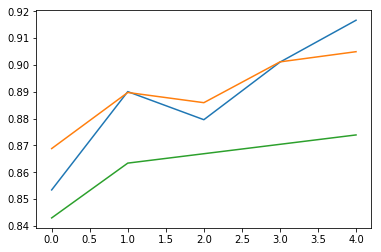

In [18]:
plt.plot(train_singlemet)
plt.plot(val_singlemet)
plt.plot(test_singlemet)

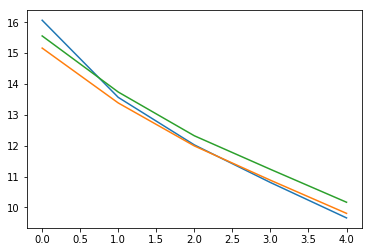

In [22]:
test_loss=np.load('./Windows/2ntest_class_metrics_loss.npy', allow_pickle=True)
train_loss=np.load('./Windows/2ntrain_class_metrics_loss.npy', allow_pickle=True)
val_loss=np.load('./Windows/2nval_class_metrics_loss.npy', allow_pickle=True)
test3_loss=np.load('./Windows/2n3test_class_metrics_loss.npy', allow_pickle=True)
train3_loss=np.load('./Windows/2n3train_class_metrics_loss.npy', allow_pickle=True)
val3_loss=np.load('./Windows/2n3val_class_metrics_loss.npy', allow_pickle=True)

val_loss=np.append(val_loss,val3_loss[:-1],axis=0)
test_loss=np.append(test_loss,test3_loss[:-1],axis=0)
train_loss=np.append(train_loss,train3_loss[:-1],axis=0)

plt.plot(train_loss)
plt.plot(val_loss)
plt.plot(test_loss)

In [12]:
val3_precision

array([0.67184335, 0.68966713])

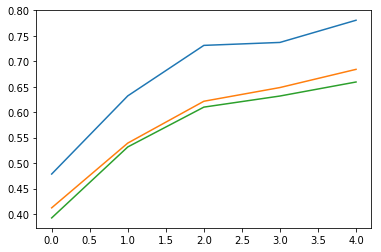

In [23]:
test_precision=np.load('./Windows/2ntest_class_metrics_precision.npy', allow_pickle=True)
train_precision=np.load('./Windows/2ntrain_class_metrics_precision.npy', allow_pickle=True)
val_precision=np.load('./Windows/2nval_class_metrics_precision.npy', allow_pickle=True)
test3_precision=np.load('./Windows/2n3test_class_metrics_precision.npy', allow_pickle=True)
train3_precision=np.load('./Windows/2n3train_class_metrics_precision.npy', allow_pickle=True)
val3_precision=np.load('./Windows/2n3val_class_metrics_precision.npy', allow_pickle=True)

val_precision=np.append(val_precision,val3_precision[:-1],axis=0)
test_precision=np.append(test_precision,test3_precision[:-1],axis=0)
train_precision=np.append(train_precision,train3_precision[:-1],axis=0)

plt.plot(train_precision)
plt.plot(val_precision)
plt.plot(test_precision)

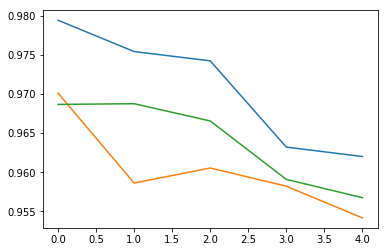

In [24]:
test_recall=np.load('./Windows/2ntest_class_metrics_recall.npy', allow_pickle=True)
train_recall=np.load('./Windows/2ntrain_class_metrics_recall.npy', allow_pickle=True)
val_recall=np.load('./Windows/2nval_class_metrics_recall.npy', allow_pickle=True)
test3_recall=np.load('./Windows/2n3test_class_metrics_recall.npy', allow_pickle=True)
train3_recall=np.load('./Windows/2n3train_class_metrics_recall.npy', allow_pickle=True)
val3_recall=np.load('./Windows/2n3val_class_metrics_recall.npy', allow_pickle=True)

val_recall=np.append(val_recall,val3_recall[:-1],axis=0)
test_recall=np.append(test_recall,test3_recall[:-1],axis=0)
train_recall=np.append(train_recall,train3_recall[:-1],axis=0)

plt.plot(train_recall)
plt.plot(val_recall)
plt.plot(test_recall)

In [31]:
test3_singlemet

array([11.39135441, 10.31923606])

In [ ]:
train_singlemet

In [ ]:
from matplotlib import pyplot as plt
plt.plot(test_singlemet)

In [ ]:
test_singlemet=np.load('./Windows/ntest_class_metrics_precision.npy', allow_pickle=True)
train_singlemet=np.load('./Windows/ntrain_class_metrics_precision.npy', allow_pickle=True)
plt.plot(test_singlemet)

In [ ]:
test_singlemet=np.load('./Windows/test_class_metrics_recall.npy', allow_pickle=True)
train_singlemet=np.load('./Windows/train_class_metrics_recall.npy', allow_pickle=True)
plt.plot(test_singlemet)

In [ ]:
test_singlemet=np.load('./Windows/test_class_metrics_loss.npy', allow_pickle=True)
train_singlemet=np.load('./Windows/train_class_metrics_loss.npy', allow_pickle=True)
plt.plot(test_singlemet)